## Germany PV Cut Scenario with 130 €/t CO2 price

In [1]:
import pypsa 
import matplotlib.pyplot as plt
plt.style.use("bmh")
import pandas as pd
from pypsa.plot import add_legend_patches
import gurobipy
import cartopy.crs as ccrs
from pypsa.optimization import optimize
import matplotlib.cm as cm
import numpy as np
import os

pd.set_option("display.max_rows", None)  # Display all rows
pd.set_option("display.max_columns", None)  # Display all columns


## Import Network

In [2]:
n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\elec_s_20_ec_lv1.5_3h.nc")
n.name = 'base_offwind'

INFO:pypsa.io:Imported network elec_s_20_ec_lv1.5_3h.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [3]:
# add co2price
co2_price = 130 #€/t

for index in n.generators.index:
    emission = n.carriers.co2_emissions.filter(like= n.generators.carrier[index]) #t/MWh_th
    n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3184507867.py:6: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel


In [4]:
for c in n.iterate_components(list(n.components.keys())[2:]):
    print("Component '{}' has {} entries".format(c.name,len(c.df)))

Component 'Bus' has 20 entries
Component 'Carrier' has 21 entries
Component 'GlobalConstraint' has 1 entries
Component 'Line' has 27 entries
Component 'LineType' has 34 entries
Component 'TransformerType' has 14 entries
Component 'Link' has 28 entries
Component 'Load' has 20 entries
Component 'Generator' has 261 entries
Component 'StorageUnit' has 65 entries


In [5]:
#remove nuclear fleet from germany
n.generators.loc[n.generators.index.str.startswith('DE') & n.generators.index.str.endswith('nuclear'), 'p_nom'] = 0


In [6]:
# set marginal cost of load shedding to 3000€/MWh
for bus in n.generators.bus:
    for index in n.generators.index:
        if not bus.endswith('H2') and index.endswith('load'):
            n.generators.loc[index, 'marginal_cost'] = 3000

#edit load shedding's unit from kW to MW
for index in n.generators.index:
    if index.endswith('load') and not index.endswith('H2 load'):
        n.generators.loc[index, 'sign'] = 1

In [7]:
#solve network
n.optimize(solver_name='gurobi')
#n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\Offwindcut\\base.nc")

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:05<00:00,  2.16it/s]
INFO:linopy.io: Writing time: 38.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hruamryj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hruamryj.lp


Reading time = 11.77 seconds


INFO:gurobipy:Reading time = 11.77 seconds


obj: 3264863 rows, 1521502 columns, 6235954 nonzeros


INFO:gurobipy:obj: 3264863 rows, 1521502 columns, 6235954 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3264863 rows, 1521502 columns and 6235954 nonzeros


INFO:gurobipy:Optimize a model with 3264863 rows, 1521502 columns and 6235954 nonzeros


Model fingerprint: 0x61697209


INFO:gurobipy:Model fingerprint: 0x61697209


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 1e+03]


INFO:gurobipy:  Matrix range     [1e-02, 1e+03]


  Objective range  [3e-02, 3e+05]


INFO:gurobipy:  Objective range  [3e-02, 3e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 2121745 rows and 372364 columns (presolve time = 5s) ...


INFO:gurobipy:Presolve removed 2121745 rows and 372364 columns (presolve time = 5s) ...


Presolve removed 2121745 rows and 372364 columns


INFO:gurobipy:Presolve removed 2121745 rows and 372364 columns


Presolve time: 6.36s


INFO:gurobipy:Presolve time: 6.36s


Presolved: 1143118 rows, 1149138 columns, 3794406 nonzeros


INFO:gurobipy:Presolved: 1143118 rows, 1149138 columns, 3794406 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Elapsed ordering time = 8s


INFO:gurobipy:Elapsed ordering time = 8s


Ordering time: 14.61s


INFO:gurobipy:Ordering time: 14.61s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 181


INFO:gurobipy: Dense cols : 181


 AA' NZ     : 4.035e+06


INFO:gurobipy: AA' NZ     : 4.035e+06


 Factor NZ  : 2.941e+07 (roughly 1.2 GB of memory)


INFO:gurobipy: Factor NZ  : 2.941e+07 (roughly 1.2 GB of memory)


 Factor Ops : 6.354e+09 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 6.354e+09 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.31157124e+17 -8.63354864e+18  2.85e+10 9.06e+04  8.83e+13    25s


INFO:gurobipy:   0   6.31157124e+17 -8.63354864e+18  2.85e+10 9.06e+04  8.83e+13    25s


   1   5.51458664e+17 -3.71126918e+18  1.77e+10 3.08e+04  5.63e+13    27s


INFO:gurobipy:   1   5.51458664e+17 -3.71126918e+18  1.77e+10 3.08e+04  5.63e+13    27s


   2   4.54011429e+17 -1.88917555e+18  1.41e+10 1.23e+04  3.89e+13    29s


INFO:gurobipy:   2   4.54011429e+17 -1.88917555e+18  1.41e+10 1.23e+04  3.89e+13    29s


   3   3.43180565e+17 -1.41946105e+18  9.28e+09 7.90e+03  2.50e+13    32s


INFO:gurobipy:   3   3.43180565e+17 -1.41946105e+18  9.28e+09 7.90e+03  2.50e+13    32s


   4   2.83738437e+17 -7.56568029e+17  4.86e+09 2.98e+03  1.25e+13    34s


INFO:gurobipy:   4   2.83738437e+17 -7.56568029e+17  4.86e+09 2.98e+03  1.25e+13    34s


   5   2.26118710e+17 -2.64872401e+17  1.84e+09 7.83e+02  4.50e+12    35s


INFO:gurobipy:   5   2.26118710e+17 -2.64872401e+17  1.84e+09 7.83e+02  4.50e+12    35s


   6   1.35222323e+17 -5.53237846e+16  4.83e+08 1.16e+02  1.15e+12    37s


INFO:gurobipy:   6   1.35222323e+17 -5.53237846e+16  4.83e+08 1.16e+02  1.15e+12    37s


   7   2.28256107e+16 -8.54538102e+15  6.64e+06 2.19e+00  2.73e+10    40s


INFO:gurobipy:   7   2.28256107e+16 -8.54538102e+15  6.64e+06 2.19e+00  2.73e+10    40s


   8   2.91979562e+15 -1.32124122e+15  7.02e+05 1.29e-01  3.12e+09    42s


INFO:gurobipy:   8   2.91979562e+15 -1.32124122e+15  7.02e+05 1.29e-01  3.12e+09    42s


   9   1.61348842e+15 -8.30010086e+14  3.60e+05 6.04e-02  1.66e+09    44s


INFO:gurobipy:   9   1.61348842e+15 -8.30010086e+14  3.60e+05 6.04e-02  1.66e+09    44s


  10   1.35911604e+15 -5.59390786e+14  2.97e+05 3.24e-02  1.29e+09    45s


INFO:gurobipy:  10   1.35911604e+15 -5.59390786e+14  2.97e+05 3.24e-02  1.29e+09    45s


  11   7.75630251e+14 -3.53498737e+14  1.61e+05 1.54e-02  7.18e+08    47s


INFO:gurobipy:  11   7.75630251e+14 -3.53498737e+14  1.61e+05 1.54e-02  7.18e+08    47s


  12   6.10073702e+14 -1.38289402e+14  1.22e+05 1.48e-03  4.67e+08    49s


INFO:gurobipy:  12   6.10073702e+14 -1.38289402e+14  1.22e+05 1.48e-03  4.67e+08    49s


  13   3.97725550e+14 -6.93846975e+13  7.53e+04 6.60e-05  2.74e+08    51s


INFO:gurobipy:  13   3.97725550e+14 -6.93846975e+13  7.53e+04 6.60e-05  2.74e+08    51s


  14   1.81848850e+14 -2.93036011e+13  2.78e+04 1.28e-04  1.14e+08    53s


INFO:gurobipy:  14   1.81848850e+14 -2.93036011e+13  2.78e+04 1.28e-04  1.14e+08    53s


  15   4.63160681e+13 -1.13997956e+13  2.09e+03 2.81e-05  2.84e+07    56s


INFO:gurobipy:  15   4.63160681e+13 -1.13997956e+13  2.09e+03 2.81e-05  2.84e+07    56s


  16   1.82917956e+13 -8.31382949e+12  8.01e+02 1.94e-05  1.24e+07    58s


INFO:gurobipy:  16   1.82917956e+13 -8.31382949e+12  8.01e+02 1.94e-05  1.24e+07    58s


  17   1.10627860e+13 -6.91851544e+12  4.81e+02 1.47e-05  8.16e+06    60s


INFO:gurobipy:  17   1.10627860e+13 -6.91851544e+12  4.81e+02 1.47e-05  8.16e+06    60s


  18   7.96947901e+12 -6.30291485e+12  3.50e+02 1.20e-05  6.37e+06    62s


INFO:gurobipy:  18   7.96947901e+12 -6.30291485e+12  3.50e+02 1.20e-05  6.37e+06    62s


  19   4.58792449e+12 -4.72300730e+12  1.95e+02 8.55e-06  4.03e+06    64s


INFO:gurobipy:  19   4.58792449e+12 -4.72300730e+12  1.95e+02 8.55e-06  4.03e+06    64s


  20   2.74552537e+12 -4.49619093e+12  1.16e+02 8.15e-06  3.07e+06    67s


INFO:gurobipy:  20   2.74552537e+12 -4.49619093e+12  1.16e+02 8.15e-06  3.07e+06    67s


  21   1.62406758e+12 -3.03273530e+12  5.93e+01 5.46e-06  1.93e+06    70s


INFO:gurobipy:  21   1.62406758e+12 -3.03273530e+12  5.93e+01 5.46e-06  1.93e+06    70s


  22   1.04086591e+12 -2.06170517e+12  3.52e+01 3.76e-06  1.27e+06    73s


INFO:gurobipy:  22   1.04086591e+12 -2.06170517e+12  3.52e+01 3.76e-06  1.27e+06    73s


  23   6.41931981e+11 -1.52095841e+12  1.90e+01 2.84e-06  8.77e+05    75s


INFO:gurobipy:  23   6.41931981e+11 -1.52095841e+12  1.90e+01 2.84e-06  8.77e+05    75s


  24   4.38837530e+11 -1.01386303e+12  1.10e+01 2.00e-06  5.86e+05    77s


INFO:gurobipy:  24   4.38837530e+11 -1.01386303e+12  1.10e+01 2.00e-06  5.86e+05    77s


  25   4.29500145e+11 -9.40410895e+11  1.07e+01 1.87e-06  5.52e+05    79s


INFO:gurobipy:  25   4.29500145e+11 -9.40410895e+11  1.07e+01 1.87e-06  5.52e+05    79s


  26   3.15933489e+11 -5.91600951e+11  6.96e+00 1.20e-06  3.65e+05    81s


INFO:gurobipy:  26   3.15933489e+11 -5.91600951e+11  6.96e+00 1.20e-06  3.65e+05    81s


  27   2.43461664e+11 -3.06974439e+11  4.73e+00 6.56e-07  2.21e+05    83s


INFO:gurobipy:  27   2.43461664e+11 -3.06974439e+11  4.73e+00 6.56e-07  2.21e+05    83s


  28   1.81568049e+11 -2.01432424e+11  2.97e+00 4.63e-07  1.53e+05    86s


INFO:gurobipy:  28   1.81568049e+11 -2.01432424e+11  2.97e+00 4.63e-07  1.53e+05    86s


  29   1.47688052e+11 -3.25756298e+10  2.07e+00 1.49e-07  7.22e+04    89s


INFO:gurobipy:  29   1.47688052e+11 -3.25756298e+10  2.07e+00 1.49e-07  7.22e+04    89s


  30   1.16305615e+11  3.78568294e+09  1.33e+00 8.45e-08  4.50e+04    92s


INFO:gurobipy:  30   1.16305615e+11  3.78568294e+09  1.33e+00 8.45e-08  4.50e+04    92s


  31   1.06934615e+11  1.53041595e+10  1.12e+00 6.31e-08  3.67e+04    94s


INFO:gurobipy:  31   1.06934615e+11  1.53041595e+10  1.12e+00 6.31e-08  3.67e+04    94s


  32   1.04032349e+11  2.16699393e+10  1.06e+00 5.23e-08  3.29e+04    96s


INFO:gurobipy:  32   1.04032349e+11  2.16699393e+10  1.06e+00 5.23e-08  3.29e+04    96s


  33   9.69853961e+10  2.64807408e+10  9.03e-01 4.35e-08  2.82e+04    98s


INFO:gurobipy:  33   9.69853961e+10  2.64807408e+10  9.03e-01 4.35e-08  2.82e+04    98s


  34   8.79203368e+10  2.99054913e+10  7.18e-01 3.95e-08  2.32e+04   100s


INFO:gurobipy:  34   8.79203368e+10  2.99054913e+10  7.18e-01 3.95e-08  2.32e+04   100s


  35   8.20614197e+10  3.44994763e+10  5.99e-01 3.01e-08  1.90e+04   103s


INFO:gurobipy:  35   8.20614197e+10  3.44994763e+10  5.99e-01 3.01e-08  1.90e+04   103s


  36   7.75405160e+10  3.89908811e+10  5.05e-01 2.22e-08  1.54e+04   106s


INFO:gurobipy:  36   7.75405160e+10  3.89908811e+10  5.05e-01 2.22e-08  1.54e+04   106s


  37   7.23921699e+10  4.17940448e+10  3.99e-01 1.96e-08  1.22e+04   109s


INFO:gurobipy:  37   7.23921699e+10  4.17940448e+10  3.99e-01 1.96e-08  1.22e+04   109s


  38   6.77117200e+10  4.44347006e+10  2.98e-01 1.52e-08  9.31e+03   112s


INFO:gurobipy:  38   6.77117200e+10  4.44347006e+10  2.98e-01 1.52e-08  9.31e+03   112s


  39   6.49658757e+10  4.63008898e+10  2.39e-01 1.03e-08  7.46e+03   116s


INFO:gurobipy:  39   6.49658757e+10  4.63008898e+10  2.39e-01 1.03e-08  7.46e+03   116s


  40   6.24770146e+10  4.83234493e+10  1.85e-01 9.42e-09  5.66e+03   119s


INFO:gurobipy:  40   6.24770146e+10  4.83234493e+10  1.85e-01 9.42e-09  5.66e+03   119s


  41   6.15383370e+10  4.94934328e+10  1.66e-01 6.34e-09  4.82e+03   122s


INFO:gurobipy:  41   6.15383370e+10  4.94934328e+10  1.66e-01 6.34e-09  4.82e+03   122s


  42   5.98720565e+10  5.04034990e+10  1.32e-01 4.55e-09  3.79e+03   125s


INFO:gurobipy:  42   5.98720565e+10  5.04034990e+10  1.32e-01 4.55e-09  3.79e+03   125s


  43   5.88434754e+10  5.10195734e+10  1.10e-01 3.97e-09  3.13e+03   128s


INFO:gurobipy:  43   5.88434754e+10  5.10195734e+10  1.10e-01 3.97e-09  3.13e+03   128s


  44   5.77190189e+10  5.15753594e+10  8.67e-02 3.23e-09  2.46e+03   131s


INFO:gurobipy:  44   5.77190189e+10  5.15753594e+10  8.67e-02 3.23e-09  2.46e+03   131s


  45   5.67929840e+10  5.19043347e+10  6.71e-02 3.19e-09  1.95e+03   134s


INFO:gurobipy:  45   5.67929840e+10  5.19043347e+10  6.71e-02 3.19e-09  1.95e+03   134s


  46   5.63532644e+10  5.20774182e+10  5.81e-02 8.54e-09  1.71e+03   136s


INFO:gurobipy:  46   5.63532644e+10  5.20774182e+10  5.81e-02 8.54e-09  1.71e+03   136s


  47   5.58355045e+10  5.23522070e+10  4.72e-02 3.12e-08  1.39e+03   139s


INFO:gurobipy:  47   5.58355045e+10  5.23522070e+10  4.72e-02 3.12e-08  1.39e+03   139s


  48   5.56260213e+10  5.25602548e+10  4.31e-02 5.61e-08  1.23e+03   142s


INFO:gurobipy:  48   5.56260213e+10  5.25602548e+10  4.31e-02 5.61e-08  1.23e+03   142s


  49   5.54710674e+10  5.26135160e+10  4.00e-02 6.41e-08  1.14e+03   145s


INFO:gurobipy:  49   5.54710674e+10  5.26135160e+10  4.00e-02 6.41e-08  1.14e+03   145s


  50   5.53559062e+10  5.27013815e+10  3.76e-02 7.14e-08  1.06e+03   148s


INFO:gurobipy:  50   5.53559062e+10  5.27013815e+10  3.76e-02 7.14e-08  1.06e+03   148s


  51   5.51806220e+10  5.27552818e+10  3.37e-02 7.59e-08  9.70e+02   150s


INFO:gurobipy:  51   5.51806220e+10  5.27552818e+10  3.37e-02 7.59e-08  9.70e+02   150s


  52   5.49807490e+10  5.28632526e+10  2.97e-02 9.08e-08  8.47e+02   154s


INFO:gurobipy:  52   5.49807490e+10  5.28632526e+10  2.97e-02 9.08e-08  8.47e+02   154s


  53   5.48689410e+10  5.29293571e+10  2.73e-02 9.87e-08  7.76e+02   157s


INFO:gurobipy:  53   5.48689410e+10  5.29293571e+10  2.73e-02 9.87e-08  7.76e+02   157s


  54   5.47269476e+10  5.30280365e+10  2.43e-02 1.12e-07  6.79e+02   160s


INFO:gurobipy:  54   5.47269476e+10  5.30280365e+10  2.43e-02 1.12e-07  6.79e+02   160s


  55   5.45884440e+10  5.31069918e+10  2.15e-02 1.20e-07  5.92e+02   164s


INFO:gurobipy:  55   5.45884440e+10  5.31069918e+10  2.15e-02 1.20e-07  5.92e+02   164s


  56   5.44171176e+10  5.31676257e+10  1.79e-02 1.30e-07  5.00e+02   167s


INFO:gurobipy:  56   5.44171176e+10  5.31676257e+10  1.79e-02 1.30e-07  5.00e+02   167s


  57   5.42802549e+10  5.32359772e+10  1.50e-02 1.35e-07  4.18e+02   171s


INFO:gurobipy:  57   5.42802549e+10  5.32359772e+10  1.50e-02 1.35e-07  4.18e+02   171s


  58   5.41063097e+10  5.32603856e+10  1.15e-02 1.34e-07  3.38e+02   174s


INFO:gurobipy:  58   5.41063097e+10  5.32603856e+10  1.15e-02 1.34e-07  3.38e+02   174s


  59   5.39932143e+10  5.33052204e+10  9.18e-03 1.34e-07  2.75e+02   178s


INFO:gurobipy:  59   5.39932143e+10  5.33052204e+10  9.18e-03 1.34e-07  2.75e+02   178s


  60   5.39091711e+10  5.33312836e+10  7.47e-03 1.33e-07  2.31e+02   182s


INFO:gurobipy:  60   5.39091711e+10  5.33312836e+10  7.47e-03 1.33e-07  2.31e+02   182s


  61   5.38574914e+10  5.33410201e+10  6.42e-03 1.31e-07  2.07e+02   185s


INFO:gurobipy:  61   5.38574914e+10  5.33410201e+10  6.42e-03 1.31e-07  2.07e+02   185s


  62   5.38264688e+10  5.33653237e+10  5.78e-03 1.25e-07  1.84e+02   188s


INFO:gurobipy:  62   5.38264688e+10  5.33653237e+10  5.78e-03 1.25e-07  1.84e+02   188s


  63   5.37630379e+10  5.34016462e+10  4.49e-03 1.23e-07  1.45e+02   191s


INFO:gurobipy:  63   5.37630379e+10  5.34016462e+10  4.49e-03 1.23e-07  1.45e+02   191s


  64   5.37322524e+10  5.34193020e+10  3.87e-03 1.18e-07  1.25e+02   195s


INFO:gurobipy:  64   5.37322524e+10  5.34193020e+10  3.87e-03 1.18e-07  1.25e+02   195s


  65   5.37186713e+10  5.34322797e+10  3.59e-03 1.14e-07  1.15e+02   197s


INFO:gurobipy:  65   5.37186713e+10  5.34322797e+10  3.59e-03 1.14e-07  1.15e+02   197s


  66   5.37104631e+10  5.34393334e+10  3.43e-03 1.12e-07  1.08e+02   200s


INFO:gurobipy:  66   5.37104631e+10  5.34393334e+10  3.43e-03 1.12e-07  1.08e+02   200s


  67   5.36751064e+10  5.34568664e+10  2.73e-03 1.07e-07  8.73e+01   204s


INFO:gurobipy:  67   5.36751064e+10  5.34568664e+10  2.73e-03 1.07e-07  8.73e+01   204s


  68   5.36626366e+10  5.34678003e+10  2.48e-03 1.01e-07  7.79e+01   207s


INFO:gurobipy:  68   5.36626366e+10  5.34678003e+10  2.48e-03 1.01e-07  7.79e+01   207s


  69   5.36439509e+10  5.34785249e+10  2.11e-03 9.61e-08  6.61e+01   210s


INFO:gurobipy:  69   5.36439509e+10  5.34785249e+10  2.11e-03 9.61e-08  6.61e+01   210s


  70   5.36278603e+10  5.34831749e+10  1.80e-03 9.29e-08  5.79e+01   213s


INFO:gurobipy:  70   5.36278603e+10  5.34831749e+10  1.80e-03 9.29e-08  5.79e+01   213s


  71   5.36104318e+10  5.34926503e+10  1.46e-03 8.39e-08  4.71e+01   215s


INFO:gurobipy:  71   5.36104318e+10  5.34926503e+10  1.46e-03 8.39e-08  4.71e+01   215s


  72   5.36049844e+10  5.35038623e+10  1.35e-03 6.88e-08  4.04e+01   218s


INFO:gurobipy:  72   5.36049844e+10  5.35038623e+10  1.35e-03 6.88e-08  4.04e+01   218s


  73   5.35961792e+10  5.35067579e+10  1.18e-03 6.61e-08  3.58e+01   221s


INFO:gurobipy:  73   5.35961792e+10  5.35067579e+10  1.18e-03 6.61e-08  3.58e+01   221s


  74   5.35824492e+10  5.35108135e+10  9.19e-04 5.97e-08  2.86e+01   224s


INFO:gurobipy:  74   5.35824492e+10  5.35108135e+10  9.19e-04 5.97e-08  2.86e+01   224s


  75   5.35747358e+10  5.35144237e+10  7.71e-04 5.24e-08  2.41e+01   227s


INFO:gurobipy:  75   5.35747358e+10  5.35144237e+10  7.71e-04 5.24e-08  2.41e+01   227s


  76   5.35691941e+10  5.35177526e+10  6.65e-04 4.47e-08  2.06e+01   229s


INFO:gurobipy:  76   5.35691941e+10  5.35177526e+10  6.65e-04 4.47e-08  2.06e+01   229s


  77   5.35626827e+10  5.35209379e+10  5.40e-04 3.87e-08  1.67e+01   232s


INFO:gurobipy:  77   5.35626827e+10  5.35209379e+10  5.40e-04 3.87e-08  1.67e+01   232s


  78   5.35570911e+10  5.35231066e+10  4.34e-04 3.61e-08  1.36e+01   235s


INFO:gurobipy:  78   5.35570911e+10  5.35231066e+10  4.34e-04 3.61e-08  1.36e+01   235s


  79   5.35542979e+10  5.35241419e+10  3.89e-04 3.44e-08  1.21e+01   238s


INFO:gurobipy:  79   5.35542979e+10  5.35241419e+10  3.89e-04 3.44e-08  1.21e+01   238s


  80   5.35509802e+10  5.35257093e+10  3.85e-04 3.15e-08  1.01e+01   241s


INFO:gurobipy:  80   5.35509802e+10  5.35257093e+10  3.85e-04 3.15e-08  1.01e+01   241s


  81   5.35471903e+10  5.35271543e+10  2.50e-04 2.78e-08  8.01e+00   244s


INFO:gurobipy:  81   5.35471903e+10  5.35271543e+10  2.50e-04 2.78e-08  8.01e+00   244s


  82   5.35455600e+10  5.35287158e+10  2.19e-04 2.43e-08  6.74e+00   247s


INFO:gurobipy:  82   5.35455600e+10  5.35287158e+10  2.19e-04 2.43e-08  6.74e+00   247s


  83   5.35430624e+10  5.35299004e+10  1.74e-04 2.15e-08  5.26e+00   250s


INFO:gurobipy:  83   5.35430624e+10  5.35299004e+10  1.74e-04 2.15e-08  5.26e+00   250s


  84   5.35408063e+10  5.35306991e+10  1.34e-04 1.92e-08  4.04e+00   253s


INFO:gurobipy:  84   5.35408063e+10  5.35306991e+10  1.34e-04 1.92e-08  4.04e+00   253s


  85   5.35388751e+10  5.35314543e+10  1.43e-04 1.68e-08  2.97e+00   256s


INFO:gurobipy:  85   5.35388751e+10  5.35314543e+10  1.43e-04 1.68e-08  2.97e+00   256s


  86   5.35376069e+10  5.35321339e+10  1.89e-04 1.52e-08  2.19e+00   258s


INFO:gurobipy:  86   5.35376069e+10  5.35321339e+10  1.89e-04 1.52e-08  2.19e+00   258s


  87   5.35363642e+10  5.35324977e+10  1.34e-04 1.43e-08  1.55e+00   261s


INFO:gurobipy:  87   5.35363642e+10  5.35324977e+10  1.34e-04 1.43e-08  1.55e+00   261s


  88   5.35355949e+10  5.35328659e+10  1.77e-04 1.29e-08  1.09e+00   264s


INFO:gurobipy:  88   5.35355949e+10  5.35328659e+10  1.77e-04 1.29e-08  1.09e+00   264s


  89   5.35350122e+10  5.35330886e+10  1.11e-04 1.03e-08  7.69e-01   267s


INFO:gurobipy:  89   5.35350122e+10  5.35330886e+10  1.11e-04 1.03e-08  7.69e-01   267s


  90   5.35344997e+10  5.35331733e+10  1.51e-04 1.08e-08  5.30e-01   270s


INFO:gurobipy:  90   5.35344997e+10  5.35331733e+10  1.51e-04 1.08e-08  5.30e-01   270s


  91   5.35343985e+10  5.35333935e+10  1.35e-04 1.16e-08  4.02e-01   273s


INFO:gurobipy:  91   5.35343985e+10  5.35333935e+10  1.35e-04 1.16e-08  4.02e-01   273s


  92   5.35342500e+10  5.35334851e+10  9.55e-05 1.31e-08  3.06e-01   277s


INFO:gurobipy:  92   5.35342500e+10  5.35334851e+10  9.55e-05 1.31e-08  3.06e-01   277s


  93   5.35339605e+10  5.35335730e+10  3.64e-05 7.63e-09  1.55e-01   280s


INFO:gurobipy:  93   5.35339605e+10  5.35335730e+10  3.64e-05 7.63e-09  1.55e-01   280s


  94   5.35338792e+10  5.35336410e+10  2.26e-05 5.16e-09  9.52e-02   284s


INFO:gurobipy:  94   5.35338792e+10  5.35336410e+10  2.26e-05 5.16e-09  9.52e-02   284s


  95   5.35338569e+10  5.35336962e+10  1.89e-05 3.19e-09  6.42e-02   287s


INFO:gurobipy:  95   5.35338569e+10  5.35336962e+10  1.89e-05 3.19e-09  6.42e-02   287s


  96   5.35338125e+10  5.35337044e+10  1.15e-05 2.86e-09  4.32e-02   290s


INFO:gurobipy:  96   5.35338125e+10  5.35337044e+10  1.15e-05 2.86e-09  4.32e-02   290s


  97   5.35338104e+10  5.35337065e+10  1.12e-05 2.76e-09  4.16e-02   292s


INFO:gurobipy:  97   5.35338104e+10  5.35337065e+10  1.12e-05 2.76e-09  4.16e-02   292s


  98   5.35338011e+10  5.35337099e+10  9.63e-06 2.59e-09  3.65e-02   294s


INFO:gurobipy:  98   5.35338011e+10  5.35337099e+10  9.63e-06 2.59e-09  3.65e-02   294s


  99   5.35337951e+10  5.35337139e+10  8.68e-06 2.36e-09  3.25e-02   296s


INFO:gurobipy:  99   5.35337951e+10  5.35337139e+10  8.68e-06 2.36e-09  3.25e-02   296s


 100   5.35337853e+10  5.35337193e+10  7.06e-06 2.04e-09  2.64e-02   298s


INFO:gurobipy: 100   5.35337853e+10  5.35337193e+10  7.06e-06 2.04e-09  2.64e-02   298s


 101   5.35337804e+10  5.35337306e+10  6.30e-06 1.58e-09  1.99e-02   300s


INFO:gurobipy: 101   5.35337804e+10  5.35337306e+10  6.30e-06 1.58e-09  1.99e-02   300s


 102   5.35337627e+10  5.35337336e+10  3.48e-06 1.72e-09  1.17e-02   302s


INFO:gurobipy: 102   5.35337627e+10  5.35337336e+10  3.48e-06 1.72e-09  1.17e-02   302s


 103   5.35337597e+10  5.35337343e+10  3.00e-06 1.22e-09  1.02e-02   305s


INFO:gurobipy: 103   5.35337597e+10  5.35337343e+10  3.00e-06 1.22e-09  1.02e-02   305s


 104   5.35337572e+10  5.35337369e+10  2.59e-06 2.33e-09  8.12e-03   308s


INFO:gurobipy: 104   5.35337572e+10  5.35337369e+10  2.59e-06 2.33e-09  8.12e-03   308s


 105   5.35337495e+10  5.35337379e+10  1.42e-06 1.24e-09  4.66e-03   311s


INFO:gurobipy: 105   5.35337495e+10  5.35337379e+10  1.42e-06 1.24e-09  4.66e-03   311s


 106   5.35337475e+10  5.35337388e+10  1.10e-06 2.71e-09  3.48e-03   314s


INFO:gurobipy: 106   5.35337475e+10  5.35337388e+10  1.10e-06 2.71e-09  3.48e-03   314s


 107   5.35337437e+10  5.35337395e+10  1.86e-04 1.70e-09  1.68e-03   316s


INFO:gurobipy: 107   5.35337437e+10  5.35337395e+10  1.86e-04 1.70e-09  1.68e-03   316s


 108   5.35337422e+10  5.35337398e+10  1.08e-04 1.85e-09  9.59e-04   318s


INFO:gurobipy: 108   5.35337422e+10  5.35337398e+10  1.08e-04 1.85e-09  9.59e-04   318s


 109   5.35337417e+10  5.35337400e+10  7.86e-05 7.15e-09  6.65e-04   320s


INFO:gurobipy: 109   5.35337417e+10  5.35337400e+10  7.86e-05 7.15e-09  6.65e-04   320s


 110   5.35337405e+10  5.35337401e+10  1.80e-05 3.02e-09  1.64e-04   322s


INFO:gurobipy: 110   5.35337405e+10  5.35337401e+10  1.80e-05 3.02e-09  1.64e-04   322s


 111   5.35337402e+10  5.35337401e+10  1.35e-05 1.88e-09  5.15e-05   324s


INFO:gurobipy: 111   5.35337402e+10  5.35337401e+10  1.35e-05 1.88e-09  5.15e-05   324s


 112   5.35337402e+10  5.35337401e+10  6.87e-06 3.46e-09  1.07e-05   326s


INFO:gurobipy: 112   5.35337402e+10  5.35337401e+10  6.87e-06 3.46e-09  1.07e-05   326s


 113   5.35337401e+10  5.35337401e+10  2.17e-06 2.66e-09  1.68e-06   328s


INFO:gurobipy: 113   5.35337401e+10  5.35337401e+10  2.17e-06 2.66e-09  1.68e-06   328s


 114   5.35337401e+10  5.35337401e+10  8.82e-07 3.18e-09  5.97e-07   330s


INFO:gurobipy: 114   5.35337401e+10  5.35337401e+10  8.82e-07 3.18e-09  5.97e-07   330s


 115   5.35337401e+10  5.35337401e+10  5.19e-07 2.19e-08  3.95e-08   332s


INFO:gurobipy: 115   5.35337401e+10  5.35337401e+10  5.19e-07 2.19e-08  3.95e-08   332s


 116   5.35337401e+10  5.35337401e+10  5.49e-09 2.19e-08  6.53e-11   333s


INFO:gurobipy: 116   5.35337401e+10  5.35337401e+10  5.49e-09 2.19e-08  6.53e-11   333s


INFO:gurobipy:


Barrier solved model in 116 iterations and 333.19 seconds (111.79 work units)


INFO:gurobipy:Barrier solved model in 116 iterations and 333.19 seconds (111.79 work units)


Optimal objective 5.35337401e+10


INFO:gurobipy:Optimal objective 5.35337401e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


  458079 variables added to crossover basis                      337s


INFO:gurobipy:  458079 variables added to crossover basis                      337s


  561675 variables added to crossover basis                      340s


INFO:gurobipy:  561675 variables added to crossover basis                      340s


  565804 variables added to crossover basis                      345s


INFO:gurobipy:  565804 variables added to crossover basis                      345s


  567866 variables added to crossover basis                      350s


INFO:gurobipy:  567866 variables added to crossover basis                      350s


  569663 variables added to crossover basis                      355s


INFO:gurobipy:  569663 variables added to crossover basis                      355s


  571372 variables added to crossover basis                      360s


INFO:gurobipy:  571372 variables added to crossover basis                      360s


  572717 variables added to crossover basis                      365s


INFO:gurobipy:  572717 variables added to crossover basis                      365s


  573991 variables added to crossover basis                      370s


INFO:gurobipy:  573991 variables added to crossover basis                      370s


  575244 variables added to crossover basis                      375s


INFO:gurobipy:  575244 variables added to crossover basis                      375s


  576292 variables added to crossover basis                      380s


INFO:gurobipy:  576292 variables added to crossover basis                      380s


  577370 variables added to crossover basis                      385s


INFO:gurobipy:  577370 variables added to crossover basis                      385s


  578264 variables added to crossover basis                      390s


INFO:gurobipy:  578264 variables added to crossover basis                      390s


  579217 variables added to crossover basis                      395s


INFO:gurobipy:  579217 variables added to crossover basis                      395s


  580145 variables added to crossover basis                      400s


INFO:gurobipy:  580145 variables added to crossover basis                      400s


  580919 variables added to crossover basis                      405s


INFO:gurobipy:  580919 variables added to crossover basis                      405s


  581725 variables added to crossover basis                      410s


INFO:gurobipy:  581725 variables added to crossover basis                      410s


  582527 variables added to crossover basis                      415s


INFO:gurobipy:  582527 variables added to crossover basis                      415s


INFO:gurobipy:


  560354 DPushes remaining with DInf 0.0000000e+00               417s


INFO:gurobipy:  560354 DPushes remaining with DInf 0.0000000e+00               417s


   93302 DPushes remaining with DInf 0.0000000e+00               525s


INFO:gurobipy:   93302 DPushes remaining with DInf 0.0000000e+00               525s


   12132 DPushes remaining with DInf 0.0000000e+00               548s


INFO:gurobipy:   12132 DPushes remaining with DInf 0.0000000e+00               548s


    1486 DPushes remaining with DInf 0.0000000e+00               560s


INFO:gurobipy:    1486 DPushes remaining with DInf 0.0000000e+00               560s


     519 DPushes remaining with DInf 0.0000000e+00               562s


INFO:gurobipy:     519 DPushes remaining with DInf 0.0000000e+00               562s


     130 DPushes remaining with DInf 0.0000000e+00               571s


INFO:gurobipy:     130 DPushes remaining with DInf 0.0000000e+00               571s


       0 DPushes remaining with DInf 0.0000000e+00               574s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00               574s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.5


INFO:gurobipy:


    5624 PPushes remaining with PInf 0.0000000e+00               574s


INFO:gurobipy:    5624 PPushes remaining with PInf 0.0000000e+00               574s


    3969 PPushes remaining with PInf 0.0000000e+00               584s


INFO:gurobipy:    3969 PPushes remaining with PInf 0.0000000e+00               584s


    3567 PPushes remaining with PInf 0.0000000e+00               590s


INFO:gurobipy:    3567 PPushes remaining with PInf 0.0000000e+00               590s


       0 PPushes remaining with PInf 0.0000000e+00               593s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00               593s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.5288307e-06    593s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.5288307e-06    593s


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


  313088    5.3533740e+10   0.000000e+00   2.514331e-06    594s


INFO:gurobipy:  313088    5.3533740e+10   0.000000e+00   2.514331e-06    594s


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


  313095    5.3533740e+10   0.000000e+00   0.000000e+00    602s


INFO:gurobipy:  313095    5.3533740e+10   0.000000e+00   0.000000e+00    602s


INFO:gurobipy:


Solved in 313095 iterations and 602.27 seconds (314.18 work units)


INFO:gurobipy:Solved in 313095 iterations and 602.27 seconds (314.18 work units)


Optimal objective  5.353374014e+10


INFO:gurobipy:Optimal objective  5.353374014e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1521502 primals, 3264863 duals
Objective: 5.35e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-uppe

('ok', 'optimal')

### Export model for later use

In [8]:
dir = os.getcwd()
file = "base_offwind.nc"
output_path = os.path.join(dir, file)

n.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network base_offwind.nc has global_constraints, links, storage_units, buses, carriers, loads, generators, lines


<xarray.Dataset> Size: 13MB
Dimensions:                               (snapshots: 2920,
                                           investment_periods: 0,
                                           global_constraints_i: 1,
                                           links_i: 28, links_t_p0_i: 16,
                                           links_t_p1_i: 16,
                                           storage_units_i: 65,
                                           ...
                                           loads_t_p_set_i: 20,
                                           loads_t_p_i: 20, generators_i: 261,
                                           generators_t_p_max_pu_i: 81,
                                           generators_t_p_i: 130, lines_i: 27,
                                           lines_t_p0_i: 27, lines_t_p1_i: 27,
                                           lines_t_loss_i: 27)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 23kB 0 1 ... 2919
  * investment_periods                    (investment_periods) int64 0B 
  * global_constraints_i                  (global_constraints_i) object 8B 'l...
  * links_i                               (links_i) object 224B '14801' ... '...
  * links_t_p0_i                          (links_t_p0_i) object 128B '14801' ...
  * links_t_p1_i                          (links_t_p1_i) object 128B '14801' ...
    ...                                    ...
  * generators_t_p_max_pu_i               (generators_t_p_max_pu_i) object 648B ...
  * generators_t_p_i                      (generators_t_p_i) object 1kB 'AT1 ...
  * lines_i                               (lines_i) object 216B '0' '1' ... '9'
  * lines_t_p0_i                          (lines_t_p0_i) object 216B '0' ... '9'
  * lines_t_p1_i                          (lines_t_p1_i) object 216B '0' ... '9'
  * lines_t_loss_i                        (lines_t_loss_i) object 216B '0' .....
Data variables: (12/103)
    snapshots_snapshot                    (snapshots) datetime64[ns] 23kB 201...
    snapshots_objective                   (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_generators                  (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_stores                      (snapshots) float64 23kB 3.0 ... 3.0
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    lines_x_pu_eff                        (lines_i) float64 216B 0.0002125 .....
    lines_r_pu_eff                        (lines_i) float64 216B 2.592e-05 .....
    lines_s_nom_opt                       (lines_i) float64 216B 6.792e+03 .....
    lines_t_p0                            (snapshots, lines_t_p0_i) float64 631kB ...
    lines_t_p1                            (snapshots, lines_t_p1_i) float64 631kB ...
    lines_t_loss                          (snapshots, lines_t_loss_i) float64 631kB ...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                base_offwind
    network_objective:           53533740135.79983
    network_objective_constant:  22911281891.38211
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {"version": "0.10.0", "tutorial": false, "lo...

In [9]:
def system_cost(n): #n.statistics.capex()
    stat = n.statistics()
    tsc = stat['Capital Expenditure'] + stat['Operational Expenditure']
    return tsc.droplevel(0).div(1e6) # million €/a

In [10]:
tot_cos_base=n.objective/1e9
system_cost_base = system_cost(n)
marg_price_region_base = n.buses_t.marginal_price.mean()
stat_base = n.statistics()

## Plot Network

<function matplotlib.pyplot.show(close=None, block=None)>

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


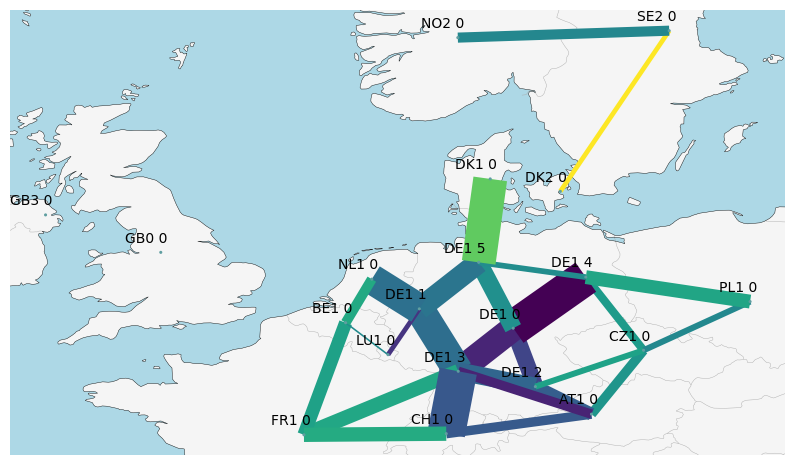

In [11]:
loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)

fig, ax = plt.subplots(
    figsize=(10,10),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

n.plot(
    ax=ax,
    branch_components=["Line"],
    line_widths=n.lines.s_nom_opt/1e3, #GW
    line_colors=loading,
    line_cmap=plt.cm.viridis,
    color_geomap=True,
    bus_sizes=0.003
)

bus = n.buses
region = []
for index, row in bus.iterrows():
    x = row['x']
    y = row['y']
    if "H2" in index:
        pass
    else:
        region.append(index)
        ax.annotate(
        index,
        xy=(x, y),
        xytext=(5, 5),  # Adjust the position of the annotation
        textcoords="offset points",
        ha='right', va='bottom'
    )

plt.show

## Installed Capacity Map Plot

In [12]:
#color list for installed cap
tech_list = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
tech_list.remove('load')
color_cap = []

for i in range(len(tech_list)):
    for j in range(len(n.carriers.index)):
        if tech_list[i] == n.carriers.index[j]:
            color_cap.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

cap = n.generators[n.generators['carrier']!='load'].groupby(['bus', 'carrier']).p_nom_opt.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3847545614.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_cap.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


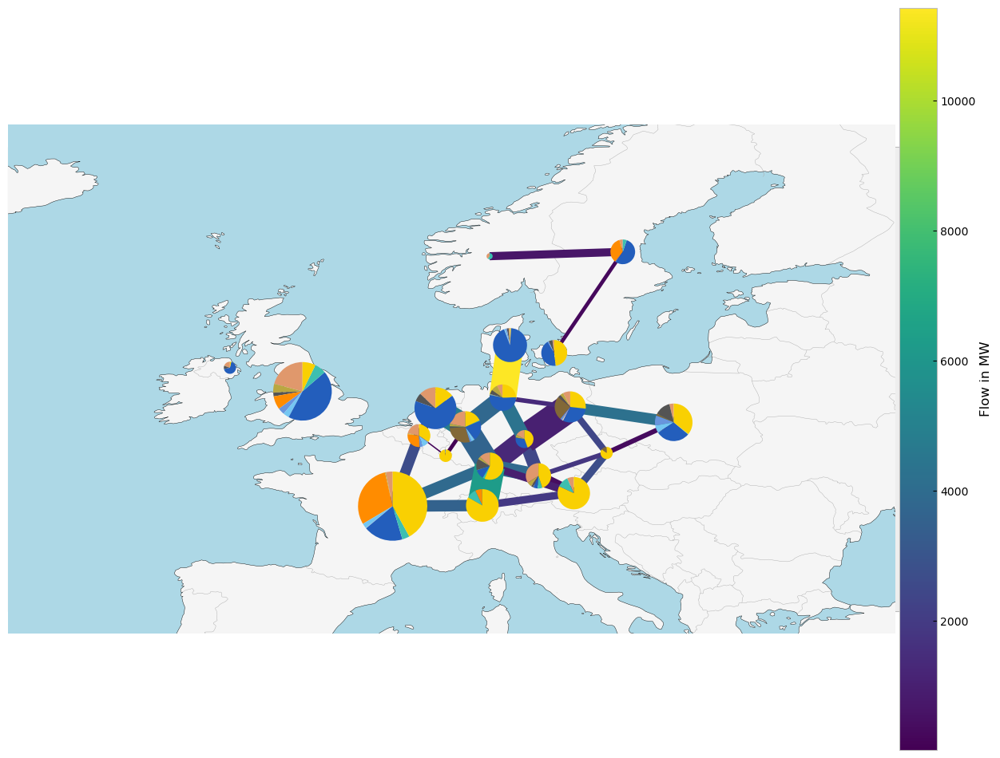

In [13]:
fig, ax = plt.subplots(
    figsize=(15,15),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

collection = n.plot(
    bus_sizes=cap / 5e4,
    bus_colors = color_cap,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
        
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Generation Map Plot

In [14]:
#color list for energy generated 
tech_list_gen_table = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
colors_gen_table = []

for i in range(len(tech_list_gen_table)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen_table[i] == n.carriers.index[j]:
            colors_gen_table.append(n.carriers.color[j])
            break  # break the inner loop once a match is found 

#Adjust Load shedding's unit to MW from kW
#for column in n.generators_t.p.columns:
#    if column.endswith('load') and not column.endswith('H2 load'):
#        n.generators_t.p[column]/=1e3
        

gen = n.generators.assign(g=n.generators_t.p.mean()).groupby(["bus", "carrier"]).g.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\971004373.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen_table.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


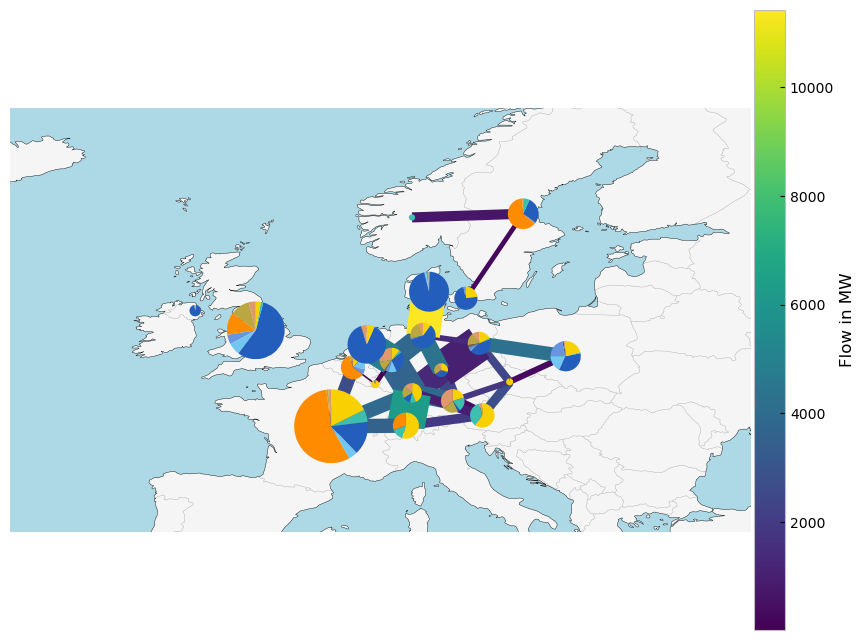

In [15]:
carriers = n.generators.carrier.unique()

plt.figure(figsize =(10,10))

collection = n.plot(
    bus_sizes=gen / 1e4,
    bus_colors = colors_gen_table,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Installed Capacity

<Figure size 640x480 with 0 Axes>

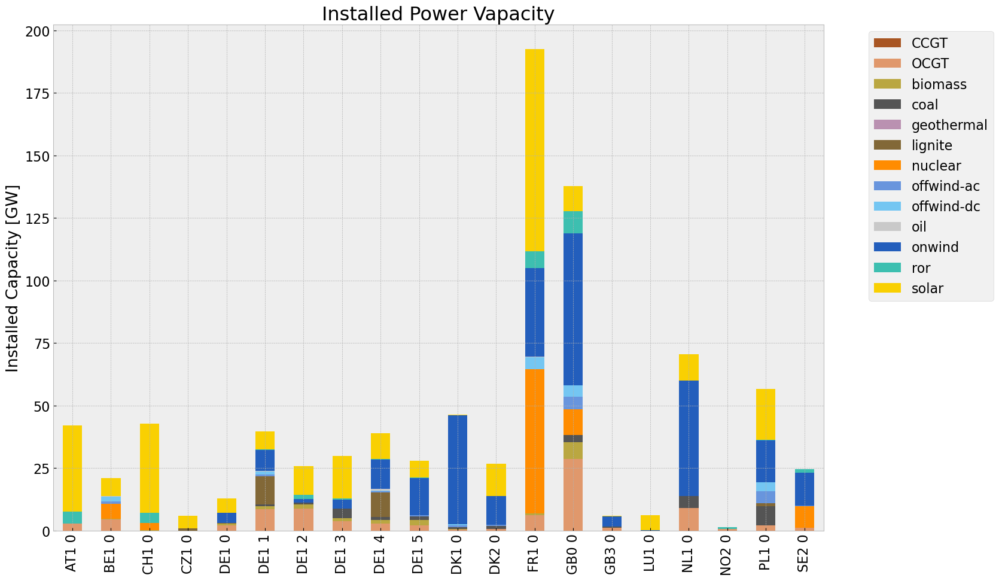

In [16]:
def inst_cap_table(n,colors):

    capacities = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Vapacity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_installed_cap.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    plt.show()

    

    return capacities

# consolidated istalled cap without load_shedding

#capacities_base = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_base.fillna(0, inplace=True)
#gen = (capacities_base.unstack()/1000).drop(columns=['load'],inplace=False)

capacities_base = inst_cap_table(n, color_cap)

<Figure size 640x480 with 0 Axes>

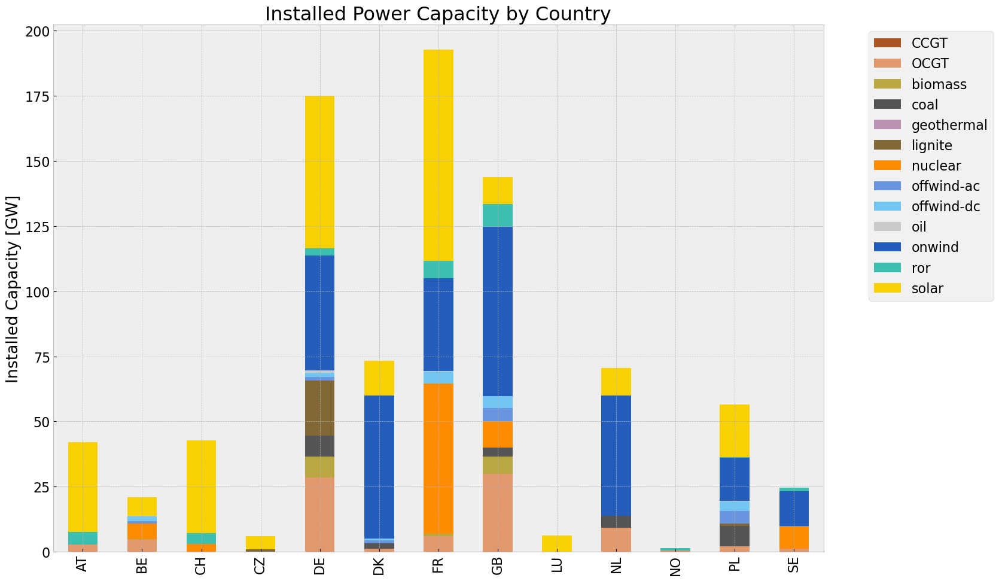

In [17]:
#aggregate installed capacities by country
def inst_cap_table_country(n,colors):
    
    model = n
    capacities = model.generators
    capacities['country'] = capacities['bus'].str[:2]
    capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Capacity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_installed_cap_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()
    
     

    return gen

cap_base_country= inst_cap_table_country(n, color_cap)

## Generation

<Figure size 640x480 with 0 Axes>

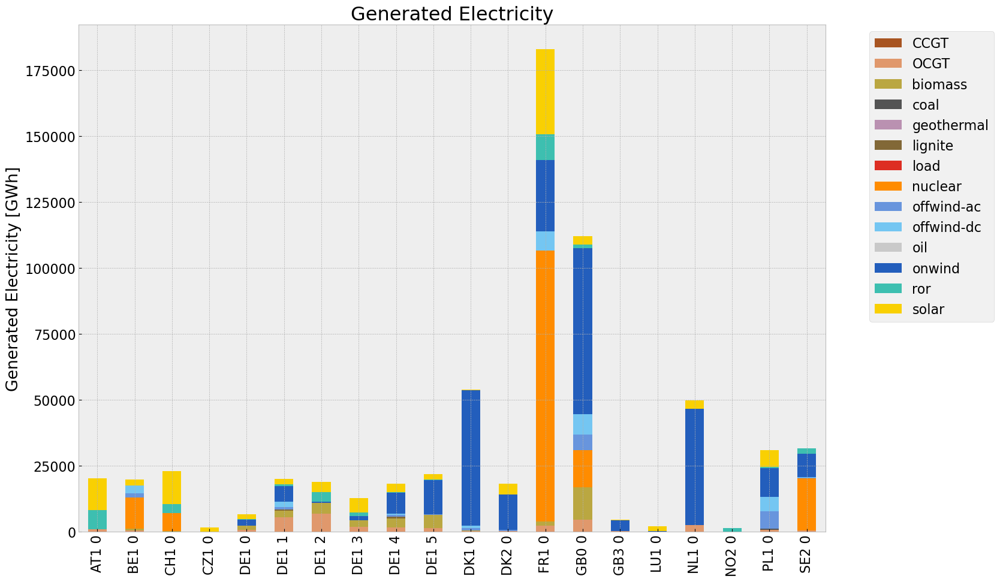

In [18]:
def gen_power_table(n, color):

    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack()/1000)#GWh
    #generations['load']/=1e3


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    generations.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=color,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_gen_elec.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()

    

    return generations

gen_base = gen_power_table(n,colors_gen_table)

<Figure size 640x480 with 0 Axes>

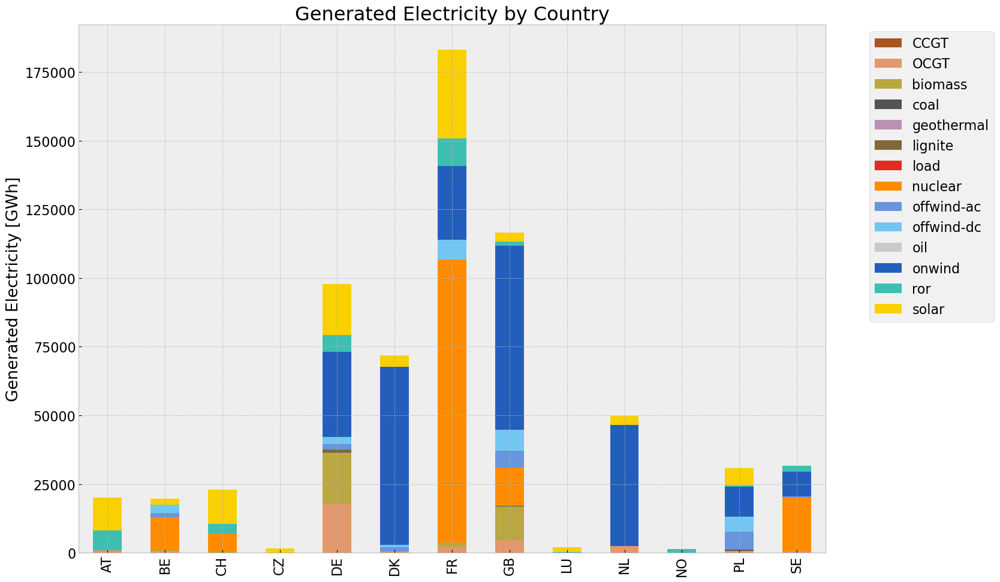

In [19]:
def gen_power_table_country(n, color):

    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    #generations = n.generators
    #generations['country'] = generations['bus'].str[:2]
    #generations = pd.Series(index = n.generators.groupby(['country', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack()/1000)#GWh
    generations['country'] = generations.index.str[:2]
    generations = generations.groupby(['country']).sum()   
    #generations['load']/=1e3


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    generations.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=color,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_gen_elec_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    plt.show()
    return generations

gen_base_country = gen_power_table_country(n,colors_gen_table)

## Snapshot

In [20]:
sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()

#links = n.links_t.p0.groupby(n.links.carrier, axis =1).sum().drop(['DC','H2 electrolysis'], axis=1, inplace =False).head()
tech_list_gen = pd.concat([tech_list_gen, sto], axis=1).columns.tolist()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\318663498.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\318663498.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()


In [21]:
colors_gen = []

for i in range(len(tech_list_gen)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen[i] == n.carriers.index[j]:
            colors_gen.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\4040974225.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen.append(n.carriers.color[j])


In [22]:
def gen_curve(n, start, end, colors,ctr):

    plt.rcParams.update({'font.size': 16})

    #import export 
    lines_ctr_bus0 = n.lines[n.lines['bus0'].str.startswith(ctr) & ~n.lines['bus1'].str.startswith(ctr)].index
    lines_ctr_bus1 = n.lines[n.lines['bus1'].str.startswith(ctr) & ~n.lines['bus0'].str.startswith(ctr)].index
    links_ctr_bus0 = n.links[n.links['bus0'].str.startswith(ctr) & ~n.links['bus1'].str.startswith(ctr)].index
    links_ctr_bus1 = n.links[n.links['bus1'].str.startswith(ctr) & ~n.links['bus0'].str.startswith(ctr)].index


    df_lines_ctr_bus0 = n.lines_t.p0[lines_ctr_bus0]
    df_lines_ctr_bus1 = n.lines_t.p1[lines_ctr_bus1]
    df_links_ctr_bus0 = n.links_t.p0[links_ctr_bus0]
    df_links_ctr_bus1 = n.links_t.p1[links_ctr_bus1]


    import_export = pd.concat([df_lines_ctr_bus0, df_lines_ctr_bus1, df_links_ctr_bus0, df_links_ctr_bus1], axis=1).sum(axis=1)*-1 #MW

    columns_gen = [col for col in  n.generators_t.p.columns if col.startswith(ctr)]
    p_country = n.generators_t.p[columns_gen]

    p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
    

    #add import color
    colors.append('#133337') #for Import

    #p_by_carrier['load'] /= 1e3

    #links fuel cell
    #links = n.links_t.p1.groupby(n.links.carrier, axis=1).sum().div(1e3)
    #links = links.drop(columns='DC', inplace=False)
    #links['H2 fuel cell']*=-1
       
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        col_sto = [col for col in  n.storage_units_t.p.columns if col.startswith(ctr)]
        sto_ctr = n.storage_units_t.p[col_sto]
        sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier['Import/Export'] = import_export 
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='3H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    col_load = [col for col in  n.loads_t.p_set.columns if col.startswith(ctr)]
    loads_ctr = n.loads_t.p_set[col_load]
    loads = loads_ctr.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")
    ax.set_ylim(-50,150)
    # Save plot to the current working directory
    fig.tight_layout()
    filename = f"{n.name}_gen_{start}_to_{end}.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    
    

In [23]:
#e_balance = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC",:].droplevel(2)
#e_balance.to_excel('energybalance.xlsx', index=True) 


In [24]:
#tes = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :].droplevel(2)
#tes.to_csv('energybalance.csv', index=True)

In [25]:
#n.loads_t.p_set.sum(axis=1).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].div(1e3).plot(ax=ax, c='k',grid=True)


In [26]:
#p_by_carrier.where(p_by_carrier>0).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].sum(axis=1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\

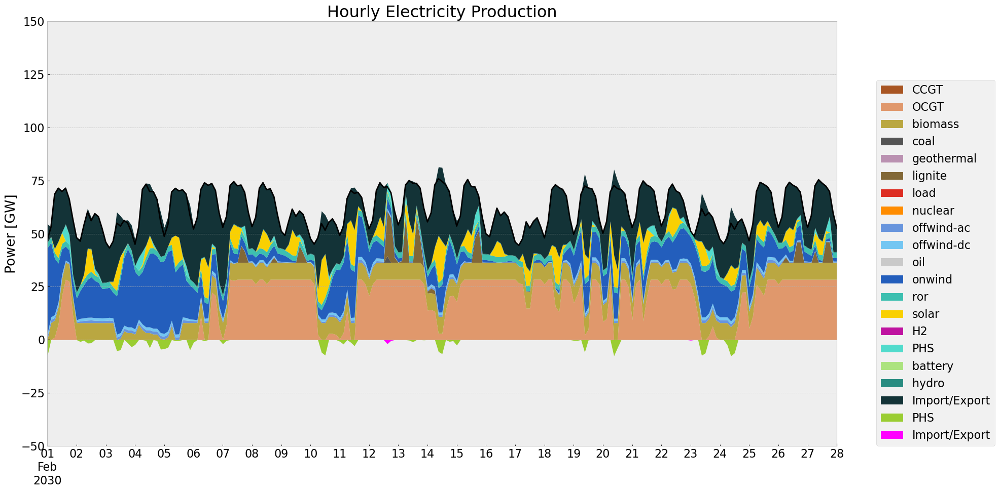

In [27]:
# winter
gen_curve(n, '2030-02-01', '2030-02-28', colors_gen,'DE')

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\

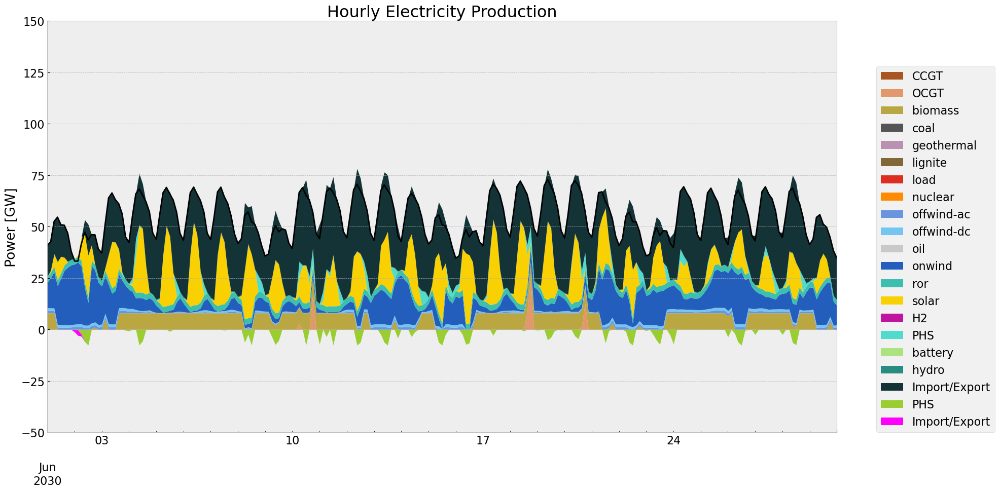

In [28]:
#summer
gen_curve(n, '2030-06-01', '2030-06-30', colors_gen,'DE')

In [29]:
def gen_curve_tot(n, start, end, colors):

    plt.rcParams.update({'font.size': 16})

    p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
    
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='3H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    loads = n.loads_t.p_set.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    ax.set_ylim(-50,370)
    fig.tight_layout()

    # Adjust the spacing around the plot (add extra space at the top)
    fig.subplots_adjust(top=0.95, right=0.85, left = 0.05)
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")

    filename = f"{n.name}_gen_{start}_to_{end}_total.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    
    plt.savefig(output_path)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, fr

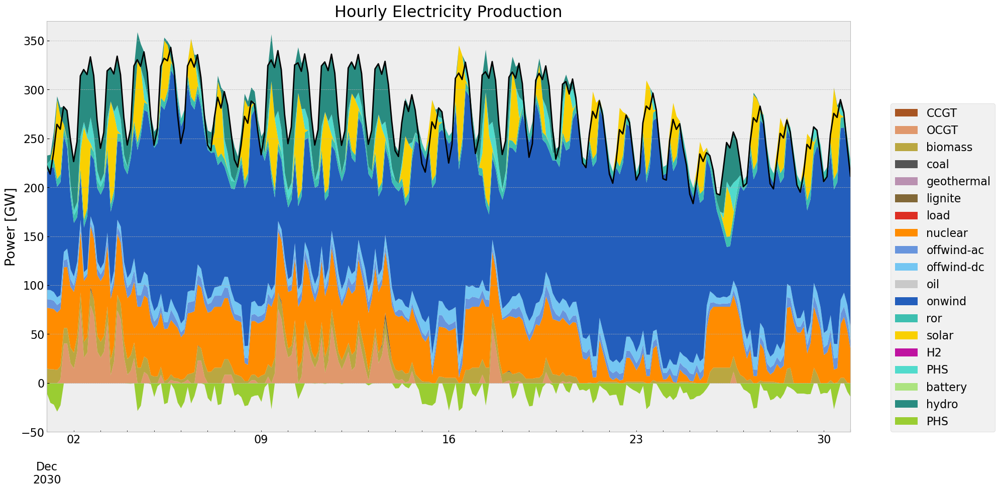

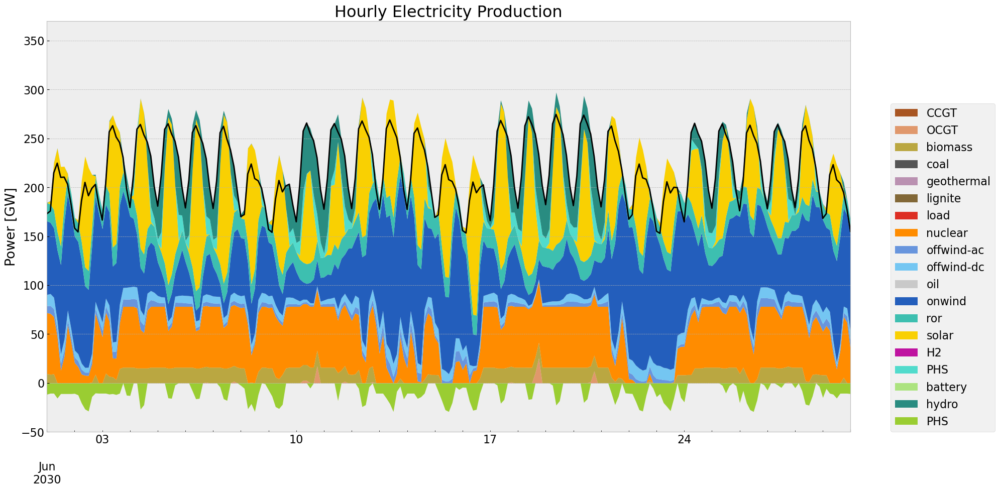

In [30]:
#generation curve all countries
#winter
gen_curve_tot(n, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n, '2030-06-01', '2030-06-30', colors_gen)

## Storage

In [31]:
def inst_store_table(n):
    
    plt.rcParams.update({'font.size': 16})
    storage = n.storage_units
    storage['country'] = storage['bus'].str[:2]

    (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000).plot.bar(figsize=(17,10),
                                stacked=True,
                                color=["yellowgreen","magenta","red","blue"],
                                grid=True,
                                xlabel="",
                                ylabel="Installed capacity [GW]",
                                title=f"Installed Power Capacity of Storage Systems By Country",
                                #ylim=[0,20]
    )
    store = storage.groupby(['country','carrier']).p_nom_opt.sum()/1000 #GW
    store.fillna(0, inplace=True)

    plt.tight_layout()

    filename = f"{n.name}_installed_storage.png" if hasattr(n, 'name') else "installed_storage.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    return store

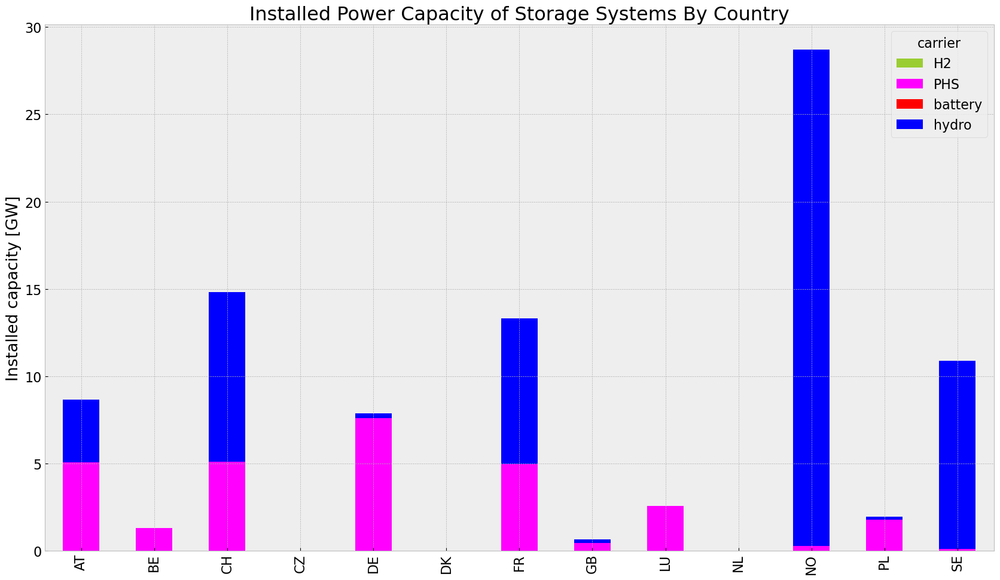

In [32]:
store_base = inst_store_table(n)

In [33]:
def state_of_charge_plot(n):
    
    soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)

    soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    soc.plot(ax=ax,
        grid=True,
        ylabel="State of charge [GWh]",
        xlabel="Time",
        title=f"State of charge of Storage Systems",
        linewidth=1.5,
    )
    plt.tight_layout()
    filename = f"{n.name}_soc.png" if hasattr(n, 'name') else "soc.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)



plt.show(n)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3576090030.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3576090030.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')


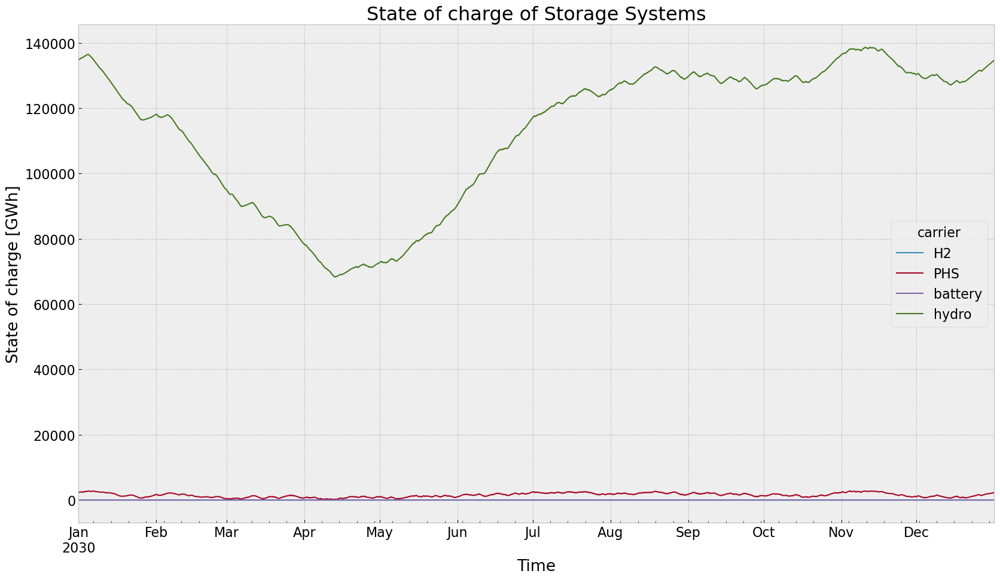

In [34]:
state_of_charge_plot(n)

## Electricity Price

In [35]:
def price_dur_curve_plot(n):

    #buses without store
    columns_to_keep =[]

    for i in n.buses_t.marginal_price.columns.tolist():
        if not i.endswith('H2'):
            columns_to_keep.append(i)
    
    price_dur_curve = pd.DataFrame()
    for region in columns_to_keep:
        price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    price_dur_curve.plot(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Time steps",
                    title=f"Duration curves of the marginal price",
                    linewidth=3,
)
    plt.tight_layout()
    filename = f"{n.name}_pd_curve.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
plt.show()

In [36]:
#columns_to_keep =[]

#for i in n.buses_t.marginal_price.columns.tolist():
    #if not i.endswith('H2'):
        #columns_to_keep.append(i)

#buses without store
#columns_to_keep =[]

#price_dur_curve = pd.DataFrame()
#for region in columns_to_keep:
    #price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)


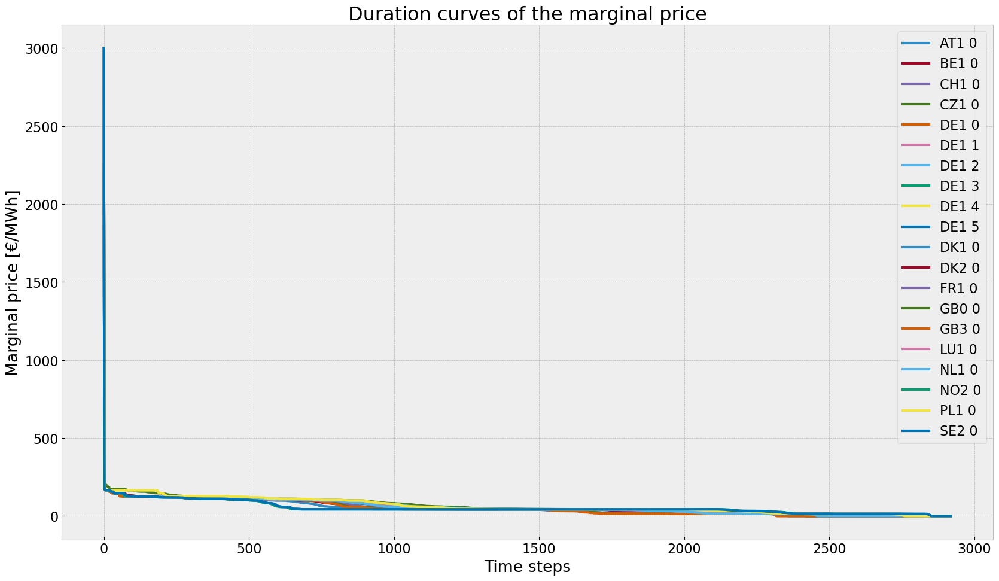

In [37]:
price_dur_curve_plot(n)

In [38]:
#demand weighted average electricity price
def price_regions_table(n):

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))
    
    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    
    price_df.plot.bar(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Region",
                    title=f"Demand-Weighted Average Marginal Price",
                    linewidth=3,
    )
    fig.tight_layout()                
    filename = f"{n.name}_average_eprice.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)                                    
    


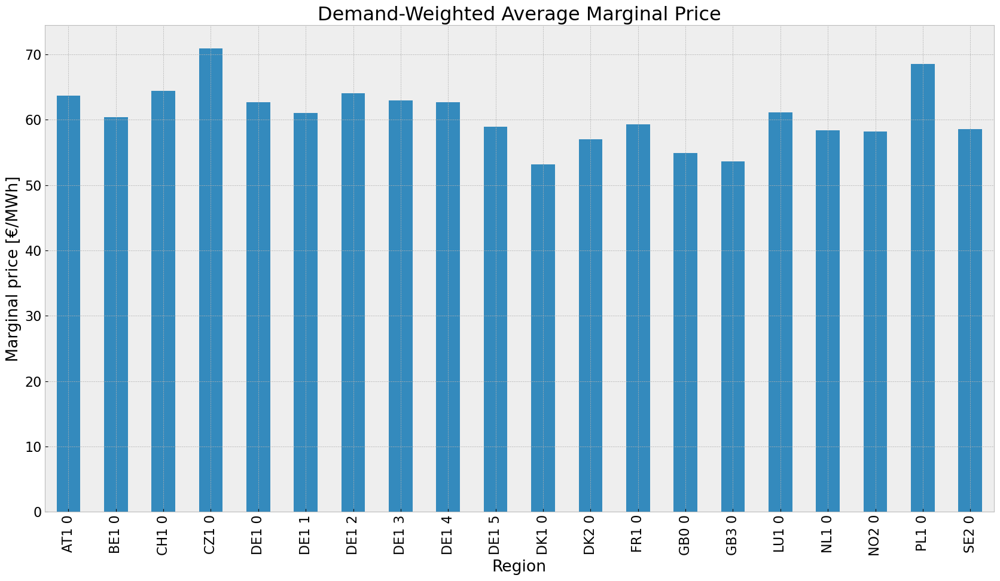

In [39]:
price_regions_table(n)

In [40]:
def price_regions(n):
    # Assuming 'n.buses_t.marginal_price' returns a DataFrame or similar structure with 'mean()' method

    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    #hprice = mean_p.filter(like='H2')
    #eprice = mean_p.drop(hprice.index)

    # Setup figure and subplots with 1 row and 2 columns
    fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()}, figsize=(8, 8))

    # Plot for eprice
    hb= plt.hexbin(
        n.buses.x,
        n.buses.y,
        gridsize=20,
        C=price_df,
        cmap=plt.cm.jet,
        zorder=3,
    )

    n.plot(ax=ax, line_widths=pd.Series(0.5, n.lines.index), bus_sizes=0)  # Plot network on the second subplot

    ax.set_title("Demand-Weighted Average Marginal Price")
    
    cb = fig.colorbar(hb, ax=ax, location='bottom')
    cb.set_label("Mean Electricity Marginal Price (EUR/MWh)")

    fig.tight_layout()
    filename = f"{n.name}_price_map.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


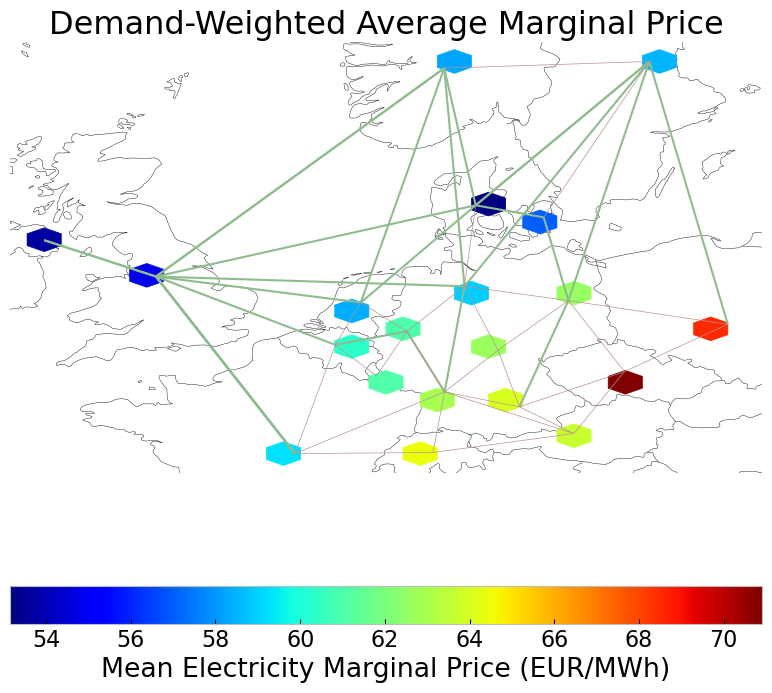

In [41]:
price_regions(n)

## Emission

In [42]:
def em_table(n):
    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack())#MWh

    #mean efficiency of each carrier
    eff = n.generators.groupby('carrier').efficiency.mean()

    e = generations.sum()
    emission = []

    for index in e.index:
        for index_c in n.carriers.index:
            for index_eff in eff.index:
                if index == index_c == index_eff:
                    em = n.carriers.loc[index_c,"co2_emissions"]
                    emission.append(em)

    df = e.to_frame()
    df.rename(columns={0: 'Generation in MWh'}, inplace=True)
    df['efficiency'] = eff
    df['emissions in Tonnes CO2/MWh'] = emission
    df['emissions in Tonnes CO2']= df['Generation in MWh']/df['efficiency']*df['emissions in Tonnes CO2/MWh']
    df['emissions in Tonnes CO2'].sum() 
    return df

em_base =em_table(n)
em_base

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,2.950103e+07,0.451621,0.1980,1.293387e+07
biomass,3.377481e+07,0.468000,0.0000,0.000000e+00
coal,7.117319e+05,0.329908,0.3361,7.250902e+05
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,9.211707e+05,0.337285,0.4069,1.111300e+06
load,3.775349e+03,1.000000,0.0000,0.000000e+00
nuclear,1.554148e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.794435e+07,1.000000,0.0000,0.000000e+00


# Offwind Cut Scenario



In [136]:
#p_max_pu of offwind generators across all regions are subtracted by 10% from 01.06.2013 to 31.12.13
cut_start=pd.to_datetime('2013-02-01 00:00:00')
duration = 180 #days
#cut_end = pd.to_datetime('2013-12-31 21:00:00')
reductionto = 0

def offwindscenario(n, cut_start, duration, reduction):
    #copy network
    n_new=n.copy()
    cut_end = cut_start + pd.Timedelta(days= duration)
    #implement pv cut
    for column in n_new.generators_t.p_max_pu.columns:
            if column.endswith('offwind-ac') or column.endswith('offwind-dc'):
                    for index,row in n_new.generators_t.p_max_pu[column].items():
                            if index >= cut_start and index <= cut_end:
                                    new_p_max_pu = n_new.generators_t.p_max_pu.at[index, column] * reductionto #0.9
                                    n_new.generators_t.p_max_pu.at[index, column] = new_p_max_pu
                                    if new_p_max_pu<0:
                                        n_new.generators_t.p_max_pu.at[index, column] = 0
    return n_new

n1 = offwindscenario(n, cut_start, duration, reductionto)
n1.name = 'inv_offwind'          

## 1. Scenario: allow additional investment of extendable generators and storage

### Allow investment

In [137]:
def allow_inv(n1,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n1.generators.p_nom_extendable.items():
        if value:  
            n1.generators.at[index, 'p_nom_min'] = n.generators.at[index, 'p_nom_opt']


    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n1.storage_units.p_nom_extendable.items():
        if value:  
            n1.storage_units.at[index, 'p_nom_min'] = n.storage_units.at[index, 'p_nom_opt']

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n1.lines.s_nom_extendable.items():
        if value:  
            n1.lines.at[index, 's_nom_min'] = n.lines.at[index, 's_nom_opt']

    #set the optimal capacity of links from the base scenario as the new minimum capacity 
    for index, value in n1.links.p_nom_extendable.items():
        if value:  
            n1.links.at[index, 'p_nom_min'] = n.links.at[index, 'p_nom_opt'] 

allow_inv(n1,n)

In [138]:
n1.optimize(solver_name= "gurobi")
#n1 = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\Offwindcut\\inv_offwind.nc")

Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:05<00:00,  2.14it/s]
INFO:linopy.io: Writing time: 38.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9v8cdjbo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9v8cdjbo.lp


Reading time = 11.53 seconds


INFO:gurobipy:Reading time = 11.53 seconds


obj: 3264863 rows, 1521502 columns, 6199416 nonzeros


INFO:gurobipy:obj: 3264863 rows, 1521502 columns, 6199416 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3264863 rows, 1521502 columns and 6199416 nonzeros


INFO:gurobipy:Optimize a model with 3264863 rows, 1521502 columns and 6199416 nonzeros


Model fingerprint: 0xba328c57


INFO:gurobipy:Model fingerprint: 0xba328c57


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 1e+03]


INFO:gurobipy:  Matrix range     [1e-02, 1e+03]


  Objective range  [3e-02, 3e+05]


INFO:gurobipy:  Objective range  [3e-02, 3e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 2178268 rows and 408911 columns (presolve time = 5s) ...


INFO:gurobipy:Presolve removed 2178268 rows and 408911 columns (presolve time = 5s) ...


Presolve removed 2178268 rows and 408911 columns


INFO:gurobipy:Presolve removed 2178268 rows and 408911 columns


Presolve time: 6.31s


INFO:gurobipy:Presolve time: 6.31s


Presolved: 1086595 rows, 1112591 columns, 3644821 nonzeros


INFO:gurobipy:Presolved: 1086595 rows, 1112591 columns, 3644821 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Elapsed ordering time = 8s


INFO:gurobipy:Elapsed ordering time = 8s


Ordering time: 13.24s


INFO:gurobipy:Ordering time: 13.24s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 172


INFO:gurobipy: Dense cols : 172


 AA' NZ     : 3.914e+06


INFO:gurobipy: AA' NZ     : 3.914e+06


 Factor NZ  : 2.846e+07 (roughly 1.1 GB of memory)


INFO:gurobipy: Factor NZ  : 2.846e+07 (roughly 1.1 GB of memory)


 Factor Ops : 5.894e+09 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.894e+09 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.12481202e+17 -8.20791880e+18  2.71e+10 8.67e+04  8.36e+13    24s


INFO:gurobipy:   0   6.12481202e+17 -8.20791880e+18  2.71e+10 8.67e+04  8.36e+13    24s


   1   5.36636590e+17 -3.56818363e+18  1.73e+10 2.88e+04  5.33e+13    25s


INFO:gurobipy:   1   5.36636590e+17 -3.56818363e+18  1.73e+10 2.88e+04  5.33e+13    25s


   2   4.43866870e+17 -1.89575806e+18  1.38e+10 1.21e+04  3.73e+13    27s


INFO:gurobipy:   2   4.43866870e+17 -1.89575806e+18  1.38e+10 1.21e+04  3.73e+13    27s


   3   2.91108324e+17 -1.09754776e+18  6.73e+09 4.31e+03  1.73e+13    30s


INFO:gurobipy:   3   2.91108324e+17 -1.09754776e+18  6.73e+09 4.31e+03  1.73e+13    30s


   4   2.31282796e+17 -4.64437290e+17  2.19e+09 1.29e+03  5.74e+12    32s


INFO:gurobipy:   4   2.31282796e+17 -4.64437290e+17  2.19e+09 1.29e+03  5.74e+12    32s


   5   1.64831301e+17 -1.43710751e+17  7.67e+08 3.91e+02  1.98e+12    33s


INFO:gurobipy:   5   1.64831301e+17 -1.43710751e+17  7.67e+08 3.91e+02  1.98e+12    33s


   6   4.99988866e+16 -2.16993951e+16  8.70e+07 3.25e+01  2.32e+11    35s


INFO:gurobipy:   6   4.99988866e+16 -2.16993951e+16  8.70e+07 3.25e+01  2.32e+11    35s


   7   1.12212472e+16 -4.45648136e+15  4.98e+06 3.01e+00  1.79e+10    37s


INFO:gurobipy:   7   1.12212472e+16 -4.45648136e+15  4.98e+06 3.01e+00  1.79e+10    37s


   8   3.57800817e+15 -9.50152747e+14  1.18e+06 1.34e-01  4.30e+09    39s


INFO:gurobipy:   8   3.57800817e+15 -9.50152747e+14  1.18e+06 1.34e-01  4.30e+09    39s


   9   2.01121043e+15 -5.74865436e+14  6.40e+05 3.95e-02  2.33e+09    41s


INFO:gurobipy:   9   2.01121043e+15 -5.74865436e+14  6.40e+05 3.95e-02  2.33e+09    41s


  10   1.41152865e+15 -3.05880691e+14  4.31e+05 3.82e-03  1.49e+09    43s


INFO:gurobipy:  10   1.41152865e+15 -3.05880691e+14  4.31e+05 3.82e-03  1.49e+09    43s


  11   9.88012319e+14 -1.79372333e+14  2.91e+05 7.21e-06  9.56e+08    45s


INFO:gurobipy:  11   9.88012319e+14 -1.79372333e+14  2.91e+05 7.21e-06  9.56e+08    45s


  12   7.13266603e+14 -1.18368091e+14  2.04e+05 1.61e-05  6.42e+08    46s


INFO:gurobipy:  12   7.13266603e+14 -1.18368091e+14  2.04e+05 1.61e-05  6.42e+08    46s


  13   4.51372914e+14 -7.70787831e+13  1.24e+05 5.38e-05  3.81e+08    48s


INFO:gurobipy:  13   4.51372914e+14 -7.70787831e+13  1.24e+05 5.38e-05  3.81e+08    48s


  14   2.68958582e+14 -4.40725349e+13  7.14e+04 7.24e-05  2.12e+08    51s


INFO:gurobipy:  14   2.68958582e+14 -4.40725349e+13  7.14e+04 7.24e-05  2.12e+08    51s


  15   2.18774171e+14 -2.53794532e+13  5.84e+04 1.77e-05  1.58e+08    53s


INFO:gurobipy:  15   2.18774171e+14 -2.53794532e+13  5.84e+04 1.77e-05  1.58e+08    53s


  16   1.36433360e+14 -1.78721440e+13  3.56e+04 6.56e-06  9.43e+07    54s


INFO:gurobipy:  16   1.36433360e+14 -1.78721440e+13  3.56e+04 6.56e-06  9.43e+07    54s


  17   1.08668309e+14 -1.18517151e+13  2.80e+04 3.21e-06  6.98e+07    56s


INFO:gurobipy:  17   1.08668309e+14 -1.18517151e+13  2.80e+04 3.21e-06  6.98e+07    56s


  18   5.67090299e+13 -7.93668216e+12  1.44e+04 3.32e-06  3.59e+07    58s


INFO:gurobipy:  18   5.67090299e+13 -7.93668216e+12  1.44e+04 3.32e-06  3.59e+07    58s


  19   3.13438923e+13 -6.51707760e+12  8.57e+03 2.44e-06  2.08e+07    60s


INFO:gurobipy:  19   3.13438923e+13 -6.51707760e+12  8.57e+03 2.44e-06  2.08e+07    60s


  20   2.52676830e+13 -6.20773293e+12  6.97e+03 2.97e-06  1.72e+07    62s


INFO:gurobipy:  20   2.52676830e+13 -6.20773293e+12  6.97e+03 2.97e-06  1.72e+07    62s


  21   1.81673255e+13 -5.71432757e+12  5.22e+03 2.58e-06  1.27e+07    64s


INFO:gurobipy:  21   1.81673255e+13 -5.71432757e+12  5.22e+03 2.58e-06  1.27e+07    64s


  22   1.58268032e+13 -5.42277490e+12  4.53e+03 2.35e-06  1.12e+07    66s


INFO:gurobipy:  22   1.58268032e+13 -5.42277490e+12  4.53e+03 2.35e-06  1.12e+07    66s


  23   1.35893419e+13 -4.77698564e+12  3.90e+03 1.92e-06  9.58e+06    68s


INFO:gurobipy:  23   1.35893419e+13 -4.77698564e+12  3.90e+03 1.92e-06  9.58e+06    68s


  24   8.35797683e+12 -4.21738338e+12  2.34e+03 1.68e-06  6.34e+06    70s


INFO:gurobipy:  24   8.35797683e+12 -4.21738338e+12  2.34e+03 1.68e-06  6.34e+06    70s


  25   5.06379075e+12 -3.12377673e+12  1.37e+03 1.24e-06  3.99e+06    73s


INFO:gurobipy:  25   5.06379075e+12 -3.12377673e+12  1.37e+03 1.24e-06  3.99e+06    73s


  26   2.46233110e+12 -1.86892061e+12  5.97e+02 1.13e-06  2.02e+06    76s


INFO:gurobipy:  26   2.46233110e+12 -1.86892061e+12  5.97e+02 1.13e-06  2.02e+06    76s


  27   2.09262550e+12 -1.69324380e+12  5.00e+02 9.24e-07  1.75e+06    79s


INFO:gurobipy:  27   2.09262550e+12 -1.69324380e+12  5.00e+02 9.24e-07  1.75e+06    79s


  28   1.61059101e+12 -1.56900538e+12  3.76e+02 8.64e-07  1.45e+06    81s


INFO:gurobipy:  28   1.61059101e+12 -1.56900538e+12  3.76e+02 8.64e-07  1.45e+06    81s


  29   9.13384397e+11 -1.32177316e+12  1.90e+02 6.26e-07  9.92e+05    83s


INFO:gurobipy:  29   9.13384397e+11 -1.32177316e+12  1.90e+02 6.26e-07  9.92e+05    83s


  30   6.11793220e+11 -1.06514803e+12  1.13e+02 5.66e-07  7.33e+05    86s


INFO:gurobipy:  30   6.11793220e+11 -1.06514803e+12  1.13e+02 5.66e-07  7.33e+05    86s


  31   4.49000202e+11 -7.05270634e+11  7.72e+01 2.53e-07  5.01e+05    88s


INFO:gurobipy:  31   4.49000202e+11 -7.05270634e+11  7.72e+01 2.53e-07  5.01e+05    88s


  32   2.82015951e+11 -3.32836407e+11  4.07e+01 7.45e-07  2.65e+05    91s


INFO:gurobipy:  32   2.82015951e+11 -3.32836407e+11  4.07e+01 7.45e-07  2.65e+05    91s


  33   2.25476388e+11 -8.70987126e+10  3.00e+01 9.39e-07  1.35e+05    94s


INFO:gurobipy:  33   2.25476388e+11 -8.70987126e+10  3.00e+01 9.39e-07  1.35e+05    94s


  34   1.67531424e+11 -2.51182222e+10  1.94e+01 8.49e-07  8.35e+04    97s


INFO:gurobipy:  34   1.67531424e+11 -2.51182222e+10  1.94e+01 8.49e-07  8.35e+04    97s


  35   1.44983461e+11 -1.21589992e+09  1.53e+01 6.71e-07  6.34e+04    99s


INFO:gurobipy:  35   1.44983461e+11 -1.21589992e+09  1.53e+01 6.71e-07  6.34e+04    99s


  36   1.30884421e+11  1.06501532e+10  1.27e+01 3.91e-07  5.22e+04   100s


INFO:gurobipy:  36   1.30884421e+11  1.06501532e+10  1.27e+01 3.91e-07  5.22e+04   100s


  37   1.14083276e+11  2.10271791e+10  9.75e+00 4.32e-07  4.04e+04   101s


INFO:gurobipy:  37   1.14083276e+11  2.10271791e+10  9.75e+00 4.32e-07  4.04e+04   101s


  38   1.06199381e+11  3.06752524e+10  8.39e+00 4.17e-07  3.28e+04   103s


INFO:gurobipy:  38   1.06199381e+11  3.06752524e+10  8.39e+00 4.17e-07  3.28e+04   103s


  39   9.77723699e+10  3.83747154e+10  6.98e+00 7.00e-07  2.59e+04   105s


INFO:gurobipy:  39   9.77723699e+10  3.83747154e+10  6.98e+00 7.00e-07  2.59e+04   105s


  40   8.77642353e+10  4.42900529e+10  5.33e+00 1.25e-06  1.90e+04   108s


INFO:gurobipy:  40   8.77642353e+10  4.42900529e+10  5.33e+00 1.25e-06  1.90e+04   108s


  41   8.22694928e+10  4.78486687e+10  4.45e+00 1.76e-06  1.50e+04   111s


INFO:gurobipy:  41   8.22694928e+10  4.78486687e+10  4.45e+00 1.76e-06  1.50e+04   111s


  42   7.63682143e+10  4.91787325e+10  3.48e+00 1.21e-06  1.19e+04   113s


INFO:gurobipy:  42   7.63682143e+10  4.91787325e+10  3.48e+00 1.21e-06  1.19e+04   113s


  43   7.26660264e+10  5.09756186e+10  2.83e+00 3.16e-06  9.48e+03   116s


INFO:gurobipy:  43   7.26660264e+10  5.09756186e+10  2.83e+00 3.16e-06  9.48e+03   116s


  44   6.98024995e+10  5.30350613e+10  2.32e+00 7.00e-07  7.35e+03   119s


INFO:gurobipy:  44   6.98024995e+10  5.30350613e+10  2.32e+00 7.00e-07  7.35e+03   119s


  45   6.61890304e+10  5.37681226e+10  1.71e+00 7.90e-07  5.44e+03   122s


INFO:gurobipy:  45   6.61890304e+10  5.37681226e+10  1.71e+00 7.90e-07  5.44e+03   122s


  46   6.39555032e+10  5.45224685e+10  1.29e+00 8.01e-07  4.13e+03   125s


INFO:gurobipy:  46   6.39555032e+10  5.45224685e+10  1.29e+00 8.01e-07  4.13e+03   125s


  47   6.25429201e+10  5.49130503e+10  1.04e+00 6.44e-07  3.34e+03   128s


INFO:gurobipy:  47   6.25429201e+10  5.49130503e+10  1.04e+00 6.44e-07  3.34e+03   128s


  48   6.12517687e+10  5.53007279e+10  7.96e-01 7.78e-07  2.60e+03   131s


INFO:gurobipy:  48   6.12517687e+10  5.53007279e+10  7.96e-01 7.78e-07  2.60e+03   131s


  49   6.03062415e+10  5.55460115e+10  6.22e-01 5.89e-07  2.08e+03   134s


INFO:gurobipy:  49   6.03062415e+10  5.55460115e+10  6.22e-01 5.89e-07  2.08e+03   134s


  50   5.98691635e+10  5.57313433e+10  5.41e-01 8.05e-07  1.81e+03   137s


INFO:gurobipy:  50   5.98691635e+10  5.57313433e+10  5.41e-01 8.05e-07  1.81e+03   137s


  51   5.91765945e+10  5.59178737e+10  4.14e-01 1.06e-06  1.42e+03   140s


INFO:gurobipy:  51   5.91765945e+10  5.59178737e+10  4.14e-01 1.06e-06  1.42e+03   140s


  52   5.88852028e+10  5.60729339e+10  3.61e-01 1.22e-06  1.23e+03   142s


INFO:gurobipy:  52   5.88852028e+10  5.60729339e+10  3.61e-01 1.22e-06  1.23e+03   142s


  53   5.85507414e+10  5.61572125e+10  3.01e-01 4.16e-07  1.04e+03   145s


INFO:gurobipy:  53   5.85507414e+10  5.61572125e+10  3.01e-01 4.16e-07  1.04e+03   145s


  54   5.82405602e+10  5.62787174e+10  2.44e-01 4.52e-07  8.55e+02   148s


INFO:gurobipy:  54   5.82405602e+10  5.62787174e+10  2.44e-01 4.52e-07  8.55e+02   148s


  55   5.80555754e+10  5.63913594e+10  2.10e-01 1.30e-06  7.25e+02   151s


INFO:gurobipy:  55   5.80555754e+10  5.63913594e+10  2.10e-01 1.30e-06  7.25e+02   151s


  56   5.78421305e+10  5.64611506e+10  1.71e-01 1.13e-06  6.01e+02   153s


INFO:gurobipy:  56   5.78421305e+10  5.64611506e+10  1.71e-01 1.13e-06  6.01e+02   153s


  57   5.77050253e+10  5.64955707e+10  1.47e-01 1.06e-06  5.26e+02   156s


INFO:gurobipy:  57   5.77050253e+10  5.64955707e+10  1.47e-01 1.06e-06  5.26e+02   156s


  58   5.76022957e+10  5.65528255e+10  1.28e-01 6.71e-07  4.56e+02   159s


INFO:gurobipy:  58   5.76022957e+10  5.65528255e+10  1.28e-01 6.71e-07  4.56e+02   159s


  59   5.74830272e+10  5.65853037e+10  1.07e-01 8.20e-07  3.90e+02   162s


INFO:gurobipy:  59   5.74830272e+10  5.65853037e+10  1.07e-01 8.20e-07  3.90e+02   162s


  60   5.73746236e+10  5.66095599e+10  8.77e-02 9.54e-07  3.32e+02   164s


INFO:gurobipy:  60   5.73746236e+10  5.66095599e+10  8.77e-02 9.54e-07  3.32e+02   164s


  61   5.72888343e+10  5.66444181e+10  7.25e-02 6.74e-07  2.79e+02   167s


INFO:gurobipy:  61   5.72888343e+10  5.66444181e+10  7.25e-02 6.74e-07  2.79e+02   167s


  62   5.72252899e+10  5.66658566e+10  6.12e-02 6.71e-07  2.42e+02   170s


INFO:gurobipy:  62   5.72252899e+10  5.66658566e+10  6.12e-02 6.71e-07  2.42e+02   170s


  63   5.71769800e+10  5.66791369e+10  5.26e-02 5.55e-07  2.15e+02   172s


INFO:gurobipy:  63   5.71769800e+10  5.66791369e+10  5.26e-02 5.55e-07  2.15e+02   172s


  64   5.71402353e+10  5.66869134e+10  4.62e-02 3.77e-07  1.96e+02   175s


INFO:gurobipy:  64   5.71402353e+10  5.66869134e+10  4.62e-02 3.77e-07  1.96e+02   175s


  65   5.70903583e+10  5.67080429e+10  3.76e-02 3.66e-07  1.65e+02   178s


INFO:gurobipy:  65   5.70903583e+10  5.67080429e+10  3.76e-02 3.66e-07  1.65e+02   178s


  66   5.70703431e+10  5.67384409e+10  3.42e-02 3.40e-07  1.43e+02   180s


INFO:gurobipy:  66   5.70703431e+10  5.67384409e+10  3.42e-02 3.40e-07  1.43e+02   180s


  67   5.70571884e+10  5.67552509e+10  3.19e-02 1.53e-07  1.30e+02   183s


INFO:gurobipy:  67   5.70571884e+10  5.67552509e+10  3.19e-02 1.53e-07  1.30e+02   183s


  68   5.70411931e+10  5.67628246e+10  2.93e-02 1.48e-07  1.20e+02   185s


INFO:gurobipy:  68   5.70411931e+10  5.67628246e+10  2.93e-02 1.48e-07  1.20e+02   185s


  69   5.70225201e+10  5.67717359e+10  2.61e-02 1.42e-07  1.08e+02   188s


INFO:gurobipy:  69   5.70225201e+10  5.67717359e+10  2.61e-02 1.42e-07  1.08e+02   188s


  70   5.70145753e+10  5.67762278e+10  2.48e-02 1.92e-07  1.03e+02   190s


INFO:gurobipy:  70   5.70145753e+10  5.67762278e+10  2.48e-02 1.92e-07  1.03e+02   190s


  71   5.70093777e+10  5.67822518e+10  2.39e-02 3.02e-07  9.80e+01   193s


INFO:gurobipy:  71   5.70093777e+10  5.67822518e+10  2.39e-02 3.02e-07  9.80e+01   193s


  72   5.70032557e+10  5.67857659e+10  2.27e-02 1.33e-07  9.39e+01   196s


INFO:gurobipy:  72   5.70032557e+10  5.67857659e+10  2.27e-02 1.33e-07  9.39e+01   196s


  73   5.69980592e+10  5.67892643e+10  2.17e-02 4.73e-07  9.01e+01   198s


INFO:gurobipy:  73   5.69980592e+10  5.67892643e+10  2.17e-02 4.73e-07  9.01e+01   198s


  74   5.69907118e+10  5.67937696e+10  2.03e-02 1.28e-07  8.50e+01   201s


INFO:gurobipy:  74   5.69907118e+10  5.67937696e+10  2.03e-02 1.28e-07  8.50e+01   201s


  75   5.69881523e+10  5.67949163e+10  1.98e-02 2.89e-07  8.33e+01   204s


INFO:gurobipy:  75   5.69881523e+10  5.67949163e+10  1.98e-02 2.89e-07  8.33e+01   204s


  76   5.69802218e+10  5.68021862e+10  1.83e-02 1.74e-07  7.68e+01   207s


INFO:gurobipy:  76   5.69802218e+10  5.68021862e+10  1.83e-02 1.74e-07  7.68e+01   207s


  77   5.69750876e+10  5.68079804e+10  1.73e-02 2.43e-07  7.21e+01   210s


INFO:gurobipy:  77   5.69750876e+10  5.68079804e+10  1.73e-02 2.43e-07  7.21e+01   210s


  78   5.69709260e+10  5.68120336e+10  1.65e-02 1.16e-07  6.85e+01   213s


INFO:gurobipy:  78   5.69709260e+10  5.68120336e+10  1.65e-02 1.16e-07  6.85e+01   213s


  79   5.69664864e+10  5.68155208e+10  1.57e-02 1.13e-07  6.51e+01   215s


INFO:gurobipy:  79   5.69664864e+10  5.68155208e+10  1.57e-02 1.13e-07  6.51e+01   215s


  80   5.69613441e+10  5.68194776e+10  1.47e-02 1.10e-07  6.12e+01   218s


INFO:gurobipy:  80   5.69613441e+10  5.68194776e+10  1.47e-02 1.10e-07  6.12e+01   218s


  81   5.69564801e+10  5.68219581e+10  1.38e-02 1.08e-07  5.80e+01   221s


INFO:gurobipy:  81   5.69564801e+10  5.68219581e+10  1.38e-02 1.08e-07  5.80e+01   221s


  82   5.69535270e+10  5.68255160e+10  1.32e-02 1.61e-07  5.52e+01   224s


INFO:gurobipy:  82   5.69535270e+10  5.68255160e+10  1.32e-02 1.61e-07  5.52e+01   224s


  83   5.69506360e+10  5.68272221e+10  1.27e-02 1.05e-07  5.32e+01   227s


INFO:gurobipy:  83   5.69506360e+10  5.68272221e+10  1.27e-02 1.05e-07  5.32e+01   227s


  84   5.69428087e+10  5.68305391e+10  1.13e-02 1.02e-07  4.84e+01   230s


INFO:gurobipy:  84   5.69428087e+10  5.68305391e+10  1.13e-02 1.02e-07  4.84e+01   230s


  85   5.69351440e+10  5.68346120e+10  1.00e-02 1.29e-07  4.33e+01   233s


INFO:gurobipy:  85   5.69351440e+10  5.68346120e+10  1.00e-02 1.29e-07  4.33e+01   233s


  86   5.69275983e+10  5.68376642e+10  8.78e-03 3.16e-07  3.87e+01   235s


INFO:gurobipy:  86   5.69275983e+10  5.68376642e+10  8.78e-03 3.16e-07  3.87e+01   235s


  87   5.69216835e+10  5.68427488e+10  7.81e-03 5.07e-07  3.40e+01   238s


INFO:gurobipy:  87   5.69216835e+10  5.68427488e+10  7.81e-03 5.07e-07  3.40e+01   238s


  88   5.69140289e+10  5.68470791e+10  6.57e-03 3.73e-07  2.88e+01   241s


INFO:gurobipy:  88   5.69140289e+10  5.68470791e+10  6.57e-03 3.73e-07  2.88e+01   241s


  89   5.69096949e+10  5.68506544e+10  5.86e-03 2.68e-07  2.54e+01   243s


INFO:gurobipy:  89   5.69096949e+10  5.68506544e+10  5.86e-03 2.68e-07  2.54e+01   243s


  90   5.69043786e+10  5.68527791e+10  5.01e-03 3.43e-07  2.22e+01   246s


INFO:gurobipy:  90   5.69043786e+10  5.68527791e+10  5.01e-03 3.43e-07  2.22e+01   246s


  91   5.69001794e+10  5.68550693e+10  4.34e-03 2.98e-07  1.94e+01   249s


INFO:gurobipy:  91   5.69001794e+10  5.68550693e+10  4.34e-03 2.98e-07  1.94e+01   249s


  92   5.68963646e+10  5.68579431e+10  3.74e-03 3.73e-07  1.65e+01   252s


INFO:gurobipy:  92   5.68963646e+10  5.68579431e+10  3.74e-03 3.73e-07  1.65e+01   252s


  93   5.68923202e+10  5.68591246e+10  3.09e-03 3.58e-07  1.43e+01   255s


INFO:gurobipy:  93   5.68923202e+10  5.68591246e+10  3.09e-03 3.58e-07  1.43e+01   255s


  94   5.68900711e+10  5.68602302e+10  2.73e-03 3.13e-07  1.28e+01   257s


INFO:gurobipy:  94   5.68900711e+10  5.68602302e+10  2.73e-03 3.13e-07  1.28e+01   257s


  95   5.68893913e+10  5.68609552e+10  2.62e-03 3.58e-07  1.22e+01   260s


INFO:gurobipy:  95   5.68893913e+10  5.68609552e+10  2.62e-03 3.58e-07  1.22e+01   260s


  96   5.68886712e+10  5.68615134e+10  2.50e-03 2.98e-07  1.17e+01   262s


INFO:gurobipy:  96   5.68886712e+10  5.68615134e+10  2.50e-03 2.98e-07  1.17e+01   262s


  97   5.68854409e+10  5.68629768e+10  1.99e-03 6.56e-07  9.65e+00   265s


INFO:gurobipy:  97   5.68854409e+10  5.68629768e+10  1.99e-03 6.56e-07  9.65e+00   265s


  98   5.68838388e+10  5.68635925e+10  1.74e-03 6.85e-07  8.69e+00   267s


INFO:gurobipy:  98   5.68838388e+10  5.68635925e+10  1.74e-03 6.85e-07  8.69e+00   267s


  99   5.68826352e+10  5.68640665e+10  1.55e-03 6.11e-07  7.97e+00   269s


INFO:gurobipy:  99   5.68826352e+10  5.68640665e+10  1.55e-03 6.11e-07  7.97e+00   269s


 100   5.68815952e+10  5.68650476e+10  1.39e-03 1.51e-06  7.10e+00   272s


INFO:gurobipy: 100   5.68815952e+10  5.68650476e+10  1.39e-03 1.51e-06  7.10e+00   272s


 101   5.68806894e+10  5.68660362e+10  1.25e-03 2.57e-06  6.29e+00   275s


INFO:gurobipy: 101   5.68806894e+10  5.68660362e+10  1.25e-03 2.57e-06  6.29e+00   275s


 102   5.68798371e+10  5.68665515e+10  1.12e-03 3.20e-06  5.70e+00   278s


INFO:gurobipy: 102   5.68798371e+10  5.68665515e+10  1.12e-03 3.20e-06  5.70e+00   278s


 103   5.68792456e+10  5.68674329e+10  1.03e-03 2.09e-06  5.07e+00   280s


INFO:gurobipy: 103   5.68792456e+10  5.68674329e+10  1.03e-03 2.09e-06  5.07e+00   280s


 104   5.68783320e+10  5.68678008e+10  8.83e-04 1.37e-06  4.52e+00   283s


INFO:gurobipy: 104   5.68783320e+10  5.68678008e+10  8.83e-04 1.37e-06  4.52e+00   283s


 105   5.68772085e+10  5.68685736e+10  7.08e-04 3.58e-07  3.70e+00   286s


INFO:gurobipy: 105   5.68772085e+10  5.68685736e+10  7.08e-04 3.58e-07  3.70e+00   286s


 106   5.68770075e+10  5.68690118e+10  6.77e-04 4.92e-07  3.43e+00   288s


INFO:gurobipy: 106   5.68770075e+10  5.68690118e+10  6.77e-04 4.92e-07  3.43e+00   288s


 107   5.68766982e+10  5.68693587e+10  6.30e-04 5.07e-07  3.15e+00   291s


INFO:gurobipy: 107   5.68766982e+10  5.68693587e+10  6.30e-04 5.07e-07  3.15e+00   291s


 108   5.68760674e+10  5.68695278e+10  5.34e-04 5.36e-07  2.81e+00   294s


INFO:gurobipy: 108   5.68760674e+10  5.68695278e+10  5.34e-04 5.36e-07  2.81e+00   294s


 109   5.68755891e+10  5.68699735e+10  4.61e-04 5.36e-07  2.41e+00   297s


INFO:gurobipy: 109   5.68755891e+10  5.68699735e+10  4.61e-04 5.36e-07  2.41e+00   297s


 110   5.68752881e+10  5.68703098e+10  4.15e-04 5.22e-07  2.14e+00   299s


INFO:gurobipy: 110   5.68752881e+10  5.68703098e+10  4.15e-04 5.22e-07  2.14e+00   299s


 111   5.68751107e+10  5.68705934e+10  3.88e-04 5.66e-07  1.94e+00   302s


INFO:gurobipy: 111   5.68751107e+10  5.68705934e+10  3.88e-04 5.66e-07  1.94e+00   302s


 112   5.68745930e+10  5.68707665e+10  3.10e-04 4.92e-07  1.64e+00   305s


INFO:gurobipy: 112   5.68745930e+10  5.68707665e+10  3.10e-04 4.92e-07  1.64e+00   305s


 113   5.68744422e+10  5.68709582e+10  2.87e-04 5.96e-07  1.49e+00   308s


INFO:gurobipy: 113   5.68744422e+10  5.68709582e+10  2.87e-04 5.96e-07  1.49e+00   308s


 114   5.68741840e+10  5.68712290e+10  2.48e-04 3.73e-07  1.27e+00   310s


INFO:gurobipy: 114   5.68741840e+10  5.68712290e+10  2.48e-04 3.73e-07  1.27e+00   310s


 115   5.68740416e+10  5.68713588e+10  2.27e-04 3.13e-07  1.15e+00   313s


INFO:gurobipy: 115   5.68740416e+10  5.68713588e+10  2.27e-04 3.13e-07  1.15e+00   313s


 116   5.68738613e+10  5.68714616e+10  2.00e-04 3.28e-07  1.03e+00   316s


INFO:gurobipy: 116   5.68738613e+10  5.68714616e+10  2.00e-04 3.28e-07  1.03e+00   316s


 117   5.68736840e+10  5.68715454e+10  1.73e-04 2.64e-07  9.17e-01   318s


INFO:gurobipy: 117   5.68736840e+10  5.68715454e+10  1.73e-04 2.64e-07  9.17e-01   318s


 118   5.68734104e+10  5.68716219e+10  1.33e-04 3.13e-07  7.66e-01   321s


INFO:gurobipy: 118   5.68734104e+10  5.68716219e+10  1.33e-04 3.13e-07  7.66e-01   321s


 119   5.68733482e+10  5.68717445e+10  1.24e-04 4.47e-07  6.87e-01   324s


INFO:gurobipy: 119   5.68733482e+10  5.68717445e+10  1.24e-04 4.47e-07  6.87e-01   324s


 120   5.68732577e+10  5.68717957e+10  1.10e-04 4.02e-07  6.26e-01   327s


INFO:gurobipy: 120   5.68732577e+10  5.68717957e+10  1.10e-04 4.02e-07  6.26e-01   327s


 121   5.68731346e+10  5.68718770e+10  9.20e-05 4.77e-07  5.38e-01   330s


INFO:gurobipy: 121   5.68731346e+10  5.68718770e+10  9.20e-05 4.77e-07  5.38e-01   330s


 122   5.68731241e+10  5.68719018e+10  9.05e-05 5.22e-07  5.23e-01   333s


INFO:gurobipy: 122   5.68731241e+10  5.68719018e+10  9.05e-05 5.22e-07  5.23e-01   333s


 123   5.68730891e+10  5.68719540e+10  8.53e-05 4.92e-07  4.86e-01   335s


INFO:gurobipy: 123   5.68730891e+10  5.68719540e+10  8.53e-05 4.92e-07  4.86e-01   335s


 124   5.68730502e+10  5.68720127e+10  7.96e-05 4.47e-07  4.45e-01   338s


INFO:gurobipy: 124   5.68730502e+10  5.68720127e+10  7.96e-05 4.47e-07  4.45e-01   338s


 125   5.68729567e+10  5.68720650e+10  6.58e-05 4.33e-07  3.82e-01   342s


INFO:gurobipy: 125   5.68729567e+10  5.68720650e+10  6.58e-05 4.33e-07  3.82e-01   342s


 126   5.68728257e+10  5.68721304e+10  4.64e-05 3.28e-07  2.97e-01   345s


INFO:gurobipy: 126   5.68728257e+10  5.68721304e+10  4.64e-05 3.28e-07  2.97e-01   345s


 127   5.68727851e+10  5.68722087e+10  4.05e-05 2.68e-07  2.47e-01   349s


INFO:gurobipy: 127   5.68727851e+10  5.68722087e+10  4.05e-05 2.68e-07  2.47e-01   349s


 128   5.68727580e+10  5.68722212e+10  3.65e-05 3.79e-07  2.30e-01   352s


INFO:gurobipy: 128   5.68727580e+10  5.68722212e+10  3.65e-05 3.79e-07  2.30e-01   352s


 129   5.68727008e+10  5.68722393e+10  2.82e-05 3.20e-07  1.97e-01   355s


INFO:gurobipy: 129   5.68727008e+10  5.68722393e+10  2.82e-05 3.20e-07  1.97e-01   355s


 130   5.68726659e+10  5.68722734e+10  2.32e-05 5.81e-07  1.67e-01   359s


INFO:gurobipy: 130   5.68726659e+10  5.68722734e+10  2.32e-05 5.81e-07  1.67e-01   359s


 131   5.68726622e+10  5.68722972e+10  2.27e-05 5.22e-07  1.56e-01   361s


INFO:gurobipy: 131   5.68726622e+10  5.68722972e+10  2.27e-05 5.22e-07  1.56e-01   361s


 132   5.68726357e+10  5.68723268e+10  1.89e-05 4.62e-07  1.32e-01   365s


INFO:gurobipy: 132   5.68726357e+10  5.68723268e+10  1.89e-05 4.62e-07  1.32e-01   365s


 133   5.68726082e+10  5.68723583e+10  1.49e-05 3.73e-07  1.07e-01   368s


INFO:gurobipy: 133   5.68726082e+10  5.68723583e+10  1.49e-05 3.73e-07  1.07e-01   368s


 134   5.68725892e+10  5.68723890e+10  1.21e-05 2.98e-07  8.54e-02   371s


INFO:gurobipy: 134   5.68725892e+10  5.68723890e+10  1.21e-05 2.98e-07  8.54e-02   371s


 135   5.68725713e+10  5.68723978e+10  9.56e-06 2.83e-07  7.39e-02   375s


INFO:gurobipy: 135   5.68725713e+10  5.68723978e+10  9.56e-06 2.83e-07  7.39e-02   375s


 136   5.68725650e+10  5.68724032e+10  8.66e-06 2.68e-07  6.89e-02   378s


INFO:gurobipy: 136   5.68725650e+10  5.68724032e+10  8.66e-06 2.68e-07  6.89e-02   378s


 137   5.68725605e+10  5.68724197e+10  7.99e-06 2.38e-07  6.00e-02   382s


INFO:gurobipy: 137   5.68725605e+10  5.68724197e+10  7.99e-06 2.38e-07  6.00e-02   382s


 138   5.68725510e+10  5.68724304e+10  6.63e-06 9.75e-07  5.14e-02   386s


INFO:gurobipy: 138   5.68725510e+10  5.68724304e+10  6.63e-06 9.75e-07  5.14e-02   386s


 139   5.68725454e+10  5.68724324e+10  5.81e-06 1.94e-07  4.81e-02   389s


INFO:gurobipy: 139   5.68725454e+10  5.68724324e+10  5.81e-06 1.94e-07  4.81e-02   389s


 140   5.68725420e+10  5.68724413e+10  5.30e-06 1.79e-07  4.29e-02   393s


INFO:gurobipy: 140   5.68725420e+10  5.68724413e+10  5.30e-06 1.79e-07  4.29e-02   393s


 141   5.68725380e+10  5.68724455e+10  4.70e-06 3.33e-07  3.94e-02   396s


INFO:gurobipy: 141   5.68725380e+10  5.68724455e+10  4.70e-06 3.33e-07  3.94e-02   396s


 142   5.68725343e+10  5.68724472e+10  4.15e-06 1.49e-07  3.71e-02   399s


INFO:gurobipy: 142   5.68725343e+10  5.68724472e+10  4.15e-06 1.49e-07  3.71e-02   399s


 143   5.68725323e+10  5.68724586e+10  3.86e-06 2.08e-07  3.14e-02   403s


INFO:gurobipy: 143   5.68725323e+10  5.68724586e+10  3.86e-06 2.08e-07  3.14e-02   403s


 144   5.68725274e+10  5.68724730e+10  3.19e-06 2.64e-07  2.32e-02   407s


INFO:gurobipy: 144   5.68725274e+10  5.68724730e+10  3.19e-06 2.64e-07  2.32e-02   407s


 145   5.68725175e+10  5.68724795e+10  1.72e-06 3.59e-07  1.62e-02   411s


INFO:gurobipy: 145   5.68725175e+10  5.68724795e+10  1.72e-06 3.59e-07  1.62e-02   411s


 146   5.68725159e+10  5.68724838e+10  1.48e-06 2.66e-07  1.36e-02   414s


INFO:gurobipy: 146   5.68725159e+10  5.68724838e+10  1.48e-06 2.66e-07  1.36e-02   414s


 147   5.68725148e+10  5.68724878e+10  1.31e-06 2.59e-07  1.15e-02   420s


INFO:gurobipy: 147   5.68725148e+10  5.68724878e+10  1.31e-06 2.59e-07  1.15e-02   420s


 148   5.68725118e+10  5.68724889e+10  8.51e-07 2.13e-07  9.71e-03   424s


INFO:gurobipy: 148   5.68725118e+10  5.68724889e+10  8.51e-07 2.13e-07  9.71e-03   424s


 149   5.68725116e+10  5.68724908e+10  8.25e-07 3.51e-07  8.85e-03   428s


INFO:gurobipy: 149   5.68725116e+10  5.68724908e+10  8.25e-07 3.51e-07  8.85e-03   428s


 150   5.68725098e+10  5.68724988e+10  5.46e-07 2.03e-07  4.68e-03   432s


INFO:gurobipy: 150   5.68725098e+10  5.68724988e+10  5.46e-07 2.03e-07  4.68e-03   432s


 151   5.68725084e+10  5.68725035e+10  3.31e-07 4.56e-07  2.10e-03   437s


INFO:gurobipy: 151   5.68725084e+10  5.68725035e+10  3.31e-07 4.56e-07  2.10e-03   437s


 152   5.68725075e+10  5.68725050e+10  1.66e-07 3.64e-07  1.05e-03   441s


INFO:gurobipy: 152   5.68725075e+10  5.68725050e+10  1.66e-07 3.64e-07  1.05e-03   441s


 153   5.68725070e+10  5.68725056e+10  8.27e-08 2.19e-07  6.22e-04   445s


INFO:gurobipy: 153   5.68725070e+10  5.68725056e+10  8.27e-08 2.19e-07  6.22e-04   445s


 154   5.68725068e+10  5.68725057e+10  4.67e-08 3.57e-07  4.90e-04   448s


INFO:gurobipy: 154   5.68725068e+10  5.68725057e+10  4.67e-08 3.57e-07  4.90e-04   448s


 155   5.68725066e+10  5.68725061e+10  2.16e-07 2.98e-07  2.35e-04   451s


INFO:gurobipy: 155   5.68725066e+10  5.68725061e+10  2.16e-07 2.98e-07  2.35e-04   451s


 156   5.68725065e+10  5.68725063e+10  1.29e-07 4.45e-07  1.07e-04   454s


INFO:gurobipy: 156   5.68725065e+10  5.68725063e+10  1.29e-07 4.45e-07  1.07e-04   454s


 157   5.68725065e+10  5.68725063e+10  9.29e-08 3.28e-07  4.82e-05   456s


INFO:gurobipy: 157   5.68725065e+10  5.68725063e+10  9.29e-08 3.28e-07  4.82e-05   456s


 158   5.68725064e+10  5.68725064e+10  2.55e-07 3.17e-07  1.31e-05   458s


INFO:gurobipy: 158   5.68725064e+10  5.68725064e+10  2.55e-07 3.17e-07  1.31e-05   458s


 159   5.68725064e+10  5.68725064e+10  1.59e-07 4.73e-07  2.66e-06   461s


INFO:gurobipy: 159   5.68725064e+10  5.68725064e+10  1.59e-07 4.73e-07  2.66e-06   461s


 160   5.68725064e+10  5.68725064e+10  5.50e-08 2.55e-07  3.28e-07   463s


INFO:gurobipy: 160   5.68725064e+10  5.68725064e+10  5.50e-08 2.55e-07  3.28e-07   463s


 161   5.68725064e+10  5.68725064e+10  5.08e-08 8.69e-07  3.84e-08   465s


INFO:gurobipy: 161   5.68725064e+10  5.68725064e+10  5.08e-08 8.69e-07  3.84e-08   465s


 162   5.68725064e+10  5.68725064e+10  7.88e-07 2.84e-07  1.06e-08   468s


INFO:gurobipy: 162   5.68725064e+10  5.68725064e+10  7.88e-07 2.84e-07  1.06e-08   468s


 163   5.68725064e+10  5.68725064e+10  2.86e-07 4.10e-07  2.75e-09   470s


INFO:gurobipy: 163   5.68725064e+10  5.68725064e+10  2.86e-07 4.10e-07  2.75e-09   470s


INFO:gurobipy:


Barrier solved model in 163 iterations and 470.02 seconds (171.49 work units)


INFO:gurobipy:Barrier solved model in 163 iterations and 470.02 seconds (171.49 work units)


Optimal objective 5.68725064e+10


INFO:gurobipy:Optimal objective 5.68725064e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


  522071 DPushes remaining with DInf 0.0000000e+00               474s


INFO:gurobipy:  522071 DPushes remaining with DInf 0.0000000e+00               474s


   87422 DPushes remaining with DInf 0.0000000e+00               538s


INFO:gurobipy:   87422 DPushes remaining with DInf 0.0000000e+00               538s


   11611 DPushes remaining with DInf 0.0000000e+00               552s


INFO:gurobipy:   11611 DPushes remaining with DInf 0.0000000e+00               552s


    1273 DPushes remaining with DInf 0.0000000e+00               561s


INFO:gurobipy:    1273 DPushes remaining with DInf 0.0000000e+00               561s


       0 DPushes remaining with DInf 0.0000000e+00               574s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00               574s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.5


INFO:gurobipy:


   20816 PPushes remaining with PInf 2.2696895e-06               574s


INFO:gurobipy:   20816 PPushes remaining with PInf 2.2696895e-06               574s


    6306 PPushes remaining with PInf 3.6392689e-05               588s


INFO:gurobipy:    6306 PPushes remaining with PInf 3.6392689e-05               588s


    4498 PPushes remaining with PInf 6.9537560e-05               598s


INFO:gurobipy:    4498 PPushes remaining with PInf 6.9537560e-05               598s


    4301 PPushes remaining with PInf 6.9537639e-05               603s


INFO:gurobipy:    4301 PPushes remaining with PInf 6.9537639e-05               603s


       0 PPushes remaining with PInf 0.0000000e+00               605s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00               605s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 8.8484893e-05    606s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 8.8484893e-05    606s


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


  299454    5.6872506e+10   0.000000e+00   8.847594e-05    606s


INFO:gurobipy:  299454    5.6872506e+10   0.000000e+00   8.847594e-05    606s


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


  299457    5.6872506e+10   0.000000e+00   1.827636e-06    611s


INFO:gurobipy:  299457    5.6872506e+10   0.000000e+00   1.827636e-06    611s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


  299458    5.6872506e+10   0.000000e+00   0.000000e+00    614s


INFO:gurobipy:  299458    5.6872506e+10   0.000000e+00   0.000000e+00    614s


INFO:gurobipy:


Solved in 299458 iterations and 613.62 seconds (248.36 work units)


INFO:gurobipy:Solved in 299458 iterations and 613.62 seconds (248.36 work units)


Optimal objective  5.687250639e+10


INFO:gurobipy:Optimal objective  5.687250639e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1521502 primals, 3264863 duals
Objective: 5.69e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-uppe

('ok', 'optimal')

### Export model for later use

In [139]:
#file = "inv.nc"
#output_path = os.path.join(os.getcwd(), file)
#n1.export_to_netcdf(output_path)

In [140]:
tot_cos_inv=n1.objective/1e9 # billion €
system_cost_inv = system_cost(n1) #million€/a
marg_price_region_inv = n1.buses_t.marginal_price.mean()
stat_inv = n1.statistics()

<Figure size 640x480 with 0 Axes>

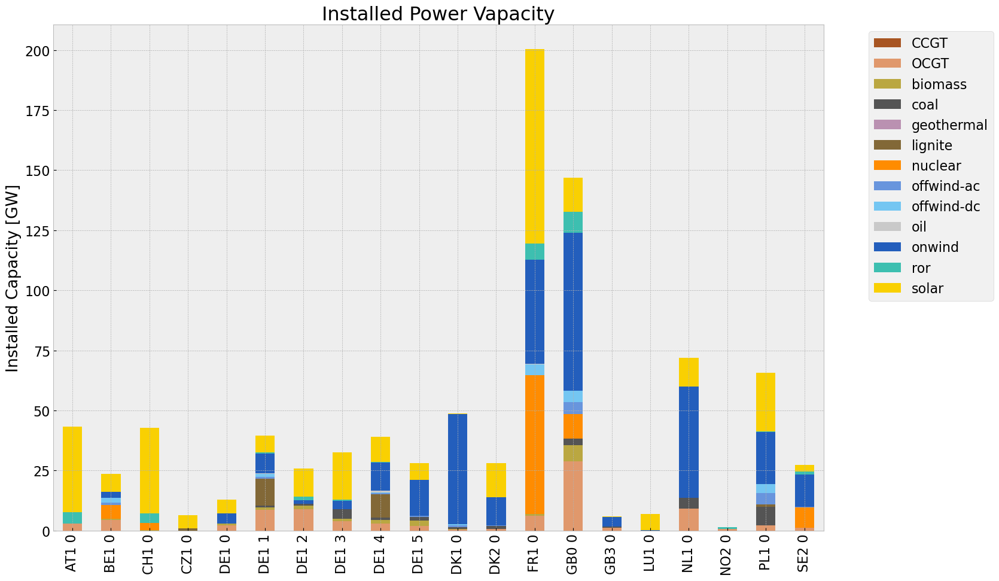

<Figure size 640x480 with 0 Axes>

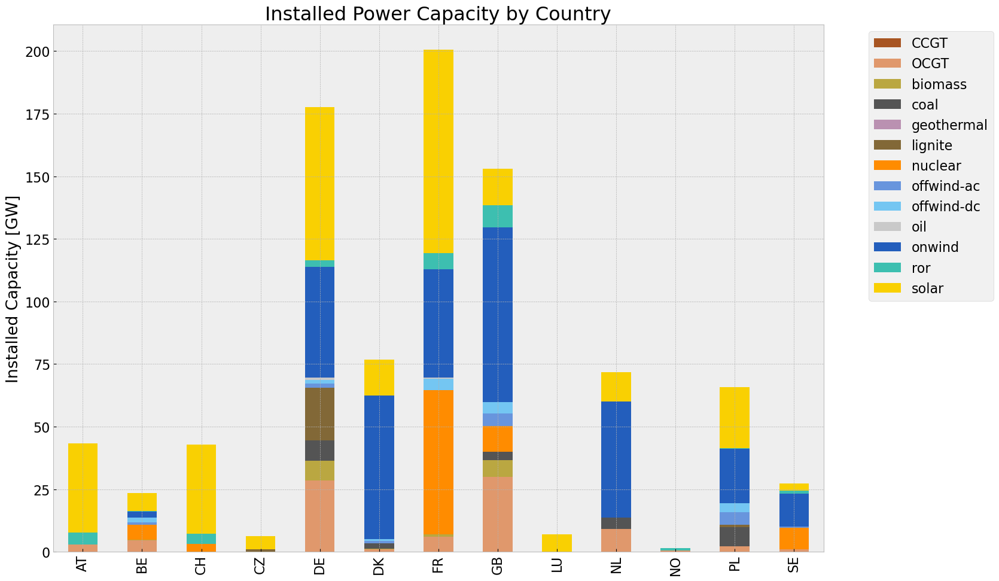

In [141]:
# consolidated istalled cap without load_shedding

#capacities_inv = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_inv.fillna(0, inplace=True)
#gen_1 = (capacities_inv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv = inst_cap_table(n1, color_cap)
cap_inv_country= inst_cap_table_country(n1, color_cap)


## Generation

<Figure size 640x480 with 0 Axes>

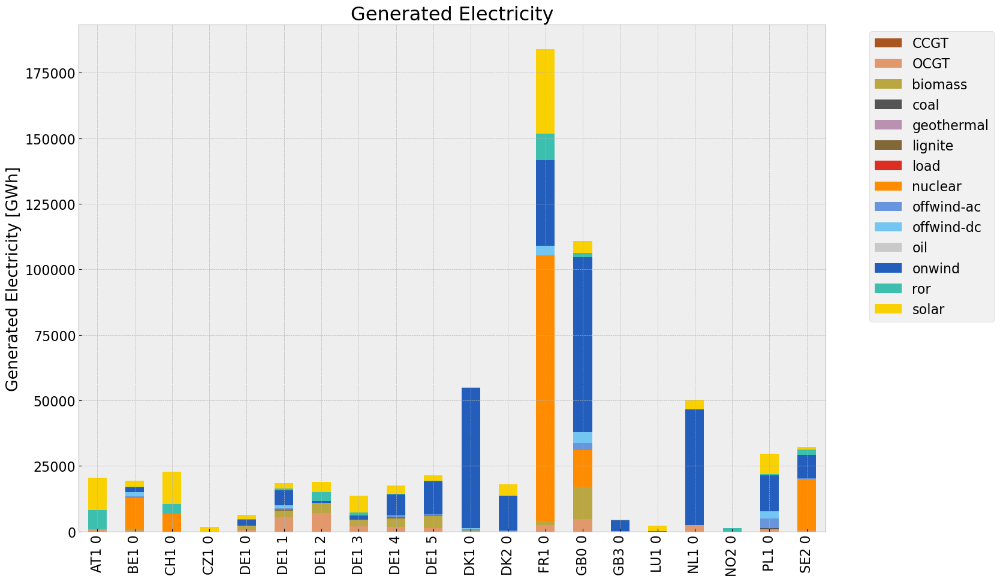

<Figure size 640x480 with 0 Axes>

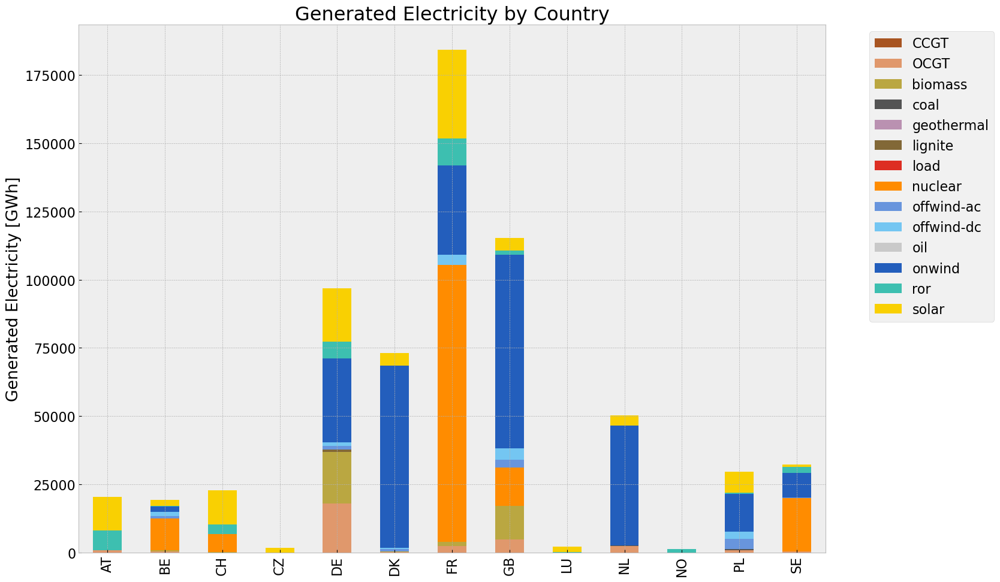

In [142]:
# consolidated generation table
#carrier = n1.generators.carrier.unique()
#df_tot_generation = n1.generators_t.p.sum()

#generations = pd.Series(index = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
           # except KeyError:
               # print('error')
                
#generations.fillna(0, inplace=True)
#gen_inv = generations.unstack()/1000#Gwh


gen_inv = gen_power_table(n1,colors_gen_table)
gen_inv_country = gen_power_table_country(n1,colors_gen_table)

## Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\

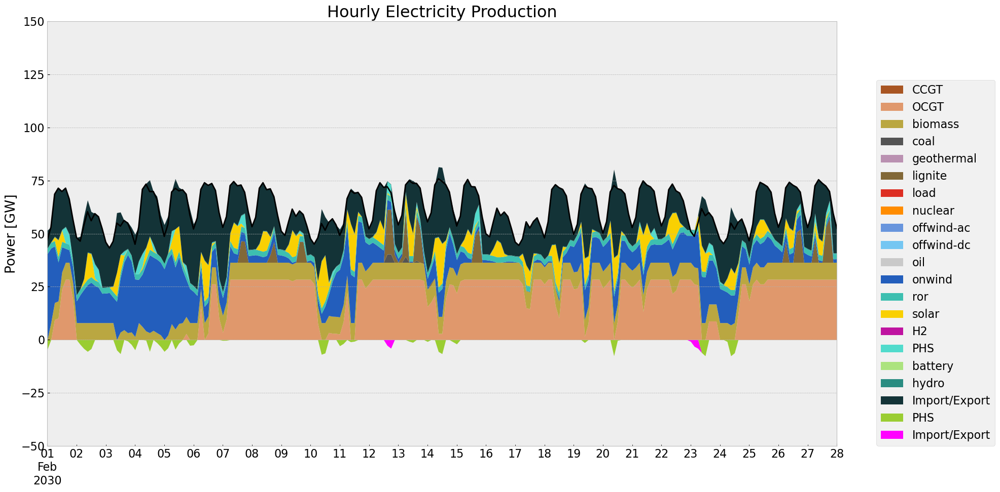

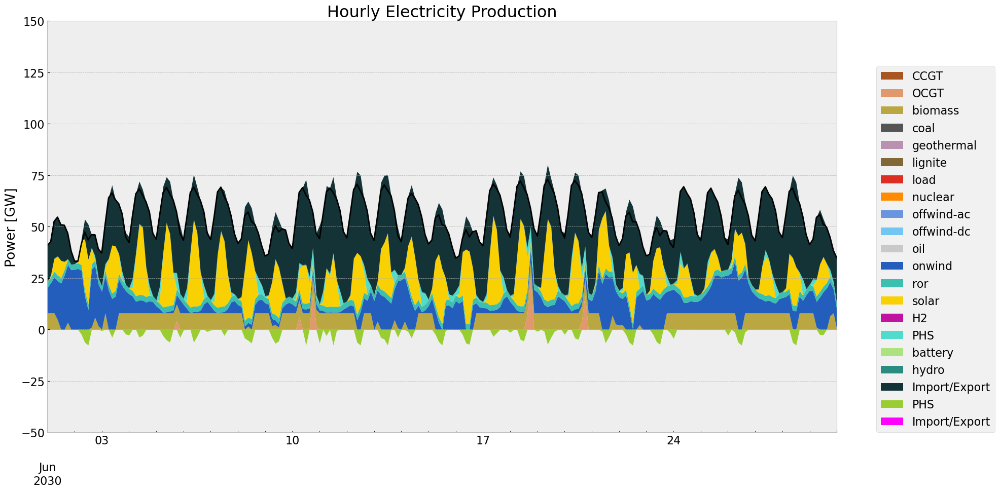

In [143]:
gen_curve(n1, '2030-02-01', '2030-02-28', colors_gen,'DE')
gen_curve(n1, '2030-06-1', '2030-06-30', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, fr

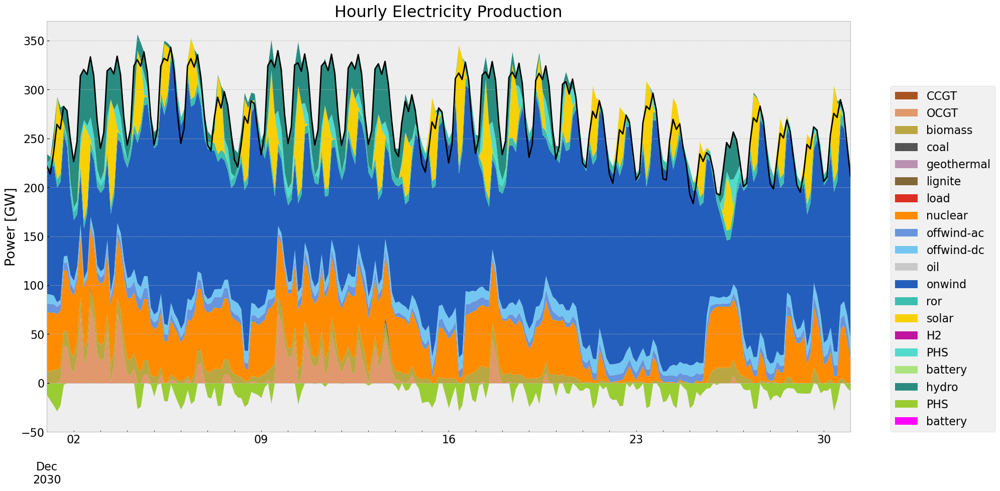

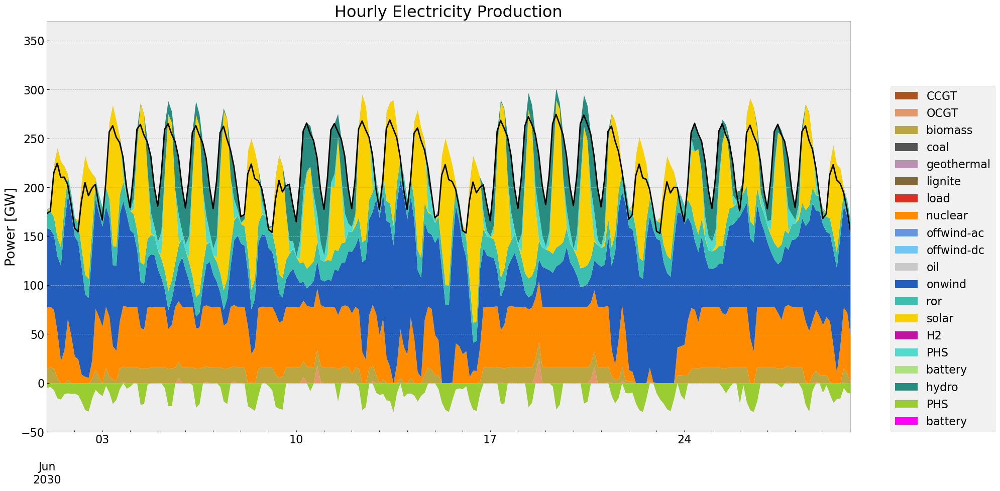

In [144]:
#generation curve all countries
#winter
gen_curve_tot(n1, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n1, '2030-06-01', '2030-06-30', colors_gen)

## Storage

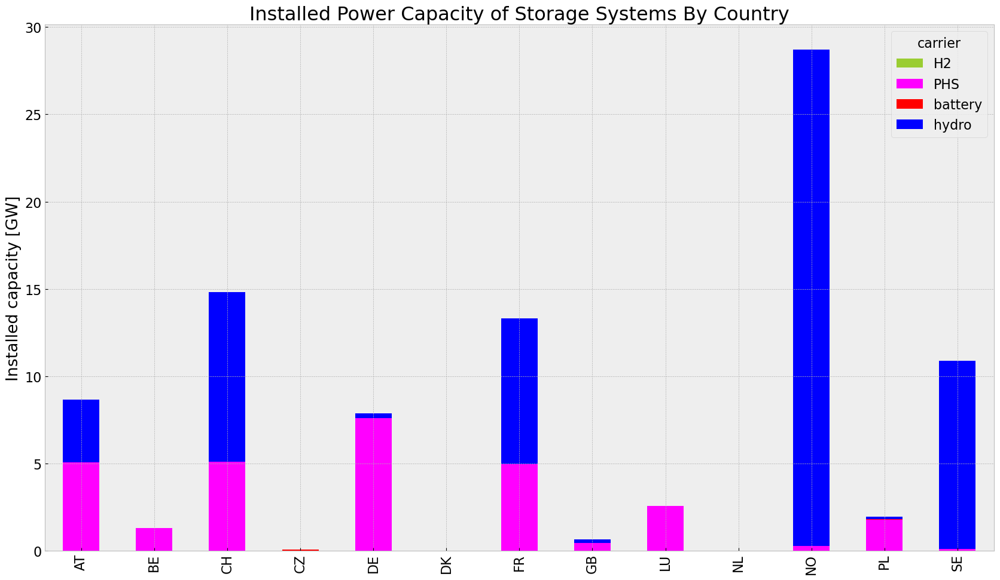

In [145]:
store_inv = inst_store_table(n1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3576090030.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3576090030.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')


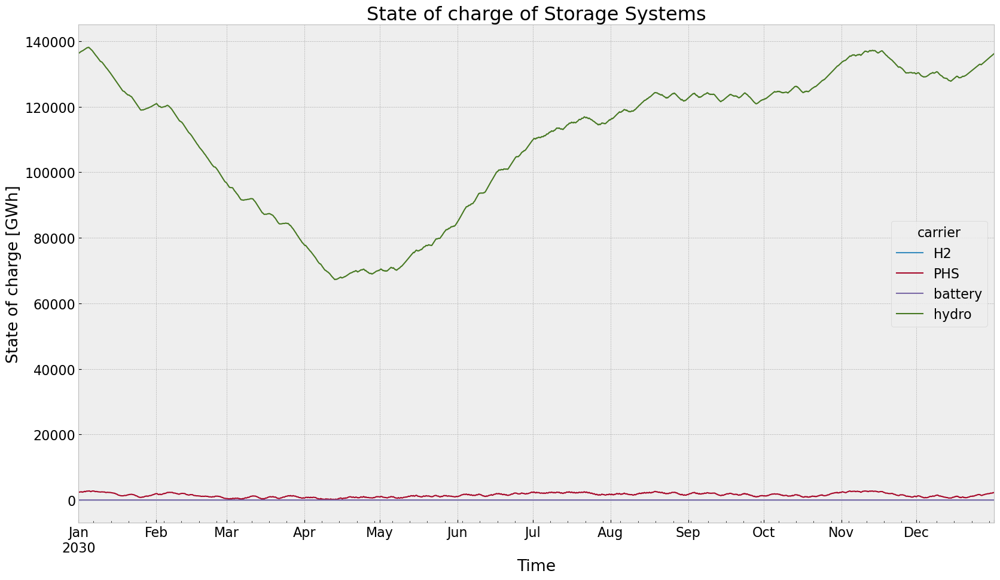

In [146]:
state_of_charge_plot(n1)

## Electricity Price


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


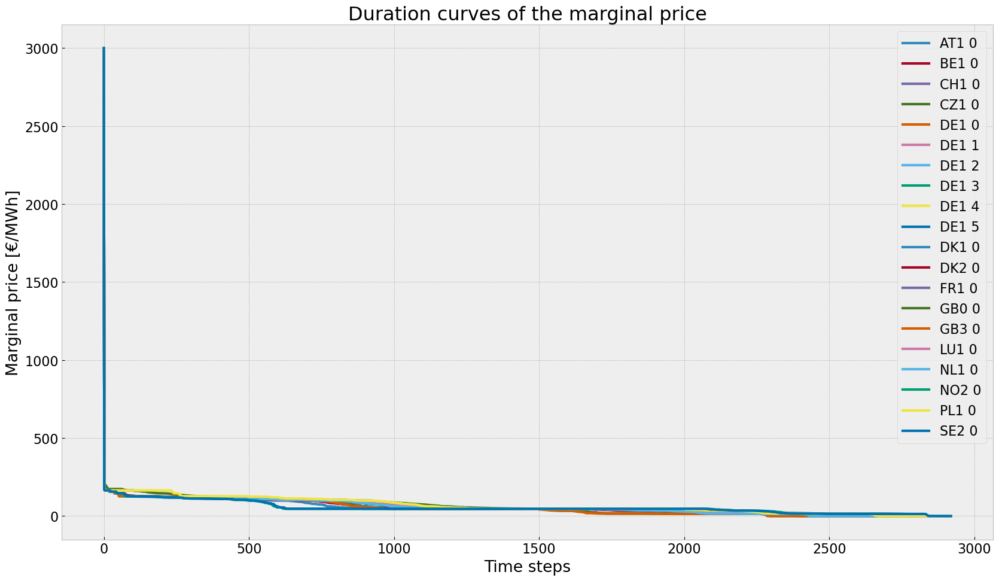

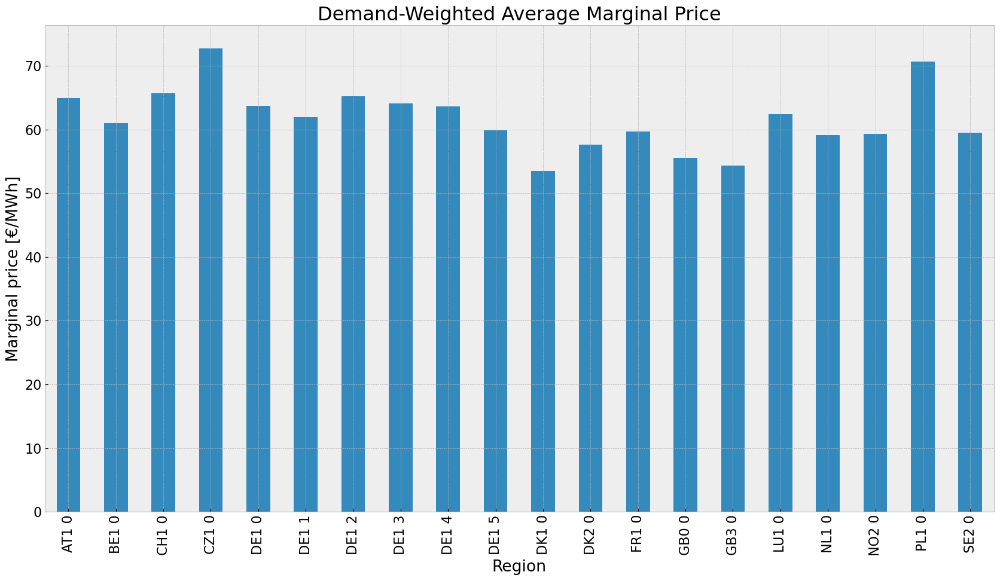

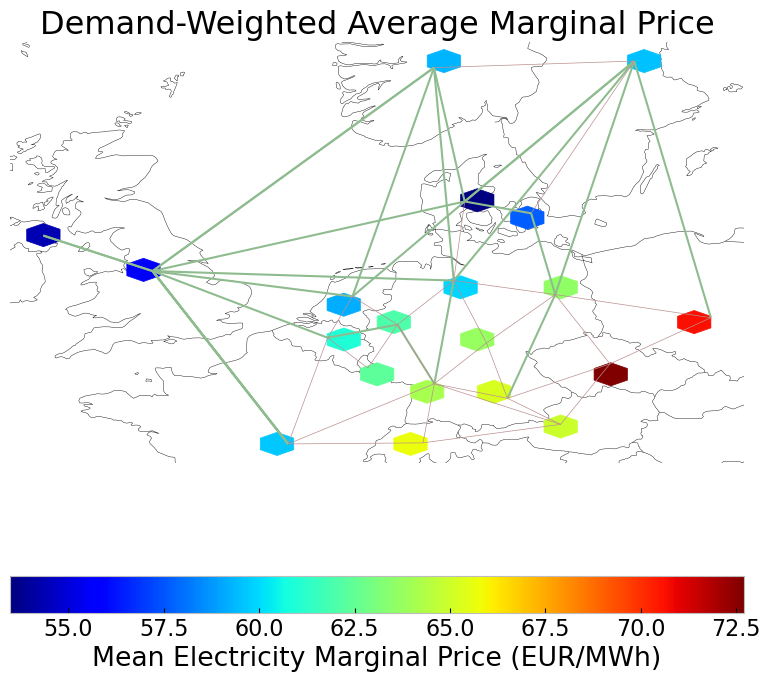

In [147]:
price_dur_curve_plot(n1)
price_regions_table(n1)
price_regions(n1)


## Emission

In [148]:
em_inv =em_table(n1)
em_inv

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,3.062562e+07,0.451621,0.1980,1.342691e+07
biomass,3.379255e+07,0.468000,0.0000,0.000000e+00
coal,7.759798e+05,0.329908,0.3361,7.905440e+05
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,8.893903e+05,0.337285,0.4069,1.072960e+06
load,1.042107e+03,1.000000,0.0000,0.000000e+00
nuclear,1.534939e+08,0.326600,0.0000,0.000000e+00
offwind-ac,9.331018e+06,1.000000,0.0000,0.000000e+00


## 2. Scenario: perfect foresight with no additional investment

In [149]:
n2 = offwindscenario(n, cut_start, duration, reductionto)
n2.name = 'noinv_offwind'     

### No Investment

In [150]:
def no_inv(n2,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n2.generators.p_nom_extendable.items():
        if value:  
            n2.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
            n2.generators.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n2.storage_units.p_nom_extendable.items():
        if value:  
            n2.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
            n2.storage_units.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of stores from the base scenario as the new minimum capacity 
    for index, value in n2.stores.e_nom_extendable.items():
        if value:  
            n2.stores.at[index, 'e_nom'] = n.stores.at[index, 'e_nom_opt']
            #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
            n2.stores.at[index, 'e_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.lines.s_nom_extendable.items():
        if value:  
            n2.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.lines.at[index, 's_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.links.p_nom_extendable.items():
        if value:  
            n2.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.links.at[index, 'p_nom_extendable'] =False

no_inv(n2,n)                 

In [151]:
n2.optimize(solver_name ='gurobi')
#n2 = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\Offwindcut\\noinv.nc")

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:05<00:00,  1.29it/s]
INFO:linopy.io: Writing time: 34.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gfs5erhz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gfs5erhz.lp


Reading time = 10.58 seconds


INFO:gurobipy:Reading time = 10.58 seconds


obj: 3264560 rows, 1521320 columns, 5349440 nonzeros


INFO:gurobipy:obj: 3264560 rows, 1521320 columns, 5349440 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3264560 rows, 1521320 columns and 5349440 nonzeros


INFO:gurobipy:Optimize a model with 3264560 rows, 1521320 columns and 5349440 nonzeros


Model fingerprint: 0x0e4e5aef


INFO:gurobipy:Model fingerprint: 0x0e4e5aef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3102058 rows and 873582 columns


INFO:gurobipy:Presolve removed 3102058 rows and 873582 columns


Presolve time: 3.30s


INFO:gurobipy:Presolve time: 3.30s


Presolved: 162502 rows, 647738 columns, 1088613 nonzeros


INFO:gurobipy:Presolved: 162502 rows, 647738 columns, 1088613 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.30s


INFO:gurobipy:Ordering time: 0.30s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.647e+05


INFO:gurobipy: AA' NZ     : 4.647e+05


 Factor NZ  : 5.524e+06 (roughly 400 MB of memory)


INFO:gurobipy: Factor NZ  : 5.524e+06 (roughly 400 MB of memory)


 Factor Ops : 3.868e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.868e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.52186350e+13 -1.34444492e+15  6.97e+05 1.05e+03  1.69e+09     5s


INFO:gurobipy:   0   3.52186350e+13 -1.34444492e+15  6.97e+05 1.05e+03  1.69e+09     5s


   1   9.10121086e+12 -4.19562269e+13  7.53e+04 7.28e-12  9.82e+07     5s


INFO:gurobipy:   1   9.10121086e+12 -4.19562269e+13  7.53e+04 7.28e-12  9.82e+07     5s


   2   1.45022411e+12 -1.01265623e+13  4.13e+03 9.09e-12  1.13e+07     5s


INFO:gurobipy:   2   1.45022411e+12 -1.01265623e+13  4.13e+03 9.09e-12  1.13e+07     5s


   3   3.24733947e+11 -3.20258566e+12  3.64e+02 5.55e-11  2.84e+06     6s


INFO:gurobipy:   3   3.24733947e+11 -3.20258566e+12  3.64e+02 5.55e-11  2.84e+06     6s


   4   1.79620403e+11 -1.11422487e+12  1.64e+02 3.00e-11  1.03e+06     6s


INFO:gurobipy:   4   1.79620403e+11 -1.11422487e+12  1.64e+02 3.00e-11  1.03e+06     6s


   5   1.22981403e+11 -4.25102132e+11  7.75e+01 1.00e-11  4.31e+05     6s


INFO:gurobipy:   5   1.22981403e+11 -4.25102132e+11  7.75e+01 1.00e-11  4.31e+05     6s


   6   9.09972862e+10 -1.70809912e+11  3.69e+01 7.28e-12  2.04e+05     7s


INFO:gurobipy:   6   9.09972862e+10 -1.70809912e+11  3.69e+01 7.28e-12  2.04e+05     7s


   7   7.63501731e+10 -6.97331660e+10  2.27e+01 4.09e-12  1.14e+05     7s


INFO:gurobipy:   7   7.63501731e+10 -6.97331660e+10  2.27e+01 4.09e-12  1.14e+05     7s


   8   5.00805317e+10 -2.02006314e+10  3.61e+00 3.64e-12  5.43e+04     7s


INFO:gurobipy:   8   5.00805317e+10 -2.02006314e+10  3.61e+00 3.64e-12  5.43e+04     7s


   9   4.49689024e+10  6.51516726e+09  2.17e+00 3.64e-12  2.97e+04     8s


INFO:gurobipy:   9   4.49689024e+10  6.51516726e+09  2.17e+00 3.64e-12  2.97e+04     8s


  10   4.03932257e+10  1.91337601e+10  1.04e+00 2.73e-12  1.64e+04     8s


INFO:gurobipy:  10   4.03932257e+10  1.91337601e+10  1.04e+00 2.73e-12  1.64e+04     8s


  11   3.90070988e+10  2.52138061e+10  7.59e-01 2.73e-12  1.07e+04     8s


INFO:gurobipy:  11   3.90070988e+10  2.52138061e+10  7.59e-01 2.73e-12  1.07e+04     8s


  12   3.66671638e+10  2.96060614e+10  3.17e-01 1.82e-12  5.45e+03     9s


INFO:gurobipy:  12   3.66671638e+10  2.96060614e+10  3.17e-01 1.82e-12  5.45e+03     9s


  13   3.59032453e+10  3.18694815e+10  1.91e-01 1.82e-12  3.11e+03     9s


INFO:gurobipy:  13   3.59032453e+10  3.18694815e+10  1.91e-01 1.82e-12  3.11e+03     9s


  14   3.53513609e+10  3.27775269e+10  1.07e-01 1.82e-12  1.99e+03     9s


INFO:gurobipy:  14   3.53513609e+10  3.27775269e+10  1.07e-01 1.82e-12  1.99e+03     9s


  15   3.52170753e+10  3.33963066e+10  8.68e-02 2.42e-12  1.41e+03    10s


INFO:gurobipy:  15   3.52170753e+10  3.33963066e+10  8.68e-02 2.42e-12  1.41e+03    10s


  16   3.50684546e+10  3.37381527e+10  6.57e-02 1.84e-12  1.03e+03    10s


INFO:gurobipy:  16   3.50684546e+10  3.37381527e+10  6.57e-02 1.84e-12  1.03e+03    10s


  17   3.49456962e+10  3.39617236e+10  4.84e-02 2.12e-12  7.60e+02    10s


INFO:gurobipy:  17   3.49456962e+10  3.39617236e+10  4.84e-02 2.12e-12  7.60e+02    10s


  18   3.48525604e+10  3.41346331e+10  3.55e-02 1.82e-12  5.54e+02    10s


INFO:gurobipy:  18   3.48525604e+10  3.41346331e+10  3.55e-02 1.82e-12  5.54e+02    10s


  19   3.47070909e+10  3.42814667e+10  1.55e-02 2.07e-12  3.29e+02    11s


INFO:gurobipy:  19   3.47070909e+10  3.42814667e+10  1.55e-02 2.07e-12  3.29e+02    11s


  20   3.46776350e+10  3.43777128e+10  1.14e-02 1.82e-12  2.32e+02    12s


INFO:gurobipy:  20   3.46776350e+10  3.43777128e+10  1.14e-02 1.82e-12  2.32e+02    12s


  21   3.46435917e+10  3.44243767e+10  6.97e-03 1.87e-12  1.69e+02    12s


INFO:gurobipy:  21   3.46435917e+10  3.44243767e+10  6.97e-03 1.87e-12  1.69e+02    12s


  22   3.46389004e+10  3.44411553e+10  6.32e-03 2.26e-12  1.53e+02    12s


INFO:gurobipy:  22   3.46389004e+10  3.44411553e+10  6.32e-03 2.26e-12  1.53e+02    12s


  23   3.46301336e+10  3.44720508e+10  5.13e-03 2.17e-12  1.22e+02    13s


INFO:gurobipy:  23   3.46301336e+10  3.44720508e+10  5.13e-03 2.17e-12  1.22e+02    13s


  24   3.46215449e+10  3.44978811e+10  4.04e-03 8.00e-11  9.55e+01    13s


INFO:gurobipy:  24   3.46215449e+10  3.44978811e+10  4.04e-03 8.00e-11  9.55e+01    13s


  25   3.46128476e+10  3.45217961e+10  2.88e-03 1.84e-09  7.03e+01    13s


INFO:gurobipy:  25   3.46128476e+10  3.45217961e+10  2.88e-03 1.84e-09  7.03e+01    13s


  26   3.46072082e+10  3.45450814e+10  2.15e-03 1.64e-09  4.80e+01    14s


INFO:gurobipy:  26   3.46072082e+10  3.45450814e+10  2.15e-03 1.64e-09  4.80e+01    14s


  27   3.46027019e+10  3.45595199e+10  1.58e-03 5.62e-09  3.33e+01    14s


INFO:gurobipy:  27   3.46027019e+10  3.45595199e+10  1.58e-03 5.62e-09  3.33e+01    14s


  28   3.45984094e+10  3.45658438e+10  1.05e-03 1.22e-08  2.51e+01    15s


INFO:gurobipy:  28   3.45984094e+10  3.45658438e+10  1.05e-03 1.22e-08  2.51e+01    15s


  29   3.45953220e+10  3.45747806e+10  6.61e-04 8.46e-09  1.59e+01    15s


INFO:gurobipy:  29   3.45953220e+10  3.45747806e+10  6.61e-04 8.46e-09  1.59e+01    15s


  30   3.45930760e+10  3.45814271e+10  3.97e-04 5.41e-09  8.99e+00    16s


INFO:gurobipy:  30   3.45930760e+10  3.45814271e+10  3.97e-04 5.41e-09  8.99e+00    16s


  31   3.45927444e+10  3.45833572e+10  3.61e-04 1.37e-08  7.25e+00    16s


INFO:gurobipy:  31   3.45927444e+10  3.45833572e+10  3.61e-04 1.37e-08  7.25e+00    16s


  32   3.45913415e+10  3.45856854e+10  2.05e-04 9.35e-09  4.37e+00    16s


INFO:gurobipy:  32   3.45913415e+10  3.45856854e+10  2.05e-04 9.35e-09  4.37e+00    16s


  33   3.45907119e+10  3.45870765e+10  1.33e-04 6.90e-09  2.81e+00    16s


INFO:gurobipy:  33   3.45907119e+10  3.45870765e+10  1.33e-04 6.90e-09  2.81e+00    16s


  34   3.45902695e+10  3.45879714e+10  8.39e-05 4.78e-09  1.77e+00    17s


INFO:gurobipy:  34   3.45902695e+10  3.45879714e+10  8.39e-05 4.78e-09  1.77e+00    17s


  35   3.45899134e+10  3.45884689e+10  4.53e-05 3.52e-09  1.11e+00    17s


INFO:gurobipy:  35   3.45899134e+10  3.45884689e+10  4.53e-05 3.52e-09  1.11e+00    17s


  36   3.45897158e+10  3.45888623e+10  2.39e-05 2.38e-09  6.59e-01    17s


INFO:gurobipy:  36   3.45897158e+10  3.45888623e+10  2.39e-05 2.38e-09  6.59e-01    17s


  37   3.45896547e+10  3.45891717e+10  1.78e-05 1.45e-09  3.73e-01    18s


INFO:gurobipy:  37   3.45896547e+10  3.45891717e+10  1.78e-05 1.45e-09  3.73e-01    18s


  38   3.45895681e+10  3.45893162e+10  9.56e-06 1.17e-09  1.94e-01    18s


INFO:gurobipy:  38   3.45895681e+10  3.45893162e+10  9.56e-06 1.17e-09  1.94e-01    18s


  39   3.45895083e+10  3.45893892e+10  3.84e-06 8.52e-10  9.19e-02    18s


INFO:gurobipy:  39   3.45895083e+10  3.45893892e+10  3.84e-06 8.52e-10  9.19e-02    18s


  40   3.45894923e+10  3.45894273e+10  2.36e-06 7.95e-10  5.02e-02    19s


INFO:gurobipy:  40   3.45894923e+10  3.45894273e+10  2.36e-06 7.95e-10  5.02e-02    19s


  41   3.45894834e+10  3.45894393e+10  1.60e-06 8.81e-10  3.40e-02    19s


INFO:gurobipy:  41   3.45894834e+10  3.45894393e+10  1.60e-06 8.81e-10  3.40e-02    19s


  42   3.45894784e+10  3.45894485e+10  1.20e-06 1.43e-09  2.31e-02    19s


INFO:gurobipy:  42   3.45894784e+10  3.45894485e+10  1.20e-06 1.43e-09  2.31e-02    19s


  43   3.45894736e+10  3.45894550e+10  7.62e-07 1.10e-09  1.44e-02    19s


INFO:gurobipy:  43   3.45894736e+10  3.45894550e+10  7.62e-07 1.10e-09  1.44e-02    19s


  44   3.45894729e+10  3.45894563e+10  6.90e-07 9.58e-10  1.28e-02    20s


INFO:gurobipy:  44   3.45894729e+10  3.45894563e+10  6.90e-07 9.58e-10  1.28e-02    20s


  45   3.45894719e+10  3.45894595e+10  5.99e-07 5.15e-10  9.56e-03    20s


INFO:gurobipy:  45   3.45894719e+10  3.45894595e+10  5.99e-07 5.15e-10  9.56e-03    20s


  46   3.45894678e+10  3.45894621e+10  3.00e-07 2.25e-10  4.37e-03    21s


INFO:gurobipy:  46   3.45894678e+10  3.45894621e+10  3.00e-07 2.25e-10  4.37e-03    21s


  47   3.45894658e+10  3.45894631e+10  9.98e-08 1.38e-10  2.09e-03    21s


INFO:gurobipy:  47   3.45894658e+10  3.45894631e+10  9.98e-08 1.38e-10  2.09e-03    21s


  48   3.45894657e+10  3.45894642e+10  7.74e-08 6.57e-11  1.14e-03    22s


INFO:gurobipy:  48   3.45894657e+10  3.45894642e+10  7.74e-08 6.57e-11  1.14e-03    22s


  49   3.45894653e+10  3.45894649e+10  2.44e-08 3.36e-11  3.22e-04    22s


INFO:gurobipy:  49   3.45894653e+10  3.45894649e+10  2.44e-08 3.36e-11  3.22e-04    22s


  50   3.45894652e+10  3.45894651e+10  6.34e-09 9.77e-11  7.83e-05    22s


INFO:gurobipy:  50   3.45894652e+10  3.45894651e+10  6.34e-09 9.77e-11  7.83e-05    22s


  51   3.45894652e+10  3.45894652e+10  3.62e-08 1.66e-11  1.18e-05    23s


INFO:gurobipy:  51   3.45894652e+10  3.45894652e+10  3.62e-08 1.66e-11  1.18e-05    23s


  52   3.45894652e+10  3.45894652e+10  3.72e-09 3.64e-12  4.10e-07    23s


INFO:gurobipy:  52   3.45894652e+10  3.45894652e+10  3.72e-09 3.64e-12  4.10e-07    23s


  53   3.45894652e+10  3.45894652e+10  3.33e-09 7.81e-12  1.09e-08    24s


INFO:gurobipy:  53   3.45894652e+10  3.45894652e+10  3.33e-09 7.81e-12  1.09e-08    24s


  54   3.45894652e+10  3.45894652e+10  3.06e-09 5.46e-12  1.71e-10    24s


INFO:gurobipy:  54   3.45894652e+10  3.45894652e+10  3.06e-09 5.46e-12  1.71e-10    24s


INFO:gurobipy:


Barrier solved model in 54 iterations and 23.96 seconds (11.81 work units)


INFO:gurobipy:Barrier solved model in 54 iterations and 23.96 seconds (11.81 work units)


Optimal objective 3.45894652e+10


INFO:gurobipy:Optimal objective 3.45894652e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   11912 DPushes remaining with DInf 0.0000000e+00                24s


INFO:gurobipy:   11912 DPushes remaining with DInf 0.0000000e+00                24s


     213 DPushes remaining with DInf 0.0000000e+00                25s


INFO:gurobipy:     213 DPushes remaining with DInf 0.0000000e+00                25s


       0 DPushes remaining with DInf 0.0000000e+00                26s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                26s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.5


INFO:gurobipy:


   15585 PPushes remaining with PInf 0.0000000e+00                26s


INFO:gurobipy:   15585 PPushes remaining with PInf 0.0000000e+00                26s


       0 PPushes remaining with PInf 0.0000000e+00                30s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                30s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.4987179e-09     30s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.4987179e-09     30s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


   27500    3.4589465e+10   0.000000e+00   0.000000e+00     32s


INFO:gurobipy:   27500    3.4589465e+10   0.000000e+00   0.000000e+00     32s


INFO:gurobipy:


Solved in 27500 iterations and 32.37 seconds (14.60 work units)


INFO:gurobipy:Solved in 27500 iterations and 32.37 seconds (14.60 work units)


Optimal objective  3.458946518e+10


INFO:gurobipy:Optimal objective  3.458946518e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1521320 primals, 3264560 duals
Objective: 3.46e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


('ok', 'optimal')

### Export model for later use

In [152]:
file = "noinv_offwind.nc"
output_path = os.path.join(os.getcwd(), file)
n2.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_offwind.nc has global_constraints, links, storage_units, buses, carriers, loads, generators, lines


<xarray.Dataset> Size: 13MB
Dimensions:                               (snapshots: 2920,
                                           investment_periods: 0,
                                           global_constraints_i: 1,
                                           links_i: 28, links_t_p0_i: 12,
                                           links_t_p1_i: 12,
                                           storage_units_i: 65,
                                           ...
                                           loads_t_p_set_i: 20,
                                           loads_t_p_i: 20, generators_i: 261,
                                           generators_t_p_max_pu_i: 81,
                                           generators_t_p_i: 131, lines_i: 27,
                                           lines_t_p0_i: 27, lines_t_p1_i: 27,
                                           lines_t_loss_i: 27)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 23kB 0 1 ... 2919
  * investment_periods                    (investment_periods) int64 0B 
  * global_constraints_i                  (global_constraints_i) object 8B 'l...
  * links_i                               (links_i) object 224B '14801' ... '...
  * links_t_p0_i                          (links_t_p0_i) object 96B '14814' ....
  * links_t_p1_i                          (links_t_p1_i) object 96B '14814' ....
    ...                                    ...
  * generators_t_p_max_pu_i               (generators_t_p_max_pu_i) object 648B ...
  * generators_t_p_i                      (generators_t_p_i) object 1kB 'AT1 ...
  * lines_i                               (lines_i) object 216B '0' '1' ... '9'
  * lines_t_p0_i                          (lines_t_p0_i) object 216B '0' ... '9'
  * lines_t_p1_i                          (lines_t_p1_i) object 216B '0' ... '9'
  * lines_t_loss_i                        (lines_t_loss_i) object 216B '0' .....
Data variables: (12/102)
    snapshots_snapshot                    (snapshots) datetime64[ns] 23kB 201...
    snapshots_objective                   (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_generators                  (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_stores                      (snapshots) float64 23kB 3.0 ... 3.0
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    lines_x_pu_eff                        (lines_i) float64 216B 0.0002125 .....
    lines_r_pu_eff                        (lines_i) float64 216B 2.592e-05 .....
    lines_s_nom_opt                       (lines_i) float64 216B 6.792e+03 .....
    lines_t_p0                            (snapshots, lines_t_p0_i) float64 631kB ...
    lines_t_p1                            (snapshots, lines_t_p1_i) float64 631kB ...
    lines_t_loss                          (snapshots, lines_t_loss_i) float64 631kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_offwind
    network_objective:       34589465184.26926
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [153]:
tot_cos_noinv=n2.objective/1e9 #billion €
system_cost_noinv = system_cost(n2) #million €/a
marg_price_region_noinv = n2.buses_t.marginal_price.mean()
stat_noinv = n2.statistics()

## Installed Capacity

Since expansion is not allowed in this scenario, the installed capacity will equal to that of the base scenario.

<Figure size 640x480 with 0 Axes>

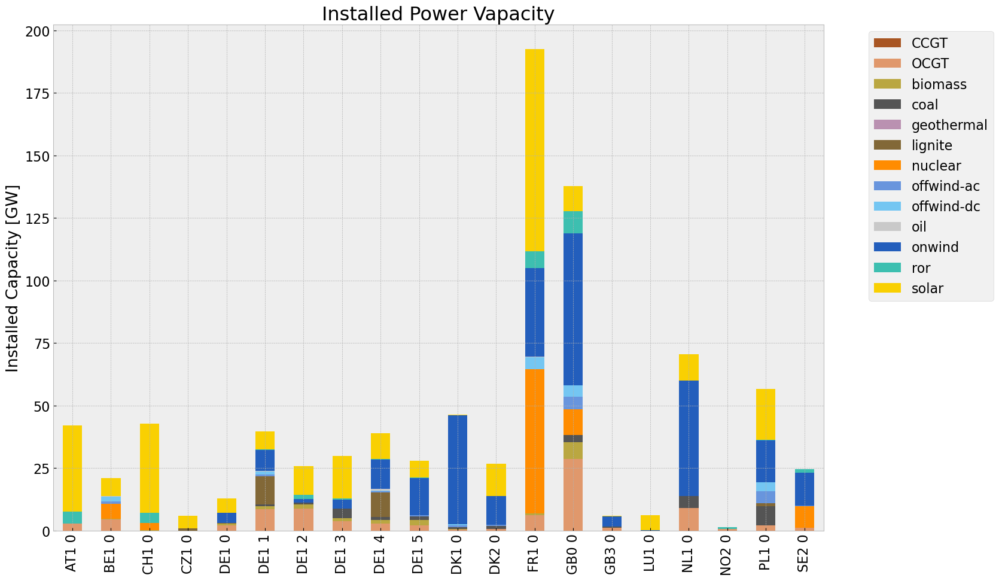

<Figure size 640x480 with 0 Axes>

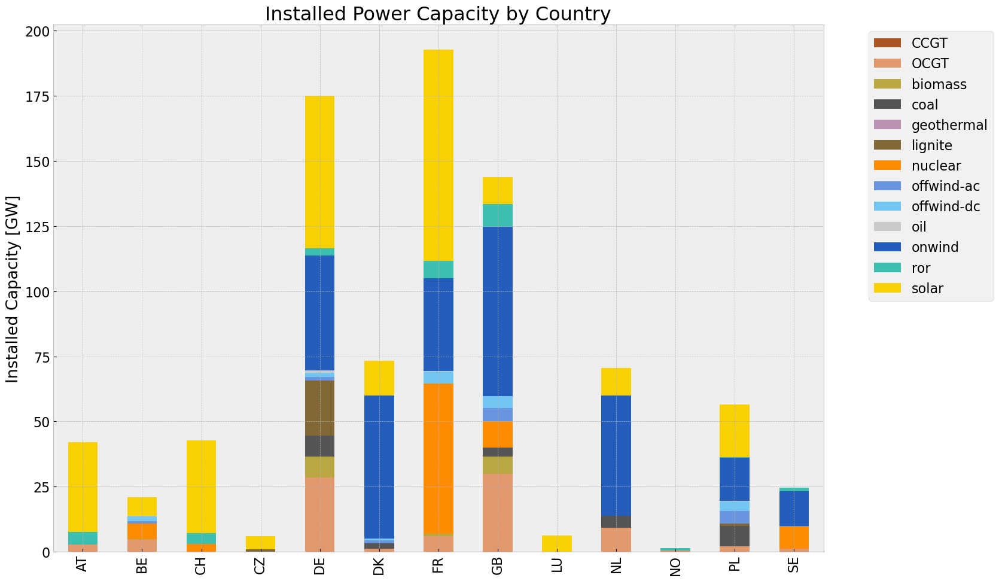

In [154]:
# consolidated istalled cap without load_shedding

#capacities_noinv = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv.fillna(0, inplace=True)
#gen = (capacities_noinv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv = inst_cap_table(n2, color_cap)
cap_noinv_country= inst_cap_table_country(n2, color_cap)



## Generation

<Figure size 640x480 with 0 Axes>

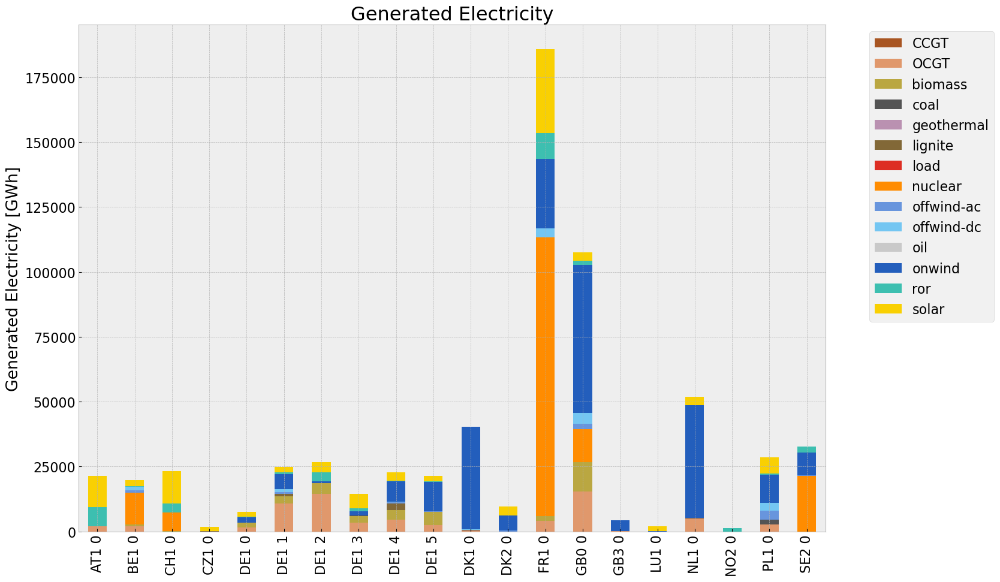

<Figure size 640x480 with 0 Axes>

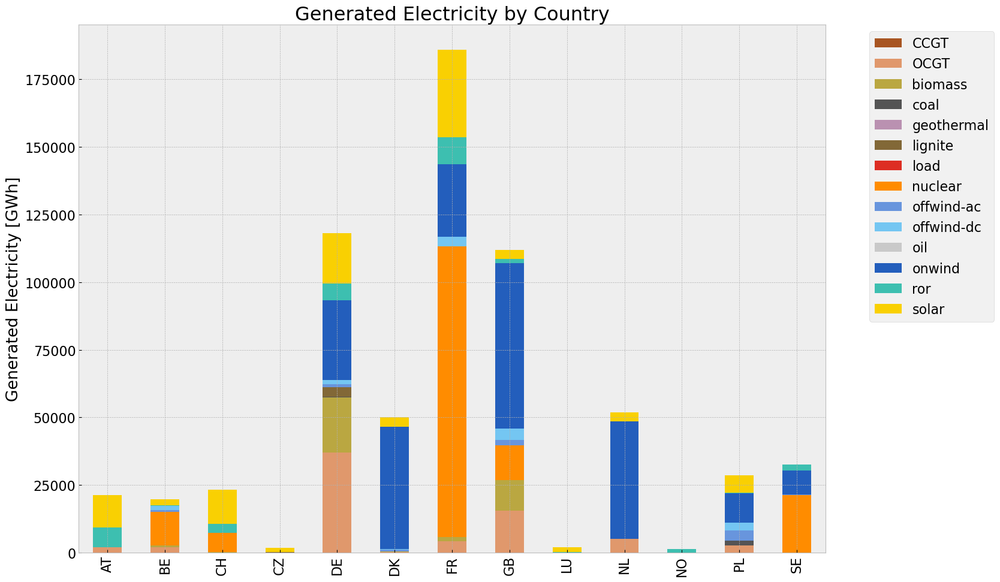

In [155]:
# consolidated generation table
#carrier = n2.generators.carrier.unique()
#df_tot_generation = n2.generators_t.p.sum()

#generations = pd.Series(index = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
                #generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')

#generations.fillna(0, inplace=True)
#gen_noinv = generations.unstack()/1000#GWh

gen_noinv= gen_power_table(n2,colors_gen_table)
gen_noinv_country = gen_power_table_country(n2,colors_gen_table)


## Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\1288276629.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\1288276629.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).

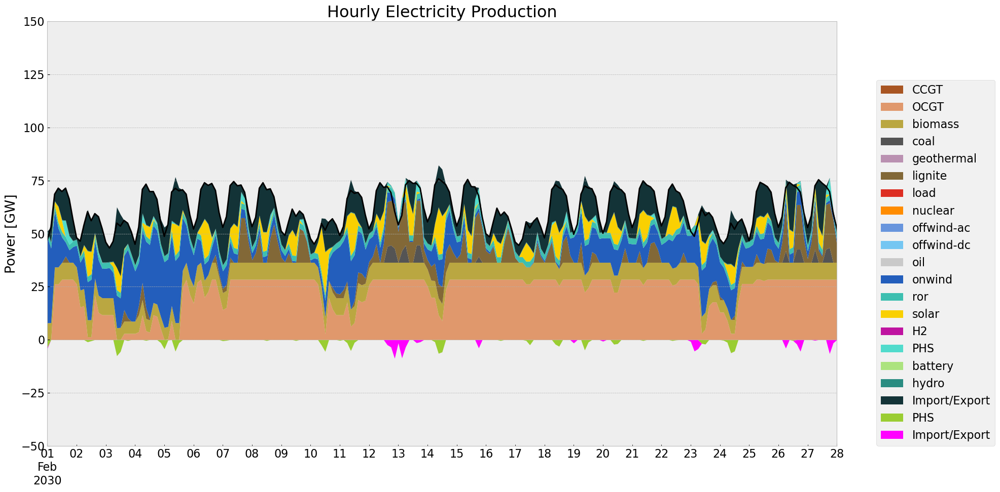

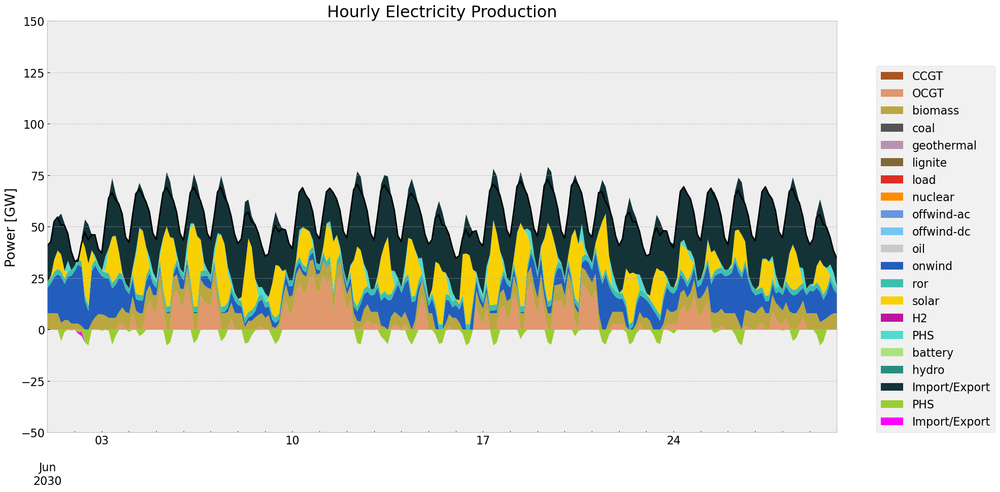

In [156]:
p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n2, '2030-02-01', '2030-02-28', colors_gen,'DE')
gen_curve(n2, '2030-06-01', '2030-06-30', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, fr

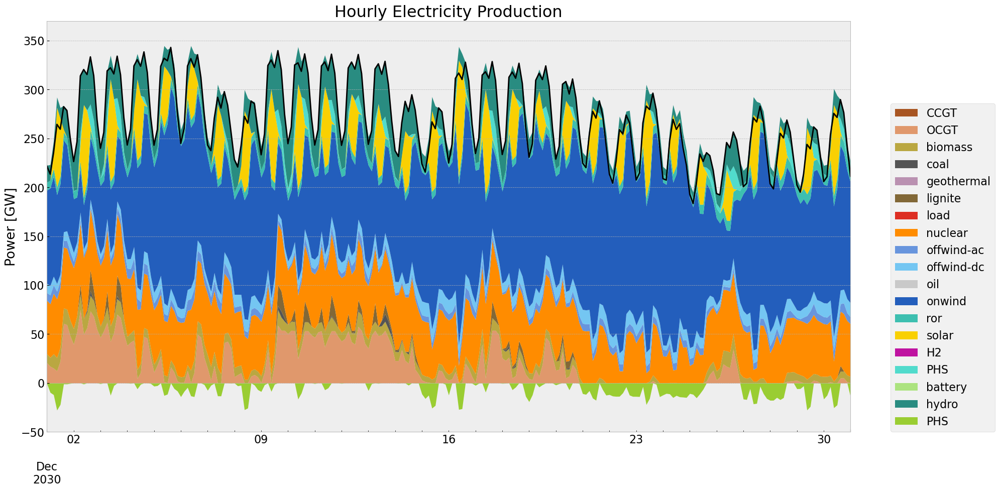

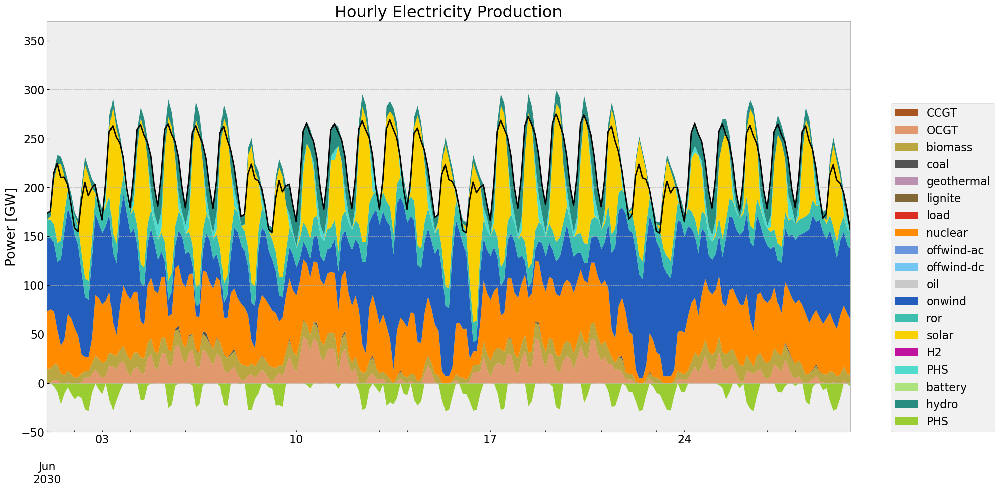

In [157]:
#generation curve all countries
#winter
gen_curve_tot(n2, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n2, '2030-06-01', '2030-06-30', colors_gen)

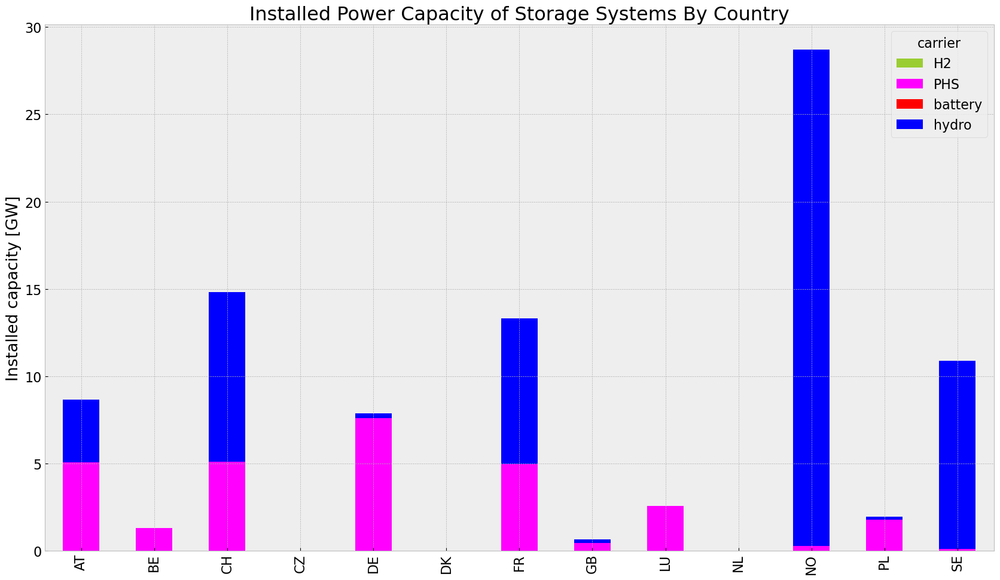

In [158]:
#storage unit capacities
store_noinv = inst_store_table(n2)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3576090030.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3576090030.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\1117423567.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\1117423567.py:3: FutureWarning: 'H' is deprecated and will be removed in a futu

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,6.897044e+07,0.451621,0.1980,3.023808e+07
biomass,3.430986e+07,0.468000,0.0000,0.000000e+00
coal,2.272696e+06,0.329908,0.3361,2.315352e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,3.814807e+06,0.337285,0.4069,4.602180e+06
load,4.610858e+03,1.000000,0.0000,0.000000e+00
nuclear,1.608465e+08,0.326600,0.0000,0.000000e+00
offwind-ac,8.441645e+06,1.000000,0.0000,0.000000e+00


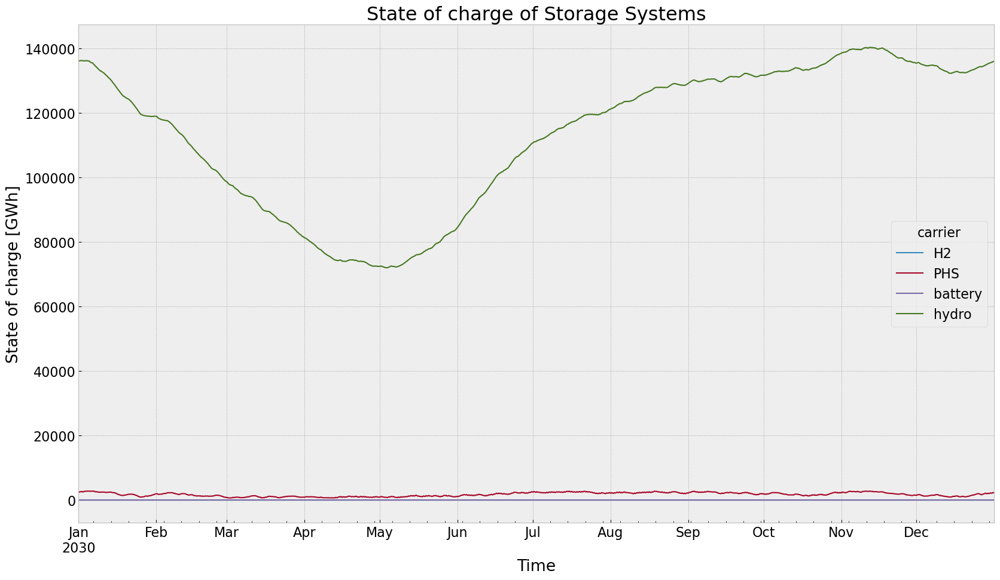

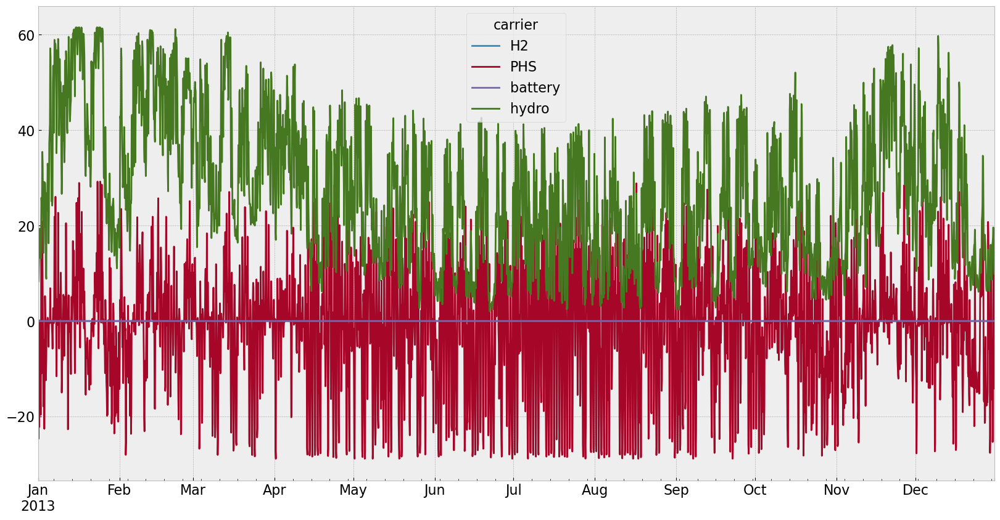

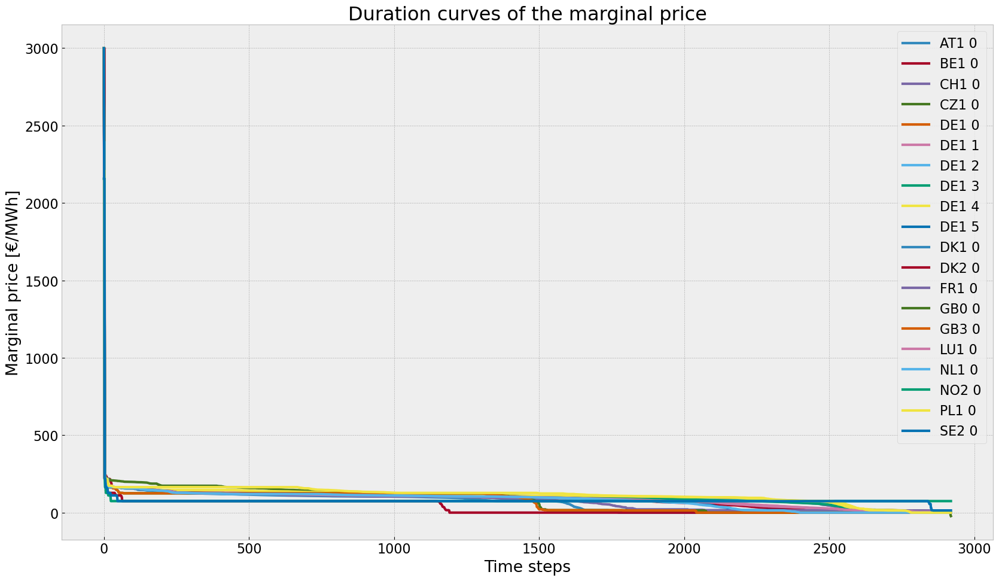

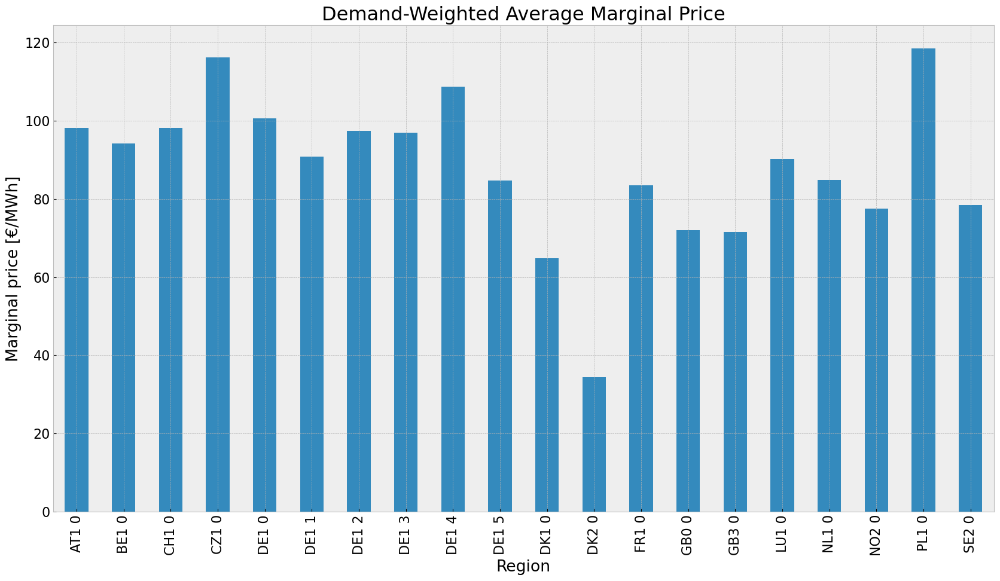

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


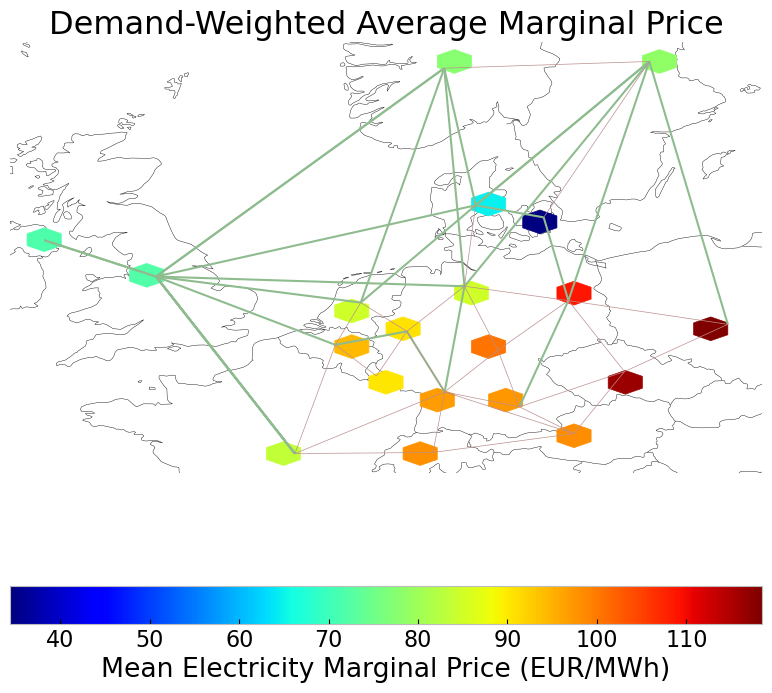

In [159]:
#state of charge
state_of_charge_plot(n2)
n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))
#price
price_dur_curve_plot(n2)
price_regions_table(n2)
price_regions(n2)
#emission
em_noinv =em_table(n2)
em_noinv

## 3. Scenario: rolling horizon foresight with no additional investment

In [160]:
n3= n2.copy()
n3.name = 'noinv_roll_offwind'
horizon = 24
n3.storage_units['cyclic_state_of_charge'] = False
n3.storage_units['cyclic_state_of_charge_per_period'] = False
optimize.optimize_with_rolling_horizon(n3, horizon=horizon, overlap=0, solver_name='gurobi')
#n3 = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\Offwindcut\\noinv_roll.nc")

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 21:00:00] (1/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-05xuwtw7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-05xuwtw7.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3e1143ff


INFO:gurobipy:Model fingerprint: 0x3e1143ff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25506 rows and 7247 columns


INFO:gurobipy:Presolve removed 25506 rows and 7247 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1326 rows, 5257 columns, 8826 nonzeros


INFO:gurobipy:Presolved: 1326 rows, 5257 columns, 8826 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.770e+03


INFO:gurobipy: AA' NZ     : 3.770e+03


 Factor NZ  : 3.268e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.268e+04 (roughly 3 MB of memory)


 Factor Ops : 1.344e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.344e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.04241454e+11 -5.21982060e+11  8.83e+04 1.14e+04  5.13e+08     0s


INFO:gurobipy:   0   2.04241454e+11 -5.21982060e+11  8.83e+04 1.14e+04  5.13e+08     0s


   1   4.13826371e+10 -2.72086826e+11  1.09e+04 7.28e-11  7.77e+07     0s


INFO:gurobipy:   1   4.13826371e+10 -2.72086826e+11  1.09e+04 7.28e-11  7.77e+07     0s


   2   6.66154104e+09 -7.41310582e+10  6.66e+02 7.28e-11  9.83e+06     0s


INFO:gurobipy:   2   6.66154104e+09 -7.41310582e+10  6.66e+02 7.28e-11  9.83e+06     0s


   3   1.94993210e+09 -1.46243718e+10  1.26e+02 8.88e-10  1.76e+06     0s


INFO:gurobipy:   3   1.94993210e+09 -1.46243718e+10  1.26e+02 8.88e-10  1.76e+06     0s


   4   7.13912028e+08 -3.24736808e+09  1.76e+01 2.33e-10  3.90e+05     0s


INFO:gurobipy:   4   7.13912028e+08 -3.24736808e+09  1.76e+01 2.33e-10  3.90e+05     0s


   5   4.53030983e+08 -9.34377646e+08  6.43e+00 5.82e-11  1.34e+05     0s


INFO:gurobipy:   5   4.53030983e+08 -9.34377646e+08  6.43e+00 5.82e-11  1.34e+05     0s


   6   2.96201256e+08 -2.69034659e+08  2.56e+00 2.91e-11  5.42e+04     0s


INFO:gurobipy:   6   2.96201256e+08 -2.69034659e+08  2.56e+00 2.91e-11  5.42e+04     0s


   7   2.07981565e+08 -5.62923004e+07  7.43e-01 2.77e-11  2.52e+04     0s


INFO:gurobipy:   7   2.07981565e+08 -5.62923004e+07  7.43e-01 2.77e-11  2.52e+04     0s


   8   1.92106253e+08  3.61294740e+07  4.89e-01 2.08e-11  1.49e+04     0s


INFO:gurobipy:   8   1.92106253e+08  3.61294740e+07  4.89e-01 2.08e-11  1.49e+04     0s


   9   1.71923334e+08  1.19392769e+08  1.48e-01 2.91e-11  5.00e+03     0s


INFO:gurobipy:   9   1.71923334e+08  1.19392769e+08  1.48e-01 2.91e-11  5.00e+03     0s


  10   1.61483277e+08  1.46777585e+08  1.17e-02 2.91e-11  1.40e+03     0s


INFO:gurobipy:  10   1.61483277e+08  1.46777585e+08  1.17e-02 2.91e-11  1.40e+03     0s


  11   1.58994387e+08  1.53046750e+08  2.55e-03 2.97e-11  5.65e+02     0s


INFO:gurobipy:  11   1.58994387e+08  1.53046750e+08  2.55e-03 2.97e-11  5.65e+02     0s


  12   1.58163427e+08  1.55971306e+08  9.99e-04 2.50e-11  2.08e+02     0s


INFO:gurobipy:  12   1.58163427e+08  1.55971306e+08  9.99e-04 2.50e-11  2.08e+02     0s


  13   1.57816999e+08  1.56975765e+08  4.01e-04 2.91e-11  7.99e+01     0s


INFO:gurobipy:  13   1.57816999e+08  1.56975765e+08  4.01e-04 2.91e-11  7.99e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1933    1.5755305e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1933    1.5755305e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1933 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1933 iterations and 0.19 seconds (0.06 work units)


Optimal objective  1.575530467e+08


INFO:gurobipy:Optimal objective  1.575530467e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 21:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7x39e6bh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7x39e6bh.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x034867e1


INFO:gurobipy:Model fingerprint: 0x034867e1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25490 rows and 7031 columns


INFO:gurobipy:Presolve removed 25490 rows and 7031 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1342 rows, 5473 columns, 9090 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5473 columns, 9090 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.469e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.469e+04 (roughly 3 MB of memory)


 Factor Ops : 1.588e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.588e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.26282219e+11 -5.20341425e+11  8.53e+04 1.14e+04  4.95e+08     0s


INFO:gurobipy:   0   2.26282219e+11 -5.20341425e+11  8.53e+04 1.14e+04  4.95e+08     0s


   1   4.73648387e+10 -2.77044347e+11  1.04e+04 7.28e-11  7.53e+07     0s


INFO:gurobipy:   1   4.73648387e+10 -2.77044347e+11  1.04e+04 7.28e-11  7.53e+07     0s


   2   8.83927117e+09 -7.09364057e+10  6.95e+02 1.74e+02  9.52e+06     0s


INFO:gurobipy:   2   8.83927117e+09 -7.09364057e+10  6.95e+02 1.74e+02  9.52e+06     0s


   3   2.44295641e+09 -1.21888882e+10  9.78e+01 2.47e-10  1.49e+06     0s


INFO:gurobipy:   3   2.44295641e+09 -1.21888882e+10  9.78e+01 2.47e-10  1.49e+06     0s


   4   1.43378101e+09 -2.57481348e+09  3.63e+01 1.89e-10  3.95e+05     0s


INFO:gurobipy:   4   1.43378101e+09 -2.57481348e+09  3.63e+01 1.89e-10  3.95e+05     0s


   5   9.17511386e+08 -5.91929271e+08  1.35e+01 1.60e-10  1.44e+05     0s


INFO:gurobipy:   5   9.17511386e+08 -5.91929271e+08  1.35e+01 1.60e-10  1.44e+05     0s


   6   7.35733632e+08  8.44111859e+06  7.02e+00 7.28e-11  6.87e+04     0s


INFO:gurobipy:   6   7.35733632e+08  8.44111859e+06  7.02e+00 7.28e-11  6.87e+04     0s


   7   5.58663609e+08  2.75067293e+08  1.49e+00 1.58e-10  2.63e+04     0s


INFO:gurobipy:   7   5.58663609e+08  2.75067293e+08  1.49e+00 1.58e-10  2.63e+04     0s


   8   5.25953990e+08  3.91796375e+08  9.04e-01 1.02e-10  1.24e+04     0s


INFO:gurobipy:   8   5.25953990e+08  3.91796375e+08  9.04e-01 1.02e-10  1.24e+04     0s


   9   4.98468978e+08  4.33234602e+08  4.69e-01 1.02e-10  6.04e+03     0s


INFO:gurobipy:   9   4.98468978e+08  4.33234602e+08  4.69e-01 1.02e-10  6.04e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1625    4.6632198e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1625    4.6632198e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1625 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1625 iterations and 0.18 seconds (0.05 work units)


Optimal objective  4.663219780e+08


INFO:gurobipy:Optimal objective  4.663219780e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 21:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cf_bdahn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cf_bdahn.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x67828af9


INFO:gurobipy:Model fingerprint: 0x67828af9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25488 rows and 7054 columns


INFO:gurobipy:Presolve removed 25488 rows and 7054 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1344 rows, 5450 columns, 9073 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5450 columns, 9073 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.64857572e+11 -5.02292307e+11  9.18e+04 1.39e+04  5.25e+08     0s


INFO:gurobipy:   0   2.64857572e+11 -5.02292307e+11  9.18e+04 1.39e+04  5.25e+08     0s


   1   5.88873881e+10 -2.67732804e+11  1.17e+04 7.28e-11  8.09e+07     0s


INFO:gurobipy:   1   5.88873881e+10 -2.67732804e+11  1.17e+04 7.28e-11  8.09e+07     0s


   2   1.40936083e+10 -6.42334191e+10  7.46e+02 7.28e-11  9.61e+06     0s


INFO:gurobipy:   2   1.40936083e+10 -6.42334191e+10  7.46e+02 7.28e-11  9.61e+06     0s


   3   6.66122863e+09 -1.60306457e+10  1.79e+02 3.93e-10  2.44e+06     0s


INFO:gurobipy:   3   6.66122863e+09 -1.60306457e+10  1.79e+02 3.93e-10  2.44e+06     0s


   4   4.21406475e+09 -3.73458527e+09  7.71e+01 2.47e-10  8.27e+05     0s


INFO:gurobipy:   4   4.21406475e+09 -3.73458527e+09  7.71e+01 2.47e-10  8.27e+05     0s


   5   3.08850139e+09 -3.38046182e+07  3.94e+01 2.62e-10  3.20e+05     0s


INFO:gurobipy:   5   3.08850139e+09 -3.38046182e+07  3.94e+01 2.62e-10  3.20e+05     0s


   6   2.63967297e+09  1.05497972e+09  2.06e+01 1.46e-10  1.59e+05     0s


INFO:gurobipy:   6   2.63967297e+09  1.05497972e+09  2.06e+01 1.46e-10  1.59e+05     0s


   7   2.33568386e+09  1.85786014e+09  5.21e+00 1.16e-10  4.64e+04     0s


INFO:gurobipy:   7   2.33568386e+09  1.85786014e+09  5.21e+00 1.16e-10  4.64e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1736    2.1642518e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1736    2.1642518e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1736 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1736 iterations and 0.16 seconds (0.05 work units)


Optimal objective  2.164251827e+09


INFO:gurobipy:Optimal objective  2.164251827e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.16e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 21:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jebfl0rj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jebfl0rj.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x81025e28


INFO:gurobipy:Model fingerprint: 0x81025e28


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 7012 columns


INFO:gurobipy:Presolve removed 25488 rows and 7012 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1344 rows, 5492 columns, 9115 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5492 columns, 9115 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.65888249e+11 -5.12668918e+11  5.56e+04 1.44e+04  3.38e+08     0s


INFO:gurobipy:   0   1.65888249e+11 -5.12668918e+11  5.56e+04 1.44e+04  3.38e+08     0s


   1   3.92901440e+10 -2.30660053e+11  6.23e+03 5.82e-11  5.09e+07     0s


INFO:gurobipy:   1   3.92901440e+10 -2.30660053e+11  6.23e+03 5.82e-11  5.09e+07     0s


   2   1.04930116e+10 -5.56712191e+10  4.10e+02 3.84e+02  7.25e+06     0s


INFO:gurobipy:   2   1.04930116e+10 -5.56712191e+10  4.10e+02 3.84e+02  7.25e+06     0s


   3   3.80969691e+09 -1.07121039e+10  7.27e+01 1.03e-09  1.43e+06     0s


INFO:gurobipy:   3   3.80969691e+09 -1.07121039e+10  7.27e+01 1.03e-09  1.43e+06     0s


   4   2.68598226e+09 -2.28883931e+09  3.31e+01 3.71e-10  4.81e+05     0s


INFO:gurobipy:   4   2.68598226e+09 -2.28883931e+09  3.31e+01 3.71e-10  4.81e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.13 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.13 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1642    1.8341509e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1642    1.8341509e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1642 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1642 iterations and 0.16 seconds (0.05 work units)


Optimal objective  1.834150870e+09


INFO:gurobipy:Optimal objective  1.834150870e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.83e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 21:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kmfv7n9p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kmfv7n9p.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x91c21997


INFO:gurobipy:Model fingerprint: 0x91c21997


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25489 rows and 7042 columns


INFO:gurobipy:Presolve removed 25489 rows and 7042 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1343 rows, 5462 columns, 9079 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5462 columns, 9079 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.55607579e+11 -4.99775732e+11  8.86e+04 1.39e+04  5.04e+08     0s


INFO:gurobipy:   0   2.55607579e+11 -4.99775732e+11  8.86e+04 1.39e+04  5.04e+08     0s


   1   5.80339706e+10 -2.65187554e+11  1.13e+04 7.28e-11  7.85e+07     0s


INFO:gurobipy:   1   5.80339706e+10 -2.65187554e+11  1.13e+04 7.28e-11  7.85e+07     0s


   2   1.42105367e+10 -6.59877202e+10  7.08e+02 8.73e-11  9.64e+06     0s


INFO:gurobipy:   2   1.42105367e+10 -6.59877202e+10  7.08e+02 8.73e-11  9.64e+06     0s


   3   7.61831725e+09 -1.55886806e+10  1.78e+02 3.20e-10  2.48e+06     0s


INFO:gurobipy:   3   7.61831725e+09 -1.55886806e+10  1.78e+02 3.20e-10  2.48e+06     0s


   4   5.31261793e+09 -3.36222817e+09  8.28e+01 3.49e-10  9.02e+05     0s


INFO:gurobipy:   4   5.31261793e+09 -3.36222817e+09  8.28e+01 3.49e-10  9.02e+05     0s


   5   4.14804541e+09  5.26745677e+08  3.82e+01 2.62e-10  3.66e+05     0s


INFO:gurobipy:   5   4.14804541e+09  5.26745677e+08  3.82e+01 2.62e-10  3.66e+05     0s


   6   3.68741086e+09  2.01693049e+09  1.71e+01 1.60e-10  1.64e+05     0s


INFO:gurobipy:   6   3.68741086e+09  2.01693049e+09  1.71e+01 1.60e-10  1.64e+05     0s


   7   3.47799173e+09  3.03848564e+09  4.17e+00 1.16e-10  4.16e+04     0s


INFO:gurobipy:   7   3.47799173e+09  3.03848564e+09  4.17e+00 1.16e-10  4.16e+04     0s


   8   3.43247172e+09  3.18300126e+09  2.42e+00 5.82e-11  2.35e+04     0s


INFO:gurobipy:   8   3.43247172e+09  3.18300126e+09  2.42e+00 5.82e-11  2.35e+04     0s


   9   3.41281052e+09  3.25810058e+09  1.79e+00 4.37e-11  1.46e+04     0s


INFO:gurobipy:   9   3.41281052e+09  3.25810058e+09  1.79e+00 4.37e-11  1.46e+04     0s


  10   3.35696826e+09  3.30909387e+09  2.30e-01 2.91e-11  4.43e+03     0s


INFO:gurobipy:  10   3.35696826e+09  3.30909387e+09  2.30e-01 2.91e-11  4.43e+03     0s


  11   3.34665883e+09  3.31929389e+09  8.95e-02 2.91e-11  2.52e+03     0s


INFO:gurobipy:  11   3.34665883e+09  3.31929389e+09  8.95e-02 2.91e-11  2.52e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1557    3.3376665e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1557    3.3376665e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1557 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1557 iterations and 0.22 seconds (0.05 work units)


Optimal objective  3.337666524e+09


INFO:gurobipy:Optimal objective  3.337666524e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 21:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gkqgtnhf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gkqgtnhf.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8b15575e


INFO:gurobipy:Model fingerprint: 0x8b15575e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25500 rows and 7129 columns


INFO:gurobipy:Presolve removed 25500 rows and 7129 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1332 rows, 5375 columns, 8969 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5375 columns, 8969 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.790e+03


INFO:gurobipy: AA' NZ     : 3.790e+03


 Factor NZ  : 3.566e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.566e+04 (roughly 3 MB of memory)


 Factor Ops : 1.695e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.695e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.50905467e+11 -4.99170839e+11  8.84e+04 1.55e+04  5.06e+08     0s


INFO:gurobipy:   0   2.50905467e+11 -4.99170839e+11  8.84e+04 1.55e+04  5.06e+08     0s


   1   6.02460504e+10 -2.66202320e+11  1.13e+04 7.28e-11  7.97e+07     0s


INFO:gurobipy:   1   6.02460504e+10 -2.66202320e+11  1.13e+04 7.28e-11  7.97e+07     0s


   2   1.76459119e+10 -5.98131702e+10  7.53e+02 4.81e+01  9.67e+06     0s


INFO:gurobipy:   2   1.76459119e+10 -5.98131702e+10  7.53e+02 4.81e+01  9.67e+06     0s


   3   1.12596102e+10 -7.88151022e+09  1.85e+02 4.07e-10  2.15e+06     0s


INFO:gurobipy:   3   1.12596102e+10 -7.88151022e+09  1.85e+02 4.07e-10  2.15e+06     0s


   4   8.42518611e+09  2.46706111e+09  6.08e+01 3.64e-10  6.41e+05     0s


INFO:gurobipy:   4   8.42518611e+09  2.46706111e+09  6.08e+01 3.64e-10  6.41e+05     0s


   5   7.46530401e+09  4.68005728e+09  2.71e+01 1.89e-10  2.90e+05     0s


INFO:gurobipy:   5   7.46530401e+09  4.68005728e+09  2.71e+01 1.89e-10  2.90e+05     0s


   6   7.12903168e+09  5.77393555e+09  1.46e+01 1.31e-10  1.40e+05     0s


INFO:gurobipy:   6   7.12903168e+09  5.77393555e+09  1.46e+01 1.31e-10  1.40e+05     0s


   7   6.88790829e+09  6.17157051e+09  5.49e+00 1.60e-10  7.14e+04     0s


INFO:gurobipy:   7   6.88790829e+09  6.17157051e+09  5.49e+00 1.60e-10  7.14e+04     0s


   8   6.82896302e+09  6.42728293e+09  3.65e+00 7.28e-11  4.03e+04     0s


INFO:gurobipy:   8   6.82896302e+09  6.42728293e+09  3.65e+00 7.28e-11  4.03e+04     0s


   9   6.77092450e+09  6.55396596e+09  1.94e+00 4.37e-11  2.17e+04     0s


INFO:gurobipy:   9   6.77092450e+09  6.55396596e+09  1.94e+00 4.37e-11  2.17e+04     0s


  10   6.72791564e+09  6.60833448e+09  7.25e-01 4.37e-11  1.17e+04     0s


INFO:gurobipy:  10   6.72791564e+09  6.60833448e+09  7.25e-01 4.37e-11  1.17e+04     0s


  11   6.71319524e+09  6.66238006e+09  3.60e-01 2.91e-11  4.98e+03     0s


INFO:gurobipy:  11   6.71319524e+09  6.66238006e+09  3.60e-01 2.91e-11  4.98e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1835    6.6960779e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1835    6.6960779e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1835 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1835 iterations and 0.22 seconds (0.05 work units)


Optimal objective  6.696077858e+09


INFO:gurobipy:Optimal objective  6.696077858e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.70e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 21:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ch8wy6ui.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ch8wy6ui.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x22b333d3


INFO:gurobipy:Model fingerprint: 0x22b333d3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25492 rows and 7154 columns


INFO:gurobipy:Presolve removed 25492 rows and 7154 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1340 rows, 5350 columns, 8960 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5350 columns, 8960 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.804e+03


INFO:gurobipy: AA' NZ     : 3.804e+03


 Factor NZ  : 3.563e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.563e+04 (roughly 3 MB of memory)


 Factor Ops : 1.708e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.708e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.11988749e+11 -5.09158460e+11  8.12e+04 1.19e+04  4.73e+08     0s


INFO:gurobipy:   0   2.11988749e+11 -5.09158460e+11  8.12e+04 1.19e+04  4.73e+08     0s


   1   4.63804182e+10 -2.60547400e+11  1.04e+04 7.28e-11  7.40e+07     0s


INFO:gurobipy:   1   4.63804182e+10 -2.60547400e+11  1.04e+04 7.28e-11  7.40e+07     0s


   2   1.12221216e+10 -6.73454169e+10  7.56e+02 1.02e-10  9.79e+06     0s


INFO:gurobipy:   2   1.12221216e+10 -6.73454169e+10  7.56e+02 1.02e-10  9.79e+06     0s


   3   4.94963077e+09 -1.50116695e+10  1.87e+02 2.28e-09  2.20e+06     0s


INFO:gurobipy:   3   4.94963077e+09 -1.50116695e+10  1.87e+02 2.28e-09  2.20e+06     0s


   4   3.28877808e+09 -6.91441546e+08  5.96e+01 5.68e-10  4.26e+05     0s


INFO:gurobipy:   4   3.28877808e+09 -6.91441546e+08  5.96e+01 5.68e-10  4.26e+05     0s


   5   2.83469995e+09  9.40231583e+08  2.98e+01 2.76e-10  1.96e+05     0s


INFO:gurobipy:   5   2.83469995e+09  9.40231583e+08  2.98e+01 2.76e-10  1.96e+05     0s


   6   2.66330263e+09  1.57073279e+09  1.96e+01 1.46e-10  1.11e+05     0s


INFO:gurobipy:   6   2.66330263e+09  1.57073279e+09  1.96e+01 1.46e-10  1.11e+05     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1774    2.2384556e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1774    2.2384556e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1774 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1774 iterations and 0.15 seconds (0.05 work units)


Optimal objective  2.238455646e+09


INFO:gurobipy:Optimal objective  2.238455646e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.24e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 21:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7mnu6gf6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7mnu6gf6.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x45b9ab1c


INFO:gurobipy:Model fingerprint: 0x45b9ab1c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25489 rows and 7121 columns


INFO:gurobipy:Presolve removed 25489 rows and 7121 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1343 rows, 5383 columns, 9000 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5383 columns, 9000 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.05495400e+11 -5.00031897e+11  6.87e+04 1.43e+04  4.03e+08     0s


INFO:gurobipy:   0   2.05495400e+11 -5.00031897e+11  6.87e+04 1.43e+04  4.03e+08     0s


   1   4.94569550e+10 -2.36052924e+11  8.43e+03 7.28e-11  6.22e+07     0s


INFO:gurobipy:   1   4.94569550e+10 -2.36052924e+11  8.43e+03 7.28e-11  6.22e+07     0s


   2   1.65244836e+10 -5.20833022e+10  5.85e+02 8.73e-11  8.20e+06     0s


INFO:gurobipy:   2   1.65244836e+10 -5.20833022e+10  5.85e+02 8.73e-11  8.20e+06     0s


   3   1.07185709e+10 -8.69543212e+09  1.67e+02 3.20e-10  2.14e+06     0s


INFO:gurobipy:   3   1.07185709e+10 -8.69543212e+09  1.67e+02 3.20e-10  2.14e+06     0s


   4   8.19786610e+09  3.42366134e+09  5.70e+01 2.91e-10  5.22e+05     0s


INFO:gurobipy:   4   8.19786610e+09  3.42366134e+09  5.70e+01 2.91e-10  5.22e+05     0s


   5   7.19475485e+09  5.40112177e+09  2.03e+01 1.31e-10  1.89e+05     0s


INFO:gurobipy:   5   7.19475485e+09  5.40112177e+09  2.03e+01 1.31e-10  1.89e+05     0s


   6   6.86250948e+09  6.16695331e+09  7.46e+00 8.73e-11  7.19e+04     0s


INFO:gurobipy:   6   6.86250948e+09  6.16695331e+09  7.46e+00 8.73e-11  7.19e+04     0s


   7   6.74854508e+09  6.48314505e+09  2.97e+00 5.82e-11  2.73e+04     0s


INFO:gurobipy:   7   6.74854508e+09  6.48314505e+09  2.97e+00 5.82e-11  2.73e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1696    6.6649866e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1696    6.6649866e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1696 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1696 iterations and 0.14 seconds (0.05 work units)


Optimal objective  6.664986619e+09


INFO:gurobipy:Optimal objective  6.664986619e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.66e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 21:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pcd3odhn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pcd3odhn.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x398711ac


INFO:gurobipy:Model fingerprint: 0x398711ac


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25514 rows and 7281 columns


INFO:gurobipy:Presolve removed 25514 rows and 7281 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1318 rows, 5223 columns, 8767 nonzeros


INFO:gurobipy:Presolved: 1318 rows, 5223 columns, 8767 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.749e+03


INFO:gurobipy: AA' NZ     : 3.749e+03


 Factor NZ  : 3.363e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.363e+04 (roughly 3 MB of memory)


 Factor Ops : 1.438e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.438e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.08472896e+11 -4.96372905e+11  8.26e+04 1.67e+04  4.81e+08     0s


INFO:gurobipy:   0   2.08472896e+11 -4.96372905e+11  8.26e+04 1.67e+04  4.81e+08     0s


   1   3.04427308e+10 -2.51590951e+11  5.93e+03 7.28e-11  5.27e+07     0s


INFO:gurobipy:   1   3.04427308e+10 -2.51590951e+11  5.93e+03 7.28e-11  5.27e+07     0s


   2   1.02180698e+10 -5.62575211e+10  4.46e+02 2.76e-10  7.70e+06     0s


INFO:gurobipy:   2   1.02180698e+10 -5.62575211e+10  4.46e+02 2.76e-10  7.70e+06     0s


   3   5.91209534e+09 -1.13126744e+10  1.10e+02 5.38e-10  1.83e+06     0s


INFO:gurobipy:   3   5.91209534e+09 -1.13126744e+10  1.10e+02 5.38e-10  1.83e+06     0s


   4   4.34267292e+09  5.13384686e+07  3.07e+01 2.47e-10  4.39e+05     0s


INFO:gurobipy:   4   4.34267292e+09  5.13384686e+07  3.07e+01 2.47e-10  4.39e+05     0s


   5   3.86178690e+09  2.26349607e+09  1.16e+01 1.60e-10  1.60e+05     0s


INFO:gurobipy:   5   3.86178690e+09  2.26349607e+09  1.16e+01 1.60e-10  1.60e+05     0s


   6   3.63227682e+09  2.99822328e+09  4.57e+00 8.73e-11  6.29e+04     0s


INFO:gurobipy:   6   3.63227682e+09  2.99822328e+09  4.57e+00 8.73e-11  6.29e+04     0s


   7   3.50442843e+09  3.26648197e+09  1.16e+00 5.82e-11  2.32e+04     0s


INFO:gurobipy:   7   3.50442843e+09  3.26648197e+09  1.16e+00 5.82e-11  2.32e+04     0s


   8   3.47565756e+09  3.35416270e+09  5.97e-01 2.91e-11  1.19e+04     0s


INFO:gurobipy:   8   3.47565756e+09  3.35416270e+09  5.97e-01 2.91e-11  1.19e+04     0s


   9   3.45536442e+09  3.40395936e+09  2.33e-01 2.91e-11  5.00e+03     0s


INFO:gurobipy:   9   3.45536442e+09  3.40395936e+09  2.33e-01 2.91e-11  5.00e+03     0s


  10   3.44689024e+09  3.42880231e+09  1.03e-01 2.91e-11  1.77e+03     0s


INFO:gurobipy:  10   3.44689024e+09  3.42880231e+09  1.03e-01 2.91e-11  1.77e+03     0s


  11   3.44250673e+09  3.43520115e+09  4.46e-02 3.09e-11  7.15e+02     0s


INFO:gurobipy:  11   3.44250673e+09  3.43520115e+09  4.46e-02 3.09e-11  7.15e+02     0s


  12   3.44087108e+09  3.43674602e+09  2.38e-02 2.91e-11  4.03e+02     0s


INFO:gurobipy:  12   3.44087108e+09  3.43674602e+09  2.38e-02 2.91e-11  4.03e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1845    3.4388451e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1845    3.4388451e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1845 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1845 iterations and 0.17 seconds (0.05 work units)


Optimal objective  3.438845078e+09


INFO:gurobipy:Optimal objective  3.438845078e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.44e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 21:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jqdb3u0k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jqdb3u0k.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x402af527


INFO:gurobipy:Model fingerprint: 0x402af527


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25526 rows and 7367 columns


INFO:gurobipy:Presolve removed 25526 rows and 7367 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1306 rows, 5137 columns, 8645 nonzeros


INFO:gurobipy:Presolved: 1306 rows, 5137 columns, 8645 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.719e+03


INFO:gurobipy: AA' NZ     : 3.719e+03


 Factor NZ  : 3.246e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.246e+04 (roughly 3 MB of memory)


 Factor Ops : 1.385e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.385e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.18856426e+11 -5.03063156e+11  4.85e+04 1.18e+04  3.09e+08     0s


INFO:gurobipy:   0   1.18856426e+11 -5.03063156e+11  4.85e+04 1.18e+04  3.09e+08     0s


   1   1.92700404e+10 -2.23875205e+11  3.22e+03 7.28e-11  3.75e+07     0s


INFO:gurobipy:   1   1.92700404e+10 -2.23875205e+11  3.22e+03 7.28e-11  3.75e+07     0s


   2   6.25739419e+09 -4.30773737e+10  1.81e+02 2.68e+02  5.28e+06     0s


INFO:gurobipy:   2   6.25739419e+09 -4.30773737e+10  1.81e+02 2.68e+02  5.28e+06     0s


   3   2.78387438e+09 -6.90781663e+09  5.38e+01 3.06e-10  1.00e+06     0s


INFO:gurobipy:   3   2.78387438e+09 -6.90781663e+09  5.38e+01 3.06e-10  1.00e+06     0s


   4   1.60928431e+09 -6.40072599e+08  1.08e+01 1.02e-10  2.25e+05     0s


INFO:gurobipy:   4   1.60928431e+09 -6.40072599e+08  1.08e+01 1.02e-10  2.25e+05     0s


   5   1.35877454e+09  2.38080059e+08  5.47e+00 6.55e-11  1.11e+05     0s


INFO:gurobipy:   5   1.35877454e+09  2.38080059e+08  5.47e+00 6.55e-11  1.11e+05     0s


   6   1.24181182e+09  6.52935371e+08  3.29e+00 5.82e-11  5.81e+04     0s


INFO:gurobipy:   6   1.24181182e+09  6.52935371e+08  3.29e+00 5.82e-11  5.81e+04     0s


   7   1.12085062e+09  8.52927256e+08  1.09e+00 3.64e-11  2.63e+04     0s


INFO:gurobipy:   7   1.12085062e+09  8.52927256e+08  1.09e+00 3.64e-11  2.63e+04     0s


   8   1.09929641e+09  9.27206250e+08  7.69e-01 2.91e-11  1.69e+04     0s


INFO:gurobipy:   8   1.09929641e+09  9.27206250e+08  7.69e-01 2.91e-11  1.69e+04     0s


   9   1.06147008e+09  9.83324162e+08  2.21e-01 2.47e-11  7.64e+03     0s


INFO:gurobipy:   9   1.06147008e+09  9.83324162e+08  2.21e-01 2.47e-11  7.64e+03     0s


  10   1.05059707e+09  1.01282603e+09  8.52e-02 2.91e-11  3.69e+03     0s


INFO:gurobipy:  10   1.05059707e+09  1.01282603e+09  8.52e-02 2.91e-11  3.69e+03     0s


  11   1.04759323e+09  1.02757596e+09  5.42e-02 2.91e-11  1.95e+03     0s


INFO:gurobipy:  11   1.04759323e+09  1.02757596e+09  5.42e-02 2.91e-11  1.95e+03     0s


  12   1.04558808e+09  1.03374235e+09  3.57e-02 2.91e-11  1.16e+03     0s


INFO:gurobipy:  12   1.04558808e+09  1.03374235e+09  3.57e-02 2.91e-11  1.16e+03     0s


  13   1.04379735e+09  1.03662882e+09  1.99e-02 2.91e-11  7.00e+02     0s


INFO:gurobipy:  13   1.04379735e+09  1.03662882e+09  1.99e-02 2.91e-11  7.00e+02     0s


  14   1.04251448e+09  1.03880514e+09  9.55e-03 2.91e-11  3.62e+02     0s


INFO:gurobipy:  14   1.04251448e+09  1.03880514e+09  9.55e-03 2.91e-11  3.62e+02     0s


  15   1.04212834e+09  1.04047575e+09  6.50e-03 2.66e-11  1.62e+02     0s


INFO:gurobipy:  15   1.04212834e+09  1.04047575e+09  6.50e-03 2.66e-11  1.62e+02     0s


  16   1.04145138e+09  1.04110430e+09  1.47e-03 3.57e-11  3.40e+01     0s


INFO:gurobipy:  16   1.04145138e+09  1.04110430e+09  1.47e-03 3.57e-11  3.40e+01     0s


  17   1.04128938e+09  1.04117679e+09  3.96e-04 2.91e-11  1.10e+01     0s


INFO:gurobipy:  17   1.04128938e+09  1.04117679e+09  3.96e-04 2.91e-11  1.10e+01     0s


  18   1.04125495e+09  1.04119441e+09  1.79e-04 2.84e-11  5.91e+00     0s


INFO:gurobipy:  18   1.04125495e+09  1.04119441e+09  1.79e-04 2.84e-11  5.91e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1970    1.0412247e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1970    1.0412247e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1970 iterations and 0.26 seconds (0.05 work units)


INFO:gurobipy:Solved in 1970 iterations and 0.26 seconds (0.05 work units)


Optimal objective  1.041224709e+09


INFO:gurobipy:Optimal objective  1.041224709e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 21:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 125.00it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g37mxip5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g37mxip5.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x828df5d2


INFO:gurobipy:Model fingerprint: 0x828df5d2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 25519 rows and 7367 columns


INFO:gurobipy:Presolve removed 25519 rows and 7367 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1313 rows, 5137 columns, 8686 nonzeros


INFO:gurobipy:Presolved: 1313 rows, 5137 columns, 8686 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.747e+03


INFO:gurobipy: AA' NZ     : 3.747e+03


 Factor NZ  : 3.421e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.421e+04 (roughly 3 MB of memory)


 Factor Ops : 1.582e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.582e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.81122213e+11 -5.01947020e+11  6.91e+04 1.24e+04  4.18e+08     0s


INFO:gurobipy:   0   1.81122213e+11 -5.01947020e+11  6.91e+04 1.24e+04  4.18e+08     0s


   1   3.77563820e+10 -2.58990480e+11  8.11e+03 7.28e-11  6.45e+07     0s


INFO:gurobipy:   1   3.77563820e+10 -2.58990480e+11  8.11e+03 7.28e-11  6.45e+07     0s


   2   8.60477332e+09 -6.39997182e+10  5.50e+02 1.56e+02  8.76e+06     0s


INFO:gurobipy:   2   8.60477332e+09 -6.39997182e+10  5.50e+02 1.56e+02  8.76e+06     0s


   3   3.97106969e+09 -1.65220388e+10  1.43e+02 1.95e-09  2.23e+06     0s


INFO:gurobipy:   3   3.97106969e+09 -1.65220388e+10  1.43e+02 1.95e-09  2.23e+06     0s


   4   2.56891088e+09 -3.20967819e+09  4.41e+01 4.37e-10  6.03e+05     0s


INFO:gurobipy:   4   2.56891088e+09 -3.20967819e+09  4.41e+01 4.37e-10  6.03e+05     0s


   5   2.12726295e+09 -3.76058888e+08  1.62e+01 1.75e-10  2.53e+05     0s


INFO:gurobipy:   5   2.12726295e+09 -3.76058888e+08  1.62e+01 1.75e-10  2.53e+05     0s


   6   1.90756855e+09  9.26841797e+08  6.41e+00 4.37e-11  9.76e+04     0s


INFO:gurobipy:   6   1.90756855e+09  9.26841797e+08  6.41e+00 4.37e-11  9.76e+04     0s


   7   1.76734922e+09  1.32011859e+09  1.97e+00 4.37e-11  4.40e+04     0s


INFO:gurobipy:   7   1.76734922e+09  1.32011859e+09  1.97e+00 4.37e-11  4.40e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1725    1.6405519e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1725    1.6405519e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1725 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1725 iterations and 0.15 seconds (0.05 work units)


Optimal objective  1.640551913e+09


INFO:gurobipy:Optimal objective  1.640551913e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 21:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2jhtvp9_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2jhtvp9_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x523f7d90


INFO:gurobipy:Model fingerprint: 0x523f7d90


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25572 rows and 7672 columns


INFO:gurobipy:Presolve removed 25572 rows and 7672 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1260 rows, 4832 columns, 8252 nonzeros


INFO:gurobipy:Presolved: 1260 rows, 4832 columns, 8252 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.630e+03


INFO:gurobipy: AA' NZ     : 3.630e+03


 Factor NZ  : 3.220e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.220e+04 (roughly 3 MB of memory)


 Factor Ops : 1.416e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.416e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.69193578e+11 -4.92703979e+11  6.14e+04 1.40e+04  4.10e+08     0s


INFO:gurobipy:   0   1.69193578e+11 -4.92703979e+11  6.14e+04 1.40e+04  4.10e+08     0s


   1   2.32098169e+10 -2.43101196e+11  3.77e+03 7.28e-11  4.53e+07     0s


INFO:gurobipy:   1   2.32098169e+10 -2.43101196e+11  3.77e+03 7.28e-11  4.53e+07     0s


   2   6.93272580e+09 -5.03597050e+10  3.03e+02 1.16e-10  6.84e+06     0s


INFO:gurobipy:   2   6.93272580e+09 -5.03597050e+10  3.03e+02 1.16e-10  6.84e+06     0s


   3   3.37665280e+09 -7.60238826e+09  6.76e+01 8.73e-11  1.22e+06     0s


INFO:gurobipy:   3   3.37665280e+09 -7.60238826e+09  6.76e+01 8.73e-11  1.22e+06     0s


   4   2.36096910e+09  9.49133198e+07  1.42e+01 5.09e-11  2.43e+05     0s


INFO:gurobipy:   4   2.36096910e+09  9.49133198e+07  1.42e+01 5.09e-11  2.43e+05     0s


   5   2.08759036e+09  1.12633314e+09  6.79e+00 1.67e-10  1.02e+05     0s


INFO:gurobipy:   5   2.08759036e+09  1.12633314e+09  6.79e+00 1.67e-10  1.02e+05     0s


   6   1.88703331e+09  1.50146067e+09  2.59e+00 3.03e-11  4.05e+04     0s


INFO:gurobipy:   6   1.88703331e+09  1.50146067e+09  2.59e+00 3.03e-11  4.05e+04     0s


   7   1.78329426e+09  1.63218277e+09  5.36e-01 2.46e-11  1.57e+04     0s


INFO:gurobipy:   7   1.78329426e+09  1.63218277e+09  5.36e-01 2.46e-11  1.57e+04     0s


   8   1.76280691e+09  1.68621307e+09  2.48e-01 2.59e-11  7.96e+03     0s


INFO:gurobipy:   8   1.76280691e+09  1.68621307e+09  2.48e-01 2.59e-11  7.96e+03     0s


   9   1.75292434e+09  1.72522409e+09  1.24e-01 2.91e-11  2.89e+03     0s


INFO:gurobipy:   9   1.75292434e+09  1.72522409e+09  1.24e-01 2.91e-11  2.89e+03     0s


  10   1.74483890e+09  1.73869031e+09  2.71e-02 2.91e-11  6.40e+02     0s


INFO:gurobipy:  10   1.74483890e+09  1.73869031e+09  2.71e-02 2.91e-11  6.40e+02     0s


  11   1.74304936e+09  1.74079993e+09  7.94e-03 3.73e-11  2.34e+02     0s


INFO:gurobipy:  11   1.74304936e+09  1.74079993e+09  7.94e-03 3.73e-11  2.34e+02     0s


  12   1.74250491e+09  1.74155747e+09  3.06e-03 2.99e-11  9.84e+01     0s


INFO:gurobipy:  12   1.74250491e+09  1.74155747e+09  3.06e-03 2.99e-11  9.84e+01     0s


  13   1.74227329e+09  1.74187703e+09  1.12e-03 2.91e-11  4.11e+01     0s


INFO:gurobipy:  13   1.74227329e+09  1.74187703e+09  1.12e-03 2.91e-11  4.11e+01     0s


  14   1.74218482e+09  1.74199817e+09  3.64e-04 2.93e-11  1.94e+01     0s


INFO:gurobipy:  14   1.74218482e+09  1.74199817e+09  3.64e-04 2.93e-11  1.94e+01     0s


  15   1.74214254e+09  1.74210282e+09  3.81e-05 4.37e-11  4.11e+00     0s


INFO:gurobipy:  15   1.74214254e+09  1.74210282e+09  3.81e-05 4.37e-11  4.11e+00     0s


  16   1.74213714e+09  1.74213208e+09  5.60e-06 4.45e-11  5.24e-01     0s


INFO:gurobipy:  16   1.74213714e+09  1.74213208e+09  5.60e-06 4.45e-11  5.24e-01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.16 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.16 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1853    1.7421357e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1853    1.7421357e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1853 iterations and 0.19 seconds (0.07 work units)


INFO:gurobipy:Solved in 1853 iterations and 0.19 seconds (0.07 work units)


Optimal objective  1.742135725e+09


INFO:gurobipy:Optimal objective  1.742135725e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.74e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 21:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9qyzzwjo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9qyzzwjo.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf0905970


INFO:gurobipy:Model fingerprint: 0xf0905970


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25495 rows and 7311 columns


INFO:gurobipy:Presolve removed 25495 rows and 7311 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1337 rows, 5193 columns, 8792 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5193 columns, 8792 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.795e+03


INFO:gurobipy: AA' NZ     : 3.795e+03


 Factor NZ  : 3.441e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.441e+04 (roughly 3 MB of memory)


 Factor Ops : 1.457e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.457e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.22389508e+11 -4.82242511e+11  6.54e+04 1.36e+04  4.37e+08     0s


INFO:gurobipy:   0   2.22389508e+11 -4.82242511e+11  6.54e+04 1.36e+04  4.37e+08     0s


   1   5.32129732e+10 -2.32245368e+11  8.44e+03 7.28e-11  6.83e+07     0s


INFO:gurobipy:   1   5.32129732e+10 -2.32245368e+11  8.44e+03 7.28e-11  6.83e+07     0s


   2   1.35867081e+10 -5.05512654e+10  5.94e+02 8.73e-11  8.23e+06     0s


INFO:gurobipy:   2   1.35867081e+10 -5.05512654e+10  5.94e+02 8.73e-11  8.23e+06     0s


   3   5.73563790e+09 -7.04404753e+09  7.42e+01 1.75e-10  1.36e+06     0s


INFO:gurobipy:   3   5.73563790e+09 -7.04404753e+09  7.42e+01 1.75e-10  1.36e+06     0s


   4   4.17492039e+09 -1.99194382e+09  3.05e+01 1.38e-10  6.29e+05     0s


INFO:gurobipy:   4   4.17492039e+09 -1.99194382e+09  3.05e+01 1.38e-10  6.29e+05     0s


   5   3.62287873e+09  1.11314942e+09  1.14e+01 4.37e-11  2.49e+05     0s


INFO:gurobipy:   5   3.62287873e+09  1.11314942e+09  1.14e+01 4.37e-11  2.49e+05     0s


   6   3.39725409e+09  2.48272346e+09  4.05e+00 3.68e-11  8.95e+04     0s


INFO:gurobipy:   6   3.39725409e+09  2.48272346e+09  4.05e+00 3.68e-11  8.95e+04     0s


   7   3.26479699e+09  2.88632837e+09  1.22e+00 2.95e-11  3.67e+04     0s


INFO:gurobipy:   7   3.26479699e+09  2.88632837e+09  1.22e+00 2.95e-11  3.67e+04     0s


   8   3.22908051e+09  3.05323507e+09  7.04e-01 2.91e-11  1.71e+04     0s


INFO:gurobipy:   8   3.22908051e+09  3.05323507e+09  7.04e-01 2.91e-11  1.71e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1640    3.1572495e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1640    3.1572495e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1640 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1640 iterations and 0.16 seconds (0.05 work units)


Optimal objective  3.157249481e+09


INFO:gurobipy:Optimal objective  3.157249481e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.16e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 21:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n16ws17d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n16ws17d.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5ed36be6


INFO:gurobipy:Model fingerprint: 0x5ed36be6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25493 rows and 7345 columns


INFO:gurobipy:Presolve removed 25493 rows and 7345 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1339 rows, 5159 columns, 8764 nonzeros


INFO:gurobipy:Presolved: 1339 rows, 5159 columns, 8764 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.800e+03


INFO:gurobipy: AA' NZ     : 3.800e+03


 Factor NZ  : 3.337e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.337e+04 (roughly 3 MB of memory)


 Factor Ops : 1.365e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.365e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.01827446e+11 -4.76699310e+11  5.91e+04 1.46e+04  4.00e+08     0s


INFO:gurobipy:   0   2.01827446e+11 -4.76699310e+11  5.91e+04 1.46e+04  4.00e+08     0s


   1   4.63753366e+10 -2.36333645e+11  7.41e+03 7.28e-11  6.33e+07     0s


INFO:gurobipy:   1   4.63753366e+10 -2.36333645e+11  7.41e+03 7.28e-11  6.33e+07     0s


   2   1.16308930e+10 -5.70543366e+10  4.69e+02 1.69e+02  8.28e+06     0s


INFO:gurobipy:   2   1.16308930e+10 -5.70543366e+10  4.69e+02 1.69e+02  8.28e+06     0s


   3   6.01355322e+09 -1.41325041e+10  1.18e+02 1.71e+01  2.19e+06     0s


INFO:gurobipy:   3   6.01355322e+09 -1.41325041e+10  1.18e+02 1.71e+01  2.19e+06     0s


   4   3.96771771e+09 -2.33045310e+09  3.98e+01 2.26e-10  6.56e+05     0s


INFO:gurobipy:   4   3.96771771e+09 -2.33045310e+09  3.98e+01 2.26e-10  6.56e+05     0s


   5   3.42364600e+09  6.77003132e+08  1.73e+01 9.82e-11  2.78e+05     0s


INFO:gurobipy:   5   3.42364600e+09  6.77003132e+08  1.73e+01 9.82e-11  2.78e+05     0s


   6   3.23352884e+09  1.95010888e+09  9.80e+00 4.55e-11  1.29e+05     0s


INFO:gurobipy:   6   3.23352884e+09  1.95010888e+09  9.80e+00 4.55e-11  1.29e+05     0s


   7   3.03762747e+09  2.48764886e+09  2.04e+00 2.91e-11  5.39e+04     0s


INFO:gurobipy:   7   3.03762747e+09  2.48764886e+09  2.04e+00 2.91e-11  5.39e+04     0s


   8   2.98665131e+09  2.66248796e+09  1.13e+00 2.91e-11  3.17e+04     0s


INFO:gurobipy:   8   2.98665131e+09  2.66248796e+09  1.13e+00 2.91e-11  3.17e+04     0s


   9   2.93003785e+09  2.71463381e+09  1.24e-01 2.91e-11  2.09e+04     0s


INFO:gurobipy:   9   2.93003785e+09  2.71463381e+09  1.24e-01 2.91e-11  2.09e+04     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1686    2.8994703e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1686    2.8994703e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1686 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1686 iterations and 0.16 seconds (0.05 work units)


Optimal objective  2.899470332e+09


INFO:gurobipy:Optimal objective  2.899470332e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.90e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 21:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-99u_s1xk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-99u_s1xk.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x38e5068e


INFO:gurobipy:Model fingerprint: 0x38e5068e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25490 rows and 7390 columns


INFO:gurobipy:Presolve removed 25490 rows and 7390 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1342 rows, 5114 columns, 8730 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5114 columns, 8730 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.809e+03


INFO:gurobipy: AA' NZ     : 3.809e+03


 Factor NZ  : 3.387e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.387e+04 (roughly 3 MB of memory)


 Factor Ops : 1.456e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.456e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.95558066e+11 -4.75125740e+11  5.84e+04 1.46e+04  4.00e+08     0s


INFO:gurobipy:   0   1.95558066e+11 -4.75125740e+11  5.84e+04 1.46e+04  4.00e+08     0s


   1   4.65989274e+10 -2.31177197e+11  7.21e+03 7.28e-11  6.25e+07     0s


INFO:gurobipy:   1   4.65989274e+10 -2.31177197e+11  7.21e+03 7.28e-11  6.25e+07     0s


   2   1.51111440e+10 -5.28201773e+10  5.01e+02 1.70e+02  8.41e+06     0s


INFO:gurobipy:   2   1.51111440e+10 -5.28201773e+10  5.01e+02 1.70e+02  8.41e+06     0s


   3   8.36002567e+09 -4.76680837e+09  7.46e+01 3.20e-10  1.42e+06     0s


INFO:gurobipy:   3   8.36002567e+09 -4.76680837e+09  7.46e+01 3.20e-10  1.42e+06     0s


   4   6.63698992e+09  1.10770472e+09  2.85e+01 2.91e-10  5.79e+05     0s


INFO:gurobipy:   4   6.63698992e+09  1.10770472e+09  2.85e+01 2.91e-10  5.79e+05     0s


   5   5.99893467e+09  3.43104397e+09  1.31e+01 1.31e-10  2.65e+05     0s


INFO:gurobipy:   5   5.99893467e+09  3.43104397e+09  1.31e+01 1.31e-10  2.65e+05     0s


   6   5.65442696e+09  4.56263590e+09  4.68e+00 7.28e-11  1.11e+05     0s


INFO:gurobipy:   6   5.65442696e+09  4.56263590e+09  4.68e+00 7.28e-11  1.11e+05     0s


   7   5.53414206e+09  5.03078894e+09  2.04e+00 5.82e-11  5.07e+04     0s


INFO:gurobipy:   7   5.53414206e+09  5.03078894e+09  2.04e+00 5.82e-11  5.07e+04     0s


   8   5.49503712e+09  5.16182187e+09  1.31e+00 4.37e-11  3.35e+04     0s


INFO:gurobipy:   8   5.49503712e+09  5.16182187e+09  1.31e+00 4.37e-11  3.35e+04     0s


   9   5.44705798e+09  5.28364701e+09  5.01e-01 2.91e-11  1.63e+04     0s


INFO:gurobipy:   9   5.44705798e+09  5.28364701e+09  5.01e-01 2.91e-11  1.63e+04     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1761    5.4087668e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1761    5.4087668e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1761 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1761 iterations and 0.16 seconds (0.05 work units)


Optimal objective  5.408766785e+09


INFO:gurobipy:Optimal objective  5.408766785e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.41e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 21:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gfj_atb_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gfj_atb_.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe9fd2629


INFO:gurobipy:Model fingerprint: 0xe9fd2629


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25489 rows and 7369 columns


INFO:gurobipy:Presolve removed 25489 rows and 7369 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1343 rows, 5135 columns, 8752 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5135 columns, 8752 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.61364668e+11 -4.71426142e+11  4.61e+04 1.43e+04  3.23e+08     0s


INFO:gurobipy:   0   1.61364668e+11 -4.71426142e+11  4.61e+04 1.43e+04  3.23e+08     0s


   1   3.87513547e+10 -2.16367855e+11  5.68e+03 7.28e-11  5.20e+07     0s


INFO:gurobipy:   1   3.87513547e+10 -2.16367855e+11  5.68e+03 7.28e-11  5.20e+07     0s


   2   1.20653445e+10 -4.96637651e+10  3.55e+02 2.63e+02  7.21e+06     0s


INFO:gurobipy:   2   1.20653445e+10 -4.96637651e+10  3.55e+02 2.63e+02  7.21e+06     0s


   3   5.79634125e+09 -6.87552215e+09  5.22e+01 7.57e-10  1.32e+06     0s


INFO:gurobipy:   3   5.79634125e+09 -6.87552215e+09  5.22e+01 7.57e-10  1.32e+06     0s


   4   3.74899610e+09 -8.34154514e+08  1.18e+01 5.38e-10  4.59e+05     0s


INFO:gurobipy:   4   3.74899610e+09 -8.34154514e+08  1.18e+01 5.38e-10  4.59e+05     0s


   5   3.36053576e+09  1.30478361e+09  5.79e+00 2.18e-10  2.04e+05     0s


INFO:gurobipy:   5   3.36053576e+09  1.30478361e+09  5.79e+00 2.18e-10  2.04e+05     0s


   6   3.17436234e+09  2.39880339e+09  2.54e+00 5.82e-11  7.68e+04     0s


INFO:gurobipy:   6   3.17436234e+09  2.39880339e+09  2.54e+00 5.82e-11  7.68e+04     0s


   7   3.03984982e+09  2.78234448e+09  3.55e-01 5.82e-11  2.52e+04     0s


INFO:gurobipy:   7   3.03984982e+09  2.78234448e+09  3.55e-01 5.82e-11  2.52e+04     0s


   8   3.02343694e+09  2.89015098e+09  2.28e-01 3.64e-11  1.30e+04     0s


INFO:gurobipy:   8   3.02343694e+09  2.89015098e+09  2.28e-01 3.64e-11  1.30e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1858    2.9841035e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1858    2.9841035e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1858 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1858 iterations and 0.18 seconds (0.05 work units)


Optimal objective  2.984103529e+09


INFO:gurobipy:Optimal objective  2.984103529e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.98e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 21:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 97.22it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-spwan977.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-spwan977.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6dc5f383


INFO:gurobipy:Model fingerprint: 0x6dc5f383


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25489 rows and 7389 columns


INFO:gurobipy:Presolve removed 25489 rows and 7389 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1343 rows, 5115 columns, 8732 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5115 columns, 8732 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.87295328e+11 -4.82334788e+11  5.64e+04 1.48e+04  3.90e+08     0s


INFO:gurobipy:   0   1.87295328e+11 -4.82334788e+11  5.64e+04 1.48e+04  3.90e+08     0s


   1   4.35086862e+10 -2.33692892e+11  6.93e+03 7.28e-11  6.10e+07     0s


INFO:gurobipy:   1   4.35086862e+10 -2.33692892e+11  6.93e+03 7.28e-11  6.10e+07     0s


   2   1.18622523e+10 -5.33557587e+10  4.13e+02 1.56e+02  7.80e+06     0s


INFO:gurobipy:   2   1.18622523e+10 -5.33557587e+10  4.13e+02 1.56e+02  7.80e+06     0s


   3   5.57145150e+09 -8.61818813e+09  9.11e+01 6.26e-10  1.54e+06     0s


INFO:gurobipy:   3   5.57145150e+09 -8.61818813e+09  9.11e+01 6.26e-10  1.54e+06     0s


   4   4.08297983e+09 -5.99756178e+08  3.21e+01 3.42e-10  4.87e+05     0s


INFO:gurobipy:   4   4.08297983e+09 -5.99756178e+08  3.21e+01 3.42e-10  4.87e+05     0s


   5   3.49607243e+09  1.69831848e+09  1.30e+01 1.82e-10  1.83e+05     0s


INFO:gurobipy:   5   3.49607243e+09  1.69831848e+09  1.30e+01 1.82e-10  1.83e+05     0s


   6   3.26632151e+09  2.56330389e+09  5.22e+00 1.09e-10  7.04e+04     0s


INFO:gurobipy:   6   3.26632151e+09  2.56330389e+09  5.22e+00 1.09e-10  7.04e+04     0s


   7   3.10942579e+09  2.80395822e+09  8.18e-01 1.46e-10  3.00e+04     0s


INFO:gurobipy:   7   3.10942579e+09  2.80395822e+09  8.18e-01 1.46e-10  3.00e+04     0s


   8   3.06583568e+09  2.96996036e+09  1.89e-01 1.75e-10  9.40e+03     0s


INFO:gurobipy:   8   3.06583568e+09  2.96996036e+09  1.89e-01 1.75e-10  9.40e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1765    3.0331289e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1765    3.0331289e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1765 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1765 iterations and 0.17 seconds (0.05 work units)


Optimal objective  3.033128919e+09


INFO:gurobipy:Optimal objective  3.033128919e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 21:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b8cq0v8j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b8cq0v8j.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe0092d62


INFO:gurobipy:Model fingerprint: 0xe0092d62


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 25489 rows and 7277 columns


INFO:gurobipy:Presolve removed 25489 rows and 7277 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1343 rows, 5227 columns, 8844 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5227 columns, 8844 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.05686047e+11 -4.75659874e+11  6.07e+04 1.54e+04  4.09e+08     0s


INFO:gurobipy:   0   2.05686047e+11 -4.75659874e+11  6.07e+04 1.54e+04  4.09e+08     0s


   1   4.94486512e+10 -2.38682338e+11  8.39e+03 6.55e-11  6.84e+07     0s


INFO:gurobipy:   1   4.94486512e+10 -2.38682338e+11  8.39e+03 6.55e-11  6.84e+07     0s


   2   1.19114338e+10 -5.17560905e+10  4.37e+02 3.75e+01  7.61e+06     0s


INFO:gurobipy:   2   1.19114338e+10 -5.17560905e+10  4.37e+02 3.75e+01  7.61e+06     0s


   3   5.30214894e+09 -6.92087797e+09  8.07e+01 1.95e-09  1.30e+06     0s


INFO:gurobipy:   3   5.30214894e+09 -6.92087797e+09  8.07e+01 1.95e-09  1.30e+06     0s


   4   3.92573862e+09  1.16243491e+08  2.35e+01 4.07e-10  3.84e+05     0s


INFO:gurobipy:   4   3.92573862e+09  1.16243491e+08  2.35e+01 4.07e-10  3.84e+05     0s


   5   3.56323463e+09  2.19478207e+09  6.92e+00 1.60e-10  1.34e+05     0s


INFO:gurobipy:   5   3.56323463e+09  2.19478207e+09  6.92e+00 1.60e-10  1.34e+05     0s


   6   3.43005461e+09  2.81583932e+09  2.79e+00 5.82e-11  5.96e+04     0s


INFO:gurobipy:   6   3.43005461e+09  2.81583932e+09  2.79e+00 5.82e-11  5.96e+04     0s


   7   3.33151363e+09  3.08775062e+09  5.40e-01 2.91e-11  2.34e+04     0s


INFO:gurobipy:   7   3.33151363e+09  3.08775062e+09  5.40e-01 2.91e-11  2.34e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1690    3.2680576e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1690    3.2680576e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1690 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1690 iterations and 0.15 seconds (0.05 work units)


Optimal objective  3.268057621e+09


INFO:gurobipy:Optimal objective  3.268057621e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.27e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 21:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-46llhddu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-46llhddu.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xca36b760


INFO:gurobipy:Model fingerprint: 0xca36b760


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25489 rows and 7347 columns


INFO:gurobipy:Presolve removed 25489 rows and 7347 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1343 rows, 5157 columns, 8774 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5157 columns, 8774 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.64566744e+11 -4.77420976e+11  4.81e+04 1.41e+04  3.39e+08     0s


INFO:gurobipy:   0   1.64566744e+11 -4.77420976e+11  4.81e+04 1.41e+04  3.39e+08     0s


   1   3.92387757e+10 -2.19835251e+11  5.59e+03 7.28e-11  5.22e+07     0s


INFO:gurobipy:   1   3.92387757e+10 -2.19835251e+11  5.59e+03 7.28e-11  5.22e+07     0s


   2   1.12418851e+10 -4.73455598e+10  3.57e+02 2.07e+02  6.88e+06     0s


INFO:gurobipy:   2   1.12418851e+10 -4.73455598e+10  3.57e+02 2.07e+02  6.88e+06     0s


   3   4.62931329e+09 -7.04796249e+09  5.57e+01 1.60e-10  1.22e+06     0s


INFO:gurobipy:   3   4.62931329e+09 -7.04796249e+09  5.57e+01 1.60e-10  1.22e+06     0s


   4   3.41416479e+09 -1.06317968e+09  2.54e+01 1.16e-10  4.59e+05     0s


INFO:gurobipy:   4   3.41416479e+09 -1.06317968e+09  2.54e+01 1.16e-10  4.59e+05     0s


   5   3.14152971e+09  2.29693105e+08  1.79e+01 1.09e-10  2.96e+05     0s


INFO:gurobipy:   5   3.14152971e+09  2.29693105e+08  1.79e+01 1.09e-10  2.96e+05     0s


   6   2.89387579e+09  1.14001991e+09  9.14e+00 7.28e-11  1.75e+05     0s


INFO:gurobipy:   6   2.89387579e+09  1.14001991e+09  9.14e+00 7.28e-11  1.75e+05     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1645    2.5401221e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1645    2.5401221e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1645 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1645 iterations and 0.15 seconds (0.05 work units)


Optimal objective  2.540122097e+09


INFO:gurobipy:Optimal objective  2.540122097e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.54e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 21:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n10tp1qp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n10tp1qp.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa3623363


INFO:gurobipy:Model fingerprint: 0xa3623363


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25489 rows and 7323 columns


INFO:gurobipy:Presolve removed 25489 rows and 7323 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1343 rows, 5181 columns, 8798 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5181 columns, 8798 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.86714006e+11 -4.74763941e+11  5.27e+04 1.60e+04  3.66e+08     0s


INFO:gurobipy:   0   1.86714006e+11 -4.74763941e+11  5.27e+04 1.60e+04  3.66e+08     0s


   1   4.64637082e+10 -2.26052351e+11  6.79e+03 7.28e-11  5.94e+07     0s


INFO:gurobipy:   1   4.64637082e+10 -2.26052351e+11  6.79e+03 7.28e-11  5.94e+07     0s


   2   1.30573529e+10 -4.92685968e+10  4.11e+02 1.56e+02  7.43e+06     0s


INFO:gurobipy:   2   1.30573529e+10 -4.92685968e+10  4.11e+02 1.56e+02  7.43e+06     0s


   3   5.94005529e+09 -7.75209671e+09  6.28e+01 1.92e-09  1.44e+06     0s


INFO:gurobipy:   3   5.94005529e+09 -7.75209671e+09  6.28e+01 1.92e-09  1.44e+06     0s


   4   3.93351600e+09 -7.66742773e+08  1.83e+01 3.93e-10  4.74e+05     0s


INFO:gurobipy:   4   3.93351600e+09 -7.66742773e+08  1.83e+01 3.93e-10  4.74e+05     0s


   5   3.44877513e+09  1.30717821e+09  9.63e+00 1.82e-10  2.14e+05     0s


INFO:gurobipy:   5   3.44877513e+09  1.30717821e+09  9.63e+00 1.82e-10  2.14e+05     0s


   6   3.10131715e+09  2.38302297e+09  3.03e+00 7.28e-11  7.11e+04     0s


INFO:gurobipy:   6   3.10131715e+09  2.38302297e+09  3.03e+00 7.28e-11  7.11e+04     0s


   7   2.97392168e+09  2.70062136e+09  8.66e-01 4.37e-11  2.68e+04     0s


INFO:gurobipy:   7   2.97392168e+09  2.70062136e+09  8.66e-01 4.37e-11  2.68e+04     0s


   8   2.92934929e+09  2.85314306e+09  2.51e-01 4.37e-11  7.45e+03     0s


INFO:gurobipy:   8   2.92934929e+09  2.85314306e+09  2.51e-01 4.37e-11  7.45e+03     0s


   9   2.91586905e+09  2.87782917e+09  1.13e-01 2.91e-11  3.71e+03     0s


INFO:gurobipy:   9   2.91586905e+09  2.87782917e+09  1.13e-01 2.91e-11  3.71e+03     0s


  10   2.91038424e+09  2.88650000e+09  6.63e-02 2.91e-11  2.33e+03     0s


INFO:gurobipy:  10   2.91038424e+09  2.88650000e+09  6.63e-02 2.91e-11  2.33e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1830    2.9018547e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1830    2.9018547e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1830 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1830 iterations and 0.17 seconds (0.05 work units)


Optimal objective  2.901854672e+09


INFO:gurobipy:Optimal objective  2.901854672e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.90e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 21:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mfxijxin.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mfxijxin.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x74addff7


INFO:gurobipy:Model fingerprint: 0x74addff7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25489 rows and 7320 columns


INFO:gurobipy:Presolve removed 25489 rows and 7320 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1343 rows, 5184 columns, 8801 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5184 columns, 8801 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.59030001e+11 -4.81643409e+11  4.68e+04 1.65e+04  3.31e+08     0s


INFO:gurobipy:   0   1.59030001e+11 -4.81643409e+11  4.68e+04 1.65e+04  3.31e+08     0s


   1   3.73716141e+10 -2.20363421e+11  5.86e+03 8.00e-11  5.32e+07     0s


INFO:gurobipy:   1   3.73716141e+10 -2.20363421e+11  5.86e+03 8.00e-11  5.32e+07     0s


   2   8.28700946e+09 -5.28996865e+10  3.33e+02 2.54e+02  7.01e+06     0s


INFO:gurobipy:   2   8.28700946e+09 -5.28996865e+10  3.33e+02 2.54e+02  7.01e+06     0s


   3   3.77519070e+09 -9.77235560e+09  8.32e+01 2.98e-10  1.43e+06     0s


INFO:gurobipy:   3   3.77519070e+09 -9.77235560e+09  8.32e+01 2.98e-10  1.43e+06     0s


   4   2.40568573e+09 -9.44601272e+08  1.60e+01 1.31e-10  3.35e+05     0s


INFO:gurobipy:   4   2.40568573e+09 -9.44601272e+08  1.60e+01 1.31e-10  3.35e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1757    1.6523958e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1757    1.6523958e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1757 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1757 iterations and 0.14 seconds (0.05 work units)


Optimal objective  1.652395834e+09


INFO:gurobipy:Optimal objective  1.652395834e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 21:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bx5o1mqm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bx5o1mqm.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x89b8eff1


INFO:gurobipy:Model fingerprint: 0x89b8eff1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25490 rows and 7332 columns


INFO:gurobipy:Presolve removed 25490 rows and 7332 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1342 rows, 5172 columns, 8788 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5172 columns, 8788 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.809e+03


INFO:gurobipy: AA' NZ     : 3.809e+03


 Factor NZ  : 3.383e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.383e+04 (roughly 3 MB of memory)


 Factor Ops : 1.454e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.454e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.83431685e+11 -4.80345235e+11  5.60e+04 1.58e+04  3.87e+08     0s


INFO:gurobipy:   0   1.83431685e+11 -4.80345235e+11  5.60e+04 1.58e+04  3.87e+08     0s


   1   4.38600322e+10 -2.37148347e+11  7.34e+03 7.28e-11  6.33e+07     0s


INFO:gurobipy:   1   4.38600322e+10 -2.37148347e+11  7.34e+03 7.28e-11  6.33e+07     0s


   2   9.74539499e+09 -5.57743568e+10  4.09e+02 6.85e+01  7.74e+06     0s


INFO:gurobipy:   2   9.74539499e+09 -5.57743568e+10  4.09e+02 6.85e+01  7.74e+06     0s


   3   4.15075599e+09 -9.86874226e+09  7.30e+01 6.69e-10  1.48e+06     0s


INFO:gurobipy:   3   4.15075599e+09 -9.86874226e+09  7.30e+01 6.69e-10  1.48e+06     0s


   4   2.99155250e+09  1.33597185e+08  1.42e+01 1.46e-10  2.86e+05     0s


INFO:gurobipy:   4   2.99155250e+09  1.33597185e+08  1.42e+01 1.46e-10  2.86e+05     0s


   5   2.62526103e+09  1.54578649e+09  4.86e+00 5.82e-11  1.06e+05     0s


INFO:gurobipy:   5   2.62526103e+09  1.54578649e+09  4.86e+00 5.82e-11  1.06e+05     0s


   6   2.45875279e+09  2.04753718e+09  1.89e+00 4.37e-11  4.03e+04     0s


INFO:gurobipy:   6   2.45875279e+09  2.04753718e+09  1.89e+00 4.37e-11  4.03e+04     0s


   7   2.36609749e+09  2.22071616e+09  5.50e-01 2.91e-11  1.42e+04     0s


INFO:gurobipy:   7   2.36609749e+09  2.22071616e+09  5.50e-01 2.91e-11  1.42e+04     0s


   8   2.33021456e+09  2.27458868e+09  2.02e-01 1.71e-11  5.41e+03     0s


INFO:gurobipy:   8   2.33021456e+09  2.27458868e+09  2.02e-01 1.71e-11  5.41e+03     0s


   9   2.31536089e+09  2.29560391e+09  7.29e-02 2.91e-11  1.92e+03     0s


INFO:gurobipy:   9   2.31536089e+09  2.29560391e+09  7.29e-02 2.91e-11  1.92e+03     0s


  10   2.30915790e+09  2.30412126e+09  2.18e-02 4.37e-11  4.90e+02     0s


INFO:gurobipy:  10   2.30915790e+09  2.30412126e+09  2.18e-02 4.37e-11  4.90e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1750    2.3061406e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1750    2.3061406e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1750 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1750 iterations and 0.17 seconds (0.05 work units)


Optimal objective  2.306140648e+09


INFO:gurobipy:Optimal objective  2.306140648e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.31e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 21:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v2faeoay.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v2faeoay.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x423feb1c


INFO:gurobipy:Model fingerprint: 0x423feb1c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25505 rows and 7500 columns


INFO:gurobipy:Presolve removed 25505 rows and 7500 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1327 rows, 5004 columns, 8579 nonzeros


INFO:gurobipy:Presolved: 1327 rows, 5004 columns, 8579 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.773e+03


INFO:gurobipy: AA' NZ     : 3.773e+03


 Factor NZ  : 3.407e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.407e+04 (roughly 3 MB of memory)


 Factor Ops : 1.542e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.542e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.80520281e+11 -4.85013276e+11  6.64e+04 1.37e+04  4.36e+08     0s


INFO:gurobipy:   0   1.80520281e+11 -4.85013276e+11  6.64e+04 1.37e+04  4.36e+08     0s


   1   3.02643501e+10 -2.52612446e+11  6.70e+03 7.28e-11  6.03e+07     0s


INFO:gurobipy:   1   3.02643501e+10 -2.52612446e+11  6.70e+03 7.28e-11  6.03e+07     0s


   2   7.33463386e+09 -5.78271836e+10  4.59e+02 5.82e-11  8.02e+06     0s


INFO:gurobipy:   2   7.33463386e+09 -5.78271836e+10  4.59e+02 5.82e-11  8.02e+06     0s


   3   3.76952353e+09 -6.86512954e+09  9.96e+01 1.79e-09  1.20e+06     0s


INFO:gurobipy:   3   3.76952353e+09 -6.86512954e+09  9.96e+01 1.79e-09  1.20e+06     0s


   4   2.66917097e+09  4.52046800e+05  1.48e+01 2.47e-10  2.77e+05     0s


INFO:gurobipy:   4   2.66917097e+09  4.52046800e+05  1.48e+01 2.47e-10  2.77e+05     0s


   5   2.40014326e+09  1.33537385e+09  5.06e+00 1.02e-10  1.08e+05     0s


INFO:gurobipy:   5   2.40014326e+09  1.33537385e+09  5.06e+00 1.02e-10  1.08e+05     0s


   6   2.24453207e+09  1.84437320e+09  1.75e+00 2.91e-11  4.04e+04     0s


INFO:gurobipy:   6   2.24453207e+09  1.84437320e+09  1.75e+00 2.91e-11  4.04e+04     0s


   7   2.17228832e+09  2.03111376e+09  5.24e-01 2.92e-11  1.42e+04     0s


INFO:gurobipy:   7   2.17228832e+09  2.03111376e+09  5.24e-01 2.92e-11  1.42e+04     0s


   8   2.14294536e+09  2.09029706e+09  1.73e-01 4.37e-11  5.29e+03     0s


INFO:gurobipy:   8   2.14294536e+09  2.09029706e+09  1.73e-01 4.37e-11  5.29e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1909    2.1242338e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1909    2.1242338e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1909 iterations and 0.15 seconds (0.06 work units)


INFO:gurobipy:Solved in 1909 iterations and 0.15 seconds (0.06 work units)


Optimal objective  2.124233807e+09


INFO:gurobipy:Optimal objective  2.124233807e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.12e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 21:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.11it/s]
INFO:linopy.io: Writing time: 0.59s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y3x25dy1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y3x25dy1.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x46576521


INFO:gurobipy:Model fingerprint: 0x46576521


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25538 rows and 7447 columns


INFO:gurobipy:Presolve removed 25538 rows and 7447 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1294 rows, 5057 columns, 8574 nonzeros


INFO:gurobipy:Presolved: 1294 rows, 5057 columns, 8574 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.711e+03


INFO:gurobipy: AA' NZ     : 3.711e+03


 Factor NZ  : 3.356e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.356e+04 (roughly 3 MB of memory)


 Factor Ops : 1.452e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.452e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.31187146e+11 -4.74864879e+11  7.42e+04 1.40e+04  4.76e+08     0s


INFO:gurobipy:   0   2.31187146e+11 -4.74864879e+11  7.42e+04 1.40e+04  4.76e+08     0s


   1   5.20078307e+10 -2.51436569e+11  9.52e+03 7.28e-11  7.51e+07     0s


INFO:gurobipy:   1   5.20078307e+10 -2.51436569e+11  9.52e+03 7.28e-11  7.51e+07     0s


   2   1.31892549e+10 -5.25069809e+10  5.97e+02 1.02e-10  8.52e+06     0s


INFO:gurobipy:   2   1.31892549e+10 -5.25069809e+10  5.97e+02 1.02e-10  8.52e+06     0s


   3   5.85935415e+09 -6.42513268e+09  7.02e+01 6.55e-10  1.33e+06     0s


INFO:gurobipy:   3   5.85935415e+09 -6.42513268e+09  7.02e+01 6.55e-10  1.33e+06     0s


   4   4.54024870e+09  6.61235685e+08  2.58e+01 4.95e-10  4.07e+05     0s


INFO:gurobipy:   4   4.54024870e+09  6.61235685e+08  2.58e+01 4.95e-10  4.07e+05     0s


   5   4.13702122e+09  2.64015748e+09  1.00e+01 1.75e-10  1.53e+05     0s


INFO:gurobipy:   5   4.13702122e+09  2.64015748e+09  1.00e+01 1.75e-10  1.53e+05     0s


   6   3.99074714e+09  3.32048704e+09  4.61e+00 8.73e-11  6.77e+04     0s


INFO:gurobipy:   6   3.99074714e+09  3.32048704e+09  4.61e+00 8.73e-11  6.77e+04     0s


   7   3.87200982e+09  3.60081895e+09  1.19e+00 1.16e-10  2.71e+04     0s


INFO:gurobipy:   7   3.87200982e+09  3.60081895e+09  1.19e+00 1.16e-10  2.71e+04     0s


   8   3.84097855e+09  3.70897270e+09  7.12e-01 8.73e-11  1.32e+04     0s


INFO:gurobipy:   8   3.84097855e+09  3.70897270e+09  7.12e-01 8.73e-11  1.32e+04     0s


   9   3.79571596e+09  3.75136863e+09  1.47e-01 8.73e-11  4.41e+03     0s


INFO:gurobipy:   9   3.79571596e+09  3.75136863e+09  1.47e-01 8.73e-11  4.41e+03     0s


  10   3.78052500e+09  3.76797102e+09  1.57e-02 2.91e-11  1.24e+03     0s


INFO:gurobipy:  10   3.78052500e+09  3.76797102e+09  1.57e-02 2.91e-11  1.24e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1625    3.7770662e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1625    3.7770662e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1625 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1625 iterations and 0.18 seconds (0.05 work units)


Optimal objective  3.777066177e+09


INFO:gurobipy:Optimal objective  3.777066177e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.78e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 21:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r4m64ol8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r4m64ol8.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe06f9c63


INFO:gurobipy:Model fingerprint: 0xe06f9c63


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25491 rows and 7368 columns


INFO:gurobipy:Presolve removed 25491 rows and 7368 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1341 rows, 5136 columns, 8739 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5136 columns, 8739 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.799e+03


INFO:gurobipy: AA' NZ     : 3.799e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.597e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.597e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.93187234e+11 -4.78654165e+11  6.02e+04 1.67e+04  4.14e+08     0s


INFO:gurobipy:   0   1.93187234e+11 -4.78654165e+11  6.02e+04 1.67e+04  4.14e+08     0s


   1   4.48332712e+10 -2.41160744e+11  7.51e+03 7.28e-11  6.50e+07     0s


INFO:gurobipy:   1   4.48332712e+10 -2.41160744e+11  7.51e+03 7.28e-11  6.50e+07     0s


   2   1.16702764e+10 -5.06033393e+10  5.01e+02 1.02e-10  7.80e+06     0s


INFO:gurobipy:   2   1.16702764e+10 -5.06033393e+10  5.01e+02 1.02e-10  7.80e+06     0s


   3   5.97967527e+09 -8.37191926e+09  8.87e+01 5.24e-10  1.55e+06     0s


INFO:gurobipy:   3   5.97967527e+09 -8.37191926e+09  8.87e+01 5.24e-10  1.55e+06     0s


   4   4.24290208e+09 -2.49878068e+08  1.41e+01 3.78e-10  4.52e+05     0s


INFO:gurobipy:   4   4.24290208e+09 -2.49878068e+08  1.41e+01 3.78e-10  4.52e+05     0s


   5   4.01277325e+09  2.28088476e+09  7.81e+00 8.73e-11  1.73e+05     0s


INFO:gurobipy:   5   4.01277325e+09  2.28088476e+09  7.81e+00 8.73e-11  1.73e+05     0s


   6   3.83985384e+09  3.04521400e+09  3.30e+00 5.82e-11  7.84e+04     0s


INFO:gurobipy:   6   3.83985384e+09  3.04521400e+09  3.30e+00 5.82e-11  7.84e+04     0s


   7   3.72411756e+09  3.42772962e+09  1.00e+00 3.64e-11  2.91e+04     0s


INFO:gurobipy:   7   3.72411756e+09  3.42772962e+09  1.00e+00 3.64e-11  2.91e+04     0s


   8   3.66664805e+09  3.55710748e+09  2.16e-01 4.37e-11  1.07e+04     0s


INFO:gurobipy:   8   3.66664805e+09  3.55710748e+09  2.16e-01 4.37e-11  1.07e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1823    3.6326779e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1823    3.6326779e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1823 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1823 iterations and 0.15 seconds (0.05 work units)


Optimal objective  3.632677917e+09


INFO:gurobipy:Optimal objective  3.632677917e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.63e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 21:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sfigik47.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sfigik47.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x28dd71b9


INFO:gurobipy:Model fingerprint: 0x28dd71b9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25489 rows and 7390 columns


INFO:gurobipy:Presolve removed 25489 rows and 7390 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1343 rows, 5114 columns, 8731 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5114 columns, 8731 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.71180058e+11 -4.74145064e+11  5.56e+04 1.45e+04  3.85e+08     0s


INFO:gurobipy:   0   1.71180058e+11 -4.74145064e+11  5.56e+04 1.45e+04  3.85e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1672    2.4977493e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1672    2.4977493e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1672 iterations and 0.13 seconds (0.04 work units)


INFO:gurobipy:Solved in 1672 iterations and 0.13 seconds (0.04 work units)


Optimal objective  2.497749302e+09


INFO:gurobipy:Optimal objective  2.497749302e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.50e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 21:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jllfbg1d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jllfbg1d.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcd179cf6


INFO:gurobipy:Model fingerprint: 0xcd179cf6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25509 rows and 7501 columns


INFO:gurobipy:Presolve removed 25509 rows and 7501 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 1323 rows, 5003 columns, 8559 nonzeros


INFO:gurobipy:Presolved: 1323 rows, 5003 columns, 8559 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.04s


INFO:gurobipy:Ordering time: 0.04s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.759e+03


INFO:gurobipy: AA' NZ     : 3.759e+03


 Factor NZ  : 3.323e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.323e+04 (roughly 3 MB of memory)


 Factor Ops : 1.417e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.417e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.63238781e+11 -4.66308641e+11  5.33e+04 1.47e+04  3.71e+08     0s


INFO:gurobipy:   0   1.63238781e+11 -4.66308641e+11  5.33e+04 1.47e+04  3.71e+08     0s


   1   3.69759674e+10 -2.12098561e+11  6.60e+03 7.28e-11  5.69e+07     0s


INFO:gurobipy:   1   3.69759674e+10 -2.12098561e+11  6.60e+03 7.28e-11  5.69e+07     0s


   2   1.10758609e+10 -4.46254667e+10  6.33e+02 7.28e-11  7.69e+06     0s


INFO:gurobipy:   2   1.10758609e+10 -4.46254667e+10  6.33e+02 7.28e-11  7.69e+06     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.21 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.21 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1699    3.1631265e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1699    3.1631265e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1699 iterations and 0.24 seconds (0.04 work units)


INFO:gurobipy:Solved in 1699 iterations and 0.24 seconds (0.04 work units)


Optimal objective  3.163126519e+09


INFO:gurobipy:Optimal objective  3.163126519e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.16e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 21:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-67vdsghv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-67vdsghv.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x171e2519


INFO:gurobipy:Model fingerprint: 0x171e2519


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25522 rows and 7525 columns


INFO:gurobipy:Presolve removed 25522 rows and 7525 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1310 rows, 4979 columns, 8494 nonzeros


INFO:gurobipy:Presolved: 1310 rows, 4979 columns, 8494 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.725e+03


INFO:gurobipy: AA' NZ     : 3.725e+03


 Factor NZ  : 3.310e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.310e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.31003857e+11 -4.71635893e+11  4.35e+04 1.25e+04  3.14e+08     0s


INFO:gurobipy:   0   1.31003857e+11 -4.71635893e+11  4.35e+04 1.25e+04  3.14e+08     0s


   1   2.37845473e+10 -2.10858248e+11  4.09e+03 8.00e-11  4.33e+07     0s


INFO:gurobipy:   1   2.37845473e+10 -2.10858248e+11  4.09e+03 8.00e-11  4.33e+07     0s


   2   6.61029480e+09 -4.69762599e+10  2.61e+02 1.55e+02  6.21e+06     0s


INFO:gurobipy:   2   6.61029480e+09 -4.69762599e+10  2.61e+02 1.55e+02  6.21e+06     0s


   3   3.67599875e+09 -4.79494172e+09  5.14e+01 7.86e-10  9.20e+05     0s


INFO:gurobipy:   3   3.67599875e+09 -4.79494172e+09  5.14e+01 7.86e-10  9.20e+05     0s


   4   3.04478594e+09  1.07446764e+09  1.29e+01 4.37e-11  2.06e+05     0s


INFO:gurobipy:   4   3.04478594e+09  1.07446764e+09  1.29e+01 4.37e-11  2.06e+05     0s


   5   2.82115596e+09  1.94018678e+09  6.11e+00 4.37e-11  9.08e+04     0s


INFO:gurobipy:   5   2.82115596e+09  1.94018678e+09  6.11e+00 4.37e-11  9.08e+04     0s


   6   2.68796000e+09  2.25620672e+09  2.85e+00 4.37e-11  4.41e+04     0s


INFO:gurobipy:   6   2.68796000e+09  2.25620672e+09  2.85e+00 4.37e-11  4.41e+04     0s


   7   2.57560915e+09  2.42523863e+09  4.79e-01 2.91e-11  1.52e+04     0s


INFO:gurobipy:   7   2.57560915e+09  2.42523863e+09  4.79e-01 2.91e-11  1.52e+04     0s


   8   2.55872727e+09  2.48247463e+09  2.83e-01 2.91e-11  7.71e+03     0s


INFO:gurobipy:   8   2.55872727e+09  2.48247463e+09  2.83e-01 2.91e-11  7.71e+03     0s


   9   2.54193459e+09  2.51123839e+09  9.62e-02 2.91e-11  3.10e+03     0s


INFO:gurobipy:   9   2.54193459e+09  2.51123839e+09  9.62e-02 2.91e-11  3.10e+03     0s


  10   2.53658847e+09  2.52637315e+09  4.66e-02 2.91e-11  1.03e+03     0s


INFO:gurobipy:  10   2.53658847e+09  2.52637315e+09  4.66e-02 2.91e-11  1.03e+03     0s


  11   2.53395074e+09  2.52860735e+09  2.39e-02 2.65e-11  5.40e+02     0s


INFO:gurobipy:  11   2.53395074e+09  2.52860735e+09  2.39e-02 2.65e-11  5.40e+02     0s


  12   2.53320361e+09  2.52969307e+09  1.73e-02 2.99e-11  3.55e+02     0s


INFO:gurobipy:  12   2.53320361e+09  2.52969307e+09  1.73e-02 2.99e-11  3.55e+02     0s


  13   2.53248546e+09  2.53021203e+09  1.13e-02 3.27e-11  2.30e+02     0s


INFO:gurobipy:  13   2.53248546e+09  2.53021203e+09  1.13e-02 3.27e-11  2.30e+02     0s


  14   2.53185557e+09  2.53061282e+09  5.89e-03 2.91e-11  1.26e+02     0s


INFO:gurobipy:  14   2.53185557e+09  2.53061282e+09  5.89e-03 2.91e-11  1.26e+02     0s


  15   2.53131249e+09  2.53098491e+09  1.43e-03 3.22e-11  3.31e+01     0s


INFO:gurobipy:  15   2.53131249e+09  2.53098491e+09  1.43e-03 3.22e-11  3.31e+01     0s


  16   2.53114492e+09  2.53109868e+09  1.95e-04 3.40e-11  4.67e+00     0s


INFO:gurobipy:  16   2.53114492e+09  2.53109868e+09  1.95e-04 3.40e-11  4.67e+00     0s


  17   2.53111965e+09  2.53111027e+09  2.66e-05 2.61e-11  9.46e-01     0s


INFO:gurobipy:  17   2.53111965e+09  2.53111027e+09  2.66e-05 2.61e-11  9.46e-01     0s


  18   2.53111785e+09  2.53111244e+09  1.59e-05 2.53e-11  5.45e-01     0s


INFO:gurobipy:  18   2.53111785e+09  2.53111244e+09  1.59e-05 2.53e-11  5.45e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2002    2.5311151e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2002    2.5311151e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2002 iterations and 0.22 seconds (0.07 work units)


INFO:gurobipy:Solved in 2002 iterations and 0.22 seconds (0.07 work units)


Optimal objective  2.531115052e+09


INFO:gurobipy:Optimal objective  2.531115052e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.53e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 21:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 63.06it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jjfm8j6m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jjfm8j6m.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3062f9dc


INFO:gurobipy:Model fingerprint: 0x3062f9dc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25490 rows and 7311 columns


INFO:gurobipy:Presolve removed 25490 rows and 7311 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1342 rows, 5193 columns, 8804 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5193 columns, 8804 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.461e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.461e+04 (roughly 3 MB of memory)


 Factor Ops : 1.523e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.523e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.92049884e+11 -4.63374289e+11  5.88e+04 1.25e+04  3.98e+08     0s


INFO:gurobipy:   0   1.92049884e+11 -4.63374289e+11  5.88e+04 1.25e+04  3.98e+08     0s


   1   4.33365091e+10 -2.28477485e+11  7.53e+03 5.82e-11  6.26e+07     0s


INFO:gurobipy:   1   4.33365091e+10 -2.28477485e+11  7.53e+03 5.82e-11  6.26e+07     0s


   2   1.04872680e+10 -4.84127187e+10  4.60e+02 1.02e-10  7.23e+06     0s


INFO:gurobipy:   2   1.04872680e+10 -4.84127187e+10  4.60e+02 1.02e-10  7.23e+06     0s


   3   4.63644986e+09 -6.65274266e+09  6.93e+01 1.08e-09  1.19e+06     0s


INFO:gurobipy:   3   4.63644986e+09 -6.65274266e+09  6.93e+01 1.08e-09  1.19e+06     0s


   4   3.69560738e+09  1.03565277e+09  1.32e+01 2.33e-10  2.66e+05     0s


INFO:gurobipy:   4   3.69560738e+09  1.03565277e+09  1.32e+01 2.33e-10  2.66e+05     0s


   5   3.51461139e+09  2.36041393e+09  7.62e+00 8.73e-11  1.14e+05     0s


INFO:gurobipy:   5   3.51461139e+09  2.36041393e+09  7.62e+00 8.73e-11  1.14e+05     0s


   6   3.35691945e+09  2.74661449e+09  3.77e+00 5.82e-11  5.99e+04     0s


INFO:gurobipy:   6   3.35691945e+09  2.74661449e+09  3.77e+00 5.82e-11  5.99e+04     0s


   7   3.23053409e+09  2.97434089e+09  1.44e+00 4.37e-11  2.50e+04     0s


INFO:gurobipy:   7   3.23053409e+09  2.97434089e+09  1.44e+00 4.37e-11  2.50e+04     0s


   8   3.18730531e+09  3.05364040e+09  8.01e-01 3.12e-11  1.30e+04     0s


INFO:gurobipy:   8   3.18730531e+09  3.05364040e+09  8.01e-01 3.12e-11  1.30e+04     0s


   9   3.14853753e+09  3.09307685e+09  3.04e-01 2.91e-11  5.39e+03     0s


INFO:gurobipy:   9   3.14853753e+09  3.09307685e+09  3.04e-01 2.91e-11  5.39e+03     0s


  10   3.12948017e+09  3.11259462e+09  8.09e-02 2.91e-11  1.64e+03     0s


INFO:gurobipy:  10   3.12948017e+09  3.11259462e+09  8.09e-02 2.91e-11  1.64e+03     0s


  11   3.12450023e+09  3.11947517e+09  2.93e-02 4.37e-11  4.88e+02     0s


INFO:gurobipy:  11   3.12450023e+09  3.11947517e+09  2.93e-02 4.37e-11  4.88e+02     0s


  12   3.12246612e+09  3.12020906e+09  1.00e-02 2.91e-11  2.19e+02     0s


INFO:gurobipy:  12   3.12246612e+09  3.12020906e+09  1.00e-02 2.91e-11  2.19e+02     0s


  13   3.12162943e+09  3.12094728e+09  2.31e-03 2.91e-11  6.60e+01     0s


INFO:gurobipy:  13   3.12162943e+09  3.12094728e+09  2.31e-03 2.91e-11  6.60e+01     0s


  14   3.12148272e+09  3.12113454e+09  1.03e-03 2.91e-11  3.37e+01     0s


INFO:gurobipy:  14   3.12148272e+09  3.12113454e+09  1.03e-03 2.91e-11  3.37e+01     0s


  15   3.12139737e+09  3.12127425e+09  3.27e-04 2.91e-11  1.19e+01     0s


INFO:gurobipy:  15   3.12139737e+09  3.12127425e+09  3.27e-04 2.91e-11  1.19e+01     0s


  16   3.12136341e+09  3.12134477e+09  5.90e-05 2.91e-11  1.80e+00     0s


INFO:gurobipy:  16   3.12136341e+09  3.12134477e+09  5.90e-05 2.91e-11  1.80e+00     0s


  17   3.12135404e+09  3.12135127e+09  1.52e-06 2.91e-11  2.66e-01     0s


INFO:gurobipy:  17   3.12135404e+09  3.12135127e+09  1.52e-06 2.91e-11  2.66e-01     0s


  18   3.12135377e+09  3.12135351e+09  4.48e-07 2.91e-11  2.47e-02     0s


INFO:gurobipy:  18   3.12135377e+09  3.12135351e+09  4.48e-07 2.91e-11  2.47e-02     0s


  19   3.12135365e+09  3.12135363e+09  6.10e-08 2.91e-11  2.32e-03     0s


INFO:gurobipy:  19   3.12135365e+09  3.12135363e+09  6.10e-08 2.91e-11  2.32e-03     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.33 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.33 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1790    3.1213536e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1790    3.1213536e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1790 iterations and 0.35 seconds (0.05 work units)


INFO:gurobipy:Solved in 1790 iterations and 0.35 seconds (0.05 work units)


Optimal objective  3.121353635e+09


INFO:gurobipy:Optimal objective  3.121353635e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.12e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 21:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l6q8uqj7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l6q8uqj7.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x764e1111


INFO:gurobipy:Model fingerprint: 0x764e1111


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25489 rows and 7279 columns


INFO:gurobipy:Presolve removed 25489 rows and 7279 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1343 rows, 5225 columns, 8842 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5225 columns, 8842 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.41473458e+11 -4.63256356e+11  4.15e+04 1.41e+04  2.94e+08     0s


INFO:gurobipy:   0   1.41473458e+11 -4.63256356e+11  4.15e+04 1.41e+04  2.94e+08     0s


   1   3.26528529e+10 -1.98786918e+11  4.66e+03 5.82e-11  4.41e+07     0s


INFO:gurobipy:   1   3.26528529e+10 -1.98786918e+11  4.66e+03 5.82e-11  4.41e+07     0s


   2   8.01892270e+09 -4.30855646e+10  2.55e+02 1.59e+02  5.69e+06     0s


INFO:gurobipy:   2   8.01892270e+09 -4.30855646e+10  2.55e+02 1.59e+02  5.69e+06     0s


   3   3.61346837e+09 -5.76872977e+09  4.06e+01 6.40e-10  9.50e+05     0s


INFO:gurobipy:   3   3.61346837e+09 -5.76872977e+09  4.06e+01 6.40e-10  9.50e+05     0s


   4   2.89308509e+09  7.27423285e+08  1.04e+01 7.46e-11  2.13e+05     0s


INFO:gurobipy:   4   2.89308509e+09  7.27423285e+08  1.04e+01 7.46e-11  2.13e+05     0s


   5   2.62611221e+09  1.79901368e+09  3.82e+00 5.82e-11  8.04e+04     0s


INFO:gurobipy:   5   2.62611221e+09  1.79901368e+09  3.82e+00 5.82e-11  8.04e+04     0s


   6   2.47606456e+09  2.15500050e+09  1.32e+00 2.94e-11  3.10e+04     0s


INFO:gurobipy:   6   2.47606456e+09  2.15500050e+09  1.32e+00 2.94e-11  3.10e+04     0s


   7   2.38852599e+09  2.29053530e+09  2.09e-01 2.91e-11  9.41e+03     0s


INFO:gurobipy:   7   2.38852599e+09  2.29053530e+09  2.09e-01 2.91e-11  9.41e+03     0s


   8   2.37527286e+09  2.32510963e+09  1.07e-01 2.82e-11  4.81e+03     0s


INFO:gurobipy:   8   2.37527286e+09  2.32510963e+09  1.07e-01 2.82e-11  4.81e+03     0s


   9   2.36474659e+09  2.34513105e+09  3.41e-02 2.91e-11  1.88e+03     0s


INFO:gurobipy:   9   2.36474659e+09  2.34513105e+09  3.41e-02 2.91e-11  1.88e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.21 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.21 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1576    2.3586269e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1576    2.3586269e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1576 iterations and 0.24 seconds (0.04 work units)


INFO:gurobipy:Solved in 1576 iterations and 0.24 seconds (0.04 work units)


Optimal objective  2.358626903e+09


INFO:gurobipy:Optimal objective  2.358626903e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.36e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 21:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.61it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gu2wgg5q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gu2wgg5q.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbe71f3f5


INFO:gurobipy:Model fingerprint: 0xbe71f3f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25489 rows and 7297 columns


INFO:gurobipy:Presolve removed 25489 rows and 7297 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1343 rows, 5207 columns, 8824 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5207 columns, 8824 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.33780703e+11 -4.69274005e+11  4.09e+04 1.16e+04  2.91e+08     0s


INFO:gurobipy:   0   1.33780703e+11 -4.69274005e+11  4.09e+04 1.16e+04  2.91e+08     0s


   1   3.04398552e+10 -2.08675065e+11  4.86e+03 7.28e-11  4.60e+07     0s


INFO:gurobipy:   1   3.04398552e+10 -2.08675065e+11  4.86e+03 7.28e-11  4.60e+07     0s


   2   7.78507021e+09 -4.59783063e+10  2.98e+02 1.27e+02  6.11e+06     0s


INFO:gurobipy:   2   7.78507021e+09 -4.59783063e+10  2.98e+02 1.27e+02  6.11e+06     0s


   3   4.05779739e+09 -6.29159189e+09  7.73e+01 1.31e-10  1.10e+06     0s


INFO:gurobipy:   3   4.05779739e+09 -6.29159189e+09  7.73e+01 1.31e-10  1.10e+06     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1701    2.4258018e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1701    2.4258018e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1701 iterations and 0.12 seconds (0.05 work units)


INFO:gurobipy:Solved in 1701 iterations and 0.12 seconds (0.05 work units)


Optimal objective  2.425801809e+09


INFO:gurobipy:Optimal objective  2.425801809e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.43e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 21:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-71gx4ppk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-71gx4ppk.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd8093a09


INFO:gurobipy:Model fingerprint: 0xd8093a09


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25504 rows and 7358 columns


INFO:gurobipy:Presolve removed 25504 rows and 7358 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1328 rows, 5146 columns, 8729 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5146 columns, 8729 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.777e+03


INFO:gurobipy: AA' NZ     : 3.777e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.554e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.554e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.95555751e+11 -4.66380956e+11  5.85e+04 1.53e+04  4.01e+08     0s


INFO:gurobipy:   0   1.95555751e+11 -4.66380956e+11  5.85e+04 1.53e+04  4.01e+08     0s


   1   4.56227807e+10 -2.29735648e+11  7.95e+03 8.73e-11  6.57e+07     0s


INFO:gurobipy:   1   4.56227807e+10 -2.29735648e+11  7.95e+03 8.73e-11  6.57e+07     0s


   2   1.03155932e+10 -4.82653186e+10  4.50e+02 7.28e-11  7.25e+06     0s


INFO:gurobipy:   2   1.03155932e+10 -4.82653186e+10  4.50e+02 7.28e-11  7.25e+06     0s


   3   4.03375382e+09 -7.36894880e+09  6.23e+01 5.24e-10  1.21e+06     0s


INFO:gurobipy:   3   4.03375382e+09 -7.36894880e+09  6.23e+01 5.24e-10  1.21e+06     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1668    2.6168498e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1668    2.6168498e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1668 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1668 iterations and 0.13 seconds (0.05 work units)


Optimal objective  2.616849757e+09


INFO:gurobipy:Optimal objective  2.616849757e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.62e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 21:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-objswahi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-objswahi.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x727142fe


INFO:gurobipy:Model fingerprint: 0x727142fe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25504 rows and 7358 columns


INFO:gurobipy:Presolve removed 25504 rows and 7358 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1328 rows, 5146 columns, 8734 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5146 columns, 8734 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.781e+03


INFO:gurobipy: AA' NZ     : 3.781e+03


 Factor NZ  : 3.792e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.792e+04 (roughly 3 MB of memory)


 Factor Ops : 2.075e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.075e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.83885431e+11 -4.68327025e+11  5.69e+04 1.51e+04  3.92e+08     0s


INFO:gurobipy:   0   1.83885431e+11 -4.68327025e+11  5.69e+04 1.51e+04  3.92e+08     0s


   1   4.17445746e+10 -2.20922934e+11  6.81e+03 7.28e-11  5.88e+07     0s


INFO:gurobipy:   1   4.17445746e+10 -2.20922934e+11  6.81e+03 7.28e-11  5.88e+07     0s


   2   8.66003069e+09 -4.21476048e+10  3.45e+02 1.16e-10  6.06e+06     0s


INFO:gurobipy:   2   8.66003069e+09 -4.21476048e+10  3.45e+02 1.16e-10  6.06e+06     0s


   3   4.00922756e+09 -7.41020712e+09  6.42e+01 4.22e-10  1.21e+06     0s


INFO:gurobipy:   3   4.00922756e+09 -7.41020712e+09  6.42e+01 4.22e-10  1.21e+06     0s


   4   2.98511388e+09  5.78341455e+08  7.87e+00 2.47e-10  2.39e+05     0s


INFO:gurobipy:   4   2.98511388e+09  5.78341455e+08  7.87e+00 2.47e-10  2.39e+05     0s


   5   2.80376490e+09  1.80033067e+09  3.37e+00 1.31e-10  9.88e+04     0s


INFO:gurobipy:   5   2.80376490e+09  1.80033067e+09  3.37e+00 1.31e-10  9.88e+04     0s


   6   2.66662962e+09  2.29008042e+09  1.33e+00 5.82e-11  3.69e+04     0s


INFO:gurobipy:   6   2.66662962e+09  2.29008042e+09  1.33e+00 5.82e-11  3.69e+04     0s


   7   2.56842790e+09  2.43214945e+09  1.80e-01 4.37e-11  1.33e+04     0s


INFO:gurobipy:   7   2.56842790e+09  2.43214945e+09  1.80e-01 4.37e-11  1.33e+04     0s


   8   2.54100296e+09  2.50904707e+09  4.08e-02 2.91e-11  3.11e+03     0s


INFO:gurobipy:   8   2.54100296e+09  2.50904707e+09  4.08e-02 2.91e-11  3.11e+03     0s


   9   2.53374671e+09  2.52293622e+09  1.42e-02 2.91e-11  1.05e+03     0s


INFO:gurobipy:   9   2.53374671e+09  2.52293622e+09  1.42e-02 2.91e-11  1.05e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.13 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.13 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1655    2.5294005e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1655    2.5294005e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1655 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1655 iterations and 0.16 seconds (0.05 work units)


Optimal objective  2.529400506e+09


INFO:gurobipy:Optimal objective  2.529400506e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.53e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 21:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.65it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h_786bme.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h_786bme.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf616681f


INFO:gurobipy:Model fingerprint: 0xf616681f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 25504 rows and 7336 columns


INFO:gurobipy:Presolve removed 25504 rows and 7336 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1328 rows, 5168 columns, 8751 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5168 columns, 8751 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.777e+03


INFO:gurobipy: AA' NZ     : 3.777e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.554e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.554e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.37268142e+11 -4.73772482e+11  4.10e+04 1.54e+04  2.96e+08     0s


INFO:gurobipy:   0   1.37268142e+11 -4.73772482e+11  4.10e+04 1.54e+04  2.96e+08     0s


   1   3.24949538e+10 -2.02075816e+11  4.95e+03 7.28e-11  4.62e+07     0s


INFO:gurobipy:   1   3.24949538e+10 -2.02075816e+11  4.95e+03 7.28e-11  4.62e+07     0s


   2   8.26565163e+09 -4.34845759e+10  3.23e+02 1.09e+02  6.03e+06     0s


INFO:gurobipy:   2   8.26565163e+09 -4.34845759e+10  3.23e+02 1.09e+02  6.03e+06     0s


   3   4.36545576e+09 -7.18599344e+09  8.11e+01 2.33e-10  1.23e+06     0s


INFO:gurobipy:   3   4.36545576e+09 -7.18599344e+09  8.11e+01 2.33e-10  1.23e+06     0s


   4   3.34148385e+09  1.17498060e+09  1.76e+01 1.02e-10  2.21e+05     0s


INFO:gurobipy:   4   3.34148385e+09  1.17498060e+09  1.76e+01 1.02e-10  2.21e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1617    2.6912712e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1617    2.6912712e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1617 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1617 iterations and 0.13 seconds (0.05 work units)


Optimal objective  2.691271232e+09


INFO:gurobipy:Optimal objective  2.691271232e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.69e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 21:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 115.95it/s]
INFO:linopy.io: Writing time: 0.66s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uv9ir48y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uv9ir48y.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x47f1fc4d


INFO:gurobipy:Model fingerprint: 0x47f1fc4d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 7e+03]


INFO:gurobipy:  Bounds range     [8e+00, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25557 rows and 7529 columns


INFO:gurobipy:Presolve removed 25557 rows and 7529 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1275 rows, 4975 columns, 8426 nonzeros


INFO:gurobipy:Presolved: 1275 rows, 4975 columns, 8426 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.659e+03


INFO:gurobipy: AA' NZ     : 3.659e+03


 Factor NZ  : 3.226e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.226e+04 (roughly 3 MB of memory)


 Factor Ops : 1.379e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.379e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.12047688e+11 -4.89661249e+11  3.76e+04 1.36e+04  2.70e+08     0s


INFO:gurobipy:   0   1.12047688e+11 -4.89661249e+11  3.76e+04 1.36e+04  2.70e+08     0s


   1   2.64820243e+10 -2.00280989e+11  4.17e+03 7.28e-11  4.15e+07     0s


INFO:gurobipy:   1   2.64820243e+10 -2.00280989e+11  4.17e+03 7.28e-11  4.15e+07     0s


   2   5.11665723e+09 -4.20117370e+10  2.28e+02 1.39e+02  5.38e+06     0s


INFO:gurobipy:   2   5.11665723e+09 -4.20117370e+10  2.28e+02 1.39e+02  5.38e+06     0s


   3   2.41963716e+09 -6.17901353e+09  2.25e+01 8.73e-10  8.89e+05     0s


INFO:gurobipy:   3   2.41963716e+09 -6.17901353e+09  2.25e+01 8.73e-10  8.89e+05     0s


   4   1.70338884e+09 -3.47017885e+08  6.35e+00 1.89e-10  2.09e+05     0s


INFO:gurobipy:   4   1.70338884e+09 -3.47017885e+08  6.35e+00 1.89e-10  2.09e+05     0s


   5   1.45391989e+09  6.23801200e+08  2.91e+00 2.91e-11  8.41e+04     0s


INFO:gurobipy:   5   1.45391989e+09  6.23801200e+08  2.91e+00 2.91e-11  8.41e+04     0s


   6   1.31780807e+09  9.63544681e+08  1.42e+00 3.48e-11  3.58e+04     0s


INFO:gurobipy:   6   1.31780807e+09  9.63544681e+08  1.42e+00 3.48e-11  3.58e+04     0s


   7   1.22899463e+09  1.08545613e+09  5.58e-01 2.95e-11  1.45e+04     0s


INFO:gurobipy:   7   1.22899463e+09  1.08545613e+09  5.58e-01 2.95e-11  1.45e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.18 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.18 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1657    1.1675055e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1657    1.1675055e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1657 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1657 iterations and 0.22 seconds (0.05 work units)


Optimal objective  1.167505505e+09


INFO:gurobipy:Optimal objective  1.167505505e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.17e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 21:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a3mvolc_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a3mvolc_.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x466bedc1


INFO:gurobipy:Model fingerprint: 0x466bedc1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25596 rows and 7720 columns


INFO:gurobipy:Presolve removed 25596 rows and 7720 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1236 rows, 4784 columns, 8152 nonzeros


INFO:gurobipy:Presolved: 1236 rows, 4784 columns, 8152 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.579e+03


INFO:gurobipy: AA' NZ     : 3.579e+03


 Factor NZ  : 2.958e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 2.958e+04 (roughly 3 MB of memory)


 Factor Ops : 1.101e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.101e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.24212958e+11 -5.01034066e+11  8.50e+04 1.36e+04  5.49e+08     0s


INFO:gurobipy:   0   2.24212958e+11 -5.01034066e+11  8.50e+04 1.36e+04  5.49e+08     0s


   1   3.37791509e+10 -2.59125932e+11  8.21e+03 8.00e-11  7.00e+07     0s


INFO:gurobipy:   1   3.37791509e+10 -2.59125932e+11  8.21e+03 8.00e-11  7.00e+07     0s


   2   6.19210166e+09 -5.32367836e+10  5.16e+02 5.82e-11  7.85e+06     0s


INFO:gurobipy:   2   6.19210166e+09 -5.32367836e+10  5.16e+02 5.82e-11  7.85e+06     0s


   3   2.05177459e+09 -7.67820013e+09  5.47e+01 1.78e-09  1.09e+06     0s


INFO:gurobipy:   3   2.05177459e+09 -7.67820013e+09  5.47e+01 1.78e-09  1.09e+06     0s


   4   1.17988310e+09 -8.51686890e+08  9.51e+00 4.80e-10  2.18e+05     0s


INFO:gurobipy:   4   1.17988310e+09 -8.51686890e+08  9.51e+00 4.80e-10  2.18e+05     0s


   5   9.20599071e+08 -5.85785168e+06  3.74e+00 2.33e-10  9.81e+04     0s


INFO:gurobipy:   5   9.20599071e+08 -5.85785168e+06  3.74e+00 2.33e-10  9.81e+04     0s


   6   7.89821750e+08  3.52913109e+08  1.53e+00 1.02e-10  4.60e+04     0s


INFO:gurobipy:   6   7.89821750e+08  3.52913109e+08  1.53e+00 1.02e-10  4.60e+04     0s


   7   7.13068844e+08  5.30409819e+08  3.64e-01 2.91e-11  1.91e+04     0s


INFO:gurobipy:   7   7.13068844e+08  5.30409819e+08  3.64e-01 2.91e-11  1.91e+04     0s


   8   6.97674149e+08  6.17913917e+08  2.19e-01 2.91e-11  8.36e+03     0s


INFO:gurobipy:   8   6.97674149e+08  6.17913917e+08  2.19e-01 2.91e-11  8.36e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1738    6.6969790e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1738    6.6969790e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1738 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1738 iterations and 0.19 seconds (0.05 work units)


Optimal objective  6.696978996e+08


INFO:gurobipy:Optimal objective  6.696978996e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 21:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-al3fpv54.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-al3fpv54.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7fceb8f3


INFO:gurobipy:Model fingerprint: 0x7fceb8f3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25566 rows and 7474 columns


INFO:gurobipy:Presolve removed 25566 rows and 7474 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1266 rows, 5030 columns, 8494 nonzeros


INFO:gurobipy:Presolved: 1266 rows, 5030 columns, 8494 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.659e+03


INFO:gurobipy: AA' NZ     : 3.659e+03


 Factor NZ  : 3.276e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.276e+04 (roughly 3 MB of memory)


 Factor Ops : 1.413e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.413e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.55342373e+11 -5.14909546e+11  5.10e+04 1.39e+04  3.48e+08     0s


INFO:gurobipy:   0   1.55342373e+11 -5.14909546e+11  5.10e+04 1.39e+04  3.48e+08     0s


   1   3.25996789e+10 -2.33020568e+11  5.77e+03 7.28e-11  5.30e+07     0s


INFO:gurobipy:   1   3.25996789e+10 -2.33020568e+11  5.77e+03 7.28e-11  5.30e+07     0s


   2   5.41535795e+09 -5.05646713e+10  2.84e+02 1.62e+02  6.41e+06     0s


INFO:gurobipy:   2   5.41535795e+09 -5.05646713e+10  2.84e+02 1.62e+02  6.41e+06     0s


   3   1.46513558e+09 -7.10848129e+09  1.73e+01 1.11e-09  8.72e+05     0s


INFO:gurobipy:   3   1.46513558e+09 -7.10848129e+09  1.73e+01 1.11e-09  8.72e+05     0s


   4   7.29185200e+08 -7.60145073e+08  3.39e+00 1.31e-10  1.49e+05     0s


INFO:gurobipy:   4   7.29185200e+08 -7.60145073e+08  3.39e+00 1.31e-10  1.49e+05     0s


   5   4.91069508e+08 -1.76414994e+08  1.43e+00 4.37e-11  6.66e+04     0s


INFO:gurobipy:   5   4.91069508e+08 -1.76414994e+08  1.43e+00 4.37e-11  6.66e+04     0s


   6   3.64846112e+08  9.63775512e+07  5.71e-01 2.91e-11  2.67e+04     0s


INFO:gurobipy:   6   3.64846112e+08  9.63775512e+07  5.71e-01 2.91e-11  2.67e+04     0s


   7   2.97794375e+08  2.04285178e+08  1.75e-01 2.91e-11  9.30e+03     0s


INFO:gurobipy:   7   2.97794375e+08  2.04285178e+08  1.75e-01 2.91e-11  9.30e+03     0s


   8   2.83629032e+08  2.34482290e+08  1.08e-01 2.24e-11  4.89e+03     0s


INFO:gurobipy:   8   2.83629032e+08  2.34482290e+08  1.08e-01 2.24e-11  4.89e+03     0s


   9   2.70712006e+08  2.48429248e+08  4.81e-02 2.04e-11  2.22e+03     0s


INFO:gurobipy:   9   2.70712006e+08  2.48429248e+08  4.81e-02 2.04e-11  2.22e+03     0s


  10   2.62454000e+08  2.57301398e+08  9.98e-03 3.10e-11  5.12e+02     0s


INFO:gurobipy:  10   2.62454000e+08  2.57301398e+08  9.98e-03 3.10e-11  5.12e+02     0s


  11   2.60399118e+08  2.59043156e+08  2.11e-03 1.93e-11  1.35e+02     0s


INFO:gurobipy:  11   2.60399118e+08  2.59043156e+08  2.11e-03 1.93e-11  1.35e+02     0s


  12   2.60080996e+08  2.59473653e+08  9.80e-04 2.25e-11  6.04e+01     0s


INFO:gurobipy:  12   2.60080996e+08  2.59473653e+08  9.80e-04 2.25e-11  6.04e+01     0s


  13   2.59944370e+08  2.59695293e+08  5.13e-04 2.93e-11  2.48e+01     0s


INFO:gurobipy:  13   2.59944370e+08  2.59695293e+08  5.13e-04 2.93e-11  2.48e+01     0s


  14   2.59842646e+08  2.59762913e+08  1.73e-04 2.45e-11  7.93e+00     0s


INFO:gurobipy:  14   2.59842646e+08  2.59762913e+08  1.73e-04 2.45e-11  7.93e+00     0s


  15   2.59798415e+08  2.59776095e+08  3.10e-05 1.91e-11  2.22e+00     0s


INFO:gurobipy:  15   2.59798415e+08  2.59776095e+08  3.10e-05 1.91e-11  2.22e+00     0s


  16   2.59788594e+08  2.59786733e+08  9.60e-08 3.55e-11  1.85e-01     0s


INFO:gurobipy:  16   2.59788594e+08  2.59786733e+08  9.60e-08 3.55e-11  1.85e-01     0s


  17   2.59788466e+08  2.59788238e+08  7.15e-09 2.91e-11  2.27e-02     0s


INFO:gurobipy:  17   2.59788466e+08  2.59788238e+08  7.15e-09 2.91e-11  2.27e-02     0s


  18   2.59788437e+08  2.59788426e+08  2.46e-08 2.91e-11  1.17e-03     0s


INFO:gurobipy:  18   2.59788437e+08  2.59788426e+08  2.46e-08 2.91e-11  1.17e-03     0s


  19   2.59788437e+08  2.59788437e+08  5.49e-09 2.91e-11  7.95e-06     0s


INFO:gurobipy:  19   2.59788437e+08  2.59788437e+08  5.49e-09 2.91e-11  7.95e-06     0s


  20   2.59788437e+08  2.59788437e+08  1.80e-09 2.91e-11  1.28e-10     0s


INFO:gurobipy:  20   2.59788437e+08  2.59788437e+08  1.80e-09 2.91e-11  1.28e-10     0s


INFO:gurobipy:


Barrier solved model in 20 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Barrier solved model in 20 iterations and 0.25 seconds (0.05 work units)


Optimal objective 2.59788437e+08


INFO:gurobipy:Optimal objective 2.59788437e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     116 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     116 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     100 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     100 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.6586702e-10      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.6586702e-10      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     219    2.5978844e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    2.5978844e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.34 seconds (0.06 work units)


INFO:gurobipy:Solved in 219 iterations and 0.34 seconds (0.06 work units)


Optimal objective  2.597884368e+08


INFO:gurobipy:Optimal objective  2.597884368e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 21:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mj4p4loa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mj4p4loa.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcd5591e5


INFO:gurobipy:Model fingerprint: 0xcd5591e5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25574 rows and 7586 columns


INFO:gurobipy:Presolve removed 25574 rows and 7586 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1258 rows, 4918 columns, 8358 nonzeros


INFO:gurobipy:Presolved: 1258 rows, 4918 columns, 8358 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.639e+03


INFO:gurobipy: AA' NZ     : 3.639e+03


 Factor NZ  : 3.267e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.267e+04 (roughly 3 MB of memory)


 Factor Ops : 1.434e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.434e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.20594129e+11 -5.13077774e+11  7.68e+04 1.43e+04  4.99e+08     0s


INFO:gurobipy:   0   2.20594129e+11 -5.13077774e+11  7.68e+04 1.43e+04  4.99e+08     0s


   1   4.82626246e+10 -2.72104306e+11  1.04e+04 7.28e-11  8.23e+07     0s


INFO:gurobipy:   1   4.82626246e+10 -2.72104306e+11  1.04e+04 7.28e-11  8.23e+07     0s


   2   7.28250832e+09 -5.82917645e+10  5.89e+02 7.28e-11  8.57e+06     0s


INFO:gurobipy:   2   7.28250832e+09 -5.82917645e+10  5.89e+02 7.28e-11  8.57e+06     0s


   3   1.95093261e+09 -1.09477501e+10  6.51e+01 1.00e-09  1.41e+06     0s


INFO:gurobipy:   3   1.95093261e+09 -1.09477501e+10  6.51e+01 1.00e-09  1.41e+06     0s


   4   9.77305431e+08 -1.27140724e+09  7.24e+00 3.06e-10  2.33e+05     0s


INFO:gurobipy:   4   9.77305431e+08 -1.27140724e+09  7.24e+00 3.06e-10  2.33e+05     0s


   5   7.62259349e+08 -1.90729727e+08  3.44e+00 7.28e-11  9.79e+04     0s


INFO:gurobipy:   5   7.62259349e+08 -1.90729727e+08  3.44e+00 7.28e-11  9.79e+04     0s


   6   6.22079724e+08  2.06455279e+08  1.56e+00 4.37e-11  4.25e+04     0s


INFO:gurobipy:   6   6.22079724e+08  2.06455279e+08  1.56e+00 4.37e-11  4.25e+04     0s


   7   5.01818219e+08  3.16208686e+08  3.78e-01 2.91e-11  1.89e+04     0s


INFO:gurobipy:   7   5.01818219e+08  3.16208686e+08  3.78e-01 2.91e-11  1.89e+04     0s


   8   4.73644714e+08  3.94163657e+08  1.66e-01 2.91e-11  8.09e+03     0s


INFO:gurobipy:   8   4.73644714e+08  3.94163657e+08  1.66e-01 2.91e-11  8.09e+03     0s


   9   4.54271743e+08  4.26510392e+08  3.26e-02 2.91e-11  2.82e+03     0s


INFO:gurobipy:   9   4.54271743e+08  4.26510392e+08  3.26e-02 2.91e-11  2.82e+03     0s


  10   4.49229250e+08  4.40569330e+08  7.55e-03 2.91e-11  8.80e+02     0s


INFO:gurobipy:  10   4.49229250e+08  4.40569330e+08  7.55e-03 2.91e-11  8.80e+02     0s


  11   4.48440506e+08  4.45073028e+08  4.64e-03 2.91e-11  3.43e+02     0s


INFO:gurobipy:  11   4.48440506e+08  4.45073028e+08  4.64e-03 2.91e-11  3.43e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1647    4.4706492e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1647    4.4706492e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1647 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1647 iterations and 0.21 seconds (0.05 work units)


Optimal objective  4.470649172e+08


INFO:gurobipy:Optimal objective  4.470649172e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.47e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 21:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g69dgh45.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g69dgh45.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfcc0c659


INFO:gurobipy:Model fingerprint: 0xfcc0c659


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25560 rows and 7404 columns


INFO:gurobipy:Presolve removed 25560 rows and 7404 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1272 rows, 5100 columns, 8582 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5100 columns, 8582 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.674e+03


INFO:gurobipy: AA' NZ     : 3.674e+03


 Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


 Factor Ops : 1.572e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.572e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.30893877e+11 -4.95447713e+11  7.39e+04 1.63e+04  4.71e+08     0s


INFO:gurobipy:   0   2.30893877e+11 -4.95447713e+11  7.39e+04 1.63e+04  4.71e+08     0s


   1   5.11718593e+10 -2.53541077e+11  1.11e+04 7.28e-11  8.17e+07     0s


INFO:gurobipy:   1   5.11718593e+10 -2.53541077e+11  1.11e+04 7.28e-11  8.17e+07     0s


   2   7.68902613e+09 -5.93549444e+10  5.90e+02 5.82e-11  8.52e+06     0s


INFO:gurobipy:   2   7.68902613e+09 -5.93549444e+10  5.90e+02 5.82e-11  8.52e+06     0s


   3   2.77616403e+09 -9.08776527e+09  8.91e+01 1.47e-09  1.30e+06     0s


INFO:gurobipy:   3   2.77616403e+09 -9.08776527e+09  8.91e+01 1.47e-09  1.30e+06     0s


   4   1.90929941e+09 -4.61610742e+08  1.88e+01 2.91e-10  2.46e+05     0s


INFO:gurobipy:   4   1.90929941e+09 -4.61610742e+08  1.88e+01 2.91e-10  2.46e+05     0s


   5   1.67161771e+09  6.09175537e+08  1.05e+01 1.75e-10  1.09e+05     0s


INFO:gurobipy:   5   1.67161771e+09  6.09175537e+08  1.05e+01 1.75e-10  1.09e+05     0s


   6   1.46478853e+09  1.02047908e+09  4.35e+00 8.73e-11  4.48e+04     0s


INFO:gurobipy:   6   1.46478853e+09  1.02047908e+09  4.35e+00 8.73e-11  4.48e+04     0s


   7   1.32416803e+09  1.18360186e+09  1.22e+00 4.37e-11  1.40e+04     0s


INFO:gurobipy:   7   1.32416803e+09  1.18360186e+09  1.22e+00 4.37e-11  1.40e+04     0s


   8   1.28706327e+09  1.22246698e+09  5.62e-01 4.37e-11  6.44e+03     0s


INFO:gurobipy:   8   1.28706327e+09  1.22246698e+09  5.62e-01 4.37e-11  6.44e+03     0s


   9   1.26625917e+09  1.24346300e+09  2.23e-01 2.91e-11  2.27e+03     0s


INFO:gurobipy:   9   1.26625917e+09  1.24346300e+09  2.23e-01 2.91e-11  2.27e+03     0s


  10   1.25469657e+09  1.24961154e+09  4.30e-02 4.37e-11  5.06e+02     0s


INFO:gurobipy:  10   1.25469657e+09  1.24961154e+09  4.30e-02 4.37e-11  5.06e+02     0s


  11   1.25270573e+09  1.25037509e+09  1.45e-02 2.91e-11  2.31e+02     0s


INFO:gurobipy:  11   1.25270573e+09  1.25037509e+09  1.45e-02 2.91e-11  2.31e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1675    1.2515712e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1675    1.2515712e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1675 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1675 iterations and 0.22 seconds (0.06 work units)


Optimal objective  1.251571246e+09


INFO:gurobipy:Optimal objective  1.251571246e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.25e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 21:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.51s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w5edngb_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w5edngb_.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x96dc5365


INFO:gurobipy:Model fingerprint: 0x96dc5365


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25594 rows and 7640 columns


INFO:gurobipy:Presolve removed 25594 rows and 7640 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1238 rows, 4864 columns, 8245 nonzeros


INFO:gurobipy:Presolved: 1238 rows, 4864 columns, 8245 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.588e+03


INFO:gurobipy: AA' NZ     : 3.588e+03


 Factor NZ  : 3.093e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.093e+04 (roughly 3 MB of memory)


 Factor Ops : 1.264e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.264e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.59298928e+11 -4.90291127e+11  5.54e+04 1.37e+04  3.74e+08     0s


INFO:gurobipy:   0   1.59298928e+11 -4.90291127e+11  5.54e+04 1.37e+04  3.74e+08     0s


   1   3.43084416e+10 -2.32516275e+11  6.37e+03 8.00e-11  5.70e+07     0s


INFO:gurobipy:   1   3.43084416e+10 -2.32516275e+11  6.37e+03 8.00e-11  5.70e+07     0s


   2   5.90822258e+09 -4.41403887e+10  3.88e+02 2.38e+00  6.30e+06     0s


INFO:gurobipy:   2   5.90822258e+09 -4.41403887e+10  3.88e+02 2.38e+00  6.30e+06     0s


   3   2.08320880e+09 -6.84896528e+09  5.43e+01 1.89e-10  9.88e+05     0s


INFO:gurobipy:   3   2.08320880e+09 -6.84896528e+09  5.43e+01 1.89e-10  9.88e+05     0s


   4   1.25998795e+09 -1.08399576e+09  1.27e+01 7.28e-11  2.48e+05     0s


INFO:gurobipy:   4   1.25998795e+09 -1.08399576e+09  1.27e+01 7.28e-11  2.48e+05     0s


   5   9.53368547e+08  4.91541136e+07  4.83e+00 2.91e-11  9.44e+04     0s


INFO:gurobipy:   5   9.53368547e+08  4.91541136e+07  4.83e+00 2.91e-11  9.44e+04     0s


   6   7.81681038e+08  4.38706444e+08  1.92e+00 2.91e-11  3.56e+04     0s


INFO:gurobipy:   6   7.81681038e+08  4.38706444e+08  1.92e+00 2.91e-11  3.56e+04     0s


   7   6.97717668e+08  5.70750157e+08  6.10e-01 2.47e-11  1.31e+04     0s


INFO:gurobipy:   7   6.97717668e+08  5.70750157e+08  6.10e-01 2.47e-11  1.31e+04     0s


   8   6.85609686e+08  6.06111578e+08  4.48e-01 2.91e-11  8.21e+03     0s


INFO:gurobipy:   8   6.85609686e+08  6.06111578e+08  4.48e-01 2.91e-11  8.21e+03     0s


   9   6.60848681e+08  6.31035936e+08  1.30e-01 2.91e-11  3.07e+03     0s


INFO:gurobipy:   9   6.60848681e+08  6.31035936e+08  1.30e-01 2.91e-11  3.07e+03     0s


  10   6.51373841e+08  6.43493363e+08  2.37e-02 2.91e-11  8.12e+02     0s


INFO:gurobipy:  10   6.51373841e+08  6.43493363e+08  2.37e-02 2.91e-11  8.12e+02     0s


  11   6.49269897e+08  6.47107867e+08  4.99e-03 2.91e-11  2.22e+02     0s


INFO:gurobipy:  11   6.49269897e+08  6.47107867e+08  4.99e-03 2.91e-11  2.22e+02     0s


  12   6.48775547e+08  6.48069073e+08  1.23e-03 2.77e-11  7.27e+01     0s


INFO:gurobipy:  12   6.48775547e+08  6.48069073e+08  1.23e-03 2.77e-11  7.27e+01     0s


  13   6.48634816e+08  6.48416750e+08  3.26e-04 2.21e-11  2.24e+01     0s


INFO:gurobipy:  13   6.48634816e+08  6.48416750e+08  3.26e-04 2.21e-11  2.24e+01     0s


  14   6.48590419e+08  6.48531931e+08  7.75e-05 2.81e-11  6.01e+00     0s


INFO:gurobipy:  14   6.48590419e+08  6.48531931e+08  7.75e-05 2.81e-11  6.01e+00     0s


  15   6.48576509e+08  6.48571539e+08  4.92e-06 3.50e-11  5.11e-01     0s


INFO:gurobipy:  15   6.48576509e+08  6.48571539e+08  4.92e-06 3.50e-11  5.11e-01     0s


  16   6.48574677e+08  6.48574364e+08  3.43e-08 3.47e-11  3.21e-02     0s


INFO:gurobipy:  16   6.48574677e+08  6.48574364e+08  3.43e-08 3.47e-11  3.21e-02     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.23 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.23 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1774    6.4857463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1774    6.4857463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1774 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Solved in 1774 iterations and 0.25 seconds (0.06 work units)


Optimal objective  6.485746338e+08


INFO:gurobipy:Optimal objective  6.485746338e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 21:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j5w95pgz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j5w95pgz.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xeb09493f


INFO:gurobipy:Model fingerprint: 0xeb09493f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25587 rows and 7474 columns


INFO:gurobipy:Presolve removed 25587 rows and 7474 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1245 rows, 5030 columns, 8453 nonzeros


INFO:gurobipy:Presolved: 1245 rows, 5030 columns, 8453 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.617e+03


INFO:gurobipy: AA' NZ     : 3.617e+03


 Factor NZ  : 3.295e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.295e+04 (roughly 3 MB of memory)


 Factor Ops : 1.480e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.480e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.59812395e+11 -4.77706250e+11  5.17e+04 1.43e+04  3.44e+08     0s


INFO:gurobipy:   0   1.59812395e+11 -4.77706250e+11  5.17e+04 1.43e+04  3.44e+08     0s


   1   3.84532548e+10 -2.25180008e+11  7.02e+03 7.28e-11  5.83e+07     0s


INFO:gurobipy:   1   3.84532548e+10 -2.25180008e+11  7.02e+03 7.28e-11  5.83e+07     0s


   2   6.34463006e+09 -4.73846193e+10  3.47e+02 4.87e+01  6.39e+06     0s


INFO:gurobipy:   2   6.34463006e+09 -4.73846193e+10  3.47e+02 4.87e+01  6.39e+06     0s


   3   2.32329821e+09 -7.17171941e+09  3.14e+01 2.02e-09  9.84e+05     0s


INFO:gurobipy:   3   2.32329821e+09 -7.17171941e+09  3.14e+01 2.02e-09  9.84e+05     0s


   4   1.48836119e+09 -4.61933977e+08  5.74e+00 3.78e-10  1.97e+05     0s


INFO:gurobipy:   4   1.48836119e+09 -4.61933977e+08  5.74e+00 3.78e-10  1.97e+05     0s


   5   1.19955409e+09  4.51778776e+08  2.10e+00 1.31e-10  7.50e+04     0s


INFO:gurobipy:   5   1.19955409e+09  4.51778776e+08  2.10e+00 1.31e-10  7.50e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1622    9.3826332e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1622    9.3826332e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1622 iterations and 0.15 seconds (0.06 work units)


INFO:gurobipy:Solved in 1622 iterations and 0.15 seconds (0.06 work units)


Optimal objective  9.382633217e+08


INFO:gurobipy:Optimal objective  9.382633217e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 21:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6us6_9cm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6us6_9cm.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x26c971aa


INFO:gurobipy:Model fingerprint: 0x26c971aa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25598 rows and 7548 columns


INFO:gurobipy:Presolve removed 25598 rows and 7548 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1234 rows, 4956 columns, 8355 nonzeros


INFO:gurobipy:Presolved: 1234 rows, 4956 columns, 8355 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.594e+03


INFO:gurobipy: AA' NZ     : 3.594e+03


 Factor NZ  : 3.111e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.111e+04 (roughly 3 MB of memory)


 Factor Ops : 1.293e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.293e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.18104924e+11 -4.83593749e+11  3.88e+04 1.37e+04  2.76e+08     0s


INFO:gurobipy:   0   1.18104924e+11 -4.83593749e+11  3.88e+04 1.37e+04  2.76e+08     0s


   1   2.60821966e+10 -1.98011675e+11  4.24e+03 6.55e-11  4.17e+07     0s


INFO:gurobipy:   1   2.60821966e+10 -1.98011675e+11  4.24e+03 6.55e-11  4.17e+07     0s


   2   4.25563577e+09 -4.40242828e+10  2.00e+02 2.25e+02  5.44e+06     0s


INFO:gurobipy:   2   4.25563577e+09 -4.40242828e+10  2.00e+02 2.25e+02  5.44e+06     0s


   3   1.78133657e+09 -7.21280164e+09  2.65e+01 2.33e-10  9.39e+05     0s


INFO:gurobipy:   3   1.78133657e+09 -7.21280164e+09  2.65e+01 2.33e-10  9.39e+05     0s


   4   9.09002403e+08 -1.06154126e+09  4.00e+00 4.37e-11  2.01e+05     0s


INFO:gurobipy:   4   9.09002403e+08 -1.06154126e+09  4.00e+00 4.37e-11  2.01e+05     0s


   5   6.48248239e+08 -2.18384564e+08  1.65e+00 2.91e-11  8.79e+04     0s


INFO:gurobipy:   5   6.48248239e+08 -2.18384564e+08  1.65e+00 2.91e-11  8.79e+04     0s


   6   5.39060734e+08  1.53818434e+08  8.94e-01 2.91e-11  3.90e+04     0s


INFO:gurobipy:   6   5.39060734e+08  1.53818434e+08  8.94e-01 2.91e-11  3.90e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1617    3.9165673e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1617    3.9165673e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1617 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 1617 iterations and 0.27 seconds (0.06 work units)


Optimal objective  3.916567344e+08


INFO:gurobipy:Optimal objective  3.916567344e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.92e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 21:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l6_1zy7b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l6_1zy7b.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcf5d447d


INFO:gurobipy:Model fingerprint: 0xcf5d447d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25614 rows and 7607 columns


INFO:gurobipy:Presolve removed 25614 rows and 7607 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1218 rows, 4897 columns, 8271 nonzeros


INFO:gurobipy:Presolved: 1218 rows, 4897 columns, 8271 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.568e+03


INFO:gurobipy: AA' NZ     : 3.568e+03


 Factor NZ  : 3.092e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.092e+04 (roughly 3 MB of memory)


 Factor Ops : 1.249e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.249e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.05746860e+11 -4.82359156e+11  3.49e+04 1.37e+04  2.54e+08     0s


INFO:gurobipy:   0   1.05746860e+11 -4.82359156e+11  3.49e+04 1.37e+04  2.54e+08     0s


   1   2.28991851e+10 -1.83822072e+11  3.69e+03 7.28e-11  3.75e+07     0s


INFO:gurobipy:   1   2.28991851e+10 -1.83822072e+11  3.69e+03 7.28e-11  3.75e+07     0s


   2   3.98537674e+09 -4.23864698e+10  1.73e+02 9.77e+01  5.21e+06     0s


INFO:gurobipy:   2   3.98537674e+09 -4.23864698e+10  1.73e+02 9.77e+01  5.21e+06     0s


   3   1.53309418e+09 -5.15013019e+09  1.98e+01 4.80e-10  7.02e+05     0s


INFO:gurobipy:   3   1.53309418e+09 -5.15013019e+09  1.98e+01 4.80e-10  7.02e+05     0s


   4   7.08963353e+08 -1.30639586e+09  3.30e+00 1.31e-10  2.07e+05     0s


INFO:gurobipy:   4   7.08963353e+08 -1.30639586e+09  3.30e+00 1.31e-10  2.07e+05     0s


   5   4.82021971e+08 -3.55381068e+08  1.25e+00 5.09e-11  8.57e+04     0s


INFO:gurobipy:   5   4.82021971e+08 -3.55381068e+08  1.25e+00 5.09e-11  8.57e+04     0s


   6   3.90970075e+08  1.10652013e+07  6.65e-01 2.66e-11  3.88e+04     0s


INFO:gurobipy:   6   3.90970075e+08  1.10652013e+07  6.65e-01 2.66e-11  3.88e+04     0s


   7   3.02195888e+08  1.63158874e+08  1.81e-01 2.19e-11  1.42e+04     0s


INFO:gurobipy:   7   3.02195888e+08  1.63158874e+08  1.81e-01 2.19e-11  1.42e+04     0s


   8   2.83604016e+08  1.93965528e+08  1.00e-01 2.05e-11  9.15e+03     0s


INFO:gurobipy:   8   2.83604016e+08  1.93965528e+08  1.00e-01 2.05e-11  9.15e+03     0s


   9   2.71953215e+08  2.25256326e+08  5.33e-02 2.05e-11  4.77e+03     0s


INFO:gurobipy:   9   2.71953215e+08  2.25256326e+08  5.33e-02 2.05e-11  4.77e+03     0s


  10   2.63159827e+08  2.41561914e+08  2.05e-02 2.91e-11  2.20e+03     0s


INFO:gurobipy:  10   2.63159827e+08  2.41561914e+08  2.05e-02 2.91e-11  2.20e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1660    2.5636289e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1660    2.5636289e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1660 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1660 iterations and 0.21 seconds (0.05 work units)


Optimal objective  2.563628945e+08


INFO:gurobipy:Optimal objective  2.563628945e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 21:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gshafq6y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gshafq6y.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2bcd5fe6


INFO:gurobipy:Model fingerprint: 0x2bcd5fe6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25576 rows and 7556 columns


INFO:gurobipy:Presolve removed 25576 rows and 7556 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1256 rows, 4948 columns, 8401 nonzeros


INFO:gurobipy:Presolved: 1256 rows, 4948 columns, 8401 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.05s


INFO:gurobipy:Ordering time: 0.05s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.649e+03


INFO:gurobipy: AA' NZ     : 3.649e+03


 Factor NZ  : 3.065e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.065e+04 (roughly 3 MB of memory)


 Factor Ops : 1.189e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.189e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.09753436e+11 -5.08866620e+11  8.48e+04 1.34e+04  5.04e+08     0s


INFO:gurobipy:   0   2.09753436e+11 -5.08866620e+11  8.48e+04 1.34e+04  5.04e+08     0s


   1   4.23228525e+10 -2.77636547e+11  1.15e+04 7.28e-11  8.36e+07     0s


INFO:gurobipy:   1   4.23228525e+10 -2.77636547e+11  1.15e+04 7.28e-11  8.36e+07     0s


   2   5.30763593e+09 -6.25793075e+10  6.40e+02 4.75e+01  8.84e+06     0s


INFO:gurobipy:   2   5.30763593e+09 -6.25793075e+10  6.40e+02 4.75e+01  8.84e+06     0s


   3   1.07589529e+09 -9.39312596e+09  5.47e+01 1.15e-09  1.13e+06     0s


INFO:gurobipy:   3   1.07589529e+09 -9.39312596e+09  5.47e+01 1.15e-09  1.13e+06     0s


   4   5.51477302e+08 -2.00977119e+09  1.44e+01 1.38e-10  2.66e+05     0s


INFO:gurobipy:   4   5.51477302e+08 -2.00977119e+09  1.44e+01 1.38e-10  2.66e+05     0s


   5   2.86622980e+08 -6.98276399e+08  4.52e+00 4.64e-11  1.00e+05     0s


INFO:gurobipy:   5   2.86622980e+08 -6.98276399e+08  4.52e+00 4.64e-11  1.00e+05     0s


   6   1.59944560e+08 -3.31076762e+08  1.92e+00 2.91e-11  4.98e+04     0s


INFO:gurobipy:   6   1.59944560e+08 -3.31076762e+08  1.92e+00 2.91e-11  4.98e+04     0s


   7   7.73081677e+07 -1.82719633e+08  4.80e-01 2.49e-11  2.63e+04     0s


INFO:gurobipy:   7   7.73081677e+07 -1.82719633e+08  4.80e-01 2.49e-11  2.63e+04     0s


   8   6.64265731e+07 -1.03662719e+08  3.24e-01 2.07e-11  1.72e+04     0s


INFO:gurobipy:   8   6.64265731e+07 -1.03662719e+08  3.24e-01 2.07e-11  1.72e+04     0s


   9   4.90127115e+07 -1.84562520e+07  8.94e-02 1.69e-11  6.81e+03     0s


INFO:gurobipy:   9   4.90127115e+07 -1.84562520e+07  8.94e-02 1.69e-11  6.81e+03     0s


  10   3.95675596e+07  1.76297157e+07  1.53e-02 2.28e-11  2.21e+03     0s


INFO:gurobipy:  10   3.95675596e+07  1.76297157e+07  1.53e-02 2.28e-11  2.21e+03     0s


  11   3.70246849e+07  2.99020801e+07  6.33e-03 2.86e-11  7.19e+02     0s


INFO:gurobipy:  11   3.70246849e+07  2.99020801e+07  6.33e-03 2.86e-11  7.19e+02     0s


  12   3.59780895e+07  3.17685416e+07  3.41e-03 1.40e-11  4.25e+02     0s


INFO:gurobipy:  12   3.59780895e+07  3.17685416e+07  3.41e-03 1.40e-11  4.25e+02     0s


  13   3.52104331e+07  3.31448154e+07  1.39e-03 1.73e-11  2.09e+02     0s


INFO:gurobipy:  13   3.52104331e+07  3.31448154e+07  1.39e-03 1.73e-11  2.09e+02     0s


  14   3.48863904e+07  3.38808585e+07  6.51e-04 1.63e-11  1.02e+02     0s


INFO:gurobipy:  14   3.48863904e+07  3.38808585e+07  6.51e-04 1.63e-11  1.02e+02     0s


  15   3.47149851e+07  3.42276798e+07  2.81e-04 2.05e-11  4.92e+01     0s


INFO:gurobipy:  15   3.47149851e+07  3.42276798e+07  2.81e-04 2.05e-11  4.92e+01     0s


  16   3.46107773e+07  3.44982847e+07  7.34e-05 2.41e-11  1.14e+01     0s


INFO:gurobipy:  16   3.46107773e+07  3.44982847e+07  7.34e-05 2.41e-11  1.14e+01     0s


  17   3.45821451e+07  3.45350257e+07  2.35e-05 1.90e-11  4.76e+00     0s


INFO:gurobipy:  17   3.45821451e+07  3.45350257e+07  2.35e-05 1.90e-11  4.76e+00     0s


  18   3.45737456e+07  3.45558343e+07  9.73e-06 2.13e-11  1.81e+00     0s


INFO:gurobipy:  18   3.45737456e+07  3.45558343e+07  9.73e-06 2.13e-11  1.81e+00     0s


  19   3.45696669e+07  3.45645315e+07  3.51e-06 1.62e-11  5.18e-01     0s


INFO:gurobipy:  19   3.45696669e+07  3.45645315e+07  3.51e-06 1.62e-11  5.18e-01     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.29 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.29 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1644    3.4567235e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1644    3.4567235e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1644 iterations and 0.32 seconds (0.06 work units)


INFO:gurobipy:Solved in 1644 iterations and 0.32 seconds (0.06 work units)


Optimal objective  3.456723462e+07


INFO:gurobipy:Optimal objective  3.456723462e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.46e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 21:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.65it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ndx7sodc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ndx7sodc.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x175a0151


INFO:gurobipy:Model fingerprint: 0x175a0151


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25556 rows and 7525 columns


INFO:gurobipy:Presolve removed 25556 rows and 7525 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 1276 rows, 4979 columns, 8448 nonzeros


INFO:gurobipy:Presolved: 1276 rows, 4979 columns, 8448 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.671e+03


INFO:gurobipy: AA' NZ     : 3.671e+03


 Factor NZ  : 3.193e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.193e+04 (roughly 3 MB of memory)


 Factor Ops : 1.300e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.300e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.14212763e+11 -5.35489848e+11  7.39e+04 1.25e+04  5.05e+08     0s


INFO:gurobipy:   0   2.14212763e+11 -5.35489848e+11  7.39e+04 1.25e+04  5.05e+08     0s


   1   4.37605448e+10 -2.80554147e+11  8.95e+03 5.82e-11  7.78e+07     0s


INFO:gurobipy:   1   4.37605448e+10 -2.80554147e+11  8.95e+03 5.82e-11  7.78e+07     0s


   2   6.17615535e+09 -7.39363788e+10  4.78e+02 1.65e+02  9.76e+06     0s


INFO:gurobipy:   2   6.17615535e+09 -7.39363788e+10  4.78e+02 1.65e+02  9.76e+06     0s


   3   1.33599504e+09 -1.05645576e+10  5.57e+01 1.97e+00  1.27e+06     0s


INFO:gurobipy:   3   1.33599504e+09 -1.05645576e+10  5.57e+01 1.97e+00  1.27e+06     0s


   4   6.04357836e+08 -2.23391030e+09  1.60e+00 1.50e+00  2.86e+05     0s


INFO:gurobipy:   4   6.04357836e+08 -2.23391030e+09  1.60e+00 1.50e+00  2.86e+05     0s


   5   3.63211167e+08 -8.84633200e+08  5.03e-01 3.18e-11  1.25e+05     0s


INFO:gurobipy:   5   3.63211167e+08 -8.84633200e+08  5.03e-01 3.18e-11  1.25e+05     0s


   6   2.34600198e+08 -3.47300032e+08  2.41e-01 1.68e-11  5.84e+04     0s


INFO:gurobipy:   6   2.34600198e+08 -3.47300032e+08  2.41e-01 1.68e-11  5.84e+04     0s


   7   1.31659340e+08 -1.12858923e+08  5.63e-02 1.71e-11  2.45e+04     0s


INFO:gurobipy:   7   1.31659340e+08 -1.12858923e+08  5.63e-02 1.71e-11  2.45e+04     0s


   8   1.15076220e+08 -2.16075906e+07  3.71e-02 2.33e-11  1.37e+04     0s


INFO:gurobipy:   8   1.15076220e+08 -2.16075906e+07  3.71e-02 2.33e-11  1.37e+04     0s


   9   9.40854933e+07  3.54792019e+07  1.16e-02 1.44e-11  5.88e+03     0s


INFO:gurobipy:   9   9.40854933e+07  3.54792019e+07  1.16e-02 1.44e-11  5.88e+03     0s


  10   8.54359122e+07  6.40604669e+07  3.49e-03 2.31e-11  2.14e+03     0s


INFO:gurobipy:  10   8.54359122e+07  6.40604669e+07  3.49e-03 2.31e-11  2.14e+03     0s


  11   8.34589095e+07  7.27989771e+07  2.23e-03 1.90e-11  1.07e+03     0s


INFO:gurobipy:  11   8.34589095e+07  7.27989771e+07  2.23e-03 1.90e-11  1.07e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.30 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.30 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1685    7.9282311e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1685    7.9282311e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1685 iterations and 0.33 seconds (0.06 work units)


INFO:gurobipy:Solved in 1685 iterations and 0.33 seconds (0.06 work units)


Optimal objective  7.928231150e+07


INFO:gurobipy:Optimal objective  7.928231150e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.93e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 21:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0nzd56kz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0nzd56kz.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb290ceae


INFO:gurobipy:Model fingerprint: 0xb290ceae


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25536 rows and 7415 columns


INFO:gurobipy:Presolve removed 25536 rows and 7415 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1296 rows, 5089 columns, 8618 nonzeros


INFO:gurobipy:Presolved: 1296 rows, 5089 columns, 8618 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.721e+03


INFO:gurobipy: AA' NZ     : 3.721e+03


 Factor NZ  : 3.416e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.416e+04 (roughly 3 MB of memory)


 Factor Ops : 1.570e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.570e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.99153201e+11 -5.31061742e+11  6.27e+04 1.41e+04  4.33e+08     0s


INFO:gurobipy:   0   1.99153201e+11 -5.31061742e+11  6.27e+04 1.41e+04  4.33e+08     0s


   1   4.08224027e+10 -2.52967854e+11  7.69e+03 7.28e-11  6.67e+07     0s


INFO:gurobipy:   1   4.08224027e+10 -2.52967854e+11  7.69e+03 7.28e-11  6.67e+07     0s


   2   5.18136902e+09 -5.65909368e+10  3.23e+02 9.30e+00  7.14e+06     0s


INFO:gurobipy:   2   5.18136902e+09 -5.65909368e+10  3.23e+02 9.30e+00  7.14e+06     0s


   3   1.61671721e+09 -1.19825926e+10  6.01e+01 4.37e-10  1.42e+06     0s


INFO:gurobipy:   3   1.61671721e+09 -1.19825926e+10  6.01e+01 4.37e-10  1.42e+06     0s


   4   6.66830635e+08 -1.73370328e+09  2.23e+00 1.24e-10  2.37e+05     0s


INFO:gurobipy:   4   6.66830635e+08 -1.73370328e+09  2.23e+00 1.24e-10  2.37e+05     0s


   5   4.97997079e+08 -4.36379994e+08  8.62e-01 4.73e-11  9.19e+04     0s


INFO:gurobipy:   5   4.97997079e+08 -4.36379994e+08  8.62e-01 4.73e-11  9.19e+04     0s


   6   3.88493562e+08 -6.03402780e+07  4.42e-01 1.82e-11  4.41e+04     0s


INFO:gurobipy:   6   3.88493562e+08 -6.03402780e+07  4.42e-01 1.82e-11  4.41e+04     0s


   7   2.73416962e+08  8.88535254e+07  1.02e-01 2.10e-11  1.81e+04     0s


INFO:gurobipy:   7   2.73416962e+08  8.88535254e+07  1.02e-01 2.10e-11  1.81e+04     0s


   8   2.49222061e+08  1.62330492e+08  5.59e-02 2.12e-11  8.53e+03     0s


INFO:gurobipy:   8   2.49222061e+08  1.62330492e+08  5.59e-02 2.12e-11  8.53e+03     0s


   9   2.28685976e+08  1.91865588e+08  1.84e-02 1.81e-11  3.61e+03     0s


INFO:gurobipy:   9   2.28685976e+08  1.91865588e+08  1.84e-02 1.81e-11  3.61e+03     0s


  10   2.19944154e+08  2.08901841e+08  5.56e-03 1.46e-11  1.08e+03     0s


INFO:gurobipy:  10   2.19944154e+08  2.08901841e+08  5.56e-03 1.46e-11  1.08e+03     0s


  11   2.17059101e+08  2.12486885e+08  2.00e-03 1.66e-11  4.49e+02     0s


INFO:gurobipy:  11   2.17059101e+08  2.12486885e+08  2.00e-03 1.66e-11  4.49e+02     0s


  12   2.16184812e+08  2.13622059e+08  1.04e-03 2.15e-11  2.51e+02     0s


INFO:gurobipy:  12   2.16184812e+08  2.13622059e+08  1.04e-03 2.15e-11  2.51e+02     0s


  13   2.15777131e+08  2.14515472e+08  6.07e-04 2.23e-11  1.24e+02     0s


INFO:gurobipy:  13   2.15777131e+08  2.14515472e+08  6.07e-04 2.23e-11  1.24e+02     0s


  14   2.15367100e+08  2.14955380e+08  1.93e-04 1.27e-11  4.04e+01     0s


INFO:gurobipy:  14   2.15367100e+08  2.14955380e+08  1.93e-04 1.27e-11  4.04e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1680    2.1516028e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1680    2.1516028e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1680 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1680 iterations and 0.20 seconds (0.05 work units)


Optimal objective  2.151602793e+08


INFO:gurobipy:Optimal objective  2.151602793e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 21:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b88ohonu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b88ohonu.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4d447810


INFO:gurobipy:Model fingerprint: 0x4d447810


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25536 rows and 7333 columns


INFO:gurobipy:Presolve removed 25536 rows and 7333 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1296 rows, 5171 columns, 8700 nonzeros


INFO:gurobipy:Presolved: 1296 rows, 5171 columns, 8700 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.721e+03


INFO:gurobipy: AA' NZ     : 3.721e+03


 Factor NZ  : 3.416e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.416e+04 (roughly 3 MB of memory)


 Factor Ops : 1.570e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.570e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.11252639e+11 -5.32511696e+11  6.46e+04 1.57e+04  4.39e+08     0s


INFO:gurobipy:   0   2.11252639e+11 -5.32511696e+11  6.46e+04 1.57e+04  4.39e+08     0s


   1   4.59887946e+10 -2.58182545e+11  9.10e+03 5.82e-11  7.39e+07     0s


INFO:gurobipy:   1   4.59887946e+10 -2.58182545e+11  9.10e+03 5.82e-11  7.39e+07     0s


   2   5.23141560e+09 -7.23562750e+10  3.75e+02 2.56e+02  8.82e+06     0s


INFO:gurobipy:   2   5.23141560e+09 -7.23562750e+10  3.75e+02 2.56e+02  8.82e+06     0s


   3   1.22072516e+09 -7.37787146e+09  4.98e+01 1.75e-09  8.91e+05     0s


INFO:gurobipy:   3   1.22072516e+09 -7.37787146e+09  4.98e+01 1.75e-09  8.91e+05     0s


   4   6.26359136e+08 -1.12087944e+09  3.69e+00 3.53e-10  1.70e+05     0s


INFO:gurobipy:   4   6.26359136e+08 -1.12087944e+09  3.69e+00 3.53e-10  1.70e+05     0s


   5   4.56891992e+08 -3.01847037e+08  1.57e+00 1.27e-10  7.36e+04     0s


INFO:gurobipy:   5   4.56891992e+08 -3.01847037e+08  1.57e+00 1.27e-10  7.36e+04     0s


   6   3.34401434e+08 -6.76441847e+06  6.93e-01 4.55e-11  3.30e+04     0s


INFO:gurobipy:   6   3.34401434e+08 -6.76441847e+06  6.93e-01 4.55e-11  3.30e+04     0s


   7   2.39191090e+08  1.07239027e+08  1.77e-01 1.73e-11  1.28e+04     0s


INFO:gurobipy:   7   2.39191090e+08  1.07239027e+08  1.77e-01 1.73e-11  1.28e+04     0s


   8   2.17625096e+08  1.53142282e+08  9.01e-02 1.46e-11  6.23e+03     0s


INFO:gurobipy:   8   2.17625096e+08  1.53142282e+08  9.01e-02 1.46e-11  6.23e+03     0s


   9   2.01144701e+08  1.75696001e+08  2.75e-02 3.02e-11  2.46e+03     0s


INFO:gurobipy:   9   2.01144701e+08  1.75696001e+08  2.75e-02 3.02e-11  2.46e+03     0s


  10   1.95377141e+08  1.85552985e+08  7.24e-03 2.42e-11  9.49e+02     0s


INFO:gurobipy:  10   1.95377141e+08  1.85552985e+08  7.24e-03 2.42e-11  9.49e+02     0s


  11   1.93820419e+08  1.90052436e+08  2.90e-03 2.20e-11  3.64e+02     0s


INFO:gurobipy:  11   1.93820419e+08  1.90052436e+08  2.90e-03 2.20e-11  3.64e+02     0s


  12   1.93126140e+08  1.91132845e+08  1.22e-03 1.46e-11  1.93e+02     0s


INFO:gurobipy:  12   1.93126140e+08  1.91132845e+08  1.22e-03 1.46e-11  1.93e+02     0s


  13   1.92801559e+08  1.91922428e+08  4.86e-04 9.59e-12  8.49e+01     0s


INFO:gurobipy:  13   1.92801559e+08  1.91922428e+08  4.86e-04 9.59e-12  8.49e+01     0s


  14   1.92639153e+08  1.92321074e+08  1.46e-04 1.22e-11  3.07e+01     0s


INFO:gurobipy:  14   1.92639153e+08  1.92321074e+08  1.46e-04 1.22e-11  3.07e+01     0s


  15   1.92570488e+08  1.92513339e+08  1.55e-05 2.78e-11  5.52e+00     0s


INFO:gurobipy:  15   1.92570488e+08  1.92513339e+08  1.55e-05 2.78e-11  5.52e+00     0s


  16   1.92561313e+08  1.92551370e+08  1.70e-06 1.68e-11  9.60e-01     0s


INFO:gurobipy:  16   1.92561313e+08  1.92551370e+08  1.70e-06 1.68e-11  9.60e-01     0s


  17   1.92559511e+08  1.92556826e+08  1.12e-07 2.25e-11  2.59e-01     0s


INFO:gurobipy:  17   1.92559511e+08  1.92556826e+08  1.12e-07 2.25e-11  2.59e-01     0s


  18   1.92559399e+08  1.92558937e+08  2.31e-08 1.51e-11  4.46e-02     0s


INFO:gurobipy:  18   1.92559399e+08  1.92558937e+08  2.31e-08 1.51e-11  4.46e-02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.26 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.26 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1699    1.9255934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1699    1.9255934e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1699 iterations and 0.33 seconds (0.06 work units)


INFO:gurobipy:Solved in 1699 iterations and 0.33 seconds (0.06 work units)


Optimal objective  1.925593382e+08


INFO:gurobipy:Optimal objective  1.925593382e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.93e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 21:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t2oouoxk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t2oouoxk.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa4ad85e1


INFO:gurobipy:Model fingerprint: 0xa4ad85e1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25552 rows and 7541 columns


INFO:gurobipy:Presolve removed 25552 rows and 7541 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1280 rows, 4963 columns, 8443 nonzeros


INFO:gurobipy:Presolved: 1280 rows, 4963 columns, 8443 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.680e+03


INFO:gurobipy: AA' NZ     : 3.680e+03


 Factor NZ  : 3.425e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.425e+04 (roughly 3 MB of memory)


 Factor Ops : 1.611e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.611e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.05775048e+11 -5.69805026e+11  3.38e+04 1.57e+04  2.65e+08     0s


INFO:gurobipy:   0   1.05775048e+11 -5.69805026e+11  3.38e+04 1.57e+04  2.65e+08     0s


   1   2.46392211e+10 -1.87580620e+11  3.85e+03 7.28e-11  3.92e+07     0s


INFO:gurobipy:   1   2.46392211e+10 -1.87580620e+11  3.85e+03 7.28e-11  3.92e+07     0s


   2   5.19876916e+09 -4.74583847e+10  3.17e+02 3.69e+02  6.24e+06     0s


INFO:gurobipy:   2   5.19876916e+09 -4.74583847e+10  3.17e+02 3.69e+02  6.24e+06     0s


   3   1.33764578e+09 -4.46424784e+09  3.99e+01 1.67e-10  6.25e+05     0s


INFO:gurobipy:   3   1.33764578e+09 -4.46424784e+09  3.99e+01 1.67e-10  6.25e+05     0s


   4   5.15626019e+08 -9.22563312e+08  1.96e+00 5.82e-11  1.46e+05     0s


INFO:gurobipy:   4   5.15626019e+08 -9.22563312e+08  1.96e+00 5.82e-11  1.46e+05     0s


   5   3.71671755e+08 -2.79583914e+08  9.76e-01 2.18e-11  6.58e+04     0s


INFO:gurobipy:   5   3.71671755e+08 -2.79583914e+08  9.76e-01 2.18e-11  6.58e+04     0s


   6   2.47601689e+08 -3.79237892e+07  3.50e-01 2.46e-11  2.88e+04     0s


INFO:gurobipy:   6   2.47601689e+08 -3.79237892e+07  3.50e-01 2.46e-11  2.88e+04     0s


   7   1.95686537e+08  9.10330361e+07  1.27e-01 2.18e-11  1.05e+04     0s


INFO:gurobipy:   7   1.95686537e+08  9.10330361e+07  1.27e-01 2.18e-11  1.05e+04     0s


   8   1.72156770e+08  1.43786433e+08  4.04e-02 2.85e-11  2.86e+03     0s


INFO:gurobipy:   8   1.72156770e+08  1.43786433e+08  4.04e-02 2.85e-11  2.86e+03     0s


   9   1.63181048e+08  1.54965983e+08  1.26e-02 3.01e-11  8.27e+02     0s


INFO:gurobipy:   9   1.63181048e+08  1.54965983e+08  1.26e-02 3.01e-11  8.27e+02     0s


  10   1.60391589e+08  1.57344005e+08  4.52e-03 1.25e-11  3.07e+02     0s


INFO:gurobipy:  10   1.60391589e+08  1.57344005e+08  4.52e-03 1.25e-11  3.07e+02     0s


  11   1.59455694e+08  1.58122090e+08  1.86e-03 1.76e-11  1.34e+02     0s


INFO:gurobipy:  11   1.59455694e+08  1.58122090e+08  1.86e-03 1.76e-11  1.34e+02     0s


  12   1.59093681e+08  1.58418866e+08  8.52e-04 2.45e-11  6.79e+01     0s


INFO:gurobipy:  12   1.59093681e+08  1.58418866e+08  8.52e-04 2.45e-11  6.79e+01     0s


  13   1.58791147e+08  1.58642924e+08  4.44e-05 1.89e-11  1.49e+01     0s


INFO:gurobipy:  13   1.58791147e+08  1.58642924e+08  4.44e-05 1.89e-11  1.49e+01     0s


  14   1.58766740e+08  1.58739004e+08  4.70e-06 2.42e-11  2.79e+00     0s


INFO:gurobipy:  14   1.58766740e+08  1.58739004e+08  4.70e-06 2.42e-11  2.79e+00     0s


  15   1.58762608e+08  1.58755394e+08  7.64e-07 1.65e-11  7.26e-01     0s


INFO:gurobipy:  15   1.58762608e+08  1.58755394e+08  7.64e-07 1.65e-11  7.26e-01     0s


  16   1.58761791e+08  1.58758726e+08  2.56e-07 1.61e-11  3.09e-01     0s


INFO:gurobipy:  16   1.58761791e+08  1.58758726e+08  2.56e-07 1.61e-11  3.09e-01     0s


  17   1.58761520e+08  1.58760632e+08  1.10e-07 2.09e-11  8.94e-02     0s


INFO:gurobipy:  17   1.58761520e+08  1.58760632e+08  1.10e-07 2.09e-11  8.94e-02     0s


  18   1.58761378e+08  1.58760983e+08  3.61e-08 1.07e-11  3.98e-02     0s


INFO:gurobipy:  18   1.58761378e+08  1.58760983e+08  3.61e-08 1.07e-11  3.98e-02     0s


  19   1.58761310e+08  1.58761240e+08  4.45e-09 1.38e-11  7.00e-03     0s


INFO:gurobipy:  19   1.58761310e+08  1.58761240e+08  4.45e-09 1.38e-11  7.00e-03     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.26 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.26 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1623    1.5876130e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1623    1.5876130e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1623 iterations and 0.29 seconds (0.05 work units)


INFO:gurobipy:Solved in 1623 iterations and 0.29 seconds (0.05 work units)


Optimal objective  1.587612971e+08


INFO:gurobipy:Optimal objective  1.587612971e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 21:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dblmb7ph.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dblmb7ph.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0b28e823


INFO:gurobipy:Model fingerprint: 0x0b28e823


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25554 rows and 7480 columns


INFO:gurobipy:Presolve removed 25554 rows and 7480 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 1278 rows, 5024 columns, 8496 nonzeros


INFO:gurobipy:Presolved: 1278 rows, 5024 columns, 8496 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.04s


INFO:gurobipy:Ordering time: 0.04s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.673e+03


INFO:gurobipy: AA' NZ     : 3.673e+03


 Factor NZ  : 3.250e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.250e+04 (roughly 3 MB of memory)


 Factor Ops : 1.408e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.408e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.31316641e+11 -5.74377861e+11  4.29e+04 1.31e+04  3.21e+08     0s


INFO:gurobipy:   0   1.31316641e+11 -5.74377861e+11  4.29e+04 1.31e+04  3.21e+08     0s


   1   2.88591751e+10 -2.10359478e+11  4.88e+03 7.28e-11  4.70e+07     0s


INFO:gurobipy:   1   2.88591751e+10 -2.10359478e+11  4.88e+03 7.28e-11  4.70e+07     0s


   2   4.56522701e+09 -5.10412143e+10  3.66e+02 2.55e+02  6.66e+06     0s


INFO:gurobipy:   2   4.56522701e+09 -5.10412143e+10  3.66e+02 2.55e+02  6.66e+06     0s


   3   1.03052062e+09 -4.19658028e+09  2.93e+01 2.69e-10  5.51e+05     0s


INFO:gurobipy:   3   1.03052062e+09 -4.19658028e+09  2.93e+01 2.69e-10  5.51e+05     0s


   4   4.36585903e+08 -1.10440827e+09  2.70e+00 8.37e-11  1.54e+05     0s


INFO:gurobipy:   4   4.36585903e+08 -1.10440827e+09  2.70e+00 8.37e-11  1.54e+05     0s


   5   2.97561960e+08 -4.05196294e+08  1.17e+00 3.82e-11  7.01e+04     0s


INFO:gurobipy:   5   2.97561960e+08 -4.05196294e+08  1.17e+00 3.82e-11  7.01e+04     0s


   6   1.99161894e+08 -1.44316366e+08  4.89e-01 1.51e-11  3.42e+04     0s


INFO:gurobipy:   6   1.99161894e+08 -1.44316366e+08  4.89e-01 1.51e-11  3.42e+04     0s


   7   1.46207054e+08  1.04182575e+07  1.86e-01 2.02e-11  1.35e+04     0s


INFO:gurobipy:   7   1.46207054e+08  1.04182575e+07  1.86e-01 2.02e-11  1.35e+04     0s


   8   1.29036715e+08  6.79293984e+07  9.85e-02 1.32e-11  6.08e+03     0s


INFO:gurobipy:   8   1.29036715e+08  6.79293984e+07  9.85e-02 1.32e-11  6.08e+03     0s


   9   1.14322983e+08  8.81922742e+07  3.10e-02 1.83e-11  2.60e+03     0s


INFO:gurobipy:   9   1.14322983e+08  8.81922742e+07  3.10e-02 1.83e-11  2.60e+03     0s


  10   1.07787134e+08  9.80824405e+07  7.22e-03 2.05e-11  9.65e+02     0s


INFO:gurobipy:  10   1.07787134e+08  9.80824405e+07  7.22e-03 2.05e-11  9.65e+02     0s


  11   1.05965727e+08  1.02926946e+08  1.89e-03 1.73e-11  3.02e+02     0s


INFO:gurobipy:  11   1.05965727e+08  1.02926946e+08  1.89e-03 1.73e-11  3.02e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.33 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.33 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1565    1.0511117e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1565    1.0511117e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1565 iterations and 0.36 seconds (0.05 work units)


INFO:gurobipy:Solved in 1565 iterations and 0.36 seconds (0.05 work units)


Optimal objective  1.051111745e+08


INFO:gurobipy:Optimal objective  1.051111745e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 21:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iojxec0u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iojxec0u.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf3143dcd


INFO:gurobipy:Model fingerprint: 0xf3143dcd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25540 rows and 7406 columns


INFO:gurobipy:Presolve removed 25540 rows and 7406 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1292 rows, 5098 columns, 8613 nonzeros


INFO:gurobipy:Presolved: 1292 rows, 5098 columns, 8613 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.709e+03


INFO:gurobipy: AA' NZ     : 3.709e+03


 Factor NZ  : 3.293e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.293e+04 (roughly 3 MB of memory)


 Factor Ops : 1.388e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.388e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.11507673e+11 -5.77000381e+11  3.37e+04 1.29e+04  2.63e+08     0s


INFO:gurobipy:   0   1.11507673e+11 -5.77000381e+11  3.37e+04 1.29e+04  2.63e+08     0s


   1   2.35908605e+10 -1.83389335e+11  3.49e+03 5.82e-11  3.64e+07     0s


INFO:gurobipy:   1   2.35908605e+10 -1.83389335e+11  3.49e+03 5.82e-11  3.64e+07     0s


   2   5.15352111e+09 -4.87897032e+10  3.17e+02 3.11e+02  6.24e+06     0s


INFO:gurobipy:   2   5.15352111e+09 -4.87897032e+10  3.17e+02 3.11e+02  6.24e+06     0s


   3   1.16002370e+09 -4.24566424e+09  1.84e+01 3.21e-09  5.49e+05     0s


INFO:gurobipy:   3   1.16002370e+09 -4.24566424e+09  1.84e+01 3.21e-09  5.49e+05     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1476    2.1082611e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1476    2.1082611e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1476 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1476 iterations and 0.13 seconds (0.05 work units)


Optimal objective  2.108261092e+08


INFO:gurobipy:Optimal objective  2.108261092e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 21:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 125.00it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1dqd3_4s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1dqd3_4s.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa0c34218


INFO:gurobipy:Model fingerprint: 0xa0c34218


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25596 rows and 7551 columns


INFO:gurobipy:Presolve removed 25596 rows and 7551 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1236 rows, 4953 columns, 8362 nonzeros


INFO:gurobipy:Presolved: 1236 rows, 4953 columns, 8362 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.602e+03


INFO:gurobipy: AA' NZ     : 3.602e+03


 Factor NZ  : 3.425e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.425e+04 (roughly 3 MB of memory)


 Factor Ops : 1.640e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.640e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.28598513e+11 -5.90919286e+11  1.20e+05 1.35e+04  7.66e+08     0s


INFO:gurobipy:   0   3.28598513e+11 -5.90919286e+11  1.20e+05 1.35e+04  7.66e+08     0s


   1   6.40783386e+10 -3.36968815e+11  1.63e+04 7.28e-11  1.23e+08     0s


INFO:gurobipy:   1   6.40783386e+10 -3.36968815e+11  1.63e+04 7.28e-11  1.23e+08     0s


   2   5.23332744e+09 -8.81111720e+10  6.26e+02 1.02e-10  1.18e+07     0s


INFO:gurobipy:   2   5.23332744e+09 -8.81111720e+10  6.26e+02 1.02e-10  1.18e+07     0s


   3   1.04341284e+09 -9.59484985e+09  7.21e+01 4.07e-10  1.17e+06     0s


INFO:gurobipy:   3   1.04341284e+09 -9.59484985e+09  7.21e+01 4.07e-10  1.17e+06     0s


   4   4.59342358e+08 -1.59592119e+09  6.40e+00 4.73e-11  2.11e+05     0s


INFO:gurobipy:   4   4.59342358e+08 -1.59592119e+09  6.40e+00 4.73e-11  2.11e+05     0s


   5   2.86550815e+08 -5.77482498e+08  2.67e+00 3.64e-11  8.78e+04     0s


INFO:gurobipy:   5   2.86550815e+08 -5.77482498e+08  2.67e+00 3.64e-11  8.78e+04     0s


   6   1.92926504e+08 -2.78115967e+08  1.41e+00 1.82e-11  4.77e+04     0s


INFO:gurobipy:   6   1.92926504e+08 -2.78115967e+08  1.41e+00 1.82e-11  4.77e+04     0s


   7   1.32565719e+08 -1.36854217e+08  6.45e-01 1.31e-11  2.72e+04     0s


INFO:gurobipy:   7   1.32565719e+08 -1.36854217e+08  6.45e-01 1.31e-11  2.72e+04     0s


   8   1.01211422e+08 -3.24462945e+07  2.91e-01 1.58e-11  1.35e+04     0s


INFO:gurobipy:   8   1.01211422e+08 -3.24462945e+07  2.91e-01 1.58e-11  1.35e+04     0s


   9   8.72105313e+07  4.34772001e+07  1.24e-01 1.58e-11  4.41e+03     0s


INFO:gurobipy:   9   8.72105313e+07  4.34772001e+07  1.24e-01 1.58e-11  4.41e+03     0s


  10   8.17907894e+07  5.69935982e+07  7.56e-02 2.46e-11  2.50e+03     0s


INFO:gurobipy:  10   8.17907894e+07  5.69935982e+07  7.56e-02 2.46e-11  2.50e+03     0s


  11   7.81996926e+07  6.40025513e+07  4.79e-02 2.10e-11  1.43e+03     0s


INFO:gurobipy:  11   7.81996926e+07  6.40025513e+07  4.79e-02 2.10e-11  1.43e+03     0s


  12   7.53626419e+07  6.79877670e+07  2.72e-02 2.77e-11  7.44e+02     0s


INFO:gurobipy:  12   7.53626419e+07  6.79877670e+07  2.72e-02 2.77e-11  7.44e+02     0s


  13   7.25499631e+07  7.00188366e+07  7.31e-03 1.36e-11  2.55e+02     0s


INFO:gurobipy:  13   7.25499631e+07  7.00188366e+07  7.31e-03 1.36e-11  2.55e+02     0s


  14   7.17846678e+07  7.09115238e+07  2.50e-03 3.20e-11  8.81e+01     0s


INFO:gurobipy:  14   7.17846678e+07  7.09115238e+07  2.50e-03 3.20e-11  8.81e+01     0s


  15   7.15020367e+07  7.11839469e+07  8.61e-04 2.17e-11  3.21e+01     0s


INFO:gurobipy:  15   7.15020367e+07  7.11839469e+07  8.61e-04 2.17e-11  3.21e+01     0s


  16   7.14052526e+07  7.12744722e+07  2.96e-04 1.64e-11  1.32e+01     0s


INFO:gurobipy:  16   7.14052526e+07  7.12744722e+07  2.96e-04 1.64e-11  1.32e+01     0s


  17   7.13710187e+07  7.13121821e+07  1.06e-04 2.09e-11  5.93e+00     0s


INFO:gurobipy:  17   7.13710187e+07  7.13121821e+07  1.06e-04 2.09e-11  5.93e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1600    7.1348762e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1600    7.1348762e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1600 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 1600 iterations and 0.27 seconds (0.06 work units)


Optimal objective  7.134876153e+07


INFO:gurobipy:Optimal objective  7.134876153e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 21:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 132.07it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h6fa01jk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h6fa01jk.lp


Reading time = 0.15 seconds


INFO:gurobipy:Reading time = 0.15 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x80cbf60e


INFO:gurobipy:Model fingerprint: 0x80cbf60e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25610 rows and 7563 columns


INFO:gurobipy:Presolve removed 25610 rows and 7563 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1222 rows, 4941 columns, 8318 nonzeros


INFO:gurobipy:Presolved: 1222 rows, 4941 columns, 8318 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.571e+03


INFO:gurobipy: AA' NZ     : 3.571e+03


 Factor NZ  : 3.247e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.247e+04 (roughly 3 MB of memory)


 Factor Ops : 1.434e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.434e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.15448037e+11 -5.94854711e+11  3.75e+04 1.41e+04  2.80e+08     0s


INFO:gurobipy:   0   1.15448037e+11 -5.94854711e+11  3.75e+04 1.41e+04  2.80e+08     0s


   1   2.48778003e+10 -1.86057801e+11  4.40e+03 8.00e-11  4.07e+07     0s


INFO:gurobipy:   1   2.48778003e+10 -1.86057801e+11  4.40e+03 8.00e-11  4.07e+07     0s


   2   4.90577978e+09 -4.88235292e+10  3.92e+02 2.70e+02  6.57e+06     0s


INFO:gurobipy:   2   4.90577978e+09 -4.88235292e+10  3.92e+02 2.70e+02  6.57e+06     0s


   3   1.17423482e+09 -3.94189518e+09  3.43e+01 3.49e-10  5.54e+05     0s


INFO:gurobipy:   3   1.17423482e+09 -3.94189518e+09  3.43e+01 3.49e-10  5.54e+05     0s


   4   5.57905410e+08 -7.92293354e+08  3.52e+00 9.09e-11  1.38e+05     0s


INFO:gurobipy:   4   5.57905410e+08 -7.92293354e+08  3.52e+00 9.09e-11  1.38e+05     0s


   5   3.81880960e+08 -2.37760423e+08  1.59e+00 3.27e-11  6.30e+04     0s


INFO:gurobipy:   5   3.81880960e+08 -2.37760423e+08  1.59e+00 3.27e-11  6.30e+04     0s


   6   2.86283914e+08 -3.88384685e+06  7.50e-01 2.02e-11  2.94e+04     0s


INFO:gurobipy:   6   2.86283914e+08 -3.88384685e+06  7.50e-01 2.02e-11  2.94e+04     0s


   7   2.31295331e+08  1.09593918e+08  2.90e-01 1.94e-11  1.23e+04     0s


INFO:gurobipy:   7   2.31295331e+08  1.09593918e+08  2.90e-01 1.94e-11  1.23e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1533    1.9066626e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1533    1.9066626e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1533 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1533 iterations and 0.18 seconds (0.06 work units)


Optimal objective  1.906662604e+08


INFO:gurobipy:Optimal objective  1.906662604e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 21:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v0s0cgcs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v0s0cgcs.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x00bd50eb


INFO:gurobipy:Model fingerprint: 0x00bd50eb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25610 rows and 7574 columns


INFO:gurobipy:Presolve removed 25610 rows and 7574 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1222 rows, 4930 columns, 8311 nonzeros


INFO:gurobipy:Presolved: 1222 rows, 4930 columns, 8311 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.574e+03


INFO:gurobipy: AA' NZ     : 3.574e+03


 Factor NZ  : 3.199e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.199e+04 (roughly 3 MB of memory)


 Factor Ops : 1.371e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.371e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.94576132e+11 -6.11145720e+11  9.89e+04 1.42e+04  6.45e+08     0s


INFO:gurobipy:   0   2.94576132e+11 -6.11145720e+11  9.89e+04 1.42e+04  6.45e+08     0s


   1   6.25552573e+10 -3.00980748e+11  1.42e+04 7.28e-11  1.07e+08     0s


INFO:gurobipy:   1   6.25552573e+10 -3.00980748e+11  1.42e+04 7.28e-11  1.07e+08     0s


   2   5.88148165e+09 -7.86713334e+10  5.45e+02 7.86e+01  1.06e+07     0s


INFO:gurobipy:   2   5.88148165e+09 -7.86713334e+10  5.45e+02 7.86e+01  1.06e+07     0s


   3   1.19106164e+09 -9.53631923e+09  5.71e+01 5.09e-10  1.17e+06     0s


INFO:gurobipy:   3   1.19106164e+09 -9.53631923e+09  5.71e+01 5.09e-10  1.17e+06     0s


   4   6.90293259e+08 -1.33072278e+09  8.40e+00 8.00e-11  2.09e+05     0s


INFO:gurobipy:   4   6.90293259e+08 -1.33072278e+09  8.40e+00 8.00e-11  2.09e+05     0s


   5   5.25279474e+08 -4.91839732e+08  4.47e+00 3.09e-11  1.04e+05     0s


INFO:gurobipy:   5   5.25279474e+08 -4.91839732e+08  4.47e+00 3.09e-11  1.04e+05     0s


   6   3.90242049e+08 -1.77169716e+08  2.27e+00 2.18e-11  5.79e+04     0s


INFO:gurobipy:   6   3.90242049e+08 -1.77169716e+08  2.27e+00 2.18e-11  5.79e+04     0s


   7   2.59424036e+08  5.56635297e+07  5.00e-01 1.51e-11  2.07e+04     0s


INFO:gurobipy:   7   2.59424036e+08  5.56635297e+07  5.00e-01 1.51e-11  2.07e+04     0s


   8   2.26491248e+08  1.33175612e+08  2.41e-01 1.41e-11  9.46e+03     0s


INFO:gurobipy:   8   2.26491248e+08  1.33175612e+08  2.41e-01 1.41e-11  9.46e+03     0s


   9   2.10593152e+08  1.64526638e+08  1.22e-01 1.81e-11  4.67e+03     0s


INFO:gurobipy:   9   2.10593152e+08  1.64526638e+08  1.22e-01 1.81e-11  4.67e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1544    1.9164560e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1544    1.9164560e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1544 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1544 iterations and 0.16 seconds (0.05 work units)


Optimal objective  1.916456020e+08


INFO:gurobipy:Optimal objective  1.916456020e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.92e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 21:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_yq5z6pk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_yq5z6pk.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbaf68cb8


INFO:gurobipy:Model fingerprint: 0xbaf68cb8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25616 rows and 7542 columns


INFO:gurobipy:Presolve removed 25616 rows and 7542 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1216 rows, 4962 columns, 8323 nonzeros


INFO:gurobipy:Presolved: 1216 rows, 4962 columns, 8323 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.557e+03


INFO:gurobipy: AA' NZ     : 3.557e+03


 Factor NZ  : 3.167e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.167e+04 (roughly 3 MB of memory)


 Factor Ops : 1.341e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.341e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.86336902e+11 -5.69994894e+11  9.50e+04 1.27e+04  6.05e+08     0s


INFO:gurobipy:   0   2.86336902e+11 -5.69994894e+11  9.50e+04 1.27e+04  6.05e+08     0s


   1   5.87112980e+10 -2.83657383e+11  1.27e+04 7.28e-11  9.56e+07     0s


INFO:gurobipy:   1   5.87112980e+10 -2.83657383e+11  1.27e+04 7.28e-11  9.56e+07     0s


   2   6.03697015e+09 -7.72793410e+10  5.05e+02 1.35e+02  1.02e+07     0s


INFO:gurobipy:   2   6.03697015e+09 -7.72793410e+10  5.05e+02 1.35e+02  1.02e+07     0s


   3   1.23887499e+09 -8.84031334e+09  5.53e+01 1.54e-09  1.09e+06     0s


INFO:gurobipy:   3   1.23887499e+09 -8.84031334e+09  5.53e+01 1.54e-09  1.09e+06     0s


   4   7.13007966e+08 -1.25907376e+09  4.13e+00 3.24e-10  2.01e+05     0s


INFO:gurobipy:   4   7.13007966e+08 -1.25907376e+09  4.13e+00 3.24e-10  2.01e+05     0s


   5   5.46488840e+08 -3.18541838e+08  1.84e+00 1.11e-10  8.75e+04     0s


INFO:gurobipy:   5   5.46488840e+08 -3.18541838e+08  1.84e+00 1.11e-10  8.75e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1426    2.4603699e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1426    2.4603699e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1426 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1426 iterations and 0.15 seconds (0.05 work units)


Optimal objective  2.460369925e+08


INFO:gurobipy:Optimal objective  2.460369925e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.46e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 21:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ssoci1ax.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ssoci1ax.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x31ec9e2c


INFO:gurobipy:Model fingerprint: 0x31ec9e2c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25610 rows and 7647 columns


INFO:gurobipy:Presolve removed 25610 rows and 7647 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1222 rows, 4857 columns, 8238 nonzeros


INFO:gurobipy:Presolved: 1222 rows, 4857 columns, 8238 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.574e+03


INFO:gurobipy: AA' NZ     : 3.574e+03


 Factor NZ  : 3.199e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.199e+04 (roughly 3 MB of memory)


 Factor Ops : 1.371e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.371e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.44152796e+11 -5.93329137e+11  8.88e+04 1.38e+04  5.77e+08     0s


INFO:gurobipy:   0   2.44152796e+11 -5.93329137e+11  8.88e+04 1.38e+04  5.77e+08     0s


   1   4.82414533e+10 -2.87320309e+11  1.11e+04 7.28e-11  8.81e+07     0s


INFO:gurobipy:   1   4.82414533e+10 -2.87320309e+11  1.11e+04 7.28e-11  8.81e+07     0s


   2   4.99335355e+09 -7.23573996e+10  4.50e+02 7.28e-11  9.51e+06     0s


INFO:gurobipy:   2   4.99335355e+09 -7.23573996e+10  4.50e+02 7.28e-11  9.51e+06     0s


   3   9.96410747e+08 -7.03929655e+09  4.97e+01 7.28e-10  8.86e+05     0s


INFO:gurobipy:   3   9.96410747e+08 -7.03929655e+09  4.97e+01 7.28e-10  8.86e+05     0s


   4   4.47955887e+08 -1.27696352e+09  6.88e+00 1.89e-10  1.81e+05     0s


INFO:gurobipy:   4   4.47955887e+08 -1.27696352e+09  6.88e+00 1.89e-10  1.81e+05     0s


   5   2.43297388e+08 -5.79058107e+08  2.72e+00 9.09e-11  8.53e+04     0s


INFO:gurobipy:   5   2.43297388e+08 -5.79058107e+08  2.72e+00 9.09e-11  8.53e+04     0s


   6   1.38127015e+08 -3.09116948e+08  1.09e+00 5.18e-11  4.62e+04     0s


INFO:gurobipy:   6   1.38127015e+08 -3.09116948e+08  1.09e+00 5.18e-11  4.62e+04     0s


   7   8.86506228e+07 -7.17848066e+07  3.67e-01 1.80e-11  1.65e+04     0s


INFO:gurobipy:   7   8.86506228e+07 -7.17848066e+07  3.67e-01 1.80e-11  1.65e+04     0s


   8   6.89644708e+07 -8.21760735e+06  1.43e-01 2.31e-11  7.95e+03     0s


INFO:gurobipy:   8   6.89644708e+07 -8.21760735e+06  1.43e-01 2.31e-11  7.95e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1459    5.0925278e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1459    5.0925278e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1459 iterations and 0.15 seconds (0.04 work units)


INFO:gurobipy:Solved in 1459 iterations and 0.15 seconds (0.04 work units)


Optimal objective  5.092527779e+07


INFO:gurobipy:Optimal objective  5.092527779e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.09e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 21:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-myrrzwo1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-myrrzwo1.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5a504ecb


INFO:gurobipy:Model fingerprint: 0x5a504ecb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25617 rows and 7620 columns


INFO:gurobipy:Presolve removed 25617 rows and 7620 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1215 rows, 4884 columns, 8245 nonzeros


INFO:gurobipy:Presolved: 1215 rows, 4884 columns, 8245 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.557e+03


INFO:gurobipy: AA' NZ     : 3.557e+03


 Factor NZ  : 3.241e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.241e+04 (roughly 3 MB of memory)


 Factor Ops : 1.437e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.437e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.02668596e+11 -5.92349653e+11  3.58e+04 1.32e+04  2.73e+08     0s


INFO:gurobipy:   0   1.02668596e+11 -5.92349653e+11  3.58e+04 1.32e+04  2.73e+08     0s


   1   2.13259055e+10 -1.85158716e+11  3.99e+03 7.28e-11  3.90e+07     0s


INFO:gurobipy:   1   2.13259055e+10 -1.85158716e+11  3.99e+03 7.28e-11  3.90e+07     0s


   2   3.20894711e+09 -4.59593461e+10  2.95e+02 2.99e+02  5.87e+06     0s


INFO:gurobipy:   2   3.20894711e+09 -4.59593461e+10  2.95e+02 2.99e+02  5.87e+06     0s


   3   9.39379574e+08 -3.52983347e+09  2.84e+01 1.24e-10  4.85e+05     0s


INFO:gurobipy:   3   9.39379574e+08 -3.52983347e+09  2.84e+01 1.24e-10  4.85e+05     0s


   4   3.48430333e+08 -1.02500018e+09  2.04e+00 4.73e-11  1.42e+05     0s


INFO:gurobipy:   4   3.48430333e+08 -1.02500018e+09  2.04e+00 4.73e-11  1.42e+05     0s


   5   2.25486261e+08 -3.58045756e+08  7.74e-01 2.91e-11  5.99e+04     0s


INFO:gurobipy:   5   2.25486261e+08 -3.58045756e+08  7.74e-01 2.91e-11  5.99e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1439    9.6474680e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1439    9.6474680e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1439 iterations and 0.19 seconds (0.04 work units)


INFO:gurobipy:Solved in 1439 iterations and 0.19 seconds (0.04 work units)


Optimal objective  9.647467951e+07


INFO:gurobipy:Optimal objective  9.647467951e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.65e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 21:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 125.00it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1fsa6m45.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1fsa6m45.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x490deab9


INFO:gurobipy:Model fingerprint: 0x490deab9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25610 rows and 7497 columns


INFO:gurobipy:Presolve removed 25610 rows and 7497 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1222 rows, 5007 columns, 8388 nonzeros


INFO:gurobipy:Presolved: 1222 rows, 5007 columns, 8388 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.574e+03


INFO:gurobipy: AA' NZ     : 3.574e+03


 Factor NZ  : 3.199e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.199e+04 (roughly 3 MB of memory)


 Factor Ops : 1.371e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.371e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.56596130e+11 -5.69083813e+11  8.19e+04 1.47e+04  5.29e+08     0s


INFO:gurobipy:   0   2.56596130e+11 -5.69083813e+11  8.19e+04 1.47e+04  5.29e+08     0s


   1   5.53581715e+10 -2.69321336e+11  1.16e+04 7.28e-11  8.74e+07     0s


INFO:gurobipy:   1   5.53581715e+10 -2.69321336e+11  1.16e+04 7.28e-11  8.74e+07     0s


   2   6.27563547e+09 -6.94054877e+10  4.74e+02 1.40e+02  9.19e+06     0s


INFO:gurobipy:   2   6.27563547e+09 -6.94054877e+10  4.74e+02 1.40e+02  9.19e+06     0s


   3   1.40420050e+09 -9.11358546e+09  5.07e+01 8.15e-10  1.12e+06     0s


INFO:gurobipy:   3   1.40420050e+09 -9.11358546e+09  5.07e+01 8.15e-10  1.12e+06     0s


   4   7.22683151e+08 -1.05852307e+09  6.42e-01 3.02e-10  1.78e+05     0s


INFO:gurobipy:   4   7.22683151e+08 -1.05852307e+09  6.42e-01 3.02e-10  1.78e+05     0s


   5   5.62820066e+08 -2.00474730e+08  2.90e-01 1.06e-10  7.62e+04     0s


INFO:gurobipy:   5   5.62820066e+08 -2.00474730e+08  2.90e-01 1.06e-10  7.62e+04     0s


   6   4.38839228e+08  9.18985450e+07  1.36e-01 4.37e-11  3.46e+04     0s


INFO:gurobipy:   6   4.38839228e+08  9.18985450e+07  1.36e-01 4.37e-11  3.46e+04     0s


   7   3.38343560e+08  2.01771498e+08  4.45e-02 2.18e-11  1.36e+04     0s


INFO:gurobipy:   7   3.38343560e+08  2.01771498e+08  4.45e-02 2.18e-11  1.36e+04     0s


   8   3.06288087e+08  2.44042064e+08  1.91e-02 1.86e-11  6.21e+03     0s


INFO:gurobipy:   8   3.06288087e+08  2.44042064e+08  1.91e-02 1.86e-11  6.21e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1486    2.8019890e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1486    2.8019890e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1486 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1486 iterations and 0.15 seconds (0.05 work units)


Optimal objective  2.801988957e+08


INFO:gurobipy:Optimal objective  2.801988957e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 21:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_gebmrey.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_gebmrey.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9c7f9403


INFO:gurobipy:Model fingerprint: 0x9c7f9403


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25624 rows and 7665 columns


INFO:gurobipy:Presolve removed 25624 rows and 7665 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1208 rows, 4839 columns, 8197 nonzeros


INFO:gurobipy:Presolved: 1208 rows, 4839 columns, 8197 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.559e+03


INFO:gurobipy: AA' NZ     : 3.559e+03


 Factor NZ  : 3.256e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.256e+04 (roughly 3 MB of memory)


 Factor Ops : 1.538e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.538e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.42344744e+11 -5.97283883e+11  4.39e+05 1.35e+04  1.53e+09     0s


INFO:gurobipy:   0   6.42344744e+11 -5.97283883e+11  4.39e+05 1.35e+04  1.53e+09     0s


   1   1.26870733e+11 -4.12029828e+11  6.58e+04 7.28e-11  2.53e+08     0s


INFO:gurobipy:   1   1.26870733e+11 -4.12029828e+11  6.58e+04 7.28e-11  2.53e+08     0s


   2   7.79633616e+09 -1.46877062e+11  2.31e+03 5.82e-11  2.16e+07     0s


INFO:gurobipy:   2   7.79633616e+09 -1.46877062e+11  2.31e+03 5.82e-11  2.16e+07     0s


   3   1.15315249e+09 -1.88812987e+10  1.29e+02 7.28e-11  2.21e+06     0s


INFO:gurobipy:   3   1.15315249e+09 -1.88812987e+10  1.29e+02 7.28e-11  2.21e+06     0s


   4   4.89985751e+08 -2.27262360e+09  3.37e+00 3.06e-10  2.86e+05     0s


INFO:gurobipy:   4   4.89985751e+08 -2.27262360e+09  3.37e+00 3.06e-10  2.86e+05     0s


   5   3.56406581e+08 -1.05556543e+09  1.92e+00 1.38e-10  1.46e+05     0s


INFO:gurobipy:   5   3.56406581e+08 -1.05556543e+09  1.92e+00 1.38e-10  1.46e+05     0s


   6   2.32588271e+08 -5.06277233e+08  9.43e-01 6.55e-11  7.64e+04     0s


INFO:gurobipy:   6   2.32588271e+08 -5.06277233e+08  9.43e-01 6.55e-11  7.64e+04     0s


   7   1.43872010e+08 -2.76051279e+08  3.94e-01 3.64e-11  4.34e+04     0s


INFO:gurobipy:   7   1.43872010e+08 -2.76051279e+08  3.94e-01 3.64e-11  4.34e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1554    6.3398200e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1554    6.3398200e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1554 iterations and 0.19 seconds (0.04 work units)


INFO:gurobipy:Solved in 1554 iterations and 0.19 seconds (0.04 work units)


Optimal objective  6.339820037e+07


INFO:gurobipy:Optimal objective  6.339820037e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.34e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 21:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1l01om26.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1l01om26.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3dfe346d


INFO:gurobipy:Model fingerprint: 0x3dfe346d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25592 rows and 7479 columns


INFO:gurobipy:Presolve removed 25592 rows and 7479 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1240 rows, 5025 columns, 8434 nonzeros


INFO:gurobipy:Presolved: 1240 rows, 5025 columns, 8434 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.605e+03


INFO:gurobipy: AA' NZ     : 3.605e+03


 Factor NZ  : 3.158e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.158e+04 (roughly 3 MB of memory)


 Factor Ops : 1.276e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.276e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.86788912e+11 -6.05492152e+11  6.25e+04 1.37e+04  4.30e+08     0s


INFO:gurobipy:   0   1.86788912e+11 -6.05492152e+11  6.25e+04 1.37e+04  4.30e+08     0s


   1   3.84101656e+10 -2.52290451e+11  7.19e+03 7.28e-11  6.30e+07     0s


INFO:gurobipy:   1   3.84101656e+10 -2.52290451e+11  7.19e+03 7.28e-11  6.30e+07     0s


   2   5.02412422e+09 -6.74061693e+10  3.14e+02 2.89e+02  8.23e+06     0s


INFO:gurobipy:   2   5.02412422e+09 -6.74061693e+10  3.14e+02 2.89e+02  8.23e+06     0s


   3   1.18814874e+09 -4.60361533e+09  3.34e+01 2.33e-10  6.10e+05     0s


INFO:gurobipy:   3   1.18814874e+09 -4.60361533e+09  3.34e+01 2.33e-10  6.10e+05     0s


   4   5.44151704e+08 -9.00401661e+08  1.95e+00 8.00e-11  1.44e+05     0s


INFO:gurobipy:   4   5.44151704e+08 -9.00401661e+08  1.95e+00 8.00e-11  1.44e+05     0s


   5   4.22979872e+08 -2.86405727e+08  1.08e+00 3.09e-11  7.08e+04     0s


INFO:gurobipy:   5   4.22979872e+08 -2.86405727e+08  1.08e+00 3.09e-11  7.08e+04     0s


   6   2.97066794e+08 -5.56384727e+07  4.61e-01 2.18e-11  3.51e+04     0s


INFO:gurobipy:   6   2.97066794e+08 -5.56384727e+07  4.61e-01 2.18e-11  3.51e+04     0s


   7   2.14925093e+08  6.75379944e+07  1.28e-01 1.46e-11  1.47e+04     0s


INFO:gurobipy:   7   2.14925093e+08  6.75379944e+07  1.28e-01 1.46e-11  1.47e+04     0s


   8   1.97289035e+08  1.19107836e+08  6.99e-02 1.21e-11  7.78e+03     0s


INFO:gurobipy:   8   1.97289035e+08  1.19107836e+08  6.99e-02 1.21e-11  7.78e+03     0s


   9   1.85868694e+08  1.57149508e+08  3.36e-02 1.28e-11  2.86e+03     0s


INFO:gurobipy:   9   1.85868694e+08  1.57149508e+08  3.36e-02 1.28e-11  2.86e+03     0s


  10   1.76654408e+08  1.68331802e+08  6.40e-03 1.81e-11  8.28e+02     0s


INFO:gurobipy:  10   1.76654408e+08  1.68331802e+08  6.40e-03 1.81e-11  8.28e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.20 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.20 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1612    1.7341127e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1612    1.7341127e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1612 iterations and 0.26 seconds (0.05 work units)


INFO:gurobipy:Solved in 1612 iterations and 0.26 seconds (0.05 work units)


Optimal objective  1.734112713e+08


INFO:gurobipy:Optimal objective  1.734112713e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 21:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.49s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f41t26vl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f41t26vl.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xacbccfc6


INFO:gurobipy:Model fingerprint: 0xacbccfc6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25586 rows and 7487 columns


INFO:gurobipy:Presolve removed 25586 rows and 7487 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1246 rows, 5017 columns, 8464 nonzeros


INFO:gurobipy:Presolved: 1246 rows, 5017 columns, 8464 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.641e+03


INFO:gurobipy: AA' NZ     : 3.641e+03


 Factor NZ  : 3.218e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.218e+04 (roughly 3 MB of memory)


 Factor Ops : 1.364e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.364e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.40211972e+11 -6.14661723e+11  1.53e+05 1.31e+04  5.56e+08     0s


INFO:gurobipy:   0   2.40211972e+11 -6.14661723e+11  1.53e+05 1.31e+04  5.56e+08     0s


   1   4.89777717e+10 -2.91297949e+11  1.90e+04 7.28e-11  8.49e+07     0s


INFO:gurobipy:   1   4.89777717e+10 -2.91297949e+11  1.90e+04 7.28e-11  8.49e+07     0s


   2   5.12197056e+09 -7.25496596e+10  7.42e+02 1.72e+02  9.14e+06     0s


INFO:gurobipy:   2   5.12197056e+09 -7.25496596e+10  7.42e+02 1.72e+02  9.14e+06     0s


   3   1.09363618e+09 -6.20527156e+09  9.19e+01 4.22e-10  7.85e+05     0s


INFO:gurobipy:   3   1.09363618e+09 -6.20527156e+09  9.19e+01 4.22e-10  7.85e+05     0s


   4   5.55498304e+08 -1.09343057e+09  1.56e+01 1.60e-10  1.68e+05     0s


INFO:gurobipy:   4   5.55498304e+08 -1.09343057e+09  1.56e+01 1.60e-10  1.68e+05     0s


   5   3.44477747e+08 -4.45604447e+08  6.65e+00 7.09e-11  7.96e+04     0s


INFO:gurobipy:   5   3.44477747e+08 -4.45604447e+08  6.65e+00 7.09e-11  7.96e+04     0s


   6   2.18569803e+08 -1.37136225e+08  2.74e+00 3.27e-11  3.56e+04     0s


INFO:gurobipy:   6   2.18569803e+08 -1.37136225e+08  2.74e+00 3.27e-11  3.56e+04     0s


   7   1.53977924e+08  2.42005515e+07  9.01e-01 2.91e-11  1.29e+04     0s


INFO:gurobipy:   7   1.53977924e+08  2.42005515e+07  9.01e-01 2.91e-11  1.29e+04     0s


   8   1.37997335e+08  6.74540468e+07  5.12e-01 1.70e-11  7.03e+03     0s


INFO:gurobipy:   8   1.37997335e+08  6.74540468e+07  5.12e-01 1.70e-11  7.03e+03     0s


   9   1.25538016e+08  9.12895984e+07  2.25e-01 2.00e-11  3.41e+03     0s


INFO:gurobipy:   9   1.25538016e+08  9.12895984e+07  2.25e-01 2.00e-11  3.41e+03     0s


  10   1.18659057e+08  1.05829582e+08  8.69e-02 2.36e-11  1.28e+03     0s


INFO:gurobipy:  10   1.18659057e+08  1.05829582e+08  8.69e-02 2.36e-11  1.28e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1727    1.1340725e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1727    1.1340725e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1727 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1727 iterations and 0.17 seconds (0.06 work units)


Optimal objective  1.134072530e+08


INFO:gurobipy:Optimal objective  1.134072530e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 21:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9rptnjuq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9rptnjuq.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x031b602d


INFO:gurobipy:Model fingerprint: 0x031b602d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 25578 rows and 7451 columns


INFO:gurobipy:Presolve removed 25578 rows and 7451 columns


Presolve time: 0.11s


INFO:gurobipy:Presolve time: 0.11s


Presolved: 1254 rows, 5053 columns, 8480 nonzeros


INFO:gurobipy:Presolved: 1254 rows, 5053 columns, 8480 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.628e+03


INFO:gurobipy: AA' NZ     : 3.628e+03


 Factor NZ  : 3.171e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.171e+04 (roughly 3 MB of memory)


 Factor Ops : 1.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.12850131e+11 -5.98316955e+11  7.13e+04 1.35e+04  4.76e+08     0s


INFO:gurobipy:   0   2.12850131e+11 -5.98316955e+11  7.13e+04 1.35e+04  4.76e+08     0s


   1   4.23411085e+10 -2.73236639e+11  7.93e+03 8.73e-11  6.88e+07     0s


INFO:gurobipy:   1   4.23411085e+10 -2.73236639e+11  7.93e+03 8.73e-11  6.88e+07     0s


   2   4.63237878e+09 -6.99765662e+10  3.58e+02 2.92e+02  8.54e+06     0s


INFO:gurobipy:   2   4.63237878e+09 -6.99765662e+10  3.58e+02 2.92e+02  8.54e+06     0s


   3   1.14115188e+09 -5.62595619e+09  4.52e+01 8.73e-11  7.17e+05     0s


INFO:gurobipy:   3   1.14115188e+09 -5.62595619e+09  4.52e+01 8.73e-11  7.17e+05     0s


   4   4.59026886e+08 -1.01636428e+09  4.69e+00 5.46e-11  1.48e+05     0s


INFO:gurobipy:   4   4.59026886e+08 -1.01636428e+09  4.69e+00 5.46e-11  1.48e+05     0s


   5   3.48241166e+08 -4.24590318e+08  3.04e+00 2.18e-11  7.71e+04     0s


INFO:gurobipy:   5   3.48241166e+08 -4.24590318e+08  3.04e+00 2.18e-11  7.71e+04     0s


   6   2.16242902e+08 -1.46970704e+08  1.31e+00 1.86e-11  3.60e+04     0s


INFO:gurobipy:   6   2.16242902e+08 -1.46970704e+08  1.31e+00 1.86e-11  3.60e+04     0s


   7   1.57056548e+08 -2.09794539e+07  7.18e-01 1.69e-11  1.76e+04     0s


INFO:gurobipy:   7   1.57056548e+08 -2.09794539e+07  7.18e-01 1.69e-11  1.76e+04     0s


   8   1.24490822e+08  3.85072902e+07  3.94e-01 2.21e-11  8.51e+03     0s


INFO:gurobipy:   8   1.24490822e+08  3.85072902e+07  3.94e-01 2.21e-11  8.51e+03     0s


   9   9.95148386e+07  6.33002224e+07  1.36e-01 1.42e-11  3.58e+03     0s


INFO:gurobipy:   9   9.95148386e+07  6.33002224e+07  1.36e-01 1.42e-11  3.58e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.32 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.32 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1360    8.4525576e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1360    8.4525576e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1360 iterations and 0.36 seconds (0.04 work units)


INFO:gurobipy:Solved in 1360 iterations and 0.36 seconds (0.04 work units)


Optimal objective  8.452557554e+07


INFO:gurobipy:Optimal objective  8.452557554e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.45e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 21:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h7l4p5a4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h7l4p5a4.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5fb4e32e


INFO:gurobipy:Model fingerprint: 0x5fb4e32e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25568 rows and 7408 columns


INFO:gurobipy:Presolve removed 25568 rows and 7408 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1264 rows, 5096 columns, 8552 nonzeros


INFO:gurobipy:Presolved: 1264 rows, 5096 columns, 8552 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.652e+03


INFO:gurobipy: AA' NZ     : 3.652e+03


 Factor NZ  : 3.378e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.378e+04 (roughly 3 MB of memory)


 Factor Ops : 1.578e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.578e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57854738e+11 -5.82804560e+11  5.09e+04 1.27e+04  3.55e+08     0s


INFO:gurobipy:   0   1.57854738e+11 -5.82804560e+11  5.09e+04 1.27e+04  3.55e+08     0s


   1   3.53380104e+10 -2.27965961e+11  6.08e+03 7.28e-11  5.37e+07     0s


INFO:gurobipy:   1   3.53380104e+10 -2.27965961e+11  6.08e+03 7.28e-11  5.37e+07     0s


   2   5.76260655e+09 -6.22419543e+10  3.45e+02 3.40e+02  7.75e+06     0s


INFO:gurobipy:   2   5.76260655e+09 -6.22419543e+10  3.45e+02 3.40e+02  7.75e+06     0s


   3   1.49725891e+09 -7.11152381e+09  5.23e+01 2.33e-10  9.05e+05     0s


INFO:gurobipy:   3   1.49725891e+09 -7.11152381e+09  5.23e+01 2.33e-10  9.05e+05     0s


   4   7.25250909e+08 -1.06177128e+09  6.24e+00 1.09e-10  1.78e+05     0s


INFO:gurobipy:   4   7.25250909e+08 -1.06177128e+09  6.24e+00 1.09e-10  1.78e+05     0s


   5   5.62103245e+08 -2.68355532e+08  3.34e+00 3.82e-11  8.21e+04     0s


INFO:gurobipy:   5   5.62103245e+08 -2.68355532e+08  3.34e+00 3.82e-11  8.21e+04     0s


   6   4.62621673e+08  1.77325228e+06  2.16e+00 1.46e-11  4.54e+04     0s


INFO:gurobipy:   6   4.62621673e+08  1.77325228e+06  2.16e+00 1.46e-11  4.54e+04     0s


   7   2.84410233e+08  1.29480280e+08  3.69e-01 2.91e-11  1.52e+04     0s


INFO:gurobipy:   7   2.84410233e+08  1.29480280e+08  3.69e-01 2.91e-11  1.52e+04     0s


   8   2.54983383e+08  1.69528625e+08  1.89e-01 1.77e-11  8.38e+03     0s


INFO:gurobipy:   8   2.54983383e+08  1.69528625e+08  1.89e-01 1.77e-11  8.38e+03     0s


   9   2.40391607e+08  2.04762671e+08  1.04e-01 2.43e-11  3.49e+03     0s


INFO:gurobipy:   9   2.40391607e+08  2.04762671e+08  1.04e-01 2.43e-11  3.49e+03     0s


  10   2.29273587e+08  2.16722580e+08  3.98e-02 2.14e-11  1.23e+03     0s


INFO:gurobipy:  10   2.29273587e+08  2.16722580e+08  3.98e-02 2.14e-11  1.23e+03     0s


  11   2.24123717e+08  2.20500221e+08  1.11e-02 1.87e-11  3.55e+02     0s


INFO:gurobipy:  11   2.24123717e+08  2.20500221e+08  1.11e-02 1.87e-11  3.55e+02     0s


  12   2.22309177e+08  2.21465950e+08  2.24e-03 1.52e-11  8.27e+01     0s


INFO:gurobipy:  12   2.22309177e+08  2.21465950e+08  2.24e-03 1.52e-11  8.27e+01     0s


  13   2.21987871e+08  2.21696284e+08  6.88e-04 2.00e-11  2.86e+01     0s


INFO:gurobipy:  13   2.21987871e+08  2.21696284e+08  6.88e-04 2.00e-11  2.86e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1531    2.2183249e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1531    2.2183249e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1531 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1531 iterations and 0.19 seconds (0.05 work units)


Optimal objective  2.218324926e+08


INFO:gurobipy:Optimal objective  2.218324926e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 21:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-913nh48q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-913nh48q.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x39be79fb


INFO:gurobipy:Model fingerprint: 0x39be79fb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 25564 rows and 7353 columns


INFO:gurobipy:Presolve removed 25564 rows and 7353 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1268 rows, 5151 columns, 8620 nonzeros


INFO:gurobipy:Presolved: 1268 rows, 5151 columns, 8620 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.663e+03


INFO:gurobipy: AA' NZ     : 3.663e+03


 Factor NZ  : 3.519e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.519e+04 (roughly 3 MB of memory)


 Factor Ops : 1.742e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.742e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.24613567e+11 -5.76347483e+11  7.29e+04 1.45e+04  4.74e+08     0s


INFO:gurobipy:   0   2.24613567e+11 -5.76347483e+11  7.29e+04 1.45e+04  4.74e+08     0s


   1   4.76617027e+10 -2.70175657e+11  1.02e+04 7.28e-11  7.84e+07     0s


INFO:gurobipy:   1   4.76617027e+10 -2.70175657e+11  1.02e+04 7.28e-11  7.84e+07     0s


   2   4.25051259e+09 -6.77353617e+10  3.84e+02 1.49e+02  8.26e+06     0s


INFO:gurobipy:   2   4.25051259e+09 -6.77353617e+10  3.84e+02 1.49e+02  8.26e+06     0s


   3   1.06094741e+09 -4.88615352e+09  3.69e+01 1.04e-09  6.17e+05     0s


INFO:gurobipy:   3   1.06094741e+09 -4.88615352e+09  3.69e+01 1.04e-09  6.17e+05     0s


   4   4.80450515e+08 -7.35931111e+08  4.39e+00 2.11e-10  1.20e+05     0s


INFO:gurobipy:   4   4.80450515e+08 -7.35931111e+08  4.39e+00 2.11e-10  1.20e+05     0s


   5   3.09696144e+08 -2.39116576e+08  2.00e+00 8.28e-11  5.36e+04     0s


INFO:gurobipy:   5   3.09696144e+08 -2.39116576e+08  2.00e+00 8.28e-11  5.36e+04     0s


   6   2.07955724e+08 -1.66936725e+07  8.49e-01 2.82e-11  2.19e+04     0s


INFO:gurobipy:   6   2.07955724e+08 -1.66936725e+07  8.49e-01 2.82e-11  2.19e+04     0s


   7   1.60762679e+08  7.43166722e+07  3.53e-01 1.97e-11  8.40e+03     0s


INFO:gurobipy:   7   1.60762679e+08  7.43166722e+07  3.53e-01 1.97e-11  8.40e+03     0s


   8   1.37941087e+08  1.08071403e+08  1.11e-01 1.55e-11  2.90e+03     0s


INFO:gurobipy:   8   1.37941087e+08  1.08071403e+08  1.11e-01 1.55e-11  2.90e+03     0s


   9   1.31726709e+08  1.17063998e+08  5.54e-02 1.64e-11  1.42e+03     0s


INFO:gurobipy:   9   1.31726709e+08  1.17063998e+08  5.54e-02 1.64e-11  1.42e+03     0s


  10   1.28861645e+08  1.19733919e+08  3.01e-02 8.61e-12  8.86e+02     0s


INFO:gurobipy:  10   1.28861645e+08  1.19733919e+08  3.01e-02 8.61e-12  8.86e+02     0s


  11   1.26800424e+08  1.22668305e+08  1.24e-02 2.27e-11  4.01e+02     0s


INFO:gurobipy:  11   1.26800424e+08  1.22668305e+08  1.24e-02 2.27e-11  4.01e+02     0s


  12   1.26369345e+08  1.23881354e+08  9.03e-03 2.10e-11  2.41e+02     0s


INFO:gurobipy:  12   1.26369345e+08  1.23881354e+08  9.03e-03 2.10e-11  2.41e+02     0s


  13   1.25675469e+08  1.24597767e+08  3.75e-03 1.90e-11  1.05e+02     0s


INFO:gurobipy:  13   1.25675469e+08  1.24597767e+08  3.75e-03 1.90e-11  1.05e+02     0s


  14   1.25347398e+08  1.24951654e+08  1.45e-03 1.81e-11  3.84e+01     0s


INFO:gurobipy:  14   1.25347398e+08  1.24951654e+08  1.45e-03 1.81e-11  3.84e+01     0s


  15   1.25262893e+08  1.25061613e+08  9.03e-04 2.82e-11  1.95e+01     0s


INFO:gurobipy:  15   1.25262893e+08  1.25061613e+08  9.03e-04 2.82e-11  1.95e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1583    1.2512112e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1583    1.2512112e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1583 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1583 iterations and 0.19 seconds (0.05 work units)


Optimal objective  1.251211201e+08


INFO:gurobipy:Optimal objective  1.251211201e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 21:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 125.00it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mdl30sc9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mdl30sc9.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0f7ee5e9


INFO:gurobipy:Model fingerprint: 0x0f7ee5e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25562 rows and 7415 columns


INFO:gurobipy:Presolve removed 25562 rows and 7415 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1270 rows, 5089 columns, 8564 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5089 columns, 8564 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.668e+03


INFO:gurobipy: AA' NZ     : 3.668e+03


 Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.51698105e+11 -5.77179298e+11  4.88e+04 1.43e+04  3.42e+08     0s


INFO:gurobipy:   0   1.51698105e+11 -5.77179298e+11  4.88e+04 1.43e+04  3.42e+08     0s


   1   3.41616358e+10 -2.24449518e+11  6.22e+03 8.73e-11  5.37e+07     0s


INFO:gurobipy:   1   3.41616358e+10 -2.24449518e+11  6.22e+03 8.73e-11  5.37e+07     0s


   2   5.26459104e+09 -5.62835406e+10  3.49e+02 2.60e+02  7.11e+06     0s


INFO:gurobipy:   2   5.26459104e+09 -5.62835406e+10  3.49e+02 2.60e+02  7.11e+06     0s


   3   1.42931221e+09 -5.43744324e+09  4.56e+01 5.75e-10  7.23e+05     0s


INFO:gurobipy:   3   1.42931221e+09 -5.43744324e+09  4.56e+01 5.75e-10  7.23e+05     0s


   4   6.47889468e+08 -7.63144177e+08  3.54e+00 1.20e-10  1.40e+05     0s


INFO:gurobipy:   4   6.47889468e+08 -7.63144177e+08  3.54e+00 1.20e-10  1.40e+05     0s


   5   4.87227865e+08 -1.67029836e+08  1.61e+00 4.37e-11  6.46e+04     0s


INFO:gurobipy:   5   4.87227865e+08 -1.67029836e+08  1.61e+00 4.37e-11  6.46e+04     0s


   6   3.47448864e+08  7.09709119e+07  5.85e-01 1.68e-11  2.72e+04     0s


INFO:gurobipy:   6   3.47448864e+08  7.09709119e+07  5.85e-01 1.68e-11  2.72e+04     0s


   7   2.89554798e+08  1.91097215e+08  2.20e-01 1.82e-11  9.67e+03     0s


INFO:gurobipy:   7   2.89554798e+08  1.91097215e+08  2.20e-01 1.82e-11  9.67e+03     0s


   8   2.64718869e+08  2.20281459e+08  7.85e-02 1.46e-11  4.36e+03     0s


INFO:gurobipy:   8   2.64718869e+08  2.20281459e+08  7.85e-02 1.46e-11  4.36e+03     0s


   9   2.55533160e+08  2.40604997e+08  2.84e-02 2.01e-11  1.47e+03     0s


INFO:gurobipy:   9   2.55533160e+08  2.40604997e+08  2.84e-02 2.01e-11  1.47e+03     0s


  10   2.50840627e+08  2.47155235e+08  5.90e-03 2.14e-11  3.62e+02     0s


INFO:gurobipy:  10   2.50840627e+08  2.47155235e+08  5.90e-03 2.14e-11  3.62e+02     0s


  11   2.49872299e+08  2.48864136e+08  1.96e-03 2.72e-11  9.90e+01     0s


INFO:gurobipy:  11   2.49872299e+08  2.48864136e+08  1.96e-03 2.72e-11  9.90e+01     0s


  12   2.49573843e+08  2.49210108e+08  8.20e-04 1.10e-11  3.57e+01     0s


INFO:gurobipy:  12   2.49573843e+08  2.49210108e+08  8.20e-04 1.10e-11  3.57e+01     0s


  13   2.49434869e+08  2.49290837e+08  2.92e-04 1.79e-11  1.41e+01     0s


INFO:gurobipy:  13   2.49434869e+08  2.49290837e+08  2.92e-04 1.79e-11  1.41e+01     0s


  14   2.49382149e+08  2.49322009e+08  1.01e-04 1.94e-11  5.90e+00     0s


INFO:gurobipy:  14   2.49382149e+08  2.49322009e+08  1.01e-04 1.94e-11  5.90e+00     0s


  15   2.49354836e+08  2.49349613e+08  3.72e-06 3.15e-11  5.13e-01     0s


INFO:gurobipy:  15   2.49354836e+08  2.49349613e+08  3.72e-06 3.15e-11  5.13e-01     0s


  16   2.49353440e+08  2.49352437e+08  3.97e-07 1.90e-11  9.86e-02     0s


INFO:gurobipy:  16   2.49353440e+08  2.49352437e+08  3.97e-07 1.90e-11  9.86e-02     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1653    2.4935321e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1653    2.4935321e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1653 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1653 iterations and 0.21 seconds (0.06 work units)


Optimal objective  2.493532054e+08


INFO:gurobipy:Optimal objective  2.493532054e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 21:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b2m94vsi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b2m94vsi.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x449f0370


INFO:gurobipy:Model fingerprint: 0x449f0370


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25566 rows and 7448 columns


INFO:gurobipy:Presolve removed 25566 rows and 7448 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1266 rows, 5056 columns, 8518 nonzeros


INFO:gurobipy:Presolved: 1266 rows, 5056 columns, 8518 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.657e+03


INFO:gurobipy: AA' NZ     : 3.657e+03


 Factor NZ  : 3.236e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.236e+04 (roughly 3 MB of memory)


 Factor Ops : 1.407e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.407e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.08381034e+11 -5.71468723e+11  6.99e+04 1.43e+04  4.73e+08     0s


INFO:gurobipy:   0   2.08381034e+11 -5.71468723e+11  6.99e+04 1.43e+04  4.73e+08     0s


   1   4.42211293e+10 -2.79393584e+11  9.38e+03 7.28e-11  7.77e+07     0s


INFO:gurobipy:   1   4.42211293e+10 -2.79393584e+11  9.38e+03 7.28e-11  7.77e+07     0s


   2   4.59327022e+09 -6.71915985e+10  3.80e+02 7.28e-11  8.39e+06     0s


INFO:gurobipy:   2   4.59327022e+09 -6.71915985e+10  3.80e+02 7.28e-11  8.39e+06     0s


   3   1.15960005e+09 -6.71622071e+09  4.03e+01 3.13e-10  8.28e+05     0s


INFO:gurobipy:   3   1.15960005e+09 -6.71622071e+09  4.03e+01 3.13e-10  8.28e+05     0s


   4   5.77895492e+08 -8.47254992e+08  4.23e+00 9.46e-11  1.43e+05     0s


INFO:gurobipy:   4   5.77895492e+08 -8.47254992e+08  4.23e+00 9.46e-11  1.43e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1478    1.8790286e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1478    1.8790286e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1478 iterations and 0.14 seconds (0.04 work units)


INFO:gurobipy:Solved in 1478 iterations and 0.14 seconds (0.04 work units)


Optimal objective  1.879028639e+08


INFO:gurobipy:Optimal objective  1.879028639e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 21:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3slkrcf4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3slkrcf4.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0a056dec


INFO:gurobipy:Model fingerprint: 0x0a056dec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25562 rows and 7455 columns


INFO:gurobipy:Presolve removed 25562 rows and 7455 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1270 rows, 5049 columns, 8524 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5049 columns, 8524 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.668e+03


INFO:gurobipy: AA' NZ     : 3.668e+03


 Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.19737633e+11 -5.72757800e+11  7.22e+04 1.51e+04  4.82e+08     0s


INFO:gurobipy:   0   2.19737633e+11 -5.72757800e+11  7.22e+04 1.51e+04  4.82e+08     0s


   1   4.73727861e+10 -2.69664337e+11  9.78e+03 5.82e-11  7.83e+07     0s


INFO:gurobipy:   1   4.73727861e+10 -2.69664337e+11  9.78e+03 5.82e-11  7.83e+07     0s


   2   5.30673018e+09 -6.69915207e+10  3.84e+02 1.59e+02  8.45e+06     0s


INFO:gurobipy:   2   5.30673018e+09 -6.69915207e+10  3.84e+02 1.59e+02  8.45e+06     0s


   3   1.34426417e+09 -5.66427144e+09  4.92e+01 3.42e-10  7.50e+05     0s


INFO:gurobipy:   3   1.34426417e+09 -5.66427144e+09  4.92e+01 3.42e-10  7.50e+05     0s


   4   6.18443760e+08 -8.38626261e+08  4.16e+00 7.28e-11  1.46e+05     0s


INFO:gurobipy:   4   6.18443760e+08 -8.38626261e+08  4.16e+00 7.28e-11  1.46e+05     0s


   5   4.85335858e+08 -1.62535606e+08  2.12e+00 2.36e-11  6.45e+04     0s


INFO:gurobipy:   5   4.85335858e+08 -1.62535606e+08  2.12e+00 2.36e-11  6.45e+04     0s


   6   3.64359446e+08  7.11370013e+07  8.84e-01 2.18e-11  2.91e+04     0s


INFO:gurobipy:   6   3.64359446e+08  7.11370013e+07  8.84e-01 2.18e-11  2.91e+04     0s


   7   2.87759713e+08  1.81392992e+08  2.95e-01 1.90e-11  1.05e+04     0s


INFO:gurobipy:   7   2.87759713e+08  1.81392992e+08  2.95e-01 1.90e-11  1.05e+04     0s


   8   2.69618720e+08  2.09706860e+08  1.71e-01 1.99e-11  5.93e+03     0s


INFO:gurobipy:   8   2.69618720e+08  2.09706860e+08  1.71e-01 1.99e-11  5.93e+03     0s


   9   2.59172043e+08  2.23976186e+08  1.02e-01 2.22e-11  3.48e+03     0s


INFO:gurobipy:   9   2.59172043e+08  2.23976186e+08  1.02e-01 2.22e-11  3.48e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1520    2.4269550e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1520    2.4269550e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1520 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1520 iterations and 0.16 seconds (0.05 work units)


Optimal objective  2.426955014e+08


INFO:gurobipy:Optimal objective  2.426955014e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.43e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 21:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v20vufah.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v20vufah.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1056fd84


INFO:gurobipy:Model fingerprint: 0x1056fd84


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25562 rows and 7435 columns


INFO:gurobipy:Presolve removed 25562 rows and 7435 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1270 rows, 5069 columns, 8544 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5069 columns, 8544 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.668e+03


INFO:gurobipy: AA' NZ     : 3.668e+03


 Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.15887640e+11 -5.65804815e+11  3.66e+04 1.38e+04  2.70e+08     0s


INFO:gurobipy:   0   1.15887640e+11 -5.65804815e+11  3.66e+04 1.38e+04  2.70e+08     0s


   1   2.35713678e+10 -1.90094716e+11  4.02e+03 7.28e-11  3.86e+07     0s


INFO:gurobipy:   1   2.35713678e+10 -1.90094716e+11  4.02e+03 7.28e-11  3.86e+07     0s


   2   3.71163756e+09 -4.68593515e+10  2.46e+02 2.70e+02  5.67e+06     0s


INFO:gurobipy:   2   3.71163756e+09 -4.68593515e+10  2.46e+02 2.70e+02  5.67e+06     0s


   3   1.18356256e+09 -3.73885249e+09  2.39e+01 2.55e-10  5.06e+05     0s


INFO:gurobipy:   3   1.18356256e+09 -3.73885249e+09  2.39e+01 2.55e-10  5.06e+05     0s


   4   5.32642908e+08 -7.73507160e+08  1.44e+00 7.28e-11  1.29e+05     0s


INFO:gurobipy:   4   5.32642908e+08 -7.73507160e+08  1.44e+00 7.28e-11  1.29e+05     0s


   5   3.67461208e+08 -1.59245956e+08  6.03e-01 2.18e-11  5.20e+04     0s


INFO:gurobipy:   5   3.67461208e+08 -1.59245956e+08  6.03e-01 2.18e-11  5.20e+04     0s


   6   2.74684399e+08  2.92081015e+07  2.59e-01 1.24e-11  2.42e+04     0s


INFO:gurobipy:   6   2.74684399e+08  2.92081015e+07  2.59e-01 1.24e-11  2.42e+04     0s


   7   2.22181813e+08  1.27611006e+08  7.35e-02 1.89e-11  9.33e+03     0s


INFO:gurobipy:   7   2.22181813e+08  1.27611006e+08  7.35e-02 1.89e-11  9.33e+03     0s


   8   2.07093178e+08  1.62125320e+08  3.29e-02 2.26e-11  4.43e+03     0s


INFO:gurobipy:   8   2.07093178e+08  1.62125320e+08  3.29e-02 2.26e-11  4.43e+03     0s


   9   1.96928209e+08  1.83865914e+08  7.08e-03 1.37e-11  1.29e+03     0s


INFO:gurobipy:   9   1.96928209e+08  1.83865914e+08  7.08e-03 1.37e-11  1.29e+03     0s


  10   1.94887634e+08  1.91634642e+08  2.68e-03 2.09e-11  3.21e+02     0s


INFO:gurobipy:  10   1.94887634e+08  1.91634642e+08  2.68e-03 2.09e-11  3.21e+02     0s


  11   1.93999659e+08  1.92706008e+08  9.39e-04 1.63e-11  1.28e+02     0s


INFO:gurobipy:  11   1.93999659e+08  1.92706008e+08  9.39e-04 1.63e-11  1.28e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1571    1.9345231e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1571    1.9345231e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1571 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1571 iterations and 0.16 seconds (0.05 work units)


Optimal objective  1.934523057e+08


INFO:gurobipy:Optimal objective  1.934523057e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.93e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 21:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l2_s5jzv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l2_s5jzv.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x69ae069e


INFO:gurobipy:Model fingerprint: 0x69ae069e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 25561 rows and 7449 columns


INFO:gurobipy:Presolve removed 25561 rows and 7449 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1271 rows, 5055 columns, 8536 nonzeros


INFO:gurobipy:Presolved: 1271 rows, 5055 columns, 8536 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.673e+03


INFO:gurobipy: AA' NZ     : 3.673e+03


 Factor NZ  : 3.379e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.379e+04 (roughly 3 MB of memory)


 Factor Ops : 1.561e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.561e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.24075057e+11 -5.50475866e+11  7.09e+04 1.42e+04  4.60e+08     0s


INFO:gurobipy:   0   2.24075057e+11 -5.50475866e+11  7.09e+04 1.42e+04  4.60e+08     0s


   1   4.93316218e+10 -2.70188814e+11  9.70e+03 7.28e-11  7.68e+07     0s


INFO:gurobipy:   1   4.93316218e+10 -2.70188814e+11  9.70e+03 7.28e-11  7.68e+07     0s


   2   5.51653628e+09 -6.85795148e+10  4.07e+02 7.97e+01  8.67e+06     0s


INFO:gurobipy:   2   5.51653628e+09 -6.85795148e+10  4.07e+02 7.97e+01  8.67e+06     0s


   3   1.29484218e+09 -6.92406839e+09  5.07e+01 2.04e-10  8.70e+05     0s


INFO:gurobipy:   3   1.29484218e+09 -6.92406839e+09  5.07e+01 2.04e-10  8.70e+05     0s


   4   6.46121218e+08 -9.35719005e+08  1.33e+00 1.42e-10  1.57e+05     0s


INFO:gurobipy:   4   6.46121218e+08 -9.35719005e+08  1.33e+00 1.42e-10  1.57e+05     0s


   5   5.19333004e+08 -1.73501168e+08  6.54e-01 4.91e-11  6.86e+04     0s


INFO:gurobipy:   5   5.19333004e+08 -1.73501168e+08  6.54e-01 4.91e-11  6.86e+04     0s


   6   4.00166462e+08  5.59611305e+07  3.13e-01 2.73e-11  3.40e+04     0s


INFO:gurobipy:   6   4.00166462e+08  5.59611305e+07  3.13e-01 2.73e-11  3.40e+04     0s


   7   3.30718523e+08  2.00661336e+08  1.27e-01 2.12e-11  1.29e+04     0s


INFO:gurobipy:   7   3.30718523e+08  2.00661336e+08  1.27e-01 2.12e-11  1.29e+04     0s


   8   2.89468888e+08  2.51398541e+08  2.83e-02 1.39e-11  3.76e+03     0s


INFO:gurobipy:   8   2.89468888e+08  2.51398541e+08  2.83e-02 1.39e-11  3.76e+03     0s


   9   2.82910135e+08  2.63268587e+08  1.56e-02 1.30e-11  1.94e+03     0s


INFO:gurobipy:   9   2.82910135e+08  2.63268587e+08  1.56e-02 1.30e-11  1.94e+03     0s


  10   2.80636638e+08  2.69231385e+08  1.13e-02 2.32e-11  1.13e+03     0s


INFO:gurobipy:  10   2.80636638e+08  2.69231385e+08  1.13e-02 2.32e-11  1.13e+03     0s


  11   2.77936892e+08  2.71567163e+08  6.36e-03 7.23e-12  6.29e+02     0s


INFO:gurobipy:  11   2.77936892e+08  2.71567163e+08  6.36e-03 7.23e-12  6.29e+02     0s


  12   2.76673416e+08  2.73070738e+08  4.08e-03 2.71e-11  3.56e+02     0s


INFO:gurobipy:  12   2.76673416e+08  2.73070738e+08  4.08e-03 2.71e-11  3.56e+02     0s


  13   2.75353449e+08  2.73858483e+08  1.68e-03 1.81e-11  1.48e+02     0s


INFO:gurobipy:  13   2.75353449e+08  2.73858483e+08  1.68e-03 1.81e-11  1.48e+02     0s


  14   2.74813320e+08  2.74168421e+08  6.91e-04 2.37e-11  6.37e+01     0s


INFO:gurobipy:  14   2.74813320e+08  2.74168421e+08  6.91e-04 2.37e-11  6.37e+01     0s


  15   2.74623877e+08  2.74291108e+08  3.86e-04 1.59e-11  3.29e+01     0s


INFO:gurobipy:  15   2.74623877e+08  2.74291108e+08  3.86e-04 1.59e-11  3.29e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1621    2.7438816e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1621    2.7438816e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1621 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1621 iterations and 0.24 seconds (0.05 work units)


Optimal objective  2.743881602e+08


INFO:gurobipy:Optimal objective  2.743881602e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 21:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bbdomnqy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bbdomnqy.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcc89e528


INFO:gurobipy:Model fingerprint: 0xcc89e528


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25560 rows and 7479 columns


INFO:gurobipy:Presolve removed 25560 rows and 7479 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1272 rows, 5025 columns, 8507 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5025 columns, 8507 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.674e+03


INFO:gurobipy: AA' NZ     : 3.674e+03


 Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


 Factor Ops : 1.572e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.572e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.18550660e+11 -5.34537127e+11  6.74e+04 1.48e+04  4.39e+08     0s


INFO:gurobipy:   0   2.18550660e+11 -5.34537127e+11  6.74e+04 1.48e+04  4.39e+08     0s


   1   4.91430621e+10 -2.58198248e+11  9.08e+03 5.82e-11  7.26e+07     0s


INFO:gurobipy:   1   4.91430621e+10 -2.58198248e+11  9.08e+03 5.82e-11  7.26e+07     0s


   2   6.84069665e+09 -6.14428897e+10  3.82e+02 8.94e+01  8.03e+06     0s


INFO:gurobipy:   2   6.84069665e+09 -6.14428897e+10  3.82e+02 8.94e+01  8.03e+06     0s


   3   1.61838185e+09 -1.14578198e+10  5.65e+01 5.38e-10  1.38e+06     0s


INFO:gurobipy:   3   1.61838185e+09 -1.14578198e+10  5.65e+01 5.38e-10  1.38e+06     0s


   4   9.50170703e+08 -1.28511969e+09  2.75e+00 8.00e-11  2.24e+05     0s


INFO:gurobipy:   4   9.50170703e+08 -1.28511969e+09  2.75e+00 8.00e-11  2.24e+05     0s


   5   7.89577101e+08 -7.53681061e+07  1.09e+00 4.37e-11  8.62e+04     0s


INFO:gurobipy:   5   7.89577101e+08 -7.53681061e+07  1.09e+00 4.37e-11  8.62e+04     0s


   6   6.77318846e+08  2.23657714e+08  5.58e-01 1.46e-11  4.52e+04     0s


INFO:gurobipy:   6   6.77318846e+08  2.23657714e+08  5.58e-01 1.46e-11  4.52e+04     0s


   7   5.73036157e+08  4.05163880e+08  1.75e-01 1.92e-11  1.67e+04     0s


INFO:gurobipy:   7   5.73036157e+08  4.05163880e+08  1.75e-01 1.92e-11  1.67e+04     0s


   8   5.27961531e+08  4.52284436e+08  5.53e-02 1.59e-11  7.53e+03     0s


INFO:gurobipy:   8   5.27961531e+08  4.52284436e+08  5.53e-02 1.59e-11  7.53e+03     0s


   9   5.11459242e+08  4.78750683e+08  1.96e-02 2.22e-11  3.25e+03     0s


INFO:gurobipy:   9   5.11459242e+08  4.78750683e+08  1.96e-02 2.22e-11  3.25e+03     0s


  10   5.05852241e+08  4.88413626e+08  9.47e-03 1.57e-11  1.73e+03     0s


INFO:gurobipy:  10   5.05852241e+08  4.88413626e+08  9.47e-03 1.57e-11  1.73e+03     0s


  11   5.03771929e+08  4.95299317e+08  5.94e-03 1.59e-11  8.42e+02     0s


INFO:gurobipy:  11   5.03771929e+08  4.95299317e+08  5.94e-03 1.59e-11  8.42e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1541    4.9998982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1541    4.9998982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1541 iterations and 0.17 seconds (0.04 work units)


INFO:gurobipy:Solved in 1541 iterations and 0.17 seconds (0.04 work units)


Optimal objective  4.999898239e+08


INFO:gurobipy:Optimal objective  4.999898239e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 21:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-071fzom2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-071fzom2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x24b4b71c


INFO:gurobipy:Model fingerprint: 0x24b4b71c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25562 rows and 7399 columns


INFO:gurobipy:Presolve removed 25562 rows and 7399 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1270 rows, 5105 columns, 8585 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5105 columns, 8585 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.672e+03


INFO:gurobipy: AA' NZ     : 3.672e+03


 Factor NZ  : 3.365e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.365e+04 (roughly 3 MB of memory)


 Factor Ops : 1.516e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.516e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.92671659e+11 -5.40147704e+11  6.24e+04 1.35e+04  4.16e+08     0s


INFO:gurobipy:   0   1.92671659e+11 -5.40147704e+11  6.24e+04 1.35e+04  4.16e+08     0s


   1   4.00465037e+10 -2.55227707e+11  7.67e+03 5.82e-11  6.50e+07     0s


INFO:gurobipy:   1   4.00465037e+10 -2.55227707e+11  7.67e+03 5.82e-11  6.50e+07     0s


   2   4.93260596e+09 -6.12679685e+10  3.26e+02 1.22e+02  7.53e+06     0s


INFO:gurobipy:   2   4.93260596e+09 -6.12679685e+10  3.26e+02 1.22e+02  7.53e+06     0s


   3   1.10905382e+09 -5.88430857e+09  2.95e+01 9.53e-10  7.17e+05     0s


INFO:gurobipy:   3   1.10905382e+09 -5.88430857e+09  2.95e+01 9.53e-10  7.17e+05     0s


   4   5.96454058e+08 -8.58054962e+08  2.72e+00 1.35e-10  1.43e+05     0s


INFO:gurobipy:   4   5.96454058e+08 -8.58054962e+08  2.72e+00 1.35e-10  1.43e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1519    2.0125868e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1519    2.0125868e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1519 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1519 iterations and 0.15 seconds (0.05 work units)


Optimal objective  2.012586786e+08


INFO:gurobipy:Optimal objective  2.012586786e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 21:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7dvlx4qm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7dvlx4qm.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9887899b


INFO:gurobipy:Model fingerprint: 0x9887899b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25560 rows and 7172 columns


INFO:gurobipy:Presolve removed 25560 rows and 7172 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1272 rows, 5332 columns, 8814 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5332 columns, 8814 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.674e+03


INFO:gurobipy: AA' NZ     : 3.674e+03


 Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


 Factor Ops : 1.572e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.572e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.03307076e+11 -5.65425693e+11  7.59e+04 1.25e+04  4.52e+08     0s


INFO:gurobipy:   0   2.03307076e+11 -5.65425693e+11  7.59e+04 1.25e+04  4.52e+08     0s


   1   4.24785108e+10 -2.75095398e+11  9.35e+03 5.82e-11  7.01e+07     0s


INFO:gurobipy:   1   4.24785108e+10 -2.75095398e+11  9.35e+03 5.82e-11  7.01e+07     0s


   2   4.78373322e+09 -6.48096767e+10  3.75e+02 9.24e+01  7.64e+06     0s


INFO:gurobipy:   2   4.78373322e+09 -6.48096767e+10  3.75e+02 9.24e+01  7.64e+06     0s


   3   1.14058388e+09 -5.12231621e+09  3.82e+01 8.59e-10  6.25e+05     0s


INFO:gurobipy:   3   1.14058388e+09 -5.12231621e+09  3.82e+01 8.59e-10  6.25e+05     0s


   4   5.11385554e+08 -1.03475757e+09  5.78e+00 1.42e-10  1.47e+05     0s


INFO:gurobipy:   4   5.11385554e+08 -1.03475757e+09  5.78e+00 1.42e-10  1.47e+05     0s


   5   3.54833326e+08 -3.44513975e+08  2.79e+00 5.09e-11  6.61e+04     0s


INFO:gurobipy:   5   3.54833326e+08 -3.44513975e+08  2.79e+00 5.09e-11  6.61e+04     0s


   6   2.18478267e+08 -1.08881498e+08  1.07e+00 2.91e-11  3.08e+04     0s


INFO:gurobipy:   6   2.18478267e+08 -1.08881498e+08  1.07e+00 2.91e-11  3.08e+04     0s


   7   1.39458449e+08  4.28757191e+06  2.64e-01 2.24e-11  1.27e+04     0s


INFO:gurobipy:   7   1.39458449e+08  4.28757191e+06  2.64e-01 2.24e-11  1.27e+04     0s


   8   1.23193146e+08  6.12721662e+07  1.43e-01 1.57e-11  5.80e+03     0s


INFO:gurobipy:   8   1.23193146e+08  6.12721662e+07  1.43e-01 1.57e-11  5.80e+03     0s


   9   1.08562506e+08  8.27806134e+07  4.55e-02 2.60e-11  2.42e+03     0s


INFO:gurobipy:   9   1.08562506e+08  8.27806134e+07  4.55e-02 2.60e-11  2.42e+03     0s


  10   1.04519959e+08  9.58287516e+07  2.14e-02 1.96e-11  8.14e+02     0s


INFO:gurobipy:  10   1.04519959e+08  9.58287516e+07  2.14e-02 1.96e-11  8.14e+02     0s


  11   1.01626804e+08  9.90496031e+07  5.86e-03 2.16e-11  2.41e+02     0s


INFO:gurobipy:  11   1.01626804e+08  9.90496031e+07  5.86e-03 2.16e-11  2.41e+02     0s


  12   1.00634366e+08  9.98305531e+07  1.13e-03 2.11e-11  7.53e+01     0s


INFO:gurobipy:  12   1.00634366e+08  9.98305531e+07  1.13e-03 2.11e-11  7.53e+01     0s


  13   1.00444189e+08  1.00218807e+08  3.23e-04 1.88e-11  2.11e+01     0s


INFO:gurobipy:  13   1.00444189e+08  1.00218807e+08  3.23e-04 1.88e-11  2.11e+01     0s


  14   1.00387927e+08  1.00303736e+08  9.06e-05 2.02e-11  7.89e+00     0s


INFO:gurobipy:  14   1.00387927e+08  1.00303736e+08  9.06e-05 2.02e-11  7.89e+00     0s


  15   1.00368931e+08  1.00345556e+08  1.87e-05 2.04e-11  2.19e+00     0s


INFO:gurobipy:  15   1.00368931e+08  1.00345556e+08  1.87e-05 2.04e-11  2.19e+00     0s


  16   1.00363720e+08  1.00357457e+08  2.93e-06 1.62e-11  5.87e-01     0s


INFO:gurobipy:  16   1.00363720e+08  1.00357457e+08  2.93e-06 1.62e-11  5.87e-01     0s


  17   1.00362755e+08  1.00361352e+08  3.65e-07 1.62e-11  1.31e-01     0s


INFO:gurobipy:  17   1.00362755e+08  1.00361352e+08  3.65e-07 1.62e-11  1.31e-01     0s


  18   1.00362589e+08  1.00362148e+08  1.07e-07 1.33e-11  4.13e-02     0s


INFO:gurobipy:  18   1.00362589e+08  1.00362148e+08  1.07e-07 1.33e-11  4.13e-02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1596    1.0036250e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1596    1.0036250e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1596 iterations and 0.26 seconds (0.05 work units)


INFO:gurobipy:Solved in 1596 iterations and 0.26 seconds (0.05 work units)


Optimal objective  1.003625024e+08


INFO:gurobipy:Optimal objective  1.003625024e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 21:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bukhcdtw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bukhcdtw.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x01b6cddc


INFO:gurobipy:Model fingerprint: 0x01b6cddc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25581 rows and 7253 columns


INFO:gurobipy:Presolve removed 25581 rows and 7253 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1251 rows, 5251 columns, 8675 nonzeros


INFO:gurobipy:Presolved: 1251 rows, 5251 columns, 8675 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.625e+03


INFO:gurobipy: AA' NZ     : 3.625e+03


 Factor NZ  : 3.114e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.114e+04 (roughly 3 MB of memory)


 Factor Ops : 1.239e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.239e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.91535176e+11 -5.60720575e+11  7.61e+04 1.44e+04  4.53e+08     0s


INFO:gurobipy:   0   1.91535176e+11 -5.60720575e+11  7.61e+04 1.44e+04  4.53e+08     0s


   1   3.99313575e+10 -2.69486903e+11  1.02e+04 7.28e-11  7.39e+07     0s


INFO:gurobipy:   1   3.99313575e+10 -2.69486903e+11  1.02e+04 7.28e-11  7.39e+07     0s


   2   4.15537232e+09 -6.50946408e+10  4.49e+02 1.06e+02  7.98e+06     0s


INFO:gurobipy:   2   4.15537232e+09 -6.50946408e+10  4.49e+02 1.06e+02  7.98e+06     0s


   3   8.69594461e+08 -4.95841422e+09  2.76e+01 2.11e-10  5.85e+05     0s


INFO:gurobipy:   3   8.69594461e+08 -4.95841422e+09  2.76e+01 2.11e-10  5.85e+05     0s


   4   3.86265337e+08 -1.11050254e+09  3.83e+00 4.37e-11  1.44e+05     0s


INFO:gurobipy:   4   3.86265337e+08 -1.11050254e+09  3.83e+00 4.37e-11  1.44e+05     0s


   5   2.78454875e+08 -4.01431490e+08  2.17e+00 2.55e-11  6.51e+04     0s


INFO:gurobipy:   5   2.78454875e+08 -4.01431490e+08  2.17e+00 2.55e-11  6.51e+04     0s


   6   1.55584919e+08 -1.69705888e+08  8.42e-01 1.82e-11  3.10e+04     0s


INFO:gurobipy:   6   1.55584919e+08 -1.69705888e+08  8.42e-01 1.82e-11  3.10e+04     0s


   7   8.83993920e+07 -4.67443005e+07  2.50e-01 1.89e-11  1.29e+04     0s


INFO:gurobipy:   7   8.83993920e+07 -4.67443005e+07  2.50e-01 1.89e-11  1.29e+04     0s


   8   7.28442865e+07  9.01802807e+05  1.44e-01 2.01e-11  6.85e+03     0s


INFO:gurobipy:   8   7.28442865e+07  9.01802807e+05  1.44e-01 2.01e-11  6.85e+03     0s


   9   6.56316735e+07  1.20224435e+07  9.78e-02 2.28e-11  5.10e+03     0s


INFO:gurobipy:   9   6.56316735e+07  1.20224435e+07  9.78e-02 2.28e-11  5.10e+03     0s


  10   5.74823694e+07  3.84583861e+07  3.31e-02 2.27e-11  1.81e+03     0s


INFO:gurobipy:  10   5.74823694e+07  3.84583861e+07  3.31e-02 2.27e-11  1.81e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.30 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.30 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1524    5.1366616e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1524    5.1366616e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1524 iterations and 0.32 seconds (0.05 work units)


INFO:gurobipy:Solved in 1524 iterations and 0.32 seconds (0.05 work units)


Optimal objective  5.136661550e+07


INFO:gurobipy:Optimal objective  5.136661550e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.14e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 21:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.5s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7tmqydlj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7tmqydlj.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd0c058b8


INFO:gurobipy:Model fingerprint: 0xd0c058b8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25560 rows and 7161 columns


INFO:gurobipy:Presolve removed 25560 rows and 7161 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1272 rows, 5343 columns, 8825 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5343 columns, 8825 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.674e+03


INFO:gurobipy: AA' NZ     : 3.674e+03


 Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


 Factor Ops : 1.572e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.572e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.96739713e+11 -5.51043859e+11  7.31e+04 1.42e+04  4.34e+08     0s


INFO:gurobipy:   0   1.96739713e+11 -5.51043859e+11  7.31e+04 1.42e+04  4.34e+08     0s


   1   4.30179145e+10 -2.64112981e+11  9.62e+03 7.28e-11  7.02e+07     0s


INFO:gurobipy:   1   4.30179145e+10 -2.64112981e+11  9.62e+03 7.28e-11  7.02e+07     0s


   2   5.28374534e+09 -6.36332858e+10  4.07e+02 9.03e+01  7.69e+06     0s


INFO:gurobipy:   2   5.28374534e+09 -6.36332858e+10  4.07e+02 9.03e+01  7.69e+06     0s


   3   1.29218965e+09 -6.19388553e+09  4.56e+01 3.86e-10  7.51e+05     0s


INFO:gurobipy:   3   1.29218965e+09 -6.19388553e+09  4.56e+01 3.86e-10  7.51e+05     0s


   4   5.76677398e+08 -8.62363744e+08  2.11e+00 4.73e-11  1.35e+05     0s


INFO:gurobipy:   4   5.76677398e+08 -8.62363744e+08  2.11e+00 4.73e-11  1.35e+05     0s


   5   4.28538897e+08 -1.96674175e+08  1.02e+00 2.18e-11  5.87e+04     0s


INFO:gurobipy:   5   4.28538897e+08 -1.96674175e+08  1.02e+00 2.18e-11  5.87e+04     0s


   6   3.19356000e+08  3.38248338e+07  4.32e-01 1.95e-11  2.67e+04     0s


INFO:gurobipy:   6   3.19356000e+08  3.38248338e+07  4.32e-01 1.95e-11  2.67e+04     0s


   7   2.53147796e+08  1.54530749e+08  1.07e-01 3.65e-11  9.22e+03     0s


INFO:gurobipy:   7   2.53147796e+08  1.54530749e+08  1.07e-01 3.65e-11  9.22e+03     0s


   8   2.36978991e+08  1.89195351e+08  5.42e-02 1.94e-11  4.47e+03     0s


INFO:gurobipy:   8   2.36978991e+08  1.89195351e+08  5.42e-02 1.94e-11  4.47e+03     0s


   9   2.24319098e+08  2.06551403e+08  1.54e-02 1.59e-11  1.66e+03     0s


INFO:gurobipy:   9   2.24319098e+08  2.06551403e+08  1.54e-02 1.59e-11  1.66e+03     0s


  10   2.20556272e+08  2.16429930e+08  5.33e-03 2.43e-11  3.86e+02     0s


INFO:gurobipy:  10   2.20556272e+08  2.16429930e+08  5.33e-03 2.43e-11  3.86e+02     0s


  11   2.18878634e+08  2.17394151e+08  1.28e-03 1.90e-11  1.39e+02     0s


INFO:gurobipy:  11   2.18878634e+08  2.17394151e+08  1.28e-03 1.90e-11  1.39e+02     0s


  12   2.18477208e+08  2.17883193e+08  4.32e-04 2.19e-11  5.55e+01     0s


INFO:gurobipy:  12   2.18477208e+08  2.17883193e+08  4.32e-04 2.19e-11  5.55e+01     0s


  13   2.18359457e+08  2.18078583e+08  1.90e-04 1.29e-11  2.63e+01     0s


INFO:gurobipy:  13   2.18359457e+08  2.18078583e+08  1.90e-04 1.29e-11  2.63e+01     0s


  14   2.18294889e+08  2.18197341e+08  6.25e-05 2.93e-11  9.12e+00     0s


INFO:gurobipy:  14   2.18294889e+08  2.18197341e+08  6.25e-05 2.93e-11  9.12e+00     0s


  15   2.18268586e+08  2.18243568e+08  1.46e-05 1.61e-11  2.34e+00     0s


INFO:gurobipy:  15   2.18268586e+08  2.18243568e+08  1.46e-05 1.61e-11  2.34e+00     0s


  16   2.18260952e+08  2.18254829e+08  2.46e-06 1.87e-11  5.72e-01     0s


INFO:gurobipy:  16   2.18260952e+08  2.18254829e+08  2.46e-06 1.87e-11  5.72e-01     0s


  17   2.18259396e+08  2.18257573e+08  4.41e-07 1.04e-11  1.70e-01     0s


INFO:gurobipy:  17   2.18259396e+08  2.18257573e+08  4.41e-07 1.04e-11  1.70e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1693    2.1825900e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1693    2.1825900e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1693 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1693 iterations and 0.19 seconds (0.06 work units)


Optimal objective  2.182589999e+08


INFO:gurobipy:Optimal objective  2.182589999e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.18e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 21:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b10jw0ug.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b10jw0ug.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc7b8b357


INFO:gurobipy:Model fingerprint: 0xc7b8b357


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25560 rows and 7052 columns


INFO:gurobipy:Presolve removed 25560 rows and 7052 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1272 rows, 5452 columns, 8934 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5452 columns, 8934 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.674e+03


INFO:gurobipy: AA' NZ     : 3.674e+03


 Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


 Factor Ops : 1.572e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.572e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.86154412e+11 -5.55125629e+11  6.77e+04 1.39e+04  4.03e+08     0s


INFO:gurobipy:   0   1.86154412e+11 -5.55125629e+11  6.77e+04 1.39e+04  4.03e+08     0s


   1   3.81498017e+10 -2.44881426e+11  9.09e+03 7.28e-11  6.44e+07     0s


INFO:gurobipy:   1   3.81498017e+10 -2.44881426e+11  9.09e+03 7.28e-11  6.44e+07     0s


   2   4.74157277e+09 -6.92328384e+10  3.90e+02 2.67e+02  7.99e+06     0s


INFO:gurobipy:   2   4.74157277e+09 -6.92328384e+10  3.90e+02 2.67e+02  7.99e+06     0s


   3   1.31683596e+09 -7.79471068e+09  5.63e+01 9.75e-10  9.03e+05     0s


INFO:gurobipy:   3   1.31683596e+09 -7.79471068e+09  5.63e+01 9.75e-10  9.03e+05     0s


   4   6.31868832e+08 -1.16549557e+09  3.79e+00 1.46e-10  1.67e+05     0s


INFO:gurobipy:   4   6.31868832e+08 -1.16549557e+09  3.79e+00 1.46e-10  1.67e+05     0s


   5   4.89705989e+08 -4.12399354e+08  1.93e+00 6.55e-11  8.32e+04     0s


INFO:gurobipy:   5   4.89705989e+08 -4.12399354e+08  1.93e+00 6.55e-11  8.32e+04     0s


   6   3.51576088e+08 -6.10911206e+07  7.69e-01 2.27e-11  3.79e+04     0s


INFO:gurobipy:   6   3.51576088e+08 -6.10911206e+07  7.69e-01 2.27e-11  3.79e+04     0s


   7   2.67606684e+08  1.08131621e+08  2.64e-01 1.46e-11  1.46e+04     0s


INFO:gurobipy:   7   2.67606684e+08  1.08131621e+08  2.64e-01 1.46e-11  1.46e+04     0s


   8   2.41524337e+08  1.58803060e+08  1.49e-01 2.56e-11  7.58e+03     0s


INFO:gurobipy:   8   2.41524337e+08  1.58803060e+08  1.49e-01 2.56e-11  7.58e+03     0s


   9   2.19624907e+08  1.77058642e+08  5.77e-02 1.03e-11  3.90e+03     0s


INFO:gurobipy:   9   2.19624907e+08  1.77058642e+08  5.77e-02 1.03e-11  3.90e+03     0s


  10   2.08355738e+08  1.90203270e+08  1.64e-02 1.85e-11  1.66e+03     0s


INFO:gurobipy:  10   2.08355738e+08  1.90203270e+08  1.64e-02 1.85e-11  1.66e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1555    2.0285717e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1555    2.0285717e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1555 iterations and 0.15 seconds (0.04 work units)


INFO:gurobipy:Solved in 1555 iterations and 0.15 seconds (0.04 work units)


Optimal objective  2.028571664e+08


INFO:gurobipy:Optimal objective  2.028571664e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 21:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 95.88it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hdmhsfmk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hdmhsfmk.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x78905ab3


INFO:gurobipy:Model fingerprint: 0x78905ab3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25563 rows and 7170 columns


INFO:gurobipy:Presolve removed 25563 rows and 7170 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1269 rows, 5334 columns, 8813 nonzeros


INFO:gurobipy:Presolved: 1269 rows, 5334 columns, 8813 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.671e+03


INFO:gurobipy: AA' NZ     : 3.671e+03


 Factor NZ  : 3.298e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.298e+04 (roughly 3 MB of memory)


 Factor Ops : 1.464e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.464e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.49013338e+10 -5.72530879e+11  3.62e+04 1.34e+04  2.49e+08     0s


INFO:gurobipy:   0   9.49013338e+10 -5.72530879e+11  3.62e+04 1.34e+04  2.49e+08     0s


   1   2.01964993e+10 -1.85091547e+11  3.92e+03 5.82e-11  3.52e+07     0s


INFO:gurobipy:   1   2.01964993e+10 -1.85091547e+11  3.92e+03 5.82e-11  3.52e+07     0s


   2   2.87019121e+09 -4.98099193e+10  2.16e+02 3.57e+02  5.50e+06     0s


INFO:gurobipy:   2   2.87019121e+09 -4.98099193e+10  2.16e+02 3.57e+02  5.50e+06     0s


   3   9.56982459e+08 -3.36822330e+09  2.10e+01 5.09e-10  4.22e+05     0s


INFO:gurobipy:   3   9.56982459e+08 -3.36822330e+09  2.10e+01 5.09e-10  4.22e+05     0s


   4   3.27440311e+08 -9.02503884e+08  2.22e+00 1.16e-10  1.16e+05     0s


INFO:gurobipy:   4   3.27440311e+08 -9.02503884e+08  2.22e+00 1.16e-10  1.16e+05     0s


   5   1.96548563e+08 -4.03394332e+08  9.91e-01 4.91e-11  5.64e+04     0s


INFO:gurobipy:   5   1.96548563e+08 -4.03394332e+08  9.91e-01 4.91e-11  5.64e+04     0s


   6   1.39386031e+08 -1.19987513e+08  5.69e-01 2.60e-11  2.43e+04     0s


INFO:gurobipy:   6   1.39386031e+08 -1.19987513e+08  5.69e-01 2.60e-11  2.43e+04     0s


   7   8.66972307e+07 -3.09065680e+07  1.66e-01 1.94e-11  1.10e+04     0s


INFO:gurobipy:   7   8.66972307e+07 -3.09065680e+07  1.66e-01 1.94e-11  1.10e+04     0s


   8   7.72887007e+07  1.04886139e+07  1.04e-01 2.39e-11  6.26e+03     0s


INFO:gurobipy:   8   7.72887007e+07  1.04886139e+07  1.04e-01 2.39e-11  6.26e+03     0s


   9   6.68490184e+07  3.58472337e+07  3.82e-02 7.88e-12  2.91e+03     0s


INFO:gurobipy:   9   6.68490184e+07  3.58472337e+07  3.82e-02 7.88e-12  2.91e+03     0s


  10   6.40360683e+07  4.95893809e+07  2.50e-02 2.01e-11  1.35e+03     0s


INFO:gurobipy:  10   6.40360683e+07  4.95893809e+07  2.50e-02 2.01e-11  1.35e+03     0s


  11   6.12947646e+07  5.44698381e+07  1.28e-02 1.32e-11  6.40e+02     0s


INFO:gurobipy:  11   6.12947646e+07  5.44698381e+07  1.28e-02 1.32e-11  6.40e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1628    5.8094602e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1628    5.8094602e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1628 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1628 iterations and 0.18 seconds (0.05 work units)


Optimal objective  5.809460202e+07


INFO:gurobipy:Optimal objective  5.809460202e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.81e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 21:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d8dw6juw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d8dw6juw.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbf6e04de


INFO:gurobipy:Model fingerprint: 0xbf6e04de


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25562 rows and 7162 columns


INFO:gurobipy:Presolve removed 25562 rows and 7162 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1270 rows, 5342 columns, 8817 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5342 columns, 8817 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.668e+03


INFO:gurobipy: AA' NZ     : 3.668e+03


 Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.97797445e+10 -5.56955996e+11  3.68e+04 1.28e+04  2.47e+08     0s


INFO:gurobipy:   0   9.97797445e+10 -5.56955996e+11  3.68e+04 1.28e+04  2.47e+08     0s


   1   2.05634983e+10 -1.82446152e+11  3.70e+03 5.82e-11  3.38e+07     0s


INFO:gurobipy:   1   2.05634983e+10 -1.82446152e+11  3.70e+03 5.82e-11  3.38e+07     0s


   2   3.19311246e+09 -4.60774807e+10  2.38e+02 3.63e+02  5.22e+06     0s


INFO:gurobipy:   2   3.19311246e+09 -4.60774807e+10  2.38e+02 3.63e+02  5.22e+06     0s


   3   1.06365557e+09 -3.56397143e+09  2.07e+01 1.09e-10  4.51e+05     0s


INFO:gurobipy:   3   1.06365557e+09 -3.56397143e+09  2.07e+01 1.09e-10  4.51e+05     0s


   4   3.84537488e+08 -8.68163687e+08  1.08e+00 3.64e-11  1.18e+05     0s


INFO:gurobipy:   4   3.84537488e+08 -8.68163687e+08  1.08e+00 3.64e-11  1.18e+05     0s


   5   2.44474648e+08 -2.73309668e+08  4.64e-01 1.57e-11  4.85e+04     0s


INFO:gurobipy:   5   2.44474648e+08 -2.73309668e+08  4.64e-01 1.57e-11  4.85e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1659    8.8593765e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1659    8.8593765e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1659 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1659 iterations and 0.13 seconds (0.05 work units)


Optimal objective  8.859376471e+07


INFO:gurobipy:Optimal objective  8.859376471e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.86e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 21:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xhqttlds.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xhqttlds.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x06d60395


INFO:gurobipy:Model fingerprint: 0x06d60395


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25587 rows and 7209 columns


INFO:gurobipy:Presolve removed 25587 rows and 7209 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1245 rows, 5295 columns, 8697 nonzeros


INFO:gurobipy:Presolved: 1245 rows, 5295 columns, 8697 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.607e+03


INFO:gurobipy: AA' NZ     : 3.607e+03


 Factor NZ  : 3.206e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.206e+04 (roughly 3 MB of memory)


 Factor Ops : 1.364e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.364e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.73610984e+11 -5.43932364e+11  6.84e+04 1.10e+04  4.11e+08     0s


INFO:gurobipy:   0   1.73610984e+11 -5.43932364e+11  6.84e+04 1.10e+04  4.11e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1512    1.0717375e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1512    1.0717375e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1512 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1512 iterations and 0.13 seconds (0.05 work units)


Optimal objective  1.071737478e+08


INFO:gurobipy:Optimal objective  1.071737478e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.07e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 21:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-59l1l934.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-59l1l934.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa7cf8cb0


INFO:gurobipy:Model fingerprint: 0xa7cf8cb0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25562 rows and 7164 columns


INFO:gurobipy:Presolve removed 25562 rows and 7164 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1270 rows, 5340 columns, 8815 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5340 columns, 8815 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.668e+03


INFO:gurobipy: AA' NZ     : 3.668e+03


 Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.97356627e+11 -5.40444037e+11  7.02e+04 1.46e+04  4.14e+08     0s


INFO:gurobipy:   0   1.97356627e+11 -5.40444037e+11  7.02e+04 1.46e+04  4.14e+08     0s


   1   4.38784362e+10 -2.42754398e+11  9.32e+03 7.28e-11  6.62e+07     0s


INFO:gurobipy:   1   4.38784362e+10 -2.42754398e+11  9.32e+03 7.28e-11  6.62e+07     0s


   2   6.29620599e+09 -6.36349934e+10  4.18e+02 2.69e+02  7.82e+06     0s


INFO:gurobipy:   2   6.29620599e+09 -6.36349934e+10  4.18e+02 2.69e+02  7.82e+06     0s


   3   1.50858728e+09 -8.95482174e+09  5.92e+01 9.31e-10  1.06e+06     0s


INFO:gurobipy:   3   1.50858728e+09 -8.95482174e+09  5.92e+01 9.31e-10  1.06e+06     0s


   4   8.37822571e+08 -9.99594937e+08  2.30e+00 1.02e-10  1.73e+05     0s


INFO:gurobipy:   4   8.37822571e+08 -9.99594937e+08  2.30e+00 1.02e-10  1.73e+05     0s


   5   6.84269785e+08 -9.90632986e+07  1.05e+00 3.27e-11  7.36e+04     0s


INFO:gurobipy:   5   6.84269785e+08 -9.90632986e+07  1.05e+00 3.27e-11  7.36e+04     0s


   6   5.81834830e+08  1.47710715e+08  5.96e-01 2.91e-11  4.07e+04     0s


INFO:gurobipy:   6   5.81834830e+08  1.47710715e+08  5.96e-01 2.91e-11  4.07e+04     0s


   7   4.59115052e+08  3.16509200e+08  1.54e-01 2.01e-11  1.34e+04     0s


INFO:gurobipy:   7   4.59115052e+08  3.16509200e+08  1.54e-01 2.01e-11  1.34e+04     0s


   8   4.38647537e+08  3.47185002e+08  1.05e-01 2.13e-11  8.56e+03     0s


INFO:gurobipy:   8   4.38647537e+08  3.47185002e+08  1.05e-01 2.13e-11  8.56e+03     0s


   9   4.14284318e+08  3.74353680e+08  4.80e-02 2.45e-11  3.74e+03     0s


INFO:gurobipy:   9   4.14284318e+08  3.74353680e+08  4.80e-02 2.45e-11  3.74e+03     0s


  10   4.04254021e+08  3.82221975e+08  2.60e-02 1.70e-11  2.06e+03     0s


INFO:gurobipy:  10   4.04254021e+08  3.82221975e+08  2.60e-02 1.70e-11  2.06e+03     0s


  11   3.98064727e+08  3.89225056e+08  1.27e-02 3.17e-11  8.27e+02     0s


INFO:gurobipy:  11   3.98064727e+08  3.89225056e+08  1.27e-02 3.17e-11  8.27e+02     0s


  12   3.95105913e+08  3.90346302e+08  6.57e-03 2.04e-11  4.45e+02     0s


INFO:gurobipy:  12   3.95105913e+08  3.90346302e+08  6.57e-03 2.04e-11  4.45e+02     0s


  13   3.93650769e+08  3.91320762e+08  3.52e-03 2.20e-11  2.18e+02     0s


INFO:gurobipy:  13   3.93650769e+08  3.91320762e+08  3.52e-03 2.20e-11  2.18e+02     0s


  14   3.93133684e+08  3.91593445e+08  2.44e-03 1.38e-11  1.44e+02     0s


INFO:gurobipy:  14   3.93133684e+08  3.91593445e+08  2.44e-03 1.38e-11  1.44e+02     0s


  15   3.92373549e+08  3.91790221e+08  8.81e-04 2.06e-11  5.46e+01     0s


INFO:gurobipy:  15   3.92373549e+08  3.91790221e+08  8.81e-04 2.06e-11  5.46e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1548    3.9193060e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1548    3.9193060e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1548 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1548 iterations and 0.18 seconds (0.05 work units)


Optimal objective  3.919306004e+08


INFO:gurobipy:Optimal objective  3.919306004e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.92e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 21:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gy7qkrfo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gy7qkrfo.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x66e847df


INFO:gurobipy:Model fingerprint: 0x66e847df


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25561 rows and 7072 columns


INFO:gurobipy:Presolve removed 25561 rows and 7072 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1271 rows, 5432 columns, 8913 nonzeros


INFO:gurobipy:Presolved: 1271 rows, 5432 columns, 8913 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.673e+03


INFO:gurobipy: AA' NZ     : 3.673e+03


 Factor NZ  : 3.517e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.517e+04 (roughly 3 MB of memory)


 Factor Ops : 1.719e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.719e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.09259125e+11 -5.58990778e+11  3.95e+04 1.40e+04  2.60e+08     0s


INFO:gurobipy:   0   1.09259125e+11 -5.58990778e+11  3.95e+04 1.40e+04  2.60e+08     0s


   1   2.23952249e+10 -1.91630454e+11  5.00e+03 7.28e-11  4.00e+07     0s


INFO:gurobipy:   1   2.23952249e+10 -1.91630454e+11  5.00e+03 7.28e-11  4.00e+07     0s


   2   3.37501098e+09 -5.08304388e+10  2.99e+02 3.00e+02  5.81e+06     0s


INFO:gurobipy:   2   3.37501098e+09 -5.08304388e+10  2.99e+02 3.00e+02  5.81e+06     0s


   3   1.02017486e+09 -5.91071328e+09  2.53e+01 4.15e-10  6.65e+05     0s


INFO:gurobipy:   3   1.02017486e+09 -5.91071328e+09  2.53e+01 4.15e-10  6.65e+05     0s


   4   5.18165250e+08 -9.51655945e+08  4.07e+00 8.00e-11  1.37e+05     0s


INFO:gurobipy:   4   5.18165250e+08 -9.51655945e+08  4.07e+00 8.00e-11  1.37e+05     0s


   5   3.93744758e+08 -3.67012632e+08  2.34e+00 4.00e-11  7.04e+04     0s


INFO:gurobipy:   5   3.93744758e+08 -3.67012632e+08  2.34e+00 4.00e-11  7.04e+04     0s


   6   2.72262425e+08 -7.22279064e+07  1.09e+00 1.79e-11  3.18e+04     0s


INFO:gurobipy:   6   2.72262425e+08 -7.22279064e+07  1.09e+00 1.79e-11  3.18e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.18 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.18 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1645    1.3764570e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1645    1.3764570e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1645 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1645 iterations and 0.21 seconds (0.05 work units)


Optimal objective  1.376456972e+08


INFO:gurobipy:Optimal objective  1.376456972e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 21:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.11it/s]
INFO:linopy.io: Writing time: 0.5s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jb93hm62.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jb93hm62.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1ffe4ba6


INFO:gurobipy:Model fingerprint: 0x1ffe4ba6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25560 rows and 7094 columns


INFO:gurobipy:Presolve removed 25560 rows and 7094 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1272 rows, 5410 columns, 8892 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5410 columns, 8892 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.674e+03


INFO:gurobipy: AA' NZ     : 3.674e+03


 Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


 Factor Ops : 1.572e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.572e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.16476375e+11 -5.34855765e+11  3.94e+04 1.54e+04  2.54e+08     0s


INFO:gurobipy:   0   1.16476375e+11 -5.34855765e+11  3.94e+04 1.54e+04  2.54e+08     0s


   1   2.87684178e+10 -1.85426889e+11  5.38e+03 7.28e-11  4.13e+07     0s


INFO:gurobipy:   1   2.87684178e+10 -1.85426889e+11  5.38e+03 7.28e-11  4.13e+07     0s


   2   6.06811841e+09 -5.27300249e+10  3.81e+02 3.92e+02  6.50e+06     0s


INFO:gurobipy:   2   6.06811841e+09 -5.27300249e+10  3.81e+02 3.92e+02  6.50e+06     0s


   3   1.67890586e+09 -8.70349659e+09  6.43e+01 5.97e-10  1.04e+06     0s


INFO:gurobipy:   3   1.67890586e+09 -8.70349659e+09  6.43e+01 5.97e-10  1.04e+06     0s


   4   8.09166912e+08 -1.10593930e+09  7.30e-01 1.46e-10  1.77e+05     0s


INFO:gurobipy:   4   8.09166912e+08 -1.10593930e+09  7.30e-01 1.46e-10  1.77e+05     0s


   5   6.94305636e+08 -1.74050600e+08  3.57e-01 5.09e-11  8.03e+04     0s


INFO:gurobipy:   5   6.94305636e+08 -1.74050600e+08  3.57e-01 5.09e-11  8.03e+04     0s


   6   5.77108743e+08  1.50436603e+08  1.56e-01 2.55e-11  3.94e+04     0s


INFO:gurobipy:   6   5.77108743e+08  1.50436603e+08  1.56e-01 2.55e-11  3.94e+04     0s


   7   4.88526912e+08  3.19289277e+08  4.84e-02 1.78e-11  1.56e+04     0s


INFO:gurobipy:   7   4.88526912e+08  3.19289277e+08  4.84e-02 1.78e-11  1.56e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1672    4.2154467e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1672    4.2154467e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1672 iterations and 0.15 seconds (0.06 work units)


INFO:gurobipy:Solved in 1672 iterations and 0.15 seconds (0.06 work units)


Optimal objective  4.215446739e+08


INFO:gurobipy:Optimal objective  4.215446739e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 21:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s626lf04.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s626lf04.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2293f439


INFO:gurobipy:Model fingerprint: 0x2293f439


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25551 rows and 7166 columns


INFO:gurobipy:Presolve removed 25551 rows and 7166 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1281 rows, 5338 columns, 8847 nonzeros


INFO:gurobipy:Presolved: 1281 rows, 5338 columns, 8847 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.708e+03


INFO:gurobipy: AA' NZ     : 3.708e+03


 Factor NZ  : 3.350e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.350e+04 (roughly 3 MB of memory)


 Factor Ops : 1.499e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.499e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.92916991e+11 -5.42377011e+11  9.37e+04 1.31e+04  4.34e+08     0s


INFO:gurobipy:   0   1.92916991e+11 -5.42377011e+11  9.37e+04 1.31e+04  4.34e+08     0s


   1   4.08418061e+10 -2.62972223e+11  1.10e+04 5.82e-11  6.53e+07     0s


INFO:gurobipy:   1   4.08418061e+10 -2.62972223e+11  1.10e+04 5.82e-11  6.53e+07     0s


   2   5.44978311e+09 -6.87437119e+10  4.72e+02 1.16e+02  8.08e+06     0s


INFO:gurobipy:   2   5.44978311e+09 -6.87437119e+10  4.72e+02 1.16e+02  8.08e+06     0s


   3   1.20103350e+09 -8.81640467e+09  5.88e+01 6.98e-10  9.92e+05     0s


INFO:gurobipy:   3   1.20103350e+09 -8.81640467e+09  5.88e+01 6.98e-10  9.92e+05     0s


   4   6.23456705e+08 -1.14426423e+09  2.13e+00 1.60e-10  1.66e+05     0s


INFO:gurobipy:   4   6.23456705e+08 -1.14426423e+09  2.13e+00 1.60e-10  1.66e+05     0s


   5   4.87535494e+08 -3.82592208e+08  1.11e+00 6.18e-11  8.16e+04     0s


INFO:gurobipy:   5   4.87535494e+08 -3.82592208e+08  1.11e+00 6.18e-11  8.16e+04     0s


   6   3.77290016e+08 -9.88661746e+07  5.87e-01 4.37e-11  4.46e+04     0s


INFO:gurobipy:   6   3.77290016e+08 -9.88661746e+07  5.87e-01 4.37e-11  4.46e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1610    1.9439714e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1610    1.9439714e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1610 iterations and 0.17 seconds (0.04 work units)


INFO:gurobipy:Solved in 1610 iterations and 0.17 seconds (0.04 work units)


Optimal objective  1.943971404e+08


INFO:gurobipy:Optimal objective  1.943971404e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.94e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 21:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tgmlu8nf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tgmlu8nf.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9a3c26bd


INFO:gurobipy:Model fingerprint: 0x9a3c26bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25534 rows and 7220 columns


INFO:gurobipy:Presolve removed 25534 rows and 7220 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1298 rows, 5284 columns, 8794 nonzeros


INFO:gurobipy:Presolved: 1298 rows, 5284 columns, 8794 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.713e+03


INFO:gurobipy: AA' NZ     : 3.713e+03


 Factor NZ  : 3.231e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.231e+04 (roughly 3 MB of memory)


 Factor Ops : 1.325e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.325e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.00355656e+11 -5.47619569e+11  4.02e+04 1.13e+04  2.64e+08     0s


INFO:gurobipy:   0   1.00355656e+11 -5.47619569e+11  4.02e+04 1.13e+04  2.64e+08     0s


   1   2.07734692e+10 -1.89420874e+11  4.23e+03 8.73e-11  3.70e+07     0s


INFO:gurobipy:   1   2.07734692e+10 -1.89420874e+11  4.23e+03 8.73e-11  3.70e+07     0s


   2   3.58313317e+09 -5.16483400e+10  2.88e+02 3.91e+02  6.00e+06     0s


INFO:gurobipy:   2   3.58313317e+09 -5.16483400e+10  2.88e+02 3.91e+02  6.00e+06     0s


   3   9.94045228e+08 -4.06571053e+09  2.50e+01 2.98e-10  5.02e+05     0s


INFO:gurobipy:   3   9.94045228e+08 -4.06571053e+09  2.50e+01 2.98e-10  5.02e+05     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1572    7.4368464e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1572    7.4368464e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1572 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1572 iterations and 0.13 seconds (0.05 work units)


Optimal objective  7.436846387e+07


INFO:gurobipy:Optimal objective  7.436846387e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.44e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 21:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c_d8ps7g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c_d8ps7g.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x68ceb8af


INFO:gurobipy:Model fingerprint: 0x68ceb8af


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25512 rows and 7108 columns


INFO:gurobipy:Presolve removed 25512 rows and 7108 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1320 rows, 5396 columns, 8972 nonzeros


INFO:gurobipy:Presolved: 1320 rows, 5396 columns, 8972 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.768e+03


INFO:gurobipy: AA' NZ     : 3.768e+03


 Factor NZ  : 3.778e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.778e+04 (roughly 3 MB of memory)


 Factor Ops : 2.008e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.008e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20922673e+11 -5.33580873e+11  4.24e+04 1.45e+04  2.72e+08     0s


INFO:gurobipy:   0   1.20922673e+11 -5.33580873e+11  4.24e+04 1.45e+04  2.72e+08     0s


   1   2.93158164e+10 -1.90038668e+11  5.24e+03 7.28e-11  4.15e+07     0s


INFO:gurobipy:   1   2.93158164e+10 -1.90038668e+11  5.24e+03 7.28e-11  4.15e+07     0s


   2   5.57797967e+09 -5.05192180e+10  3.35e+02 3.63e+02  6.13e+06     0s


INFO:gurobipy:   2   5.57797967e+09 -5.05192180e+10  3.35e+02 3.63e+02  6.13e+06     0s


   3   1.53193972e+09 -9.98108846e+09  5.00e+01 2.47e-10  1.13e+06     0s


INFO:gurobipy:   3   1.53193972e+09 -9.98108846e+09  5.00e+01 2.47e-10  1.13e+06     0s


   4   7.42220470e+08 -1.14709466e+09  2.34e+00 8.00e-11  1.76e+05     0s


INFO:gurobipy:   4   7.42220470e+08 -1.14709466e+09  2.34e+00 8.00e-11  1.76e+05     0s


   5   5.41737343e+08 -2.74585846e+08  7.43e-01 3.64e-11  7.58e+04     0s


INFO:gurobipy:   5   5.41737343e+08 -2.74585846e+08  7.43e-01 3.64e-11  7.58e+04     0s


   6   4.38827056e+08  7.05721223e+07  3.25e-01 1.95e-11  3.41e+04     0s


INFO:gurobipy:   6   4.38827056e+08  7.05721223e+07  3.25e-01 1.95e-11  3.41e+04     0s


   7   3.48436934e+08  2.07159522e+08  5.35e-02 2.43e-11  1.31e+04     0s


INFO:gurobipy:   7   3.48436934e+08  2.07159522e+08  5.35e-02 2.43e-11  1.31e+04     0s


   8   3.26964141e+08  2.66382747e+08  2.00e-02 2.22e-11  5.61e+03     0s


INFO:gurobipy:   8   3.26964141e+08  2.66382747e+08  2.00e-02 2.22e-11  5.61e+03     0s


   9   3.18792896e+08  2.94721658e+08  9.86e-03 2.38e-11  2.23e+03     0s


INFO:gurobipy:   9   3.18792896e+08  2.94721658e+08  9.86e-03 2.38e-11  2.23e+03     0s


  10   3.14668741e+08  3.02508120e+08  5.43e-03 1.90e-11  1.13e+03     0s


INFO:gurobipy:  10   3.14668741e+08  3.02508120e+08  5.43e-03 1.90e-11  1.13e+03     0s


  11   3.12169971e+08  3.05955847e+08  2.83e-03 2.13e-11  5.75e+02     0s


INFO:gurobipy:  11   3.12169971e+08  3.05955847e+08  2.83e-03 2.13e-11  5.75e+02     0s


  12   3.10899088e+08  3.07554246e+08  1.54e-03 1.62e-11  3.10e+02     0s


INFO:gurobipy:  12   3.10899088e+08  3.07554246e+08  1.54e-03 1.62e-11  3.10e+02     0s


  13   3.10157569e+08  3.08769263e+08  7.74e-04 2.24e-11  1.29e+02     0s


INFO:gurobipy:  13   3.10157569e+08  3.08769263e+08  7.74e-04 2.24e-11  1.29e+02     0s


  14   3.09595140e+08  3.09116992e+08  2.25e-04 1.34e-11  4.43e+01     0s


INFO:gurobipy:  14   3.09595140e+08  3.09116992e+08  2.25e-04 1.34e-11  4.43e+01     0s


  15   3.09440825e+08  3.09266725e+08  7.99e-05 2.00e-11  1.61e+01     0s


INFO:gurobipy:  15   3.09440825e+08  3.09266725e+08  7.99e-05 2.00e-11  1.61e+01     0s


  16   3.09366641e+08  3.09288980e+08  1.50e-05 2.33e-11  7.19e+00     0s


INFO:gurobipy:  16   3.09366641e+08  3.09288980e+08  1.50e-05 2.33e-11  7.19e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1685    3.0934674e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1685    3.0934674e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1685 iterations and 0.20 seconds (0.04 work units)


INFO:gurobipy:Solved in 1685 iterations and 0.20 seconds (0.04 work units)


Optimal objective  3.093467356e+08


INFO:gurobipy:Optimal objective  3.093467356e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.09e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 21:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xb5yjz0f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xb5yjz0f.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x66075eda


INFO:gurobipy:Model fingerprint: 0x66075eda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25512 rows and 7006 columns


INFO:gurobipy:Presolve removed 25512 rows and 7006 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1320 rows, 5498 columns, 9093 nonzeros


INFO:gurobipy:Presolved: 1320 rows, 5498 columns, 9093 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.788e+03


INFO:gurobipy: AA' NZ     : 3.788e+03


 Factor NZ  : 3.443e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.443e+04 (roughly 3 MB of memory)


 Factor Ops : 1.563e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.563e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.85608572e+11 -5.27777778e+11  1.08e+05 1.33e+04  4.14e+08     0s


INFO:gurobipy:   0   1.85608572e+11 -5.27777778e+11  1.08e+05 1.33e+04  4.14e+08     0s


   1   3.95204182e+10 -2.52340719e+11  1.36e+04 7.28e-11  6.46e+07     0s


INFO:gurobipy:   1   3.95204182e+10 -2.52340719e+11  1.36e+04 7.28e-11  6.46e+07     0s


   2   4.73130649e+09 -6.77235491e+10  5.45e+02 1.73e+02  7.68e+06     0s


INFO:gurobipy:   2   4.73130649e+09 -6.77235491e+10  5.45e+02 1.73e+02  7.68e+06     0s


   3   1.19783447e+09 -5.22752008e+09  6.53e+01 6.40e-10  6.29e+05     0s


INFO:gurobipy:   3   1.19783447e+09 -5.22752008e+09  6.53e+01 6.40e-10  6.29e+05     0s


   4   4.97889836e+08 -8.25195194e+08  2.59e+00 1.02e-10  1.21e+05     0s


INFO:gurobipy:   4   4.97889836e+08 -8.25195194e+08  2.59e+00 1.02e-10  1.21e+05     0s


   5   3.86155296e+08 -1.68384757e+08  1.30e+00 4.37e-11  5.05e+04     0s


INFO:gurobipy:   5   3.86155296e+08 -1.68384757e+08  1.30e+00 4.37e-11  5.05e+04     0s


   6   2.92614188e+08  5.51345073e+07  5.69e-01 2.67e-11  2.16e+04     0s


INFO:gurobipy:   6   2.92614188e+08  5.51345073e+07  5.69e-01 2.67e-11  2.16e+04     0s


   7   2.24451594e+08  1.28578510e+08  1.47e-01 2.11e-11  8.71e+03     0s


INFO:gurobipy:   7   2.24451594e+08  1.28578510e+08  1.47e-01 2.11e-11  8.71e+03     0s


   8   2.09479918e+08  1.63120596e+08  7.79e-02 2.10e-11  4.21e+03     0s


INFO:gurobipy:   8   2.09479918e+08  1.63120596e+08  7.79e-02 2.10e-11  4.21e+03     0s


   9   2.00939238e+08  1.76815117e+08  4.05e-02 2.11e-11  2.19e+03     0s


INFO:gurobipy:   9   2.00939238e+08  1.76815117e+08  4.05e-02 2.11e-11  2.19e+03     0s


  10   1.92875043e+08  1.86535722e+08  6.22e-03 1.97e-11  5.76e+02     0s


INFO:gurobipy:  10   1.92875043e+08  1.86535722e+08  6.22e-03 1.97e-11  5.76e+02     0s


  11   1.91512961e+08  1.89750682e+08  2.00e-03 1.75e-11  1.60e+02     0s


INFO:gurobipy:  11   1.91512961e+08  1.89750682e+08  2.00e-03 1.75e-11  1.60e+02     0s


  12   1.91211477e+08  1.90414840e+08  1.18e-03 1.76e-11  7.24e+01     0s


INFO:gurobipy:  12   1.91211477e+08  1.90414840e+08  1.18e-03 1.76e-11  7.24e+01     0s


  13   1.90847424e+08  1.90605273e+08  2.29e-04 2.58e-11  2.20e+01     0s


INFO:gurobipy:  13   1.90847424e+08  1.90605273e+08  2.29e-04 2.58e-11  2.20e+01     0s


  14   1.90767199e+08  1.90663239e+08  2.62e-05 1.65e-11  9.44e+00     0s


INFO:gurobipy:  14   1.90767199e+08  1.90663239e+08  2.62e-05 1.65e-11  9.44e+00     0s


  15   1.90753984e+08  1.90738835e+08  2.03e-06 1.63e-11  1.38e+00     0s


INFO:gurobipy:  15   1.90753984e+08  1.90738835e+08  2.03e-06 1.63e-11  1.38e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1632    1.9075128e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1632    1.9075128e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1632 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1632 iterations and 0.27 seconds (0.05 work units)


Optimal objective  1.907512798e+08


INFO:gurobipy:Optimal objective  1.907512798e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 21:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vh1rgdwl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vh1rgdwl.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa4d58da4


INFO:gurobipy:Model fingerprint: 0xa4d58da4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25488 rows and 6929 columns


INFO:gurobipy:Presolve removed 25488 rows and 6929 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5575 columns, 9198 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5575 columns, 9198 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.73205319e+11 -5.27553400e+11  6.09e+04 1.43e+04  3.64e+08     0s


INFO:gurobipy:   0   1.73205319e+11 -5.27553400e+11  6.09e+04 1.43e+04  3.64e+08     0s


   1   3.94993373e+10 -2.28282612e+11  7.91e+03 7.28e-11  5.73e+07     0s


INFO:gurobipy:   1   3.94993373e+10 -2.28282612e+11  7.91e+03 7.28e-11  5.73e+07     0s


   2   7.15327425e+09 -6.29102203e+10  4.19e+02 3.62e+02  7.56e+06     0s


INFO:gurobipy:   2   7.15327425e+09 -6.29102203e+10  4.19e+02 3.62e+02  7.56e+06     0s


   3   1.81067485e+09 -1.06004573e+10  7.91e+01 8.59e-10  1.22e+06     0s


INFO:gurobipy:   3   1.81067485e+09 -1.06004573e+10  7.91e+01 8.59e-10  1.22e+06     0s


   4   8.54267105e+08 -1.26965397e+09  1.43e+00 3.20e-10  1.91e+05     0s


INFO:gurobipy:   4   8.54267105e+08 -1.26965397e+09  1.43e+00 3.20e-10  1.91e+05     0s


   5   7.11021821e+08 -2.23157330e+08  6.53e-01 1.16e-10  8.39e+04     0s


INFO:gurobipy:   5   7.11021821e+08 -2.23157330e+08  6.53e-01 1.16e-10  8.39e+04     0s


   6   5.94131469e+08  1.52707184e+08  3.05e-01 2.91e-11  3.96e+04     0s


INFO:gurobipy:   6   5.94131469e+08  1.52707184e+08  3.05e-01 2.91e-11  3.96e+04     0s


   7   4.84645013e+08  3.06434065e+08  7.68e-02 2.15e-11  1.60e+04     0s


INFO:gurobipy:   7   4.84645013e+08  3.06434065e+08  7.68e-02 2.15e-11  1.60e+04     0s


   8   4.56696184e+08  3.75323286e+08  4.11e-02 1.96e-11  7.29e+03     0s


INFO:gurobipy:   8   4.56696184e+08  3.75323286e+08  4.11e-02 1.96e-11  7.29e+03     0s


   9   4.41578569e+08  3.99324411e+08  2.35e-02 2.11e-11  3.79e+03     0s


INFO:gurobipy:   9   4.41578569e+08  3.99324411e+08  2.35e-02 2.11e-11  3.79e+03     0s


  10   4.27693308e+08  4.11439054e+08  7.66e-03 1.46e-11  1.46e+03     0s


INFO:gurobipy:  10   4.27693308e+08  4.11439054e+08  7.66e-03 1.46e-11  1.46e+03     0s


  11   4.22990316e+08  4.15884092e+08  2.87e-03 2.18e-11  6.37e+02     0s


INFO:gurobipy:  11   4.22990316e+08  4.15884092e+08  2.87e-03 2.18e-11  6.37e+02     0s


  12   4.21729718e+08  4.18229422e+08  1.70e-03 1.49e-11  3.14e+02     0s


INFO:gurobipy:  12   4.21729718e+08  4.18229422e+08  1.70e-03 1.49e-11  3.14e+02     0s


  13   4.20549952e+08  4.19096835e+08  6.31e-04 2.15e-11  1.30e+02     0s


INFO:gurobipy:  13   4.20549952e+08  4.19096835e+08  6.31e-04 2.15e-11  1.30e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1653    4.1979544e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1653    4.1979544e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1653 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1653 iterations and 0.17 seconds (0.06 work units)


Optimal objective  4.197954400e+08


INFO:gurobipy:Optimal objective  4.197954400e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 21:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k0iern1b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k0iern1b.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb8be83e4


INFO:gurobipy:Model fingerprint: 0xb8be83e4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25504 rows and 7054 columns


INFO:gurobipy:Presolve removed 25504 rows and 7054 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1328 rows, 5450 columns, 9025 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5450 columns, 9025 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.775e+03


INFO:gurobipy: AA' NZ     : 3.775e+03


 Factor NZ  : 3.353e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.353e+04 (roughly 3 MB of memory)


 Factor Ops : 1.423e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.423e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.09128874e+11 -5.36838853e+11  4.02e+04 1.41e+04  2.61e+08     0s


INFO:gurobipy:   0   1.09128874e+11 -5.36838853e+11  4.02e+04 1.41e+04  2.61e+08     0s


   1   2.50190901e+10 -1.86435704e+11  4.46e+03 7.28e-11  3.75e+07     0s


INFO:gurobipy:   1   2.50190901e+10 -1.86435704e+11  4.46e+03 7.28e-11  3.75e+07     0s


   2   4.67343143e+09 -4.80402194e+10  2.83e+02 3.45e+02  5.60e+06     0s


INFO:gurobipy:   2   4.67343143e+09 -4.80402194e+10  2.83e+02 3.45e+02  5.60e+06     0s


   3   1.26843725e+09 -1.00164246e+10  4.11e+01 6.55e-10  1.09e+06     0s


INFO:gurobipy:   3   1.26843725e+09 -1.00164246e+10  4.11e+01 6.55e-10  1.09e+06     0s


   4   5.99836446e+08 -1.31985001e+09  3.42e-01 1.02e-10  1.76e+05     0s


INFO:gurobipy:   4   5.99836446e+08 -1.31985001e+09  3.42e-01 1.02e-10  1.76e+05     0s


   5   4.55425769e+08 -3.53580311e+08  1.25e-01 3.64e-11  7.42e+04     0s


INFO:gurobipy:   5   4.55425769e+08 -3.53580311e+08  1.25e-01 3.64e-11  7.42e+04     0s


   6   3.77452607e+08 -5.37608308e+07  7.02e-02 3.02e-11  3.95e+04     0s


INFO:gurobipy:   6   3.77452607e+08 -5.37608308e+07  7.02e-02 3.02e-11  3.95e+04     0s


   7   2.87513563e+08  9.09120504e+07  2.05e-02 1.92e-11  1.80e+04     0s


INFO:gurobipy:   7   2.87513563e+08  9.09120504e+07  2.05e-02 1.92e-11  1.80e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1902    2.3198467e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1902    2.3198467e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1902 iterations and 0.15 seconds (0.06 work units)


INFO:gurobipy:Solved in 1902 iterations and 0.15 seconds (0.06 work units)


Optimal objective  2.319846722e+08


INFO:gurobipy:Optimal objective  2.319846722e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 21:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gbg5k7r7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gbg5k7r7.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc65371ec


INFO:gurobipy:Model fingerprint: 0xc65371ec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25508 rows and 7131 columns


INFO:gurobipy:Presolve removed 25508 rows and 7131 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1324 rows, 5373 columns, 8936 nonzeros


INFO:gurobipy:Presolved: 1324 rows, 5373 columns, 8936 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.765e+03


INFO:gurobipy: AA' NZ     : 3.765e+03


 Factor NZ  : 3.325e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.325e+04 (roughly 3 MB of memory)


 Factor Ops : 1.369e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.369e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.66071976e+11 -5.40628151e+11  6.58e+04 1.17e+04  3.96e+08     0s


INFO:gurobipy:   0   1.66071976e+11 -5.40628151e+11  6.58e+04 1.17e+04  3.96e+08     0s


   1   3.69353520e+10 -2.45313679e+11  7.78e+03 7.28e-11  5.97e+07     0s


INFO:gurobipy:   1   3.69353520e+10 -2.45313679e+11  7.78e+03 7.28e-11  5.97e+07     0s


   2   6.05907118e+09 -6.68014130e+10  3.58e+02 3.62e+02  7.87e+06     0s


INFO:gurobipy:   2   6.05907118e+09 -6.68014130e+10  3.58e+02 3.62e+02  7.87e+06     0s


   3   1.36351600e+09 -7.13842577e+09  5.76e+01 4.66e-10  8.55e+05     0s


INFO:gurobipy:   3   1.36351600e+09 -7.13842577e+09  5.76e+01 4.66e-10  8.55e+05     0s


   4   6.71078284e+08 -1.23846109e+09  1.10e+01 1.75e-10  1.83e+05     0s


INFO:gurobipy:   4   6.71078284e+08 -1.23846109e+09  1.10e+01 1.75e-10  1.83e+05     0s


   5   5.08599626e+08 -4.01190085e+08  6.01e+00 6.55e-11  8.61e+04     0s


INFO:gurobipy:   5   5.08599626e+08 -4.01190085e+08  6.01e+00 6.55e-11  8.61e+04     0s


   6   3.47153718e+08 -8.18620413e+07  2.55e+00 2.91e-11  4.02e+04     0s


INFO:gurobipy:   6   3.47153718e+08 -8.18620413e+07  2.55e+00 2.91e-11  4.02e+04     0s


   7   2.37108912e+08  6.13689018e+07  6.12e-01 4.37e-11  1.64e+04     0s


INFO:gurobipy:   7   2.37108912e+08  6.13689018e+07  6.12e-01 4.37e-11  1.64e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1724    1.7935326e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1724    1.7935326e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1724 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1724 iterations and 0.14 seconds (0.05 work units)


Optimal objective  1.793532577e+08


INFO:gurobipy:Optimal objective  1.793532577e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 21:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bu068rxi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bu068rxi.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2a10acc8


INFO:gurobipy:Model fingerprint: 0x2a10acc8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25490 rows and 6920 columns


INFO:gurobipy:Presolve removed 25490 rows and 6920 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1342 rows, 5584 columns, 9201 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5584 columns, 9201 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.509e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.509e+04 (roughly 3 MB of memory)


 Factor Ops : 1.607e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.607e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14796249e+11 -5.49464747e+11  3.95e+04 1.21e+04  2.55e+08     0s


INFO:gurobipy:   0   1.14796249e+11 -5.49464747e+11  3.95e+04 1.21e+04  2.55e+08     0s


   1   2.53916207e+10 -1.89724101e+11  4.25e+03 7.28e-11  3.64e+07     0s


INFO:gurobipy:   1   2.53916207e+10 -1.89724101e+11  4.25e+03 7.28e-11  3.64e+07     0s


   2   5.17215538e+09 -5.25025108e+10  2.96e+02 4.26e+02  5.97e+06     0s


INFO:gurobipy:   2   5.17215538e+09 -5.25025108e+10  2.96e+02 4.26e+02  5.97e+06     0s


   3   1.55160228e+09 -7.87397267e+09  5.77e+01 1.31e-10  9.08e+05     0s


INFO:gurobipy:   3   1.55160228e+09 -7.87397267e+09  5.77e+01 1.31e-10  9.08e+05     0s


   4   6.86011030e+08 -1.24732547e+09  3.29e+00 7.28e-11  1.75e+05     0s


INFO:gurobipy:   4   6.86011030e+08 -1.24732547e+09  3.29e+00 7.28e-11  1.75e+05     0s


   5   5.31878995e+08 -3.86604442e+08  1.48e+00 3.64e-11  8.25e+04     0s


INFO:gurobipy:   5   5.31878995e+08 -3.86604442e+08  1.48e+00 3.64e-11  8.25e+04     0s


   6   4.05276236e+08 -1.39121853e+07  6.58e-01 2.91e-11  3.76e+04     0s


INFO:gurobipy:   6   4.05276236e+08 -1.39121853e+07  6.58e-01 2.91e-11  3.76e+04     0s


   7   2.98087255e+08  1.33257085e+08  1.80e-01 2.31e-11  1.48e+04     0s


INFO:gurobipy:   7   2.98087255e+08  1.33257085e+08  1.80e-01 2.31e-11  1.48e+04     0s


   8   2.73239529e+08  1.80336662e+08  1.02e-01 1.41e-11  8.31e+03     0s


INFO:gurobipy:   8   2.73239529e+08  1.80336662e+08  1.02e-01 1.41e-11  8.31e+03     0s


   9   2.60626324e+08  2.11826222e+08  6.36e-02 1.62e-11  4.37e+03     0s


INFO:gurobipy:   9   2.60626324e+08  2.11826222e+08  6.36e-02 1.62e-11  4.37e+03     0s


  10   2.50012959e+08  2.26280153e+08  3.26e-02 2.40e-11  2.12e+03     0s


INFO:gurobipy:  10   2.50012959e+08  2.26280153e+08  3.26e-02 2.40e-11  2.12e+03     0s


  11   2.41775994e+08  2.33131145e+08  9.22e-03 2.31e-11  7.73e+02     0s


INFO:gurobipy:  11   2.41775994e+08  2.33131145e+08  9.22e-03 2.31e-11  7.73e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.31 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.31 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1729    2.3796668e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1729    2.3796668e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1729 iterations and 0.33 seconds (0.05 work units)


INFO:gurobipy:Solved in 1729 iterations and 0.33 seconds (0.05 work units)


Optimal objective  2.379666841e+08


INFO:gurobipy:Optimal objective  2.379666841e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 21:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c76sx40p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c76sx40p.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbc6ba6d6


INFO:gurobipy:Model fingerprint: 0xbc6ba6d6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25492 rows and 7061 columns


INFO:gurobipy:Presolve removed 25492 rows and 7061 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1340 rows, 5443 columns, 9054 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5443 columns, 9054 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.561e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.561e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.84203773e+11 -5.54460999e+11  7.00e+04 1.47e+04  4.18e+08     0s


INFO:gurobipy:   0   1.84203773e+11 -5.54460999e+11  7.00e+04 1.47e+04  4.18e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1566    2.2791696e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1566    2.2791696e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1566 iterations and 0.12 seconds (0.05 work units)


INFO:gurobipy:Solved in 1566 iterations and 0.12 seconds (0.05 work units)


Optimal objective  2.279169554e+08


INFO:gurobipy:Optimal objective  2.279169554e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 21:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 115.32it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-49vjs1uk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-49vjs1uk.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2068dda4


INFO:gurobipy:Model fingerprint: 0x2068dda4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6952 columns


INFO:gurobipy:Presolve removed 25488 rows and 6952 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1344 rows, 5552 columns, 9175 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5552 columns, 9175 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20904611e+11 -5.32571792e+11  4.02e+04 1.55e+04  2.57e+08     0s


INFO:gurobipy:   0   1.20904611e+11 -5.32571792e+11  4.02e+04 1.55e+04  2.57e+08     0s


   1   2.99912255e+10 -1.82506420e+11  4.85e+03 7.28e-11  3.86e+07     0s


INFO:gurobipy:   1   2.99912255e+10 -1.82506420e+11  4.85e+03 7.28e-11  3.86e+07     0s


   2   7.19454133e+09 -4.78575217e+10  4.13e+02 3.98e+02  6.12e+06     0s


INFO:gurobipy:   2   7.19454133e+09 -4.78575217e+10  4.13e+02 3.98e+02  6.12e+06     0s


   3   2.16034899e+09 -8.61565879e+09  9.35e+01 1.31e-10  1.10e+06     0s


INFO:gurobipy:   3   2.16034899e+09 -8.61565879e+09  9.35e+01 1.31e-10  1.10e+06     0s


   4   1.01218647e+09 -1.26297076e+09  5.26e+00 7.28e-11  2.08e+05     0s


INFO:gurobipy:   4   1.01218647e+09 -1.26297076e+09  5.26e+00 7.28e-11  2.08e+05     0s


   5   8.62791943e+08 -1.97193226e+08  2.38e+00 3.64e-11  9.62e+04     0s


INFO:gurobipy:   5   8.62791943e+08 -1.97193226e+08  2.38e+00 3.64e-11  9.62e+04     0s


   6   7.65214712e+08  2.37292590e+08  1.30e+00 2.26e-11  4.77e+04     0s


INFO:gurobipy:   6   7.65214712e+08  2.37292590e+08  1.30e+00 2.26e-11  4.77e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1902    5.5003423e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1902    5.5003423e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1902 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1902 iterations and 0.16 seconds (0.05 work units)


Optimal objective  5.500342259e+08


INFO:gurobipy:Optimal objective  5.500342259e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 21:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qfmoyjwj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qfmoyjwj.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x38581fe7


INFO:gurobipy:Model fingerprint: 0x38581fe7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25489 rows and 6928 columns


INFO:gurobipy:Presolve removed 25489 rows and 6928 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1343 rows, 5576 columns, 9198 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5576 columns, 9198 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.814e+03


INFO:gurobipy: AA' NZ     : 3.814e+03


 Factor NZ  : 3.459e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.459e+04 (roughly 3 MB of memory)


 Factor Ops : 1.552e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.552e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.12297013e+11 -5.25719707e+11  8.23e+04 1.12e+04  4.74e+08     0s


INFO:gurobipy:   0   2.12297013e+11 -5.25719707e+11  8.23e+04 1.12e+04  4.74e+08     0s


   1   4.24990163e+10 -2.67691673e+11  1.12e+04 7.28e-11  7.65e+07     0s


INFO:gurobipy:   1   4.24990163e+10 -2.67691673e+11  1.12e+04 7.28e-11  7.65e+07     0s


   2   5.24195004e+09 -7.80802037e+10  5.16e+02 9.37e+01  9.14e+06     0s


INFO:gurobipy:   2   5.24195004e+09 -7.80802037e+10  5.16e+02 9.37e+01  9.14e+06     0s


   3   1.25549607e+09 -1.03097216e+10  8.43e+01 3.35e-10  1.15e+06     0s


INFO:gurobipy:   3   1.25549607e+09 -1.03097216e+10  8.43e+01 3.35e-10  1.15e+06     0s


   4   5.47271566e+08 -1.35246075e+09  7.42e+00 9.46e-11  1.74e+05     0s


INFO:gurobipy:   4   5.47271566e+08 -1.35246075e+09  7.42e+00 9.46e-11  1.74e+05     0s


   5   3.21305585e+08 -6.23050394e+08  2.71e+00 4.37e-11  8.54e+04     0s


INFO:gurobipy:   5   3.21305585e+08 -6.23050394e+08  2.71e+00 4.37e-11  8.54e+04     0s


   6   2.19727793e+08 -3.12076095e+08  1.39e+00 2.18e-11  4.79e+04     0s


INFO:gurobipy:   6   2.19727793e+08 -3.12076095e+08  1.39e+00 2.18e-11  4.79e+04     0s


   7   1.20618654e+08 -1.27710301e+08  3.14e-01 1.91e-11  2.23e+04     0s


INFO:gurobipy:   7   1.20618654e+08 -1.27710301e+08  3.14e-01 1.91e-11  2.23e+04     0s


   8   1.04181924e+08 -6.15692684e+07  1.98e-01 2.22e-11  1.49e+04     0s


INFO:gurobipy:   8   1.04181924e+08 -6.15692684e+07  1.98e-01 2.22e-11  1.49e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.31 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.31 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1867    7.2633305e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1867    7.2633305e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1867 iterations and 0.34 seconds (0.06 work units)


INFO:gurobipy:Solved in 1867 iterations and 0.34 seconds (0.06 work units)


Optimal objective  7.263330490e+07


INFO:gurobipy:Optimal objective  7.263330490e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.26e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 21:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mb67_802.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mb67_802.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9918818e


INFO:gurobipy:Model fingerprint: 0x9918818e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25498 rows and 7112 columns


INFO:gurobipy:Presolve removed 25498 rows and 7112 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1334 rows, 5392 columns, 8985 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 5392 columns, 8985 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.790e+03


INFO:gurobipy: AA' NZ     : 3.790e+03


 Factor NZ  : 3.399e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.399e+04 (roughly 3 MB of memory)


 Factor Ops : 1.468e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.468e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.51198830e+11 -5.39606477e+11  6.13e+04 1.35e+04  3.72e+08     0s


INFO:gurobipy:   0   1.51198830e+11 -5.39606477e+11  6.13e+04 1.35e+04  3.72e+08     0s


   1   2.67193612e+10 -2.47432062e+11  6.52e+03 8.73e-11  5.34e+07     0s


INFO:gurobipy:   1   2.67193612e+10 -2.47432062e+11  6.52e+03 8.73e-11  5.34e+07     0s


   2   4.90023821e+09 -6.44526378e+10  3.76e+02 1.46e+02  7.55e+06     0s


INFO:gurobipy:   2   4.90023821e+09 -6.44526378e+10  3.76e+02 1.46e+02  7.55e+06     0s


   3   1.39135800e+09 -1.04894970e+10  8.02e+01 1.70e+01  1.20e+06     0s


INFO:gurobipy:   3   1.39135800e+09 -1.04894970e+10  8.02e+01 1.70e+01  1.20e+06     0s


   4   6.19029418e+08 -1.75660017e+09  1.13e+01 2.33e-10  2.26e+05     0s


INFO:gurobipy:   4   6.19029418e+08 -1.75660017e+09  1.13e+01 2.33e-10  2.26e+05     0s


   5   3.73956117e+08 -6.86551186e+08  3.96e+00 1.31e-10  9.95e+04     0s


INFO:gurobipy:   5   3.73956117e+08 -6.86551186e+08  3.96e+00 1.31e-10  9.95e+04     0s


   6   2.58683421e+08 -2.64255489e+08  1.90e+00 5.09e-11  4.88e+04     0s


INFO:gurobipy:   6   2.58683421e+08 -2.64255489e+08  1.90e+00 5.09e-11  4.88e+04     0s


   7   1.58181783e+08 -7.79849285e+07  5.61e-01 2.55e-11  2.19e+04     0s


INFO:gurobipy:   7   1.58181783e+08 -7.79849285e+07  5.61e-01 2.55e-11  2.19e+04     0s


   8   1.24531181e+08  1.02772772e+07  2.56e-01 2.17e-11  1.06e+04     0s


INFO:gurobipy:   8   1.24531181e+08  1.02772772e+07  2.56e-01 2.17e-11  1.06e+04     0s


   9   1.09564985e+08  5.29429583e+07  1.29e-01 3.05e-11  5.25e+03     0s


INFO:gurobipy:   9   1.09564985e+08  5.29429583e+07  1.29e-01 3.05e-11  5.25e+03     0s


  10   9.74171992e+07  7.98276747e+07  3.83e-02 1.65e-11  1.63e+03     0s


INFO:gurobipy:  10   9.74171992e+07  7.98276747e+07  3.83e-02 1.65e-11  1.63e+03     0s


  11   9.48717443e+07  8.53166165e+07  2.44e-02 2.29e-11  8.85e+02     0s


INFO:gurobipy:  11   9.48717443e+07  8.53166165e+07  2.44e-02 2.29e-11  8.85e+02     0s


  12   9.34759688e+07  8.65904381e+07  1.66e-02 2.10e-11  6.38e+02     0s


INFO:gurobipy:  12   9.34759688e+07  8.65904381e+07  1.66e-02 2.10e-11  6.38e+02     0s


  13   9.23352786e+07  8.82079497e+07  1.06e-02 2.31e-11  3.82e+02     0s


INFO:gurobipy:  13   9.23352786e+07  8.82079497e+07  1.06e-02 2.31e-11  3.82e+02     0s


  14   9.18723156e+07  8.91789824e+07  8.17e-03 1.50e-11  2.49e+02     0s


INFO:gurobipy:  14   9.18723156e+07  8.91789824e+07  8.17e-03 1.50e-11  2.49e+02     0s


  15   9.10661025e+07  8.97631871e+07  3.95e-03 2.26e-11  1.21e+02     0s


INFO:gurobipy:  15   9.10661025e+07  8.97631871e+07  3.95e-03 2.26e-11  1.21e+02     0s


  16   9.05738075e+07  9.00620901e+07  1.44e-03 1.91e-11  4.74e+01     0s


INFO:gurobipy:  16   9.05738075e+07  9.00620901e+07  1.44e-03 1.91e-11  4.74e+01     0s


  17   9.03702071e+07  9.01882292e+07  4.00e-04 2.33e-11  1.69e+01     0s


INFO:gurobipy:  17   9.03702071e+07  9.01882292e+07  4.00e-04 2.33e-11  1.69e+01     0s


  18   9.03394777e+07  9.02387461e+07  2.63e-04 1.81e-11  9.33e+00     0s


INFO:gurobipy:  18   9.03394777e+07  9.02387461e+07  2.63e-04 1.81e-11  9.33e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1932    9.0277858e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1932    9.0277858e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1932 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1932 iterations and 0.24 seconds (0.05 work units)


Optimal objective  9.027785847e+07


INFO:gurobipy:Optimal objective  9.027785847e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.03e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 21:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-05gua6e6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-05gua6e6.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1dfd3b81


INFO:gurobipy:Model fingerprint: 0x1dfd3b81


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25492 rows and 7004 columns


INFO:gurobipy:Presolve removed 25492 rows and 7004 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1340 rows, 5500 columns, 9111 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5500 columns, 9111 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.389e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.389e+04 (roughly 3 MB of memory)


 Factor Ops : 1.468e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.468e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.55092129e+11 -5.39690333e+11  5.89e+04 1.38e+04  3.58e+08     0s


INFO:gurobipy:   0   1.55092129e+11 -5.39690333e+11  5.89e+04 1.38e+04  3.58e+08     0s


   1   3.28786910e+10 -2.38480427e+11  6.70e+03 8.73e-11  5.32e+07     0s


INFO:gurobipy:   1   3.28786910e+10 -2.38480427e+11  6.70e+03 8.73e-11  5.32e+07     0s


   2   4.95216841e+09 -6.03222255e+10  3.53e+02 1.76e+02  6.98e+06     0s


INFO:gurobipy:   2   4.95216841e+09 -6.03222255e+10  3.53e+02 1.76e+02  6.98e+06     0s


   3   1.34962254e+09 -1.03846841e+10  6.66e+01 2.09e+01  1.15e+06     0s


INFO:gurobipy:   3   1.34962254e+09 -1.03846841e+10  6.66e+01 2.09e+01  1.15e+06     0s


   4   5.57369540e+08 -1.44008904e+09  2.10e+00 7.28e-11  1.82e+05     0s


INFO:gurobipy:   4   5.57369540e+08 -1.44008904e+09  2.10e+00 7.28e-11  1.82e+05     0s


   5   3.65629352e+08 -5.55281789e+08  6.80e-01 4.37e-11  8.38e+04     0s


INFO:gurobipy:   5   3.65629352e+08 -5.55281789e+08  6.80e-01 4.37e-11  8.38e+04     0s


   6   2.67845329e+08 -1.13235927e+08  3.09e-01 2.08e-11  3.46e+04     0s


INFO:gurobipy:   6   2.67845329e+08 -1.13235927e+08  3.09e-01 2.08e-11  3.46e+04     0s


   7   1.73356953e+08  3.98015602e+07  4.81e-02 2.27e-11  1.21e+04     0s


INFO:gurobipy:   7   1.73356953e+08  3.98015602e+07  4.81e-02 2.27e-11  1.21e+04     0s


   8   1.59158489e+08  9.39440920e+07  2.71e-02 1.26e-11  5.92e+03     0s


INFO:gurobipy:   8   1.59158489e+08  9.39440920e+07  2.71e-02 1.26e-11  5.92e+03     0s


   9   1.42705699e+08  1.24058713e+08  5.29e-03 1.54e-11  1.69e+03     0s


INFO:gurobipy:   9   1.42705699e+08  1.24058713e+08  5.29e-03 1.54e-11  1.69e+03     0s


  10   1.38814547e+08  1.34235149e+08  1.69e-03 2.45e-11  4.16e+02     0s


INFO:gurobipy:  10   1.38814547e+08  1.34235149e+08  1.69e-03 2.45e-11  4.16e+02     0s


  11   1.37667970e+08  1.35457050e+08  7.70e-04 1.71e-11  2.01e+02     0s


INFO:gurobipy:  11   1.37667970e+08  1.35457050e+08  7.70e-04 1.71e-11  2.01e+02     0s


  12   1.37184918e+08  1.36237872e+08  4.01e-04 8.45e-12  8.60e+01     0s


INFO:gurobipy:  12   1.37184918e+08  1.36237872e+08  4.01e-04 8.45e-12  8.60e+01     0s


  13   1.36936310e+08  1.36461398e+08  2.08e-04 1.33e-11  4.31e+01     0s


INFO:gurobipy:  13   1.36936310e+08  1.36461398e+08  2.08e-04 1.33e-11  4.31e+01     0s


  14   1.36787389e+08  1.36534708e+08  9.60e-05 3.07e-11  2.29e+01     0s


INFO:gurobipy:  14   1.36787389e+08  1.36534708e+08  9.60e-05 3.07e-11  2.29e+01     0s


  15   1.36677381e+08  1.36611452e+08  1.62e-05 1.66e-11  5.99e+00     0s


INFO:gurobipy:  15   1.36677381e+08  1.36611452e+08  1.62e-05 1.66e-11  5.99e+00     0s


  16   1.36666541e+08  1.36641088e+08  8.88e-06 9.10e-12  2.31e+00     0s


INFO:gurobipy:  16   1.36666541e+08  1.36641088e+08  8.88e-06 9.10e-12  2.31e+00     0s


  17   1.36656414e+08  1.36650642e+08  1.19e-06 1.82e-11  5.24e-01     0s


INFO:gurobipy:  17   1.36656414e+08  1.36650642e+08  1.19e-06 1.82e-11  5.24e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2135    1.3665406e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2135    1.3665406e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2135 iterations and 0.23 seconds (0.09 work units)


INFO:gurobipy:Solved in 2135 iterations and 0.23 seconds (0.09 work units)


Optimal objective  1.366540600e+08


INFO:gurobipy:Optimal objective  1.366540600e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 21:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gtfp8tnq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gtfp8tnq.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1e5cc64d


INFO:gurobipy:Model fingerprint: 0x1e5cc64d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25500 rows and 7055 columns


INFO:gurobipy:Presolve removed 25500 rows and 7055 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1332 rows, 5449 columns, 9036 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5449 columns, 9036 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.785e+03


INFO:gurobipy: AA' NZ     : 3.785e+03


 Factor NZ  : 3.303e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.303e+04 (roughly 3 MB of memory)


 Factor Ops : 1.364e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.364e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.07824172e+11 -5.52644834e+11  3.93e+04 1.31e+04  2.58e+08     0s


INFO:gurobipy:   0   1.07824172e+11 -5.52644834e+11  3.93e+04 1.31e+04  2.58e+08     0s


   1   2.43785618e+10 -1.83676746e+11  4.18e+03 5.82e-11  3.61e+07     0s


INFO:gurobipy:   1   2.43785618e+10 -1.83676746e+11  4.18e+03 5.82e-11  3.61e+07     0s


   2   5.84015944e+09 -4.87743234e+10  3.70e+02 3.81e+02  6.04e+06     0s


INFO:gurobipy:   2   5.84015944e+09 -4.87743234e+10  3.70e+02 3.81e+02  6.04e+06     0s


   3   1.79457871e+09 -7.34623258e+09  8.41e+01 1.16e-10  9.39e+05     0s


INFO:gurobipy:   3   1.79457871e+09 -7.34623258e+09  8.41e+01 1.16e-10  9.39e+05     0s


   4   7.43445396e+08 -1.19676373e+09  6.51e+00 5.82e-11  1.82e+05     0s


INFO:gurobipy:   4   7.43445396e+08 -1.19676373e+09  6.51e+00 5.82e-11  1.82e+05     0s


   5   5.55431779e+08 -2.42228574e+08  2.35e+00 2.91e-11  7.37e+04     0s


INFO:gurobipy:   5   5.55431779e+08 -2.42228574e+08  2.35e+00 2.91e-11  7.37e+04     0s


   6   4.71840857e+08  1.14197727e+08  1.21e+00 1.46e-11  3.29e+04     0s


INFO:gurobipy:   6   4.71840857e+08  1.14197727e+08  1.21e+00 1.46e-11  3.29e+04     0s


   7   3.88912001e+08  2.42353965e+08  3.35e-01 1.47e-11  1.35e+04     0s


INFO:gurobipy:   7   3.88912001e+08  2.42353965e+08  3.35e-01 1.47e-11  1.35e+04     0s


   8   3.67870068e+08  2.88185696e+08  1.86e-01 1.32e-11  7.31e+03     0s


INFO:gurobipy:   8   3.67870068e+08  2.88185696e+08  1.86e-01 1.32e-11  7.31e+03     0s


   9   3.50627048e+08  3.07435016e+08  7.80e-02 1.34e-11  3.96e+03     0s


INFO:gurobipy:   9   3.50627048e+08  3.07435016e+08  7.80e-02 1.34e-11  3.96e+03     0s


  10   3.40809488e+08  3.28260605e+08  2.17e-02 1.66e-11  1.15e+03     0s


INFO:gurobipy:  10   3.40809488e+08  3.28260605e+08  2.17e-02 1.66e-11  1.15e+03     0s


  11   3.38236531e+08  3.33622490e+08  1.03e-02 1.60e-11  4.23e+02     0s


INFO:gurobipy:  11   3.38236531e+08  3.33622490e+08  1.03e-02 1.60e-11  4.23e+02     0s


  12   3.37009369e+08  3.34827378e+08  5.14e-03 1.77e-11  2.00e+02     0s


INFO:gurobipy:  12   3.37009369e+08  3.34827378e+08  5.14e-03 1.77e-11  2.00e+02     0s


  13   3.36472435e+08  3.35327695e+08  2.99e-03 2.64e-11  1.05e+02     0s


INFO:gurobipy:  13   3.36472435e+08  3.35327695e+08  2.99e-03 2.64e-11  1.05e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1816    3.3570905e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1816    3.3570905e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1816 iterations and 0.34 seconds (0.05 work units)


INFO:gurobipy:Solved in 1816 iterations and 0.34 seconds (0.05 work units)


Optimal objective  3.357090460e+08


INFO:gurobipy:Optimal objective  3.357090460e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 21:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nv2bi7ql.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nv2bi7ql.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2df7c464


INFO:gurobipy:Model fingerprint: 0x2df7c464


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25492 rows and 7029 columns


INFO:gurobipy:Presolve removed 25492 rows and 7029 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1340 rows, 5475 columns, 9086 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5475 columns, 9086 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.561e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.561e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14329817e+11 -5.63055055e+11  4.09e+04 1.51e+04  2.66e+08     0s


INFO:gurobipy:   0   1.14329817e+11 -5.63055055e+11  4.09e+04 1.51e+04  2.66e+08     0s


   1   2.72504753e+10 -1.89683258e+11  4.66e+03 5.82e-11  3.87e+07     0s


INFO:gurobipy:   1   2.72504753e+10 -1.89683258e+11  4.66e+03 5.82e-11  3.87e+07     0s


   2   5.53909196e+09 -5.28429213e+10  3.26e+02 3.96e+02  6.24e+06     0s


INFO:gurobipy:   2   5.53909196e+09 -5.28429213e+10  3.26e+02 3.96e+02  6.24e+06     0s


   3   1.55131445e+09 -1.00519559e+10  6.25e+01 1.02e-10  1.14e+06     0s


INFO:gurobipy:   3   1.55131445e+09 -1.00519559e+10  6.25e+01 1.02e-10  1.14e+06     0s


   4   6.03719607e+08 -1.42842545e+09  8.31e-01 7.28e-11  1.86e+05     0s


INFO:gurobipy:   4   6.03719607e+08 -1.42842545e+09  8.31e-01 7.28e-11  1.86e+05     0s


   5   4.42185506e+08 -3.59920498e+08  2.60e-01 3.64e-11  7.32e+04     0s


INFO:gurobipy:   5   4.42185506e+08 -3.59920498e+08  2.60e-01 3.64e-11  7.32e+04     0s


   6   3.63898613e+08 -1.12237972e+05  1.40e-01 2.62e-11  3.32e+04     0s


INFO:gurobipy:   6   3.63898613e+08 -1.12237972e+05  1.40e-01 2.62e-11  3.32e+04     0s


   7   2.63807490e+08  1.31431339e+08  2.27e-02 1.02e-11  1.21e+04     0s


INFO:gurobipy:   7   2.63807490e+08  1.31431339e+08  2.27e-02 1.02e-11  1.21e+04     0s


   8   2.48671693e+08  1.78589357e+08  1.30e-02 2.06e-11  6.39e+03     0s


INFO:gurobipy:   8   2.48671693e+08  1.78589357e+08  1.30e-02 2.06e-11  6.39e+03     0s


   9   2.34027052e+08  2.00036163e+08  4.63e-03 1.55e-11  3.10e+03     0s


INFO:gurobipy:   9   2.34027052e+08  2.00036163e+08  4.63e-03 1.55e-11  3.10e+03     0s


  10   2.28986472e+08  2.11274732e+08  2.08e-03 2.48e-11  1.62e+03     0s


INFO:gurobipy:  10   2.28986472e+08  2.11274732e+08  2.08e-03 2.48e-11  1.62e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1726    2.2442759e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1726    2.2442759e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1726 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1726 iterations and 0.17 seconds (0.06 work units)


Optimal objective  2.244275857e+08


INFO:gurobipy:Optimal objective  2.244275857e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 21:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m4qwbkdy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m4qwbkdy.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa1f0b172


INFO:gurobipy:Model fingerprint: 0xa1f0b172


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6919 columns


INFO:gurobipy:Presolve removed 25488 rows and 6919 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1344 rows, 5585 columns, 9208 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5585 columns, 9208 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.41628638e+11 -5.53042611e+11  8.77e+04 1.38e+04  5.09e+08     0s


INFO:gurobipy:   0   2.41628638e+11 -5.53042611e+11  8.77e+04 1.38e+04  5.09e+08     0s


   1   5.05182944e+10 -2.85529590e+11  1.11e+04 7.28e-11  7.94e+07     0s


INFO:gurobipy:   1   5.05182944e+10 -2.85529590e+11  1.11e+04 7.28e-11  7.94e+07     0s


   2   7.28415631e+09 -7.83438341e+10  5.35e+02 2.82e+02  9.42e+06     0s


INFO:gurobipy:   2   7.28415631e+09 -7.83438341e+10  5.35e+02 2.82e+02  9.42e+06     0s


   3   1.52798703e+09 -1.16848448e+10  6.31e+01 1.41e-09  1.27e+06     0s


INFO:gurobipy:   3   1.52798703e+09 -1.16848448e+10  6.31e+01 1.41e-09  1.27e+06     0s


   4   7.95567466e+08 -1.38273173e+09  2.12e+00 1.16e-10  1.96e+05     0s


INFO:gurobipy:   4   7.95567466e+08 -1.38273173e+09  2.12e+00 1.16e-10  1.96e+05     0s


   5   6.03011482e+08 -4.38534781e+08  8.62e-01 4.55e-11  9.34e+04     0s


INFO:gurobipy:   5   6.03011482e+08 -4.38534781e+08  8.62e-01 4.55e-11  9.34e+04     0s


   6   4.79320583e+08 -9.93622460e+07  3.80e-01 3.27e-11  5.18e+04     0s


INFO:gurobipy:   6   4.79320583e+08 -9.93622460e+07  3.80e-01 3.27e-11  5.18e+04     0s


   7   3.68120158e+08  1.70082625e+08  7.87e-02 2.60e-11  1.77e+04     0s


INFO:gurobipy:   7   3.68120158e+08  1.70082625e+08  7.87e-02 2.60e-11  1.77e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.20 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.20 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1655    3.1262548e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1655    3.1262548e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1655 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1655 iterations and 0.24 seconds (0.05 work units)


Optimal objective  3.126254774e+08


INFO:gurobipy:Optimal objective  3.126254774e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 21:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yibgp11j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yibgp11j.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfea8370d


INFO:gurobipy:Model fingerprint: 0xfea8370d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25491 rows and 7028 columns


INFO:gurobipy:Presolve removed 25491 rows and 7028 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1341 rows, 5476 columns, 9092 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5476 columns, 9092 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.809e+03


INFO:gurobipy: AA' NZ     : 3.809e+03


 Factor NZ  : 3.455e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.455e+04 (roughly 3 MB of memory)


 Factor Ops : 1.519e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.519e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.38040193e+11 -5.43205280e+11  8.89e+04 1.39e+04  5.11e+08     0s


INFO:gurobipy:   0   2.38040193e+11 -5.43205280e+11  8.89e+04 1.39e+04  5.11e+08     0s


   1   5.22253448e+10 -2.90286876e+11  1.15e+04 7.28e-11  8.17e+07     0s


INFO:gurobipy:   1   5.22253448e+10 -2.90286876e+11  1.15e+04 7.28e-11  8.17e+07     0s


   2   8.50994813e+09 -7.84202723e+10  5.61e+02 2.57e+02  9.75e+06     0s


INFO:gurobipy:   2   8.50994813e+09 -7.84202723e+10  5.61e+02 2.57e+02  9.75e+06     0s


   3   2.08003368e+09 -1.43218591e+10  6.48e+01 7.42e-10  1.60e+06     0s


INFO:gurobipy:   3   2.08003368e+09 -1.43218591e+10  6.48e+01 7.42e-10  1.60e+06     0s


   4   1.21674453e+09 -3.93425535e+09  1.73e+01 2.04e-10  4.84e+05     0s


INFO:gurobipy:   4   1.21674453e+09 -3.93425535e+09  1.73e+01 2.04e-10  4.84e+05     0s


   5   7.36287486e+08 -1.31754954e+09  4.80e+00 1.16e-10  1.89e+05     0s


INFO:gurobipy:   5   7.36287486e+08 -1.31754954e+09  4.80e+00 1.16e-10  1.89e+05     0s


   6   5.88276744e+08 -2.71051160e+08  2.01e+00 2.91e-11  7.88e+04     0s


INFO:gurobipy:   6   5.88276744e+08 -2.71051160e+08  2.01e+00 2.91e-11  7.88e+04     0s


   7   4.44801821e+08  6.61683906e+07  4.21e-01 1.72e-11  3.46e+04     0s


INFO:gurobipy:   7   4.44801821e+08  6.61683906e+07  4.21e-01 1.72e-11  3.46e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.18 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.18 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1747    3.3434009e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1747    3.3434009e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1747 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1747 iterations and 0.21 seconds (0.05 work units)


Optimal objective  3.343400910e+08


INFO:gurobipy:Optimal objective  3.343400910e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 21:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.53s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jast0w4e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jast0w4e.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x726ec42f


INFO:gurobipy:Model fingerprint: 0x726ec42f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25494 rows and 6933 columns


INFO:gurobipy:Presolve removed 25494 rows and 6933 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1338 rows, 5571 columns, 9176 nonzeros


INFO:gurobipy:Presolved: 1338 rows, 5571 columns, 9176 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.800e+03


INFO:gurobipy: AA' NZ     : 3.800e+03


 Factor NZ  : 3.338e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.338e+04 (roughly 3 MB of memory)


 Factor Ops : 1.420e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.420e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.11406469e+11 -5.42784169e+11  8.16e+04 1.32e+04  4.76e+08     0s


INFO:gurobipy:   0   2.11406469e+11 -5.42784169e+11  8.16e+04 1.32e+04  4.76e+08     0s


   1   4.21150761e+10 -2.73829037e+11  1.01e+04 7.28e-11  7.25e+07     0s


INFO:gurobipy:   1   4.21150761e+10 -2.73829037e+11  1.01e+04 7.28e-11  7.25e+07     0s


   2   5.71106715e+09 -7.92789869e+10  5.31e+02 1.64e+02  9.33e+06     0s


INFO:gurobipy:   2   5.71106715e+09 -7.92789869e+10  5.31e+02 1.64e+02  9.33e+06     0s


   3   1.32543861e+09 -1.49556425e+10  8.33e+01 1.83e+01  1.58e+06     0s


INFO:gurobipy:   3   1.32543861e+09 -1.49556425e+10  8.33e+01 1.83e+01  1.58e+06     0s


   4   4.91915577e+08 -2.18654075e+09  1.93e+00 1.82e-10  2.41e+05     0s


INFO:gurobipy:   4   4.91915577e+08 -2.18654075e+09  1.93e+00 1.82e-10  2.41e+05     0s


   5   2.80480600e+08 -8.54828650e+08  6.79e-01 7.28e-11  1.02e+05     0s


INFO:gurobipy:   5   2.80480600e+08 -8.54828650e+08  6.79e-01 7.28e-11  1.02e+05     0s


   6   1.74377468e+08 -3.62119867e+08  2.87e-01 3.09e-11  4.81e+04     0s


INFO:gurobipy:   6   1.74377468e+08 -3.62119867e+08  2.87e-01 3.09e-11  4.81e+04     0s


   7   1.01288773e+08 -1.73098006e+08  8.52e-02 1.82e-11  2.46e+04     0s


INFO:gurobipy:   7   1.01288773e+08 -1.73098006e+08  8.52e-02 1.82e-11  2.46e+04     0s


   8   8.52600331e+07 -8.28028153e+07  5.39e-02 1.33e-11  1.51e+04     0s


INFO:gurobipy:   8   8.52600331e+07 -8.28028153e+07  5.39e-02 1.33e-11  1.51e+04     0s


   9   7.06631329e+07 -1.71181111e+05  2.16e-02 1.31e-11  6.35e+03     0s


INFO:gurobipy:   9   7.06631329e+07 -1.71181111e+05  2.16e-02 1.31e-11  6.35e+03     0s


  10   6.19946515e+07  4.11991803e+07  6.85e-03 1.87e-11  1.86e+03     0s


INFO:gurobipy:  10   6.19946515e+07  4.11991803e+07  6.85e-03 1.87e-11  1.86e+03     0s


  11   5.77042358e+07  4.78533897e+07  2.20e-03 1.96e-11  8.83e+02     0s


INFO:gurobipy:  11   5.77042358e+07  4.78533897e+07  2.20e-03 1.96e-11  8.83e+02     0s


  12   5.66983812e+07  5.16554725e+07  1.36e-03 1.39e-11  4.52e+02     0s


INFO:gurobipy:  12   5.66983812e+07  5.16554725e+07  1.36e-03 1.39e-11  4.52e+02     0s


  13   5.57307006e+07  5.37723293e+07  6.03e-04 2.00e-11  1.76e+02     0s


INFO:gurobipy:  13   5.57307006e+07  5.37723293e+07  6.03e-04 2.00e-11  1.76e+02     0s


  14   5.52623278e+07  5.44352429e+07  2.62e-04 1.55e-11  7.41e+01     0s


INFO:gurobipy:  14   5.52623278e+07  5.44352429e+07  2.62e-04 1.55e-11  7.41e+01     0s


  15   5.50226303e+07  5.47403997e+07  9.30e-05 1.67e-11  2.53e+01     0s


INFO:gurobipy:  15   5.50226303e+07  5.47403997e+07  9.30e-05 1.67e-11  2.53e+01     0s


  16   5.48976716e+07  5.48481835e+07  1.02e-05 2.35e-11  4.44e+00     0s


INFO:gurobipy:  16   5.48976716e+07  5.48481835e+07  1.02e-05 2.35e-11  4.44e+00     0s


  17   5.48873514e+07  5.48672018e+07  3.96e-06 1.90e-11  1.81e+00     0s


INFO:gurobipy:  17   5.48873514e+07  5.48672018e+07  3.96e-06 1.90e-11  1.81e+00     0s


  18   5.48834941e+07  5.48746590e+07  1.95e-06 1.49e-11  7.92e-01     0s


INFO:gurobipy:  18   5.48834941e+07  5.48746590e+07  1.95e-06 1.49e-11  7.92e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1749    5.4879500e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1749    5.4879500e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1749 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1749 iterations and 0.20 seconds (0.05 work units)


Optimal objective  5.487949979e+07


INFO:gurobipy:Optimal objective  5.487949979e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.49e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 21:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nwa6cri3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nwa6cri3.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf85c71cf


INFO:gurobipy:Model fingerprint: 0xf85c71cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25504 rows and 7212 columns


INFO:gurobipy:Presolve removed 25504 rows and 7212 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1328 rows, 5292 columns, 8867 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5292 columns, 8867 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.775e+03


INFO:gurobipy: AA' NZ     : 3.775e+03


 Factor NZ  : 3.311e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.311e+04 (roughly 3 MB of memory)


 Factor Ops : 1.381e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.381e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.06778732e+11 -5.48508954e+11  4.22e+04 1.53e+04  2.79e+08     0s


INFO:gurobipy:   0   1.06778732e+11 -5.48508954e+11  4.22e+04 1.53e+04  2.79e+08     0s


   1   2.46717292e+10 -1.96979872e+11  4.74e+03 6.55e-11  4.06e+07     0s


INFO:gurobipy:   1   2.46717292e+10 -1.96979872e+11  4.74e+03 6.55e-11  4.06e+07     0s


   2   5.07371935e+09 -5.41259765e+10  3.62e+02 4.03e+02  6.62e+06     0s


INFO:gurobipy:   2   5.07371935e+09 -5.41259765e+10  3.62e+02 4.03e+02  6.62e+06     0s


   3   1.42447975e+09 -1.21469223e+10  9.56e+01 7.28e-11  1.41e+06     0s


INFO:gurobipy:   3   1.42447975e+09 -1.21469223e+10  9.56e+01 7.28e-11  1.41e+06     0s


   4   5.62662145e+08 -1.80264808e+09  5.54e+00 9.46e-11  2.27e+05     0s


INFO:gurobipy:   4   5.62662145e+08 -1.80264808e+09  5.54e+00 9.46e-11  2.27e+05     0s


   5   3.64630225e+08 -7.23973892e+08  2.31e+00 3.64e-11  1.03e+05     0s


INFO:gurobipy:   5   3.64630225e+08 -7.23973892e+08  2.31e+00 3.64e-11  1.03e+05     0s


   6   2.52450071e+08 -3.60187172e+08  1.19e+00 2.00e-11  5.81e+04     0s


INFO:gurobipy:   6   2.52450071e+08 -3.60187172e+08  1.19e+00 2.00e-11  5.81e+04     0s


   7   1.41882000e+08 -1.12618189e+08  2.74e-01 1.81e-11  2.41e+04     0s


INFO:gurobipy:   7   1.41882000e+08 -1.12618189e+08  2.74e-01 1.81e-11  2.41e+04     0s


   8   1.23414752e+08 -1.20060669e+07  1.86e-01 1.46e-11  1.28e+04     0s


INFO:gurobipy:   8   1.23414752e+08 -1.20060669e+07  1.86e-01 1.46e-11  1.28e+04     0s


   9   9.93589853e+07  3.49420118e+07  8.47e-02 1.81e-11  6.08e+03     0s


INFO:gurobipy:   9   9.93589853e+07  3.49420118e+07  8.47e-02 1.81e-11  6.08e+03     0s


  10   8.93132324e+07  6.09385528e+07  4.69e-02 2.32e-11  2.68e+03     0s


INFO:gurobipy:  10   8.93132324e+07  6.09385528e+07  4.69e-02 2.32e-11  2.68e+03     0s


  11   8.63804901e+07  6.95346640e+07  3.54e-02 1.44e-11  1.59e+03     0s


INFO:gurobipy:  11   8.63804901e+07  6.95346640e+07  3.54e-02 1.44e-11  1.59e+03     0s


  12   8.43480153e+07  7.11134466e+07  2.72e-02 9.81e-12  1.25e+03     0s


INFO:gurobipy:  12   8.43480153e+07  7.11134466e+07  2.72e-02 9.81e-12  1.25e+03     0s


  13   8.34553721e+07  7.20554250e+07  2.36e-02 1.22e-11  1.08e+03     0s


INFO:gurobipy:  13   8.34553721e+07  7.20554250e+07  2.36e-02 1.22e-11  1.08e+03     0s


  14   8.20716181e+07  7.34996658e+07  1.78e-02 1.60e-11  8.09e+02     0s


INFO:gurobipy:  14   8.20716181e+07  7.34996658e+07  1.78e-02 1.60e-11  8.09e+02     0s


  15   8.07174190e+07  7.43101743e+07  1.24e-02 1.71e-11  6.05e+02     0s


INFO:gurobipy:  15   8.07174190e+07  7.43101743e+07  1.24e-02 1.71e-11  6.05e+02     0s


  16   7.99248221e+07  7.51852122e+07  9.24e-03 1.52e-11  4.47e+02     0s


INFO:gurobipy:  16   7.99248221e+07  7.51852122e+07  9.24e-03 1.52e-11  4.47e+02     0s


  17   7.97655262e+07  7.58240763e+07  8.59e-03 1.84e-11  3.72e+02     0s


INFO:gurobipy:  17   7.97655262e+07  7.58240763e+07  8.59e-03 1.84e-11  3.72e+02     0s


  18   7.90098736e+07  7.61789303e+07  5.35e-03 1.83e-11  2.67e+02     0s


INFO:gurobipy:  18   7.90098736e+07  7.61789303e+07  5.35e-03 1.83e-11  2.67e+02     0s


  19   7.86662495e+07  7.66061724e+07  3.89e-03 1.66e-11  1.94e+02     0s


INFO:gurobipy:  19   7.86662495e+07  7.66061724e+07  3.89e-03 1.66e-11  1.94e+02     0s


  20   7.84589347e+07  7.70000701e+07  3.06e-03 2.14e-11  1.38e+02     0s


INFO:gurobipy:  20   7.84589347e+07  7.70000701e+07  3.06e-03 2.14e-11  1.38e+02     0s


  21   7.81998330e+07  7.72151411e+07  2.06e-03 2.08e-11  9.29e+01     0s


INFO:gurobipy:  21   7.81998330e+07  7.72151411e+07  2.06e-03 2.08e-11  9.29e+01     0s


  22   7.80221608e+07  7.73549696e+07  1.42e-03 2.05e-11  6.30e+01     0s


INFO:gurobipy:  22   7.80221608e+07  7.73549696e+07  1.42e-03 2.05e-11  6.30e+01     0s


  23   7.80096512e+07  7.73984738e+07  1.36e-03 1.33e-11  5.77e+01     0s


INFO:gurobipy:  23   7.80096512e+07  7.73984738e+07  1.36e-03 1.33e-11  5.77e+01     0s


  24   7.79290266e+07  7.74701907e+07  1.05e-03 1.44e-11  4.33e+01     0s


INFO:gurobipy:  24   7.79290266e+07  7.74701907e+07  1.05e-03 1.44e-11  4.33e+01     0s


  25   7.78908578e+07  7.75108666e+07  8.94e-04 2.08e-11  3.59e+01     0s


INFO:gurobipy:  25   7.78908578e+07  7.75108666e+07  8.94e-04 2.08e-11  3.59e+01     0s


  26   7.78305127e+07  7.75294284e+07  6.70e-04 2.12e-11  2.84e+01     0s


INFO:gurobipy:  26   7.78305127e+07  7.75294284e+07  6.70e-04 2.12e-11  2.84e+01     0s


  27   7.77939711e+07  7.75933082e+07  5.18e-04 1.21e-11  1.89e+01     0s


INFO:gurobipy:  27   7.77939711e+07  7.75933082e+07  5.18e-04 1.21e-11  1.89e+01     0s


  28   7.77690660e+07  7.76185455e+07  4.29e-04 1.10e-11  1.42e+01     0s


INFO:gurobipy:  28   7.77690660e+07  7.76185455e+07  4.29e-04 1.10e-11  1.42e+01     0s


  29   7.77495392e+07  7.76237525e+07  3.61e-04 1.55e-11  1.19e+01     0s


INFO:gurobipy:  29   7.77495392e+07  7.76237525e+07  3.61e-04 1.55e-11  1.19e+01     0s


  30   7.77245376e+07  7.76299291e+07  2.64e-04 1.12e-11  8.93e+00     0s


INFO:gurobipy:  30   7.77245376e+07  7.76299291e+07  2.64e-04 1.12e-11  8.93e+00     0s


  31   7.76975756e+07  7.76396966e+07  1.66e-04 1.70e-11  5.46e+00     0s


INFO:gurobipy:  31   7.76975756e+07  7.76396966e+07  1.66e-04 1.70e-11  5.46e+00     0s


  32   7.76788422e+07  7.76442274e+07  9.80e-05 1.37e-11  3.27e+00     0s


INFO:gurobipy:  32   7.76788422e+07  7.76442274e+07  9.80e-05 1.37e-11  3.27e+00     0s


INFO:gurobipy:


Barrier performed 32 iterations in 0.36 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 32 iterations in 0.36 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1829    7.7651089e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1829    7.7651089e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1829 iterations and 0.40 seconds (0.05 work units)


INFO:gurobipy:Solved in 1829 iterations and 0.40 seconds (0.05 work units)


Optimal objective  7.765108907e+07


INFO:gurobipy:Optimal objective  7.765108907e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 21:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b_56shjo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b_56shjo.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2f341a24


INFO:gurobipy:Model fingerprint: 0x2f341a24


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25518 rows and 7267 columns


INFO:gurobipy:Presolve removed 25518 rows and 7267 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1314 rows, 5237 columns, 8770 nonzeros


INFO:gurobipy:Presolved: 1314 rows, 5237 columns, 8770 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.740e+03


INFO:gurobipy: AA' NZ     : 3.740e+03


 Factor NZ  : 3.434e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.434e+04 (roughly 3 MB of memory)


 Factor Ops : 1.536e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.536e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57287223e+11 -5.60538811e+11  6.99e+04 1.35e+04  4.21e+08     0s


INFO:gurobipy:   0   1.57287223e+11 -5.60538811e+11  6.99e+04 1.35e+04  4.21e+08     0s


   1   3.18736969e+10 -2.62737308e+11  7.75e+03 8.73e-11  6.17e+07     0s


INFO:gurobipy:   1   3.18736969e+10 -2.62737308e+11  7.75e+03 8.73e-11  6.17e+07     0s


   2   4.40267930e+09 -6.72244892e+10  3.90e+02 1.35e+02  8.01e+06     0s


INFO:gurobipy:   2   4.40267930e+09 -6.72244892e+10  3.90e+02 1.35e+02  8.01e+06     0s


   3   1.08819061e+09 -9.75516393e+09  6.84e+01 5.09e-10  1.12e+06     0s


INFO:gurobipy:   3   1.08819061e+09 -9.75516393e+09  6.84e+01 5.09e-10  1.12e+06     0s


   4   3.77459651e+08 -1.62402298e+09  4.04e+00 8.37e-11  1.93e+05     0s


INFO:gurobipy:   4   3.77459651e+08 -1.62402298e+09  4.04e+00 8.37e-11  1.93e+05     0s


   5   2.46111353e+08 -6.64732881e+08  1.91e+00 3.82e-11  8.73e+04     0s


INFO:gurobipy:   5   2.46111353e+08 -6.64732881e+08  1.91e+00 3.82e-11  8.73e+04     0s


   6   1.52252460e+08 -3.07194174e+08  9.07e-01 1.78e-11  4.39e+04     0s


INFO:gurobipy:   6   1.52252460e+08 -3.07194174e+08  9.07e-01 1.78e-11  4.39e+04     0s


   7   1.06260747e+08 -1.25548451e+08  5.10e-01 2.36e-11  2.21e+04     0s


INFO:gurobipy:   7   1.06260747e+08 -1.25548451e+08  5.10e-01 2.36e-11  2.21e+04     0s


   8   7.28991814e+07 -5.31631002e+07  2.43e-01 1.60e-11  1.20e+04     0s


INFO:gurobipy:   8   7.28991814e+07 -5.31631002e+07  2.43e-01 1.60e-11  1.20e+04     0s


   9   5.47221447e+07 -1.10491386e+07  1.08e-01 1.50e-11  6.27e+03     0s


INFO:gurobipy:   9   5.47221447e+07 -1.10491386e+07  1.08e-01 1.50e-11  6.27e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1724    3.6920718e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1724    3.6920718e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1724 iterations and 0.15 seconds (0.04 work units)


INFO:gurobipy:Solved in 1724 iterations and 0.15 seconds (0.04 work units)


Optimal objective  3.692071829e+07


INFO:gurobipy:Optimal objective  3.692071829e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.69e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 21:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qpd0s4kp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qpd0s4kp.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcdcee993


INFO:gurobipy:Model fingerprint: 0xcdcee993


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25500 rows and 7199 columns


INFO:gurobipy:Presolve removed 25500 rows and 7199 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1332 rows, 5305 columns, 8892 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5305 columns, 8892 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.785e+03


INFO:gurobipy: AA' NZ     : 3.785e+03


 Factor NZ  : 3.396e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.396e+04 (roughly 3 MB of memory)


 Factor Ops : 1.492e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.492e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20294466e+11 -5.72022966e+11  5.08e+04 1.34e+04  3.22e+08     0s


INFO:gurobipy:   0   1.20294466e+11 -5.72022966e+11  5.08e+04 1.34e+04  3.22e+08     0s


   1   2.12758421e+10 -2.23654237e+11  4.90e+03 7.28e-11  4.36e+07     0s


INFO:gurobipy:   1   2.12758421e+10 -2.23654237e+11  4.90e+03 7.28e-11  4.36e+07     0s


   2   4.38730816e+09 -5.96910416e+10  3.82e+02 3.94e+02  7.12e+06     0s


INFO:gurobipy:   2   4.38730816e+09 -5.96910416e+10  3.82e+02 3.94e+02  7.12e+06     0s


   3   1.18095989e+09 -1.15184469e+10  9.33e+01 1.46e-10  1.32e+06     0s


INFO:gurobipy:   3   1.18095989e+09 -1.15184469e+10  9.33e+01 1.46e-10  1.32e+06     0s


   4   4.60526900e+08 -1.91245547e+09  8.75e+00 1.02e-10  2.28e+05     0s


INFO:gurobipy:   4   4.60526900e+08 -1.91245547e+09  8.75e+00 1.02e-10  2.28e+05     0s


   5   2.82753290e+08 -9.12897995e+08  3.72e+00 8.73e-11  1.14e+05     0s


INFO:gurobipy:   5   2.82753290e+08 -9.12897995e+08  3.72e+00 8.73e-11  1.14e+05     0s


   6   1.83813481e+08 -4.27188915e+08  1.99e+00 3.64e-11  5.79e+04     0s


INFO:gurobipy:   6   1.83813481e+08 -4.27188915e+08  1.99e+00 3.64e-11  5.79e+04     0s


   7   1.11145827e+08 -2.00747412e+08  8.94e-01 2.18e-11  2.95e+04     0s


INFO:gurobipy:   7   1.11145827e+08 -2.00747412e+08  8.94e-01 2.18e-11  2.95e+04     0s


   8   8.46651058e+07 -9.12206128e+07  5.69e-01 3.02e-11  1.66e+04     0s


INFO:gurobipy:   8   8.46651058e+07 -9.12206128e+07  5.69e-01 3.02e-11  1.66e+04     0s


   9   7.12491285e+07 -3.12179114e+07  4.11e-01 1.49e-11  9.66e+03     0s


INFO:gurobipy:   9   7.12491285e+07 -3.12179114e+07  4.11e-01 1.49e-11  9.66e+03     0s


  10   4.93812072e+07  1.19471732e+07  1.37e-01 1.41e-11  3.53e+03     0s


INFO:gurobipy:  10   4.93812072e+07  1.19471732e+07  1.37e-01 1.41e-11  3.53e+03     0s


  11   3.95227192e+07  2.54283273e+07  4.06e-02 1.75e-11  1.33e+03     0s


INFO:gurobipy:  11   3.95227192e+07  2.54283273e+07  4.06e-02 1.75e-11  1.33e+03     0s


  12   3.75851698e+07  2.97929321e+07  2.49e-02 1.96e-11  7.34e+02     0s


INFO:gurobipy:  12   3.75851698e+07  2.97929321e+07  2.49e-02 1.96e-11  7.34e+02     0s


  13   3.55896523e+07  3.24441176e+07  1.00e-02 1.96e-11  2.96e+02     0s


INFO:gurobipy:  13   3.55896523e+07  3.24441176e+07  1.00e-02 1.96e-11  2.96e+02     0s


  14   3.50360104e+07  3.34595341e+07  6.08e-03 2.28e-11  1.48e+02     0s


INFO:gurobipy:  14   3.50360104e+07  3.34595341e+07  6.08e-03 2.28e-11  1.48e+02     0s


  15   3.45157858e+07  3.38397339e+07  2.42e-03 2.57e-11  6.37e+01     0s


INFO:gurobipy:  15   3.45157858e+07  3.38397339e+07  2.42e-03 2.57e-11  6.37e+01     0s


  16   3.42343434e+07  3.40204108e+07  4.97e-04 2.57e-11  2.01e+01     0s


INFO:gurobipy:  16   3.42343434e+07  3.40204108e+07  4.97e-04 2.57e-11  2.01e+01     0s


  17   3.41906498e+07  3.41009191e+07  2.32e-04 3.15e-11  8.45e+00     0s


INFO:gurobipy:  17   3.41906498e+07  3.41009191e+07  2.32e-04 3.15e-11  8.45e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.28 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.28 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1813    3.4148683e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1813    3.4148683e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1813 iterations and 0.37 seconds (0.06 work units)


INFO:gurobipy:Solved in 1813 iterations and 0.37 seconds (0.06 work units)


Optimal objective  3.414868312e+07


INFO:gurobipy:Optimal objective  3.414868312e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.41e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 21:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zwa0xwln.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zwa0xwln.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x275562aa


INFO:gurobipy:Model fingerprint: 0x275562aa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25501 rows and 7135 columns


INFO:gurobipy:Presolve removed 25501 rows and 7135 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1331 rows, 5369 columns, 8955 nonzeros


INFO:gurobipy:Presolved: 1331 rows, 5369 columns, 8955 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.784e+03


INFO:gurobipy: AA' NZ     : 3.784e+03


 Factor NZ  : 3.516e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.516e+04 (roughly 3 MB of memory)


 Factor Ops : 1.622e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.622e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.03504399e+11 -5.44530698e+11  8.29e+04 1.31e+04  4.86e+08     0s


INFO:gurobipy:   0   2.03504399e+11 -5.44530698e+11  8.29e+04 1.31e+04  4.86e+08     0s


   1   4.33661347e+10 -2.75481914e+11  1.09e+04 5.82e-11  7.73e+07     0s


INFO:gurobipy:   1   4.33661347e+10 -2.75481914e+11  1.09e+04 5.82e-11  7.73e+07     0s


   2   5.96183076e+09 -7.23504922e+10  5.61e+02 9.78e+01  9.08e+06     0s


INFO:gurobipy:   2   5.96183076e+09 -7.23504922e+10  5.61e+02 9.78e+01  9.08e+06     0s


   3   1.31306125e+09 -1.07432359e+10  9.43e+01 6.69e-10  1.25e+06     0s


INFO:gurobipy:   3   1.31306125e+09 -1.07432359e+10  9.43e+01 6.69e-10  1.25e+06     0s


   4   5.32290220e+08 -1.85541312e+09  6.72e+00 2.76e-10  2.26e+05     0s


INFO:gurobipy:   4   5.32290220e+08 -1.85541312e+09  6.72e+00 2.76e-10  2.26e+05     0s


   5   3.24060577e+08 -6.32722437e+08  2.29e+00 1.06e-10  8.96e+04     0s


INFO:gurobipy:   5   3.24060577e+08 -6.32722437e+08  2.29e+00 1.06e-10  8.96e+04     0s


   6   2.00969833e+08 -2.91454675e+08  1.00e+00 4.91e-11  4.59e+04     0s


INFO:gurobipy:   6   2.00969833e+08 -2.91454675e+08  1.00e+00 4.91e-11  4.59e+04     0s


   7   1.18879176e+08 -1.17647245e+08  3.07e-01 2.36e-11  2.20e+04     0s


INFO:gurobipy:   7   1.18879176e+08 -1.17647245e+08  3.07e-01 2.36e-11  2.20e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.18 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.18 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1888    5.9355073e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1888    5.9355073e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1888 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1888 iterations and 0.21 seconds (0.06 work units)


Optimal objective  5.935507295e+07


INFO:gurobipy:Optimal objective  5.935507295e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.94e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 21:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wcs642s0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wcs642s0.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0909ada5


INFO:gurobipy:Model fingerprint: 0x0909ada5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25498 rows and 7142 columns


INFO:gurobipy:Presolve removed 25498 rows and 7142 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1334 rows, 5362 columns, 8955 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 5362 columns, 8955 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.790e+03


INFO:gurobipy: AA' NZ     : 3.790e+03


 Factor NZ  : 3.485e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.485e+04 (roughly 3 MB of memory)


 Factor Ops : 1.585e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.585e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.11633886e+11 -5.59989182e+11  4.46e+04 1.39e+04  2.87e+08     0s


INFO:gurobipy:   0   1.11633886e+11 -5.59989182e+11  4.46e+04 1.39e+04  2.87e+08     0s


   1   2.55054353e+10 -2.05037669e+11  4.99e+03 8.73e-11  4.19e+07     0s


INFO:gurobipy:   1   2.55054353e+10 -2.05037669e+11  4.99e+03 8.73e-11  4.19e+07     0s


   2   5.14176618e+09 -5.87239515e+10  4.01e+02 4.66e+02  7.09e+06     0s


INFO:gurobipy:   2   5.14176618e+09 -5.87239515e+10  4.01e+02 4.66e+02  7.09e+06     0s


   3   1.50919606e+09 -1.16416386e+10  8.42e+01 2.15e+00  1.34e+06     0s


INFO:gurobipy:   3   1.50919606e+09 -1.16416386e+10  8.42e+01 2.15e+00  1.34e+06     0s


   4   4.60970554e+08 -2.05877363e+09  2.78e+00 4.37e-11  2.36e+05     0s


INFO:gurobipy:   4   4.60970554e+08 -2.05877363e+09  2.78e+00 4.37e-11  2.36e+05     0s


   5   3.15606251e+08 -8.19800198e+08  1.19e+00 2.91e-11  1.06e+05     0s


INFO:gurobipy:   5   3.15606251e+08 -8.19800198e+08  1.19e+00 2.91e-11  1.06e+05     0s


   6   2.03928815e+08 -3.62412918e+08  5.47e-01 1.65e-11  5.28e+04     0s


INFO:gurobipy:   6   2.03928815e+08 -3.62412918e+08  5.47e-01 1.65e-11  5.28e+04     0s


   7   1.26707523e+08 -2.09694745e+08  1.95e-01 4.37e-11  3.14e+04     0s


INFO:gurobipy:   7   1.26707523e+08 -2.09694745e+08  1.95e-01 4.37e-11  3.14e+04     0s


   8   1.11834676e+08 -5.79513668e+07  1.29e-01 2.91e-11  1.58e+04     0s


INFO:gurobipy:   8   1.11834676e+08 -5.79513668e+07  1.29e-01 2.91e-11  1.58e+04     0s


   9   9.12665164e+07  3.56279352e+07  3.76e-02 1.60e-11  5.18e+03     0s


INFO:gurobipy:   9   9.12665164e+07  3.56279352e+07  3.76e-02 1.60e-11  5.18e+03     0s


  10   7.85544581e+07  6.16290204e+07  3.94e-03 2.28e-11  1.58e+03     0s


INFO:gurobipy:  10   7.85544581e+07  6.16290204e+07  3.94e-03 2.28e-11  1.58e+03     0s


  11   7.66015784e+07  6.90272347e+07  1.82e-03 2.83e-11  7.06e+02     0s


INFO:gurobipy:  11   7.66015784e+07  6.90272347e+07  1.82e-03 2.83e-11  7.06e+02     0s


  12   7.56597375e+07  7.17836633e+07  9.41e-04 1.11e-11  3.61e+02     0s


INFO:gurobipy:  12   7.56597375e+07  7.17836633e+07  9.41e-04 1.11e-11  3.61e+02     0s


  13   7.51746821e+07  7.32174965e+07  5.31e-04 1.38e-11  1.82e+02     0s


INFO:gurobipy:  13   7.51746821e+07  7.32174965e+07  5.31e-04 1.38e-11  1.82e+02     0s


  14   7.47864573e+07  7.38474601e+07  2.28e-04 1.49e-11  8.75e+01     0s


INFO:gurobipy:  14   7.47864573e+07  7.38474601e+07  2.28e-04 1.49e-11  8.75e+01     0s


  15   7.45846708e+07  7.42071419e+07  7.53e-05 2.13e-11  3.52e+01     0s


INFO:gurobipy:  15   7.45846708e+07  7.42071419e+07  7.53e-05 2.13e-11  3.52e+01     0s


  16   7.45353274e+07  7.43889917e+07  4.25e-05 1.72e-11  1.36e+01     0s


INFO:gurobipy:  16   7.45353274e+07  7.43889917e+07  4.25e-05 1.72e-11  1.36e+01     0s


  17   7.45129785e+07  7.44350326e+07  2.82e-05 2.41e-11  7.26e+00     0s


INFO:gurobipy:  17   7.45129785e+07  7.44350326e+07  2.82e-05 2.41e-11  7.26e+00     0s


  18   7.44921771e+07  7.44522936e+07  1.53e-05 2.02e-11  3.71e+00     0s


INFO:gurobipy:  18   7.44921771e+07  7.44522936e+07  1.53e-05 2.02e-11  3.71e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1797    7.4466235e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1797    7.4466235e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1797 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1797 iterations and 0.20 seconds (0.06 work units)


Optimal objective  7.446623491e+07


INFO:gurobipy:Optimal objective  7.446623491e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.45e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 21:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a2nphxmb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a2nphxmb.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1d37759f


INFO:gurobipy:Model fingerprint: 0x1d37759f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25496 rows and 7047 columns


INFO:gurobipy:Presolve removed 25496 rows and 7047 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1336 rows, 5457 columns, 9056 nonzeros


INFO:gurobipy:Presolved: 1336 rows, 5457 columns, 9056 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.795e+03


INFO:gurobipy: AA' NZ     : 3.795e+03


 Factor NZ  : 3.266e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.266e+04 (roughly 3 MB of memory)


 Factor Ops : 1.330e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.330e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.85232221e+11 -5.53876298e+11  6.94e+04 1.24e+04  4.15e+08     0s


INFO:gurobipy:   0   1.85232221e+11 -5.53876298e+11  6.94e+04 1.24e+04  4.15e+08     0s


   1   4.18256198e+10 -2.61475040e+11  8.45e+03 7.28e-11  6.42e+07     0s


INFO:gurobipy:   1   4.18256198e+10 -2.61475040e+11  8.45e+03 7.28e-11  6.42e+07     0s


   2   7.73143672e+09 -6.90870046e+10  4.62e+02 1.54e+02  8.46e+06     0s


INFO:gurobipy:   2   7.73143672e+09 -6.90870046e+10  4.62e+02 1.54e+02  8.46e+06     0s


   3   1.76740718e+09 -1.06559814e+10  6.86e+01 1.28e-09  1.23e+06     0s


INFO:gurobipy:   3   1.76740718e+09 -1.06559814e+10  6.86e+01 1.28e-09  1.23e+06     0s


   4   9.47635996e+08 -2.92916530e+09  1.17e+01 2.33e-10  3.63e+05     0s


INFO:gurobipy:   4   9.47635996e+08 -2.92916530e+09  1.17e+01 2.33e-10  3.63e+05     0s


   5   6.17461866e+08 -8.30572727e+08  3.75e+00 5.82e-11  1.34e+05     0s


INFO:gurobipy:   5   6.17461866e+08 -8.30572727e+08  3.75e+00 5.82e-11  1.34e+05     0s


   6   5.04868790e+08 -2.26194054e+08  2.08e+00 2.18e-11  6.72e+04     0s


INFO:gurobipy:   6   5.04868790e+08 -2.26194054e+08  2.08e+00 2.18e-11  6.72e+04     0s


   7   3.41073483e+08  4.70630269e+07  2.89e-01 1.46e-11  2.69e+04     0s


INFO:gurobipy:   7   3.41073483e+08  4.70630269e+07  2.89e-01 1.46e-11  2.69e+04     0s


   8   3.06034839e+08  1.58640516e+08  1.51e-01 1.46e-11  1.35e+04     0s


INFO:gurobipy:   8   3.06034839e+08  1.58640516e+08  1.51e-01 1.46e-11  1.35e+04     0s


   9   2.79480431e+08  2.14775170e+08  5.21e-02 1.84e-11  5.92e+03     0s


INFO:gurobipy:   9   2.79480431e+08  2.14775170e+08  5.21e-02 1.84e-11  5.92e+03     0s


  10   2.67346130e+08  2.49779821e+08  1.34e-02 1.98e-11  1.61e+03     0s


INFO:gurobipy:  10   2.67346130e+08  2.49779821e+08  1.34e-02 1.98e-11  1.61e+03     0s


  11   2.63881011e+08  2.56246515e+08  5.67e-03 1.66e-11  6.99e+02     0s


INFO:gurobipy:  11   2.63881011e+08  2.56246515e+08  5.67e-03 1.66e-11  6.99e+02     0s


  12   2.62226242e+08  2.59168607e+08  2.19e-03 1.98e-11  2.80e+02     0s


INFO:gurobipy:  12   2.62226242e+08  2.59168607e+08  2.19e-03 1.98e-11  2.80e+02     0s


  13   2.61726865e+08  2.60171627e+08  1.22e-03 1.69e-11  1.42e+02     0s


INFO:gurobipy:  13   2.61726865e+08  2.60171627e+08  1.22e-03 1.69e-11  1.42e+02     0s


  14   2.61232205e+08  2.60626063e+08  2.77e-04 1.47e-11  5.55e+01     0s


INFO:gurobipy:  14   2.61232205e+08  2.60626063e+08  2.77e-04 1.47e-11  5.55e+01     0s


  15   2.61118234e+08  2.60976687e+08  9.52e-05 1.88e-11  1.30e+01     0s


INFO:gurobipy:  15   2.61118234e+08  2.60976687e+08  9.52e-05 1.88e-11  1.30e+01     0s


  16   2.61064113e+08  2.61032133e+08  1.29e-05 2.08e-11  2.93e+00     0s


INFO:gurobipy:  16   2.61064113e+08  2.61032133e+08  1.29e-05 2.08e-11  2.93e+00     0s


  17   2.61053374e+08  2.61050498e+08  2.49e-07 1.85e-11  2.63e-01     0s


INFO:gurobipy:  17   2.61053374e+08  2.61050498e+08  2.49e-07 1.85e-11  2.63e-01     0s


  18   2.61052944e+08  2.61051831e+08  8.70e-08 1.95e-11  1.02e-01     0s


INFO:gurobipy:  18   2.61052944e+08  2.61051831e+08  8.70e-08 1.95e-11  1.02e-01     0s


  19   2.61052774e+08  2.61052429e+08  3.06e-08 1.19e-11  3.16e-02     0s


INFO:gurobipy:  19   2.61052774e+08  2.61052429e+08  3.06e-08 1.19e-11  3.16e-02     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1762    2.6105268e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1762    2.6105268e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1762 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1762 iterations and 0.27 seconds (0.05 work units)


Optimal objective  2.610526831e+08


INFO:gurobipy:Optimal objective  2.610526831e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 21:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eor1nzz5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eor1nzz5.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbad741b1


INFO:gurobipy:Model fingerprint: 0xbad741b1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25495 rows and 7014 columns


INFO:gurobipy:Presolve removed 25495 rows and 7014 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1337 rows, 5490 columns, 9094 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5490 columns, 9094 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.799e+03


INFO:gurobipy: AA' NZ     : 3.799e+03


 Factor NZ  : 3.372e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.372e+04 (roughly 3 MB of memory)


 Factor Ops : 1.451e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.451e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.90915588e+11 -5.58965184e+11  7.33e+04 1.35e+04  4.36e+08     0s


INFO:gurobipy:   0   1.90915588e+11 -5.58965184e+11  7.33e+04 1.35e+04  4.36e+08     0s


   1   4.03628173e+10 -2.67744791e+11  9.09e+03 7.28e-11  6.75e+07     0s


INFO:gurobipy:   1   4.03628173e+10 -2.67744791e+11  9.09e+03 7.28e-11  6.75e+07     0s


   2   6.11468983e+09 -7.73773449e+10  4.70e+02 2.29e+02  9.07e+06     0s


INFO:gurobipy:   2   6.11468983e+09 -7.73773449e+10  4.70e+02 2.29e+02  9.07e+06     0s


   3   1.40821795e+09 -1.34666599e+10  8.05e+01 2.42e+01  1.46e+06     0s


INFO:gurobipy:   3   1.40821795e+09 -1.34666599e+10  8.05e+01 2.42e+01  1.46e+06     0s


   4   5.74570401e+08 -2.63989799e+09  1.27e+00 1.16e-10  2.93e+05     0s


INFO:gurobipy:   4   5.74570401e+08 -2.63989799e+09  1.27e+00 1.16e-10  2.93e+05     0s


   5   3.85069166e+08 -8.64376545e+08  4.24e-01 4.37e-11  1.14e+05     0s


INFO:gurobipy:   5   3.85069166e+08 -8.64376545e+08  4.24e-01 4.37e-11  1.14e+05     0s


   6   2.54123725e+08 -2.93218601e+08  1.74e-01 2.49e-11  4.98e+04     0s


INFO:gurobipy:   6   2.54123725e+08 -2.93218601e+08  1.74e-01 2.49e-11  4.98e+04     0s


   7   1.66979804e+08 -7.18653732e+07  3.67e-02 1.84e-11  2.17e+04     0s


INFO:gurobipy:   7   1.66979804e+08 -7.18653732e+07  3.67e-02 1.84e-11  2.17e+04     0s


   8   1.43715796e+08  2.71914351e+07  1.78e-02 2.57e-11  1.06e+04     0s


INFO:gurobipy:   8   1.43715796e+08  2.71914351e+07  1.78e-02 2.57e-11  1.06e+04     0s


   9   1.25961442e+08  6.65659072e+07  4.69e-03 1.67e-11  5.40e+03     0s


INFO:gurobipy:   9   1.25961442e+08  6.65659072e+07  4.69e-03 1.67e-11  5.40e+03     0s


  10   1.19286229e+08  1.04538911e+08  1.13e-03 2.28e-11  1.34e+03     0s


INFO:gurobipy:  10   1.19286229e+08  1.04538911e+08  1.13e-03 2.28e-11  1.34e+03     0s


  11   1.16645368e+08  1.11866698e+08  2.83e-04 1.39e-11  4.35e+02     0s


INFO:gurobipy:  11   1.16645368e+08  1.11866698e+08  2.83e-04 1.39e-11  4.35e+02     0s


  12   1.16009970e+08  1.13817965e+08  1.36e-04 2.53e-11  1.99e+02     0s


INFO:gurobipy:  12   1.16009970e+08  1.13817965e+08  1.36e-04 2.53e-11  1.99e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.13 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.13 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1826    1.1536130e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1826    1.1536130e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1826 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1826 iterations and 0.17 seconds (0.05 work units)


Optimal objective  1.153612999e+08


INFO:gurobipy:Optimal objective  1.153612999e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 21:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a86hkk21.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a86hkk21.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x406f8c8b


INFO:gurobipy:Model fingerprint: 0x406f8c8b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25502 rows and 7175 columns


INFO:gurobipy:Presolve removed 25502 rows and 7175 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1330 rows, 5329 columns, 8909 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5329 columns, 8909 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.779e+03


INFO:gurobipy: AA' NZ     : 3.779e+03


 Factor NZ  : 3.316e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.316e+04 (roughly 3 MB of memory)


 Factor Ops : 1.370e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.370e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.06515176e+11 -5.47903146e+11  7.86e+04 1.15e+04  4.72e+08     0s


INFO:gurobipy:   0   2.06515176e+11 -5.47903146e+11  7.86e+04 1.15e+04  4.72e+08     0s


   1   4.66441538e+10 -2.81844425e+11  9.65e+03 7.28e-11  7.40e+07     0s


INFO:gurobipy:   1   4.66441538e+10 -2.81844425e+11  9.65e+03 7.28e-11  7.40e+07     0s


   2   8.71024279e+09 -7.45247194e+10  5.08e+02 3.08e+02  9.45e+06     0s


INFO:gurobipy:   2   8.71024279e+09 -7.45247194e+10  5.08e+02 3.08e+02  9.45e+06     0s


   3   1.85709627e+09 -1.36566375e+10  6.84e+01 3.93e-10  1.56e+06     0s


INFO:gurobipy:   3   1.85709627e+09 -1.36566375e+10  6.84e+01 3.93e-10  1.56e+06     0s


   4   9.24564654e+08 -1.70138857e+09  4.12e+00 1.60e-10  2.48e+05     0s


INFO:gurobipy:   4   9.24564654e+08 -1.70138857e+09  4.12e+00 1.60e-10  2.48e+05     0s


   5   6.95498923e+08 -4.86557329e+08  1.70e+00 6.55e-11  1.11e+05     0s


INFO:gurobipy:   5   6.95498923e+08 -4.86557329e+08  1.70e+00 6.55e-11  1.11e+05     0s


   6   5.83705274e+08 -1.37342390e+08  9.30e-01 3.82e-11  6.77e+04     0s


INFO:gurobipy:   6   5.83705274e+08 -1.37342390e+08  9.30e-01 3.82e-11  6.77e+04     0s


   7   4.67150575e+08  1.12110981e+08  3.68e-01 1.64e-11  3.33e+04     0s


INFO:gurobipy:   7   4.67150575e+08  1.12110981e+08  3.68e-01 1.64e-11  3.33e+04     0s


   8   4.27506030e+08  2.10714975e+08  2.15e-01 1.58e-11  2.03e+04     0s


INFO:gurobipy:   8   4.27506030e+08  2.10714975e+08  2.15e-01 1.58e-11  2.03e+04     0s


   9   4.04859351e+08  2.79554913e+08  1.42e-01 1.17e-11  1.17e+04     0s


INFO:gurobipy:   9   4.04859351e+08  2.79554913e+08  1.42e-01 1.17e-11  1.17e+04     0s


  10   3.72490234e+08  3.31748975e+08  3.83e-02 1.81e-11  3.82e+03     0s


INFO:gurobipy:  10   3.72490234e+08  3.31748975e+08  3.83e-02 1.81e-11  3.82e+03     0s


  11   3.62478158e+08  3.44478195e+08  1.36e-02 1.53e-11  1.69e+03     0s


INFO:gurobipy:  11   3.62478158e+08  3.44478195e+08  1.36e-02 1.53e-11  1.69e+03     0s


  12   3.58920050e+08  3.49523375e+08  5.91e-03 2.12e-11  8.80e+02     0s


INFO:gurobipy:  12   3.58920050e+08  3.49523375e+08  5.91e-03 2.12e-11  8.80e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.28 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.28 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1683    3.5592557e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1683    3.5592557e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1683 iterations and 0.30 seconds (0.05 work units)


INFO:gurobipy:Solved in 1683 iterations and 0.30 seconds (0.05 work units)


Optimal objective  3.559255714e+08


INFO:gurobipy:Optimal objective  3.559255714e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 21:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 81.39it/s]
INFO:linopy.io: Writing time: 0.49s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-57z3m64p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-57z3m64p.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x00df8b6e


INFO:gurobipy:Model fingerprint: 0x00df8b6e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25490 rows and 7075 columns


INFO:gurobipy:Presolve removed 25490 rows and 7075 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1342 rows, 5429 columns, 9046 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5429 columns, 9046 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.487e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.487e+04 (roughly 3 MB of memory)


 Factor Ops : 1.577e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.577e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.18735221e+11 -5.41671441e+11  7.96e+04 1.54e+04  4.66e+08     0s


INFO:gurobipy:   0   2.18735221e+11 -5.41671441e+11  7.96e+04 1.54e+04  4.66e+08     0s


   1   4.79788836e+10 -2.72402149e+11  1.03e+04 8.00e-11  7.42e+07     0s


INFO:gurobipy:   1   4.79788836e+10 -2.72402149e+11  1.03e+04 8.00e-11  7.42e+07     0s


   2   8.19940148e+09 -6.55728656e+10  5.06e+02 2.07e+02  8.39e+06     0s


INFO:gurobipy:   2   8.19940148e+09 -6.55728656e+10  5.06e+02 2.07e+02  8.39e+06     0s


   3   2.18400495e+09 -1.65034877e+10  8.02e+01 3.27e+01  1.85e+06     0s


INFO:gurobipy:   3   2.18400495e+09 -1.65034877e+10  8.02e+01 3.27e+01  1.85e+06     0s


   4   1.14513528e+09 -2.31905364e+09  9.53e+00 2.55e-10  3.25e+05     0s


INFO:gurobipy:   4   1.14513528e+09 -2.31905364e+09  9.53e+00 2.55e-10  3.25e+05     0s


   5   8.35558416e+08 -5.14883294e+08  2.78e+00 1.02e-10  1.25e+05     0s


INFO:gurobipy:   5   8.35558416e+08 -5.14883294e+08  2.78e+00 1.02e-10  1.25e+05     0s


   6   6.95921379e+08  8.55202560e+07  1.11e+00 4.46e-11  5.63e+04     0s


INFO:gurobipy:   6   6.95921379e+08  8.55202560e+07  1.11e+00 4.46e-11  5.63e+04     0s


   7   5.91873521e+08  3.81756584e+08  2.13e-01 2.18e-11  1.93e+04     0s


INFO:gurobipy:   7   5.91873521e+08  3.81756584e+08  2.13e-01 2.18e-11  1.93e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1690    5.3721336e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1690    5.3721336e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1690 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1690 iterations and 0.14 seconds (0.05 work units)


Optimal objective  5.372133582e+08


INFO:gurobipy:Optimal objective  5.372133582e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 21:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iz1tzztz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iz1tzztz.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa5f39a2d


INFO:gurobipy:Model fingerprint: 0xa5f39a2d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25500 rows and 7043 columns


INFO:gurobipy:Presolve removed 25500 rows and 7043 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1332 rows, 5461 columns, 9048 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5461 columns, 9048 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.785e+03


INFO:gurobipy: AA' NZ     : 3.785e+03


 Factor NZ  : 3.478e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.478e+04 (roughly 3 MB of memory)


 Factor Ops : 1.594e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.594e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.16231608e+11 -5.31285115e+11  7.62e+04 1.37e+04  4.44e+08     0s


INFO:gurobipy:   0   2.16231608e+11 -5.31285115e+11  7.62e+04 1.37e+04  4.44e+08     0s


   1   4.81257545e+10 -2.61357868e+11  1.01e+04 7.28e-11  7.19e+07     0s


INFO:gurobipy:   1   4.81257545e+10 -2.61357868e+11  1.01e+04 7.28e-11  7.19e+07     0s


   2   1.05785360e+10 -7.43208044e+10  5.94e+02 1.51e+02  9.69e+06     0s


INFO:gurobipy:   2   1.05785360e+10 -7.43208044e+10  5.94e+02 1.51e+02  9.69e+06     0s


   3   3.16877991e+09 -1.57256748e+10  6.25e+01 6.55e-10  1.84e+06     0s


INFO:gurobipy:   3   3.16877991e+09 -1.57256748e+10  6.25e+01 6.55e-10  1.84e+06     0s


   4   1.56320024e+09 -7.23923471e+09  2.47e+01 4.51e-10  8.33e+05     0s


INFO:gurobipy:   4   1.56320024e+09 -7.23923471e+09  2.47e+01 4.51e-10  8.33e+05     0s


   5   1.26585566e+09 -1.52216376e+09  1.06e+01 1.60e-10  2.60e+05     0s


INFO:gurobipy:   5   1.26585566e+09 -1.52216376e+09  1.06e+01 1.60e-10  2.60e+05     0s


   6   1.00487467e+09 -5.74685349e+07  4.12e+00 5.09e-11  9.81e+04     0s


INFO:gurobipy:   6   1.00487467e+09 -5.74685349e+07  4.12e+00 5.09e-11  9.81e+04     0s


   7   8.63887533e+08  4.38957670e+08  1.20e+00 2.18e-11  3.90e+04     0s


INFO:gurobipy:   7   8.63887533e+08  4.38957670e+08  1.20e+00 2.18e-11  3.90e+04     0s


   8   8.02607968e+08  5.93655549e+08  5.41e-01 2.91e-11  1.91e+04     0s


INFO:gurobipy:   8   8.02607968e+08  5.93655549e+08  5.41e-01 2.91e-11  1.91e+04     0s


   9   7.50006058e+08  6.71225041e+08  1.24e-01 1.46e-11  7.21e+03     0s


INFO:gurobipy:   9   7.50006058e+08  6.71225041e+08  1.24e-01 1.46e-11  7.21e+03     0s


  10   7.30263354e+08  7.00736495e+08  2.86e-02 2.13e-11  2.70e+03     0s


INFO:gurobipy:  10   7.30263354e+08  7.00736495e+08  2.86e-02 2.13e-11  2.70e+03     0s


  11   7.25168002e+08  7.09844717e+08  1.10e-02 1.92e-11  1.40e+03     0s


INFO:gurobipy:  11   7.25168002e+08  7.09844717e+08  1.10e-02 1.92e-11  1.40e+03     0s


  12   7.23939856e+08  7.14127726e+08  7.02e-03 2.04e-11  8.97e+02     0s


INFO:gurobipy:  12   7.23939856e+08  7.14127726e+08  7.02e-03 2.04e-11  8.97e+02     0s


  13   7.23220557e+08  7.15433495e+08  4.96e-03 1.75e-11  7.12e+02     0s


INFO:gurobipy:  13   7.23220557e+08  7.15433495e+08  4.96e-03 1.75e-11  7.12e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1872    7.2135912e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1872    7.2135912e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1872 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1872 iterations and 0.20 seconds (0.06 work units)


Optimal objective  7.213591248e+08


INFO:gurobipy:Optimal objective  7.213591248e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 21:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q5xk2hsv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q5xk2hsv.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x75b57327


INFO:gurobipy:Model fingerprint: 0x75b57327


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25492 rows and 6996 columns


INFO:gurobipy:Presolve removed 25492 rows and 6996 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1340 rows, 5508 columns, 9119 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5508 columns, 9119 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.561e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.561e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.43244029e+11 -5.35747465e+11  4.72e+04 1.52e+04  2.94e+08     0s


INFO:gurobipy:   0   1.43244029e+11 -5.35747465e+11  4.72e+04 1.52e+04  2.94e+08     0s


   1   3.57805573e+10 -1.98365996e+11  5.75e+03 6.55e-11  4.47e+07     0s


INFO:gurobipy:   1   3.57805573e+10 -1.98365996e+11  5.75e+03 6.55e-11  4.47e+07     0s


   2   9.85738428e+09 -5.10545663e+10  4.53e+02 4.67e+02  6.85e+06     0s


INFO:gurobipy:   2   9.85738428e+09 -5.10545663e+10  4.53e+02 4.67e+02  6.85e+06     0s


   3   2.77263393e+09 -1.00309104e+10  6.56e+01 4.95e-10  1.26e+06     0s


INFO:gurobipy:   3   2.77263393e+09 -1.00309104e+10  6.56e+01 4.95e-10  1.26e+06     0s


   4   1.51945407e+09 -3.42632150e+09  2.54e+01 9.75e-10  4.71e+05     0s


INFO:gurobipy:   4   1.51945407e+09 -3.42632150e+09  2.54e+01 9.75e-10  4.71e+05     0s


   5   1.17445427e+09 -5.30306395e+08  9.42e+00 1.89e-10  1.59e+05     0s


INFO:gurobipy:   5   1.17445427e+09 -5.30306395e+08  9.42e+00 1.89e-10  1.59e+05     0s


   6   9.94811838e+08  3.43211500e+08  3.65e+00 8.00e-11  5.98e+04     0s


INFO:gurobipy:   6   9.94811838e+08  3.43211500e+08  3.65e+00 8.00e-11  5.98e+04     0s


   7   8.81149653e+08  5.80533344e+08  1.00e+00 4.37e-11  2.74e+04     0s


INFO:gurobipy:   7   8.81149653e+08  5.80533344e+08  1.00e+00 4.37e-11  2.74e+04     0s


   8   8.45212601e+08  6.82493729e+08  5.48e-01 2.18e-11  1.48e+04     0s


INFO:gurobipy:   8   8.45212601e+08  6.82493729e+08  5.48e-01 2.18e-11  1.48e+04     0s


   9   8.04478989e+08  7.23419459e+08  1.38e-01 1.46e-11  7.36e+03     0s


INFO:gurobipy:   9   8.04478989e+08  7.23419459e+08  1.38e-01 1.46e-11  7.36e+03     0s


  10   7.91664651e+08  7.49627342e+08  5.68e-02 1.94e-11  3.82e+03     0s


INFO:gurobipy:  10   7.91664651e+08  7.49627342e+08  5.68e-02 1.94e-11  3.82e+03     0s


  11   7.86661170e+08  7.67218847e+08  2.96e-02 2.00e-11  1.76e+03     0s


INFO:gurobipy:  11   7.86661170e+08  7.67218847e+08  2.96e-02 2.00e-11  1.76e+03     0s


  12   7.83415165e+08  7.74754751e+08  1.34e-02 1.31e-11  7.86e+02     0s


INFO:gurobipy:  12   7.83415165e+08  7.74754751e+08  1.34e-02 1.31e-11  7.86e+02     0s


  13   7.81927393e+08  7.76433928e+08  6.38e-03 1.66e-11  4.98e+02     0s


INFO:gurobipy:  13   7.81927393e+08  7.76433928e+08  6.38e-03 1.66e-11  4.98e+02     0s


  14   7.81487305e+08  7.78251604e+08  4.45e-03 1.71e-11  2.94e+02     0s


INFO:gurobipy:  14   7.81487305e+08  7.78251604e+08  4.45e-03 1.71e-11  2.94e+02     0s


  15   7.81069805e+08  7.79416485e+08  2.67e-03 2.09e-11  1.50e+02     0s


INFO:gurobipy:  15   7.81069805e+08  7.79416485e+08  2.67e-03 2.09e-11  1.50e+02     0s


  16   7.80490405e+08  7.80083287e+08  3.31e-04 2.51e-11  3.69e+01     0s


INFO:gurobipy:  16   7.80490405e+08  7.80083287e+08  3.31e-04 2.51e-11  3.69e+01     0s


  17   7.80411484e+08  7.80293007e+08  8.08e-05 2.02e-11  1.07e+01     0s


INFO:gurobipy:  17   7.80411484e+08  7.80293007e+08  8.08e-05 2.02e-11  1.07e+01     0s


  18   7.80389312e+08  7.80319877e+08  1.45e-05 1.75e-11  6.30e+00     0s


INFO:gurobipy:  18   7.80389312e+08  7.80319877e+08  1.45e-05 1.75e-11  6.30e+00     0s


  19   7.80384362e+08  7.80363858e+08  3.32e-06 1.67e-11  1.86e+00     0s


INFO:gurobipy:  19   7.80384362e+08  7.80363858e+08  3.32e-06 1.67e-11  1.86e+00     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.34 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.34 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1737    7.8038211e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1737    7.8038211e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1737 iterations and 0.36 seconds (0.05 work units)


INFO:gurobipy:Solved in 1737 iterations and 0.36 seconds (0.05 work units)


Optimal objective  7.803821088e+08


INFO:gurobipy:Optimal objective  7.803821088e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 21:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dea9ef5x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dea9ef5x.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2468595e


INFO:gurobipy:Model fingerprint: 0x2468595e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25488 rows and 7018 columns


INFO:gurobipy:Presolve removed 25488 rows and 7018 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1344 rows, 5486 columns, 9109 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5486 columns, 9109 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.43865246e+11 -5.37441275e+11  4.99e+04 1.53e+04  3.10e+08     0s


INFO:gurobipy:   0   1.43865246e+11 -5.37441275e+11  4.99e+04 1.53e+04  3.10e+08     0s


   1   3.48028291e+10 -2.09999879e+11  6.21e+03 7.28e-11  4.80e+07     0s


INFO:gurobipy:   1   3.48028291e+10 -2.09999879e+11  6.21e+03 7.28e-11  4.80e+07     0s


   2   8.48499825e+09 -5.81475744e+10  4.88e+02 4.65e+02  7.52e+06     0s


INFO:gurobipy:   2   8.48499825e+09 -5.81475744e+10  4.88e+02 4.65e+02  7.52e+06     0s


   3   2.06064838e+09 -9.20804816e+09  6.89e+01 1.75e-10  1.12e+06     0s


INFO:gurobipy:   3   2.06064838e+09 -9.20804816e+09  6.89e+01 1.75e-10  1.12e+06     0s


   4   1.19310122e+09 -1.11125991e+09  1.47e+01 6.55e-11  2.18e+05     0s


INFO:gurobipy:   4   1.19310122e+09 -1.11125991e+09  1.47e+01 6.55e-11  2.18e+05     0s


   5   8.97929207e+08 -7.32762418e+06  5.62e+00 2.91e-11  8.40e+04     0s


INFO:gurobipy:   5   8.97929207e+08 -7.32762418e+06  5.62e+00 2.91e-11  8.40e+04     0s


   6   8.01386564e+08  3.48881981e+08  3.27e+00 2.18e-11  4.16e+04     0s


INFO:gurobipy:   6   8.01386564e+08  3.48881981e+08  3.27e+00 2.18e-11  4.16e+04     0s


   7   6.84805334e+08  4.68493827e+08  1.02e+00 2.23e-11  1.98e+04     0s


INFO:gurobipy:   7   6.84805334e+08  4.68493827e+08  1.02e+00 2.23e-11  1.98e+04     0s


   8   6.49842541e+08  5.38471361e+08  5.47e-01 1.49e-11  1.02e+04     0s


INFO:gurobipy:   8   6.49842541e+08  5.38471361e+08  5.47e-01 1.49e-11  1.02e+04     0s


   9   6.24392505e+08  5.64724987e+08  2.57e-01 1.13e-11  5.44e+03     0s


INFO:gurobipy:   9   6.24392505e+08  5.64724987e+08  2.57e-01 1.13e-11  5.44e+03     0s


  10   6.10078905e+08  5.84113840e+08  1.10e-01 1.58e-11  2.37e+03     0s


INFO:gurobipy:  10   6.10078905e+08  5.84113840e+08  1.10e-01 1.58e-11  2.37e+03     0s


  11   6.00873091e+08  5.92393117e+08  2.45e-02 2.01e-11  7.72e+02     0s


INFO:gurobipy:  11   6.00873091e+08  5.92393117e+08  2.45e-02 2.01e-11  7.72e+02     0s


  12   5.99237865e+08  5.95232903e+08  1.19e-02 3.41e-11  3.65e+02     0s


INFO:gurobipy:  12   5.99237865e+08  5.95232903e+08  1.19e-02 3.41e-11  3.65e+02     0s


  13   5.98489055e+08  5.96481411e+08  6.38e-03 1.84e-11  1.83e+02     0s


INFO:gurobipy:  13   5.98489055e+08  5.96481411e+08  6.38e-03 1.84e-11  1.83e+02     0s


  14   5.98013670e+08  5.97242833e+08  3.01e-03 1.86e-11  7.02e+01     0s


INFO:gurobipy:  14   5.98013670e+08  5.97242833e+08  3.01e-03 1.86e-11  7.02e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1520    5.9756952e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1520    5.9756952e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1520 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1520 iterations and 0.18 seconds (0.05 work units)


Optimal objective  5.975695158e+08


INFO:gurobipy:Optimal objective  5.975695158e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.98e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 21:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9fwtl2lq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9fwtl2lq.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2b1e5463


INFO:gurobipy:Model fingerprint: 0x2b1e5463


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25502 rows and 7241 columns


INFO:gurobipy:Presolve removed 25502 rows and 7241 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1330 rows, 5263 columns, 8844 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5263 columns, 8844 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.780e+03


INFO:gurobipy: AA' NZ     : 3.780e+03


 Factor NZ  : 3.377e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.377e+04 (roughly 3 MB of memory)


 Factor Ops : 1.473e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.473e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.16537921e+11 -5.27251967e+11  8.15e+04 1.60e+04  4.85e+08     0s


INFO:gurobipy:   0   2.16537921e+11 -5.27251967e+11  8.15e+04 1.60e+04  4.85e+08     0s


   1   4.87909770e+10 -2.70153674e+11  1.08e+04 7.28e-11  7.81e+07     0s


INFO:gurobipy:   1   4.87909770e+10 -2.70153674e+11  1.08e+04 7.28e-11  7.81e+07     0s


   2   1.12360567e+10 -7.58875814e+10  6.42e+02 2.97e+02  1.04e+07     0s


INFO:gurobipy:   2   1.12360567e+10 -7.58875814e+10  6.42e+02 2.97e+02  1.04e+07     0s


   3   3.20695124e+09 -1.62549736e+10  8.66e+01 3.10e+01  2.00e+06     0s


INFO:gurobipy:   3   3.20695124e+09 -1.62549736e+10  8.66e+01 3.10e+01  2.00e+06     0s


   4   1.84913803e+09 -5.63064832e+09  4.34e+01 3.49e-10  7.54e+05     0s


INFO:gurobipy:   4   1.84913803e+09 -5.63064832e+09  4.34e+01 3.49e-10  7.54e+05     0s


   5   1.30892570e+09 -2.83685445e+09  2.29e+01 1.89e-10  4.10e+05     0s


INFO:gurobipy:   5   1.30892570e+09 -2.83685445e+09  2.29e+01 1.89e-10  4.10e+05     0s


   6   1.11058497e+09 -1.10324267e+09  1.66e+01 1.31e-10  2.18e+05     0s


INFO:gurobipy:   6   1.11058497e+09 -1.10324267e+09  1.66e+01 1.31e-10  2.18e+05     0s


   7   9.02065442e+08 -1.02511634e+08  7.24e+00 8.73e-11  9.71e+04     0s


INFO:gurobipy:   7   9.02065442e+08 -1.02511634e+08  7.24e+00 8.73e-11  9.71e+04     0s


   8   7.52177824e+08  2.28303533e+08  3.04e+00 4.37e-11  5.01e+04     0s


INFO:gurobipy:   8   7.52177824e+08  2.28303533e+08  3.04e+00 4.37e-11  5.01e+04     0s


   9   6.57265965e+08  3.83647917e+08  9.40e-01 2.36e-11  2.60e+04     0s


INFO:gurobipy:   9   6.57265965e+08  3.83647917e+08  9.40e-01 2.36e-11  2.60e+04     0s


  10   6.10065615e+08  5.07349971e+08  2.35e-01 2.22e-11  9.76e+03     0s


INFO:gurobipy:  10   6.10065615e+08  5.07349971e+08  2.35e-01 2.22e-11  9.76e+03     0s


  11   5.93796054e+08  5.52798588e+08  8.95e-02 2.42e-11  3.89e+03     0s


INFO:gurobipy:  11   5.93796054e+08  5.52798588e+08  8.95e-02 2.42e-11  3.89e+03     0s


  12   5.87598712e+08  5.62394377e+08  4.70e-02 1.98e-11  2.39e+03     0s


INFO:gurobipy:  12   5.87598712e+08  5.62394377e+08  4.70e-02 1.98e-11  2.39e+03     0s


  13   5.85443767e+08  5.72174036e+08  3.37e-02 1.80e-11  1.26e+03     0s


INFO:gurobipy:  13   5.85443767e+08  5.72174036e+08  3.37e-02 1.80e-11  1.26e+03     0s


  14   5.82100628e+08  5.75784783e+08  1.43e-02 1.68e-11  5.99e+02     0s


INFO:gurobipy:  14   5.82100628e+08  5.75784783e+08  1.43e-02 1.68e-11  5.99e+02     0s


  15   5.80650301e+08  5.78351432e+08  6.27e-03 1.41e-11  2.18e+02     0s


INFO:gurobipy:  15   5.80650301e+08  5.78351432e+08  6.27e-03 1.41e-11  2.18e+02     0s


  16   5.79826187e+08  5.79019427e+08  1.94e-03 1.87e-11  7.66e+01     0s


INFO:gurobipy:  16   5.79826187e+08  5.79019427e+08  1.94e-03 1.87e-11  7.66e+01     0s


  17   5.79684475e+08  5.79288418e+08  1.26e-03 2.87e-11  3.76e+01     0s


INFO:gurobipy:  17   5.79684475e+08  5.79288418e+08  1.26e-03 2.87e-11  3.76e+01     0s


  18   5.79607298e+08  5.79339894e+08  8.67e-04 9.48e-12  2.54e+01     0s


INFO:gurobipy:  18   5.79607298e+08  5.79339894e+08  8.67e-04 9.48e-12  2.54e+01     0s


  19   5.79541430e+08  5.79376263e+08  5.43e-04 1.03e-11  1.57e+01     0s


INFO:gurobipy:  19   5.79541430e+08  5.79376263e+08  5.43e-04 1.03e-11  1.57e+01     0s


  20   5.79485570e+08  5.79402656e+08  2.69e-04 1.79e-11  7.87e+00     0s


INFO:gurobipy:  20   5.79485570e+08  5.79402656e+08  2.69e-04 1.79e-11  7.87e+00     0s


  21   5.79451592e+08  5.79420064e+08  1.17e-04 2.20e-11  2.99e+00     0s


INFO:gurobipy:  21   5.79451592e+08  5.79420064e+08  1.17e-04 2.20e-11  2.99e+00     0s


  22   5.79429574e+08  5.79427303e+08  8.06e-06 2.08e-11  2.16e-01     0s


INFO:gurobipy:  22   5.79429574e+08  5.79427303e+08  8.06e-06 2.08e-11  2.16e-01     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1919    5.7942784e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1919    5.7942784e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1919 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1919 iterations and 0.23 seconds (0.06 work units)


Optimal objective  5.794278407e+08


INFO:gurobipy:Optimal objective  5.794278407e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 21:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3pjji3ox.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3pjji3ox.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbcaf0cd7


INFO:gurobipy:Model fingerprint: 0xbcaf0cd7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25490 rows and 7047 columns


INFO:gurobipy:Presolve removed 25490 rows and 7047 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1342 rows, 5457 columns, 9074 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5457 columns, 9074 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.411e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.411e+04 (roughly 3 MB of memory)


 Factor Ops : 1.498e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.498e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.39625156e+11 -5.31571841e+11  4.93e+04 1.43e+04  3.07e+08     0s


INFO:gurobipy:   0   1.39625156e+11 -5.31571841e+11  4.93e+04 1.43e+04  3.07e+08     0s


   1   3.24702201e+10 -2.08769683e+11  5.46e+03 7.28e-11  4.48e+07     0s


INFO:gurobipy:   1   3.24702201e+10 -2.08769683e+11  5.46e+03 7.28e-11  4.48e+07     0s


   2   7.91131481e+09 -5.95181027e+10  4.36e+02 5.31e+02  7.46e+06     0s


INFO:gurobipy:   2   7.91131481e+09 -5.95181027e+10  4.36e+02 5.31e+02  7.46e+06     0s


   3   2.06818695e+09 -1.06658746e+10  8.58e+01 5.50e+01  1.28e+06     0s


INFO:gurobipy:   3   2.06818695e+09 -1.06658746e+10  8.58e+01 5.50e+01  1.28e+06     0s


   4   1.00096016e+09 -1.85101267e+09  3.55e+00 3.13e-10  2.63e+05     0s


INFO:gurobipy:   4   1.00096016e+09 -1.85101267e+09  3.55e+00 3.13e-10  2.63e+05     0s


   5   7.17593088e+08 -5.39414382e+08  7.48e-01 1.38e-10  1.15e+05     0s


INFO:gurobipy:   5   7.17593088e+08 -5.39414382e+08  7.48e-01 1.38e-10  1.15e+05     0s


   6   6.32837089e+08 -2.81646963e+07  3.29e-01 6.91e-11  6.06e+04     0s


INFO:gurobipy:   6   6.32837089e+08 -2.81646963e+07  3.29e-01 6.91e-11  6.06e+04     0s


   7   5.37979244e+08  2.70480486e+08  4.00e-02 2.55e-11  2.45e+04     0s


INFO:gurobipy:   7   5.37979244e+08  2.70480486e+08  4.00e-02 2.55e-11  2.45e+04     0s


   8   5.08572413e+08  3.47341865e+08  1.76e-02 2.09e-11  1.48e+04     0s


INFO:gurobipy:   8   5.08572413e+08  3.47341865e+08  1.76e-02 2.09e-11  1.48e+04     0s


   9   4.91340848e+08  4.29353262e+08  6.01e-03 2.03e-11  5.68e+03     0s


INFO:gurobipy:   9   4.91340848e+08  4.29353262e+08  6.01e-03 2.03e-11  5.68e+03     0s


  10   4.82419253e+08  4.56843960e+08  1.90e-03 1.84e-11  2.34e+03     0s


INFO:gurobipy:  10   4.82419253e+08  4.56843960e+08  1.90e-03 1.84e-11  2.34e+03     0s


  11   4.78479356e+08  4.70028983e+08  4.47e-04 2.29e-11  7.74e+02     0s


INFO:gurobipy:  11   4.78479356e+08  4.70028983e+08  4.47e-04 2.29e-11  7.74e+02     0s


  12   4.77373829e+08  4.74395489e+08  1.58e-04 1.49e-11  2.73e+02     0s


INFO:gurobipy:  12   4.77373829e+08  4.74395489e+08  1.58e-04 1.49e-11  2.73e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1665    4.7664642e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1665    4.7664642e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1665 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1665 iterations and 0.19 seconds (0.05 work units)


Optimal objective  4.766464249e+08


INFO:gurobipy:Optimal objective  4.766464249e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 21:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kjsljkik.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kjsljkik.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x488c1d7c


INFO:gurobipy:Model fingerprint: 0x488c1d7c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25502 rows and 7249 columns


INFO:gurobipy:Presolve removed 25502 rows and 7249 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1330 rows, 5255 columns, 8836 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5255 columns, 8836 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.780e+03


INFO:gurobipy: AA' NZ     : 3.780e+03


 Factor NZ  : 3.380e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.380e+04 (roughly 3 MB of memory)


 Factor Ops : 1.460e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.460e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58916570e+11 -5.27277459e+11  6.04e+04 1.41e+04  3.73e+08     0s


INFO:gurobipy:   0   1.58916570e+11 -5.27277459e+11  6.04e+04 1.41e+04  3.73e+08     0s


   1   3.83294286e+10 -2.45732047e+11  7.36e+03 7.28e-11  5.91e+07     0s


INFO:gurobipy:   1   3.83294286e+10 -2.45732047e+11  7.36e+03 7.28e-11  5.91e+07     0s


   2   9.88108756e+09 -6.34592335e+10  4.86e+02 3.60e+02  8.48e+06     0s


INFO:gurobipy:   2   9.88108756e+09 -6.34592335e+10  4.86e+02 3.60e+02  8.48e+06     0s


   3   3.15012507e+09 -1.28835187e+10  9.08e+01 4.22e-10  1.67e+06     0s


INFO:gurobipy:   3   3.15012507e+09 -1.28835187e+10  9.08e+01 4.22e-10  1.67e+06     0s


   4   1.91010866e+09 -5.80219856e+09  5.16e+01 2.62e-10  7.87e+05     0s


INFO:gurobipy:   4   1.91010866e+09 -5.80219856e+09  5.16e+01 2.62e-10  7.87e+05     0s


   5   1.25090272e+09 -2.49124179e+09  2.85e+01 1.31e-10  3.75e+05     0s


INFO:gurobipy:   5   1.25090272e+09 -2.49124179e+09  2.85e+01 1.31e-10  3.75e+05     0s


   6   9.10698107e+08 -7.40629099e+08  1.46e+01 1.02e-10  1.62e+05     0s


INFO:gurobipy:   6   9.10698107e+08 -7.40629099e+08  1.46e+01 1.02e-10  1.62e+05     0s


   7   7.22893067e+08 -4.83302976e+07  7.42e+00 5.09e-11  7.49e+04     0s


INFO:gurobipy:   7   7.22893067e+08 -4.83302976e+07  7.42e+00 5.09e-11  7.49e+04     0s


   8   6.52847530e+08  1.34736200e+08  5.01e+00 2.91e-11  5.00e+04     0s


INFO:gurobipy:   8   6.52847530e+08  1.34736200e+08  5.01e+00 2.91e-11  5.00e+04     0s


   9   5.44718765e+08  2.91960413e+08  1.58e+00 2.18e-11  2.42e+04     0s


INFO:gurobipy:   9   5.44718765e+08  2.91960413e+08  1.58e+00 2.18e-11  2.42e+04     0s


  10   5.04097095e+08  3.63438172e+08  6.37e-01 2.12e-11  1.34e+04     0s


INFO:gurobipy:  10   5.04097095e+08  3.63438172e+08  6.37e-01 2.12e-11  1.34e+04     0s


  11   4.85268372e+08  4.06167504e+08  2.98e-01 1.68e-11  7.53e+03     0s


INFO:gurobipy:  11   4.85268372e+08  4.06167504e+08  2.98e-01 1.68e-11  7.53e+03     0s


  12   4.78309771e+08  4.30179403e+08  1.93e-01 1.45e-11  4.58e+03     0s


INFO:gurobipy:  12   4.78309771e+08  4.30179403e+08  1.93e-01 1.45e-11  4.58e+03     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1973    4.6229607e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1973    4.6229607e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1973 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1973 iterations and 0.18 seconds (0.06 work units)


Optimal objective  4.622960653e+08


INFO:gurobipy:Optimal objective  4.622960653e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.62e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 21:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 125.00it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-96mbnobk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-96mbnobk.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb3ac2165


INFO:gurobipy:Model fingerprint: 0xb3ac2165


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25509 rows and 7277 columns


INFO:gurobipy:Presolve removed 25509 rows and 7277 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1323 rows, 5227 columns, 8789 nonzeros


INFO:gurobipy:Presolved: 1323 rows, 5227 columns, 8789 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.764e+03


INFO:gurobipy: AA' NZ     : 3.764e+03


 Factor NZ  : 3.401e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.401e+04 (roughly 3 MB of memory)


 Factor Ops : 1.545e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.545e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.29926757e+11 -5.29057988e+11  5.13e+04 1.40e+04  3.25e+08     0s


INFO:gurobipy:   0   1.29926757e+11 -5.29057988e+11  5.13e+04 1.40e+04  3.25e+08     0s


   1   2.92417433e+10 -2.25303103e+11  5.62e+03 7.28e-11  4.84e+07     0s


INFO:gurobipy:   1   2.92417433e+10 -2.25303103e+11  5.62e+03 7.28e-11  4.84e+07     0s


   2   6.37971623e+09 -5.91911525e+10  2.96e+02 4.03e+02  7.16e+06     0s


INFO:gurobipy:   2   6.37971623e+09 -5.91911525e+10  2.96e+02 4.03e+02  7.16e+06     0s


   3   1.71173091e+09 -9.22485957e+09  5.89e+01 4.07e-10  1.12e+06     0s


INFO:gurobipy:   3   1.71173091e+09 -9.22485957e+09  5.89e+01 4.07e-10  1.12e+06     0s


   4   7.18533815e+08 -2.58261763e+09  1.21e+01 1.60e-10  3.23e+05     0s


INFO:gurobipy:   4   7.18533815e+08 -2.58261763e+09  1.21e+01 1.60e-10  3.23e+05     0s


   5   4.66244888e+08 -1.01274872e+09  4.45e+00 8.73e-11  1.43e+05     0s


INFO:gurobipy:   5   4.66244888e+08 -1.01274872e+09  4.45e+00 8.73e-11  1.43e+05     0s


   6   3.67837704e+08 -4.61802835e+08  2.41e+00 4.73e-11  7.98e+04     0s


INFO:gurobipy:   6   3.67837704e+08 -4.61802835e+08  2.41e+00 4.73e-11  7.98e+04     0s


   7   2.64550639e+08 -9.73221754e+07  8.97e-01 1.90e-11  3.47e+04     0s


INFO:gurobipy:   7   2.64550639e+08 -9.73221754e+07  8.97e-01 1.90e-11  3.47e+04     0s


   8   2.20890441e+08  4.27469633e+07  4.26e-01 2.42e-11  1.70e+04     0s


INFO:gurobipy:   8   2.20890441e+08  4.27469633e+07  4.26e-01 2.42e-11  1.70e+04     0s


   9   1.84756169e+08  1.10377725e+08  1.22e-01 1.68e-11  7.11e+03     0s


INFO:gurobipy:   9   1.84756169e+08  1.10377725e+08  1.22e-01 1.68e-11  7.11e+03     0s


  10   1.73053181e+08  1.39972737e+08  5.46e-02 1.42e-11  3.16e+03     0s


INFO:gurobipy:  10   1.73053181e+08  1.39972737e+08  5.46e-02 1.42e-11  3.16e+03     0s


  11   1.67119868e+08  1.48404615e+08  2.58e-02 1.64e-11  1.79e+03     0s


INFO:gurobipy:  11   1.67119868e+08  1.48404615e+08  2.58e-02 1.64e-11  1.79e+03     0s


  12   1.64749440e+08  1.54160506e+08  1.53e-02 2.43e-11  1.01e+03     0s


INFO:gurobipy:  12   1.64749440e+08  1.54160506e+08  1.53e-02 2.43e-11  1.01e+03     0s


  13   1.63864256e+08  1.57128079e+08  1.15e-02 1.67e-11  6.44e+02     0s


INFO:gurobipy:  13   1.63864256e+08  1.57128079e+08  1.15e-02 1.67e-11  6.44e+02     0s


  14   1.62831381e+08  1.59089629e+08  7.06e-03 1.50e-11  3.58e+02     0s


INFO:gurobipy:  14   1.62831381e+08  1.59089629e+08  7.06e-03 1.50e-11  3.58e+02     0s


  15   1.61628283e+08  1.60029438e+08  2.11e-03 3.15e-11  1.53e+02     0s


INFO:gurobipy:  15   1.61628283e+08  1.60029438e+08  2.11e-03 3.15e-11  1.53e+02     0s


  16   1.61244315e+08  1.60894468e+08  6.45e-04 2.08e-11  3.34e+01     0s


INFO:gurobipy:  16   1.61244315e+08  1.60894468e+08  6.45e-04 2.08e-11  3.34e+01     0s


  17   1.61122483e+08  1.60984718e+08  2.26e-04 1.67e-11  1.32e+01     0s


INFO:gurobipy:  17   1.61122483e+08  1.60984718e+08  2.26e-04 1.67e-11  1.32e+01     0s


  18   1.61083016e+08  1.61018833e+08  9.43e-05 1.43e-11  6.13e+00     0s


INFO:gurobipy:  18   1.61083016e+08  1.61018833e+08  9.43e-05 1.43e-11  6.13e+00     0s


  19   1.61057013e+08  1.61040843e+08  9.28e-06 3.03e-11  1.55e+00     0s


INFO:gurobipy:  19   1.61057013e+08  1.61040843e+08  9.28e-06 3.03e-11  1.55e+00     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.30 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.30 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1838    1.6105347e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1838    1.6105347e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1838 iterations and 0.36 seconds (0.06 work units)


INFO:gurobipy:Solved in 1838 iterations and 0.36 seconds (0.06 work units)


Optimal objective  1.610534675e+08


INFO:gurobipy:Optimal objective  1.610534675e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 21:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ppxs5udh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ppxs5udh.lp


Reading time = 0.16 seconds


INFO:gurobipy:Reading time = 0.16 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0ed0eda6


INFO:gurobipy:Model fingerprint: 0x0ed0eda6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25507 rows and 7168 columns


INFO:gurobipy:Presolve removed 25507 rows and 7168 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1325 rows, 5336 columns, 8908 nonzeros


INFO:gurobipy:Presolved: 1325 rows, 5336 columns, 8908 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.772e+03


INFO:gurobipy: AA' NZ     : 3.772e+03


 Factor NZ  : 3.594e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.594e+04 (roughly 3 MB of memory)


 Factor Ops : 1.758e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.758e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.68556806e+11 -5.23577347e+11  6.15e+04 1.21e+04  3.73e+08     0s


INFO:gurobipy:   0   1.68556806e+11 -5.23577347e+11  6.15e+04 1.21e+04  3.73e+08     0s


   1   3.38563623e+10 -2.37833912e+11  6.53e+03 7.28e-11  5.34e+07     0s


INFO:gurobipy:   1   3.38563623e+10 -2.37833912e+11  6.53e+03 7.28e-11  5.34e+07     0s


   2   1.06439844e+10 -6.14593625e+10  4.45e+02 4.21e+02  8.13e+06     0s


INFO:gurobipy:   2   1.06439844e+10 -6.14593625e+10  4.45e+02 4.21e+02  8.13e+06     0s


   3   4.41278748e+09 -1.29831740e+10  9.14e+01 8.12e+00  1.78e+06     0s


INFO:gurobipy:   3   4.41278748e+09 -1.29831740e+10  9.14e+01 8.12e+00  1.78e+06     0s


   4   2.14459298e+09 -5.59449315e+09  2.84e+01 4.66e-10  7.57e+05     0s


INFO:gurobipy:   4   2.14459298e+09 -5.59449315e+09  2.84e+01 4.66e-10  7.57e+05     0s


   5   1.64151908e+09 -1.73587199e+09  1.72e+01 1.89e-10  3.28e+05     0s


INFO:gurobipy:   5   1.64151908e+09 -1.73587199e+09  1.72e+01 1.89e-10  3.28e+05     0s


   6   1.33854511e+09 -3.67776361e+08  7.34e+00 2.33e-10  1.63e+05     0s


INFO:gurobipy:   6   1.33854511e+09 -3.67776361e+08  7.34e+00 2.33e-10  1.63e+05     0s


   7   1.27422248e+09  1.42220518e+08  5.48e+00 1.31e-10  1.08e+05     0s


INFO:gurobipy:   7   1.27422248e+09  1.42220518e+08  5.48e+00 1.31e-10  1.08e+05     0s


   8   1.14861799e+09  7.51479764e+08  1.24e+00 7.28e-11  3.74e+04     0s


INFO:gurobipy:   8   1.14861799e+09  7.51479764e+08  1.24e+00 7.28e-11  3.74e+04     0s


   9   1.11731315e+09  8.34031020e+08  7.32e-01 5.82e-11  2.66e+04     0s


INFO:gurobipy:   9   1.11731315e+09  8.34031020e+08  7.32e-01 5.82e-11  2.66e+04     0s


  10   1.10271673e+09  9.19631931e+08  5.55e-01 2.91e-11  1.72e+04     0s


INFO:gurobipy:  10   1.10271673e+09  9.19631931e+08  5.55e-01 2.91e-11  1.72e+04     0s


  11   1.09386689e+09  9.52703721e+08  4.61e-01 2.26e-11  1.33e+04     0s


INFO:gurobipy:  11   1.09386689e+09  9.52703721e+08  4.61e-01 2.26e-11  1.33e+04     0s


  12   1.08428331e+09  9.79754487e+08  3.53e-01 2.91e-11  9.82e+03     0s


INFO:gurobipy:  12   1.08428331e+09  9.79754487e+08  3.53e-01 2.91e-11  9.82e+03     0s


  13   1.07907880e+09  9.95496563e+08  3.01e-01 2.33e-11  7.85e+03     0s


INFO:gurobipy:  13   1.07907880e+09  9.95496563e+08  3.01e-01 2.33e-11  7.85e+03     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.23 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.23 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1746    1.0443157e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1746    1.0443157e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1746 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1746 iterations and 0.27 seconds (0.05 work units)


Optimal objective  1.044315704e+09


INFO:gurobipy:Optimal objective  1.044315704e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 21:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3zs5om60.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3zs5om60.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x53453291


INFO:gurobipy:Model fingerprint: 0x53453291


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25517 rows and 7232 columns


INFO:gurobipy:Presolve removed 25517 rows and 7232 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1315 rows, 5272 columns, 8810 nonzeros


INFO:gurobipy:Presolved: 1315 rows, 5272 columns, 8810 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.744e+03


INFO:gurobipy: AA' NZ     : 3.744e+03


 Factor NZ  : 3.284e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.284e+04 (roughly 3 MB of memory)


 Factor Ops : 1.325e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.325e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58495885e+11 -5.26708870e+11  5.94e+04 1.16e+04  3.62e+08     0s


INFO:gurobipy:   0   1.58495885e+11 -5.26708870e+11  5.94e+04 1.16e+04  3.62e+08     0s


   1   3.04722466e+10 -2.34051021e+11  5.96e+03 7.28e-11  5.04e+07     0s


INFO:gurobipy:   1   3.04722466e+10 -2.34051021e+11  5.96e+03 7.28e-11  5.04e+07     0s


   2   9.13121192e+09 -5.99498897e+10  4.29e+02 4.18e+02  7.85e+06     0s


INFO:gurobipy:   2   9.13121192e+09 -5.99498897e+10  4.29e+02 4.18e+02  7.85e+06     0s


   3   2.80687168e+09 -1.42913690e+10  7.09e+01 8.29e-10  1.74e+06     0s


INFO:gurobipy:   3   2.80687168e+09 -1.42913690e+10  7.09e+01 8.29e-10  1.74e+06     0s


   4   1.73420596e+09 -6.18419080e+09  4.15e+01 3.35e-10  7.92e+05     0s


INFO:gurobipy:   4   1.73420596e+09 -6.18419080e+09  4.15e+01 3.35e-10  7.92e+05     0s


   5   1.11884924e+09 -2.93733649e+09  1.78e+01 1.31e-10  3.96e+05     0s


INFO:gurobipy:   5   1.11884924e+09 -2.93733649e+09  1.78e+01 1.31e-10  3.96e+05     0s


   6   8.90118355e+08 -8.18251978e+08  6.83e+00 5.09e-11  1.64e+05     0s


INFO:gurobipy:   6   8.90118355e+08 -8.18251978e+08  6.83e+00 5.09e-11  1.64e+05     0s


   7   7.21747949e+08  1.92121771e+08  1.44e+00 4.37e-11  5.04e+04     0s


INFO:gurobipy:   7   7.21747949e+08  1.92121771e+08  1.44e+00 4.37e-11  5.04e+04     0s


   8   6.66791076e+08  3.75714034e+08  7.34e-01 3.20e-11  2.76e+04     0s


INFO:gurobipy:   8   6.66791076e+08  3.75714034e+08  7.34e-01 3.20e-11  2.76e+04     0s


   9   6.02048357e+08  4.76203588e+08  1.20e-01 1.36e-11  1.19e+04     0s


INFO:gurobipy:   9   6.02048357e+08  4.76203588e+08  1.20e-01 1.36e-11  1.19e+04     0s


  10   5.81344313e+08  5.11573942e+08  3.49e-02 1.66e-11  6.61e+03     0s


INFO:gurobipy:  10   5.81344313e+08  5.11573942e+08  3.49e-02 1.66e-11  6.61e+03     0s


  11   5.73297199e+08  5.45581103e+08  1.06e-02 1.88e-11  2.63e+03     0s


INFO:gurobipy:  11   5.73297199e+08  5.45581103e+08  1.06e-02 1.88e-11  2.63e+03     0s


  12   5.71369337e+08  5.59329067e+08  6.59e-03 1.47e-11  1.14e+03     0s


INFO:gurobipy:  12   5.71369337e+08  5.59329067e+08  6.59e-03 1.47e-11  1.14e+03     0s


  13   5.70404981e+08  5.63606205e+08  4.80e-03 1.56e-11  6.44e+02     0s


INFO:gurobipy:  13   5.70404981e+08  5.63606205e+08  4.80e-03 1.56e-11  6.44e+02     0s


  14   5.68779844e+08  5.65389820e+08  1.96e-03 1.99e-11  3.21e+02     0s


INFO:gurobipy:  14   5.68779844e+08  5.65389820e+08  1.96e-03 1.99e-11  3.21e+02     0s


  15   5.67931374e+08  5.66611949e+08  4.82e-04 1.33e-11  1.25e+02     0s


INFO:gurobipy:  15   5.67931374e+08  5.66611949e+08  4.82e-04 1.33e-11  1.25e+02     0s


  16   5.67724091e+08  5.67455455e+08  1.57e-04 1.83e-11  2.55e+01     0s


INFO:gurobipy:  16   5.67724091e+08  5.67455455e+08  1.57e-04 1.83e-11  2.55e+01     0s


  17   5.67658163e+08  5.67563025e+08  6.06e-05 1.87e-11  9.01e+00     0s


INFO:gurobipy:  17   5.67658163e+08  5.67563025e+08  6.06e-05 1.87e-11  9.01e+00     0s


  18   5.67637209e+08  5.67591032e+08  3.10e-05 2.09e-11  4.37e+00     0s


INFO:gurobipy:  18   5.67637209e+08  5.67591032e+08  3.10e-05 2.09e-11  4.37e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1708    5.6761376e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1708    5.6761376e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1708 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1708 iterations and 0.19 seconds (0.05 work units)


Optimal objective  5.676137612e+08


INFO:gurobipy:Optimal objective  5.676137612e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 21:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4te1_9si.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4te1_9si.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1f0f639b


INFO:gurobipy:Model fingerprint: 0x1f0f639b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25511 rows and 7207 columns


INFO:gurobipy:Presolve removed 25511 rows and 7207 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1321 rows, 5297 columns, 8853 nonzeros


INFO:gurobipy:Presolved: 1321 rows, 5297 columns, 8853 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.759e+03


INFO:gurobipy: AA' NZ     : 3.759e+03


 Factor NZ  : 3.313e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.313e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.27912670e+11 -5.37754361e+11  5.01e+04 1.10e+04  3.15e+08     0s


INFO:gurobipy:   0   1.27912670e+11 -5.37754361e+11  5.01e+04 1.10e+04  3.15e+08     0s


   1   2.37197562e+10 -2.14867176e+11  4.76e+03 7.28e-11  4.25e+07     0s


INFO:gurobipy:   1   2.37197562e+10 -2.14867176e+11  4.76e+03 7.28e-11  4.25e+07     0s


   2   6.33586605e+09 -5.73654732e+10  4.77e+02 4.24e+02  7.40e+06     0s


INFO:gurobipy:   2   6.33586605e+09 -5.73654732e+10  4.77e+02 4.24e+02  7.40e+06     0s


   3   1.70670856e+09 -1.24093729e+10  1.00e+02 1.60e+01  1.47e+06     0s


INFO:gurobipy:   3   1.70670856e+09 -1.24093729e+10  1.00e+02 1.60e+01  1.47e+06     0s


   4   6.32387073e+08 -1.74727322e+09  4.94e+00 8.73e-11  2.27e+05     0s


INFO:gurobipy:   4   6.32387073e+08 -1.74727322e+09  4.94e+00 8.73e-11  2.27e+05     0s


   5   4.63325035e+08 -6.68987508e+08  2.24e+00 4.73e-11  1.07e+05     0s


INFO:gurobipy:   5   4.63325035e+08 -6.68987508e+08  2.24e+00 4.73e-11  1.07e+05     0s


   6   3.23707224e+08 -2.88120465e+08  8.41e-01 2.91e-11  5.78e+04     0s


INFO:gurobipy:   6   3.23707224e+08 -2.88120465e+08  8.41e-01 2.91e-11  5.78e+04     0s


   7   2.22410719e+08 -5.61948293e+07  1.26e-01 1.46e-11  2.63e+04     0s


INFO:gurobipy:   7   2.22410719e+08 -5.61948293e+07  1.26e-01 1.46e-11  2.63e+04     0s


   8   1.98796036e+08  6.79276546e+07  5.78e-02 2.66e-11  1.23e+04     0s


INFO:gurobipy:   8   1.98796036e+08  6.79276546e+07  5.78e-02 2.66e-11  1.23e+04     0s


   9   1.81045344e+08  1.37275867e+08  1.72e-02 2.89e-11  4.13e+03     0s


INFO:gurobipy:   9   1.81045344e+08  1.37275867e+08  1.72e-02 2.89e-11  4.13e+03     0s


  10   1.72908222e+08  1.55503720e+08  3.72e-03 2.46e-11  1.64e+03     0s


INFO:gurobipy:  10   1.72908222e+08  1.55503720e+08  3.72e-03 2.46e-11  1.64e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.19 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.19 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1746    1.6922416e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1746    1.6922416e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1746 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1746 iterations and 0.23 seconds (0.06 work units)


Optimal objective  1.692241639e+08


INFO:gurobipy:Optimal objective  1.692241639e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 21:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mhvv2i89.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mhvv2i89.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x90f179fa


INFO:gurobipy:Model fingerprint: 0x90f179fa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25522 rows and 7339 columns


INFO:gurobipy:Presolve removed 25522 rows and 7339 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1310 rows, 5165 columns, 8686 nonzeros


INFO:gurobipy:Presolved: 1310 rows, 5165 columns, 8686 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.730e+03


INFO:gurobipy: AA' NZ     : 3.730e+03


 Factor NZ  : 3.344e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.344e+04 (roughly 3 MB of memory)


 Factor Ops : 1.501e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.501e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.72331056e+11 -5.24620473e+11  6.92e+04 1.16e+04  4.21e+08     0s


INFO:gurobipy:   0   1.72331056e+11 -5.24620473e+11  6.92e+04 1.16e+04  4.21e+08     0s


   1   3.04961123e+10 -2.61216668e+11  6.95e+03 7.28e-11  5.91e+07     0s


INFO:gurobipy:   1   3.04961123e+10 -2.61216668e+11  6.95e+03 7.28e-11  5.91e+07     0s


   2   7.56682575e+09 -6.80801871e+10  4.65e+02 3.63e+02  8.79e+06     0s


INFO:gurobipy:   2   7.56682575e+09 -6.80801871e+10  4.65e+02 3.63e+02  8.79e+06     0s


   3   2.12070090e+09 -1.35840518e+10  9.81e+01 4.25e+01  1.68e+06     0s


INFO:gurobipy:   3   2.12070090e+09 -1.35840518e+10  9.81e+01 4.25e+01  1.68e+06     0s


   4   1.13366284e+09 -2.48492389e+09  3.45e+01 5.68e-10  3.75e+05     0s


INFO:gurobipy:   4   1.13366284e+09 -2.48492389e+09  3.45e+01 5.68e-10  3.75e+05     0s


   5   7.34960071e+08 -8.25201352e+08  1.59e+01 2.33e-10  1.57e+05     0s


INFO:gurobipy:   5   7.34960071e+08 -8.25201352e+08  1.59e+01 2.33e-10  1.57e+05     0s


   6   5.77645126e+08 -2.76128247e+08  9.24e+00 9.46e-11  8.47e+04     0s


INFO:gurobipy:   6   5.77645126e+08 -2.76128247e+08  9.24e+00 9.46e-11  8.47e+04     0s


   7   4.10905365e+08 -4.50994414e+07  3.78e+00 4.82e-11  4.47e+04     0s


INFO:gurobipy:   7   4.10905365e+08 -4.50994414e+07  3.78e+00 4.82e-11  4.47e+04     0s


   8   3.65961031e+08  1.00982961e+08  2.59e+00 2.91e-11  2.58e+04     0s


INFO:gurobipy:   8   3.65961031e+08  1.00982961e+08  2.59e+00 2.91e-11  2.58e+04     0s


   9   3.16193895e+08  1.81677987e+08  1.35e+00 1.46e-11  1.31e+04     0s


INFO:gurobipy:   9   3.16193895e+08  1.81677987e+08  1.35e+00 1.46e-11  1.31e+04     0s


  10   2.72429559e+08  2.17252658e+08  3.86e-01 1.81e-11  5.34e+03     0s


INFO:gurobipy:  10   2.72429559e+08  2.17252658e+08  3.86e-01 1.81e-11  5.34e+03     0s


  11   2.59317934e+08  2.30215075e+08  1.50e-01 2.15e-11  2.82e+03     0s


INFO:gurobipy:  11   2.59317934e+08  2.30215075e+08  1.50e-01 2.15e-11  2.82e+03     0s


  12   2.55348107e+08  2.37764597e+08  8.34e-02 1.14e-11  1.70e+03     0s


INFO:gurobipy:  12   2.55348107e+08  2.37764597e+08  8.34e-02 1.14e-11  1.70e+03     0s


  13   2.53920158e+08  2.41738636e+08  6.09e-02 1.68e-11  1.18e+03     0s


INFO:gurobipy:  13   2.53920158e+08  2.41738636e+08  6.09e-02 1.68e-11  1.18e+03     0s


  14   2.52107786e+08  2.45756175e+08  3.24e-02 2.25e-11  6.14e+02     0s


INFO:gurobipy:  14   2.52107786e+08  2.45756175e+08  3.24e-02 2.25e-11  6.14e+02     0s


  15   2.50715814e+08  2.47853860e+08  1.22e-02 1.58e-11  2.77e+02     0s


INFO:gurobipy:  15   2.50715814e+08  2.47853860e+08  1.22e-02 1.58e-11  2.77e+02     0s


  16   2.50284536e+08  2.49386492e+08  6.42e-03 2.07e-11  8.69e+01     0s


INFO:gurobipy:  16   2.50284536e+08  2.49386492e+08  6.42e-03 2.07e-11  8.69e+01     0s


  17   2.49865167e+08  2.49614000e+08  9.87e-04 2.05e-11  2.43e+01     0s


INFO:gurobipy:  17   2.49865167e+08  2.49614000e+08  9.87e-04 2.05e-11  2.43e+01     0s


  18   2.49796463e+08  2.49712255e+08  2.26e-04 1.24e-11  8.14e+00     0s


INFO:gurobipy:  18   2.49796463e+08  2.49712255e+08  2.26e-04 1.24e-11  8.14e+00     0s


  19   2.49782917e+08  2.49763380e+08  8.82e-05 3.10e-11  1.89e+00     0s


INFO:gurobipy:  19   2.49782917e+08  2.49763380e+08  8.82e-05 3.10e-11  1.89e+00     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1940    2.4977265e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1940    2.4977265e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1940 iterations and 0.29 seconds (0.05 work units)


INFO:gurobipy:Solved in 1940 iterations and 0.29 seconds (0.05 work units)


Optimal objective  2.497726530e+08


INFO:gurobipy:Optimal objective  2.497726530e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 21:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fu6e87fi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fu6e87fi.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbf30137d


INFO:gurobipy:Model fingerprint: 0xbf30137d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25527 rows and 7406 columns


INFO:gurobipy:Presolve removed 25527 rows and 7406 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1305 rows, 5098 columns, 8601 nonzeros


INFO:gurobipy:Presolved: 1305 rows, 5098 columns, 8601 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.715e+03


INFO:gurobipy: AA' NZ     : 3.715e+03


 Factor NZ  : 3.347e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.347e+04 (roughly 3 MB of memory)


 Factor Ops : 1.500e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.500e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57620986e+11 -5.27879672e+11  6.95e+04 1.10e+04  4.24e+08     0s


INFO:gurobipy:   0   1.57620986e+11 -5.27879672e+11  6.95e+04 1.10e+04  4.24e+08     0s


   1   1.99914970e+10 -2.68011707e+11  4.33e+03 7.28e-11  4.75e+07     0s


INFO:gurobipy:   1   1.99914970e+10 -2.68011707e+11  4.33e+03 7.28e-11  4.75e+07     0s


   2   4.00721980e+09 -6.22359759e+10  2.64e+02 3.38e+02  7.25e+06     0s


INFO:gurobipy:   2   4.00721980e+09 -6.22359759e+10  2.64e+02 3.38e+02  7.25e+06     0s


   3   1.17873254e+09 -1.35723848e+10  6.75e+01 5.84e+01  1.53e+06     0s


INFO:gurobipy:   3   1.17873254e+09 -1.35723848e+10  6.75e+01 5.84e+01  1.53e+06     0s


   4   3.87588654e+08 -2.02518330e+09  1.68e+00 7.28e-11  2.37e+05     0s


INFO:gurobipy:   4   3.87588654e+08 -2.02518330e+09  1.68e+00 7.28e-11  2.37e+05     0s


   5   2.23389232e+08 -9.96148229e+08  7.58e-01 2.91e-11  1.20e+05     0s


INFO:gurobipy:   5   2.23389232e+08 -9.96148229e+08  7.58e-01 2.91e-11  1.20e+05     0s


   6   1.41076708e+08 -5.63317307e+08  4.25e-01 2.18e-11  6.91e+04     0s


INFO:gurobipy:   6   1.41076708e+08 -5.63317307e+08  4.25e-01 2.18e-11  6.91e+04     0s


   7   9.20720823e+07 -3.10418566e+08  2.21e-01 1.88e-11  3.95e+04     0s


INFO:gurobipy:   7   9.20720823e+07 -3.10418566e+08  2.21e-01 1.88e-11  3.95e+04     0s


   8   6.35455638e+07 -1.11363529e+08  1.07e-01 2.05e-11  1.71e+04     0s


INFO:gurobipy:   8   6.35455638e+07 -1.11363529e+08  1.07e-01 2.05e-11  1.71e+04     0s


   9   4.00422695e+07 -2.22760096e+07  2.91e-02 2.32e-11  6.11e+03     0s


INFO:gurobipy:   9   4.00422695e+07 -2.22760096e+07  2.91e-02 2.32e-11  6.11e+03     0s


  10   2.83189922e+07  5.84302622e+06  6.52e-03 6.63e-12  2.20e+03     0s


INFO:gurobipy:  10   2.83189922e+07  5.84302622e+06  6.52e-03 6.63e-12  2.20e+03     0s


  11   2.46878167e+07  1.48841272e+07  2.47e-03 1.97e-11  9.60e+02     0s


INFO:gurobipy:  11   2.46878167e+07  1.48841272e+07  2.47e-03 1.97e-11  9.60e+02     0s


  12   2.33255658e+07  1.89843147e+07  1.22e-03 2.21e-11  4.25e+02     0s


INFO:gurobipy:  12   2.33255658e+07  1.89843147e+07  1.22e-03 2.21e-11  4.25e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1822    2.1839821e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1822    2.1839821e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1822 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1822 iterations and 0.17 seconds (0.06 work units)


Optimal objective  2.183982107e+07


INFO:gurobipy:Optimal objective  2.183982107e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.18e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 21:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mxpzn8ns.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mxpzn8ns.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfe8346fd


INFO:gurobipy:Model fingerprint: 0xfe8346fd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25519 rows and 7261 columns


INFO:gurobipy:Presolve removed 25519 rows and 7261 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1313 rows, 5243 columns, 8775 nonzeros


INFO:gurobipy:Presolved: 1313 rows, 5243 columns, 8775 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.739e+03


INFO:gurobipy: AA' NZ     : 3.739e+03


 Factor NZ  : 3.371e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.371e+04 (roughly 3 MB of memory)


 Factor Ops : 1.463e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.463e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.64040854e+11 -5.33001252e+11  6.92e+04 1.16e+04  4.15e+08     0s


INFO:gurobipy:   0   1.64040854e+11 -5.33001252e+11  6.92e+04 1.16e+04  4.15e+08     0s


   1   3.34021121e+10 -2.58612467e+11  7.96e+03 5.82e-11  6.24e+07     0s


INFO:gurobipy:   1   3.34021121e+10 -2.58612467e+11  7.96e+03 5.82e-11  6.24e+07     0s


   2   4.54513859e+09 -6.74650377e+10  4.04e+02 3.37e+02  8.10e+06     0s


INFO:gurobipy:   2   4.54513859e+09 -6.74650377e+10  4.04e+02 3.37e+02  8.10e+06     0s


   3   9.79018844e+08 -1.22738345e+10  6.70e+01 3.58e+01  1.35e+06     0s


INFO:gurobipy:   3   9.79018844e+08 -1.22738345e+10  6.70e+01 3.58e+01  1.35e+06     0s


   4   4.19868166e+08 -1.63671339e+09  1.21e+00 6.55e-11  1.97e+05     0s


INFO:gurobipy:   4   4.19868166e+08 -1.63671339e+09  1.21e+00 6.55e-11  1.97e+05     0s


   5   2.41924405e+08 -6.40208829e+08  4.27e-01 2.91e-11  8.41e+04     0s


INFO:gurobipy:   5   2.41924405e+08 -6.40208829e+08  4.27e-01 2.91e-11  8.41e+04     0s


   6   1.44162920e+08 -3.77863659e+08  1.61e-01 2.00e-11  4.98e+04     0s


INFO:gurobipy:   6   1.44162920e+08 -3.77863659e+08  1.61e-01 2.00e-11  4.98e+04     0s


   7   1.09221075e+08 -7.47859119e+07  9.10e-02 2.16e-11  1.75e+04     0s


INFO:gurobipy:   7   1.09221075e+08 -7.47859119e+07  9.10e-02 2.16e-11  1.75e+04     0s


   8   7.67303164e+07 -3.99996345e+06  3.97e-02 2.04e-11  7.69e+03     0s


INFO:gurobipy:   8   7.67303164e+07 -3.99996345e+06  3.97e-02 2.04e-11  7.69e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1611    4.9675705e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1611    4.9675705e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1611 iterations and 0.14 seconds (0.04 work units)


INFO:gurobipy:Solved in 1611 iterations and 0.14 seconds (0.04 work units)


Optimal objective  4.967570458e+07


INFO:gurobipy:Optimal objective  4.967570458e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.97e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 21:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.54s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s227d4uf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s227d4uf.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf35408a9


INFO:gurobipy:Model fingerprint: 0xf35408a9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25517 rows and 7276 columns


INFO:gurobipy:Presolve removed 25517 rows and 7276 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1315 rows, 5228 columns, 8766 nonzeros


INFO:gurobipy:Presolved: 1315 rows, 5228 columns, 8766 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.744e+03


INFO:gurobipy: AA' NZ     : 3.744e+03


 Factor NZ  : 3.259e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.259e+04 (roughly 3 MB of memory)


 Factor Ops : 1.317e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.317e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.07681969e+11 -5.41224305e+11  4.38e+04 1.14e+04  2.87e+08     0s


INFO:gurobipy:   0   1.07681969e+11 -5.41224305e+11  4.38e+04 1.14e+04  2.87e+08     0s


   1   1.60124082e+10 -2.01413691e+11  2.77e+03 7.28e-11  3.24e+07     0s


INFO:gurobipy:   1   1.60124082e+10 -2.01413691e+11  2.77e+03 7.28e-11  3.24e+07     0s


   2   3.70783121e+09 -4.71451527e+10  2.51e+02 4.05e+02  5.51e+06     0s


INFO:gurobipy:   2   3.70783121e+09 -4.71451527e+10  2.51e+02 4.05e+02  5.51e+06     0s


   3   1.33321429e+09 -1.01875485e+10  6.69e+01 7.09e+01  1.18e+06     0s


INFO:gurobipy:   3   1.33321429e+09 -1.01875485e+10  6.69e+01 7.09e+01  1.18e+06     0s


   4   4.70175479e+08 -1.76855747e+09  9.08e+00 5.59e+00  2.18e+05     0s


INFO:gurobipy:   4   4.70175479e+08 -1.76855747e+09  9.08e+00 5.59e+00  2.18e+05     0s


   5   2.43583710e+08 -7.25044184e+08  3.55e+00 2.91e-11  9.34e+04     0s


INFO:gurobipy:   5   2.43583710e+08 -7.25044184e+08  3.55e+00 2.91e-11  9.34e+04     0s


   6   1.49920828e+08 -3.90021725e+08  1.89e+00 1.89e-11  5.19e+04     0s


INFO:gurobipy:   6   1.49920828e+08 -3.90021725e+08  1.89e+00 1.89e-11  5.19e+04     0s


   7   1.03974627e+08 -1.75033898e+08  1.08e+00 1.44e-11  2.67e+04     0s


INFO:gurobipy:   7   1.03974627e+08 -1.75033898e+08  1.08e+00 1.44e-11  2.67e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1902    3.3075874e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1902    3.3075874e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1902 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1902 iterations and 0.17 seconds (0.06 work units)


Optimal objective  3.307587412e+07


INFO:gurobipy:Optimal objective  3.307587412e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.31e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 21:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4285_4qk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4285_4qk.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 17888 rows, 8336 columns, 29247 nonzeros


INFO:gurobipy:obj: 17888 rows, 8336 columns, 29247 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


INFO:gurobipy:Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


Model fingerprint: 0x52286c5b


INFO:gurobipy:Model fingerprint: 0x52286c5b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 17006 rows and 4864 columns


INFO:gurobipy:Presolve removed 17006 rows and 4864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 882 rows, 3472 columns, 5841 nonzeros


INFO:gurobipy:Presolved: 882 rows, 3472 columns, 5841 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2048485e+04   1.072092e+06   0.000000e+00      0s


INFO:gurobipy:       0    5.2048485e+04   1.072092e+06   0.000000e+00      0s


    1271    2.5744556e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1271    2.5744556e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1271 iterations and 0.08 seconds (0.03 work units)


INFO:gurobipy:Solved in 1271 iterations and 0.08 seconds (0.03 work units)


Optimal objective  2.574455624e+07


INFO:gurobipy:Optimal objective  2.574455624e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 8336 primals, 17888 duals
Objective: 2.57e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


PyPSA Network 'noinv_roll_offwind'
Components:
 - Bus: 20
 - Carrier: 21
 - Generator: 261
 - GlobalConstraint: 1
 - Line: 27
 - Link: 28
 - Load: 20
 - StorageUnit: 65
 - SubNetwork: 2
Snapshots: 2920

### Export Model for later use

In [161]:
file = "noinv_roll_offwind.nc"
output_path = os.path.join(os.getcwd(), file)
n3.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_roll_offwind.nc has global_constraints, links, storage_units, buses, carriers, loads, generators, lines


<xarray.Dataset> Size: 14MB
Dimensions:                                          (snapshots: 2920,
                                                      investment_periods: 0,
                                                      global_constraints_i: 1,
                                                      links_i: 28,
                                                      links_t_p0_i: 12,
                                                      links_t_p1_i: 12,
                                                      ...
                                                      generators_t_p_max_pu_i: 81,
                                                      generators_t_p_i: 144,
                                                      lines_i: 27,
                                                      lines_t_p0_i: 27,
                                                      lines_t_p1_i: 27,
                                                      lines_t_loss_i: 27)
Coordinates: (12/28)
  * snapshots                                        (snapshots) int64 23kB 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * global_constraints_i                             (global_constraints_i) object 8B ...
  * links_i                                          (links_i) object 224B '1...
  * links_t_p0_i                                     (links_t_p0_i) object 96B ...
  * links_t_p1_i                                     (links_t_p1_i) object 96B ...
    ...                                               ...
  * generators_t_p_max_pu_i                          (generators_t_p_max_pu_i) object 648B ...
  * generators_t_p_i                                 (generators_t_p_i) object 1kB ...
  * lines_i                                          (lines_i) object 216B '0...
  * lines_t_p0_i                                     (lines_t_p0_i) object 216B ...
  * lines_t_p1_i                                     (lines_t_p1_i) object 216B ...
  * lines_t_loss_i                                   (lines_t_loss_i) object 216B ...
Data variables: (12/103)
    snapshots_snapshot                               (snapshots) datetime64[ns] 23kB ...
    snapshots_objective                              (snapshots) float64 23kB ...
    snapshots_generators                             (snapshots) float64 23kB ...
    snapshots_stores                                 (snapshots) float64 23kB ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    lines_x_pu_eff                                   (lines_i) float64 216B 0...
    lines_r_pu_eff                                   (lines_i) float64 216B 2...
    lines_s_nom_opt                                  (lines_i) float64 216B 6...
    lines_t_p0                                       (snapshots, lines_t_p0_i) float64 631kB ...
    lines_t_p1                                       (snapshots, lines_t_p1_i) float64 631kB ...
    lines_t_loss                                     (snapshots, lines_t_loss_i) float64 631kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_roll_offwind
    network_objective:       25744556.241218276
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [162]:
tot_cos_noinv_roll=n3.objective/1e9 #billion €
system_cost_noinv_roll = system_cost(n3) #million €/a
marg_price_region_noinv_roll = n3.buses_t.marginal_price.mean()
stat_noinv_roll = n3.statistics()

<Figure size 640x480 with 0 Axes>

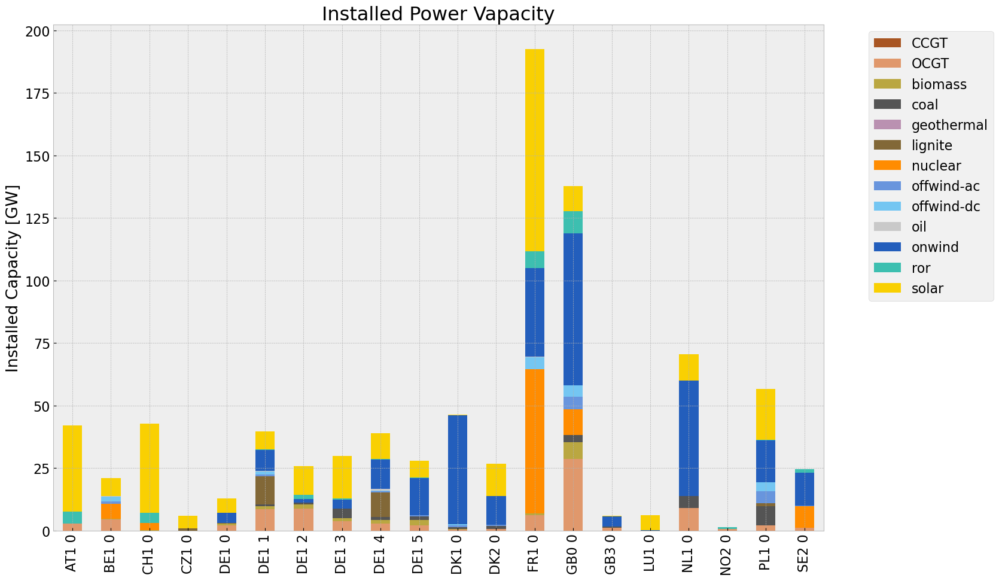

<Figure size 640x480 with 0 Axes>

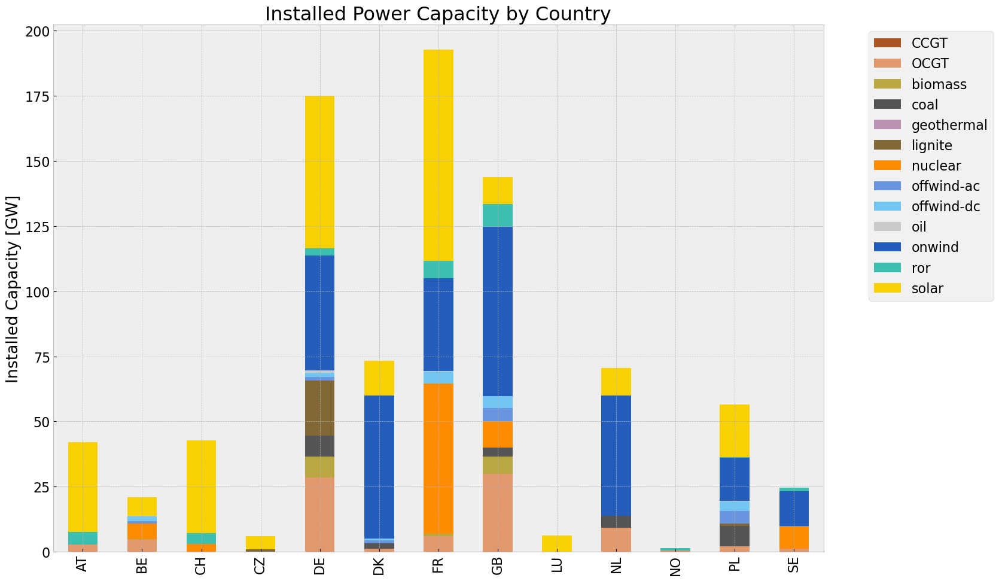

<Figure size 640x480 with 0 Axes>

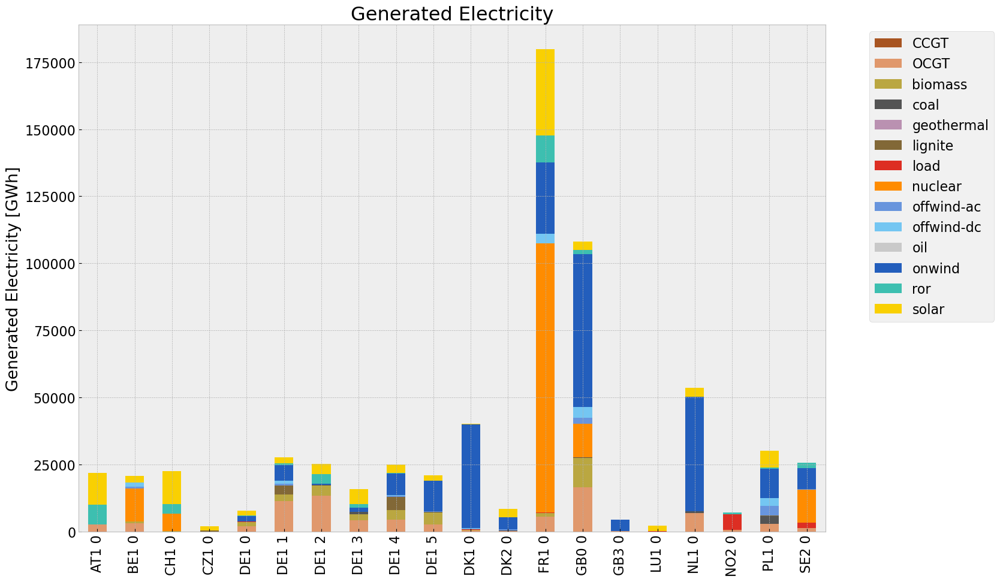

<Figure size 640x480 with 0 Axes>

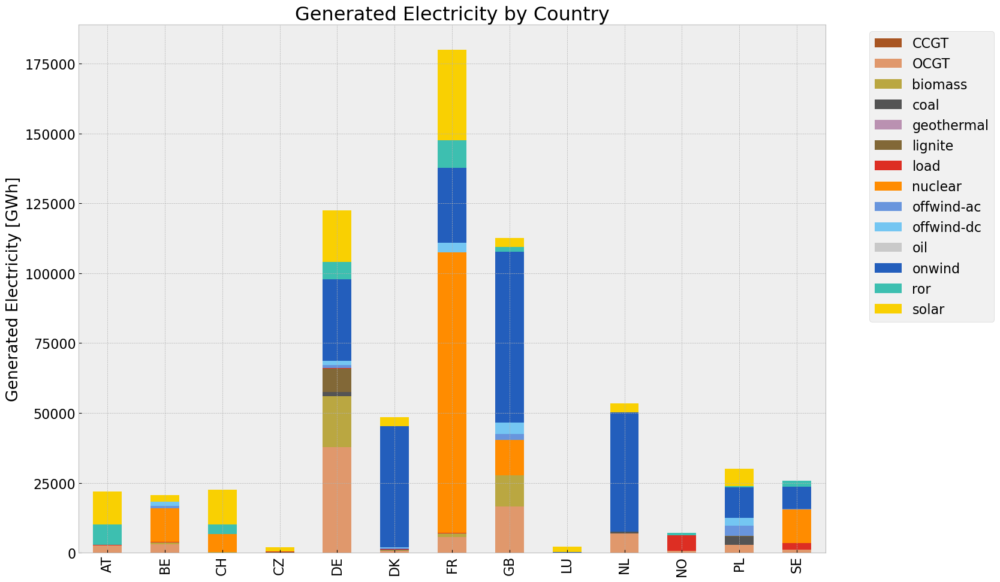

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,7.794690e+07,0.451621,0.1980,3.417355e+07
biomass,3.157616e+07,0.468000,0.0000,0.000000e+00
coal,5.735634e+06,0.329908,0.3361,5.843285e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,8.658884e+06,0.337285,0.4069,1.044607e+07
load,8.704563e+06,1.000000,0.0000,0.000000e+00
nuclear,1.436183e+08,0.326600,0.0000,0.000000e+00
offwind-ac,8.367419e+06,1.000000,0.0000,0.000000e+00


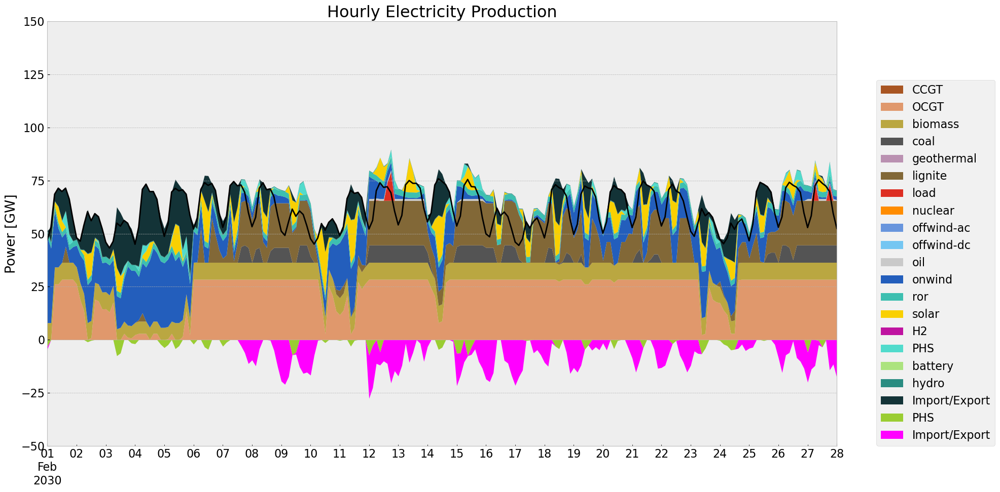

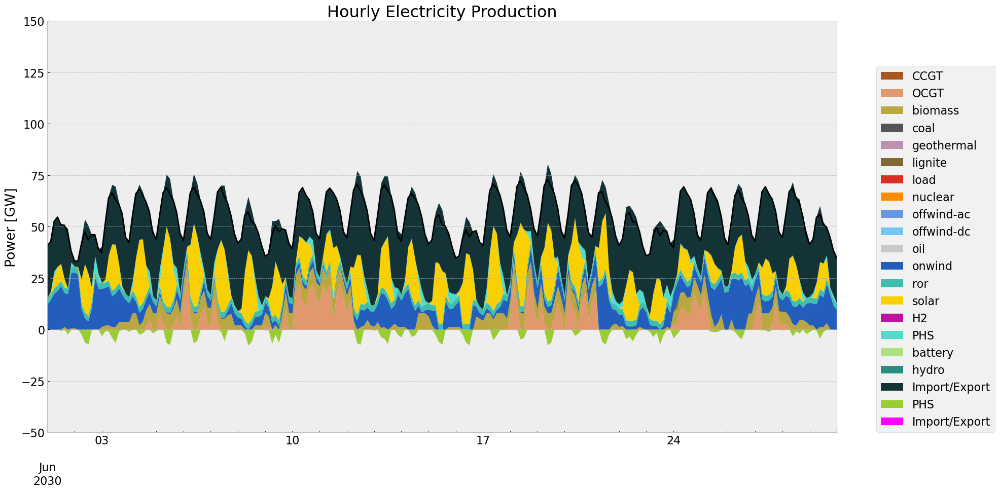

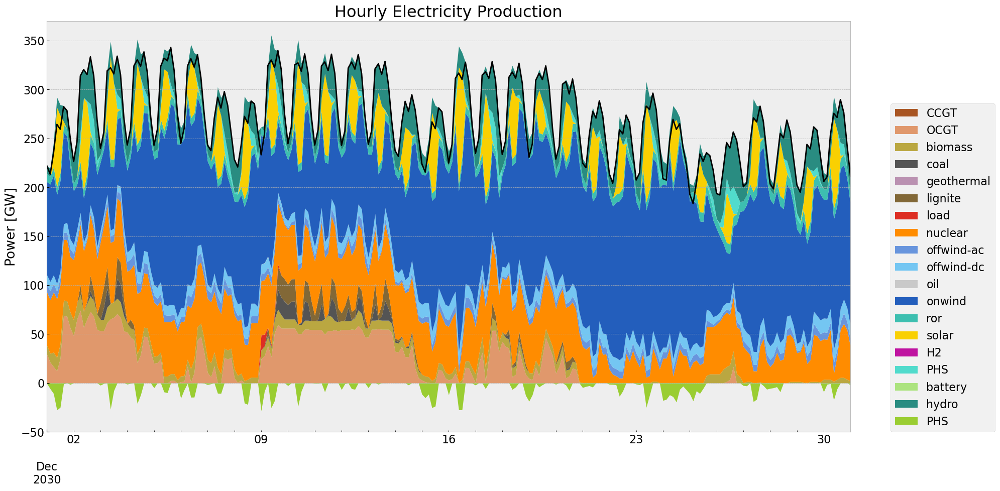

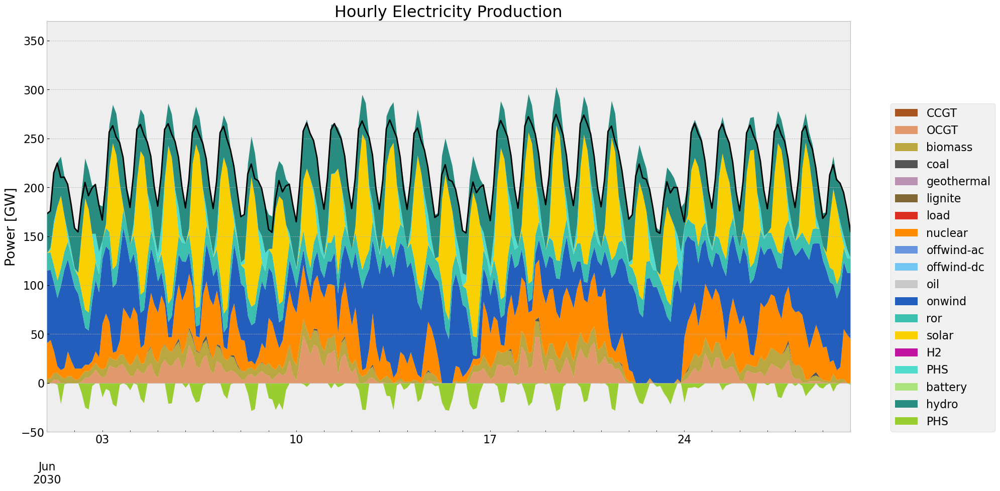

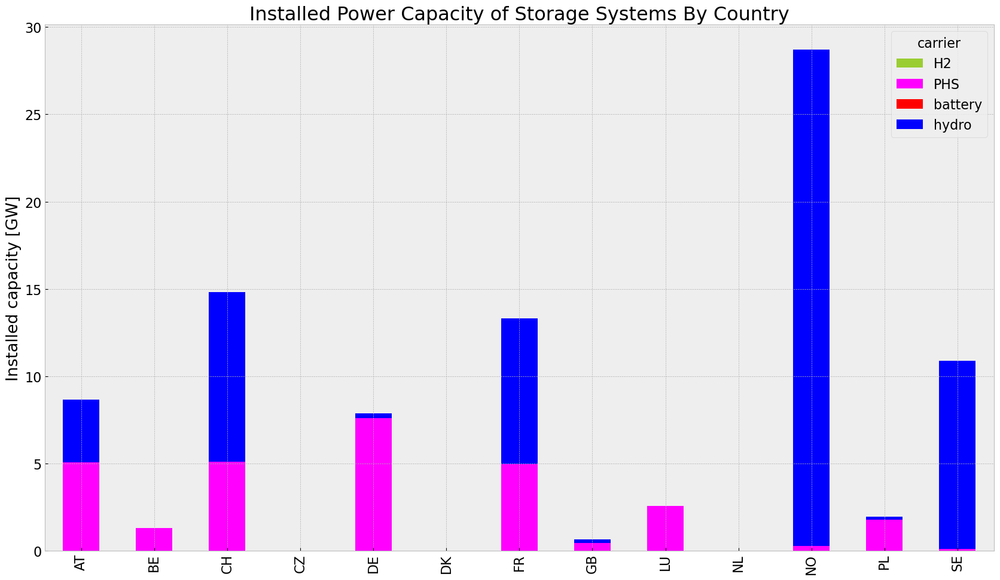

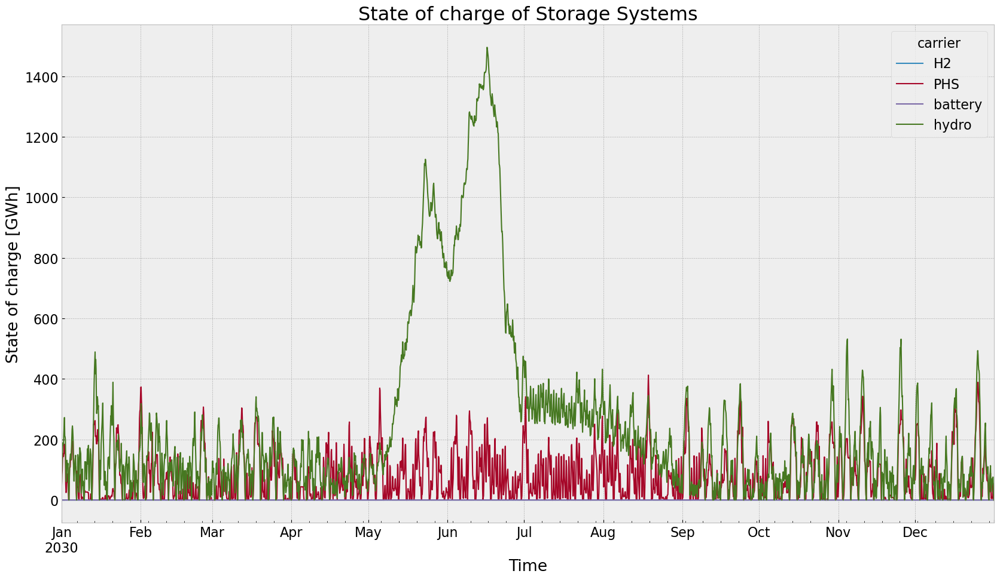

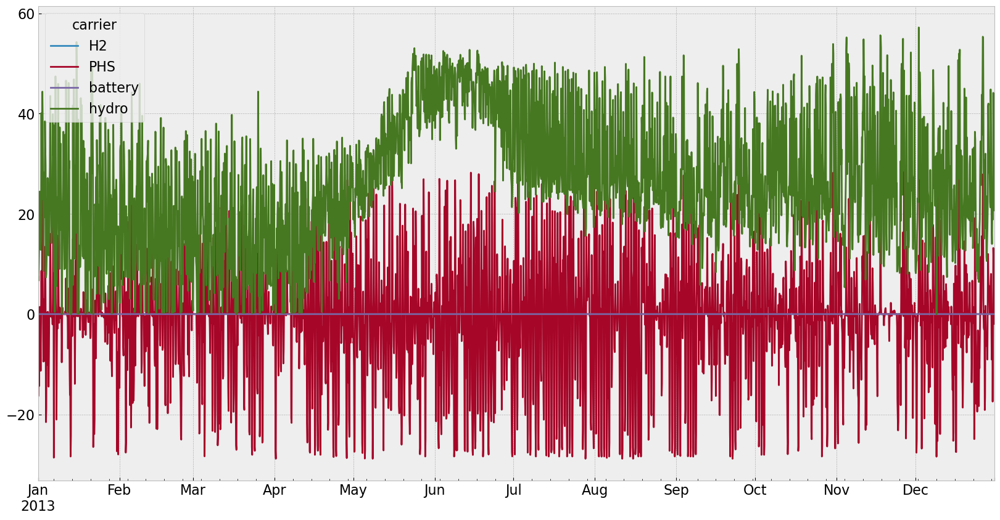

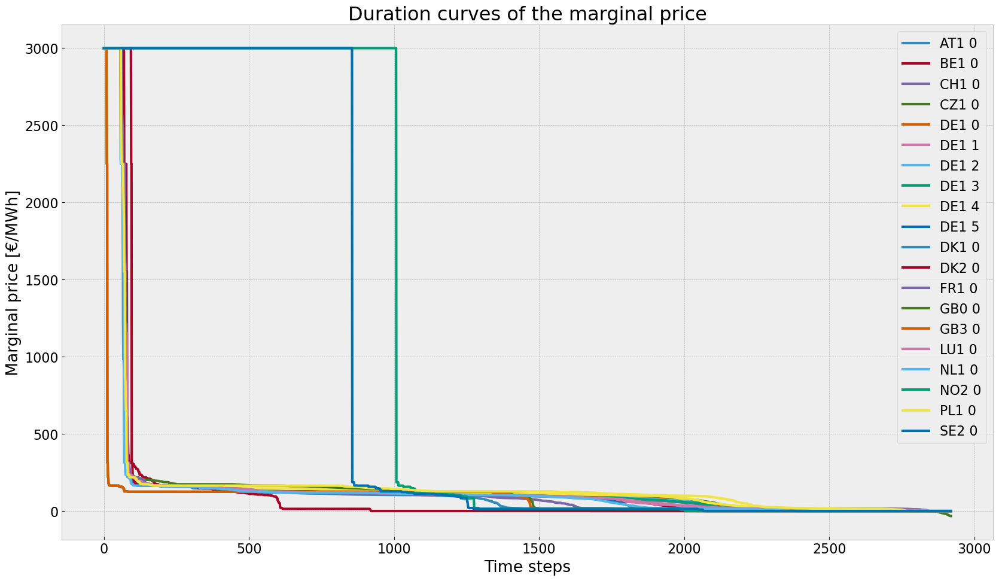

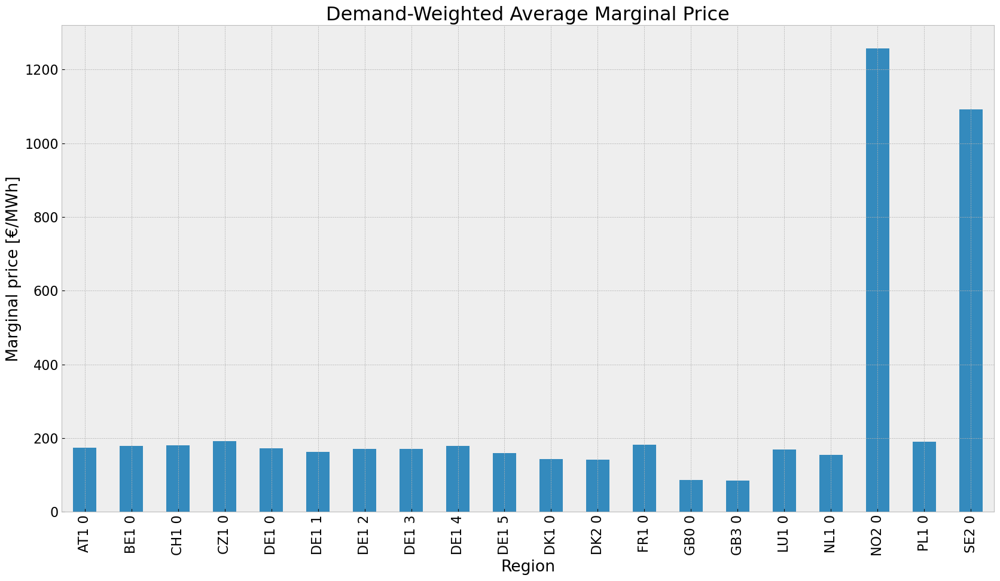

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


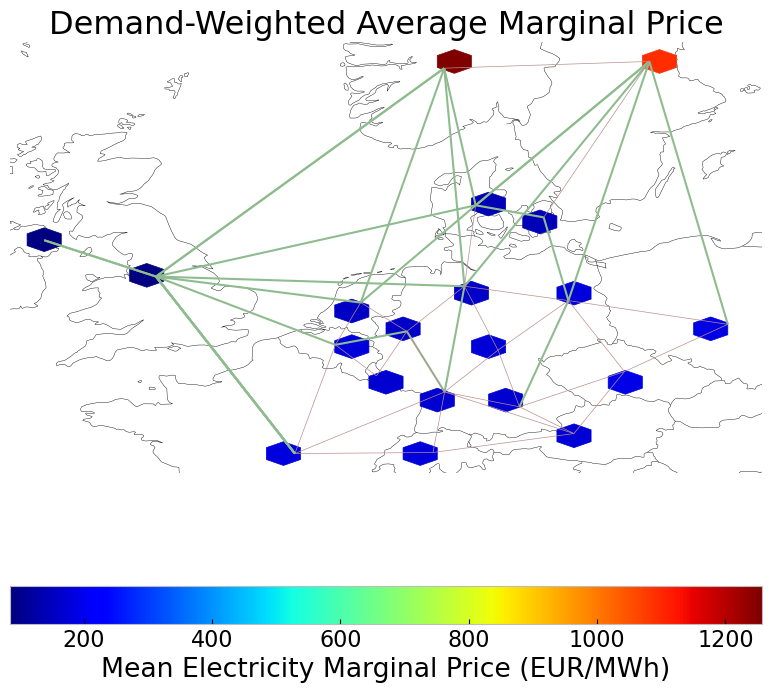

In [163]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv_roll = inst_cap_table(n3, color_cap)
cap_noinv_roll_country = inst_cap_table_country(n3, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_noinv_roll  = gen_power_table(n3,colors_gen_table)
gen_noinv_roll_country = gen_power_table_country(n3,colors_gen_table)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n3, '2030-02-01', '2030-02-28', colors_gen,'DE')
gen_curve(n3, '2030-06-01', '2030-06-30', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n3, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n3, '2030-06-01', '2030-06-30', colors_gen)

#installed storage unit & stores
store_noinv_roll = inst_store_table(n3)

#State of Charge Storage unit
state_of_charge_plot(n3)
n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n3)

#avg electricity price
price_regions_table(n3)
price_regions(n3)

#Emission
em_noinv_roll =em_table(n3)
em_noinv_roll

## 4. Allowed Investment scenario solved with Rolling Horizon

In [164]:
n4 = n1.copy()
n4.name = 'inv_roll_offwind'
horizon = 24

no_inv(n4,n1)
#set extendable to false
#set the optimal capacity of generators from the base scenario as the new minimum capacity 
#for index, value in n4.generators.p_nom_extendable.items():
#    if value:  
#        n4.generators.at[index, 'p_nom'] = n1.generators.at[index, 'p_nom_opt']
#        #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
#        n4.generators.at[index,'p_nom_extendable'] = False

#set the optimal capacity of storage units from the base scenario as the new minimum capacity 
#for index, value in n4.storage_units.p_nom_extendable.items():
#    if value:  
#        n4.storage_units.at[index, 'p_nom'] = n1.storage_units.at[index, 'p_nom_opt']
#        #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
#        n4.storage_units.at[index,'p_nom_extendable'] = False

#set the optimal capacity of stores from the base scenario as the new minimum capacity 
#for index, value in n4.stores.e_nom_extendable.items():
#    if value:  
#        n4.stores.at[index, 'e_nom'] = n1.stores.at[index, 'e_nom_opt']
#        #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
#        n4.stores.at[index, 'e_nom_extendable'] =False

#set the optimal capacity of lines from the base scenario as the new minimum capacity 
#for index, value in n2.lines.s_nom_extendable.items():
#    if value:  
#        n4.lines.at[index, 's_nom'] = n1.lines.at[index, 's_nom_opt']
#        #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
#        n4.lines.at[index, 's_nom_extendable'] =False

#set the optimal capacity of lines from the base scenario as the new minimum capacity 
#for index, value in n4.links.p_nom_extendable.items():
#    if value:  
#        n4.links.at[index, 's_nom'] = n1.links.at[index, 'p_nom_opt']
#        #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
#        n4.links.at[index, 'p_nom_extendable'] =False

n4.storage_units['cyclic_state_of_charge'] = False
n4.storage_units['cyclic_state_of_charge_per_period'] = False
optimize.optimize_with_rolling_horizon(n4, horizon=horizon, overlap=0, solver_name='gurobi')
#n4 = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\Offwindcut\\inv_roll.nc")

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 21:00:00] (1/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fdfft2ha.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fdfft2ha.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbf88bef4


INFO:gurobipy:Model fingerprint: 0xbf88bef4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25458 rows and 7101 columns


INFO:gurobipy:Presolve removed 25458 rows and 7101 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1374 rows, 5403 columns, 9114 nonzeros


INFO:gurobipy:Presolved: 1374 rows, 5403 columns, 9114 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.864e+03


INFO:gurobipy: AA' NZ     : 3.864e+03


 Factor NZ  : 3.890e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.890e+04 (roughly 3 MB of memory)


 Factor Ops : 2.031e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.031e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.02297131e+11 -5.22229457e+11  8.83e+04 1.14e+04  5.13e+08     0s


INFO:gurobipy:   0   2.02297131e+11 -5.22229457e+11  8.83e+04 1.14e+04  5.13e+08     0s


   1   4.20741758e+10 -2.75977854e+11  1.12e+04 7.28e-11  7.88e+07     0s


INFO:gurobipy:   1   4.20741758e+10 -2.75977854e+11  1.12e+04 7.28e-11  7.88e+07     0s


   2   6.55348707e+09 -7.36357890e+10  6.67e+02 5.82e-11  9.61e+06     0s


INFO:gurobipy:   2   6.55348707e+09 -7.36357890e+10  6.67e+02 5.82e-11  9.61e+06     0s


   3   1.90035361e+09 -1.47800971e+10  1.25e+02 6.84e-10  1.74e+06     0s


INFO:gurobipy:   3   1.90035361e+09 -1.47800971e+10  1.25e+02 6.84e-10  1.74e+06     0s


   4   6.84856797e+08 -3.30829512e+09  1.75e+01 2.18e-10  3.83e+05     0s


INFO:gurobipy:   4   6.84856797e+08 -3.30829512e+09  1.75e+01 2.18e-10  3.83e+05     0s


   5   4.28834043e+08 -1.02601225e+09  6.43e+00 1.16e-10  1.37e+05     0s


INFO:gurobipy:   5   4.28834043e+08 -1.02601225e+09  6.43e+00 1.16e-10  1.37e+05     0s


   6   2.88268954e+08 -3.01332028e+08  2.80e+00 2.91e-11  5.50e+04     0s


INFO:gurobipy:   6   2.88268954e+08 -3.01332028e+08  2.80e+00 2.91e-11  5.50e+04     0s


   7   2.05595134e+08 -7.19133633e+07  9.53e-01 2.91e-11  2.58e+04     0s


INFO:gurobipy:   7   2.05595134e+08 -7.19133633e+07  9.53e-01 2.91e-11  2.58e+04     0s


   8   1.73517355e+08  1.12470026e+08  2.52e-01 2.61e-11  5.66e+03     0s


INFO:gurobipy:   8   1.73517355e+08  1.12470026e+08  2.52e-01 2.61e-11  5.66e+03     0s


   9   1.60048932e+08  1.38330729e+08  8.70e-02 2.56e-11  2.01e+03     0s


INFO:gurobipy:   9   1.60048932e+08  1.38330729e+08  8.70e-02 2.56e-11  2.01e+03     0s


  10   1.55565201e+08  1.45749926e+08  4.14e-02 2.92e-11  9.10e+02     0s


INFO:gurobipy:  10   1.55565201e+08  1.45749926e+08  4.14e-02 2.92e-11  9.10e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1931    1.5078274e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1931    1.5078274e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1931 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1931 iterations and 0.19 seconds (0.05 work units)


Optimal objective  1.507827376e+08


INFO:gurobipy:Optimal objective  1.507827376e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 21:00:00] (2/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g1ju_108.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g1ju_108.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x49f8f5eb


INFO:gurobipy:Model fingerprint: 0x49f8f5eb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25444 rows and 6883 columns


INFO:gurobipy:Presolve removed 25444 rows and 6883 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 1388 rows, 5621 columns, 9374 nonzeros


INFO:gurobipy:Presolved: 1388 rows, 5621 columns, 9374 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.899e+03


INFO:gurobipy: AA' NZ     : 3.899e+03


 Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


 Factor Ops : 1.696e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.696e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.22809172e+11 -5.20792339e+11  8.47e+04 1.14e+04  4.92e+08     0s


INFO:gurobipy:   0   2.22809172e+11 -5.20792339e+11  8.47e+04 1.14e+04  4.92e+08     0s


   1   4.67399498e+10 -2.74625618e+11  1.06e+04 5.82e-11  7.58e+07     0s


INFO:gurobipy:   1   4.67399498e+10 -2.74625618e+11  1.06e+04 5.82e-11  7.58e+07     0s


   2   8.51835275e+09 -7.18187272e+10  7.09e+02 1.83e+02  9.48e+06     0s


INFO:gurobipy:   2   8.51835275e+09 -7.18187272e+10  7.09e+02 1.83e+02  9.48e+06     0s


   3   2.33993496e+09 -1.21307061e+10  9.50e+01 3.06e-10  1.44e+06     0s


INFO:gurobipy:   3   2.33993496e+09 -1.21307061e+10  9.50e+01 3.06e-10  1.44e+06     0s


   4   1.18142457e+09 -5.24355675e+09  2.49e+01 2.62e-10  5.97e+05     0s


INFO:gurobipy:   4   1.18142457e+09 -5.24355675e+09  2.49e+01 2.62e-10  5.97e+05     0s


   5   8.57764266e+08 -1.23781679e+09  9.88e+00 1.60e-10  1.91e+05     0s


INFO:gurobipy:   5   8.57764266e+08 -1.23781679e+09  9.88e+00 1.60e-10  1.91e+05     0s


   6   6.78297064e+08 -3.13570559e+08  4.61e+00 1.46e-10  8.98e+04     0s


INFO:gurobipy:   6   6.78297064e+08 -3.13570559e+08  4.61e+00 1.46e-10  8.98e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.25 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.25 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1672    4.2786782e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1672    4.2786782e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1672 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1672 iterations and 0.27 seconds (0.05 work units)


Optimal objective  4.278678175e+08


INFO:gurobipy:Optimal objective  4.278678175e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 21:00:00] (3/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2rizruwq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2rizruwq.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5d903a6f


INFO:gurobipy:Model fingerprint: 0x5d903a6f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25440 rows and 6878 columns


INFO:gurobipy:Presolve removed 25440 rows and 6878 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1392 rows, 5626 columns, 9391 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5626 columns, 9391 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.63998601e+11 -5.02800149e+11  9.16e+04 1.38e+04  5.22e+08     0s


INFO:gurobipy:   0   2.63998601e+11 -5.02800149e+11  9.16e+04 1.38e+04  5.22e+08     0s


   1   5.84924321e+10 -2.67477814e+11  1.18e+04 7.28e-11  8.07e+07     0s


INFO:gurobipy:   1   5.84924321e+10 -2.67477814e+11  1.18e+04 7.28e-11  8.07e+07     0s


   2   1.38187532e+10 -6.53603953e+10  7.42e+02 8.73e-11  9.50e+06     0s


INFO:gurobipy:   2   1.38187532e+10 -6.53603953e+10  7.42e+02 8.73e-11  9.50e+06     0s


   3   6.46746522e+09 -1.64451559e+10  1.78e+02 4.37e-10  2.40e+06     0s


INFO:gurobipy:   3   6.46746522e+09 -1.64451559e+10  1.78e+02 4.37e-10  2.40e+06     0s


   4   4.14726072e+09 -4.53662296e+09  8.08e+01 3.49e-10  8.80e+05     0s


INFO:gurobipy:   4   4.14726072e+09 -4.53662296e+09  8.08e+01 3.49e-10  8.80e+05     0s


   5   3.01749514e+09 -1.33092492e+08  4.13e+01 1.46e-10  3.15e+05     0s


INFO:gurobipy:   5   3.01749514e+09 -1.33092492e+08  4.13e+01 1.46e-10  3.15e+05     0s


   6   2.56977551e+09  1.06639572e+09  2.18e+01 1.02e-10  1.48e+05     0s


INFO:gurobipy:   6   2.56977551e+09  1.06639572e+09  2.18e+01 1.02e-10  1.48e+05     0s


   7   2.23456935e+09  1.77991431e+09  5.10e+00 1.02e-10  4.28e+04     0s


INFO:gurobipy:   7   2.23456935e+09  1.77991431e+09  5.10e+00 1.02e-10  4.28e+04     0s


   8   2.12832520e+09  1.96429955e+09  1.33e+00 8.73e-11  1.51e+04     0s


INFO:gurobipy:   8   2.12832520e+09  1.96429955e+09  1.33e+00 8.73e-11  1.51e+04     0s


   9   2.08645085e+09  2.01269443e+09  3.26e-01 5.82e-11  6.67e+03     0s


INFO:gurobipy:   9   2.08645085e+09  2.01269443e+09  3.26e-01 5.82e-11  6.67e+03     0s


  10   2.07537378e+09  2.03397112e+09  1.59e-01 2.91e-11  3.73e+03     0s


INFO:gurobipy:  10   2.07537378e+09  2.03397112e+09  1.59e-01 2.91e-11  3.73e+03     0s


  11   2.06778939e+09  2.04769234e+09  5.53e-02 2.91e-11  1.80e+03     0s


INFO:gurobipy:  11   2.06778939e+09  2.04769234e+09  5.53e-02 2.91e-11  1.80e+03     0s


  12   2.06558007e+09  2.05794318e+09  2.81e-02 4.37e-11  6.87e+02     0s


INFO:gurobipy:  12   2.06558007e+09  2.05794318e+09  2.81e-02 4.37e-11  6.87e+02     0s


  13   2.06392548e+09  2.06155763e+09  1.08e-02 3.09e-11  2.14e+02     0s


INFO:gurobipy:  13   2.06392548e+09  2.06155763e+09  1.08e-02 3.09e-11  2.14e+02     0s


  14   2.06302636e+09  2.06235984e+09  1.81e-03 2.82e-11  5.98e+01     0s


INFO:gurobipy:  14   2.06302636e+09  2.06235984e+09  1.81e-03 2.82e-11  5.98e+01     0s


  15   2.06290153e+09  2.06263125e+09  7.35e-04 3.17e-11  2.42e+01     0s


INFO:gurobipy:  15   2.06290153e+09  2.06263125e+09  7.35e-04 3.17e-11  2.42e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1717    2.0628085e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1717    2.0628085e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1717 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1717 iterations and 0.24 seconds (0.05 work units)


Optimal objective  2.062808541e+09


INFO:gurobipy:Optimal objective  2.062808541e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.06e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 21:00:00] (4/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vps86h8v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vps86h8v.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe0f7c027


INFO:gurobipy:Model fingerprint: 0xe0f7c027


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25440 rows and 6860 columns


INFO:gurobipy:Presolve removed 25440 rows and 6860 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1392 rows, 5644 columns, 9409 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5644 columns, 9409 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.61049284e+11 -5.13975411e+11  5.48e+04 1.45e+04  3.33e+08     0s


INFO:gurobipy:   0   1.61049284e+11 -5.13975411e+11  5.48e+04 1.45e+04  3.33e+08     0s


   1   3.78654040e+10 -2.29412709e+11  6.13e+03 7.28e-11  4.98e+07     0s


INFO:gurobipy:   1   3.78654040e+10 -2.29412709e+11  6.13e+03 7.28e-11  4.98e+07     0s


   2   1.01474278e+10 -5.56834881e+10  4.28e+02 3.92e+02  7.14e+06     0s


INFO:gurobipy:   2   1.01474278e+10 -5.56834881e+10  4.28e+02 3.92e+02  7.14e+06     0s


   3   3.70982059e+09 -1.09050982e+10  6.98e+01 6.79e+00  1.41e+06     0s


INFO:gurobipy:   3   3.70982059e+09 -1.09050982e+10  6.98e+01 6.79e+00  1.41e+06     0s


   4   2.63049960e+09 -2.14900399e+09  3.13e+01 3.06e-10  4.51e+05     0s


INFO:gurobipy:   4   2.63049960e+09 -2.14900399e+09  3.13e+01 3.06e-10  4.51e+05     0s


   5   2.18296764e+09  2.66216687e+08  1.21e+01 1.22e-10  1.76e+05     0s


INFO:gurobipy:   5   2.18296764e+09  2.66216687e+08  1.21e+01 1.22e-10  1.76e+05     0s


   6   2.02590755e+09  1.29518418e+09  5.82e+00 4.37e-11  6.66e+04     0s


INFO:gurobipy:   6   2.02590755e+09  1.29518418e+09  5.82e+00 4.37e-11  6.66e+04     0s


   7   1.86628319e+09  1.61000336e+09  1.20e+00 5.82e-11  2.30e+04     0s


INFO:gurobipy:   7   1.86628319e+09  1.61000336e+09  1.20e+00 5.82e-11  2.30e+04     0s


   8   1.81041614e+09  1.70360631e+09  3.48e-01 2.91e-11  9.52e+03     0s


INFO:gurobipy:   8   1.81041614e+09  1.70360631e+09  3.48e-01 2.91e-11  9.52e+03     0s


   9   1.78692232e+09  1.74052448e+09  6.98e-02 2.91e-11  4.12e+03     0s


INFO:gurobipy:   9   1.78692232e+09  1.74052448e+09  6.98e-02 2.91e-11  4.12e+03     0s


  10   1.78348360e+09  1.76118202e+09  4.16e-02 2.91e-11  1.98e+03     0s


INFO:gurobipy:  10   1.78348360e+09  1.76118202e+09  4.16e-02 2.91e-11  1.98e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1680    1.7771344e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1680    1.7771344e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1680 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1680 iterations and 0.18 seconds (0.05 work units)


Optimal objective  1.777134434e+09


INFO:gurobipy:Optimal objective  1.777134434e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.78e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 21:00:00] (5/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s5axid8h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s5axid8h.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe134854f


INFO:gurobipy:Model fingerprint: 0xe134854f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25441 rows and 6875 columns


INFO:gurobipy:Presolve removed 25441 rows and 6875 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1391 rows, 5629 columns, 9388 nonzeros


INFO:gurobipy:Presolved: 1391 rows, 5629 columns, 9388 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


 Factor Ops : 1.735e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.735e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.53127425e+11 -5.01822970e+11  8.80e+04 1.39e+04  5.01e+08     0s


INFO:gurobipy:   0   2.53127425e+11 -5.01822970e+11  8.80e+04 1.39e+04  5.01e+08     0s


   1   5.72020944e+10 -2.66140186e+11  1.13e+04 7.28e-11  7.80e+07     0s


INFO:gurobipy:   1   5.72020944e+10 -2.66140186e+11  1.13e+04 7.28e-11  7.80e+07     0s


INFO:gurobipy:


Barrier performed 1 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 1 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1597    3.2416225e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1597    3.2416225e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1597 iterations and 0.14 seconds (0.04 work units)


INFO:gurobipy:Solved in 1597 iterations and 0.14 seconds (0.04 work units)


Optimal objective  3.241622536e+09


INFO:gurobipy:Optimal objective  3.241622536e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.24e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 21:00:00] (6/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xmocwfp2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xmocwfp2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xde4adc6c


INFO:gurobipy:Model fingerprint: 0xde4adc6c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25454 rows and 6972 columns


INFO:gurobipy:Presolve removed 25454 rows and 6972 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1378 rows, 5532 columns, 9258 nonzeros


INFO:gurobipy:Presolved: 1378 rows, 5532 columns, 9258 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.876e+03


INFO:gurobipy: AA' NZ     : 3.876e+03


 Factor NZ  : 3.827e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.827e+04 (roughly 3 MB of memory)


 Factor Ops : 1.926e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.926e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.47226873e+11 -4.99024916e+11  8.77e+04 1.56e+04  5.02e+08     0s


INFO:gurobipy:   0   2.47226873e+11 -4.99024916e+11  8.77e+04 1.56e+04  5.02e+08     0s


   1   5.75550273e+10 -2.68131673e+11  1.20e+04 7.28e-11  8.19e+07     0s


INFO:gurobipy:   1   5.75550273e+10 -2.68131673e+11  1.20e+04 7.28e-11  8.19e+07     0s


   2   1.65977765e+10 -6.39124104e+10  7.54e+02 4.64e+01  9.82e+06     0s


INFO:gurobipy:   2   1.65977765e+10 -6.39124104e+10  7.54e+02 4.64e+01  9.82e+06     0s


   3   1.06753798e+10 -8.32530518e+09  1.84e+02 6.55e-10  2.10e+06     0s


INFO:gurobipy:   3   1.06753798e+10 -8.32530518e+09  1.84e+02 6.55e-10  2.10e+06     0s


   4   7.90352445e+09  3.35066199e+09  6.16e+01 4.37e-10  4.99e+05     0s


INFO:gurobipy:   4   7.90352445e+09  3.35066199e+09  6.16e+01 4.37e-10  4.99e+05     0s


   5   7.06486122e+09  4.91285267e+09  2.95e+01 4.51e-10  2.28e+05     0s


INFO:gurobipy:   5   7.06486122e+09  4.91285267e+09  2.95e+01 4.51e-10  2.28e+05     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1755    6.3239851e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1755    6.3239851e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1755 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1755 iterations and 0.16 seconds (0.05 work units)


Optimal objective  6.323985136e+09


INFO:gurobipy:Optimal objective  6.323985136e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.32e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 21:00:00] (7/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-80st_t8p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-80st_t8p.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7e03a9d9


INFO:gurobipy:Model fingerprint: 0x7e03a9d9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25445 rows and 6980 columns


INFO:gurobipy:Presolve removed 25445 rows and 6980 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1387 rows, 5524 columns, 9271 nonzeros


INFO:gurobipy:Presolved: 1387 rows, 5524 columns, 9271 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 3.871e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.871e+04 (roughly 3 MB of memory)


 Factor Ops : 2.014e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.014e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.09134885e+11 -5.10583675e+11  8.03e+04 1.19e+04  4.68e+08     0s


INFO:gurobipy:   0   2.09134885e+11 -5.10583675e+11  8.03e+04 1.19e+04  4.68e+08     0s


   1   4.59604636e+10 -2.60412556e+11  1.05e+04 7.28e-11  7.39e+07     0s


INFO:gurobipy:   1   4.59604636e+10 -2.60412556e+11  1.05e+04 7.28e-11  7.39e+07     0s


   2   1.07902376e+10 -6.80747405e+10  7.60e+02 8.73e-11  9.64e+06     0s


INFO:gurobipy:   2   1.07902376e+10 -6.80747405e+10  7.60e+02 8.73e-11  9.64e+06     0s


   3   4.77430175e+09 -1.52570152e+10  1.90e+02 4.07e-10  2.16e+06     0s


INFO:gurobipy:   3   4.77430175e+09 -1.52570152e+10  1.90e+02 4.07e-10  2.16e+06     0s


   4   3.23246103e+09 -8.75312338e+08  6.03e+01 6.98e-10  4.29e+05     0s


INFO:gurobipy:   4   3.23246103e+09 -8.75312338e+08  6.03e+01 6.98e-10  4.29e+05     0s


   5   2.72396819e+09  7.87123098e+08  2.60e+01 3.06e-10  1.92e+05     0s


INFO:gurobipy:   5   2.72396819e+09  7.87123098e+08  2.60e+01 3.06e-10  1.92e+05     0s


   6   2.53366892e+09  1.56547358e+09  1.44e+01 2.18e-10  9.39e+04     0s


INFO:gurobipy:   6   2.53366892e+09  1.56547358e+09  1.44e+01 2.18e-10  9.39e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1775    2.1844974e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1775    2.1844974e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1775 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1775 iterations and 0.16 seconds (0.05 work units)


Optimal objective  2.184497359e+09


INFO:gurobipy:Optimal objective  2.184497359e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.18e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 21:00:00] (8/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jc50m0r1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jc50m0r1.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb779e22a


INFO:gurobipy:Model fingerprint: 0xb779e22a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25441 rows and 6958 columns


INFO:gurobipy:Presolve removed 25441 rows and 6958 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1391 rows, 5546 columns, 9305 nonzeros


INFO:gurobipy:Presolved: 1391 rows, 5546 columns, 9305 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


 Factor Ops : 1.735e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.735e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.02163894e+11 -5.03027762e+11  6.80e+04 1.42e+04  4.01e+08     0s


INFO:gurobipy:   0   2.02163894e+11 -5.03027762e+11  6.80e+04 1.42e+04  4.01e+08     0s


   1   4.87176357e+10 -2.37770795e+11  8.20e+03 5.82e-11  6.10e+07     0s


INFO:gurobipy:   1   4.87176357e+10 -2.37770795e+11  8.20e+03 5.82e-11  6.10e+07     0s


   2   1.61919989e+10 -5.23947393e+10  5.71e+02 1.31e-10  8.01e+06     0s


INFO:gurobipy:   2   1.61919989e+10 -5.23947393e+10  5.71e+02 1.31e-10  8.01e+06     0s


   3   1.02700753e+10 -9.19910899e+09  1.58e+02 4.80e-10  2.08e+06     0s


INFO:gurobipy:   3   1.02700753e+10 -9.19910899e+09  1.58e+02 4.80e-10  2.08e+06     0s


   4   7.51782659e+09  1.65505126e+09  3.32e+01 2.47e-10  5.77e+05     0s


INFO:gurobipy:   4   7.51782659e+09  1.65505126e+09  3.32e+01 2.47e-10  5.77e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1693    6.2351841e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1693    6.2351841e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1693 iterations and 0.14 seconds (0.04 work units)


INFO:gurobipy:Solved in 1693 iterations and 0.14 seconds (0.04 work units)


Optimal objective  6.235184096e+09


INFO:gurobipy:Optimal objective  6.235184096e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.24e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 21:00:00] (9/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-znyvrja_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-znyvrja_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa2168240


INFO:gurobipy:Model fingerprint: 0xa2168240


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25468 rows and 7130 columns


INFO:gurobipy:Presolve removed 25468 rows and 7130 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1364 rows, 5374 columns, 9054 nonzeros


INFO:gurobipy:Presolved: 1364 rows, 5374 columns, 9054 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.838e+03


INFO:gurobipy: AA' NZ     : 3.838e+03


 Factor NZ  : 3.865e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.865e+04 (roughly 3 MB of memory)


 Factor Ops : 2.014e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.014e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.04611814e+11 -4.97703416e+11  8.21e+04 1.67e+04  4.78e+08     0s


INFO:gurobipy:   0   2.04611814e+11 -4.97703416e+11  8.21e+04 1.67e+04  4.78e+08     0s


   1   2.96260927e+10 -2.51860834e+11  5.89e+03 7.28e-11  5.19e+07     0s


INFO:gurobipy:   1   2.96260927e+10 -2.51860834e+11  5.89e+03 7.28e-11  5.19e+07     0s


   2   9.89001410e+09 -5.64216270e+10  4.47e+02 3.20e-10  7.54e+06     0s


INFO:gurobipy:   2   9.89001410e+09 -5.64216270e+10  4.47e+02 3.20e-10  7.54e+06     0s


   3   5.71961831e+09 -1.13219422e+10  1.11e+02 1.75e-10  1.78e+06     0s


INFO:gurobipy:   3   5.71961831e+09 -1.13219422e+10  1.11e+02 1.75e-10  1.78e+06     0s


   4   4.12535022e+09  3.73693221e+08  2.81e+01 2.33e-10  3.75e+05     0s


INFO:gurobipy:   4   4.12535022e+09  3.73693221e+08  2.81e+01 2.33e-10  3.75e+05     0s


   5   3.69234180e+09  2.19505108e+09  1.14e+01 1.31e-10  1.47e+05     0s


INFO:gurobipy:   5   3.69234180e+09  2.19505108e+09  1.14e+01 1.31e-10  1.47e+05     0s


   6   3.50924959e+09  2.87898162e+09  5.41e+00 7.28e-11  6.12e+04     0s


INFO:gurobipy:   6   3.50924959e+09  2.87898162e+09  5.41e+00 7.28e-11  6.12e+04     0s


   7   3.35550109e+09  3.10821827e+09  1.12e+00 5.82e-11  2.34e+04     0s


INFO:gurobipy:   7   3.35550109e+09  3.10821827e+09  1.12e+00 5.82e-11  2.34e+04     0s


   8   3.31412366e+09  3.22378147e+09  3.71e-01 5.82e-11  8.53e+03     0s


INFO:gurobipy:   8   3.31412366e+09  3.22378147e+09  3.71e-01 5.82e-11  8.53e+03     0s


   9   3.30143665e+09  3.25656533e+09  1.82e-01 2.91e-11  4.23e+03     0s


INFO:gurobipy:   9   3.30143665e+09  3.25656533e+09  1.82e-01 2.91e-11  4.23e+03     0s


  10   3.29610663e+09  3.27046162e+09  1.09e-01 2.91e-11  2.42e+03     0s


INFO:gurobipy:  10   3.29610663e+09  3.27046162e+09  1.09e-01 2.91e-11  2.42e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.13 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.13 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1920    3.2869337e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1920    3.2869337e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1920 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1920 iterations and 0.17 seconds (0.05 work units)


Optimal objective  3.286933735e+09


INFO:gurobipy:Optimal objective  3.286933735e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.29e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 21:00:00] (10/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5q4epj7r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5q4epj7r.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5c2d66b3


INFO:gurobipy:Model fingerprint: 0x5c2d66b3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25483 rows and 7235 columns


INFO:gurobipy:Presolve removed 25483 rows and 7235 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1349 rows, 5269 columns, 8902 nonzeros


INFO:gurobipy:Presolved: 1349 rows, 5269 columns, 8902 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.799e+03


INFO:gurobipy: AA' NZ     : 3.799e+03


 Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


 Factor Ops : 1.791e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.791e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.15248505e+11 -5.06752930e+11  4.82e+04 1.18e+04  3.08e+08     0s


INFO:gurobipy:   0   1.15248505e+11 -5.06752930e+11  4.82e+04 1.18e+04  3.08e+08     0s


   1   1.85503052e+10 -2.21954709e+11  3.23e+03 8.73e-11  3.68e+07     0s


INFO:gurobipy:   1   1.85503052e+10 -2.21954709e+11  3.23e+03 8.73e-11  3.68e+07     0s


   2   5.99192449e+09 -4.32958634e+10  1.82e+02 2.40e+02  5.17e+06     0s


INFO:gurobipy:   2   5.99192449e+09 -4.32958634e+10  1.82e+02 2.40e+02  5.17e+06     0s


   3   2.74712201e+09 -7.19016778e+09  5.68e+01 8.73e-11  1.01e+06     0s


INFO:gurobipy:   3   2.74712201e+09 -7.19016778e+09  5.68e+01 8.73e-11  1.01e+06     0s


   4   1.55939445e+09 -6.83006636e+08  1.17e+01 4.37e-11  2.19e+05     0s


INFO:gurobipy:   4   1.55939445e+09 -6.83006636e+08  1.17e+01 4.37e-11  2.19e+05     0s


   5   1.35231210e+09  1.78111439e+08  6.66e+00 2.91e-11  1.14e+05     0s


INFO:gurobipy:   5   1.35231210e+09  1.78111439e+08  6.66e+00 2.91e-11  1.14e+05     0s


   6   1.21961233e+09  5.85875613e+08  3.84e+00 2.91e-11  6.11e+04     0s


INFO:gurobipy:   6   1.21961233e+09  5.85875613e+08  3.84e+00 2.91e-11  6.11e+04     0s


   7   1.11209231e+09  7.78686445e+08  1.62e+00 2.62e-11  3.20e+04     0s


INFO:gurobipy:   7   1.11209231e+09  7.78686445e+08  1.62e+00 2.62e-11  3.20e+04     0s


   8   1.05464560e+09  9.27425117e+08  5.41e-01 3.20e-11  1.22e+04     0s


INFO:gurobipy:   8   1.05464560e+09  9.27425117e+08  5.41e-01 3.20e-11  1.22e+04     0s


   9   1.03686862e+09  9.82019611e+08  2.53e-01 2.70e-11  5.24e+03     0s


INFO:gurobipy:   9   1.03686862e+09  9.82019611e+08  2.53e-01 2.70e-11  5.24e+03     0s


  10   1.03014637e+09  1.00186370e+09  1.58e-01 2.27e-11  2.70e+03     0s


INFO:gurobipy:  10   1.03014637e+09  1.00186370e+09  1.58e-01 2.27e-11  2.70e+03     0s


  11   1.02767492e+09  1.00892925e+09  1.26e-01 2.32e-11  1.79e+03     0s


INFO:gurobipy:  11   1.02767492e+09  1.00892925e+09  1.26e-01 2.32e-11  1.79e+03     0s


  12   1.02411425e+09  1.01196541e+09  8.09e-02 3.21e-11  1.16e+03     0s


INFO:gurobipy:  12   1.02411425e+09  1.01196541e+09  8.09e-02 3.21e-11  1.16e+03     0s


  13   1.01855824e+09  1.01464944e+09  1.07e-02 2.91e-11  3.72e+02     0s


INFO:gurobipy:  13   1.01855824e+09  1.01464944e+09  1.07e-02 2.91e-11  3.72e+02     0s


  14   1.01765201e+09  1.01676659e+09  2.02e-03 2.51e-11  8.42e+01     0s


INFO:gurobipy:  14   1.01765201e+09  1.01676659e+09  2.02e-03 2.51e-11  8.42e+01     0s


  15   1.01750506e+09  1.01716961e+09  9.08e-04 2.91e-11  3.19e+01     0s


INFO:gurobipy:  15   1.01750506e+09  1.01716961e+09  9.08e-04 2.91e-11  3.19e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1908    1.0173691e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1908    1.0173691e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1908 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1908 iterations and 0.20 seconds (0.05 work units)


Optimal objective  1.017369092e+09


INFO:gurobipy:Optimal objective  1.017369092e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.02e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 21:00:00] (11/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u8lqrvee.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u8lqrvee.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x11528004


INFO:gurobipy:Model fingerprint: 0x11528004


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 25471 rows and 7193 columns


INFO:gurobipy:Presolve removed 25471 rows and 7193 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1361 rows, 5311 columns, 9002 nonzeros


INFO:gurobipy:Presolved: 1361 rows, 5311 columns, 9002 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.841e+03


INFO:gurobipy: AA' NZ     : 3.841e+03


 Factor NZ  : 3.643e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.643e+04 (roughly 3 MB of memory)


 Factor Ops : 1.741e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.741e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.84641885e+11 -5.06109968e+11  7.14e+04 1.24e+04  4.30e+08     0s


INFO:gurobipy:   0   1.84641885e+11 -5.06109968e+11  7.14e+04 1.24e+04  4.30e+08     0s


   1   3.82143029e+10 -2.65043178e+11  8.50e+03 7.28e-11  6.63e+07     0s


INFO:gurobipy:   1   3.82143029e+10 -2.65043178e+11  8.50e+03 7.28e-11  6.63e+07     0s


   2   8.44689853e+09 -6.59676181e+10  5.87e+02 1.32e+02  8.87e+06     0s


INFO:gurobipy:   2   8.44689853e+09 -6.59676181e+10  5.87e+02 1.32e+02  8.87e+06     0s


   3   3.84436554e+09 -1.54080681e+10  1.47e+02 4.51e-10  2.06e+06     0s


INFO:gurobipy:   3   3.84436554e+09 -1.54080681e+10  1.47e+02 4.51e-10  2.06e+06     0s


   4   2.70129567e+09 -1.30171439e+09  6.00e+01 6.98e-10  4.28e+05     0s


INFO:gurobipy:   4   2.70129567e+09 -1.30171439e+09  6.00e+01 6.98e-10  4.28e+05     0s


   5   2.11448722e+09  4.18953247e+08  2.40e+01 3.06e-10  1.73e+05     0s


INFO:gurobipy:   5   2.11448722e+09  4.18953247e+08  2.40e+01 3.06e-10  1.73e+05     0s


   6   1.88778941e+09  1.07425225e+09  1.23e+01 3.06e-10  8.10e+04     0s


INFO:gurobipy:   6   1.88778941e+09  1.07425225e+09  1.23e+01 3.06e-10  8.10e+04     0s


   7   1.67361130e+09  1.37373714e+09  2.85e+00 7.28e-11  2.89e+04     0s


INFO:gurobipy:   7   1.67361130e+09  1.37373714e+09  2.85e+00 7.28e-11  2.89e+04     0s


   8   1.61903149e+09  1.49012565e+09  1.24e+00 7.28e-11  1.24e+04     0s


INFO:gurobipy:   8   1.61903149e+09  1.49012565e+09  1.24e+00 7.28e-11  1.24e+04     0s


   9   1.59101885e+09  1.53175012e+09  6.03e-01 4.37e-11  5.68e+03     0s


INFO:gurobipy:   9   1.59101885e+09  1.53175012e+09  6.03e-01 4.37e-11  5.68e+03     0s


  10   1.58036748e+09  1.54403025e+09  3.73e-01 2.91e-11  3.48e+03     0s


INFO:gurobipy:  10   1.58036748e+09  1.54403025e+09  3.73e-01 2.91e-11  3.48e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1799    1.5620161e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1799    1.5620161e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1799 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1799 iterations and 0.16 seconds (0.05 work units)


Optimal objective  1.562016062e+09


INFO:gurobipy:Optimal objective  1.562016062e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.56e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 21:00:00] (12/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2lucfwxf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2lucfwxf.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5b184016


INFO:gurobipy:Model fingerprint: 0x5b184016


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25532 rows and 7529 columns


INFO:gurobipy:Presolve removed 25532 rows and 7529 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1300 rows, 4975 columns, 8513 nonzeros


INFO:gurobipy:Presolved: 1300 rows, 4975 columns, 8513 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.704e+03


INFO:gurobipy: AA' NZ     : 3.704e+03


 Factor NZ  : 3.354e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.354e+04 (roughly 3 MB of memory)


 Factor Ops : 1.408e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.408e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.75981136e+11 -4.94843272e+11  6.49e+04 1.39e+04  4.30e+08     0s


INFO:gurobipy:   0   1.75981136e+11 -4.94843272e+11  6.49e+04 1.39e+04  4.30e+08     0s


   1   2.19795272e+10 -2.46922361e+11  3.54e+03 7.28e-11  4.39e+07     0s


INFO:gurobipy:   1   2.19795272e+10 -2.46922361e+11  3.54e+03 7.28e-11  4.39e+07     0s


   2   6.61498764e+09 -4.99746603e+10  2.99e+02 1.16e-10  6.60e+06     0s


INFO:gurobipy:   2   6.61498764e+09 -4.99746603e+10  2.99e+02 1.16e-10  6.60e+06     0s


   3   3.27955177e+09 -7.41760233e+09  6.57e+01 7.28e-11  1.16e+06     0s


INFO:gurobipy:   3   3.27955177e+09 -7.41760233e+09  6.57e+01 7.28e-11  1.16e+06     0s


   4   2.29256086e+09  7.70550771e+07  1.42e+01 1.02e-10  2.31e+05     0s


INFO:gurobipy:   4   2.29256086e+09  7.70550771e+07  1.42e+01 1.02e-10  2.31e+05     0s


   5   2.01362396e+09  9.62502996e+08  6.68e+00 2.91e-11  1.08e+05     0s


INFO:gurobipy:   5   2.01362396e+09  9.62502996e+08  6.68e+00 2.91e-11  1.08e+05     0s


   6   1.83600026e+09  1.38599555e+09  2.78e+00 2.91e-11  4.60e+04     0s


INFO:gurobipy:   6   1.83600026e+09  1.38599555e+09  2.78e+00 2.91e-11  4.60e+04     0s


   7   1.74333915e+09  1.55352565e+09  8.21e-01 3.70e-11  1.92e+04     0s


INFO:gurobipy:   7   1.74333915e+09  1.55352565e+09  8.21e-01 3.70e-11  1.92e+04     0s


   8   1.72250993e+09  1.63131483e+09  4.83e-01 2.91e-11  9.25e+03     0s


INFO:gurobipy:   8   1.72250993e+09  1.63131483e+09  4.83e-01 2.91e-11  9.25e+03     0s


   9   1.70521398e+09  1.64996148e+09  2.22e-01 2.78e-11  5.59e+03     0s


INFO:gurobipy:   9   1.70521398e+09  1.64996148e+09  2.22e-01 2.78e-11  5.59e+03     0s


  10   1.69663013e+09  1.67503427e+09  1.01e-01 2.79e-11  2.19e+03     0s


INFO:gurobipy:  10   1.69663013e+09  1.67503427e+09  1.01e-01 2.79e-11  2.19e+03     0s


  11   1.69288000e+09  1.68387847e+09  5.08e-02 1.53e-11  9.13e+02     0s


INFO:gurobipy:  11   1.69288000e+09  1.68387847e+09  5.08e-02 1.53e-11  9.13e+02     0s


  12   1.69180957e+09  1.68562400e+09  3.69e-02 2.91e-11  6.27e+02     0s


INFO:gurobipy:  12   1.69180957e+09  1.68562400e+09  3.69e-02 2.91e-11  6.27e+02     0s


  13   1.69110308e+09  1.68620169e+09  2.83e-02 2.91e-11  4.97e+02     0s


INFO:gurobipy:  13   1.69110308e+09  1.68620169e+09  2.83e-02 2.91e-11  4.97e+02     0s


  14   1.69056348e+09  1.68687637e+09  2.17e-02 2.91e-11  3.74e+02     0s


INFO:gurobipy:  14   1.69056348e+09  1.68687637e+09  2.17e-02 2.91e-11  3.74e+02     0s


  15   1.68974914e+09  1.68789213e+09  1.20e-02 2.91e-11  1.88e+02     0s


INFO:gurobipy:  15   1.68974914e+09  1.68789213e+09  1.20e-02 2.91e-11  1.88e+02     0s


  16   1.68922843e+09  1.68808398e+09  5.94e-03 2.91e-11  1.16e+02     0s


INFO:gurobipy:  16   1.68922843e+09  1.68808398e+09  5.94e-03 2.91e-11  1.16e+02     0s


  17   1.68881137e+09  1.68851821e+09  1.01e-03 2.96e-11  2.96e+01     0s


INFO:gurobipy:  17   1.68881137e+09  1.68851821e+09  1.01e-03 2.96e-11  2.96e+01     0s


  18   1.68874397e+09  1.68860230e+09  3.43e-04 2.91e-11  1.43e+01     0s


INFO:gurobipy:  18   1.68874397e+09  1.68860230e+09  3.43e-04 2.91e-11  1.43e+01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.25 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.25 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1852    1.6887035e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1852    1.6887035e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1852 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 1852 iterations and 0.28 seconds (0.06 work units)


Optimal objective  1.688703504e+09


INFO:gurobipy:Optimal objective  1.688703504e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.69e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 21:00:00] (13/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rfqqeaht.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rfqqeaht.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1f432ec7


INFO:gurobipy:Model fingerprint: 0x1f432ec7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25447 rows and 7139 columns


INFO:gurobipy:Presolve removed 25447 rows and 7139 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1385 rows, 5365 columns, 9106 nonzeros


INFO:gurobipy:Presolved: 1385 rows, 5365 columns, 9106 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.889e+03


INFO:gurobipy: AA' NZ     : 3.889e+03


 Factor NZ  : 3.819e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.819e+04 (roughly 3 MB of memory)


 Factor Ops : 1.883e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.883e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.22538334e+11 -4.83174725e+11  6.59e+04 1.35e+04  4.40e+08     0s


INFO:gurobipy:   0   2.22538334e+11 -4.83174725e+11  6.59e+04 1.35e+04  4.40e+08     0s


   1   5.24568316e+10 -2.34297513e+11  8.53e+03 7.28e-11  6.84e+07     0s


INFO:gurobipy:   1   5.24568316e+10 -2.34297513e+11  8.53e+03 7.28e-11  6.84e+07     0s


   2   1.29193446e+10 -5.18687895e+10  5.65e+02 8.73e-11  8.04e+06     0s


INFO:gurobipy:   2   1.29193446e+10 -5.18687895e+10  5.65e+02 8.73e-11  8.04e+06     0s


   3   5.01363514e+09 -7.50185670e+09  6.09e+01 1.60e-10  1.28e+06     0s


INFO:gurobipy:   3   5.01363514e+09 -7.50185670e+09  6.09e+01 1.60e-10  1.28e+06     0s


   4   3.91555247e+09 -1.83730532e+09  2.99e+01 1.02e-10  5.71e+05     0s


INFO:gurobipy:   4   3.91555247e+09 -1.83730532e+09  2.99e+01 1.02e-10  5.71e+05     0s


   5   3.44045447e+09  9.95218125e+08  9.89e+00 7.28e-11  2.34e+05     0s


INFO:gurobipy:   5   3.44045447e+09  9.95218125e+08  9.89e+00 7.28e-11  2.34e+05     0s


   6   3.28770405e+09  2.43184087e+09  3.53e+00 5.82e-11  8.10e+04     0s


INFO:gurobipy:   6   3.28770405e+09  2.43184087e+09  3.53e+00 5.82e-11  8.10e+04     0s


   7   3.19573463e+09  2.78912948e+09  1.26e+00 2.91e-11  3.82e+04     0s


INFO:gurobipy:   7   3.19573463e+09  2.78912948e+09  1.26e+00 2.91e-11  3.82e+04     0s


   8   3.11625565e+09  3.00056992e+09  1.27e-01 2.91e-11  1.08e+04     0s


INFO:gurobipy:   8   3.11625565e+09  3.00056992e+09  1.27e-01 2.91e-11  1.08e+04     0s


   9   3.09162705e+09  3.04001050e+09  3.95e-02 2.91e-11  4.81e+03     0s


INFO:gurobipy:   9   3.09162705e+09  3.04001050e+09  3.95e-02 2.91e-11  4.81e+03     0s


  10   3.08542383e+09  3.06045070e+09  2.07e-02 2.91e-11  2.33e+03     0s


INFO:gurobipy:  10   3.08542383e+09  3.06045070e+09  2.07e-02 2.91e-11  2.33e+03     0s


  11   3.08220832e+09  3.07149074e+09  1.17e-02 2.91e-11  1.00e+03     0s


INFO:gurobipy:  11   3.08220832e+09  3.07149074e+09  1.17e-02 2.91e-11  1.00e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1709    3.0775313e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1709    3.0775313e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1709 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1709 iterations and 0.20 seconds (0.05 work units)


Optimal objective  3.077531299e+09


INFO:gurobipy:Optimal objective  3.077531299e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 21:00:00] (14/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ux3n8k64.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ux3n8k64.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x17141188


INFO:gurobipy:Model fingerprint: 0x17141188


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25445 rows and 7167 columns


INFO:gurobipy:Presolve removed 25445 rows and 7167 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1387 rows, 5337 columns, 9084 nonzeros


INFO:gurobipy:Presolved: 1387 rows, 5337 columns, 9084 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 3.903e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.903e+04 (roughly 3 MB of memory)


 Factor Ops : 2.019e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.019e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.99969895e+11 -4.78929118e+11  5.88e+04 1.45e+04  3.98e+08     0s


INFO:gurobipy:   0   1.99969895e+11 -4.78929118e+11  5.88e+04 1.45e+04  3.98e+08     0s


   1   4.51765465e+10 -2.37189418e+11  7.26e+03 6.55e-11  6.20e+07     0s


INFO:gurobipy:   1   4.51765465e+10 -2.37189418e+11  7.26e+03 6.55e-11  6.20e+07     0s


   2   1.11610759e+10 -5.76582346e+10  4.48e+02 1.76e+02  8.03e+06     0s


INFO:gurobipy:   2   1.11610759e+10 -5.76582346e+10  4.48e+02 1.76e+02  8.03e+06     0s


   3   5.80089052e+09 -1.42411970e+10  1.14e+02 1.88e+01  2.11e+06     0s


INFO:gurobipy:   3   5.80089052e+09 -1.42411970e+10  1.14e+02 1.88e+01  2.11e+06     0s


   4   3.81509741e+09 -1.66715965e+09  4.01e+01 2.47e-10  5.56e+05     0s


INFO:gurobipy:   4   3.81509741e+09 -1.66715965e+09  4.01e+01 2.47e-10  5.56e+05     0s


   5   3.24659995e+09  8.65642320e+08  1.42e+01 1.60e-10  2.32e+05     0s


INFO:gurobipy:   5   3.24659995e+09  8.65642320e+08  1.42e+01 1.60e-10  2.32e+05     0s


   6   3.04586010e+09  1.91651851e+09  5.01e+00 1.02e-10  1.08e+05     0s


INFO:gurobipy:   6   3.04586010e+09  1.91651851e+09  5.01e+00 1.02e-10  1.08e+05     0s


   7   2.93042501e+09  2.58723484e+09  1.38e+00 4.37e-11  3.25e+04     0s


INFO:gurobipy:   7   2.93042501e+09  2.58723484e+09  1.38e+00 4.37e-11  3.25e+04     0s


   8   2.86627185e+09  2.75256585e+09  1.11e-01 2.91e-11  1.07e+04     0s


INFO:gurobipy:   8   2.86627185e+09  2.75256585e+09  1.11e-01 2.91e-11  1.07e+04     0s


   9   2.85042893e+09  2.80585271e+09  3.62e-02 2.91e-11  4.18e+03     0s


INFO:gurobipy:   9   2.85042893e+09  2.80585271e+09  3.62e-02 2.91e-11  4.18e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1724    2.8374407e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1724    2.8374407e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1724 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1724 iterations and 0.15 seconds (0.05 work units)


Optimal objective  2.837440705e+09


INFO:gurobipy:Optimal objective  2.837440705e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.84e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 21:00:00] (15/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ckmlsu9x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ckmlsu9x.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9501b403


INFO:gurobipy:Model fingerprint: 0x9501b403


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25447 rows and 7249 columns


INFO:gurobipy:Presolve removed 25447 rows and 7249 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1385 rows, 5255 columns, 8996 nonzeros


INFO:gurobipy:Presolved: 1385 rows, 5255 columns, 8996 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.889e+03


INFO:gurobipy: AA' NZ     : 3.889e+03


 Factor NZ  : 3.698e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.698e+04 (roughly 3 MB of memory)


 Factor Ops : 1.791e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.791e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.93025998e+11 -4.74852726e+11  5.80e+04 1.46e+04  3.97e+08     0s


INFO:gurobipy:   0   1.93025998e+11 -4.74852726e+11  5.80e+04 1.46e+04  3.97e+08     0s


   1   4.60354568e+10 -2.31614753e+11  7.07e+03 7.28e-11  6.14e+07     0s


INFO:gurobipy:   1   4.60354568e+10 -2.31614753e+11  7.07e+03 7.28e-11  6.14e+07     0s


   2   1.45297863e+10 -5.33371026e+10  4.60e+02 1.73e+02  8.11e+06     0s


INFO:gurobipy:   2   1.45297863e+10 -5.33371026e+10  4.60e+02 1.73e+02  8.11e+06     0s


   3   7.95034168e+09 -5.67592839e+09  7.11e+01 5.53e-10  1.43e+06     0s


INFO:gurobipy:   3   7.95034168e+09 -5.67592839e+09  7.11e+01 5.53e-10  1.43e+06     0s


   4   6.07918923e+09  7.78038546e+08  2.09e+01 3.35e-10  5.32e+05     0s


INFO:gurobipy:   4   6.07918923e+09  7.78038546e+08  2.09e+01 3.35e-10  5.32e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1764    5.0568298e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1764    5.0568298e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1764 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1764 iterations and 0.14 seconds (0.05 work units)


Optimal objective  5.056829785e+09


INFO:gurobipy:Optimal objective  5.056829785e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.06e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 21:00:00] (16/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z9hi1aur.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z9hi1aur.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x02ce1817


INFO:gurobipy:Model fingerprint: 0x02ce1817


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25443 rows and 7205 columns


INFO:gurobipy:Presolve removed 25443 rows and 7205 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1389 rows, 5299 columns, 9056 nonzeros


INFO:gurobipy:Presolved: 1389 rows, 5299 columns, 9056 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.902e+03


INFO:gurobipy: AA' NZ     : 3.902e+03


 Factor NZ  : 4.050e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.050e+04 (roughly 3 MB of memory)


 Factor Ops : 2.238e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.238e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.59975853e+11 -4.69677798e+11  4.58e+04 1.44e+04  3.19e+08     0s


INFO:gurobipy:   0   1.59975853e+11 -4.69677798e+11  4.58e+04 1.44e+04  3.19e+08     0s


   1   3.80371469e+10 -2.15828849e+11  5.71e+03 7.28e-11  5.14e+07     0s


INFO:gurobipy:   1   3.80371469e+10 -2.15828849e+11  5.71e+03 7.28e-11  5.14e+07     0s


   2   1.15207202e+10 -4.90174498e+10  3.57e+02 2.51e+02  6.94e+06     0s


INFO:gurobipy:   2   1.15207202e+10 -4.90174498e+10  3.57e+02 2.51e+02  6.94e+06     0s


   3   5.43860091e+09 -6.17937321e+09  5.13e+01 4.37e-10  1.18e+06     0s


INFO:gurobipy:   3   5.43860091e+09 -6.17937321e+09  5.13e+01 4.37e-10  1.18e+06     0s


   4   3.93616600e+09 -7.52262566e+08  1.96e+01 3.49e-10  4.64e+05     0s


INFO:gurobipy:   4   3.93616600e+09 -7.52262566e+08  1.96e+01 3.49e-10  4.64e+05     0s


   5   3.33574017e+09  1.42134794e+09  8.87e+00 1.31e-10  1.87e+05     0s


INFO:gurobipy:   5   3.33574017e+09  1.42134794e+09  8.87e+00 1.31e-10  1.87e+05     0s


   6   3.13742643e+09  2.39604563e+09  4.29e+00 8.37e-11  7.17e+04     0s


INFO:gurobipy:   6   3.13742643e+09  2.39604563e+09  4.29e+00 8.37e-11  7.17e+04     0s


   7   3.02247806e+09  2.74203730e+09  1.10e+00 2.91e-11  2.67e+04     0s


INFO:gurobipy:   7   3.02247806e+09  2.74203730e+09  1.10e+00 2.91e-11  2.67e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1749    2.9340737e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1749    2.9340737e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1749 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1749 iterations and 0.16 seconds (0.05 work units)


Optimal objective  2.934073703e+09


INFO:gurobipy:Optimal objective  2.934073703e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.93e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 21:00:00] (17/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-44ewavaa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-44ewavaa.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5dbd2520


INFO:gurobipy:Model fingerprint: 0x5dbd2520


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25441 rows and 7225 columns


INFO:gurobipy:Presolve removed 25441 rows and 7225 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1391 rows, 5279 columns, 9038 nonzeros


INFO:gurobipy:Presolved: 1391 rows, 5279 columns, 9038 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


 Factor Ops : 1.735e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.735e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.85317463e+11 -4.82782958e+11  5.63e+04 1.48e+04  3.88e+08     0s


INFO:gurobipy:   0   1.85317463e+11 -4.82782958e+11  5.63e+04 1.48e+04  3.88e+08     0s


   1   4.27961573e+10 -2.34937262e+11  6.87e+03 7.28e-11  6.02e+07     0s


INFO:gurobipy:   1   4.27961573e+10 -2.34937262e+11  6.87e+03 7.28e-11  6.02e+07     0s


   2   1.17437335e+10 -5.43277211e+10  4.27e+02 1.46e+02  7.77e+06     0s


INFO:gurobipy:   2   1.17437335e+10 -5.43277211e+10  4.27e+02 1.46e+02  7.77e+06     0s


   3   5.53631361e+09 -8.97595183e+09  9.98e+01 2.62e-10  1.55e+06     0s


INFO:gurobipy:   3   5.53631361e+09 -8.97595183e+09  9.98e+01 2.62e-10  1.55e+06     0s


   4   3.80600380e+09 -4.12766734e+08  3.24e+01 1.75e-10  4.30e+05     0s


INFO:gurobipy:   4   3.80600380e+09 -4.12766734e+08  3.24e+01 1.75e-10  4.30e+05     0s


   5   3.35586253e+09  1.73096350e+09  1.19e+01 1.35e-10  1.60e+05     0s


INFO:gurobipy:   5   3.35586253e+09  1.73096350e+09  1.19e+01 1.35e-10  1.60e+05     0s


   6   3.16017568e+09  2.56150521e+09  4.61e+00 5.82e-11  5.81e+04     0s


INFO:gurobipy:   6   3.16017568e+09  2.56150521e+09  4.61e+00 5.82e-11  5.81e+04     0s


   7   3.03148947e+09  2.76961834e+09  8.58e-01 2.91e-11  2.50e+04     0s


INFO:gurobipy:   7   3.03148947e+09  2.76961834e+09  8.58e-01 2.91e-11  2.50e+04     0s


   8   2.98177145e+09  2.90881299e+09  8.30e-02 3.01e-11  6.92e+03     0s


INFO:gurobipy:   8   2.98177145e+09  2.90881299e+09  8.30e-02 3.01e-11  6.92e+03     0s


   9   2.97169572e+09  2.93905920e+09  2.75e-02 2.91e-11  3.09e+03     0s


INFO:gurobipy:   9   2.97169572e+09  2.93905920e+09  2.75e-02 2.91e-11  3.09e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1764    2.9643014e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1764    2.9643014e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1764 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1764 iterations and 0.15 seconds (0.05 work units)


Optimal objective  2.964301396e+09


INFO:gurobipy:Optimal objective  2.964301396e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.96e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 21:00:00] (18/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oawr2vzk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oawr2vzk.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1a37357d


INFO:gurobipy:Model fingerprint: 0x1a37357d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 25441 rows and 7110 columns


INFO:gurobipy:Presolve removed 25441 rows and 7110 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1391 rows, 5394 columns, 9153 nonzeros


INFO:gurobipy:Presolved: 1391 rows, 5394 columns, 9153 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


 Factor Ops : 1.735e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.735e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.03698322e+11 -4.79149022e+11  6.03e+04 1.54e+04  4.08e+08     0s


INFO:gurobipy:   0   2.03698322e+11 -4.79149022e+11  6.03e+04 1.54e+04  4.08e+08     0s


   1   4.85608514e+10 -2.40407760e+11  8.30e+03 7.28e-11  6.77e+07     0s


INFO:gurobipy:   1   4.85608514e+10 -2.40407760e+11  8.30e+03 7.28e-11  6.77e+07     0s


   2   1.12863802e+10 -5.31389194e+10  4.22e+02 3.74e+01  7.48e+06     0s


INFO:gurobipy:   2   1.12863802e+10 -5.31389194e+10  4.22e+02 3.74e+01  7.48e+06     0s


   3   5.17465456e+09 -8.02980445e+09  7.99e+01 2.97e-09  1.36e+06     0s


INFO:gurobipy:   3   5.17465456e+09 -8.02980445e+09  7.99e+01 2.97e-09  1.36e+06     0s


   4   3.78215244e+09  3.37634251e+08  1.96e+01 6.84e-10  3.35e+05     0s


INFO:gurobipy:   4   3.78215244e+09  3.37634251e+08  1.96e+01 6.84e-10  3.35e+05     0s


   5   3.45910560e+09  2.14165474e+09  6.17e+00 3.06e-10  1.25e+05     0s


INFO:gurobipy:   5   3.45910560e+09  2.14165474e+09  6.17e+00 3.06e-10  1.25e+05     0s


   6   3.32204095e+09  2.75072548e+09  2.37e+00 1.31e-10  5.36e+04     0s


INFO:gurobipy:   6   3.32204095e+09  2.75072548e+09  2.37e+00 1.31e-10  5.36e+04     0s


   7   3.24167470e+09  3.00755875e+09  8.70e-01 4.37e-11  2.19e+04     0s


INFO:gurobipy:   7   3.24167470e+09  3.00755875e+09  8.70e-01 4.37e-11  2.19e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1855    3.1673356e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1855    3.1673356e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1855 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1855 iterations and 0.15 seconds (0.05 work units)


Optimal objective  3.167335568e+09


INFO:gurobipy:Optimal objective  3.167335568e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.17e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 21:00:00] (19/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-svx6znu9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-svx6znu9.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x82e62937


INFO:gurobipy:Model fingerprint: 0x82e62937


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25441 rows and 7173 columns


INFO:gurobipy:Presolve removed 25441 rows and 7173 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1391 rows, 5331 columns, 9090 nonzeros


INFO:gurobipy:Presolved: 1391 rows, 5331 columns, 9090 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


 Factor Ops : 1.735e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.735e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58944758e+11 -4.80004750e+11  4.68e+04 1.42e+04  3.31e+08     0s


INFO:gurobipy:   0   1.58944758e+11 -4.80004750e+11  4.68e+04 1.42e+04  3.31e+08     0s


   1   3.76758937e+10 -2.19380759e+11  5.44e+03 7.28e-11  5.08e+07     0s


INFO:gurobipy:   1   3.76758937e+10 -2.19380759e+11  5.44e+03 7.28e-11  5.08e+07     0s


   2   1.04855269e+10 -4.81958037e+10  3.26e+02 2.11e+02  6.63e+06     0s


INFO:gurobipy:   2   1.04855269e+10 -4.81958037e+10  3.26e+02 2.11e+02  6.63e+06     0s


   3   4.36952083e+09 -8.42687596e+09  5.45e+01 2.62e-10  1.29e+06     0s


INFO:gurobipy:   3   4.36952083e+09 -8.42687596e+09  5.45e+01 2.62e-10  1.29e+06     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1666    2.4326877e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1666    2.4326877e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1666 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1666 iterations and 0.14 seconds (0.05 work units)


Optimal objective  2.432687714e+09


INFO:gurobipy:Optimal objective  2.432687714e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.43e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 21:00:00] (20/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mi3yvrev.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mi3yvrev.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xca9a3ca6


INFO:gurobipy:Model fingerprint: 0xca9a3ca6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25441 rows and 7142 columns


INFO:gurobipy:Presolve removed 25441 rows and 7142 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 1391 rows, 5362 columns, 9121 nonzeros


INFO:gurobipy:Presolved: 1391 rows, 5362 columns, 9121 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


 Factor Ops : 1.735e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.735e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.84201067e+11 -4.76809786e+11  5.20e+04 1.60e+04  3.62e+08     0s


INFO:gurobipy:   0   1.84201067e+11 -4.76809786e+11  5.20e+04 1.60e+04  3.62e+08     0s


   1   4.53528100e+10 -2.26437864e+11  6.71e+03 6.55e-11  5.84e+07     0s


INFO:gurobipy:   1   4.53528100e+10 -2.26437864e+11  6.71e+03 6.55e-11  5.84e+07     0s


   2   1.26154047e+10 -5.00147666e+10  4.20e+02 1.62e+02  7.33e+06     0s


INFO:gurobipy:   2   1.26154047e+10 -5.00147666e+10  4.20e+02 1.62e+02  7.33e+06     0s


   3   5.74187464e+09 -8.54353227e+09  7.39e+01 1.16e-09  1.48e+06     0s


INFO:gurobipy:   3   5.74187464e+09 -8.54353227e+09  7.39e+01 1.16e-09  1.48e+06     0s


   4   3.56613367e+09 -6.55765812e+08  1.90e+01 2.47e-10  4.15e+05     0s


INFO:gurobipy:   4   3.56613367e+09 -6.55765812e+08  1.90e+01 2.47e-10  4.15e+05     0s


   5   3.05541829e+09  1.26341539e+09  8.28e+00 1.31e-10  1.73e+05     0s


INFO:gurobipy:   5   3.05541829e+09  1.26341539e+09  8.28e+00 1.31e-10  1.73e+05     0s


   6   2.81633586e+09  2.10141257e+09  3.40e+00 5.82e-11  6.85e+04     0s


INFO:gurobipy:   6   2.81633586e+09  2.10141257e+09  3.40e+00 5.82e-11  6.85e+04     0s


   7   2.69411707e+09  2.45083217e+09  1.03e+00 4.37e-11  2.31e+04     0s


INFO:gurobipy:   7   2.69411707e+09  2.45083217e+09  1.03e+00 4.37e-11  2.31e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.19 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.19 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1673    2.6172983e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1673    2.6172983e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1673 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1673 iterations and 0.24 seconds (0.05 work units)


Optimal objective  2.617298253e+09


INFO:gurobipy:Optimal objective  2.617298253e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.62e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 21:00:00] (21/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fcq17pkk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fcq17pkk.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x18ee762f


INFO:gurobipy:Model fingerprint: 0x18ee762f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25441 rows and 7161 columns


INFO:gurobipy:Presolve removed 25441 rows and 7161 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1391 rows, 5343 columns, 9102 nonzeros


INFO:gurobipy:Presolved: 1391 rows, 5343 columns, 9102 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


 Factor Ops : 1.735e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.735e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.55741483e+11 -4.85141210e+11  4.64e+04 1.65e+04  3.29e+08     0s


INFO:gurobipy:   0   1.55741483e+11 -4.85141210e+11  4.64e+04 1.65e+04  3.29e+08     0s


   1   3.65534468e+10 -2.21142975e+11  5.86e+03 7.28e-11  5.28e+07     0s


INFO:gurobipy:   1   3.65534468e+10 -2.21142975e+11  5.86e+03 7.28e-11  5.28e+07     0s


   2   8.15929527e+09 -5.46084780e+10  3.28e+02 2.56e+02  7.00e+06     0s


INFO:gurobipy:   2   8.15929527e+09 -5.46084780e+10  3.28e+02 2.56e+02  7.00e+06     0s


   3   3.59797568e+09 -9.03817297e+09  7.66e+01 5.53e-10  1.30e+06     0s


INFO:gurobipy:   3   3.59797568e+09 -9.03817297e+09  7.66e+01 5.53e-10  1.30e+06     0s


   4   2.31887330e+09 -1.05015627e+09  1.60e+01 3.06e-10  3.28e+05     0s


INFO:gurobipy:   4   2.31887330e+09 -1.05015627e+09  1.60e+01 3.06e-10  3.28e+05     0s


   5   1.92918957e+09  6.97750338e+08  6.00e+00 1.02e-10  1.18e+05     0s


INFO:gurobipy:   5   1.92918957e+09  6.97750338e+08  6.00e+00 1.02e-10  1.18e+05     0s


   6   1.72483637e+09  1.21531079e+09  2.29e+00 4.37e-11  4.83e+04     0s


INFO:gurobipy:   6   1.72483637e+09  1.21531079e+09  2.29e+00 4.37e-11  4.83e+04     0s


   7   1.62366561e+09  1.41208188e+09  7.63e-01 4.37e-11  2.00e+04     0s


INFO:gurobipy:   7   1.62366561e+09  1.41208188e+09  7.63e-01 4.37e-11  2.00e+04     0s


   8   1.57394838e+09  1.51583057e+09  1.85e-01 3.36e-11  5.47e+03     0s


INFO:gurobipy:   8   1.57394838e+09  1.51583057e+09  1.85e-01 3.36e-11  5.47e+03     0s


   9   1.56177138e+09  1.54144677e+09  7.65e-02 4.37e-11  1.91e+03     0s


INFO:gurobipy:   9   1.56177138e+09  1.54144677e+09  7.65e-02 4.37e-11  1.91e+03     0s


  10   1.55753955e+09  1.54606975e+09  4.26e-02 2.33e-11  1.08e+03     0s


INFO:gurobipy:  10   1.55753955e+09  1.54606975e+09  4.26e-02 2.33e-11  1.08e+03     0s


  11   1.55514795e+09  1.54838103e+09  2.37e-02 2.91e-11  6.37e+02     0s


INFO:gurobipy:  11   1.55514795e+09  1.54838103e+09  2.37e-02 2.91e-11  6.37e+02     0s


  12   1.55344505e+09  1.55058346e+09  1.00e-02 2.91e-11  2.69e+02     0s


INFO:gurobipy:  12   1.55344505e+09  1.55058346e+09  1.00e-02 2.91e-11  2.69e+02     0s


  13   1.55260388e+09  1.55149916e+09  3.90e-03 2.91e-11  1.04e+02     0s


INFO:gurobipy:  13   1.55260388e+09  1.55149916e+09  3.90e-03 2.91e-11  1.04e+02     0s


  14   1.55215252e+09  1.55194212e+09  7.67e-04 2.91e-11  1.98e+01     0s


INFO:gurobipy:  14   1.55215252e+09  1.55194212e+09  7.67e-04 2.91e-11  1.98e+01     0s


  15   1.55205673e+09  1.55201991e+09  1.57e-04 3.16e-11  3.47e+00     0s


INFO:gurobipy:  15   1.55205673e+09  1.55201991e+09  1.57e-04 3.16e-11  3.47e+00     0s


  16   1.55203517e+09  1.55202790e+09  2.81e-05 2.57e-11  6.84e-01     0s


INFO:gurobipy:  16   1.55203517e+09  1.55202790e+09  2.81e-05 2.57e-11  6.84e-01     0s


  17   1.55203092e+09  1.55202938e+09  5.11e-06 3.07e-11  1.45e-01     0s


INFO:gurobipy:  17   1.55203092e+09  1.55202938e+09  5.11e-06 3.07e-11  1.45e-01     0s


  18   1.55202996e+09  1.55202980e+09  2.79e-07 3.15e-11  1.53e-02     0s


INFO:gurobipy:  18   1.55202996e+09  1.55202980e+09  2.79e-07 3.15e-11  1.53e-02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.23 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.23 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1737    1.5520299e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1737    1.5520299e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1737 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1737 iterations and 0.27 seconds (0.05 work units)


Optimal objective  1.552029899e+09


INFO:gurobipy:Optimal objective  1.552029899e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.55e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 21:00:00] (22/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bxiuo6jv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bxiuo6jv.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdb8ca8c7


INFO:gurobipy:Model fingerprint: 0xdb8ca8c7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25443 rows and 7160 columns


INFO:gurobipy:Presolve removed 25443 rows and 7160 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1389 rows, 5344 columns, 9097 nonzeros


INFO:gurobipy:Presolved: 1389 rows, 5344 columns, 9097 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.899e+03


INFO:gurobipy: AA' NZ     : 3.899e+03


 Factor NZ  : 3.764e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.764e+04 (roughly 3 MB of memory)


 Factor Ops : 1.744e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.744e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.80127288e+11 -4.83056367e+11  5.54e+04 1.52e+04  3.84e+08     0s


INFO:gurobipy:   0   1.80127288e+11 -4.83056367e+11  5.54e+04 1.52e+04  3.84e+08     0s


   1   4.24184254e+10 -2.32728531e+11  7.67e+03 7.28e-11  6.37e+07     0s


INFO:gurobipy:   1   4.24184254e+10 -2.32728531e+11  7.67e+03 7.28e-11  6.37e+07     0s


   2   9.12562213e+09 -5.76763594e+10  4.23e+02 1.04e+02  7.76e+06     0s


INFO:gurobipy:   2   9.12562213e+09 -5.76763594e+10  4.23e+02 1.04e+02  7.76e+06     0s


   3   3.88214519e+09 -1.16166864e+10  7.87e+01 1.05e-09  1.60e+06     0s


INFO:gurobipy:   3   3.88214519e+09 -1.16166864e+10  7.87e+01 1.05e-09  1.60e+06     0s


   4   2.76530110e+09  3.16533326e+07  1.08e+01 4.66e-10  2.64e+05     0s


INFO:gurobipy:   4   2.76530110e+09  3.16533326e+07  1.08e+01 4.66e-10  2.64e+05     0s


   5   2.47717631e+09  1.44647951e+09  3.96e+00 1.46e-10  9.81e+04     0s


INFO:gurobipy:   5   2.47717631e+09  1.44647951e+09  3.96e+00 1.46e-10  9.81e+04     0s


   6   2.32317501e+09  1.90895448e+09  1.55e+00 4.37e-11  3.92e+04     0s


INFO:gurobipy:   6   2.32317501e+09  1.90895448e+09  1.55e+00 4.37e-11  3.92e+04     0s


   7   2.22118496e+09  2.08518942e+09  2.52e-01 4.36e-11  1.28e+04     0s


INFO:gurobipy:   7   2.22118496e+09  2.08518942e+09  2.52e-01 4.36e-11  1.28e+04     0s


   8   2.19097075e+09  2.15827722e+09  3.49e-02 2.91e-11  3.06e+03     0s


INFO:gurobipy:   8   2.19097075e+09  2.15827722e+09  3.49e-02 2.91e-11  3.06e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.19 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.19 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1734    2.1818215e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1734    2.1818215e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1734 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1734 iterations and 0.22 seconds (0.05 work units)


Optimal objective  2.181821501e+09


INFO:gurobipy:Optimal objective  2.181821501e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.18e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 21:00:00] (23/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r541r0z3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r541r0z3.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5b1a89a0


INFO:gurobipy:Model fingerprint: 0x5b1a89a0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25460 rows and 7327 columns


INFO:gurobipy:Presolve removed 25460 rows and 7327 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1372 rows, 5177 columns, 8887 nonzeros


INFO:gurobipy:Presolved: 1372 rows, 5177 columns, 8887 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.861e+03


INFO:gurobipy: AA' NZ     : 3.861e+03


 Factor NZ  : 3.740e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.740e+04 (roughly 3 MB of memory)


 Factor Ops : 1.820e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.820e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.79070907e+11 -4.87488843e+11  6.62e+04 1.37e+04  4.34e+08     0s


INFO:gurobipy:   0   1.79070907e+11 -4.87488843e+11  6.62e+04 1.37e+04  4.34e+08     0s


   1   2.96925976e+10 -2.51589251e+11  6.70e+03 7.28e-11  5.95e+07     0s


INFO:gurobipy:   1   2.96925976e+10 -2.51589251e+11  6.70e+03 7.28e-11  5.95e+07     0s


   2   7.12504167e+09 -5.80956767e+10  4.82e+02 7.28e-11  7.92e+06     0s


INFO:gurobipy:   2   7.12504167e+09 -5.80956767e+10  4.82e+02 7.28e-11  7.92e+06     0s


   3   3.58508542e+09 -7.38006296e+09  9.79e+01 4.66e-10  1.21e+06     0s


INFO:gurobipy:   3   3.58508542e+09 -7.38006296e+09  9.79e+01 4.66e-10  1.21e+06     0s


   4   2.54360790e+09  1.10437552e+08  1.41e+01 1.31e-10  2.45e+05     0s


INFO:gurobipy:   4   2.54360790e+09  1.10437552e+08  1.41e+01 1.31e-10  2.45e+05     0s


   5   2.25057792e+09  1.31052103e+09  4.47e+00 5.82e-11  9.26e+04     0s


INFO:gurobipy:   5   2.25057792e+09  1.31052103e+09  4.47e+00 5.82e-11  9.26e+04     0s


   6   2.11003067e+09  1.73336134e+09  1.53e+00 8.73e-11  3.68e+04     0s


INFO:gurobipy:   6   2.11003067e+09  1.73336134e+09  1.53e+00 8.73e-11  3.68e+04     0s


   7   2.06175254e+09  1.89374204e+09  7.36e-01 2.91e-11  1.64e+04     0s


INFO:gurobipy:   7   2.06175254e+09  1.89374204e+09  7.36e-01 2.91e-11  1.64e+04     0s


   8   2.02547752e+09  1.96080812e+09  2.15e-01 2.91e-11  6.28e+03     0s


INFO:gurobipy:   8   2.02547752e+09  1.96080812e+09  2.15e-01 2.91e-11  6.28e+03     0s


   9   2.01668188e+09  1.98790839e+09  1.16e-01 2.91e-11  2.80e+03     0s


INFO:gurobipy:   9   2.01668188e+09  1.98790839e+09  1.16e-01 2.91e-11  2.80e+03     0s


  10   2.01276037e+09  1.99420316e+09  7.51e-02 2.40e-11  1.80e+03     0s


INFO:gurobipy:  10   2.01276037e+09  1.99420316e+09  7.51e-02 2.40e-11  1.80e+03     0s


  11   2.00951162e+09  1.99903840e+09  4.00e-02 2.62e-11  1.02e+03     0s


INFO:gurobipy:  11   2.00951162e+09  1.99903840e+09  4.00e-02 2.62e-11  1.02e+03     0s


  12   2.00766719e+09  2.00167070e+09  2.12e-02 2.91e-11  5.82e+02     0s


INFO:gurobipy:  12   2.00766719e+09  2.00167070e+09  2.12e-02 2.91e-11  5.82e+02     0s


  13   2.00702523e+09  2.00255467e+09  1.48e-02 2.91e-11  4.34e+02     0s


INFO:gurobipy:  13   2.00702523e+09  2.00255467e+09  1.48e-02 2.91e-11  4.34e+02     0s


  14   2.00643015e+09  2.00427117e+09  9.52e-03 2.83e-11  2.10e+02     0s


INFO:gurobipy:  14   2.00643015e+09  2.00427117e+09  9.52e-03 2.83e-11  2.10e+02     0s


  15   2.00573785e+09  2.00490947e+09  3.52e-03 3.42e-11  8.05e+01     0s


INFO:gurobipy:  15   2.00573785e+09  2.00490947e+09  3.52e-03 3.42e-11  8.05e+01     0s


  16   2.00555501e+09  2.00517550e+09  2.02e-03 2.91e-11  3.70e+01     0s


INFO:gurobipy:  16   2.00555501e+09  2.00517550e+09  2.02e-03 2.91e-11  3.70e+01     0s


  17   2.00543620e+09  2.00521443e+09  1.04e-03 3.00e-11  2.16e+01     0s


INFO:gurobipy:  17   2.00543620e+09  2.00521443e+09  1.04e-03 3.00e-11  2.16e+01     0s


  18   2.00535110e+09  2.00525621e+09  3.70e-04 2.91e-11  9.22e+00     0s


INFO:gurobipy:  18   2.00535110e+09  2.00525621e+09  3.70e-04 2.91e-11  9.22e+00     0s


  19   2.00531243e+09  2.00528820e+09  6.46e-05 2.91e-11  2.35e+00     0s


INFO:gurobipy:  19   2.00531243e+09  2.00528820e+09  6.46e-05 2.91e-11  2.35e+00     0s


  20   2.00530233e+09  2.00530049e+09  1.66e-06 3.29e-11  1.78e-01     0s


INFO:gurobipy:  20   2.00530233e+09  2.00530049e+09  1.66e-06 3.29e-11  1.78e-01     0s


  21   2.00530189e+09  2.00530172e+09  5.76e-09 2.91e-11  1.70e-02     0s


INFO:gurobipy:  21   2.00530189e+09  2.00530172e+09  5.76e-09 2.91e-11  1.70e-02     0s


  22   2.00530187e+09  2.00530185e+09  2.09e-09 2.91e-11  2.09e-03     0s


INFO:gurobipy:  22   2.00530187e+09  2.00530185e+09  2.09e-09 2.91e-11  2.09e-03     0s


  23   2.00530187e+09  2.00530187e+09  4.04e-10 2.93e-11  1.37e-04     0s


INFO:gurobipy:  23   2.00530187e+09  2.00530187e+09  4.04e-10 2.93e-11  1.37e-04     0s


  24   2.00530187e+09  2.00530187e+09  2.25e-09 2.91e-11  1.44e-05     0s


INFO:gurobipy:  24   2.00530187e+09  2.00530187e+09  2.25e-09 2.91e-11  1.44e-05     0s


  25   2.00530187e+09  2.00530187e+09  5.60e-10 2.94e-11  2.66e-08     0s


INFO:gurobipy:  25   2.00530187e+09  2.00530187e+09  5.60e-10 2.94e-11  2.66e-08     0s


  26   2.00530187e+09  2.00530187e+09  9.52e-12 2.94e-11  3.34e-11     0s


INFO:gurobipy:  26   2.00530187e+09  2.00530187e+09  9.52e-12 2.94e-11  3.34e-11     0s


INFO:gurobipy:


Barrier solved model in 26 iterations and 0.32 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 26 iterations and 0.32 seconds (0.06 work units)


Optimal objective 2.00530187e+09


INFO:gurobipy:Optimal objective 2.00530187e+09


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2045    2.0053019e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2045    2.0053019e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2045 iterations and 0.36 seconds (0.06 work units)


INFO:gurobipy:Solved in 2045 iterations and 0.36 seconds (0.06 work units)


Optimal objective  2.005301871e+09


INFO:gurobipy:Optimal objective  2.005301871e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.01e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 21:00:00] (24/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m91k2a7x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m91k2a7x.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x72a06b4f


INFO:gurobipy:Model fingerprint: 0x72a06b4f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25490 rows and 7271 columns


INFO:gurobipy:Presolve removed 25490 rows and 7271 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1342 rows, 5233 columns, 8892 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5233 columns, 8892 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.702e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.702e+04 (roughly 3 MB of memory)


 Factor Ops : 1.830e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.830e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.29128628e+11 -4.80031007e+11  7.40e+04 1.40e+04  4.77e+08     0s


INFO:gurobipy:   0   2.29128628e+11 -4.80031007e+11  7.40e+04 1.40e+04  4.77e+08     0s


   1   5.17930228e+10 -2.54639047e+11  9.55e+03 7.28e-11  7.52e+07     0s


INFO:gurobipy:   1   5.17930228e+10 -2.54639047e+11  9.55e+03 7.28e-11  7.52e+07     0s


   2   1.27820931e+10 -5.41173825e+10  5.97e+02 1.02e-10  8.48e+06     0s


INFO:gurobipy:   2   1.27820931e+10 -5.41173825e+10  5.97e+02 1.02e-10  8.48e+06     0s


   3   5.59740799e+09 -6.82283167e+09  7.23e+01 1.19e-09  1.31e+06     0s


INFO:gurobipy:   3   5.59740799e+09 -6.82283167e+09  7.23e+01 1.19e-09  1.31e+06     0s


   4   4.43299136e+09  5.71465627e+08  2.80e+01 2.18e-10  3.95e+05     0s


INFO:gurobipy:   4   4.43299136e+09  5.71465627e+08  2.80e+01 2.18e-10  3.95e+05     0s


   5   4.00926763e+09  2.54127684e+09  1.05e+01 2.40e-10  1.46e+05     0s


INFO:gurobipy:   5   4.00926763e+09  2.54127684e+09  1.05e+01 2.40e-10  1.46e+05     0s


   6   3.86732384e+09  3.20960404e+09  5.33e+00 4.37e-11  6.46e+04     0s


INFO:gurobipy:   6   3.86732384e+09  3.20960404e+09  5.33e+00 4.37e-11  6.46e+04     0s


   7   3.73122297e+09  3.44997828e+09  1.43e+00 4.37e-11  2.72e+04     0s


INFO:gurobipy:   7   3.73122297e+09  3.44997828e+09  1.43e+00 4.37e-11  2.72e+04     0s


   8   3.66285548e+09  3.58289336e+09  2.49e-01 4.37e-11  7.68e+03     0s


INFO:gurobipy:   8   3.66285548e+09  3.58289336e+09  2.49e-01 4.37e-11  7.68e+03     0s


   9   3.63996057e+09  3.61255405e+09  5.61e-02 4.37e-11  2.63e+03     0s


INFO:gurobipy:   9   3.63996057e+09  3.61255405e+09  5.61e-02 4.37e-11  2.63e+03     0s


  10   3.63507256e+09  3.62185688e+09  2.46e-02 2.52e-11  1.27e+03     0s


INFO:gurobipy:  10   3.63507256e+09  3.62185688e+09  2.46e-02 2.52e-11  1.27e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.30 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.30 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1805    3.6308255e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1805    3.6308255e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1805 iterations and 0.34 seconds (0.06 work units)


INFO:gurobipy:Solved in 1805 iterations and 0.34 seconds (0.06 work units)


Optimal objective  3.630825461e+09


INFO:gurobipy:Optimal objective  3.630825461e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.63e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 21:00:00] (25/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iyz57ac3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iyz57ac3.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf293abeb


INFO:gurobipy:Model fingerprint: 0xf293abeb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25443 rows and 7189 columns


INFO:gurobipy:Presolve removed 25443 rows and 7189 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1389 rows, 5315 columns, 9060 nonzeros


INFO:gurobipy:Presolved: 1389 rows, 5315 columns, 9060 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.893e+03


INFO:gurobipy: AA' NZ     : 3.893e+03


 Factor NZ  : 3.839e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.839e+04 (roughly 3 MB of memory)


 Factor Ops : 1.951e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.951e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.91004297e+11 -4.81334458e+11  5.94e+04 1.67e+04  4.08e+08     0s


INFO:gurobipy:   0   1.91004297e+11 -4.81334458e+11  5.94e+04 1.67e+04  4.08e+08     0s


   1   4.59484695e+10 -2.40296539e+11  8.27e+03 8.73e-11  6.81e+07     0s


INFO:gurobipy:   1   4.59484695e+10 -2.40296539e+11  8.27e+03 8.73e-11  6.81e+07     0s


   2   1.11817131e+10 -5.32569282e+10  5.45e+02 7.28e-11  8.02e+06     0s


INFO:gurobipy:   2   1.11817131e+10 -5.32569282e+10  5.45e+02 7.28e-11  8.02e+06     0s


   3   5.71000997e+09 -9.54562891e+09  9.66e+01 5.24e-10  1.62e+06     0s


INFO:gurobipy:   3   5.71000997e+09 -9.54562891e+09  9.66e+01 5.24e-10  1.62e+06     0s


   4   4.03990666e+09 -2.32926267e+08  1.86e+01 7.71e-10  4.21e+05     0s


INFO:gurobipy:   4   4.03990666e+09 -2.32926267e+08  1.86e+01 7.71e-10  4.21e+05     0s


   5   3.77613008e+09  2.22809465e+09  6.86e+00 2.76e-10  1.49e+05     0s


INFO:gurobipy:   5   3.77613008e+09  2.22809465e+09  6.86e+00 2.76e-10  1.49e+05     0s


   6   3.65109427e+09  3.01921554e+09  3.23e+00 1.16e-10  6.04e+04     0s


INFO:gurobipy:   6   3.65109427e+09  3.01921554e+09  3.23e+00 1.16e-10  6.04e+04     0s


   7   3.54809994e+09  3.26955416e+09  1.12e+00 4.37e-11  2.64e+04     0s


INFO:gurobipy:   7   3.54809994e+09  3.26955416e+09  1.12e+00 4.37e-11  2.64e+04     0s


   8   3.49331858e+09  3.42237443e+09  2.34e-01 3.52e-11  6.71e+03     0s


INFO:gurobipy:   8   3.49331858e+09  3.42237443e+09  2.34e-01 3.52e-11  6.71e+03     0s


   9   3.47405106e+09  3.44861330e+09  5.61e-02 2.57e-11  2.40e+03     0s


INFO:gurobipy:   9   3.47405106e+09  3.44861330e+09  5.61e-02 2.57e-11  2.40e+03     0s


  10   3.46950407e+09  3.45897790e+09  2.56e-02 3.20e-11  9.93e+02     0s


INFO:gurobipy:  10   3.46950407e+09  3.45897790e+09  2.56e-02 3.20e-11  9.93e+02     0s


  11   3.46703263e+09  3.46229101e+09  1.06e-02 2.91e-11  4.47e+02     0s


INFO:gurobipy:  11   3.46703263e+09  3.46229101e+09  1.06e-02 2.91e-11  4.47e+02     0s


  12   3.46599596e+09  3.46370289e+09  4.56e-03 3.48e-11  2.16e+02     0s


INFO:gurobipy:  12   3.46599596e+09  3.46370289e+09  4.56e-03 3.48e-11  2.16e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1789    3.4651421e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1789    3.4651421e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1789 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1789 iterations and 0.22 seconds (0.05 work units)


Optimal objective  3.465142052e+09


INFO:gurobipy:Optimal objective  3.465142052e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.47e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 21:00:00] (26/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3cptmtlu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3cptmtlu.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0f7eec51


INFO:gurobipy:Model fingerprint: 0x0f7eec51


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25441 rows and 7212 columns


INFO:gurobipy:Presolve removed 25441 rows and 7212 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1391 rows, 5292 columns, 9051 nonzeros


INFO:gurobipy:Presolved: 1391 rows, 5292 columns, 9051 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


 Factor Ops : 1.735e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.735e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.69768737e+11 -4.77233059e+11  5.54e+04 1.45e+04  3.83e+08     0s


INFO:gurobipy:   0   1.69768737e+11 -4.77233059e+11  5.54e+04 1.45e+04  3.83e+08     0s


   1   3.77876329e+10 -2.36394699e+11  6.88e+03 8.73e-11  6.01e+07     0s


INFO:gurobipy:   1   3.77876329e+10 -2.36394699e+11  6.88e+03 8.73e-11  6.01e+07     0s


   2   8.35856163e+09 -5.57303881e+10  4.44e+02 2.56e+01  7.62e+06     0s


INFO:gurobipy:   2   8.35856163e+09 -5.57303881e+10  4.44e+02 2.56e+01  7.62e+06     0s


   3   3.80193432e+09 -5.89059094e+09  8.28e+01 4.95e-10  1.04e+06     0s


INFO:gurobipy:   3   3.80193432e+09 -5.89059094e+09  8.28e+01 4.95e-10  1.04e+06     0s


   4   2.91924186e+09  9.54013498e+08  1.74e+01 2.33e-10  1.98e+05     0s


INFO:gurobipy:   4   2.91924186e+09  9.54013498e+08  1.74e+01 2.33e-10  1.98e+05     0s


   5   2.75297992e+09  1.75791703e+09  1.08e+01 7.28e-11  9.89e+04     0s


INFO:gurobipy:   5   2.75297992e+09  1.75791703e+09  1.08e+01 7.28e-11  9.89e+04     0s


   6   2.54205286e+09  2.12505698e+09  3.96e+00 7.28e-11  4.06e+04     0s


INFO:gurobipy:   6   2.54205286e+09  2.12505698e+09  3.96e+00 7.28e-11  4.06e+04     0s


   7   2.43405019e+09  2.26415213e+09  1.17e+00 2.91e-11  1.63e+04     0s


INFO:gurobipy:   7   2.43405019e+09  2.26415213e+09  1.17e+00 2.91e-11  1.63e+04     0s


   8   2.38019371e+09  2.34087293e+09  1.50e-01 2.91e-11  3.74e+03     0s


INFO:gurobipy:   8   2.38019371e+09  2.34087293e+09  1.50e-01 2.91e-11  3.74e+03     0s


   9   2.37057274e+09  2.35635445e+09  4.21e-02 3.12e-11  1.35e+03     0s


INFO:gurobipy:   9   2.37057274e+09  2.35635445e+09  4.21e-02 3.12e-11  1.35e+03     0s


  10   2.36883701e+09  2.36123685e+09  2.65e-02 2.91e-11  7.22e+02     0s


INFO:gurobipy:  10   2.36883701e+09  2.36123685e+09  2.65e-02 2.91e-11  7.22e+02     0s


  11   2.36746830e+09  2.36379779e+09  1.48e-02 2.91e-11  3.49e+02     0s


INFO:gurobipy:  11   2.36746830e+09  2.36379779e+09  1.48e-02 2.91e-11  3.49e+02     0s


  12   2.36667704e+09  2.36453395e+09  8.07e-03 2.18e-11  2.04e+02     0s


INFO:gurobipy:  12   2.36667704e+09  2.36453395e+09  8.07e-03 2.18e-11  2.04e+02     0s


  13   2.36633004e+09  2.36518752e+09  5.19e-03 2.91e-11  1.09e+02     0s


INFO:gurobipy:  13   2.36633004e+09  2.36518752e+09  5.19e-03 2.91e-11  1.09e+02     0s


  14   2.36581806e+09  2.36546816e+09  9.81e-04 2.61e-11  3.32e+01     0s


INFO:gurobipy:  14   2.36581806e+09  2.36546816e+09  9.81e-04 2.61e-11  3.32e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1724    2.3656746e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1724    2.3656746e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1724 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1724 iterations and 0.23 seconds (0.05 work units)


Optimal objective  2.365674589e+09


INFO:gurobipy:Optimal objective  2.365674589e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 21:00:00] (27/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mrioly82.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mrioly82.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3c5febc6


INFO:gurobipy:Model fingerprint: 0x3c5febc6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25461 rows and 7338 columns


INFO:gurobipy:Presolve removed 25461 rows and 7338 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1371 rows, 5166 columns, 8864 nonzeros


INFO:gurobipy:Presolved: 1371 rows, 5166 columns, 8864 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.853e+03


INFO:gurobipy: AA' NZ     : 3.853e+03


 Factor NZ  : 3.714e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.714e+04 (roughly 3 MB of memory)


 Factor Ops : 1.836e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.836e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.60800168e+11 -4.68759429e+11  5.27e+04 1.47e+04  3.67e+08     0s


INFO:gurobipy:   0   1.60800168e+11 -4.68759429e+11  5.27e+04 1.47e+04  3.67e+08     0s


   1   3.54296681e+10 -2.12237618e+11  6.28e+03 7.28e-11  5.47e+07     0s


INFO:gurobipy:   1   3.54296681e+10 -2.12237618e+11  6.28e+03 7.28e-11  5.47e+07     0s


   2   1.07948002e+10 -4.37456279e+10  6.53e+02 7.28e-11  7.50e+06     0s


INFO:gurobipy:   2   1.07948002e+10 -4.37456279e+10  6.53e+02 7.28e-11  7.50e+06     0s


   3   4.52795016e+09 -6.49342473e+09  8.02e+01 1.16e-10  1.21e+06     0s


INFO:gurobipy:   3   4.52795016e+09 -6.49342473e+09  8.02e+01 1.16e-10  1.21e+06     0s


   4   3.79934518e+09  9.68518802e+08  3.33e+01 1.16e-10  3.03e+05     0s


INFO:gurobipy:   4   3.79934518e+09  9.68518802e+08  3.33e+01 1.16e-10  3.03e+05     0s


   5   3.40458678e+09  2.19940330e+09  1.26e+01 5.82e-11  1.24e+05     0s


INFO:gurobipy:   5   3.40458678e+09  2.19940330e+09  1.26e+01 5.82e-11  1.24e+05     0s


   6   3.27842466e+09  2.63493356e+09  7.55e+00 6.55e-11  6.51e+04     0s


INFO:gurobipy:   6   3.27842466e+09  2.63493356e+09  7.55e+00 6.55e-11  6.51e+04     0s


   7   3.15035995e+09  2.84611491e+09  2.95e+00 8.73e-11  3.02e+04     0s


INFO:gurobipy:   7   3.15035995e+09  2.84611491e+09  2.95e+00 8.73e-11  3.02e+04     0s


   8   3.07630140e+09  2.96492570e+09  9.36e-01 4.37e-11  1.10e+04     0s


INFO:gurobipy:   8   3.07630140e+09  2.96492570e+09  9.36e-01 4.37e-11  1.10e+04     0s


   9   3.04720729e+09  3.00550174e+09  3.16e-01 1.31e-10  4.09e+03     0s


INFO:gurobipy:   9   3.04720729e+09  3.00550174e+09  3.16e-01 1.31e-10  4.09e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.20 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.20 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1902    3.0281982e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1902    3.0281982e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1902 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1902 iterations and 0.23 seconds (0.05 work units)


Optimal objective  3.028198230e+09


INFO:gurobipy:Optimal objective  3.028198230e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 21:00:00] (28/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7uor0xep.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7uor0xep.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xeb604205


INFO:gurobipy:Model fingerprint: 0xeb604205


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25478 rows and 7366 columns


INFO:gurobipy:Presolve removed 25478 rows and 7366 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1354 rows, 5138 columns, 8783 nonzeros


INFO:gurobipy:Presolved: 1354 rows, 5138 columns, 8783 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.809e+03


INFO:gurobipy: AA' NZ     : 3.809e+03


 Factor NZ  : 3.475e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.475e+04 (roughly 3 MB of memory)


 Factor Ops : 1.584e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.584e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.29503320e+11 -4.72905743e+11  4.33e+04 1.24e+04  3.12e+08     0s


INFO:gurobipy:   0   1.29503320e+11 -4.72905743e+11  4.33e+04 1.24e+04  3.12e+08     0s


   1   2.34068663e+10 -2.12075551e+11  4.15e+03 7.28e-11  4.32e+07     0s


INFO:gurobipy:   1   2.34068663e+10 -2.12075551e+11  4.15e+03 7.28e-11  4.32e+07     0s


   2   6.44732455e+09 -4.59038015e+10  3.46e+02 1.28e+02  6.23e+06     0s


INFO:gurobipy:   2   6.44732455e+09 -4.59038015e+10  3.46e+02 1.28e+02  6.23e+06     0s


   3   3.38924575e+09 -5.21441374e+09  4.22e+01 7.28e-11  9.02e+05     0s


INFO:gurobipy:   3   3.38924575e+09 -5.21441374e+09  4.22e+01 7.28e-11  9.02e+05     0s


   4   2.77795479e+09  7.80354877e+08  4.41e+00 4.37e-11  1.97e+05     0s


INFO:gurobipy:   4   2.77795479e+09  7.80354877e+08  4.41e+00 4.37e-11  1.97e+05     0s


   5   2.62786495e+09  1.76594452e+09  2.29e+00 3.09e-11  8.47e+04     0s


INFO:gurobipy:   5   2.62786495e+09  1.76594452e+09  2.29e+00 3.09e-11  8.47e+04     0s


   6   2.50298687e+09  2.14138347e+09  9.30e-01 3.23e-11  3.54e+04     0s


INFO:gurobipy:   6   2.50298687e+09  2.14138347e+09  9.30e-01 3.23e-11  3.54e+04     0s


   7   2.43335373e+09  2.29296461e+09  2.74e-01 2.91e-11  1.37e+04     0s


INFO:gurobipy:   7   2.43335373e+09  2.29296461e+09  2.74e-01 2.91e-11  1.37e+04     0s


   8   2.40680799e+09  2.35119197e+09  1.07e-01 2.46e-11  5.43e+03     0s


INFO:gurobipy:   8   2.40680799e+09  2.35119197e+09  1.07e-01 2.46e-11  5.43e+03     0s


   9   2.39704130e+09  2.37210173e+09  5.93e-02 2.91e-11  2.44e+03     0s


INFO:gurobipy:   9   2.39704130e+09  2.37210173e+09  5.93e-02 2.91e-11  2.44e+03     0s


  10   2.39213389e+09  2.37804449e+09  3.62e-02 2.91e-11  1.38e+03     0s


INFO:gurobipy:  10   2.39213389e+09  2.37804449e+09  3.62e-02 2.91e-11  1.38e+03     0s


  11   2.38884699e+09  2.38067160e+09  2.11e-02 2.91e-11  7.99e+02     0s


INFO:gurobipy:  11   2.38884699e+09  2.38067160e+09  2.11e-02 2.91e-11  7.99e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2013    2.3840791e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2013    2.3840791e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2013 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 2013 iterations and 0.16 seconds (0.06 work units)


Optimal objective  2.384079093e+09


INFO:gurobipy:Optimal objective  2.384079093e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.38e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 21:00:00] (29/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dccat6_f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dccat6_f.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x052dfdf0


INFO:gurobipy:Model fingerprint: 0x052dfdf0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25442 rows and 7127 columns


INFO:gurobipy:Presolve removed 25442 rows and 7127 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1390 rows, 5377 columns, 9130 nonzeros


INFO:gurobipy:Presolved: 1390 rows, 5377 columns, 9130 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.899e+03


INFO:gurobipy: AA' NZ     : 3.899e+03


 Factor NZ  : 4.142e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.142e+04 (roughly 3 MB of memory)


 Factor Ops : 2.413e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.413e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.90476762e+11 -4.65587081e+11  5.86e+04 1.25e+04  3.96e+08     0s


INFO:gurobipy:   0   1.90476762e+11 -4.65587081e+11  5.86e+04 1.25e+04  3.96e+08     0s


   1   4.28495602e+10 -2.29938961e+11  7.62e+03 7.28e-11  6.27e+07     0s


INFO:gurobipy:   1   4.28495602e+10 -2.29938961e+11  7.62e+03 7.28e-11  6.27e+07     0s


   2   1.00672494e+10 -4.97006555e+10  4.74e+02 5.82e-11  7.21e+06     0s


INFO:gurobipy:   2   1.00672494e+10 -4.97006555e+10  4.74e+02 5.82e-11  7.21e+06     0s


   3   4.46160460e+09 -6.40137708e+09  7.79e+01 2.52e-09  1.14e+06     0s


INFO:gurobipy:   3   4.46160460e+09 -6.40137708e+09  7.79e+01 2.52e-09  1.14e+06     0s


   4   3.50900792e+09  1.04362150e+09  1.57e+01 1.46e-10  2.41e+05     0s


INFO:gurobipy:   4   3.50900792e+09  1.04362150e+09  1.57e+01 1.46e-10  2.41e+05     0s


   5   3.26395537e+09  2.32095621e+09  6.98e+00 7.28e-11  9.05e+04     0s


INFO:gurobipy:   5   3.26395537e+09  2.32095621e+09  6.98e+00 7.28e-11  9.05e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1879    2.9348863e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1879    2.9348863e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1879 iterations and 0.14 seconds (0.06 work units)


INFO:gurobipy:Solved in 1879 iterations and 0.14 seconds (0.06 work units)


Optimal objective  2.934886321e+09


INFO:gurobipy:Optimal objective  2.934886321e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.93e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 21:00:00] (30/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w5po1qcm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w5po1qcm.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc5de88ce


INFO:gurobipy:Model fingerprint: 0xc5de88ce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25441 rows and 7100 columns


INFO:gurobipy:Presolve removed 25441 rows and 7100 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1391 rows, 5404 columns, 9163 nonzeros


INFO:gurobipy:Presolved: 1391 rows, 5404 columns, 9163 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


 Factor Ops : 1.735e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.735e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1682    2.1752519e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1682    2.1752519e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1682 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1682 iterations and 0.13 seconds (0.05 work units)


Optimal objective  2.175251911e+09


INFO:gurobipy:Optimal objective  2.175251911e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.18e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 21:00:00] (31/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2btqiqx1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2btqiqx1.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe9fa705a


INFO:gurobipy:Model fingerprint: 0xe9fa705a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25441 rows and 7115 columns


INFO:gurobipy:Presolve removed 25441 rows and 7115 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1391 rows, 5389 columns, 9148 nonzeros


INFO:gurobipy:Presolved: 1391 rows, 5389 columns, 9148 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.768e+04 (roughly 3 MB of memory)


 Factor Ops : 1.735e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.735e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.32978386e+11 -4.72419079e+11  4.07e+04 1.19e+04  2.89e+08     0s


INFO:gurobipy:   0   1.32978386e+11 -4.72419079e+11  4.07e+04 1.19e+04  2.89e+08     0s


   1   2.99042187e+10 -2.08662569e+11  4.92e+03 8.00e-11  4.57e+07     0s


INFO:gurobipy:   1   2.99042187e+10 -2.08662569e+11  4.92e+03 8.00e-11  4.57e+07     0s


   2   7.32410612e+09 -4.71927748e+10  2.85e+02 1.41e+02  5.99e+06     0s


INFO:gurobipy:   2   7.32410612e+09 -4.71927748e+10  2.85e+02 1.41e+02  5.99e+06     0s


   3   3.90222297e+09 -4.98835838e+09  8.06e+01 3.06e-10  9.37e+05     0s


INFO:gurobipy:   3   3.90222297e+09 -4.98835838e+09  8.06e+01 3.06e-10  9.37e+05     0s


   4   2.84651096e+09  6.95979393e+08  1.73e+01 1.75e-10  2.12e+05     0s


INFO:gurobipy:   4   2.84651096e+09  6.95979393e+08  1.73e+01 1.75e-10  2.12e+05     0s


   5   2.60748232e+09  1.70736074e+09  8.65e+00 4.37e-11  8.71e+04     0s


INFO:gurobipy:   5   2.60748232e+09  1.70736074e+09  8.65e+00 4.37e-11  8.71e+04     0s


   6   2.47277130e+09  2.01273620e+09  4.93e+00 4.18e-11  4.41e+04     0s


INFO:gurobipy:   6   2.47277130e+09  2.01273620e+09  4.93e+00 4.18e-11  4.41e+04     0s


   7   2.35195062e+09  2.17443879e+09  1.77e+00 2.91e-11  1.69e+04     0s


INFO:gurobipy:   7   2.35195062e+09  2.17443879e+09  1.77e+00 2.91e-11  1.69e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1705    2.2658434e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1705    2.2658434e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1705 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1705 iterations and 0.14 seconds (0.05 work units)


Optimal objective  2.265843404e+09


INFO:gurobipy:Optimal objective  2.265843404e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.27e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 21:00:00] (32/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-peagl24s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-peagl24s.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0acd1418


INFO:gurobipy:Model fingerprint: 0x0acd1418


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25455 rows and 7169 columns


INFO:gurobipy:Presolve removed 25455 rows and 7169 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1377 rows, 5335 columns, 9062 nonzeros


INFO:gurobipy:Presolved: 1377 rows, 5335 columns, 9062 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.873e+03


INFO:gurobipy: AA' NZ     : 3.873e+03


 Factor NZ  : 3.764e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.764e+04 (roughly 3 MB of memory)


 Factor Ops : 1.836e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.836e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.95629145e+11 -4.68860981e+11  5.86e+04 1.53e+04  4.01e+08     0s


INFO:gurobipy:   0   1.95629145e+11 -4.68860981e+11  5.86e+04 1.53e+04  4.01e+08     0s


   1   4.53938553e+10 -2.31608280e+11  8.03e+03 7.28e-11  6.58e+07     0s


INFO:gurobipy:   1   4.53938553e+10 -2.31608280e+11  8.03e+03 7.28e-11  6.58e+07     0s


   2   9.95579729e+09 -4.94652413e+10  4.55e+02 7.28e-11  7.18e+06     0s


INFO:gurobipy:   2   9.95579729e+09 -4.94652413e+10  4.55e+02 7.28e-11  7.18e+06     0s


   3   3.96852713e+09 -7.75480992e+09  7.16e+01 2.12e-09  1.22e+06     0s


INFO:gurobipy:   3   3.96852713e+09 -7.75480992e+09  7.16e+01 2.12e-09  1.22e+06     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1651    2.4627389e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1651    2.4627389e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1651 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1651 iterations and 0.13 seconds (0.05 work units)


Optimal objective  2.462738855e+09


INFO:gurobipy:Optimal objective  2.462738855e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.46e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 21:00:00] (33/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u1ystn_e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u1ystn_e.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x895e4e58


INFO:gurobipy:Model fingerprint: 0x895e4e58


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25455 rows and 7170 columns


INFO:gurobipy:Presolve removed 25455 rows and 7170 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1377 rows, 5334 columns, 9066 nonzeros


INFO:gurobipy:Presolved: 1377 rows, 5334 columns, 9066 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.877e+03


INFO:gurobipy: AA' NZ     : 3.877e+03


 Factor NZ  : 3.740e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.740e+04 (roughly 3 MB of memory)


 Factor Ops : 1.812e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.812e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.81973289e+11 -4.70991485e+11  5.66e+04 1.51e+04  3.90e+08     0s


INFO:gurobipy:   0   1.81973289e+11 -4.70991485e+11  5.66e+04 1.51e+04  3.90e+08     0s


   1   4.01227787e+10 -2.23690825e+11  7.46e+03 7.28e-11  6.17e+07     0s


INFO:gurobipy:   1   4.01227787e+10 -2.23690825e+11  7.46e+03 7.28e-11  6.17e+07     0s


   2   8.41663787e+09 -4.70147308e+10  4.35e+02 5.82e-11  6.69e+06     0s


INFO:gurobipy:   2   8.41663787e+09 -4.70147308e+10  4.35e+02 5.82e-11  6.69e+06     0s


   3   3.88955747e+09 -7.78845362e+09  8.02e+01 6.55e-10  1.23e+06     0s


INFO:gurobipy:   3   3.88955747e+09 -7.78845362e+09  8.02e+01 6.55e-10  1.23e+06     0s


   4   2.84712692e+09  5.90485034e+08  9.47e+00 1.46e-10  2.19e+05     0s


INFO:gurobipy:   4   2.84712692e+09  5.90485034e+08  9.47e+00 1.46e-10  2.19e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1729    2.3791436e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1729    2.3791436e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1729 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1729 iterations and 0.14 seconds (0.05 work units)


Optimal objective  2.379143594e+09


INFO:gurobipy:Optimal objective  2.379143594e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.38e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 21:00:00] (34/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ptt4f1uo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ptt4f1uo.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe27d9553


INFO:gurobipy:Model fingerprint: 0xe27d9553


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 25455 rows and 7154 columns


INFO:gurobipy:Presolve removed 25455 rows and 7154 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1377 rows, 5350 columns, 9077 nonzeros


INFO:gurobipy:Presolved: 1377 rows, 5350 columns, 9077 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.873e+03


INFO:gurobipy: AA' NZ     : 3.873e+03


 Factor NZ  : 3.764e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.764e+04 (roughly 3 MB of memory)


 Factor Ops : 1.836e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.836e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.36286352e+11 -4.77869400e+11  4.09e+04 1.49e+04  2.95e+08     0s


INFO:gurobipy:   0   1.36286352e+11 -4.77869400e+11  4.09e+04 1.49e+04  2.95e+08     0s


   1   3.19434456e+10 -2.03784988e+11  4.95e+03 7.28e-11  4.58e+07     0s


INFO:gurobipy:   1   3.19434456e+10 -2.03784988e+11  4.95e+03 7.28e-11  4.58e+07     0s


   2   8.11226341e+09 -4.46456029e+10  3.56e+02 1.21e+02  6.10e+06     0s


INFO:gurobipy:   2   8.11226341e+09 -4.46456029e+10  3.56e+02 1.21e+02  6.10e+06     0s


   3   4.11573304e+09 -6.43042062e+09  7.61e+01 2.18e-10  1.10e+06     0s


INFO:gurobipy:   3   4.11573304e+09 -6.43042062e+09  7.61e+01 2.18e-10  1.10e+06     0s


   4   3.10306501e+09  9.50886548e+08  1.28e+01 5.82e-11  2.10e+05     0s


INFO:gurobipy:   4   3.10306501e+09  9.50886548e+08  1.28e+01 5.82e-11  2.10e+05     0s


   5   2.88667371e+09  1.95667317e+09  6.57e+00 2.91e-11  8.96e+04     0s


INFO:gurobipy:   5   2.88667371e+09  1.95667317e+09  6.57e+00 2.91e-11  8.96e+04     0s


   6   2.71852742e+09  2.32948929e+09  2.66e+00 2.90e-11  3.71e+04     0s


INFO:gurobipy:   6   2.71852742e+09  2.32948929e+09  2.66e+00 2.90e-11  3.71e+04     0s


   7   2.59364210e+09  2.45891165e+09  3.97e-01 2.91e-11  1.27e+04     0s


INFO:gurobipy:   7   2.59364210e+09  2.45891165e+09  3.97e-01 2.91e-11  1.27e+04     0s


   8   2.56615573e+09  2.52633368e+09  1.20e-01 2.91e-11  3.74e+03     0s


INFO:gurobipy:   8   2.56615573e+09  2.52633368e+09  1.20e-01 2.91e-11  3.74e+03     0s


   9   2.55690959e+09  2.53970040e+09  5.23e-02 2.91e-11  1.62e+03     0s


INFO:gurobipy:   9   2.55690959e+09  2.53970040e+09  5.23e-02 2.91e-11  1.62e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1721    2.5489706e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1721    2.5489706e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1721 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1721 iterations and 0.17 seconds (0.05 work units)


Optimal objective  2.548970601e+09


INFO:gurobipy:Optimal objective  2.548970601e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.55e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 21:00:00] (35/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bk45otj5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bk45otj5.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0256f369


INFO:gurobipy:Model fingerprint: 0x0256f369


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 7e+03]


INFO:gurobipy:  Bounds range     [8e+00, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25513 rows and 7372 columns


INFO:gurobipy:Presolve removed 25513 rows and 7372 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1319 rows, 5132 columns, 8717 nonzeros


INFO:gurobipy:Presolved: 1319 rows, 5132 columns, 8717 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.746e+03


INFO:gurobipy: AA' NZ     : 3.746e+03


 Factor NZ  : 3.655e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.655e+04 (roughly 3 MB of memory)


 Factor Ops : 1.797e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.797e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.09848710e+11 -4.92278790e+11  3.75e+04 1.36e+04  2.69e+08     0s


INFO:gurobipy:   0   1.09848710e+11 -4.92278790e+11  3.75e+04 1.36e+04  2.69e+08     0s


   1   2.58133733e+10 -2.01657352e+11  4.15e+03 6.55e-11  4.11e+07     0s


INFO:gurobipy:   1   2.58133733e+10 -2.01657352e+11  4.15e+03 6.55e-11  4.11e+07     0s


   2   4.91262198e+09 -4.24637982e+10  2.27e+02 1.41e+02  5.28e+06     0s


INFO:gurobipy:   2   4.91262198e+09 -4.24637982e+10  2.27e+02 1.41e+02  5.28e+06     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1722    1.1059951e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1722    1.1059951e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1722 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1722 iterations and 0.13 seconds (0.05 work units)


Optimal objective  1.105995053e+09


INFO:gurobipy:Optimal objective  1.105995053e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.11e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 21:00:00] (36/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h0cel499.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h0cel499.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa1884f7a


INFO:gurobipy:Model fingerprint: 0xa1884f7a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25550 rows and 7559 columns


INFO:gurobipy:Presolve removed 25550 rows and 7559 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1282 rows, 4945 columns, 8449 nonzeros


INFO:gurobipy:Presolved: 1282 rows, 4945 columns, 8449 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.668e+03


INFO:gurobipy: AA' NZ     : 3.668e+03


 Factor NZ  : 3.475e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.475e+04 (roughly 3 MB of memory)


 Factor Ops : 1.637e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.637e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.21265691e+11 -5.03640010e+11  8.48e+04 1.36e+04  5.48e+08     0s


INFO:gurobipy:   0   2.21265691e+11 -5.03640010e+11  8.48e+04 1.36e+04  5.48e+08     0s


   1   3.29383672e+10 -2.58969766e+11  8.30e+03 7.28e-11  6.96e+07     0s


INFO:gurobipy:   1   3.29383672e+10 -2.58969766e+11  8.30e+03 7.28e-11  6.96e+07     0s


   2   5.88956103e+09 -5.34529998e+10  5.20e+02 7.28e-11  7.69e+06     0s


INFO:gurobipy:   2   5.88956103e+09 -5.34529998e+10  5.20e+02 7.28e-11  7.69e+06     0s


   3   2.00772066e+09 -7.60625646e+09  5.31e+01 1.05e-09  1.05e+06     0s


INFO:gurobipy:   3   2.00772066e+09 -7.60625646e+09  5.31e+01 1.05e-09  1.05e+06     0s


   4   1.18296990e+09 -7.40412461e+08  1.41e+01 1.31e-10  2.03e+05     0s


INFO:gurobipy:   4   1.18296990e+09 -7.40412461e+08  1.41e+01 1.31e-10  2.03e+05     0s


   5   9.07990453e+08 -3.51591047e+07  6.21e+00 5.82e-11  9.76e+04     0s


INFO:gurobipy:   5   9.07990453e+08 -3.51591047e+07  6.21e+00 5.82e-11  9.76e+04     0s


   6   7.58934528e+08  3.18055364e+08  2.65e+00 4.37e-11  4.52e+04     0s


INFO:gurobipy:   6   7.58934528e+08  3.18055364e+08  2.65e+00 4.37e-11  4.52e+04     0s


   7   6.67531711e+08  4.91138299e+08  6.07e-01 4.37e-11  1.79e+04     0s


INFO:gurobipy:   7   6.67531711e+08  4.91138299e+08  6.07e-01 4.37e-11  1.79e+04     0s


   8   6.37736306e+08  5.76651232e+08  1.51e-01 1.87e-11  6.19e+03     0s


INFO:gurobipy:   8   6.37736306e+08  5.76651232e+08  1.51e-01 1.87e-11  6.19e+03     0s


   9   6.29823789e+08  6.03543625e+08  6.83e-02 2.91e-11  2.66e+03     0s


INFO:gurobipy:   9   6.29823789e+08  6.03543625e+08  6.83e-02 2.91e-11  2.66e+03     0s


  10   6.25395911e+08  6.12447381e+08  2.94e-02 3.46e-11  1.31e+03     0s


INFO:gurobipy:  10   6.25395911e+08  6.12447381e+08  2.94e-02 3.46e-11  1.31e+03     0s


  11   6.23731828e+08  6.17530206e+08  1.61e-02 2.91e-11  6.28e+02     0s


INFO:gurobipy:  11   6.23731828e+08  6.17530206e+08  1.61e-02 2.91e-11  6.28e+02     0s


  12   6.22420007e+08  6.19524086e+08  6.25e-03 2.91e-11  2.93e+02     0s


INFO:gurobipy:  12   6.22420007e+08  6.19524086e+08  6.25e-03 2.91e-11  2.93e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1784    6.2149020e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1784    6.2149020e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1784 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1784 iterations and 0.18 seconds (0.05 work units)


Optimal objective  6.214901951e+08


INFO:gurobipy:Optimal objective  6.214901951e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 21:00:00] (37/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qobocwz5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qobocwz5.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x79068ad5


INFO:gurobipy:Model fingerprint: 0x79068ad5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25518 rows and 7306 columns


INFO:gurobipy:Presolve removed 25518 rows and 7306 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1314 rows, 5198 columns, 8804 nonzeros


INFO:gurobipy:Presolved: 1314 rows, 5198 columns, 8804 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.753e+03


INFO:gurobipy: AA' NZ     : 3.753e+03


 Factor NZ  : 3.686e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.686e+04 (roughly 3 MB of memory)


 Factor Ops : 1.805e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.805e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.53433678e+11 -5.17989420e+11  5.09e+04 1.39e+04  3.47e+08     0s


INFO:gurobipy:   0   1.53433678e+11 -5.17989420e+11  5.09e+04 1.39e+04  3.47e+08     0s


   1   3.20552413e+10 -2.33830458e+11  5.83e+03 7.28e-11  5.27e+07     0s


INFO:gurobipy:   1   3.20552413e+10 -2.33830458e+11  5.83e+03 7.28e-11  5.27e+07     0s


   2   5.56850258e+09 -5.14327346e+10  3.27e+02 1.52e+02  6.49e+06     0s


INFO:gurobipy:   2   5.56850258e+09 -5.14327346e+10  3.27e+02 1.52e+02  6.49e+06     0s


   3   1.38511744e+09 -6.64813717e+09  1.75e+01 8.73e-10  7.94e+05     0s


INFO:gurobipy:   3   1.38511744e+09 -6.64813717e+09  1.75e+01 8.73e-10  7.94e+05     0s


   4   6.87158916e+08 -7.76825608e+08  3.70e+00 1.46e-10  1.42e+05     0s


INFO:gurobipy:   4   6.87158916e+08 -7.76825608e+08  3.70e+00 1.46e-10  1.42e+05     0s


   5   4.67701190e+08 -1.28041585e+08  1.69e+00 4.37e-11  5.75e+04     0s


INFO:gurobipy:   5   4.67701190e+08 -1.28041585e+08  1.69e+00 4.37e-11  5.75e+04     0s


   6   3.51667770e+08  7.21024568e+07  8.59e-01 1.94e-11  2.70e+04     0s


INFO:gurobipy:   6   3.51667770e+08  7.21024568e+07  8.59e-01 1.94e-11  2.70e+04     0s


   7   2.97082747e+08  1.45700078e+08  4.61e-01 2.13e-11  1.46e+04     0s


INFO:gurobipy:   7   2.97082747e+08  1.45700078e+08  4.61e-01 2.13e-11  1.46e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1900    2.2920616e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1900    2.2920616e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1900 iterations and 0.22 seconds (0.07 work units)


INFO:gurobipy:Solved in 1900 iterations and 0.22 seconds (0.07 work units)


Optimal objective  2.292061602e+08


INFO:gurobipy:Optimal objective  2.292061602e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 21:00:00] (38/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1njd0ifi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1njd0ifi.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x699d308a


INFO:gurobipy:Model fingerprint: 0x699d308a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25532 rows and 7426 columns


INFO:gurobipy:Presolve removed 25532 rows and 7426 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1300 rows, 5078 columns, 8642 nonzeros


INFO:gurobipy:Presolved: 1300 rows, 5078 columns, 8642 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.718e+03


INFO:gurobipy: AA' NZ     : 3.718e+03


 Factor NZ  : 3.665e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.665e+04 (roughly 3 MB of memory)


 Factor Ops : 1.851e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.851e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.18411746e+11 -5.15824583e+11  7.65e+04 1.43e+04  4.99e+08     0s


INFO:gurobipy:   0   2.18411746e+11 -5.15824583e+11  7.65e+04 1.43e+04  4.99e+08     0s


   1   4.76105096e+10 -2.72915323e+11  1.05e+04 6.55e-11  8.19e+07     0s


INFO:gurobipy:   1   4.76105096e+10 -2.72915323e+11  1.05e+04 6.55e-11  8.19e+07     0s


   2   6.98697506e+09 -5.89151127e+10  5.80e+02 7.28e-11  8.43e+06     0s


INFO:gurobipy:   2   6.98697506e+09 -5.89151127e+10  5.80e+02 7.28e-11  8.43e+06     0s


   3   1.82602662e+09 -9.92152778e+09  6.18e+01 2.44e-09  1.25e+06     0s


INFO:gurobipy:   3   1.82602662e+09 -9.92152778e+09  6.18e+01 2.44e-09  1.25e+06     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1706    4.0953448e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1706    4.0953448e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1706 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1706 iterations and 0.18 seconds (0.05 work units)


Optimal objective  4.095344832e+08


INFO:gurobipy:Optimal objective  4.095344832e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 21:00:00] (39/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4g81lwyi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4g81lwyi.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x37cdaae2


INFO:gurobipy:Model fingerprint: 0x37cdaae2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25512 rows and 7218 columns


INFO:gurobipy:Presolve removed 25512 rows and 7218 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1320 rows, 5286 columns, 8910 nonzeros


INFO:gurobipy:Presolved: 1320 rows, 5286 columns, 8910 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.768e+03


INFO:gurobipy: AA' NZ     : 3.768e+03


 Factor NZ  : 3.601e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.601e+04 (roughly 3 MB of memory)


 Factor Ops : 1.687e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.687e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.31336084e+11 -4.97293527e+11  7.43e+04 1.63e+04  4.74e+08     0s


INFO:gurobipy:   0   2.31336084e+11 -4.97293527e+11  7.43e+04 1.63e+04  4.74e+08     0s


   1   5.51416013e+10 -2.55338084e+11  1.12e+04 7.28e-11  8.21e+07     0s


INFO:gurobipy:   1   5.51416013e+10 -2.55338084e+11  1.12e+04 7.28e-11  8.21e+07     0s


   2   7.65268718e+09 -6.03533590e+10  5.43e+02 7.28e-11  8.27e+06     0s


INFO:gurobipy:   2   7.65268718e+09 -6.03533590e+10  5.43e+02 7.28e-11  8.27e+06     0s


   3   2.62991337e+09 -9.81120227e+09  7.79e+01 1.16e-09  1.30e+06     0s


INFO:gurobipy:   3   2.62991337e+09 -9.81120227e+09  7.79e+01 1.16e-09  1.30e+06     0s


   4   1.75962504e+09 -6.54086363e+08  1.84e+01 4.51e-10  2.41e+05     0s


INFO:gurobipy:   4   1.75962504e+09 -6.54086363e+08  1.84e+01 4.51e-10  2.41e+05     0s


   5   1.51897071e+09  3.81268864e+08  9.47e+00 1.46e-10  1.12e+05     0s


INFO:gurobipy:   5   1.51897071e+09  3.81268864e+08  9.47e+00 1.46e-10  1.12e+05     0s


   6   1.31507341e+09  8.43060963e+08  3.95e+00 3.35e-10  4.58e+04     0s


INFO:gurobipy:   6   1.31507341e+09  8.43060963e+08  3.95e+00 3.35e-10  4.58e+04     0s


   7   1.16175612e+09  1.00959897e+09  8.82e-01 2.18e-10  1.46e+04     0s


INFO:gurobipy:   7   1.16175612e+09  1.00959897e+09  8.82e-01 2.18e-10  1.46e+04     0s


   8   1.12731935e+09  1.06328655e+09  4.35e-01 8.73e-11  6.14e+03     0s


INFO:gurobipy:   8   1.12731935e+09  1.06328655e+09  4.35e-01 8.73e-11  6.14e+03     0s


   9   1.10756095e+09  1.08112024e+09  1.90e-01 5.82e-11  2.53e+03     0s


INFO:gurobipy:   9   1.10756095e+09  1.08112024e+09  1.90e-01 5.82e-11  2.53e+03     0s


  10   1.10014950e+09  1.08697130e+09  1.02e-01 4.37e-11  1.26e+03     0s


INFO:gurobipy:  10   1.10014950e+09  1.08697130e+09  1.02e-01 4.37e-11  1.26e+03     0s


  11   1.09703510e+09  1.08841439e+09  6.56e-02 2.92e-11  8.26e+02     0s


INFO:gurobipy:  11   1.09703510e+09  1.08841439e+09  6.56e-02 2.92e-11  8.26e+02     0s


  12   1.09532257e+09  1.08923964e+09  4.47e-02 2.95e-11  5.83e+02     0s


INFO:gurobipy:  12   1.09532257e+09  1.08923964e+09  4.47e-02 2.95e-11  5.83e+02     0s


  13   1.09314871e+09  1.09100582e+09  1.92e-02 5.82e-11  2.06e+02     0s


INFO:gurobipy:  13   1.09314871e+09  1.09100582e+09  1.92e-02 5.82e-11  2.06e+02     0s


  14   1.09172088e+09  1.09132056e+09  3.45e-03 3.99e-11  3.84e+01     0s


INFO:gurobipy:  14   1.09172088e+09  1.09132056e+09  3.45e-03 3.99e-11  3.84e+01     0s


  15   1.09144198e+09  1.09136746e+09  5.03e-04 3.24e-11  7.13e+00     0s


INFO:gurobipy:  15   1.09144198e+09  1.09136746e+09  5.03e-04 3.24e-11  7.13e+00     0s


  16   1.09139924e+09  1.09138275e+09  7.96e-05 3.62e-11  1.57e+00     0s


INFO:gurobipy:  16   1.09139924e+09  1.09138275e+09  7.96e-05 3.62e-11  1.57e+00     0s


  17   1.09139242e+09  1.09138846e+09  2.10e-05 3.11e-11  3.78e-01     0s


INFO:gurobipy:  17   1.09139242e+09  1.09138846e+09  2.10e-05 3.11e-11  3.78e-01     0s


  18   1.09139051e+09  1.09138941e+09  4.99e-06 3.06e-11  1.04e-01     0s


INFO:gurobipy:  18   1.09139051e+09  1.09138941e+09  4.99e-06 3.06e-11  1.04e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.23 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.23 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1880    1.0913899e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1880    1.0913899e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1880 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 1880 iterations and 0.27 seconds (0.06 work units)


Optimal objective  1.091389892e+09


INFO:gurobipy:Optimal objective  1.091389892e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.09e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 21:00:00] (40/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yecdkyno.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yecdkyno.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x70c040eb


INFO:gurobipy:Model fingerprint: 0x70c040eb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25546 rows and 7466 columns


INFO:gurobipy:Presolve removed 25546 rows and 7466 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1286 rows, 5038 columns, 8561 nonzeros


INFO:gurobipy:Presolved: 1286 rows, 5038 columns, 8561 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.682e+03


INFO:gurobipy: AA' NZ     : 3.682e+03


 Factor NZ  : 3.493e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.493e+04 (roughly 3 MB of memory)


 Factor Ops : 1.593e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.593e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57994745e+11 -4.92249450e+11  5.53e+04 1.37e+04  3.73e+08     0s


INFO:gurobipy:   0   1.57994745e+11 -4.92249450e+11  5.53e+04 1.37e+04  3.73e+08     0s


   1   3.18995160e+10 -2.33033932e+11  5.67e+03 7.28e-11  5.30e+07     0s


INFO:gurobipy:   1   3.18995160e+10 -2.33033932e+11  5.67e+03 7.28e-11  5.30e+07     0s


   2   5.62814828e+09 -4.36487324e+10  3.65e+02 1.47e+01  5.99e+06     0s


INFO:gurobipy:   2   5.62814828e+09 -4.36487324e+10  3.65e+02 1.47e+01  5.99e+06     0s


   3   1.98328775e+09 -6.97851211e+09  5.14e+01 1.46e-10  9.60e+05     0s


INFO:gurobipy:   3   1.98328775e+09 -6.97851211e+09  5.14e+01 1.46e-10  9.60e+05     0s


   4   1.14054820e+09 -8.06965847e+08  8.23e+00 5.82e-11  1.98e+05     0s


INFO:gurobipy:   4   1.14054820e+09 -8.06965847e+08  8.23e+00 5.82e-11  1.98e+05     0s


   5   8.32756216e+08  8.67754113e+07  2.58e+00 2.91e-11  7.47e+04     0s


INFO:gurobipy:   5   8.32756216e+08  8.67754113e+07  2.58e+00 2.91e-11  7.47e+04     0s


   6   7.02581471e+08  3.83697195e+08  9.21e-01 2.33e-11  3.18e+04     0s


INFO:gurobipy:   6   7.02581471e+08  3.83697195e+08  9.21e-01 2.33e-11  3.18e+04     0s


   7   6.45977127e+08  5.07319235e+08  3.31e-01 2.87e-11  1.38e+04     0s


INFO:gurobipy:   7   6.45977127e+08  5.07319235e+08  3.31e-01 2.87e-11  1.38e+04     0s


   8   6.14942493e+08  5.59306597e+08  6.99e-02 2.38e-11  5.52e+03     0s


INFO:gurobipy:   8   6.14942493e+08  5.59306597e+08  6.99e-02 2.38e-11  5.52e+03     0s


   9   6.06342741e+08  5.87077202e+08  1.91e-02 2.91e-11  1.91e+03     0s


INFO:gurobipy:   9   6.06342741e+08  5.87077202e+08  1.91e-02 2.91e-11  1.91e+03     0s


  10   6.03858800e+08  5.95319728e+08  7.79e-03 2.91e-11  8.47e+02     0s


INFO:gurobipy:  10   6.03858800e+08  5.95319728e+08  7.79e-03 2.91e-11  8.47e+02     0s


  11   6.02702372e+08  5.98682089e+08  3.55e-03 3.62e-11  3.99e+02     0s


INFO:gurobipy:  11   6.02702372e+08  5.98682089e+08  3.55e-03 3.62e-11  3.99e+02     0s


  12   6.01985793e+08  6.00466836e+08  1.15e-03 2.91e-11  1.51e+02     0s


INFO:gurobipy:  12   6.01985793e+08  6.00466836e+08  1.15e-03 2.91e-11  1.51e+02     0s


  13   6.01653698e+08  6.01379186e+08  9.81e-05 2.91e-11  2.72e+01     0s


INFO:gurobipy:  13   6.01653698e+08  6.01379186e+08  9.81e-05 2.91e-11  2.72e+01     0s


  14   6.01597180e+08  6.01569149e+08  8.85e-06 3.53e-11  2.78e+00     0s


INFO:gurobipy:  14   6.01597180e+08  6.01569149e+08  8.85e-06 3.53e-11  2.78e+00     0s


  15   6.01589633e+08  6.01586048e+08  3.75e-07 2.91e-11  3.55e-01     0s


INFO:gurobipy:  15   6.01589633e+08  6.01586048e+08  3.75e-07 2.91e-11  3.55e-01     0s


  16   6.01589056e+08  6.01588250e+08  9.32e-09 4.37e-11  7.99e-02     0s


INFO:gurobipy:  16   6.01589056e+08  6.01588250e+08  9.32e-09 4.37e-11  7.99e-02     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.22 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.22 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1736    6.0158902e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1736    6.0158902e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1736 iterations and 0.31 seconds (0.07 work units)


INFO:gurobipy:Solved in 1736 iterations and 0.31 seconds (0.07 work units)


Optimal objective  6.015890198e+08


INFO:gurobipy:Optimal objective  6.015890198e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 21:00:00] (41/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_55w__2v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_55w__2v.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8da5a452


INFO:gurobipy:Model fingerprint: 0x8da5a452


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25543 rows and 7314 columns


INFO:gurobipy:Presolve removed 25543 rows and 7314 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1289 rows, 5190 columns, 8743 nonzeros


INFO:gurobipy:Presolved: 1289 rows, 5190 columns, 8743 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.701e+03


INFO:gurobipy: AA' NZ     : 3.701e+03


 Factor NZ  : 3.646e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.646e+04 (roughly 3 MB of memory)


 Factor Ops : 1.776e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.776e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58347133e+11 -4.78432663e+11  5.16e+04 1.42e+04  3.43e+08     0s


INFO:gurobipy:   0   1.58347133e+11 -4.78432663e+11  5.16e+04 1.42e+04  3.43e+08     0s


   1   3.54247735e+10 -2.24554736e+11  7.34e+03 7.28e-11  5.90e+07     0s


INFO:gurobipy:   1   3.54247735e+10 -2.24554736e+11  7.34e+03 7.28e-11  5.90e+07     0s


   2   5.84217687e+09 -4.98234151e+10  3.63e+02 5.91e+01  6.51e+06     0s


INFO:gurobipy:   2   5.84217687e+09 -4.98234151e+10  3.63e+02 5.91e+01  6.51e+06     0s


   3   2.32691753e+09 -7.15191997e+09  4.46e+01 4.95e-10  9.75e+05     0s


INFO:gurobipy:   3   2.32691753e+09 -7.15191997e+09  4.46e+01 4.95e-10  9.75e+05     0s


   4   1.35024071e+09 -6.23837794e+08  8.03e+00 1.31e-10  1.95e+05     0s


INFO:gurobipy:   4   1.35024071e+09 -6.23837794e+08  8.03e+00 1.31e-10  1.95e+05     0s


   5   1.04303631e+09  2.58893650e+08  2.87e+00 7.28e-11  7.65e+04     0s


INFO:gurobipy:   5   1.04303631e+09  2.58893650e+08  2.87e+00 7.28e-11  7.65e+04     0s


   6   8.85324338e+08  6.10891627e+08  1.00e+00 3.27e-11  2.67e+04     0s


INFO:gurobipy:   6   8.85324338e+08  6.10891627e+08  1.00e+00 3.27e-11  2.67e+04     0s


   7   8.16438043e+08  7.36782902e+08  2.64e-01 2.91e-11  7.72e+03     0s


INFO:gurobipy:   7   8.16438043e+08  7.36782902e+08  2.64e-01 2.91e-11  7.72e+03     0s


   8   7.91049952e+08  7.74249265e+08  3.59e-02 2.91e-11  1.62e+03     0s


INFO:gurobipy:   8   7.91049952e+08  7.74249265e+08  3.59e-02 2.91e-11  1.62e+03     0s


   9   7.86363976e+08  7.80547393e+08  7.80e-03 3.62e-11  5.61e+02     0s


INFO:gurobipy:   9   7.86363976e+08  7.80547393e+08  7.80e-03 3.62e-11  5.61e+02     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1644    7.8467482e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1644    7.8467482e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1644 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 1644 iterations and 0.28 seconds (0.06 work units)


Optimal objective  7.846748214e+08


INFO:gurobipy:Optimal objective  7.846748214e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 21:00:00] (42/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lxnuhs3e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lxnuhs3e.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x788a319c


INFO:gurobipy:Model fingerprint: 0x788a319c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25554 rows and 7388 columns


INFO:gurobipy:Presolve removed 25554 rows and 7388 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1278 rows, 5116 columns, 8645 nonzeros


INFO:gurobipy:Presolved: 1278 rows, 5116 columns, 8645 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.678e+03


INFO:gurobipy: AA' NZ     : 3.678e+03


 Factor NZ  : 3.551e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.551e+04 (roughly 3 MB of memory)


 Factor Ops : 1.695e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.695e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.17078075e+11 -4.84483760e+11  3.87e+04 1.37e+04  2.75e+08     0s


INFO:gurobipy:   0   1.17078075e+11 -4.84483760e+11  3.87e+04 1.37e+04  2.75e+08     0s


   1   2.59452499e+10 -1.98964015e+11  4.32e+03 5.82e-11  4.17e+07     0s


INFO:gurobipy:   1   2.59452499e+10 -1.98964015e+11  4.32e+03 5.82e-11  4.17e+07     0s


   2   4.24219730e+09 -4.43218866e+10  2.24e+02 2.27e+02  5.41e+06     0s


INFO:gurobipy:   2   4.24219730e+09 -4.43218866e+10  2.24e+02 2.27e+02  5.41e+06     0s


   3   1.80622788e+09 -6.51921242e+09  3.69e+01 1.16e-10  8.59e+05     0s


INFO:gurobipy:   3   1.80622788e+09 -6.51921242e+09  3.69e+01 1.16e-10  8.59e+05     0s


   4   8.64509030e+08 -1.07249694e+09  6.28e+00 1.60e-10  1.93e+05     0s


INFO:gurobipy:   4   8.64509030e+08 -1.07249694e+09  6.28e+00 1.60e-10  1.93e+05     0s


   5   6.03390728e+08 -2.63028927e+08  2.57e+00 5.82e-11  8.54e+04     0s


INFO:gurobipy:   5   6.03390728e+08 -2.63028927e+08  2.57e+00 5.82e-11  8.54e+04     0s


   6   4.64093248e+08  8.55667057e+07  1.01e+00 2.91e-11  3.72e+04     0s


INFO:gurobipy:   6   4.64093248e+08  8.55667057e+07  1.01e+00 2.91e-11  3.72e+04     0s


   7   3.84294887e+08  2.49888550e+08  1.61e-01 2.91e-11  1.31e+04     0s


INFO:gurobipy:   7   3.84294887e+08  2.49888550e+08  1.61e-01 2.91e-11  1.31e+04     0s


   8   3.64573956e+08  3.17193605e+08  5.19e-02 2.16e-11  4.63e+03     0s


INFO:gurobipy:   8   3.64573956e+08  3.17193605e+08  5.19e-02 2.16e-11  4.63e+03     0s


   9   3.58973003e+08  3.37004922e+08  2.91e-02 2.98e-11  2.15e+03     0s


INFO:gurobipy:   9   3.58973003e+08  3.37004922e+08  2.91e-02 2.98e-11  2.15e+03     0s


  10   3.55083657e+08  3.41750520e+08  1.46e-02 2.69e-11  1.30e+03     0s


INFO:gurobipy:  10   3.55083657e+08  3.41750520e+08  1.46e-02 2.69e-11  1.30e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1612    3.5075159e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1612    3.5075159e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1612 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1612 iterations and 0.19 seconds (0.06 work units)


Optimal objective  3.507515910e+08


INFO:gurobipy:Optimal objective  3.507515910e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 21:00:00] (43/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mq4ae_1w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mq4ae_1w.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf68b2fc1


INFO:gurobipy:Model fingerprint: 0xf68b2fc1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25572 rows and 7447 columns


INFO:gurobipy:Presolve removed 25572 rows and 7447 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1260 rows, 5057 columns, 8551 nonzeros


INFO:gurobipy:Presolved: 1260 rows, 5057 columns, 8551 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.644e+03


INFO:gurobipy: AA' NZ     : 3.644e+03


 Factor NZ  : 3.479e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.479e+04 (roughly 3 MB of memory)


 Factor Ops : 1.645e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.645e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.04690798e+11 -4.83237365e+11  3.46e+04 1.37e+04  2.51e+08     0s


INFO:gurobipy:   0   1.04690798e+11 -4.83237365e+11  3.46e+04 1.37e+04  2.51e+08     0s


   1   2.25207285e+10 -1.82349668e+11  3.74e+03 7.28e-11  3.71e+07     0s


INFO:gurobipy:   1   2.25207285e+10 -1.82349668e+11  3.74e+03 7.28e-11  3.71e+07     0s


   2   3.79661411e+09 -4.24147152e+10  1.76e+02 1.13e+02  5.07e+06     0s


INFO:gurobipy:   2   3.79661411e+09 -4.24147152e+10  1.76e+02 1.13e+02  5.07e+06     0s


   3   1.42745789e+09 -4.90752739e+09  1.86e+01 7.72e+00  6.46e+05     0s


INFO:gurobipy:   3   1.42745789e+09 -4.90752739e+09  1.86e+01 7.72e+00  6.46e+05     0s


   4   6.11728444e+08 -1.11816767e+09  3.45e+00 1.31e-10  1.72e+05     0s


INFO:gurobipy:   4   6.11728444e+08 -1.11816767e+09  3.45e+00 1.31e-10  1.72e+05     0s


   5   3.97882451e+08 -3.76835987e+08  1.36e+00 5.82e-11  7.69e+04     0s


INFO:gurobipy:   5   3.97882451e+08 -3.76835987e+08  1.36e+00 5.82e-11  7.69e+04     0s


   6   2.94813003e+08 -6.11779209e+07  5.90e-01 2.80e-11  3.52e+04     0s


INFO:gurobipy:   6   2.94813003e+08 -6.11779209e+07  5.90e-01 2.80e-11  3.52e+04     0s


   7   2.51980571e+08  1.00061810e+08  3.21e-01 2.91e-11  1.50e+04     0s


INFO:gurobipy:   7   2.51980571e+08  1.00061810e+08  3.21e-01 2.91e-11  1.50e+04     0s


   8   2.10998074e+08  1.48604230e+08  7.62e-02 2.91e-11  6.17e+03     0s


INFO:gurobipy:   8   2.10998074e+08  1.48604230e+08  7.62e-02 2.91e-11  6.17e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1657    1.9104601e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1657    1.9104601e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1657 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1657 iterations and 0.24 seconds (0.05 work units)


Optimal objective  1.910460134e+08


INFO:gurobipy:Optimal objective  1.910460134e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 21:00:00] (44/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jl5xc7e_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jl5xc7e_.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcc26d314


INFO:gurobipy:Model fingerprint: 0xcc26d314


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25534 rows and 7405 columns


INFO:gurobipy:Presolve removed 25534 rows and 7405 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1298 rows, 5099 columns, 8676 nonzeros


INFO:gurobipy:Presolved: 1298 rows, 5099 columns, 8676 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.728e+03


INFO:gurobipy: AA' NZ     : 3.728e+03


 Factor NZ  : 3.786e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.786e+04 (roughly 3 MB of memory)


 Factor Ops : 2.016e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.016e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.08500844e+11 -5.10018184e+11  8.46e+04 1.33e+04  5.03e+08     0s


INFO:gurobipy:   0   2.08500844e+11 -5.10018184e+11  8.46e+04 1.33e+04  5.03e+08     0s


   1   4.12517239e+10 -2.74038463e+11  9.89e+03 7.28e-11  7.54e+07     0s


INFO:gurobipy:   1   4.12517239e+10 -2.74038463e+11  9.89e+03 7.28e-11  7.54e+07     0s


   2   5.18242163e+09 -6.15400210e+10  5.57e+02 5.79e+01  8.29e+06     0s


INFO:gurobipy:   2   5.18242163e+09 -6.15400210e+10  5.57e+02 5.79e+01  8.29e+06     0s


   3   9.66175345e+08 -9.01529963e+09  4.24e+01 1.89e-10  1.03e+06     0s


INFO:gurobipy:   3   9.66175345e+08 -9.01529963e+09  4.24e+01 1.89e-10  1.03e+06     0s


   4   4.84443119e+08 -1.86204827e+09  5.67e+00 9.82e-11  2.33e+05     0s


INFO:gurobipy:   4   4.84443119e+08 -1.86204827e+09  5.67e+00 9.82e-11  2.33e+05     0s


   5   2.48806186e+08 -6.76106390e+08  1.96e+00 3.09e-11  9.10e+04     0s


INFO:gurobipy:   5   2.48806186e+08 -6.76106390e+08  1.96e+00 3.09e-11  9.10e+04     0s


   6   1.32590543e+08 -3.41294696e+08  8.20e-01 1.46e-11  4.65e+04     0s


INFO:gurobipy:   6   1.32590543e+08 -3.41294696e+08  8.20e-01 1.46e-11  4.65e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1788    2.2943450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1788    2.2943450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1788 iterations and 0.15 seconds (0.06 work units)


INFO:gurobipy:Solved in 1788 iterations and 0.15 seconds (0.06 work units)


Optimal objective  2.294344981e+07


INFO:gurobipy:Optimal objective  2.294344981e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.29e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 21:00:00] (45/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-idkx71_j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-idkx71_j.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc6f9f874


INFO:gurobipy:Model fingerprint: 0xc6f9f874


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25508 rows and 7352 columns


INFO:gurobipy:Presolve removed 25508 rows and 7352 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1324 rows, 5152 columns, 8763 nonzeros


INFO:gurobipy:Presolved: 1324 rows, 5152 columns, 8763 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.765e+03


INFO:gurobipy: AA' NZ     : 3.765e+03


 Factor NZ  : 3.589e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.589e+04 (roughly 3 MB of memory)


 Factor Ops : 1.716e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.716e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.10946619e+11 -5.39096107e+11  7.37e+04 1.24e+04  5.05e+08     0s


INFO:gurobipy:   0   2.10946619e+11 -5.39096107e+11  7.37e+04 1.24e+04  5.05e+08     0s


   1   4.21757942e+10 -2.82350506e+11  8.69e+03 7.28e-11  7.60e+07     0s


INFO:gurobipy:   1   4.21757942e+10 -2.82350506e+11  8.69e+03 7.28e-11  7.60e+07     0s


   2   5.77592601e+09 -7.06505416e+10  4.26e+02 1.12e+02  8.96e+06     0s


INFO:gurobipy:   2   5.77592601e+09 -7.06505416e+10  4.26e+02 1.12e+02  8.96e+06     0s


   3   1.25683269e+09 -1.14713525e+10  4.68e+01 1.47e+00  1.31e+06     0s


INFO:gurobipy:   3   1.25683269e+09 -1.14713525e+10  4.68e+01 1.47e+00  1.31e+06     0s


   4   5.54060052e+08 -2.20429807e+09  3.06e-01 5.82e-11  2.68e+05     0s


INFO:gurobipy:   4   5.54060052e+08 -2.20429807e+09  3.06e-01 5.82e-11  2.68e+05     0s


   5   3.45566013e+08 -8.60284305e+08  1.15e-01 5.82e-11  1.17e+05     0s


INFO:gurobipy:   5   3.45566013e+08 -8.60284305e+08  1.15e-01 5.82e-11  1.17e+05     0s


   6   2.03353037e+08 -3.39089907e+08  4.29e-02 2.91e-11  5.26e+04     0s


INFO:gurobipy:   6   2.03353037e+08 -3.39089907e+08  4.29e-02 2.91e-11  5.26e+04     0s


   7   1.18123265e+08 -1.16126773e+08  1.22e-02 2.18e-11  2.27e+04     0s


INFO:gurobipy:   7   1.18123265e+08 -1.16126773e+08  1.22e-02 2.18e-11  2.27e+04     0s


   8   9.28919883e+07 -9.97413403e+06  5.14e-03 1.46e-11  9.97e+03     0s


INFO:gurobipy:   8   9.28919883e+07 -9.97413403e+06  5.14e-03 1.46e-11  9.97e+03     0s


   9   7.52697035e+07  3.94748006e+07  1.61e-03 1.61e-11  3.47e+03     0s


INFO:gurobipy:   9   7.52697035e+07  3.94748006e+07  1.61e-03 1.61e-11  3.47e+03     0s


  10   6.95638639e+07  5.12767254e+07  7.09e-04 2.00e-11  1.77e+03     0s


INFO:gurobipy:  10   6.95638639e+07  5.12767254e+07  7.09e-04 2.00e-11  1.77e+03     0s


  11   6.69592414e+07  5.76217955e+07  3.54e-04 1.73e-11  9.05e+02     0s


INFO:gurobipy:  11   6.69592414e+07  5.76217955e+07  3.54e-04 1.73e-11  9.05e+02     0s


  12   6.54685973e+07  6.04418064e+07  1.68e-04 2.04e-11  4.87e+02     0s


INFO:gurobipy:  12   6.54685973e+07  6.04418064e+07  1.68e-04 2.04e-11  4.87e+02     0s


  13   6.47995658e+07  6.29139321e+07  8.67e-05 2.11e-11  1.83e+02     0s


INFO:gurobipy:  13   6.47995658e+07  6.29139321e+07  8.67e-05 2.11e-11  1.83e+02     0s


  14   6.40719032e+07  6.37420041e+07  9.65e-06 2.21e-11  3.20e+01     0s


INFO:gurobipy:  14   6.40719032e+07  6.37420041e+07  9.65e-06 2.21e-11  3.20e+01     0s


  15   6.39999853e+07  6.38851221e+07  3.78e-06 1.97e-11  1.11e+01     0s


INFO:gurobipy:  15   6.39999853e+07  6.38851221e+07  3.78e-06 1.97e-11  1.11e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.22 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.22 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1790    6.3947920e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1790    6.3947920e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1790 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 1790 iterations and 0.28 seconds (0.06 work units)


Optimal objective  6.394792010e+07


INFO:gurobipy:Optimal objective  6.394792010e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.39e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 21:00:00] (46/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w2h95wpv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w2h95wpv.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf7b150d4


INFO:gurobipy:Model fingerprint: 0xf7b150d4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25488 rows and 7242 columns


INFO:gurobipy:Presolve removed 25488 rows and 7242 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1344 rows, 5262 columns, 8933 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5262 columns, 8933 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.868e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.868e+04 (roughly 3 MB of memory)


 Factor Ops : 2.079e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.079e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.95867576e+11 -5.33700320e+11  6.25e+04 1.41e+04  4.32e+08     0s


INFO:gurobipy:   0   1.95867576e+11 -5.33700320e+11  6.25e+04 1.41e+04  4.32e+08     0s


   1   3.98742580e+10 -2.53820216e+11  7.77e+03 7.28e-11  6.66e+07     0s


INFO:gurobipy:   1   3.98742580e+10 -2.53820216e+11  7.77e+03 7.28e-11  6.66e+07     0s


   2   4.93631972e+09 -5.75111629e+10  3.26e+02 1.42e+01  7.05e+06     0s


INFO:gurobipy:   2   4.93631972e+09 -5.75111629e+10  3.26e+02 1.42e+01  7.05e+06     0s


   3   1.33239535e+09 -1.41782591e+10  5.42e+01 1.03e-09  1.56e+06     0s


INFO:gurobipy:   3   1.33239535e+09 -1.41782591e+10  5.42e+01 1.03e-09  1.56e+06     0s


   4   6.47071673e+08 -2.14987872e+09  2.01e+00 1.53e-10  2.67e+05     0s


INFO:gurobipy:   4   6.47071673e+08 -2.14987872e+09  2.01e+00 1.53e-10  2.67e+05     0s


   5   4.76920675e+08 -6.12934473e+08  7.31e-01 5.09e-11  1.04e+05     0s


INFO:gurobipy:   5   4.76920675e+08 -6.12934473e+08  7.31e-01 5.09e-11  1.04e+05     0s


   6   3.69933281e+08 -1.79250790e+08  3.77e-01 2.27e-11  5.22e+04     0s


INFO:gurobipy:   6   3.69933281e+08 -1.79250790e+08  3.77e-01 2.27e-11  5.22e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.25 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.25 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1745    1.8672996e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1745    1.8672996e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1745 iterations and 0.29 seconds (0.05 work units)


INFO:gurobipy:Solved in 1745 iterations and 0.29 seconds (0.05 work units)


Optimal objective  1.867299590e+08


INFO:gurobipy:Optimal objective  1.867299590e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 21:00:00] (47/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f8rjarm6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f8rjarm6.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd590c13d


INFO:gurobipy:Model fingerprint: 0xd590c13d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25488 rows and 7155 columns


INFO:gurobipy:Presolve removed 25488 rows and 7155 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5349 columns, 9020 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5349 columns, 9020 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.868e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.868e+04 (roughly 3 MB of memory)


 Factor Ops : 2.079e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.079e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.09278851e+11 -5.35095969e+11  6.45e+04 1.56e+04  4.38e+08     0s


INFO:gurobipy:   0   2.09278851e+11 -5.35095969e+11  6.45e+04 1.56e+04  4.38e+08     0s


   1   4.54457785e+10 -2.59919339e+11  9.01e+03 7.28e-11  7.32e+07     0s


INFO:gurobipy:   1   4.54457785e+10 -2.59919339e+11  9.01e+03 7.28e-11  7.32e+07     0s


   2   5.01158624e+09 -7.30355420e+10  3.67e+02 2.57e+02  8.62e+06     0s


INFO:gurobipy:   2   5.01158624e+09 -7.30355420e+10  3.67e+02 2.57e+02  8.62e+06     0s


   3   1.28811634e+09 -7.68267045e+09  4.91e+01 9.39e-10  9.02e+05     0s


INFO:gurobipy:   3   1.28811634e+09 -7.68267045e+09  4.91e+01 9.39e-10  9.02e+05     0s


   4   6.04988721e+08 -1.40610677e+09  3.67e+00 9.46e-11  1.90e+05     0s


INFO:gurobipy:   4   6.04988721e+08 -1.40610677e+09  3.67e+00 9.46e-11  1.90e+05     0s


   5   4.12731532e+08 -4.06589946e+08  1.24e+00 3.64e-11  7.68e+04     0s


INFO:gurobipy:   5   4.12731532e+08 -4.06589946e+08  1.24e+00 3.64e-11  7.68e+04     0s


   6   3.04086124e+08 -6.91021967e+07  5.70e-01 1.50e-11  3.49e+04     0s


INFO:gurobipy:   6   3.04086124e+08 -6.91021967e+07  5.70e-01 1.50e-11  3.49e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1720    1.6460335e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1720    1.6460335e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1720 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1720 iterations and 0.20 seconds (0.05 work units)


Optimal objective  1.646033544e+08


INFO:gurobipy:Optimal objective  1.646033544e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 21:00:00] (48/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vbo644yi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vbo644yi.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc4350a88


INFO:gurobipy:Model fingerprint: 0xc4350a88


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25512 rows and 7379 columns


INFO:gurobipy:Presolve removed 25512 rows and 7379 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1320 rows, 5125 columns, 8723 nonzeros


INFO:gurobipy:Presolved: 1320 rows, 5125 columns, 8723 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.754e+03


INFO:gurobipy: AA' NZ     : 3.754e+03


 Factor NZ  : 3.496e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.496e+04 (roughly 3 MB of memory)


 Factor Ops : 1.565e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.565e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.49615806e+11 -5.73127057e+11  4.95e+04 1.57e+04  3.60e+08     0s


INFO:gurobipy:   0   1.49615806e+11 -5.73127057e+11  4.95e+04 1.57e+04  3.60e+08     0s


   1   3.44499866e+10 -2.25457892e+11  6.23e+03 8.73e-11  5.58e+07     0s


INFO:gurobipy:   1   3.44499866e+10 -2.25457892e+11  6.23e+03 8.73e-11  5.58e+07     0s


   2   5.27039691e+09 -6.04281566e+10  3.34e+02 3.34e+02  7.54e+06     0s


INFO:gurobipy:   2   5.27039691e+09 -6.04281566e+10  3.34e+02 3.34e+02  7.54e+06     0s


   3   1.30899059e+09 -5.50374556e+09  4.36e+01 1.31e-10  7.16e+05     0s


INFO:gurobipy:   3   1.30899059e+09 -5.50374556e+09  4.36e+01 1.31e-10  7.16e+05     0s


   4   5.01604166e+08 -1.10282257e+09  1.53e+00 3.64e-11  1.57e+05     0s


INFO:gurobipy:   4   5.01604166e+08 -1.10282257e+09  1.53e+00 3.64e-11  1.57e+05     0s


   5   3.31242102e+08 -3.95396054e+08  6.29e-01 3.05e-11  7.10e+04     0s


INFO:gurobipy:   5   3.31242102e+08 -3.95396054e+08  6.29e-01 3.05e-11  7.10e+04     0s


   6   2.22653769e+08 -6.01252853e+07  2.33e-01 2.05e-11  2.76e+04     0s


INFO:gurobipy:   6   2.22653769e+08 -6.01252853e+07  2.33e-01 2.05e-11  2.76e+04     0s


   7   1.74341693e+08  7.36283493e+07  9.69e-02 3.41e-11  9.82e+03     0s


INFO:gurobipy:   7   1.74341693e+08  7.36283493e+07  9.69e-02 3.41e-11  9.82e+03     0s


   8   1.47840396e+08  1.17564207e+08  2.68e-02 3.57e-11  2.95e+03     0s


INFO:gurobipy:   8   1.47840396e+08  1.17564207e+08  2.68e-02 3.57e-11  2.95e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1759    1.3467825e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1759    1.3467825e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1759 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1759 iterations and 0.15 seconds (0.05 work units)


Optimal objective  1.346782516e+08


INFO:gurobipy:Optimal objective  1.346782516e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 21:00:00] (49/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3t1m1xqu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3t1m1xqu.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x11607c7c


INFO:gurobipy:Model fingerprint: 0x11607c7c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25506 rows and 7309 columns


INFO:gurobipy:Presolve removed 25506 rows and 7309 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1326 rows, 5195 columns, 8809 nonzeros


INFO:gurobipy:Presolved: 1326 rows, 5195 columns, 8809 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.767e+03


INFO:gurobipy: AA' NZ     : 3.767e+03


 Factor NZ  : 3.573e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.573e+04 (roughly 3 MB of memory)


 Factor Ops : 1.700e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.700e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.29671061e+11 -5.75813172e+11  4.28e+04 1.32e+04  3.19e+08     0s


INFO:gurobipy:   0   1.29671061e+11 -5.75813172e+11  4.28e+04 1.32e+04  3.19e+08     0s


   1   2.77760260e+10 -2.10671096e+11  4.79e+03 8.00e-11  4.60e+07     0s


INFO:gurobipy:   1   2.77760260e+10 -2.10671096e+11  4.79e+03 8.00e-11  4.60e+07     0s


   2   4.37541819e+09 -5.12057688e+10  3.68e+02 2.54e+02  6.52e+06     0s


INFO:gurobipy:   2   4.37541819e+09 -5.12057688e+10  3.68e+02 2.54e+02  6.52e+06     0s


   3   1.00921707e+09 -4.20968487e+09  2.91e+01 2.04e-10  5.35e+05     0s


INFO:gurobipy:   3   1.00921707e+09 -4.20968487e+09  2.91e+01 2.04e-10  5.35e+05     0s


   4   3.60898687e+08 -1.19819103e+09  1.04e+00 6.18e-11  1.50e+05     0s


INFO:gurobipy:   4   3.60898687e+08 -1.19819103e+09  1.04e+00 6.18e-11  1.50e+05     0s


   5   2.31319427e+08 -4.07345447e+08  4.44e-01 2.45e-11  6.15e+04     0s


INFO:gurobipy:   5   2.31319427e+08 -4.07345447e+08  4.44e-01 2.45e-11  6.15e+04     0s


   6   1.59247782e+08 -1.38399938e+08  2.05e-01 1.70e-11  2.86e+04     0s


INFO:gurobipy:   6   1.59247782e+08 -1.38399938e+08  2.05e-01 1.70e-11  2.86e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.25 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.25 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1575    8.6129992e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1575    8.6129992e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1575 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1575 iterations and 0.27 seconds (0.05 work units)


Optimal objective  8.612999223e+07


INFO:gurobipy:Optimal objective  8.612999223e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.61e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 21:00:00] (50/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8ba7p7he.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8ba7p7he.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xade04496


INFO:gurobipy:Model fingerprint: 0xade04496


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25492 rows and 7227 columns


INFO:gurobipy:Presolve removed 25492 rows and 7227 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1340 rows, 5277 columns, 8934 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5277 columns, 8934 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.803e+03


INFO:gurobipy: AA' NZ     : 3.803e+03


 Factor NZ  : 3.853e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.853e+04 (roughly 3 MB of memory)


 Factor Ops : 2.018e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.018e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.45609963e+11 -5.78816434e+11  4.53e+04 1.29e+04  3.32e+08     0s


INFO:gurobipy:   0   1.45609963e+11 -5.78816434e+11  4.53e+04 1.29e+04  3.32e+08     0s


   1   3.16101015e+10 -2.16064692e+11  5.18e+03 7.28e-11  4.85e+07     0s


INFO:gurobipy:   1   3.16101015e+10 -2.16064692e+11  5.18e+03 7.28e-11  4.85e+07     0s


   2   5.04199053e+09 -5.72817974e+10  3.03e+02 3.16e+02  6.90e+06     0s


INFO:gurobipy:   2   5.04199053e+09 -5.72817974e+10  3.03e+02 3.16e+02  6.90e+06     0s


   3   1.09143788e+09 -4.44198681e+09  1.83e+01 1.46e-09  5.44e+05     0s


INFO:gurobipy:   3   1.09143788e+09 -4.44198681e+09  1.83e+01 1.46e-09  5.44e+05     0s


   4   5.06508225e+08 -8.47834404e+08  9.28e-01 2.84e-10  1.29e+05     0s


INFO:gurobipy:   4   5.06508225e+08 -8.47834404e+08  9.28e-01 2.84e-10  1.29e+05     0s


   5   3.73429913e+08 -2.41475773e+08  4.21e-01 1.13e-10  5.83e+04     0s


INFO:gurobipy:   5   3.73429913e+08 -2.41475773e+08  4.21e-01 1.13e-10  5.83e+04     0s


   6   2.72871844e+08  1.49965367e+06  1.71e-01 4.27e-11  2.57e+04     0s


INFO:gurobipy:   6   2.72871844e+08  1.49965367e+06  1.71e-01 4.27e-11  2.57e+04     0s


   7   2.03072276e+08  1.02999128e+08  4.57e-02 2.04e-11  9.48e+03     0s


INFO:gurobipy:   7   2.03072276e+08  1.02999128e+08  4.57e-02 2.04e-11  9.48e+03     0s


   8   1.84860480e+08  1.44685010e+08  1.85e-02 2.51e-11  3.80e+03     0s


INFO:gurobipy:   8   1.84860480e+08  1.44685010e+08  1.85e-02 2.51e-11  3.80e+03     0s


   9   1.77719812e+08  1.58899087e+08  9.17e-03 2.70e-11  1.78e+03     0s


INFO:gurobipy:   9   1.77719812e+08  1.58899087e+08  9.17e-03 2.70e-11  1.78e+03     0s


  10   1.73788065e+08  1.64686238e+08  4.37e-03 1.63e-11  8.62e+02     0s


INFO:gurobipy:  10   1.73788065e+08  1.64686238e+08  4.37e-03 1.63e-11  8.62e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1531    1.6991399e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1531    1.6991399e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1531 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1531 iterations and 0.17 seconds (0.05 work units)


Optimal objective  1.699139925e+08


INFO:gurobipy:Optimal objective  1.699139925e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 21:00:00] (51/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wraws4hb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wraws4hb.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x60520ac8


INFO:gurobipy:Model fingerprint: 0x60520ac8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25548 rows and 7370 columns


INFO:gurobipy:Presolve removed 25548 rows and 7370 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1284 rows, 5134 columns, 8685 nonzeros


INFO:gurobipy:Presolved: 1284 rows, 5134 columns, 8685 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.696e+03


INFO:gurobipy: AA' NZ     : 3.696e+03


 Factor NZ  : 3.515e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.515e+04 (roughly 3 MB of memory)


 Factor Ops : 1.637e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.637e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.28047422e+11 -5.94407149e+11  1.20e+05 1.35e+04  7.64e+08     0s


INFO:gurobipy:   0   3.28047422e+11 -5.94407149e+11  1.20e+05 1.35e+04  7.64e+08     0s


   1   6.37129289e+10 -3.38798566e+11  1.63e+04 7.28e-11  1.22e+08     0s


INFO:gurobipy:   1   6.37129289e+10 -3.38798566e+11  1.63e+04 7.28e-11  1.22e+08     0s


   2   4.97255836e+09 -8.90314666e+10  6.08e+02 8.73e-11  1.15e+07     0s


INFO:gurobipy:   2   4.97255836e+09 -8.90314666e+10  6.08e+02 8.73e-11  1.15e+07     0s


   3   9.99643645e+08 -9.14226678e+09  7.02e+01 2.55e-10  1.09e+06     0s


INFO:gurobipy:   3   9.99643645e+08 -9.14226678e+09  7.02e+01 2.55e-10  1.09e+06     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1641    5.5761799e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1641    5.5761799e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1641 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1641 iterations and 0.20 seconds (0.06 work units)


Optimal objective  5.576179938e+07


INFO:gurobipy:Optimal objective  5.576179938e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.58e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 21:00:00] (52/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pkoyypm6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pkoyypm6.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9107658c


INFO:gurobipy:Model fingerprint: 0x9107658c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25562 rows and 7394 columns


INFO:gurobipy:Presolve removed 25562 rows and 7394 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1270 rows, 5110 columns, 8629 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5110 columns, 8629 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.665e+03


INFO:gurobipy: AA' NZ     : 3.665e+03


 Factor NZ  : 3.499e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.499e+04 (roughly 3 MB of memory)


 Factor Ops : 1.624e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.624e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14026987e+11 -5.95869319e+11  3.74e+04 1.46e+04  2.77e+08     0s


INFO:gurobipy:   0   1.14026987e+11 -5.95869319e+11  3.74e+04 1.46e+04  2.77e+08     0s


   1   2.41470738e+10 -1.85749260e+11  4.42e+03 5.82e-11  4.02e+07     0s


INFO:gurobipy:   1   2.41470738e+10 -1.85749260e+11  4.42e+03 5.82e-11  4.02e+07     0s


   2   4.51826000e+09 -4.85630259e+10  3.68e+02 2.45e+02  6.29e+06     0s


INFO:gurobipy:   2   4.51826000e+09 -4.85630259e+10  3.68e+02 2.45e+02  6.29e+06     0s


   3   1.15760726e+09 -3.86744457e+09  3.22e+01 1.05e-09  5.27e+05     0s


INFO:gurobipy:   3   1.15760726e+09 -3.86744457e+09  3.22e+01 1.05e-09  5.27e+05     0s


   4   4.49037986e+08 -8.22395111e+08  7.46e-01 2.87e-10  1.25e+05     0s


INFO:gurobipy:   4   4.49037986e+08 -8.22395111e+08  7.46e-01 2.87e-10  1.25e+05     0s


   5   3.25489729e+08 -2.87093265e+08  3.33e-01 1.22e-10  6.00e+04     0s


INFO:gurobipy:   5   3.25489729e+08 -2.87093265e+08  3.33e-01 1.22e-10  6.00e+04     0s


   6   2.44524012e+08 -5.32614835e+07  1.54e-01 5.73e-11  2.91e+04     0s


INFO:gurobipy:   6   2.44524012e+08 -5.32614835e+07  1.54e-01 5.73e-11  2.91e+04     0s


   7   2.00197388e+08  8.32123981e+07  5.76e-02 2.56e-11  1.14e+04     0s


INFO:gurobipy:   7   2.00197388e+08  8.32123981e+07  5.76e-02 2.56e-11  1.14e+04     0s


   8   1.83935252e+08  1.29416191e+08  2.64e-02 1.40e-11  5.33e+03     0s


INFO:gurobipy:   8   1.83935252e+08  1.29416191e+08  2.64e-02 1.40e-11  5.33e+03     0s


   9   1.73203081e+08  1.53208817e+08  8.57e-03 1.80e-11  1.96e+03     0s


INFO:gurobipy:   9   1.73203081e+08  1.53208817e+08  8.57e-03 1.80e-11  1.96e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1502    1.6638204e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1502    1.6638204e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1502 iterations and 0.28 seconds (0.05 work units)


INFO:gurobipy:Solved in 1502 iterations and 0.28 seconds (0.05 work units)


Optimal objective  1.663820436e+08


INFO:gurobipy:Optimal objective  1.663820436e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 21:00:00] (53/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ducvbstb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ducvbstb.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8470297c


INFO:gurobipy:Model fingerprint: 0x8470297c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25562 rows and 7402 columns


INFO:gurobipy:Presolve removed 25562 rows and 7402 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1270 rows, 5102 columns, 8625 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5102 columns, 8625 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.668e+03


INFO:gurobipy: AA' NZ     : 3.668e+03


 Factor NZ  : 3.646e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.646e+04 (roughly 3 MB of memory)


 Factor Ops : 1.786e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.786e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.90166505e+11 -6.09595254e+11  9.87e+04 1.42e+04  6.43e+08     0s


INFO:gurobipy:   0   2.90166505e+11 -6.09595254e+11  9.87e+04 1.42e+04  6.43e+08     0s


   1   6.14899181e+10 -3.00398086e+11  1.43e+04 7.28e-11  1.07e+08     0s


INFO:gurobipy:   1   6.14899181e+10 -3.00398086e+11  1.43e+04 7.28e-11  1.07e+08     0s


   2   5.60898505e+09 -7.97091178e+10  5.46e+02 7.25e+01  1.04e+07     0s


INFO:gurobipy:   2   5.60898505e+09 -7.97091178e+10  5.46e+02 7.25e+01  1.04e+07     0s


   3   1.16832979e+09 -9.56072249e+09  5.99e+01 2.04e-10  1.14e+06     0s


INFO:gurobipy:   3   1.16832979e+09 -9.56072249e+09  5.99e+01 2.04e-10  1.14e+06     0s


   4   6.65797712e+08 -1.39698303e+09  9.53e+00 6.91e-11  2.07e+05     0s


INFO:gurobipy:   4   6.65797712e+08 -1.39698303e+09  9.53e+00 6.91e-11  2.07e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1512    1.6724899e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1512    1.6724899e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1512 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1512 iterations and 0.14 seconds (0.05 work units)


Optimal objective  1.672489860e+08


INFO:gurobipy:Optimal objective  1.672489860e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 21:00:00] (54/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t6bn007q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t6bn007q.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xec6cd769


INFO:gurobipy:Model fingerprint: 0xec6cd769


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25568 rows and 7356 columns


INFO:gurobipy:Presolve removed 25568 rows and 7356 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1264 rows, 5148 columns, 8651 nonzeros


INFO:gurobipy:Presolved: 1264 rows, 5148 columns, 8651 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.651e+03


INFO:gurobipy: AA' NZ     : 3.651e+03


 Factor NZ  : 3.359e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.359e+04 (roughly 3 MB of memory)


 Factor Ops : 1.467e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.467e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.88119621e+11 -5.73640242e+11  9.61e+04 1.29e+04  6.12e+08     0s


INFO:gurobipy:   0   2.88119621e+11 -5.73640242e+11  9.61e+04 1.29e+04  6.12e+08     0s


   1   5.89104914e+10 -2.86609383e+11  1.30e+04 7.28e-11  9.70e+07     0s


INFO:gurobipy:   1   5.89104914e+10 -2.86609383e+11  1.30e+04 7.28e-11  9.70e+07     0s


   2   5.95217502e+09 -7.82426696e+10  5.31e+02 1.16e+02  1.01e+07     0s


INFO:gurobipy:   2   5.95217502e+09 -7.82426696e+10  5.31e+02 1.16e+02  1.01e+07     0s


   3   1.18654680e+09 -8.35911908e+09  5.28e+01 3.06e-10  1.00e+06     0s


INFO:gurobipy:   3   1.18654680e+09 -8.35911908e+09  5.28e+01 3.06e-10  1.00e+06     0s


   4   6.47895885e+08 -1.39045237e+09  2.49e+00 7.64e-11  1.99e+05     0s


INFO:gurobipy:   4   6.47895885e+08 -1.39045237e+09  2.49e+00 7.64e-11  1.99e+05     0s


   5   4.98015564e+08 -3.57093741e+08  1.07e+00 3.09e-11  8.32e+04     0s


INFO:gurobipy:   5   4.98015564e+08 -3.57093741e+08  1.07e+00 3.09e-11  8.32e+04     0s


   6   3.75816925e+08 -3.58286549e+06  4.79e-01 2.01e-11  3.69e+04     0s


INFO:gurobipy:   6   3.75816925e+08 -3.58286549e+06  4.79e-01 2.01e-11  3.69e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1440    2.2299815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1440    2.2299815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1440 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1440 iterations and 0.20 seconds (0.05 work units)


Optimal objective  2.229981486e+08


INFO:gurobipy:Optimal objective  2.229981486e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 21:00:00] (55/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.49s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0f92f1_q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0f92f1_q.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa3f607d8


INFO:gurobipy:Model fingerprint: 0xa3f607d8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25564 rows and 7473 columns


INFO:gurobipy:Presolve removed 25564 rows and 7473 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1268 rows, 5031 columns, 8548 nonzeros


INFO:gurobipy:Presolved: 1268 rows, 5031 columns, 8548 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.663e+03


INFO:gurobipy: AA' NZ     : 3.663e+03


 Factor NZ  : 3.461e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.461e+04 (roughly 3 MB of memory)


 Factor Ops : 1.586e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.586e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.41074235e+11 -5.97278876e+11  8.86e+04 1.33e+04  5.77e+08     0s


INFO:gurobipy:   0   2.41074235e+11 -5.97278876e+11  8.86e+04 1.33e+04  5.77e+08     0s


   1   4.74590919e+10 -2.89478827e+11  1.11e+04 7.28e-11  8.78e+07     0s


INFO:gurobipy:   1   4.74590919e+10 -2.89478827e+11  1.11e+04 7.28e-11  8.78e+07     0s


   2   4.94038560e+09 -7.36511218e+10  4.94e+02 1.02e-10  9.57e+06     0s


INFO:gurobipy:   2   4.94038560e+09 -7.36511218e+10  4.94e+02 1.02e-10  9.57e+06     0s


   3   9.77292539e+08 -7.26811272e+09  5.44e+01 1.75e-10  8.91e+05     0s


INFO:gurobipy:   3   9.77292539e+08 -7.26811272e+09  5.44e+01 1.75e-10  8.91e+05     0s


   4   4.28425167e+08 -1.40956906e+09  7.92e+00 3.64e-11  1.87e+05     0s


INFO:gurobipy:   4   4.28425167e+08 -1.40956906e+09  7.92e+00 3.64e-11  1.87e+05     0s


   5   2.27141439e+08 -6.50414891e+08  3.06e+00 2.18e-11  8.81e+04     0s


INFO:gurobipy:   5   2.27141439e+08 -6.50414891e+08  3.06e+00 2.18e-11  8.81e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1485    3.9770798e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1485    3.9770798e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1485 iterations and 0.14 seconds (0.04 work units)


INFO:gurobipy:Solved in 1485 iterations and 0.14 seconds (0.04 work units)


Optimal objective  3.977079825e+07


INFO:gurobipy:Optimal objective  3.977079825e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.98e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 21:00:00] (56/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g8wvoatk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g8wvoatk.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2adad2f2


INFO:gurobipy:Model fingerprint: 0x2adad2f2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25571 rows and 7453 columns


INFO:gurobipy:Presolve removed 25571 rows and 7453 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1261 rows, 5051 columns, 8548 nonzeros


INFO:gurobipy:Presolved: 1261 rows, 5051 columns, 8548 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.646e+03


INFO:gurobipy: AA' NZ     : 3.646e+03


 Factor NZ  : 3.646e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.646e+04 (roughly 3 MB of memory)


 Factor Ops : 1.876e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.876e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.83302973e+10 -5.82766901e+11  3.44e+04 1.33e+04  2.60e+08     0s


INFO:gurobipy:   0   9.83302973e+10 -5.82766901e+11  3.44e+04 1.33e+04  2.60e+08     0s


   1   2.01986044e+10 -1.79383512e+11  3.87e+03 7.28e-11  3.69e+07     0s


INFO:gurobipy:   1   2.01986044e+10 -1.79383512e+11  3.87e+03 7.28e-11  3.69e+07     0s


   2   3.03311603e+09 -4.36240315e+10  3.08e+02 2.77e+02  5.50e+06     0s


INFO:gurobipy:   2   3.03311603e+09 -4.36240315e+10  3.08e+02 2.77e+02  5.50e+06     0s


   3   8.93215479e+08 -3.64984992e+09  2.65e+01 1.46e-10  4.78e+05     0s


INFO:gurobipy:   3   8.93215479e+08 -3.64984992e+09  2.65e+01 1.46e-10  4.78e+05     0s


   4   3.22560306e+08 -1.16935383e+09  1.90e+00 4.37e-11  1.49e+05     0s


INFO:gurobipy:   4   3.22560306e+08 -1.16935383e+09  1.90e+00 4.37e-11  1.49e+05     0s


   5   2.08315561e+08 -4.46359726e+08  7.21e-01 2.18e-11  6.50e+04     0s


INFO:gurobipy:   5   2.08315561e+08 -4.46359726e+08  7.21e-01 2.18e-11  6.50e+04     0s


   6   1.41496671e+08 -1.59484746e+08  2.86e-01 2.48e-11  2.98e+04     0s


INFO:gurobipy:   6   1.41496671e+08 -1.59484746e+08  2.86e-01 2.48e-11  2.98e+04     0s


   7   1.09309353e+08 -2.22340201e+07  8.42e-02 1.51e-11  1.30e+04     0s


INFO:gurobipy:   7   1.09309353e+08 -2.22340201e+07  8.42e-02 1.51e-11  1.30e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.18 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.18 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1452    8.6316212e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1452    8.6316212e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1452 iterations and 0.21 seconds (0.04 work units)


INFO:gurobipy:Solved in 1452 iterations and 0.21 seconds (0.04 work units)


Optimal objective  8.631621165e+07


INFO:gurobipy:Optimal objective  8.631621165e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.63e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 21:00:00] (57/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-87g31iv8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-87g31iv8.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3d8629bd


INFO:gurobipy:Model fingerprint: 0x3d8629bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25562 rows and 7319 columns


INFO:gurobipy:Presolve removed 25562 rows and 7319 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1270 rows, 5185 columns, 8708 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5185 columns, 8708 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.668e+03


INFO:gurobipy: AA' NZ     : 3.668e+03


 Factor NZ  : 3.646e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.646e+04 (roughly 3 MB of memory)


 Factor Ops : 1.786e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.786e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.20 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.20 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1528    2.4707285e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1528    2.4707285e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1528 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1528 iterations and 0.23 seconds (0.05 work units)


Optimal objective  2.470728517e+08


INFO:gurobipy:Optimal objective  2.470728517e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.47e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 21:00:00] (58/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 134.61it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o5jchina.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o5jchina.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf80431ba


INFO:gurobipy:Model fingerprint: 0xf80431ba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25579 rows and 7500 columns


INFO:gurobipy:Presolve removed 25579 rows and 7500 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1253 rows, 5004 columns, 8493 nonzeros


INFO:gurobipy:Presolved: 1253 rows, 5004 columns, 8493 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.644e+03


INFO:gurobipy: AA' NZ     : 3.644e+03


 Factor NZ  : 3.512e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.512e+04 (roughly 3 MB of memory)


 Factor Ops : 1.673e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.673e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.40704540e+11 -5.97356020e+11  4.38e+05 1.32e+04  1.53e+09     0s


INFO:gurobipy:   0   6.40704540e+11 -5.97356020e+11  4.38e+05 1.32e+04  1.53e+09     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.22 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.22 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1618    5.5385397e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1618    5.5385397e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1618 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1618 iterations and 0.24 seconds (0.05 work units)


Optimal objective  5.538539701e+07


INFO:gurobipy:Optimal objective  5.538539701e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.54e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 21:00:00] (59/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ipiyr_8g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ipiyr_8g.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3d94c398


INFO:gurobipy:Model fingerprint: 0x3d94c398


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25544 rows and 7301 columns


INFO:gurobipy:Presolve removed 25544 rows and 7301 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1288 rows, 5203 columns, 8754 nonzeros


INFO:gurobipy:Presolved: 1288 rows, 5203 columns, 8754 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.699e+03


INFO:gurobipy: AA' NZ     : 3.699e+03


 Factor NZ  : 3.740e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.740e+04 (roughly 3 MB of memory)


 Factor Ops : 1.950e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.950e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.11772289e+11 -6.07527665e+11  3.64e+04 1.43e+04  2.75e+08     0s


INFO:gurobipy:   0   1.11772289e+11 -6.07527665e+11  3.64e+04 1.43e+04  2.75e+08     0s


   1   2.42068755e+10 -1.90662856e+11  4.20e+03 6.55e-11  3.96e+07     0s


INFO:gurobipy:   1   2.42068755e+10 -1.90662856e+11  4.20e+03 6.55e-11  3.96e+07     0s


   2   3.94675850e+09 -5.19915165e+10  2.48e+02 3.03e+02  6.12e+06     0s


INFO:gurobipy:   2   3.94675850e+09 -5.19915165e+10  2.48e+02 3.03e+02  6.12e+06     0s


   3   1.11870167e+09 -3.66138597e+09  2.00e+01 4.37e-10  4.79e+05     0s


INFO:gurobipy:   3   1.11870167e+09 -3.66138597e+09  2.00e+01 4.37e-10  4.79e+05     0s


   4   4.44826010e+08 -7.72027389e+08  9.63e-01 9.82e-11  1.17e+05     0s


INFO:gurobipy:   4   4.44826010e+08 -7.72027389e+08  9.63e-01 9.82e-11  1.17e+05     0s


   5   2.91281884e+08 -2.91778850e+08  3.92e-01 4.18e-11  5.61e+04     0s


INFO:gurobipy:   5   2.91281884e+08 -2.91778850e+08  3.92e-01 4.18e-11  5.61e+04     0s


   6   2.26884951e+08 -1.02702759e+08  2.05e-01 2.42e-11  3.17e+04     0s


INFO:gurobipy:   6   2.26884951e+08 -1.02702759e+08  2.05e-01 2.42e-11  3.17e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1545    1.4856142e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1545    1.4856142e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1545 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1545 iterations and 0.14 seconds (0.05 work units)


Optimal objective  1.485614235e+08


INFO:gurobipy:Optimal objective  1.485614235e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 21:00:00] (60/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7kc701gk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7kc701gk.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x51c46abd


INFO:gurobipy:Model fingerprint: 0x51c46abd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25544 rows and 7338 columns


INFO:gurobipy:Presolve removed 25544 rows and 7338 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1288 rows, 5166 columns, 8737 nonzeros


INFO:gurobipy:Presolved: 1288 rows, 5166 columns, 8737 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.720e+03


INFO:gurobipy: AA' NZ     : 3.720e+03


 Factor NZ  : 3.817e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.817e+04 (roughly 3 MB of memory)


 Factor Ops : 2.087e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.087e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.33471280e+11 -6.15607947e+11  1.51e+05 1.36e+04  5.51e+08     0s


INFO:gurobipy:   0   2.33471280e+11 -6.15607947e+11  1.51e+05 1.36e+04  5.51e+08     0s


   1   4.75012268e+10 -3.01467591e+11  1.91e+04 7.28e-11  8.58e+07     0s


INFO:gurobipy:   1   4.75012268e+10 -3.01467591e+11  1.91e+04 7.28e-11  8.58e+07     0s


   2   4.92965412e+09 -7.29004950e+10  7.57e+02 1.46e+02  9.00e+06     0s


INFO:gurobipy:   2   4.92965412e+09 -7.29004950e+10  7.57e+02 1.46e+02  9.00e+06     0s


   3   1.11447566e+09 -6.22302950e+09  9.48e+01 1.40e-09  7.74e+05     0s


INFO:gurobipy:   3   1.11447566e+09 -6.22302950e+09  9.48e+01 1.40e-09  7.74e+05     0s


   4   5.33867632e+08 -1.17512438e+09  1.59e+01 3.60e-10  1.70e+05     0s


INFO:gurobipy:   4   5.33867632e+08 -1.17512438e+09  1.59e+01 3.60e-10  1.70e+05     0s


   5   3.26312661e+08 -4.86286705e+08  6.91e+00 1.58e-10  7.96e+04     0s


INFO:gurobipy:   5   3.26312661e+08 -4.86286705e+08  6.91e+00 1.58e-10  7.96e+04     0s


   6   2.16736900e+08 -1.57244139e+08  3.37e+00 6.37e-11  3.64e+04     0s


INFO:gurobipy:   6   2.16736900e+08 -1.57244139e+08  3.37e+00 6.37e-11  3.64e+04     0s


   7   1.41280084e+08  7.47660424e+06  1.11e+00 2.00e-11  1.30e+04     0s


INFO:gurobipy:   7   1.41280084e+08  7.47660424e+06  1.11e+00 2.00e-11  1.30e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.23 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.23 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1798    9.5629947e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1798    9.5629947e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1798 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 1798 iterations and 0.27 seconds (0.06 work units)


Optimal objective  9.562994657e+07


INFO:gurobipy:Optimal objective  9.562994657e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.56e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 21:00:00] (61/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wur6obf3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wur6obf3.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa28bef60


INFO:gurobipy:Model fingerprint: 0xa28bef60


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 25534 rows and 7278 columns


INFO:gurobipy:Presolve removed 25534 rows and 7278 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1298 rows, 5226 columns, 8783 nonzeros


INFO:gurobipy:Presolved: 1298 rows, 5226 columns, 8783 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.712e+03


INFO:gurobipy: AA' NZ     : 3.712e+03


 Factor NZ  : 3.573e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.573e+04 (roughly 3 MB of memory)


 Factor Ops : 1.768e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.768e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.11363066e+11 -5.99628497e+11  7.12e+04 1.38e+04  4.75e+08     0s


INFO:gurobipy:   0   2.11363066e+11 -5.99628497e+11  7.12e+04 1.38e+04  4.75e+08     0s


   1   4.31446070e+10 -2.72998692e+11  8.58e+03 6.55e-11  7.14e+07     0s


INFO:gurobipy:   1   4.31446070e+10 -2.72998692e+11  8.58e+03 6.55e-11  7.14e+07     0s


   2   4.29213788e+09 -7.44254683e+10  3.45e+02 2.46e+02  8.71e+06     0s


INFO:gurobipy:   2   4.29213788e+09 -7.44254683e+10  3.45e+02 2.46e+02  8.71e+06     0s


   3   1.02091798e+09 -5.28207751e+09  4.13e+01 6.55e-10  6.49e+05     0s


INFO:gurobipy:   3   1.02091798e+09 -5.28207751e+09  4.13e+01 6.55e-10  6.49e+05     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.16 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.16 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1469    7.3946876e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1469    7.3946876e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1469 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1469 iterations and 0.21 seconds (0.05 work units)


Optimal objective  7.394687601e+07


INFO:gurobipy:Optimal objective  7.394687601e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.39e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 21:00:00] (62/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-henbi43o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-henbi43o.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4eb42df3


INFO:gurobipy:Model fingerprint: 0x4eb42df3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25526 rows and 7249 columns


INFO:gurobipy:Presolve removed 25526 rows and 7249 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1306 rows, 5255 columns, 8835 nonzeros


INFO:gurobipy:Presolved: 1306 rows, 5255 columns, 8835 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.731e+03


INFO:gurobipy: AA' NZ     : 3.731e+03


 Factor NZ  : 3.636e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.636e+04 (roughly 3 MB of memory)


 Factor Ops : 1.741e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.741e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.55195457e+11 -5.85210184e+11  5.08e+04 1.25e+04  3.54e+08     0s


INFO:gurobipy:   0   1.55195457e+11 -5.85210184e+11  5.08e+04 1.25e+04  3.54e+08     0s


   1   3.32034074e+10 -2.29180089e+11  5.54e+03 7.28e-11  5.07e+07     0s


INFO:gurobipy:   1   3.32034074e+10 -2.29180089e+11  5.54e+03 7.28e-11  5.07e+07     0s


   2   5.36384552e+09 -6.06639093e+10  3.38e+02 3.47e+02  7.35e+06     0s


INFO:gurobipy:   2   5.36384552e+09 -6.06639093e+10  3.38e+02 3.47e+02  7.35e+06     0s


   3   1.38115546e+09 -6.39312105e+09  4.75e+01 1.24e-10  7.97e+05     0s


INFO:gurobipy:   3   1.38115546e+09 -6.39312105e+09  4.75e+01 1.24e-10  7.97e+05     0s


   4   6.00309516e+08 -1.21934421e+09  1.51e+00 5.46e-11  1.74e+05     0s


INFO:gurobipy:   4   6.00309516e+08 -1.21934421e+09  1.51e+00 5.46e-11  1.74e+05     0s


   5   4.77676691e+08 -3.33836912e+08  8.21e-01 2.18e-11  7.73e+04     0s


INFO:gurobipy:   5   4.77676691e+08 -3.33836912e+08  8.21e-01 2.18e-11  7.73e+04     0s


   6   3.78465993e+08 -4.01409733e+07  5.12e-01 2.42e-11  3.99e+04     0s


INFO:gurobipy:   6   3.78465993e+08 -4.01409733e+07  5.12e-01 2.42e-11  3.99e+04     0s


   7   2.58701591e+08  1.01639060e+08  1.77e-01 1.46e-11  1.49e+04     0s


INFO:gurobipy:   7   2.58701591e+08  1.01639060e+08  1.77e-01 1.46e-11  1.49e+04     0s


   8   2.04820864e+08  1.54385283e+08  3.81e-02 1.25e-11  4.80e+03     0s


INFO:gurobipy:   8   2.04820864e+08  1.54385283e+08  3.81e-02 1.25e-11  4.80e+03     0s


   9   1.91747038e+08  1.77525457e+08  1.10e-02 1.98e-11  1.35e+03     0s


INFO:gurobipy:   9   1.91747038e+08  1.77525457e+08  1.10e-02 1.98e-11  1.35e+03     0s


  10   1.88026948e+08  1.82132511e+08  4.21e-03 2.32e-11  5.61e+02     0s


INFO:gurobipy:  10   1.88026948e+08  1.82132511e+08  4.21e-03 2.32e-11  5.61e+02     0s


  11   1.86542806e+08  1.83869117e+08  1.58e-03 1.41e-11  2.54e+02     0s


INFO:gurobipy:  11   1.86542806e+08  1.83869117e+08  1.58e-03 1.41e-11  2.54e+02     0s


  12   1.86039505e+08  1.85097014e+08  7.17e-04 1.44e-11  8.96e+01     0s


INFO:gurobipy:  12   1.86039505e+08  1.85097014e+08  7.17e-04 1.44e-11  8.96e+01     0s


  13   1.85683668e+08  1.85430431e+08  1.69e-04 2.13e-11  2.41e+01     0s


INFO:gurobipy:  13   1.85683668e+08  1.85430431e+08  1.69e-04 2.13e-11  2.41e+01     0s


  14   1.85585719e+08  1.85530819e+08  3.07e-05 2.46e-11  5.22e+00     0s


INFO:gurobipy:  14   1.85585719e+08  1.85530819e+08  3.07e-05 2.46e-11  5.22e+00     0s


  15   1.85563757e+08  1.85548037e+08  1.95e-06 1.37e-11  1.49e+00     0s


INFO:gurobipy:  15   1.85563757e+08  1.85548037e+08  1.95e-06 1.37e-11  1.49e+00     0s


  16   1.85561951e+08  1.85557903e+08  5.18e-07 1.51e-11  3.85e-01     0s


INFO:gurobipy:  16   1.85561951e+08  1.85557903e+08  5.18e-07 1.51e-11  3.85e-01     0s


  17   1.85561348e+08  1.85560096e+08  1.19e-07 2.36e-11  1.19e-01     0s


INFO:gurobipy:  17   1.85561348e+08  1.85560096e+08  1.19e-07 2.36e-11  1.19e-01     0s


  18   1.85561161e+08  1.85560984e+08  1.97e-08 2.68e-11  1.68e-02     0s


INFO:gurobipy:  18   1.85561161e+08  1.85560984e+08  1.97e-08 2.68e-11  1.68e-02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.28 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.28 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1586    1.8556112e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1586    1.8556112e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1586 iterations and 0.31 seconds (0.05 work units)


INFO:gurobipy:Solved in 1586 iterations and 0.31 seconds (0.05 work units)


Optimal objective  1.855611152e+08


INFO:gurobipy:Optimal objective  1.855611152e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 21:00:00] (63/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.98it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-94gyv53n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-94gyv53n.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4f4ffaf8


INFO:gurobipy:Model fingerprint: 0x4f4ffaf8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 25516 rows and 7172 columns


INFO:gurobipy:Presolve removed 25516 rows and 7172 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1316 rows, 5332 columns, 8943 nonzeros


INFO:gurobipy:Presolved: 1316 rows, 5332 columns, 8943 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.757e+03


INFO:gurobipy: AA' NZ     : 3.757e+03


 Factor NZ  : 3.785e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.785e+04 (roughly 3 MB of memory)


 Factor Ops : 1.945e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.945e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.22616456e+11 -5.80829446e+11  7.28e+04 1.34e+04  4.73e+08     0s


INFO:gurobipy:   0   2.22616456e+11 -5.80829446e+11  7.28e+04 1.34e+04  4.73e+08     0s


   1   4.71985997e+10 -2.72340218e+11  1.01e+04 6.55e-11  7.78e+07     0s


INFO:gurobipy:   1   4.71985997e+10 -2.72340218e+11  1.01e+04 6.55e-11  7.78e+07     0s


   2   4.03149959e+09 -6.79189496e+10  3.78e+02 1.42e+02  8.03e+06     0s


INFO:gurobipy:   2   4.03149959e+09 -6.79189496e+10  3.78e+02 1.42e+02  8.03e+06     0s


   3   9.73321998e+08 -4.39845004e+09  2.85e+01 2.76e-10  5.36e+05     0s


INFO:gurobipy:   3   9.73321998e+08 -4.39845004e+09  2.85e+01 2.76e-10  5.36e+05     0s


   4   4.45455030e+08 -8.30453843e+08  1.83e+00 5.09e-11  1.20e+05     0s


INFO:gurobipy:   4   4.45455030e+08 -8.30453843e+08  1.83e+00 5.09e-11  1.20e+05     0s


   5   2.75294487e+08 -3.10474712e+08  7.75e-01 2.78e-11  5.50e+04     0s


INFO:gurobipy:   5   2.75294487e+08 -3.10474712e+08  7.75e-01 2.78e-11  5.50e+04     0s


   6   1.82769609e+08 -6.28711872e+07  3.24e-01 1.73e-11  2.30e+04     0s


INFO:gurobipy:   6   1.82769609e+08 -6.28711872e+07  3.24e-01 1.73e-11  2.30e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1596    1.0840075e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1596    1.0840075e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1596 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1596 iterations and 0.23 seconds (0.05 work units)


Optimal objective  1.084007461e+08


INFO:gurobipy:Optimal objective  1.084007461e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 21:00:00] (64/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mrs_jwal.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mrs_jwal.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x67702c90


INFO:gurobipy:Model fingerprint: 0x67702c90


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25514 rows and 7237 columns


INFO:gurobipy:Presolve removed 25514 rows and 7237 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1318 rows, 5267 columns, 8884 nonzeros


INFO:gurobipy:Presolved: 1318 rows, 5267 columns, 8884 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.762e+03


INFO:gurobipy: AA' NZ     : 3.762e+03


 Factor NZ  : 3.637e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.637e+04 (roughly 3 MB of memory)


 Factor Ops : 1.742e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.742e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.50049959e+11 -5.78141158e+11  4.87e+04 1.41e+04  3.39e+08     0s


INFO:gurobipy:   0   1.50049959e+11 -5.78141158e+11  4.87e+04 1.41e+04  3.39e+08     0s


   1   3.34042117e+10 -2.25122746e+11  6.19e+03 7.28e-11  5.30e+07     0s


INFO:gurobipy:   1   3.34042117e+10 -2.25122746e+11  6.19e+03 7.28e-11  5.30e+07     0s


   2   4.99505426e+09 -5.64771740e+10  3.45e+02 2.56e+02  6.91e+06     0s


INFO:gurobipy:   2   4.99505426e+09 -5.64771740e+10  3.45e+02 2.56e+02  6.91e+06     0s


   3   1.34543571e+09 -5.09338994e+09  4.25e+01 3.78e-10  6.59e+05     0s


INFO:gurobipy:   3   1.34543571e+09 -5.09338994e+09  4.25e+01 3.78e-10  6.59e+05     0s


   4   6.33590519e+08 -7.25997635e+08  5.71e+00 7.28e-11  1.31e+05     0s


INFO:gurobipy:   4   6.33590519e+08 -7.25997635e+08  5.71e+00 7.28e-11  1.31e+05     0s


   5   4.47823872e+08 -1.84678819e+08  2.46e+00 2.73e-11  6.05e+04     0s


INFO:gurobipy:   5   4.47823872e+08 -1.84678819e+08  2.46e+00 2.73e-11  6.05e+04     0s


   6   3.08546112e+08  6.66899547e+07  8.60e-01 1.28e-11  2.30e+04     0s


INFO:gurobipy:   6   3.08546112e+08  6.66899547e+07  8.60e-01 1.28e-11  2.30e+04     0s


   7   2.47748175e+08  1.70713792e+08  2.38e-01 1.85e-11  7.32e+03     0s


INFO:gurobipy:   7   2.47748175e+08  1.70713792e+08  2.38e-01 1.85e-11  7.32e+03     0s


   8   2.24427321e+08  2.07772642e+08  2.77e-02 2.57e-11  1.58e+03     0s


INFO:gurobipy:   8   2.24427321e+08  2.07772642e+08  2.77e-02 2.57e-11  1.58e+03     0s


   9   2.20194815e+08  2.14441361e+08  6.73e-03 2.44e-11  5.46e+02     0s


INFO:gurobipy:   9   2.20194815e+08  2.14441361e+08  6.73e-03 2.44e-11  5.46e+02     0s


  10   2.19525921e+08  2.16491518e+08  3.96e-03 1.44e-11  2.88e+02     0s


INFO:gurobipy:  10   2.19525921e+08  2.16491518e+08  3.96e-03 1.44e-11  2.88e+02     0s


  11   2.19116555e+08  2.17696193e+08  2.33e-03 2.24e-11  1.35e+02     0s


INFO:gurobipy:  11   2.19116555e+08  2.17696193e+08  2.33e-03 2.24e-11  1.35e+02     0s


  12   2.18773603e+08  2.18205283e+08  1.01e-03 1.91e-11  5.39e+01     0s


INFO:gurobipy:  12   2.18773603e+08  2.18205283e+08  1.01e-03 1.91e-11  5.39e+01     0s


  13   2.18594394e+08  2.18404601e+08  3.50e-04 1.57e-11  1.80e+01     0s


INFO:gurobipy:  13   2.18594394e+08  2.18404601e+08  3.50e-04 1.57e-11  1.80e+01     0s


  14   2.18508489e+08  2.18469828e+08  5.90e-05 2.19e-11  3.67e+00     0s


INFO:gurobipy:  14   2.18508489e+08  2.18469828e+08  5.90e-05 2.19e-11  3.67e+00     0s


  15   2.18496706e+08  2.18485134e+08  2.34e-05 1.44e-11  1.10e+00     0s


INFO:gurobipy:  15   2.18496706e+08  2.18485134e+08  2.34e-05 1.44e-11  1.10e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.30 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.30 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1643    2.1848853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1643    2.1848853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1643 iterations and 0.33 seconds (0.05 work units)


INFO:gurobipy:Solved in 1643 iterations and 0.33 seconds (0.05 work units)


Optimal objective  2.184885295e+08


INFO:gurobipy:Optimal objective  2.184885295e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.18e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 21:00:00] (65/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jk0_1tzk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jk0_1tzk.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xba8d3377


INFO:gurobipy:Model fingerprint: 0xba8d3377


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25518 rows and 7270 columns


INFO:gurobipy:Presolve removed 25518 rows and 7270 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1314 rows, 5234 columns, 8838 nonzeros


INFO:gurobipy:Presolved: 1314 rows, 5234 columns, 8838 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.751e+03


INFO:gurobipy: AA' NZ     : 3.751e+03


 Factor NZ  : 3.678e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.678e+04 (roughly 3 MB of memory)


 Factor Ops : 1.779e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.779e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.07334735e+11 -5.73189781e+11  6.99e+04 1.43e+04  4.71e+08     0s


INFO:gurobipy:   0   2.07334735e+11 -5.73189781e+11  6.99e+04 1.43e+04  4.71e+08     0s


   1   4.38098986e+10 -2.80722287e+11  9.39e+03 7.28e-11  7.71e+07     0s


INFO:gurobipy:   1   4.38098986e+10 -2.80722287e+11  9.39e+03 7.28e-11  7.71e+07     0s


   2   4.38107976e+09 -6.37500646e+10  3.77e+02 7.73e+01  7.80e+06     0s


INFO:gurobipy:   2   4.38107976e+09 -6.37500646e+10  3.77e+02 7.73e+01  7.80e+06     0s


   3   9.90998151e+08 -5.93605969e+09  2.63e+01 1.46e-10  6.95e+05     0s


INFO:gurobipy:   3   9.90998151e+08 -5.93605969e+09  2.63e+01 1.46e-10  6.95e+05     0s


   4   5.23984798e+08 -8.61924124e+08  2.56e+00 5.82e-11  1.33e+05     0s


INFO:gurobipy:   4   5.23984798e+08 -8.61924124e+08  2.56e+00 5.82e-11  1.33e+05     0s


   5   3.66883275e+08 -2.47241208e+08  1.09e+00 3.64e-11  5.88e+04     0s


INFO:gurobipy:   5   3.66883275e+08 -2.47241208e+08  1.09e+00 3.64e-11  5.88e+04     0s


   6   2.67949828e+08 -4.55736189e+07  5.03e-01 1.82e-11  3.00e+04     0s


INFO:gurobipy:   6   2.67949828e+08 -4.55736189e+07  5.03e-01 1.82e-11  3.00e+04     0s


   7   2.09644030e+08  9.46810344e+07  2.09e-01 1.67e-11  1.10e+04     0s


INFO:gurobipy:   7   2.09644030e+08  9.46810344e+07  2.09e-01 1.67e-11  1.10e+04     0s


   8   1.79238465e+08  1.32593063e+08  6.22e-02 1.79e-11  4.45e+03     0s


INFO:gurobipy:   8   1.79238465e+08  1.32593063e+08  6.22e-02 1.79e-11  4.45e+03     0s


   9   1.69433312e+08  1.51308131e+08  2.33e-02 2.40e-11  1.73e+03     0s


INFO:gurobipy:   9   1.69433312e+08  1.51308131e+08  2.33e-02 2.40e-11  1.73e+03     0s


  10   1.65557316e+08  1.56431988e+08  9.82e-03 1.68e-11  8.71e+02     0s


INFO:gurobipy:  10   1.65557316e+08  1.56431988e+08  9.82e-03 1.68e-11  8.71e+02     0s


  11   1.64160958e+08  1.59320041e+08  5.14e-03 1.56e-11  4.62e+02     0s


INFO:gurobipy:  11   1.64160958e+08  1.59320041e+08  5.14e-03 1.56e-11  4.62e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1636    1.6253100e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1636    1.6253100e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1636 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1636 iterations and 0.17 seconds (0.05 work units)


Optimal objective  1.625310030e+08


INFO:gurobipy:Optimal objective  1.625310030e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 21:00:00] (66/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cthvg6vs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cthvg6vs.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdcf6a87a


INFO:gurobipy:Model fingerprint: 0xdcf6a87a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25514 rows and 7280 columns


INFO:gurobipy:Presolve removed 25514 rows and 7280 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1318 rows, 5224 columns, 8841 nonzeros


INFO:gurobipy:Presolved: 1318 rows, 5224 columns, 8841 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.762e+03


INFO:gurobipy: AA' NZ     : 3.762e+03


 Factor NZ  : 3.637e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.637e+04 (roughly 3 MB of memory)


 Factor Ops : 1.742e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.742e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.17316186e+11 -5.75779987e+11  7.21e+04 1.45e+04  4.80e+08     0s


INFO:gurobipy:   0   2.17316186e+11 -5.75779987e+11  7.21e+04 1.45e+04  4.80e+08     0s


   1   4.68823997e+10 -2.71872852e+11  9.74e+03 5.82e-11  7.76e+07     0s


INFO:gurobipy:   1   4.68823997e+10 -2.71872852e+11  9.74e+03 5.82e-11  7.76e+07     0s


   2   5.09102576e+09 -6.69341505e+10  3.81e+02 1.59e+02  8.20e+06     0s


INFO:gurobipy:   2   5.09102576e+09 -6.69341505e+10  3.81e+02 1.59e+02  8.20e+06     0s


   3   1.26952942e+09 -5.36400922e+09  4.58e+01 4.07e-10  6.90e+05     0s


INFO:gurobipy:   3   1.26952942e+09 -5.36400922e+09  4.58e+01 4.07e-10  6.90e+05     0s


   4   6.00653714e+08 -1.06032977e+09  5.36e+00 1.13e-10  1.62e+05     0s


INFO:gurobipy:   4   6.00653714e+08 -1.06032977e+09  5.36e+00 1.13e-10  1.62e+05     0s


   5   4.29310590e+08 -2.27134745e+08  2.06e+00 4.37e-11  6.32e+04     0s


INFO:gurobipy:   5   4.29310590e+08 -2.27134745e+08  2.06e+00 4.37e-11  6.32e+04     0s


   6   3.28753610e+08  2.65867289e+07  9.60e-01 2.91e-11  2.90e+04     0s


INFO:gurobipy:   6   3.28753610e+08  2.65867289e+07  9.60e-01 2.91e-11  2.90e+04     0s


   7   2.54229027e+08  1.56936754e+08  3.38e-01 2.50e-11  9.32e+03     0s


INFO:gurobipy:   7   2.54229027e+08  1.56936754e+08  3.38e-01 2.50e-11  9.32e+03     0s


   8   2.29631826e+08  1.89782086e+08  1.55e-01 1.86e-11  3.81e+03     0s


INFO:gurobipy:   8   2.29631826e+08  1.89782086e+08  1.55e-01 1.86e-11  3.81e+03     0s


   9   2.19904260e+08  1.98347324e+08  8.77e-02 2.32e-11  2.06e+03     0s


INFO:gurobipy:   9   2.19904260e+08  1.98347324e+08  8.77e-02 2.32e-11  2.06e+03     0s


  10   2.14543267e+08  2.02480435e+08  5.13e-02 1.28e-11  1.15e+03     0s


INFO:gurobipy:  10   2.14543267e+08  2.02480435e+08  5.13e-02 1.28e-11  1.15e+03     0s


  11   2.11627908e+08  2.04597777e+08  3.19e-02 2.40e-11  6.72e+02     0s


INFO:gurobipy:  11   2.11627908e+08  2.04597777e+08  3.19e-02 2.40e-11  6.72e+02     0s


  12   2.09636273e+08  2.05783737e+08  1.83e-02 2.23e-11  3.69e+02     0s


INFO:gurobipy:  12   2.09636273e+08  2.05783737e+08  1.83e-02 2.23e-11  3.69e+02     0s


  13   2.08537941e+08  2.06259895e+08  1.12e-02 2.39e-11  2.18e+02     0s


INFO:gurobipy:  13   2.08537941e+08  2.06259895e+08  1.12e-02 2.39e-11  2.18e+02     0s


  14   2.07436580e+08  2.06645903e+08  3.70e-03 2.48e-11  7.56e+01     0s


INFO:gurobipy:  14   2.07436580e+08  2.06645903e+08  3.70e-03 2.48e-11  7.56e+01     0s


  15   2.07101584e+08  2.06814597e+08  1.53e-03 2.44e-11  2.74e+01     0s


INFO:gurobipy:  15   2.07101584e+08  2.06814597e+08  1.53e-03 2.44e-11  2.74e+01     0s


  16   2.06970342e+08  2.06822946e+08  7.05e-04 1.93e-11  1.41e+01     0s


INFO:gurobipy:  16   2.06970342e+08  2.06822946e+08  7.05e-04 1.93e-11  1.41e+01     0s


  17   2.06910781e+08  2.06845661e+08  3.34e-04 2.64e-11  6.23e+00     0s


INFO:gurobipy:  17   2.06910781e+08  2.06845661e+08  3.34e-04 2.64e-11  6.23e+00     0s


  18   2.06868399e+08  2.06851708e+08  7.93e-05 2.91e-11  1.60e+00     0s


INFO:gurobipy:  18   2.06868399e+08  2.06851708e+08  7.93e-05 2.91e-11  1.60e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.24 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.24 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1529    2.0685505e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1529    2.0685505e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1529 iterations and 0.26 seconds (0.05 work units)


INFO:gurobipy:Solved in 1529 iterations and 0.26 seconds (0.05 work units)


Optimal objective  2.068550490e+08


INFO:gurobipy:Optimal objective  2.068550490e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.07e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 21:00:00] (67/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 86.41it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qs9hvsod.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qs9hvsod.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7ae1330d


INFO:gurobipy:Model fingerprint: 0x7ae1330d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25514 rows and 7252 columns


INFO:gurobipy:Presolve removed 25514 rows and 7252 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1318 rows, 5252 columns, 8869 nonzeros


INFO:gurobipy:Presolved: 1318 rows, 5252 columns, 8869 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.762e+03


INFO:gurobipy: AA' NZ     : 3.762e+03


 Factor NZ  : 3.637e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.637e+04 (roughly 3 MB of memory)


 Factor Ops : 1.742e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.742e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14930889e+11 -5.68733937e+11  3.65e+04 1.37e+04  2.68e+08     0s


INFO:gurobipy:   0   1.14930889e+11 -5.68733937e+11  3.65e+04 1.37e+04  2.68e+08     0s


   1   2.33203715e+10 -1.91276543e+11  4.05e+03 7.28e-11  3.84e+07     0s


INFO:gurobipy:   1   2.33203715e+10 -1.91276543e+11  4.05e+03 7.28e-11  3.84e+07     0s


   2   3.51284979e+09 -4.70024558e+10  2.42e+02 2.64e+02  5.50e+06     0s


INFO:gurobipy:   2   3.51284979e+09 -4.70024558e+10  2.42e+02 2.64e+02  5.50e+06     0s


   3   1.17831708e+09 -3.58267013e+09  2.78e+01 3.64e-10  4.79e+05     0s


INFO:gurobipy:   3   1.17831708e+09 -3.58267013e+09  2.78e+01 3.64e-10  4.79e+05     0s


   4   4.69700031e+08 -7.30372066e+08  1.33e+00 9.82e-11  1.15e+05     0s


INFO:gurobipy:   4   4.69700031e+08 -7.30372066e+08  1.33e+00 9.82e-11  1.15e+05     0s


   5   3.24274551e+08 -1.61802981e+08  5.85e-01 3.09e-11  4.63e+04     0s


INFO:gurobipy:   5   3.24274551e+08 -1.61802981e+08  5.85e-01 3.09e-11  4.63e+04     0s


   6   2.40189432e+08  1.87502916e+06  2.59e-01 2.17e-11  2.27e+04     0s


INFO:gurobipy:   6   2.40189432e+08  1.87502916e+06  2.59e-01 2.17e-11  2.27e+04     0s


   7   1.87363506e+08  1.09486655e+08  6.51e-02 1.28e-11  7.41e+03     0s


INFO:gurobipy:   7   1.87363506e+08  1.09486655e+08  6.51e-02 1.28e-11  7.41e+03     0s


   8   1.72358619e+08  1.49735339e+08  1.80e-02 2.41e-11  2.15e+03     0s


INFO:gurobipy:   8   1.72358619e+08  1.49735339e+08  1.80e-02 2.41e-11  2.15e+03     0s


   9   1.67115799e+08  1.57380150e+08  5.03e-03 2.20e-11  9.26e+02     0s


INFO:gurobipy:   9   1.67115799e+08  1.57380150e+08  5.03e-03 2.20e-11  9.26e+02     0s


  10   1.65883018e+08  1.61921278e+08  2.46e-03 2.02e-11  3.77e+02     0s


INFO:gurobipy:  10   1.65883018e+08  1.61921278e+08  2.46e-03 2.02e-11  3.77e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1632    1.6455952e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1632    1.6455952e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1632 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1632 iterations and 0.17 seconds (0.05 work units)


Optimal objective  1.645595242e+08


INFO:gurobipy:Optimal objective  1.645595242e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 21:00:00] (68/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5xnbeuls.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5xnbeuls.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7f4155c7


INFO:gurobipy:Model fingerprint: 0x7f4155c7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 25513 rows and 7283 columns


INFO:gurobipy:Presolve removed 25513 rows and 7283 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1319 rows, 5221 columns, 8844 nonzeros


INFO:gurobipy:Presolved: 1319 rows, 5221 columns, 8844 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.767e+03


INFO:gurobipy: AA' NZ     : 3.767e+03


 Factor NZ  : 3.599e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.599e+04 (roughly 3 MB of memory)


 Factor Ops : 1.687e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.687e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.21723450e+11 -5.53251180e+11  7.08e+04 1.41e+04  4.60e+08     0s


INFO:gurobipy:   0   2.21723450e+11 -5.53251180e+11  7.08e+04 1.41e+04  4.60e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.22 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.22 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1545    2.4570188e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1545    2.4570188e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1545 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Solved in 1545 iterations and 0.25 seconds (0.05 work units)


Optimal objective  2.457018787e+08


INFO:gurobipy:Optimal objective  2.457018787e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.46e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 21:00:00] (69/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dggwpb0f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dggwpb0f.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x238d20fc


INFO:gurobipy:Model fingerprint: 0x238d20fc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25512 rows and 7298 columns


INFO:gurobipy:Presolve removed 25512 rows and 7298 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1320 rows, 5206 columns, 8830 nonzeros


INFO:gurobipy:Presolved: 1320 rows, 5206 columns, 8830 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.768e+03


INFO:gurobipy: AA' NZ     : 3.768e+03


 Factor NZ  : 3.601e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.601e+04 (roughly 3 MB of memory)


 Factor Ops : 1.687e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.687e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.18068422e+11 -5.36501648e+11  6.73e+04 1.61e+04  4.38e+08     0s


INFO:gurobipy:   0   2.18068422e+11 -5.36501648e+11  6.73e+04 1.61e+04  4.38e+08     0s


   1   4.87370863e+10 -2.59389190e+11  9.07e+03 7.28e-11  7.20e+07     0s


INFO:gurobipy:   1   4.87370863e+10 -2.59389190e+11  9.07e+03 7.28e-11  7.20e+07     0s


   2   6.81446568e+09 -6.21853202e+10  3.87e+02 8.91e+01  7.91e+06     0s


INFO:gurobipy:   2   6.81446568e+09 -6.21853202e+10  3.87e+02 8.91e+01  7.91e+06     0s


   3   1.59809817e+09 -1.17306040e+10  5.72e+01 1.11e-09  1.37e+06     0s


INFO:gurobipy:   3   1.59809817e+09 -1.17306040e+10  5.72e+01 1.11e-09  1.37e+06     0s


   4   9.21587725e+08 -1.38595293e+09  2.75e+00 1.35e-10  2.23e+05     0s


INFO:gurobipy:   4   9.21587725e+08 -1.38595293e+09  2.75e+00 1.35e-10  2.23e+05     0s


   5   7.63484208e+08 -1.26271183e+08  1.14e+00 5.82e-11  8.56e+04     0s


INFO:gurobipy:   5   7.63484208e+08 -1.26271183e+08  1.14e+00 5.82e-11  8.56e+04     0s


   6   6.51017094e+08  1.79141814e+08  5.94e-01 2.18e-11  4.54e+04     0s


INFO:gurobipy:   6   6.51017094e+08  1.79141814e+08  5.94e-01 2.18e-11  4.54e+04     0s


   7   5.41797316e+08  3.63970195e+08  1.82e-01 2.67e-11  1.71e+04     0s


INFO:gurobipy:   7   5.41797316e+08  3.63970195e+08  1.82e-01 2.67e-11  1.71e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1613    4.6716225e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1613    4.6716225e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1613 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1613 iterations and 0.19 seconds (0.05 work units)


Optimal objective  4.671622536e+08


INFO:gurobipy:Optimal objective  4.671622536e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 21:00:00] (70/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8o28x06l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8o28x06l.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe716c128


INFO:gurobipy:Model fingerprint: 0xe716c128


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25514 rows and 7216 columns


INFO:gurobipy:Presolve removed 25514 rows and 7216 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1318 rows, 5288 columns, 8910 nonzeros


INFO:gurobipy:Presolved: 1318 rows, 5288 columns, 8910 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.766e+03


INFO:gurobipy: AA' NZ     : 3.766e+03


 Factor NZ  : 3.829e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.829e+04 (roughly 3 MB of memory)


 Factor Ops : 2.001e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.001e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.91685406e+11 -5.43777381e+11  6.23e+04 1.35e+04  4.16e+08     0s


INFO:gurobipy:   0   1.91685406e+11 -5.43777381e+11  6.23e+04 1.35e+04  4.16e+08     0s


   1   3.96152462e+10 -2.57118456e+11  7.60e+03 7.28e-11  6.43e+07     0s


INFO:gurobipy:   1   3.96152462e+10 -2.57118456e+11  7.60e+03 7.28e-11  6.43e+07     0s


   2   4.52223635e+09 -6.12953822e+10  3.05e+02 1.20e+02  7.23e+06     0s


INFO:gurobipy:   2   4.52223635e+09 -6.12953822e+10  3.05e+02 1.20e+02  7.23e+06     0s


   3   1.01009891e+09 -5.10642982e+09  2.15e+01 4.80e-10  6.02e+05     0s


INFO:gurobipy:   3   1.01009891e+09 -5.10642982e+09  2.15e+01 4.80e-10  6.02e+05     0s


   4   5.32150736e+08 -8.00540594e+08  3.12e+00 8.73e-11  1.27e+05     0s


INFO:gurobipy:   4   5.32150736e+08 -8.00540594e+08  3.12e+00 8.73e-11  1.27e+05     0s


   5   3.97198949e+08 -1.98331362e+08  1.51e+00 3.46e-11  5.65e+04     0s


INFO:gurobipy:   5   3.97198949e+08 -1.98331362e+08  1.51e+00 3.46e-11  5.65e+04     0s


   6   2.85023696e+08  2.55473968e+06  6.14e-01 2.18e-11  2.67e+04     0s


INFO:gurobipy:   6   2.85023696e+08  2.55473968e+06  6.14e-01 2.18e-11  2.67e+04     0s


   7   2.24133372e+08  1.23662505e+08  2.46e-01 1.76e-11  9.50e+03     0s


INFO:gurobipy:   7   2.24133372e+08  1.23662505e+08  2.46e-01 1.76e-11  9.50e+03     0s


   8   1.92688893e+08  1.54900297e+08  6.95e-02 2.31e-11  3.57e+03     0s


INFO:gurobipy:   8   1.92688893e+08  1.54900297e+08  6.95e-02 2.31e-11  3.57e+03     0s


   9   1.86480905e+08  1.71860170e+08  3.93e-02 1.75e-11  1.38e+03     0s


INFO:gurobipy:   9   1.86480905e+08  1.71860170e+08  3.93e-02 1.75e-11  1.38e+03     0s


  10   1.81705867e+08  1.75378863e+08  1.71e-02 1.52e-11  5.98e+02     0s


INFO:gurobipy:  10   1.81705867e+08  1.75378863e+08  1.71e-02 1.52e-11  5.98e+02     0s


  11   1.79502863e+08  1.76961373e+08  6.99e-03 2.04e-11  2.40e+02     0s


INFO:gurobipy:  11   1.79502863e+08  1.76961373e+08  6.99e-03 2.04e-11  2.40e+02     0s


  12   1.78741178e+08  1.77556103e+08  3.48e-03 1.86e-11  1.12e+02     0s


INFO:gurobipy:  12   1.78741178e+08  1.77556103e+08  3.48e-03 1.86e-11  1.12e+02     0s


  13   1.78290164e+08  1.77847165e+08  1.42e-03 3.05e-11  4.18e+01     0s


INFO:gurobipy:  13   1.78290164e+08  1.77847165e+08  1.42e-03 3.05e-11  4.18e+01     0s


  14   1.78116227e+08  1.77923856e+08  6.61e-04 1.59e-11  1.82e+01     0s


INFO:gurobipy:  14   1.78116227e+08  1.77923856e+08  6.61e-04 1.59e-11  1.82e+01     0s


  15   1.78011784e+08  1.77944593e+08  2.20e-04 2.16e-11  6.35e+00     0s


INFO:gurobipy:  15   1.78011784e+08  1.77944593e+08  2.20e-04 2.16e-11  6.35e+00     0s


  16   1.77984973e+08  1.77949165e+08  1.09e-04 1.75e-11  3.38e+00     0s


INFO:gurobipy:  16   1.77984973e+08  1.77949165e+08  1.09e-04 1.75e-11  3.38e+00     0s


  17   1.77976892e+08  1.77954754e+08  7.61e-05 1.14e-11  2.09e+00     0s


INFO:gurobipy:  17   1.77976892e+08  1.77954754e+08  7.61e-05 1.14e-11  2.09e+00     0s


  18   1.77964969e+08  1.77956474e+08  2.81e-05 1.43e-11  8.02e-01     0s


INFO:gurobipy:  18   1.77964969e+08  1.77956474e+08  2.81e-05 1.43e-11  8.02e-01     0s


  19   1.77958945e+08  1.77957405e+08  3.67e-06 1.45e-11  1.46e-01     0s


INFO:gurobipy:  19   1.77958945e+08  1.77957405e+08  3.67e-06 1.45e-11  1.46e-01     0s


  20   1.77957841e+08  1.77957808e+08  3.76e-10 2.91e-11  3.09e-03     0s


INFO:gurobipy:  20   1.77957841e+08  1.77957808e+08  3.76e-10 2.91e-11  3.09e-03     0s


  21   1.77957828e+08  1.77957827e+08  1.73e-09 2.91e-11  8.90e-05     0s


INFO:gurobipy:  21   1.77957828e+08  1.77957827e+08  1.73e-09 2.91e-11  8.90e-05     0s


  22   1.77957828e+08  1.77957828e+08  1.45e-09 2.91e-11  1.67e-06     0s


INFO:gurobipy:  22   1.77957828e+08  1.77957828e+08  1.45e-09 2.91e-11  1.67e-06     0s


  23   1.77957828e+08  1.77957828e+08  5.82e-10 2.91e-11  2.33e-08     0s


INFO:gurobipy:  23   1.77957828e+08  1.77957828e+08  5.82e-10 2.91e-11  2.33e-08     0s


  24   1.77957828e+08  1.77957828e+08  1.54e-11 4.37e-11  2.78e-12     0s


INFO:gurobipy:  24   1.77957828e+08  1.77957828e+08  1.54e-11 4.37e-11  2.78e-12     0s


INFO:gurobipy:


Barrier solved model in 24 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier solved model in 24 iterations and 0.24 seconds (0.05 work units)


Optimal objective 1.77957828e+08


INFO:gurobipy:Optimal objective 1.77957828e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     165 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     165 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     104 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     104 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1656    1.7795783e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1656    1.7795783e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1656 iterations and 0.36 seconds (0.05 work units)


INFO:gurobipy:Solved in 1656 iterations and 0.36 seconds (0.05 work units)


Optimal objective  1.779578280e+08


INFO:gurobipy:Optimal objective  1.779578280e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.78e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 21:00:00] (71/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7fxivkdu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7fxivkdu.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf6ae2061


INFO:gurobipy:Model fingerprint: 0xf6ae2061


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25512 rows and 7003 columns


INFO:gurobipy:Presolve removed 25512 rows and 7003 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1320 rows, 5501 columns, 9125 nonzeros


INFO:gurobipy:Presolved: 1320 rows, 5501 columns, 9125 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.768e+03


INFO:gurobipy: AA' NZ     : 3.768e+03


 Factor NZ  : 3.601e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.601e+04 (roughly 3 MB of memory)


 Factor Ops : 1.687e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.687e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.01082111e+11 -5.65691025e+11  7.58e+04 1.33e+04  4.49e+08     0s


INFO:gurobipy:   0   2.01082111e+11 -5.65691025e+11  7.58e+04 1.33e+04  4.49e+08     0s


   1   4.20899745e+10 -2.75507560e+11  9.57e+03 7.28e-11  7.04e+07     0s


INFO:gurobipy:   1   4.20899745e+10 -2.75507560e+11  9.57e+03 7.28e-11  7.04e+07     0s


   2   4.56423907e+09 -6.55029973e+10  3.82e+02 8.49e+01  7.54e+06     0s


INFO:gurobipy:   2   4.56423907e+09 -6.55029973e+10  3.82e+02 8.49e+01  7.54e+06     0s


   3   1.08592653e+09 -5.41654173e+09  3.74e+01 4.58e-10  6.31e+05     0s


INFO:gurobipy:   3   1.08592653e+09 -5.41654173e+09  3.74e+01 4.58e-10  6.31e+05     0s


   4   4.63272251e+08 -1.05974080e+09  4.52e+00 1.13e-10  1.40e+05     0s


INFO:gurobipy:   4   4.63272251e+08 -1.05974080e+09  4.52e+00 1.13e-10  1.40e+05     0s


   5   3.29524349e+08 -3.48902267e+08  2.39e+00 4.00e-11  6.21e+04     0s


INFO:gurobipy:   5   3.29524349e+08 -3.48902267e+08  2.39e+00 4.00e-11  6.21e+04     0s


   6   2.08991386e+08 -9.12058139e+07  1.06e+00 2.07e-11  2.73e+04     0s


INFO:gurobipy:   6   2.08991386e+08 -9.12058139e+07  1.06e+00 2.07e-11  2.73e+04     0s


   7   1.20257762e+08  7.55721186e+06  2.30e-01 1.75e-11  1.02e+04     0s


INFO:gurobipy:   7   1.20257762e+08  7.55721186e+06  2.30e-01 1.75e-11  1.02e+04     0s


   8   1.03735804e+08  3.91737811e+07  1.21e-01 1.74e-11  5.87e+03     0s


INFO:gurobipy:   8   1.03735804e+08  3.91737811e+07  1.21e-01 1.74e-11  5.87e+03     0s


   9   9.45846030e+07  6.42105703e+07  6.52e-02 1.53e-11  2.76e+03     0s


INFO:gurobipy:   9   9.45846030e+07  6.42105703e+07  6.52e-02 1.53e-11  2.76e+03     0s


  10   8.82255435e+07  7.73527959e+07  2.64e-02 1.90e-11  9.87e+02     0s


INFO:gurobipy:  10   8.82255435e+07  7.73527959e+07  2.64e-02 1.90e-11  9.87e+02     0s


  11   8.62442023e+07  7.85656445e+07  1.55e-02 1.60e-11  6.97e+02     0s


INFO:gurobipy:  11   8.62442023e+07  7.85656445e+07  1.55e-02 1.60e-11  6.97e+02     0s


  12   8.54682351e+07  8.02328117e+07  1.11e-02 1.71e-11  4.75e+02     0s


INFO:gurobipy:  12   8.54682351e+07  8.02328117e+07  1.11e-02 1.71e-11  4.75e+02     0s


  13   8.52157607e+07  8.09735077e+07  9.79e-03 1.88e-11  3.85e+02     0s


INFO:gurobipy:  13   8.52157607e+07  8.09735077e+07  9.79e-03 1.88e-11  3.85e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1607    8.3304025e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1607    8.3304025e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1607 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1607 iterations and 0.17 seconds (0.05 work units)


Optimal objective  8.330402526e+07


INFO:gurobipy:Optimal objective  8.330402526e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.33e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 21:00:00] (72/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wja5n3wl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wja5n3wl.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc800ebd1


INFO:gurobipy:Model fingerprint: 0xc800ebd1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25544 rows and 7111 columns


INFO:gurobipy:Presolve removed 25544 rows and 7111 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1288 rows, 5393 columns, 8924 nonzeros


INFO:gurobipy:Presolved: 1288 rows, 5393 columns, 8924 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.690e+03


INFO:gurobipy: AA' NZ     : 3.690e+03


 Factor NZ  : 3.539e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.539e+04 (roughly 3 MB of memory)


 Factor Ops : 1.684e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.684e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.96729869e+10 -5.63380062e+11  3.85e+04 1.15e+04  2.56e+08     0s


INFO:gurobipy:   0   9.96729869e+10 -5.63380062e+11  3.85e+04 1.15e+04  2.56e+08     0s


   1   2.06456023e+10 -1.92229014e+11  3.75e+03 7.28e-11  3.50e+07     0s


INFO:gurobipy:   1   2.06456023e+10 -1.92229014e+11  3.75e+03 7.28e-11  3.50e+07     0s


   2   2.95464826e+09 -4.40998872e+10  2.14e+02 3.06e+02  4.91e+06     0s


INFO:gurobipy:   2   2.95464826e+09 -4.40998872e+10  2.14e+02 3.06e+02  4.91e+06     0s


   3   9.59167123e+08 -3.62796338e+09  1.96e+01 8.44e-10  4.42e+05     0s


INFO:gurobipy:   3   9.59167123e+08 -3.62796338e+09  1.96e+01 8.44e-10  4.42e+05     0s


   4   2.92257716e+08 -9.35292916e+08  7.42e-01 2.44e-10  1.14e+05     0s


INFO:gurobipy:   4   2.92257716e+08 -9.35292916e+08  7.42e-01 2.44e-10  1.14e+05     0s


   5   1.58194642e+08 -3.93923572e+08  2.77e-01 1.01e-10  5.12e+04     0s


INFO:gurobipy:   5   1.58194642e+08 -3.93923572e+08  2.77e-01 1.01e-10  5.12e+04     0s


   6   1.06367886e+08 -1.70501440e+08  1.40e-01 4.59e-11  2.57e+04     0s


INFO:gurobipy:   6   1.06367886e+08 -1.70501440e+08  1.40e-01 4.59e-11  2.57e+04     0s


   7   7.43266946e+07 -6.58945247e+07  5.79e-02 2.98e-11  1.30e+04     0s


INFO:gurobipy:   7   7.43266946e+07 -6.58945247e+07  5.79e-02 2.98e-11  1.30e+04     0s


   8   6.87531208e+07 -9.47113978e+06  4.51e-02 1.87e-11  7.25e+03     0s


INFO:gurobipy:   8   6.87531208e+07 -9.47113978e+06  4.51e-02 1.87e-11  7.25e+03     0s


   9   5.68096340e+07  2.41618992e+07  1.73e-02 1.41e-11  3.03e+03     0s


INFO:gurobipy:   9   5.68096340e+07  2.41618992e+07  1.73e-02 1.41e-11  3.03e+03     0s


  10   5.10144541e+07  3.98729711e+07  4.43e-03 1.91e-11  1.03e+03     0s


INFO:gurobipy:  10   5.10144541e+07  3.98729711e+07  4.43e-03 1.91e-11  1.03e+03     0s


  11   4.95441966e+07  4.41675523e+07  2.28e-03 1.80e-11  4.98e+02     0s


INFO:gurobipy:  11   4.95441966e+07  4.41675523e+07  2.28e-03 1.80e-11  4.98e+02     0s


  12   4.84220814e+07  4.58734203e+07  8.13e-04 2.07e-11  2.36e+02     0s


INFO:gurobipy:  12   4.84220814e+07  4.58734203e+07  8.13e-04 2.07e-11  2.36e+02     0s


  13   4.81784900e+07  4.69285196e+07  5.10e-04 1.26e-11  1.16e+02     0s


INFO:gurobipy:  13   4.81784900e+07  4.69285196e+07  5.10e-04 1.26e-11  1.16e+02     0s


  14   4.79657770e+07  4.72765070e+07  2.58e-04 2.20e-11  6.39e+01     0s


INFO:gurobipy:  14   4.79657770e+07  4.72765070e+07  2.58e-04 2.20e-11  6.39e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.23 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.23 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1588    4.7731874e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1588    4.7731874e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1588 iterations and 0.28 seconds (0.05 work units)


INFO:gurobipy:Solved in 1588 iterations and 0.28 seconds (0.05 work units)


Optimal objective  4.773187363e+07


INFO:gurobipy:Optimal objective  4.773187363e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 21:00:00] (73/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t8bwkjfq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t8bwkjfq.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8934a12d


INFO:gurobipy:Model fingerprint: 0x8934a12d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25512 rows and 6986 columns


INFO:gurobipy:Presolve removed 25512 rows and 6986 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1320 rows, 5518 columns, 9142 nonzeros


INFO:gurobipy:Presolved: 1320 rows, 5518 columns, 9142 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.768e+03


INFO:gurobipy: AA' NZ     : 3.768e+03


 Factor NZ  : 3.601e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.601e+04 (roughly 3 MB of memory)


 Factor Ops : 1.687e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.687e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.95881779e+11 -5.51664953e+11  7.30e+04 1.39e+04  4.33e+08     0s


INFO:gurobipy:   0   1.95881779e+11 -5.51664953e+11  7.30e+04 1.39e+04  4.33e+08     0s


   1   4.25097190e+10 -2.64932614e+11  9.63e+03 7.28e-11  6.97e+07     0s


INFO:gurobipy:   1   4.25097190e+10 -2.64932614e+11  9.63e+03 7.28e-11  6.97e+07     0s


   2   5.04378240e+09 -6.39776340e+10  4.00e+02 8.97e+01  7.50e+06     0s


INFO:gurobipy:   2   5.04378240e+09 -6.39776340e+10  4.00e+02 8.97e+01  7.50e+06     0s


   3   1.20892207e+09 -6.18862615e+09  4.12e+01 8.15e-10  7.18e+05     0s


INFO:gurobipy:   3   1.20892207e+09 -6.18862615e+09  4.12e+01 8.15e-10  7.18e+05     0s


   4   5.70876899e+08 -8.89754635e+08  3.13e+00 1.75e-10  1.34e+05     0s


INFO:gurobipy:   4   5.70876899e+08 -8.89754635e+08  3.13e+00 1.75e-10  1.34e+05     0s


   5   4.20856736e+08 -2.54064252e+08  1.61e+00 7.28e-11  6.14e+04     0s


INFO:gurobipy:   5   4.20856736e+08 -2.54064252e+08  1.61e+00 7.28e-11  6.14e+04     0s


   6   2.99322780e+08  1.65456555e+07  6.66e-01 2.91e-11  2.57e+04     0s


INFO:gurobipy:   6   2.99322780e+08  1.65456555e+07  6.66e-01 2.91e-11  2.57e+04     0s


   7   2.33133774e+08  1.33461096e+08  2.32e-01 2.13e-11  9.03e+03     0s


INFO:gurobipy:   7   2.33133774e+08  1.33461096e+08  2.32e-01 2.13e-11  9.03e+03     0s


   8   2.13079497e+08  1.61214549e+08  1.16e-01 1.83e-11  4.70e+03     0s


INFO:gurobipy:   8   2.13079497e+08  1.61214549e+08  1.16e-01 1.83e-11  4.70e+03     0s


   9   2.01217214e+08  1.81045119e+08  5.01e-02 2.74e-11  1.83e+03     0s


INFO:gurobipy:   9   2.01217214e+08  1.81045119e+08  5.01e-02 2.74e-11  1.83e+03     0s


  10   1.94613174e+08  1.87538509e+08  1.42e-02 2.43e-11  6.41e+02     0s


INFO:gurobipy:  10   1.94613174e+08  1.87538509e+08  1.42e-02 2.43e-11  6.41e+02     0s


  11   1.92580090e+08  1.89932126e+08  4.41e-03 2.70e-11  2.40e+02     0s


INFO:gurobipy:  11   1.92580090e+08  1.89932126e+08  4.41e-03 2.70e-11  2.40e+02     0s


  12   1.92054794e+08  1.90787409e+08  2.07e-03 1.92e-11  1.15e+02     0s


INFO:gurobipy:  12   1.92054794e+08  1.90787409e+08  2.07e-03 1.92e-11  1.15e+02     0s


  13   1.91766280e+08  1.91223157e+08  8.60e-04 1.69e-11  4.92e+01     0s


INFO:gurobipy:  13   1.91766280e+08  1.91223157e+08  8.60e-04 1.69e-11  4.92e+01     0s


  14   1.91654508e+08  1.91438283e+08  4.00e-04 1.78e-11  1.96e+01     0s


INFO:gurobipy:  14   1.91654508e+08  1.91438283e+08  4.00e-04 1.78e-11  1.96e+01     0s


  15   1.91599736e+08  1.91521601e+08  1.80e-04 1.47e-11  7.07e+00     0s


INFO:gurobipy:  15   1.91599736e+08  1.91521601e+08  1.80e-04 1.47e-11  7.07e+00     0s


  16   1.91566678e+08  1.91542704e+08  5.54e-05 2.34e-11  2.17e+00     0s


INFO:gurobipy:  16   1.91566678e+08  1.91542704e+08  5.54e-05 2.34e-11  2.17e+00     0s


  17   1.91558324e+08  1.91547339e+08  2.55e-05 1.77e-11  9.95e-01     0s


INFO:gurobipy:  17   1.91558324e+08  1.91547339e+08  2.55e-05 1.77e-11  9.95e-01     0s


  18   1.91553431e+08  1.91549169e+08  8.35e-06 1.66e-11  3.86e-01     0s


INFO:gurobipy:  18   1.91553431e+08  1.91549169e+08  8.35e-06 1.66e-11  3.86e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.34 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.34 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1647    1.9155084e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1647    1.9155084e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1647 iterations and 0.39 seconds (0.05 work units)


INFO:gurobipy:Solved in 1647 iterations and 0.39 seconds (0.05 work units)


Optimal objective  1.915508377e+08


INFO:gurobipy:Optimal objective  1.915508377e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.92e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 21:00:00] (74/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ybp3e0r1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ybp3e0r1.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2735c385


INFO:gurobipy:Model fingerprint: 0x2735c385


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25512 rows and 6868 columns


INFO:gurobipy:Presolve removed 25512 rows and 6868 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1320 rows, 5636 columns, 9260 nonzeros


INFO:gurobipy:Presolved: 1320 rows, 5636 columns, 9260 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.768e+03


INFO:gurobipy: AA' NZ     : 3.768e+03


 Factor NZ  : 3.601e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.601e+04 (roughly 3 MB of memory)


 Factor Ops : 1.687e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.687e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.85032206e+11 -5.58355523e+11  6.76e+04 1.29e+04  4.02e+08     0s


INFO:gurobipy:   0   1.85032206e+11 -5.58355523e+11  6.76e+04 1.29e+04  4.02e+08     0s


   1   3.80298374e+10 -2.46482100e+11  7.99e+03 7.28e-11  5.94e+07     0s


INFO:gurobipy:   1   3.80298374e+10 -2.46482100e+11  7.99e+03 7.28e-11  5.94e+07     0s


   2   4.69984684e+09 -6.69833805e+10  3.30e+02 2.62e+02  7.38e+06     0s


INFO:gurobipy:   2   4.69984684e+09 -6.69833805e+10  3.30e+02 2.62e+02  7.38e+06     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1674    1.7769400e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1674    1.7769400e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1674 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1674 iterations and 0.13 seconds (0.05 work units)


Optimal objective  1.776940035e+08


INFO:gurobipy:Optimal objective  1.776940035e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.78e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 21:00:00] (75/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-my6ug12r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-my6ug12r.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2caad430


INFO:gurobipy:Model fingerprint: 0x2caad430


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25515 rows and 7017 columns


INFO:gurobipy:Presolve removed 25515 rows and 7017 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1317 rows, 5487 columns, 9108 nonzeros


INFO:gurobipy:Presolved: 1317 rows, 5487 columns, 9108 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.765e+03


INFO:gurobipy: AA' NZ     : 3.765e+03


 Factor NZ  : 3.596e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.596e+04 (roughly 3 MB of memory)


 Factor Ops : 1.687e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.687e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.35132487e+10 -5.72816833e+11  3.61e+04 1.34e+04  2.47e+08     0s


INFO:gurobipy:   0   9.35132487e+10 -5.72816833e+11  3.61e+04 1.34e+04  2.47e+08     0s


   1   1.98226466e+10 -1.85242332e+11  3.95e+03 7.28e-11  3.50e+07     0s


INFO:gurobipy:   1   1.98226466e+10 -1.85242332e+11  3.95e+03 7.28e-11  3.50e+07     0s


   2   2.71268014e+09 -4.90465555e+10  2.07e+02 3.47e+02  5.27e+06     0s


INFO:gurobipy:   2   2.71268014e+09 -4.90465555e+10  2.07e+02 3.47e+02  5.27e+06     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1707    5.1704205e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1707    5.1704205e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1707 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1707 iterations and 0.15 seconds (0.05 work units)


Optimal objective  5.170420469e+07


INFO:gurobipy:Optimal objective  5.170420469e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.17e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 21:00:00] (76/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jzh7xj1f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jzh7xj1f.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x88bed70d


INFO:gurobipy:Model fingerprint: 0x88bed70d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25514 rows and 6986 columns


INFO:gurobipy:Presolve removed 25514 rows and 6986 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1318 rows, 5518 columns, 9135 nonzeros


INFO:gurobipy:Presolved: 1318 rows, 5518 columns, 9135 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.762e+03


INFO:gurobipy: AA' NZ     : 3.762e+03


 Factor NZ  : 3.637e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.637e+04 (roughly 3 MB of memory)


 Factor Ops : 1.742e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.742e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.90927279e+10 -5.57743273e+11  3.67e+04 1.28e+04  2.45e+08     0s


INFO:gurobipy:   0   9.90927279e+10 -5.57743273e+11  3.67e+04 1.28e+04  2.45e+08     0s


   1   2.03402723e+10 -1.82968528e+11  3.73e+03 5.82e-11  3.35e+07     0s


INFO:gurobipy:   1   2.03402723e+10 -1.82968528e+11  3.73e+03 5.82e-11  3.35e+07     0s


   2   3.39925542e+09 -4.89180932e+10  2.53e+02 3.45e+02  5.42e+06     0s


INFO:gurobipy:   2   3.39925542e+09 -4.89180932e+10  2.53e+02 3.45e+02  5.42e+06     0s


   3   1.03735872e+09 -3.76715912e+09  2.71e+01 1.31e-09  4.62e+05     0s


INFO:gurobipy:   3   1.03735872e+09 -3.76715912e+09  2.71e+01 1.31e-09  4.62e+05     0s


   4   3.56039882e+08 -1.01613990e+09  9.22e-01 3.20e-10  1.25e+05     0s


INFO:gurobipy:   4   3.56039882e+08 -1.01613990e+09  9.22e-01 3.20e-10  1.25e+05     0s


   5   2.46580459e+08 -3.27416887e+08  4.74e-01 1.13e-10  5.21e+04     0s


INFO:gurobipy:   5   2.46580459e+08 -3.27416887e+08  4.74e-01 1.13e-10  5.21e+04     0s


   6   1.73862537e+08 -1.28231937e+08  2.38e-01 5.28e-11  2.74e+04     0s


INFO:gurobipy:   6   1.73862537e+08 -1.28231937e+08  2.38e-01 5.28e-11  2.74e+04     0s


   7   1.15892094e+08 -1.55737220e+07  8.88e-02 2.27e-11  1.19e+04     0s


INFO:gurobipy:   7   1.15892094e+08 -1.55737220e+07  8.88e-02 2.27e-11  1.19e+04     0s


   8   1.00928437e+08  2.31094596e+07  5.55e-02 2.26e-11  7.05e+03     0s


INFO:gurobipy:   8   1.00928437e+08  2.31094596e+07  5.55e-02 2.26e-11  7.05e+03     0s


   9   8.87071522e+07  5.09006230e+07  2.96e-02 1.42e-11  3.42e+03     0s


INFO:gurobipy:   9   8.87071522e+07  5.09006230e+07  2.96e-02 1.42e-11  3.42e+03     0s


  10   8.16015383e+07  6.36688811e+07  1.31e-02 1.61e-11  1.62e+03     0s


INFO:gurobipy:  10   8.16015383e+07  6.36688811e+07  1.31e-02 1.61e-11  1.62e+03     0s


  11   7.86139409e+07  6.88199322e+07  6.44e-03 1.62e-11  8.87e+02     0s


INFO:gurobipy:  11   7.86139409e+07  6.88199322e+07  6.44e-03 1.62e-11  8.87e+02     0s


  12   7.82054816e+07  7.03764004e+07  5.58e-03 1.93e-11  7.09e+02     0s


INFO:gurobipy:  12   7.82054816e+07  7.03764004e+07  5.58e-03 1.93e-11  7.09e+02     0s


  13   7.72720716e+07  7.07879419e+07  3.67e-03 2.40e-11  5.87e+02     0s


INFO:gurobipy:  13   7.72720716e+07  7.07879419e+07  3.67e-03 2.40e-11  5.87e+02     0s


  14   7.63985192e+07  7.27082301e+07  1.97e-03 1.99e-11  3.34e+02     0s


INFO:gurobipy:  14   7.63985192e+07  7.27082301e+07  1.97e-03 1.99e-11  3.34e+02     0s


  15   7.58125969e+07  7.43143679e+07  9.47e-04 2.25e-11  1.36e+02     0s


INFO:gurobipy:  15   7.58125969e+07  7.43143679e+07  9.47e-04 2.25e-11  1.36e+02     0s


  16   7.54130722e+07  7.49541531e+07  2.76e-04 1.69e-11  4.16e+01     0s


INFO:gurobipy:  16   7.54130722e+07  7.49541531e+07  2.76e-04 1.69e-11  4.16e+01     0s


  17   7.52939014e+07  7.51241925e+07  8.72e-05 2.34e-11  1.54e+01     0s


INFO:gurobipy:  17   7.52939014e+07  7.51241925e+07  8.72e-05 2.34e-11  1.54e+01     0s


  18   7.52658565e+07  7.51835370e+07  4.62e-05 2.11e-11  7.45e+00     0s


INFO:gurobipy:  18   7.52658565e+07  7.51835370e+07  4.62e-05 2.11e-11  7.45e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.27 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.27 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1738    7.5230487e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1738    7.5230487e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1738 iterations and 0.30 seconds (0.05 work units)


INFO:gurobipy:Solved in 1738 iterations and 0.30 seconds (0.05 work units)


Optimal objective  7.523048733e+07


INFO:gurobipy:Optimal objective  7.523048733e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.52e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 21:00:00] (77/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ws7a_gvq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ws7a_gvq.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3e108260


INFO:gurobipy:Model fingerprint: 0x3e108260


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25540 rows and 7034 columns


INFO:gurobipy:Presolve removed 25540 rows and 7034 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1292 rows, 5470 columns, 9009 nonzeros


INFO:gurobipy:Presolved: 1292 rows, 5470 columns, 9009 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.697e+03


INFO:gurobipy: AA' NZ     : 3.697e+03


 Factor NZ  : 3.613e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.613e+04 (roughly 3 MB of memory)


 Factor Ops : 1.788e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.788e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.73227660e+11 -5.47692503e+11  6.83e+04 1.10e+04  4.10e+08     0s


INFO:gurobipy:   0   1.73227660e+11 -5.47692503e+11  6.83e+04 1.10e+04  4.10e+08     0s


   1   3.52221239e+10 -2.45768317e+11  7.66e+03 7.28e-11  5.90e+07     0s


INFO:gurobipy:   1   3.52221239e+10 -2.45768317e+11  7.66e+03 7.28e-11  5.90e+07     0s


   2   4.34796313e+09 -6.22226378e+10  4.00e+02 2.78e+02  7.31e+06     0s


INFO:gurobipy:   2   4.34796313e+09 -6.22226378e+10  4.00e+02 2.78e+02  7.31e+06     0s


   3   9.21100751e+08 -4.46370489e+09  3.18e+01 1.09e-10  5.28e+05     0s


INFO:gurobipy:   3   9.21100751e+08 -4.46370489e+09  3.18e+01 1.09e-10  5.28e+05     0s


   4   3.97588796e+08 -9.89173187e+08  1.98e+00 3.64e-11  1.28e+05     0s


INFO:gurobipy:   4   3.97588796e+08 -9.89173187e+08  1.98e+00 3.64e-11  1.28e+05     0s


   5   3.02832718e+08 -4.19763268e+08  1.11e+00 2.91e-11  6.63e+04     0s


INFO:gurobipy:   5   3.02832718e+08 -4.19763268e+08  1.11e+00 2.91e-11  6.63e+04     0s


   6   1.92435416e+08 -1.09031214e+08  3.88e-01 2.91e-11  2.76e+04     0s


INFO:gurobipy:   6   1.92435416e+08 -1.09031214e+08  3.88e-01 2.91e-11  2.76e+04     0s


   7   1.36160244e+08  2.95273793e+07  1.33e-01 2.32e-11  9.75e+03     0s


INFO:gurobipy:   7   1.36160244e+08  2.95273793e+07  1.33e-01 2.32e-11  9.75e+03     0s


   8   1.15812569e+08  6.87952849e+07  6.57e-02 2.86e-11  4.30e+03     0s


INFO:gurobipy:   8   1.15812569e+08  6.87952849e+07  6.57e-02 2.86e-11  4.30e+03     0s


   9   1.02427432e+08  8.38045627e+07  2.42e-02 9.92e-12  1.70e+03     0s


INFO:gurobipy:   9   1.02427432e+08  8.38045627e+07  2.42e-02 9.92e-12  1.70e+03     0s


  10   9.68789703e+07  8.99815561e+07  8.53e-03 1.64e-11  6.30e+02     0s


INFO:gurobipy:  10   9.68789703e+07  8.99815561e+07  8.53e-03 1.64e-11  6.30e+02     0s


  11   9.46188027e+07  9.21641999e+07  2.48e-03 1.92e-11  2.24e+02     0s


INFO:gurobipy:  11   9.46188027e+07  9.21641999e+07  2.48e-03 1.92e-11  2.24e+02     0s


  12   9.39134850e+07  9.30754167e+07  8.05e-04 1.55e-11  7.66e+01     0s


INFO:gurobipy:  12   9.39134850e+07  9.30754167e+07  8.05e-04 1.55e-11  7.66e+01     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1630    9.3546204e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1630    9.3546204e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1630 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1630 iterations and 0.17 seconds (0.05 work units)


Optimal objective  9.354620373e+07


INFO:gurobipy:Optimal objective  9.354620373e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.35e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 21:00:00] (78/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y6jz3unj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y6jz3unj.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc76eafe6


INFO:gurobipy:Model fingerprint: 0xc76eafe6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25514 rows and 6988 columns


INFO:gurobipy:Presolve removed 25514 rows and 6988 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1318 rows, 5516 columns, 9133 nonzeros


INFO:gurobipy:Presolved: 1318 rows, 5516 columns, 9133 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.762e+03


INFO:gurobipy: AA' NZ     : 3.762e+03


 Factor NZ  : 3.637e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.637e+04 (roughly 3 MB of memory)


 Factor Ops : 1.742e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.742e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.96525288e+11 -5.42180323e+11  7.01e+04 1.46e+04  4.13e+08     0s


INFO:gurobipy:   0   1.96525288e+11 -5.42180323e+11  7.01e+04 1.46e+04  4.13e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1629    3.5731052e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1629    3.5731052e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1629 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1629 iterations and 0.16 seconds (0.05 work units)


Optimal objective  3.573105235e+08


INFO:gurobipy:Optimal objective  3.573105235e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 21:00:00] (79/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 132.07it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vmpqv3_x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vmpqv3_x.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x72f8a131


INFO:gurobipy:Model fingerprint: 0x72f8a131


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25513 rows and 6904 columns


INFO:gurobipy:Presolve removed 25513 rows and 6904 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1319 rows, 5600 columns, 9223 nonzeros


INFO:gurobipy:Presolved: 1319 rows, 5600 columns, 9223 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.767e+03


INFO:gurobipy: AA' NZ     : 3.767e+03


 Factor NZ  : 3.779e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.779e+04 (roughly 3 MB of memory)


 Factor Ops : 1.919e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.919e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1666    1.2020136e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1666    1.2020136e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1666 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1666 iterations and 0.14 seconds (0.05 work units)


Optimal objective  1.202013598e+08


INFO:gurobipy:Optimal objective  1.202013598e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 21:00:00] (80/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hxsja799.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hxsja799.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x01f377c9


INFO:gurobipy:Model fingerprint: 0x01f377c9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25512 rows and 6909 columns


INFO:gurobipy:Presolve removed 25512 rows and 6909 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1320 rows, 5595 columns, 9219 nonzeros


INFO:gurobipy:Presolved: 1320 rows, 5595 columns, 9219 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.768e+03


INFO:gurobipy: AA' NZ     : 3.768e+03


 Factor NZ  : 3.601e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.601e+04 (roughly 3 MB of memory)


 Factor Ops : 1.687e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.687e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.15134577e+11 -5.36483294e+11  3.91e+04 1.54e+04  2.52e+08     0s


INFO:gurobipy:   0   1.15134577e+11 -5.36483294e+11  3.91e+04 1.54e+04  2.52e+08     0s


   1   2.81926417e+10 -1.85733059e+11  5.34e+03 7.28e-11  4.07e+07     0s


INFO:gurobipy:   1   2.81926417e+10 -1.85733059e+11  5.34e+03 7.28e-11  4.07e+07     0s


   2   5.77622897e+09 -5.27716503e+10  3.63e+02 3.84e+02  6.28e+06     0s


INFO:gurobipy:   2   5.77622897e+09 -5.27716503e+10  3.63e+02 3.84e+02  6.28e+06     0s


   3   1.48617391e+09 -7.67399728e+09  4.74e+01 4.37e-10  8.79e+05     0s


INFO:gurobipy:   3   1.48617391e+09 -7.67399728e+09  4.74e+01 4.37e-10  8.79e+05     0s


   4   7.59353000e+08 -9.14693186e+08  4.60e-01 1.09e-10  1.50e+05     0s


INFO:gurobipy:   4   7.59353000e+08 -9.14693186e+08  4.60e-01 1.09e-10  1.50e+05     0s


   5   6.43195854e+08 -1.60926757e+08  2.34e-01 4.37e-11  7.19e+04     0s


INFO:gurobipy:   5   6.43195854e+08 -1.60926757e+08  2.34e-01 4.37e-11  7.19e+04     0s


   6   5.30637097e+08  1.45442952e+08  1.05e-01 2.91e-11  3.44e+04     0s


INFO:gurobipy:   6   5.30637097e+08  1.45442952e+08  1.05e-01 2.91e-11  3.44e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.21 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.21 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1667    3.8321629e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1667    3.8321629e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1667 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1667 iterations and 0.24 seconds (0.06 work units)


Optimal objective  3.832162860e+08


INFO:gurobipy:Optimal objective  3.832162860e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 21:00:00] (81/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3ou4ynzl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3ou4ynzl.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb29d5dc8


INFO:gurobipy:Model fingerprint: 0xb29d5dc8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25507 rows and 7012 columns


INFO:gurobipy:Presolve removed 25507 rows and 7012 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1325 rows, 5492 columns, 9131 nonzeros


INFO:gurobipy:Presolved: 1325 rows, 5492 columns, 9131 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.792e+03


INFO:gurobipy: AA' NZ     : 3.792e+03


 Factor NZ  : 3.692e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.692e+04 (roughly 3 MB of memory)


 Factor Ops : 1.841e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.841e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.92114314e+11 -5.42250826e+11  9.36e+04 1.31e+04  4.32e+08     0s


INFO:gurobipy:   0   1.92114314e+11 -5.42250826e+11  9.36e+04 1.31e+04  4.32e+08     0s


   1   4.02328281e+10 -2.62782871e+11  1.09e+04 7.28e-11  6.43e+07     0s


INFO:gurobipy:   1   4.02328281e+10 -2.62782871e+11  1.09e+04 7.28e-11  6.43e+07     0s


   2   5.30486897e+09 -6.88123419e+10  4.85e+02 1.23e+02  7.93e+06     0s


INFO:gurobipy:   2   5.30486897e+09 -6.88123419e+10  4.85e+02 1.23e+02  7.93e+06     0s


   3   1.18508599e+09 -9.42203823e+09  6.20e+01 1.16e-09  1.03e+06     0s


INFO:gurobipy:   3   1.18508599e+09 -9.42203823e+09  6.20e+01 1.16e-09  1.03e+06     0s


   4   5.81066429e+08 -1.23882197e+09  1.80e+00 9.82e-11  1.66e+05     0s


INFO:gurobipy:   4   5.81066429e+08 -1.23882197e+09  1.80e+00 9.82e-11  1.66e+05     0s


   5   4.50342785e+08 -4.79736636e+08  9.23e-01 4.37e-11  8.48e+04     0s


INFO:gurobipy:   5   4.50342785e+08 -4.79736636e+08  9.23e-01 4.37e-11  8.48e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1601    1.7658548e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1601    1.7658548e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1601 iterations and 0.14 seconds (0.04 work units)


INFO:gurobipy:Solved in 1601 iterations and 0.14 seconds (0.04 work units)


Optimal objective  1.765854818e+08


INFO:gurobipy:Optimal objective  1.765854818e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 21:00:00] (82/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z0zy3ede.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z0zy3ede.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd0eca9d1


INFO:gurobipy:Model fingerprint: 0xd0eca9d1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25490 rows and 7067 columns


INFO:gurobipy:Presolve removed 25490 rows and 7067 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1342 rows, 5437 columns, 9077 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5437 columns, 9077 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.797e+03


INFO:gurobipy: AA' NZ     : 3.797e+03


 Factor NZ  : 3.650e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.650e+04 (roughly 3 MB of memory)


 Factor Ops : 1.758e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.758e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.90111330e+10 -5.49030324e+11  4.00e+04 1.13e+04  2.62e+08     0s


INFO:gurobipy:   0   9.90111330e+10 -5.49030324e+11  4.00e+04 1.13e+04  2.62e+08     0s


   1   2.05493517e+10 -1.89637492e+11  4.29e+03 8.73e-11  3.69e+07     0s


INFO:gurobipy:   1   2.05493517e+10 -1.89637492e+11  4.29e+03 8.73e-11  3.69e+07     0s


   2   3.47334528e+09 -5.17636621e+10  2.95e+02 3.86e+02  5.90e+06     0s


INFO:gurobipy:   2   3.47334528e+09 -5.17636621e+10  2.95e+02 3.86e+02  5.90e+06     0s


   3   9.59166012e+08 -4.21807263e+09  2.52e+01 1.75e-10  5.01e+05     0s


INFO:gurobipy:   3   9.59166012e+08 -4.21807263e+09  2.52e+01 1.75e-10  5.01e+05     0s


   4   2.77530294e+08 -1.11486803e+09  6.46e-02 4.37e-11  1.28e+05     0s


INFO:gurobipy:   4   2.77530294e+08 -1.11486803e+09  6.46e-02 4.37e-11  1.28e+05     0s


   5   1.87562207e+08 -4.24320462e+08  3.18e-02 4.37e-11  5.62e+04     0s


INFO:gurobipy:   5   1.87562207e+08 -4.24320462e+08  3.18e-02 4.37e-11  5.62e+04     0s


   6   1.33532320e+08 -1.70985047e+08  1.56e-02 1.93e-11  2.80e+04     0s


INFO:gurobipy:   6   1.33532320e+08 -1.70985047e+08  1.56e-02 1.93e-11  2.80e+04     0s


   7   9.54509324e+07 -4.24976919e+07  6.43e-03 2.45e-11  1.27e+04     0s


INFO:gurobipy:   7   9.54509324e+07 -4.24976919e+07  6.43e-03 2.45e-11  1.27e+04     0s


   8   7.76611452e+07  3.80262987e+07  2.10e-03 2.09e-11  3.64e+03     0s


INFO:gurobipy:   8   7.76611452e+07  3.80262987e+07  2.10e-03 2.09e-11  3.64e+03     0s


   9   6.82052234e+07  5.49655555e+07  3.39e-04 1.50e-11  1.22e+03     0s


INFO:gurobipy:   9   6.82052234e+07  5.49655555e+07  3.39e-04 1.50e-11  1.22e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1612    6.4687842e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1612    6.4687842e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1612 iterations and 0.19 seconds (0.04 work units)


INFO:gurobipy:Solved in 1612 iterations and 0.19 seconds (0.04 work units)


Optimal objective  6.468784155e+07


INFO:gurobipy:Optimal objective  6.468784155e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.47e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 21:00:00] (83/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1yogwnmd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1yogwnmd.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4cca68b0


INFO:gurobipy:Model fingerprint: 0x4cca68b0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25466 rows and 6938 columns


INFO:gurobipy:Presolve removed 25466 rows and 6938 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1366 rows, 5566 columns, 9278 nonzeros


INFO:gurobipy:Presolved: 1366 rows, 5566 columns, 9278 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.857e+03


INFO:gurobipy: AA' NZ     : 3.857e+03


 Factor NZ  : 4.039e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.039e+04 (roughly 3 MB of memory)


 Factor Ops : 2.274e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.274e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.19850754e+11 -5.37107685e+11  4.23e+04 1.45e+04  2.71e+08     0s


INFO:gurobipy:   0   1.19850754e+11 -5.37107685e+11  4.23e+04 1.45e+04  2.71e+08     0s


   1   2.86052805e+10 -1.90847314e+11  5.16e+03 7.28e-11  4.09e+07     0s


INFO:gurobipy:   1   2.86052805e+10 -1.90847314e+11  5.16e+03 7.28e-11  4.09e+07     0s


   2   5.08078456e+09 -5.14765263e+10  2.66e+02 3.60e+02  5.84e+06     0s


INFO:gurobipy:   2   5.08078456e+09 -5.14765263e+10  2.66e+02 3.60e+02  5.84e+06     0s


   3   1.37612730e+09 -1.05869438e+10  3.92e+01 1.82e-09  1.13e+06     0s


INFO:gurobipy:   3   1.37612730e+09 -1.05869438e+10  3.92e+01 1.82e-09  1.13e+06     0s


   4   6.78181430e+08 -1.17231879e+09  1.37e+00 2.26e-10  1.67e+05     0s


INFO:gurobipy:   4   6.78181430e+08 -1.17231879e+09  1.37e+00 2.26e-10  1.67e+05     0s


   5   5.13738372e+08 -2.41110296e+08  5.19e-01 8.73e-11  6.79e+04     0s


INFO:gurobipy:   5   5.13738372e+08 -2.41110296e+08  5.19e-01 8.73e-11  6.79e+04     0s


   6   3.97583094e+08  4.38106308e+07  2.05e-01 7.28e-11  3.18e+04     0s


INFO:gurobipy:   6   3.97583094e+08  4.38106308e+07  2.05e-01 7.28e-11  3.18e+04     0s


   7   3.21033922e+08  1.88818115e+08  5.99e-02 2.06e-11  1.19e+04     0s


INFO:gurobipy:   7   3.21033922e+08  1.88818115e+08  5.99e-02 2.06e-11  1.19e+04     0s


   8   3.02117539e+08  2.31145513e+08  3.08e-02 1.93e-11  6.37e+03     0s


INFO:gurobipy:   8   3.02117539e+08  2.31145513e+08  3.08e-02 1.93e-11  6.37e+03     0s


   9   2.91567604e+08  2.40410631e+08  1.61e-02 2.87e-11  4.59e+03     0s


INFO:gurobipy:   9   2.91567604e+08  2.40410631e+08  1.61e-02 2.87e-11  4.59e+03     0s


  10   2.85801365e+08  2.60330258e+08  8.22e-03 2.62e-11  2.29e+03     0s


INFO:gurobipy:  10   2.85801365e+08  2.60330258e+08  8.22e-03 2.62e-11  2.29e+03     0s


  11   2.81740923e+08  2.68196773e+08  3.29e-03 1.39e-11  1.22e+03     0s


INFO:gurobipy:  11   2.81740923e+08  2.68196773e+08  3.29e-03 1.39e-11  1.22e+03     0s


  12   2.80737411e+08  2.71652965e+08  2.14e-03 1.73e-11  8.16e+02     0s


INFO:gurobipy:  12   2.80737411e+08  2.71652965e+08  2.14e-03 1.73e-11  8.16e+02     0s


  13   2.79437567e+08  2.75764659e+08  7.47e-04 1.11e-11  3.30e+02     0s


INFO:gurobipy:  13   2.79437567e+08  2.75764659e+08  7.47e-04 1.11e-11  3.30e+02     0s


  14   2.78853579e+08  2.77828449e+08  2.01e-04 2.44e-11  9.20e+01     0s


INFO:gurobipy:  14   2.78853579e+08  2.77828449e+08  2.01e-04 2.44e-11  9.20e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1835    2.7858932e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1835    2.7858932e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1835 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1835 iterations and 0.20 seconds (0.05 work units)


Optimal objective  2.785893217e+08


INFO:gurobipy:Optimal objective  2.785893217e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 21:00:00] (84/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vapl11d7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vapl11d7.lp


Reading time = 0.16 seconds


INFO:gurobipy:Reading time = 0.16 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3612b0b7


INFO:gurobipy:Model fingerprint: 0x3612b0b7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25463 rows and 6848 columns


INFO:gurobipy:Presolve removed 25463 rows and 6848 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1369 rows, 5656 columns, 9390 nonzeros


INFO:gurobipy:Presolved: 1369 rows, 5656 columns, 9390 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.880e+03


INFO:gurobipy: AA' NZ     : 3.880e+03


 Factor NZ  : 3.714e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.714e+04 (roughly 3 MB of memory)


 Factor Ops : 1.759e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.759e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.83009576e+11 -5.28872184e+11  9.41e+04 1.32e+04  4.13e+08     0s


INFO:gurobipy:   0   1.83009576e+11 -5.28872184e+11  9.41e+04 1.32e+04  4.13e+08     0s


   1   3.88065727e+10 -2.53449819e+11  1.18e+04 5.82e-11  6.41e+07     0s


INFO:gurobipy:   1   3.88065727e+10 -2.53449819e+11  1.18e+04 5.82e-11  6.41e+07     0s


   2   4.73668407e+09 -6.88739643e+10  4.95e+02 1.81e+02  7.67e+06     0s


INFO:gurobipy:   2   4.73668407e+09 -6.88739643e+10  4.95e+02 1.81e+02  7.67e+06     0s


   3   1.30326642e+09 -5.09237347e+09  7.85e+01 3.57e-10  6.32e+05     0s


INFO:gurobipy:   3   1.30326642e+09 -5.09237347e+09  7.85e+01 3.57e-10  6.32e+05     0s


   4   5.63810798e+08 -9.69240154e+08  1.15e+01 8.73e-11  1.40e+05     0s


INFO:gurobipy:   4   5.63810798e+08 -9.69240154e+08  1.15e+01 8.73e-11  1.40e+05     0s


   5   3.95004122e+08 -2.30742404e+08  5.76e+00 3.64e-11  5.63e+04     0s


INFO:gurobipy:   5   3.95004122e+08 -2.30742404e+08  5.76e+00 3.64e-11  5.63e+04     0s


   6   2.95648901e+08 -1.61151627e+07  3.05e+00 1.73e-11  2.78e+04     0s


INFO:gurobipy:   6   2.95648901e+08 -1.61151627e+07  3.05e+00 1.73e-11  2.78e+04     0s


   7   2.06993197e+08  7.57782591e+07  7.45e-01 1.74e-11  1.16e+04     0s


INFO:gurobipy:   7   2.06993197e+08  7.57782591e+07  7.45e-01 1.74e-11  1.16e+04     0s


   8   1.90680365e+08  1.26626961e+08  4.18e-01 1.20e-11  5.67e+03     0s


INFO:gurobipy:   8   1.90680365e+08  1.26626961e+08  4.18e-01 1.20e-11  5.67e+03     0s


   9   1.78119688e+08  1.45287736e+08  1.87e-01 1.51e-11  2.90e+03     0s


INFO:gurobipy:   9   1.78119688e+08  1.45287736e+08  1.87e-01 1.51e-11  2.90e+03     0s


  10   1.69620628e+08  1.61202821e+08  4.46e-02 1.89e-11  7.43e+02     0s


INFO:gurobipy:  10   1.69620628e+08  1.61202821e+08  4.46e-02 1.89e-11  7.43e+02     0s


  11   1.67144312e+08  1.64188575e+08  1.20e-02 1.78e-11  2.61e+02     0s


INFO:gurobipy:  11   1.67144312e+08  1.64188575e+08  1.20e-02 1.78e-11  2.61e+02     0s


  12   1.66723428e+08  1.65385862e+08  6.86e-03 2.21e-11  1.18e+02     0s


INFO:gurobipy:  12   1.66723428e+08  1.65385862e+08  6.86e-03 2.21e-11  1.18e+02     0s


  13   1.66361978e+08  1.65693411e+08  2.68e-03 9.68e-12  5.90e+01     0s


INFO:gurobipy:  13   1.66361978e+08  1.65693411e+08  2.68e-03 9.68e-12  5.90e+01     0s


  14   1.66203844e+08  1.66001039e+08  9.45e-04 1.66e-11  1.79e+01     0s


INFO:gurobipy:  14   1.66203844e+08  1.66001039e+08  9.45e-04 1.66e-11  1.79e+01     0s


  15   1.66126316e+08  1.66088466e+08  1.22e-04 1.93e-11  3.34e+00     0s


INFO:gurobipy:  15   1.66126316e+08  1.66088466e+08  1.22e-04 1.93e-11  3.34e+00     0s


  16   1.66112692e+08  1.66108695e+08  1.15e-05 1.38e-11  3.53e-01     0s


INFO:gurobipy:  16   1.66112692e+08  1.66108695e+08  1.15e-05 1.38e-11  3.53e-01     0s


  17   1.66111211e+08  1.66110446e+08  9.73e-07 1.39e-11  6.76e-02     0s


INFO:gurobipy:  17   1.66111211e+08  1.66110446e+08  9.73e-07 1.39e-11  6.76e-02     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1742    1.6611102e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1742    1.6611102e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1742 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1742 iterations and 0.22 seconds (0.05 work units)


Optimal objective  1.661110205e+08


INFO:gurobipy:Optimal objective  1.661110205e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 21:00:00] (85/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 83.33it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x8n53t7h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x8n53t7h.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x672b8322


INFO:gurobipy:Model fingerprint: 0x672b8322


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25440 rows and 6756 columns


INFO:gurobipy:Presolve removed 25440 rows and 6756 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1392 rows, 5748 columns, 9513 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5748 columns, 9513 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.72060630e+11 -5.29217410e+11  6.09e+04 1.53e+04  3.63e+08     0s


INFO:gurobipy:   0   1.72060630e+11 -5.29217410e+11  6.09e+04 1.53e+04  3.63e+08     0s


   1   3.89774817e+10 -2.28844308e+11  7.97e+03 7.28e-11  5.71e+07     0s


INFO:gurobipy:   1   3.89774817e+10 -2.28844308e+11  7.97e+03 7.28e-11  5.71e+07     0s


   2   6.84322204e+09 -6.32329592e+10  4.05e+02 3.53e+02  7.36e+06     0s


INFO:gurobipy:   2   6.84322204e+09 -6.32329592e+10  4.05e+02 3.53e+02  7.36e+06     0s


   3   1.76033865e+09 -1.00497877e+10  7.15e+01 7.57e-10  1.13e+06     0s


INFO:gurobipy:   3   1.76033865e+09 -1.00497877e+10  7.15e+01 7.57e-10  1.13e+06     0s


   4   7.96985565e+08 -1.37814808e+09  1.14e+00 1.67e-10  1.90e+05     0s


INFO:gurobipy:   4   7.96985565e+08 -1.37814808e+09  1.14e+00 1.67e-10  1.90e+05     0s


   5   6.53510120e+08 -2.42131212e+08  4.68e-01 6.00e-11  7.80e+04     0s


INFO:gurobipy:   5   6.53510120e+08 -2.42131212e+08  4.68e-01 6.00e-11  7.80e+04     0s


   6   5.53015402e+08  1.30677073e+08  2.36e-01 2.18e-11  3.67e+04     0s


INFO:gurobipy:   6   5.53015402e+08  1.30677073e+08  2.36e-01 2.18e-11  3.67e+04     0s


   7   4.36473283e+08  2.79515225e+08  4.40e-02 2.18e-11  1.36e+04     0s


INFO:gurobipy:   7   4.36473283e+08  2.79515225e+08  4.40e-02 2.18e-11  1.36e+04     0s


   8   4.09141021e+08  3.36779818e+08  1.73e-02 1.65e-11  6.29e+03     0s


INFO:gurobipy:   8   4.09141021e+08  3.36779818e+08  1.73e-02 1.65e-11  6.29e+03     0s


   9   3.94547973e+08  3.66367028e+08  5.95e-03 1.38e-11  2.45e+03     0s


INFO:gurobipy:   9   3.94547973e+08  3.66367028e+08  5.95e-03 1.38e-11  2.45e+03     0s


  10   3.89914870e+08  3.76695600e+08  2.86e-03 1.71e-11  1.15e+03     0s


INFO:gurobipy:  10   3.89914870e+08  3.76695600e+08  2.86e-03 1.71e-11  1.15e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1732    3.8505276e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1732    3.8505276e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1732 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1732 iterations and 0.17 seconds (0.05 work units)


Optimal objective  3.850527579e+08


INFO:gurobipy:Optimal objective  3.850527579e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 21:00:00] (86/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.91it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6aj1b404.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6aj1b404.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdb3859da


INFO:gurobipy:Model fingerprint: 0xdb3859da


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25456 rows and 6883 columns


INFO:gurobipy:Presolve removed 25456 rows and 6883 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1376 rows, 5621 columns, 9338 nonzeros


INFO:gurobipy:Presolved: 1376 rows, 5621 columns, 9338 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.869e+03


INFO:gurobipy: AA' NZ     : 3.869e+03


 Factor NZ  : 3.686e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.686e+04 (roughly 3 MB of memory)


 Factor Ops : 1.729e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.729e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.07949956e+11 -5.38613445e+11  4.00e+04 1.41e+04  2.59e+08     0s


INFO:gurobipy:   0   1.07949956e+11 -5.38613445e+11  4.00e+04 1.41e+04  2.59e+08     0s


   1   2.43868609e+10 -1.87007976e+11  4.34e+03 5.82e-11  3.66e+07     0s


INFO:gurobipy:   1   2.43868609e+10 -1.87007976e+11  4.34e+03 5.82e-11  3.66e+07     0s


   2   4.51097682e+09 -4.79124788e+10  2.75e+02 3.43e+02  5.42e+06     0s


INFO:gurobipy:   2   4.51097682e+09 -4.79124788e+10  2.75e+02 3.43e+02  5.42e+06     0s


   3   1.27626064e+09 -1.04228367e+10  4.25e+01 5.82e-10  1.10e+06     0s


INFO:gurobipy:   3   1.27626064e+09 -1.04228367e+10  4.25e+01 5.82e-10  1.10e+06     0s


   4   5.80778704e+08 -1.48334142e+09  3.55e-01 1.16e-10  1.84e+05     0s


INFO:gurobipy:   4   5.80778704e+08 -1.48334142e+09  3.55e-01 1.16e-10  1.84e+05     0s


   5   4.37928565e+08 -4.16159770e+08  1.29e-01 4.37e-11  7.59e+04     0s


INFO:gurobipy:   5   4.37928565e+08 -4.16159770e+08  1.29e-01 4.37e-11  7.59e+04     0s


   6   3.59676340e+08 -6.18492236e+07  7.19e-02 2.18e-11  3.75e+04     0s


INFO:gurobipy:   6   3.59676340e+08 -6.18492236e+07  7.19e-02 2.18e-11  3.75e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1997    2.1416315e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1997    2.1416315e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1997 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1997 iterations and 0.19 seconds (0.06 work units)


Optimal objective  2.141631469e+08


INFO:gurobipy:Optimal objective  2.141631469e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.14e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 21:00:00] (87/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u4uas2j1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u4uas2j1.lp


Reading time = 0.17 seconds


INFO:gurobipy:Reading time = 0.17 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7e780a46


INFO:gurobipy:Model fingerprint: 0x7e780a46


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25464 rows and 6989 columns


INFO:gurobipy:Presolve removed 25464 rows and 6989 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1368 rows, 5515 columns, 9208 nonzeros


INFO:gurobipy:Presolved: 1368 rows, 5515 columns, 9208 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.849e+03


INFO:gurobipy: AA' NZ     : 3.849e+03


 Factor NZ  : 3.709e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.709e+04 (roughly 3 MB of memory)


 Factor Ops : 1.777e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.777e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.63207551e+11 -5.44082302e+11  6.57e+04 1.24e+04  3.96e+08     0s


INFO:gurobipy:   0   1.63207551e+11 -5.44082302e+11  6.57e+04 1.24e+04  3.96e+08     0s


   1   3.46972166e+10 -2.48838813e+11  8.29e+03 7.28e-11  6.19e+07     0s


INFO:gurobipy:   1   3.46972166e+10 -2.48838813e+11  8.29e+03 7.28e-11  6.19e+07     0s


   2   5.52043729e+09 -6.85839168e+10  3.87e+02 3.55e+02  7.94e+06     0s


INFO:gurobipy:   2   5.52043729e+09 -6.85839168e+10  3.87e+02 3.55e+02  7.94e+06     0s


   3   1.40753888e+09 -7.14657404e+09  7.44e+01 6.40e-10  8.65e+05     0s


INFO:gurobipy:   3   1.40753888e+09 -7.14657404e+09  7.44e+01 6.40e-10  8.65e+05     0s


   4   6.90620624e+08 -1.34000948e+09  1.67e+01 1.96e-10  1.93e+05     0s


INFO:gurobipy:   4   6.90620624e+08 -1.34000948e+09  1.67e+01 1.96e-10  1.93e+05     0s


   5   5.20697766e+08 -4.85068193e+08  9.56e+00 7.28e-11  9.40e+04     0s


INFO:gurobipy:   5   5.20697766e+08 -4.85068193e+08  9.56e+00 7.28e-11  9.40e+04     0s


   6   3.28018920e+08 -1.29641090e+08  3.61e+00 3.18e-11  4.20e+04     0s


INFO:gurobipy:   6   3.28018920e+08 -1.29641090e+08  3.61e+00 3.18e-11  4.20e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1761    1.5805881e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1761    1.5805881e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1761 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1761 iterations and 0.16 seconds (0.05 work units)


Optimal objective  1.580588146e+08


INFO:gurobipy:Optimal objective  1.580588146e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 21:00:00] (88/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gqlj1185.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gqlj1185.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe2a07ef0


INFO:gurobipy:Model fingerprint: 0xe2a07ef0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25442 rows and 6740 columns


INFO:gurobipy:Presolve removed 25442 rows and 6740 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1390 rows, 5764 columns, 9523 nonzeros


INFO:gurobipy:Presolved: 1390 rows, 5764 columns, 9523 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 4.176e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.176e+04 (roughly 3 MB of memory)


 Factor Ops : 2.436e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.436e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.13822787e+11 -5.51706707e+11  3.94e+04 1.14e+04  2.53e+08     0s


INFO:gurobipy:   0   1.13822787e+11 -5.51706707e+11  3.94e+04 1.14e+04  2.53e+08     0s


   1   2.45184915e+10 -1.91053559e+11  4.05e+03 5.82e-11  3.52e+07     0s


INFO:gurobipy:   1   2.45184915e+10 -1.91053559e+11  4.05e+03 5.82e-11  3.52e+07     0s


   2   4.93758254e+09 -5.20656768e+10  2.83e+02 4.18e+02  5.73e+06     0s


INFO:gurobipy:   2   4.93758254e+09 -5.20656768e+10  2.83e+02 4.18e+02  5.73e+06     0s


   3   1.45769056e+09 -7.95281282e+09  5.15e+01 8.73e-11  8.76e+05     0s


INFO:gurobipy:   3   1.45769056e+09 -7.95281282e+09  5.15e+01 8.73e-11  8.76e+05     0s


   4   6.52241315e+08 -1.20731234e+09  3.20e+00 7.28e-11  1.63e+05     0s


INFO:gurobipy:   4   6.52241315e+08 -1.20731234e+09  3.20e+00 7.28e-11  1.63e+05     0s


   5   4.81316206e+08 -3.87680356e+08  1.28e+00 2.91e-11  7.56e+04     0s


INFO:gurobipy:   5   4.81316206e+08 -3.87680356e+08  1.28e+00 2.91e-11  7.56e+04     0s


   6   3.74643250e+08 -3.62330936e+07  6.54e-01 2.91e-11  3.57e+04     0s


INFO:gurobipy:   6   3.74643250e+08 -3.62330936e+07  6.54e-01 2.91e-11  3.57e+04     0s


   7   2.68579668e+08  9.46556251e+07  1.86e-01 2.91e-11  1.51e+04     0s


INFO:gurobipy:   7   2.68579668e+08  9.46556251e+07  1.86e-01 2.91e-11  1.51e+04     0s


   8   2.33256583e+08  1.55676295e+08  6.89e-02 2.76e-11  6.73e+03     0s


INFO:gurobipy:   8   2.33256583e+08  1.55676295e+08  6.89e-02 2.76e-11  6.73e+03     0s


   9   2.23690760e+08  1.87757428e+08  4.02e-02 1.19e-11  3.11e+03     0s


INFO:gurobipy:   9   2.23690760e+08  1.87757428e+08  4.02e-02 1.19e-11  3.11e+03     0s


  10   2.17791621e+08  1.97645695e+08  2.34e-02 2.60e-11  1.75e+03     0s


INFO:gurobipy:  10   2.17791621e+08  1.97645695e+08  2.34e-02 2.60e-11  1.75e+03     0s


  11   2.11926724e+08  2.02812838e+08  7.70e-03 1.63e-11  7.90e+02     0s


INFO:gurobipy:  11   2.11926724e+08  2.02812838e+08  7.70e-03 1.63e-11  7.90e+02     0s


  12   2.10691293e+08  2.05056876e+08  4.58e-03 1.53e-11  4.88e+02     0s


INFO:gurobipy:  12   2.10691293e+08  2.05056876e+08  4.58e-03 1.53e-11  4.88e+02     0s


  13   2.10066124e+08  2.07117709e+08  3.07e-03 2.13e-11  2.55e+02     0s


INFO:gurobipy:  13   2.10066124e+08  2.07117709e+08  3.07e-03 2.13e-11  2.55e+02     0s


  14   2.09133254e+08  2.08554096e+08  8.00e-04 1.96e-11  5.02e+01     0s


INFO:gurobipy:  14   2.09133254e+08  2.08554096e+08  8.00e-04 1.96e-11  5.02e+01     0s


  15   2.08831607e+08  2.08688527e+08  1.69e-04 2.68e-11  1.24e+01     0s


INFO:gurobipy:  15   2.08831607e+08  2.08688527e+08  1.69e-04 2.68e-11  1.24e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1739    2.0874591e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1739    2.0874591e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1739 iterations and 0.28 seconds (0.05 work units)


INFO:gurobipy:Solved in 1739 iterations and 0.28 seconds (0.05 work units)


Optimal objective  2.087459147e+08


INFO:gurobipy:Optimal objective  2.087459147e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.09e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 21:00:00] (89/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_8rnfs8v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_8rnfs8v.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x69c6ac45


INFO:gurobipy:Model fingerprint: 0x69c6ac45


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25444 rows and 6918 columns


INFO:gurobipy:Presolve removed 25444 rows and 6918 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1388 rows, 5586 columns, 9339 nonzeros


INFO:gurobipy:Presolved: 1388 rows, 5586 columns, 9339 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.899e+03


INFO:gurobipy: AA' NZ     : 3.899e+03


 Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


 Factor Ops : 1.696e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.696e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.80697356e+11 -5.55561734e+11  6.99e+04 1.46e+04  4.17e+08     0s


INFO:gurobipy:   0   1.80697356e+11 -5.55561734e+11  6.99e+04 1.46e+04  4.17e+08     0s


   1   3.88217098e+10 -2.61768329e+11  8.92e+03 5.82e-11  6.57e+07     0s


INFO:gurobipy:   1   3.88217098e+10 -2.61768329e+11  8.92e+03 5.82e-11  6.57e+07     0s


INFO:gurobipy:


Barrier performed 1 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 1 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1662    2.0590040e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1662    2.0590040e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1662 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1662 iterations and 0.14 seconds (0.05 work units)


Optimal objective  2.059003971e+08


INFO:gurobipy:Optimal objective  2.059003971e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 21:00:00] (90/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-47nsjx7r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-47nsjx7r.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x24f6aca4


INFO:gurobipy:Model fingerprint: 0x24f6aca4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25440 rows and 6763 columns


INFO:gurobipy:Presolve removed 25440 rows and 6763 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1392 rows, 5741 columns, 9506 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5741 columns, 9506 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20105670e+11 -5.34015570e+11  3.99e+04 1.55e+04  2.54e+08     0s


INFO:gurobipy:   0   1.20105670e+11 -5.34015570e+11  3.99e+04 1.55e+04  2.54e+08     0s


   1   2.94686742e+10 -1.82871997e+11  4.81e+03 5.82e-11  3.80e+07     0s


INFO:gurobipy:   1   2.94686742e+10 -1.82871997e+11  4.81e+03 5.82e-11  3.80e+07     0s


   2   6.96235964e+09 -4.78791983e+10  4.05e+02 3.92e+02  5.94e+06     0s


INFO:gurobipy:   2   6.96235964e+09 -4.78791983e+10  4.05e+02 3.92e+02  5.94e+06     0s


   3   2.14649511e+09 -8.56217674e+09  9.52e+01 1.46e-10  1.07e+06     0s


INFO:gurobipy:   3   2.14649511e+09 -8.56217674e+09  9.52e+01 1.46e-10  1.07e+06     0s


   4   9.79918225e+08 -1.26102220e+09  5.13e+00 8.73e-11  1.99e+05     0s


INFO:gurobipy:   4   9.79918225e+08 -1.26102220e+09  5.13e+00 8.73e-11  1.99e+05     0s


   5   8.08039122e+08 -2.22252951e+08  2.33e+00 4.37e-11  9.05e+04     0s


INFO:gurobipy:   5   8.08039122e+08 -2.22252951e+08  2.33e+00 4.37e-11  9.05e+04     0s


   6   7.22153974e+08  1.85062223e+08  1.36e+00 1.46e-11  4.70e+04     0s


INFO:gurobipy:   6   7.22153974e+08  1.85062223e+08  1.36e+00 1.46e-11  4.70e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1739    5.1440342e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1739    5.1440342e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1739 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1739 iterations and 0.16 seconds (0.05 work units)


Optimal objective  5.144034243e+08


INFO:gurobipy:Optimal objective  5.144034243e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.14e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 21:00:00] (91/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k2u3q7gu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k2u3q7gu.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc228a03b


INFO:gurobipy:Model fingerprint: 0xc228a03b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25446 rows and 6774 columns


INFO:gurobipy:Presolve removed 25446 rows and 6774 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1386 rows, 5730 columns, 9477 nonzeros


INFO:gurobipy:Presolved: 1386 rows, 5730 columns, 9477 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 3.745e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.745e+04 (roughly 3 MB of memory)


 Factor Ops : 1.853e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.853e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.10901297e+11 -5.27652115e+11  8.22e+04 1.16e+04  4.75e+08     0s


INFO:gurobipy:   0   2.10901297e+11 -5.27652115e+11  8.22e+04 1.16e+04  4.75e+08     0s


   1   4.22932352e+10 -2.69024673e+11  1.12e+04 6.55e-11  7.66e+07     0s


INFO:gurobipy:   1   4.22932352e+10 -2.69024673e+11  1.12e+04 6.55e-11  7.66e+07     0s


   2   5.08801263e+09 -7.84651837e+10  5.14e+02 9.09e+01  8.99e+06     0s


INFO:gurobipy:   2   5.08801263e+09 -7.84651837e+10  5.14e+02 9.09e+01  8.99e+06     0s


   3   1.26800234e+09 -1.06834461e+10  8.38e+01 6.69e-10  1.16e+06     0s


INFO:gurobipy:   3   1.26800234e+09 -1.06834461e+10  8.38e+01 6.69e-10  1.16e+06     0s


   4   5.03932970e+08 -1.43472396e+09  4.72e+00 1.06e-10  1.72e+05     0s


INFO:gurobipy:   4   5.03932970e+08 -1.43472396e+09  4.72e+00 1.06e-10  1.72e+05     0s


   5   3.22295547e+08 -6.49393040e+08  2.11e+00 4.73e-11  8.53e+04     0s


INFO:gurobipy:   5   3.22295547e+08 -6.49393040e+08  2.11e+00 4.73e-11  8.53e+04     0s


   6   2.14283343e+08 -3.17888683e+08  1.08e+00 2.46e-11  4.66e+04     0s


INFO:gurobipy:   6   2.14283343e+08 -3.17888683e+08  1.08e+00 2.46e-11  4.66e+04     0s


   7   1.22991171e+08 -1.21514596e+08  3.44e-01 1.46e-11  2.13e+04     0s


INFO:gurobipy:   7   1.22991171e+08 -1.21514596e+08  3.44e-01 1.46e-11  2.13e+04     0s


   8   1.13202791e+08 -9.03644604e+07  2.85e-01 1.09e-11  1.78e+04     0s


INFO:gurobipy:   8   1.13202791e+08 -9.03644604e+07  2.85e-01 1.09e-11  1.78e+04     0s


   9   9.78231580e+07 -6.76400072e+07  1.91e-01 1.34e-11  1.44e+04     0s


INFO:gurobipy:   9   9.78231580e+07 -6.76400072e+07  1.91e-01 1.34e-11  1.44e+04     0s


  10   8.29675696e+07  3.97342880e+06  8.77e-02 1.55e-11  6.89e+03     0s


INFO:gurobipy:  10   8.29675696e+07  3.97342880e+06  8.77e-02 1.55e-11  6.89e+03     0s


  11   7.51999188e+07  4.35657904e+07  4.37e-02 1.37e-11  2.76e+03     0s


INFO:gurobipy:  11   7.51999188e+07  4.35657904e+07  4.37e-02 1.37e-11  2.76e+03     0s


  12   6.99187066e+07  5.45798199e+07  1.83e-02 1.01e-11  1.34e+03     0s


INFO:gurobipy:  12   6.99187066e+07  5.45798199e+07  1.83e-02 1.01e-11  1.34e+03     0s


  13   6.79440950e+07  6.05464892e+07  1.03e-02 2.55e-11  6.45e+02     0s


INFO:gurobipy:  13   6.79440950e+07  6.05464892e+07  1.03e-02 2.55e-11  6.45e+02     0s


  14   6.64630828e+07  6.29516291e+07  4.92e-03 1.66e-11  3.06e+02     0s


INFO:gurobipy:  14   6.64630828e+07  6.29516291e+07  4.92e-03 1.66e-11  3.06e+02     0s


  15   6.56256072e+07  6.40563735e+07  2.20e-03 1.64e-11  1.37e+02     0s


INFO:gurobipy:  15   6.56256072e+07  6.40563735e+07  2.20e-03 1.64e-11  1.37e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1836    6.4883103e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1836    6.4883103e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1836 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Solved in 1836 iterations and 0.25 seconds (0.06 work units)


Optimal objective  6.488310298e+07


INFO:gurobipy:Optimal objective  6.488310298e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.49e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 21:00:00] (92/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f2_noiwi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f2_noiwi.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc96e8660


INFO:gurobipy:Model fingerprint: 0xc96e8660


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25460 rows and 6974 columns


INFO:gurobipy:Presolve removed 25460 rows and 6974 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1372 rows, 5530 columns, 9235 nonzeros


INFO:gurobipy:Presolved: 1372 rows, 5530 columns, 9235 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.859e+03


INFO:gurobipy: AA' NZ     : 3.859e+03


 Factor NZ  : 4.037e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.037e+04 (roughly 3 MB of memory)


 Factor Ops : 2.297e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.297e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.49512969e+11 -5.42757260e+11  6.13e+04 1.35e+04  3.73e+08     0s


INFO:gurobipy:   0   1.49512969e+11 -5.42757260e+11  6.13e+04 1.35e+04  3.73e+08     0s


   1   2.51150936e+10 -2.45903765e+11  6.03e+03 7.28e-11  5.06e+07     0s


INFO:gurobipy:   1   2.51150936e+10 -2.45903765e+11  6.03e+03 7.28e-11  5.06e+07     0s


   2   4.66397244e+09 -6.41075410e+10  3.67e+02 1.55e+02  7.32e+06     0s


INFO:gurobipy:   2   4.66397244e+09 -6.41075410e+10  3.67e+02 1.55e+02  7.32e+06     0s


   3   1.37923492e+09 -1.11315442e+10  8.30e+01 2.43e+01  1.24e+06     0s


INFO:gurobipy:   3   1.37923492e+09 -1.11315442e+10  8.30e+01 2.43e+01  1.24e+06     0s


   4   5.54043616e+08 -1.71734329e+09  7.58e+00 1.75e-10  2.10e+05     0s


INFO:gurobipy:   4   5.54043616e+08 -1.71734329e+09  7.58e+00 1.75e-10  2.10e+05     0s


   5   3.40148850e+08 -6.70998568e+08  2.84e+00 7.28e-11  9.22e+04     0s


INFO:gurobipy:   5   3.40148850e+08 -6.70998568e+08  2.84e+00 7.28e-11  9.22e+04     0s


   6   2.31666482e+08 -2.96721700e+08  1.38e+00 3.64e-11  4.80e+04     0s


INFO:gurobipy:   6   2.31666482e+08 -2.96721700e+08  1.38e+00 3.64e-11  4.80e+04     0s


   7   1.37313258e+08 -9.31389020e+07  3.84e-01 1.82e-11  2.08e+04     0s


INFO:gurobipy:   7   1.37313258e+08 -9.31389020e+07  3.84e-01 1.82e-11  2.08e+04     0s


   8   1.00144605e+08 -3.69755298e+06  1.22e-01 2.08e-11  9.38e+03     0s


INFO:gurobipy:   8   1.00144605e+08 -3.69755298e+06  1.22e-01 2.08e-11  9.38e+03     0s


   9   8.87818676e+07  3.45188786e+07  6.35e-02 2.10e-11  4.90e+03     0s


INFO:gurobipy:   9   8.87818676e+07  3.45188786e+07  6.35e-02 2.10e-11  4.90e+03     0s


  10   8.21979289e+07  5.53305372e+07  3.66e-02 1.76e-11  2.43e+03     0s


INFO:gurobipy:  10   8.21979289e+07  5.53305372e+07  3.66e-02 1.76e-11  2.43e+03     0s


  11   7.96268628e+07  6.08662914e+07  2.64e-02 1.50e-11  1.69e+03     0s


INFO:gurobipy:  11   7.96268628e+07  6.08662914e+07  2.64e-02 1.50e-11  1.69e+03     0s


  12   7.69389085e+07  6.49214596e+07  1.59e-02 1.14e-11  1.09e+03     0s


INFO:gurobipy:  12   7.69389085e+07  6.49214596e+07  1.59e-02 1.14e-11  1.09e+03     0s


  13   7.48825266e+07  6.95142415e+07  8.02e-03 1.54e-11  4.85e+02     0s


INFO:gurobipy:  13   7.48825266e+07  6.95142415e+07  8.02e-03 1.54e-11  4.85e+02     0s


  14   7.32957262e+07  7.11167136e+07  1.95e-03 1.72e-11  1.97e+02     0s


INFO:gurobipy:  14   7.32957262e+07  7.11167136e+07  1.95e-03 1.72e-11  1.97e+02     0s


  15   7.30644097e+07  7.18903503e+07  1.16e-03 2.33e-11  1.06e+02     0s


INFO:gurobipy:  15   7.30644097e+07  7.18903503e+07  1.16e-03 2.33e-11  1.06e+02     0s


  16   7.27950852e+07  7.23485202e+07  3.53e-04 1.91e-11  4.03e+01     0s


INFO:gurobipy:  16   7.27950852e+07  7.23485202e+07  3.53e-04 1.91e-11  4.03e+01     0s


  17   7.27159377e+07  7.25707431e+07  1.53e-04 2.78e-11  1.31e+01     0s


INFO:gurobipy:  17   7.27159377e+07  7.25707431e+07  1.53e-04 2.78e-11  1.31e+01     0s


  18   7.26881581e+07  7.26174974e+07  8.48e-05 2.58e-11  6.38e+00     0s


INFO:gurobipy:  18   7.26881581e+07  7.26174974e+07  8.48e-05 2.58e-11  6.38e+00     0s


  19   7.26584027e+07  7.26428782e+07  1.48e-05 2.75e-11  1.40e+00     0s


INFO:gurobipy:  19   7.26584027e+07  7.26428782e+07  1.48e-05 2.75e-11  1.40e+00     0s


  20   7.26517330e+07  7.26500739e+07  4.79e-08 1.59e-11  1.50e-01     0s


INFO:gurobipy:  20   7.26517330e+07  7.26500739e+07  4.79e-08 1.59e-11  1.50e-01     0s


  21   7.26516022e+07  7.26513461e+07  4.07e-09 2.03e-11  2.31e-02     0s


INFO:gurobipy:  21   7.26516022e+07  7.26513461e+07  4.07e-09 2.03e-11  2.31e-02     0s


  22   7.26515702e+07  7.26515267e+07  1.23e-09 1.57e-11  3.93e-03     0s


INFO:gurobipy:  22   7.26515702e+07  7.26515267e+07  1.23e-09 1.57e-11  3.93e-03     0s


  23   7.26515602e+07  7.26515541e+07  5.37e-09 3.07e-11  5.52e-04     0s


INFO:gurobipy:  23   7.26515602e+07  7.26515541e+07  5.37e-09 3.07e-11  5.52e-04     0s


  24   7.26515585e+07  7.26515578e+07  7.35e-09 1.86e-11  6.89e-05     0s


INFO:gurobipy:  24   7.26515585e+07  7.26515578e+07  7.35e-09 1.86e-11  6.89e-05     0s


  25   7.26515585e+07  7.26515585e+07  6.93e-09 3.63e-11  2.96e-06     0s


INFO:gurobipy:  25   7.26515585e+07  7.26515585e+07  6.93e-09 3.63e-11  2.96e-06     0s


  26   7.26515585e+07  7.26515585e+07  9.90e-10 2.91e-11  2.98e-09     0s


INFO:gurobipy:  26   7.26515585e+07  7.26515585e+07  9.90e-10 2.91e-11  2.98e-09     0s


INFO:gurobipy:


Barrier solved model in 26 iterations and 0.38 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 26 iterations and 0.38 seconds (0.06 work units)


Optimal objective 7.26515585e+07


INFO:gurobipy:Optimal objective 7.26515585e+07


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2027    7.2651559e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2027    7.2651559e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2027 iterations and 0.43 seconds (0.06 work units)


INFO:gurobipy:Solved in 2027 iterations and 0.43 seconds (0.06 work units)


Optimal objective  7.265155853e+07


INFO:gurobipy:Optimal objective  7.265155853e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.27e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 21:00:00] (93/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.51s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dc1ns2do.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dc1ns2do.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe865177c


INFO:gurobipy:Model fingerprint: 0xe865177c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25444 rows and 6840 columns


INFO:gurobipy:Presolve removed 25444 rows and 6840 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1388 rows, 5664 columns, 9417 nonzeros


INFO:gurobipy:Presolved: 1388 rows, 5664 columns, 9417 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.899e+03


INFO:gurobipy: AA' NZ     : 3.899e+03


 Factor NZ  : 3.644e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.644e+04 (roughly 3 MB of memory)


 Factor Ops : 1.682e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.682e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.53648260e+11 -5.41213817e+11  5.88e+04 1.32e+04  3.58e+08     0s


INFO:gurobipy:   0   1.53648260e+11 -5.41213817e+11  5.88e+04 1.32e+04  3.58e+08     0s


   1   3.20012626e+10 -2.39493181e+11  6.55e+03 7.28e-11  5.22e+07     0s


INFO:gurobipy:   1   3.20012626e+10 -2.39493181e+11  6.55e+03 7.28e-11  5.22e+07     0s


   2   4.74588698e+09 -6.02504966e+10  3.36e+02 1.76e+02  6.75e+06     0s


INFO:gurobipy:   2   4.74588698e+09 -6.02504966e+10  3.36e+02 1.76e+02  6.75e+06     0s


   3   1.37445321e+09 -8.08401989e+09  6.90e+01 1.36e+01  9.21e+05     0s


INFO:gurobipy:   3   1.37445321e+09 -8.08401989e+09  6.90e+01 1.36e+01  9.21e+05     0s


   4   5.15788312e+08 -1.30803182e+09  4.56e+00 2.55e-10  1.63e+05     0s


INFO:gurobipy:   4   5.15788312e+08 -1.30803182e+09  4.56e+00 2.55e-10  1.63e+05     0s


   5   3.27644230e+08 -5.46607159e+08  1.91e+00 9.09e-11  7.76e+04     0s


INFO:gurobipy:   5   3.27644230e+08 -5.46607159e+08  1.91e+00 9.09e-11  7.76e+04     0s


   6   2.38683936e+08 -1.34023898e+08  9.26e-01 3.09e-11  3.30e+04     0s


INFO:gurobipy:   6   2.38683936e+08 -1.34023898e+08  9.26e-01 3.09e-11  3.30e+04     0s


   7   1.46010038e+08  1.47039164e+07  1.26e-01 2.02e-11  1.16e+04     0s


INFO:gurobipy:   7   1.46010038e+08  1.47039164e+07  1.26e-01 2.02e-11  1.16e+04     0s


   8   1.28219036e+08  6.77779688e+07  5.12e-02 2.36e-11  5.33e+03     0s


INFO:gurobipy:   8   1.28219036e+08  6.77779688e+07  5.12e-02 2.36e-11  5.33e+03     0s


   9   1.17646285e+08  9.50878859e+07  1.18e-02 2.98e-11  1.99e+03     0s


INFO:gurobipy:   9   1.17646285e+08  9.50878859e+07  1.18e-02 2.98e-11  1.99e+03     0s


  10   1.14313037e+08  1.08847950e+08  3.23e-03 1.41e-11  4.82e+02     0s


INFO:gurobipy:  10   1.14313037e+08  1.08847950e+08  3.23e-03 1.41e-11  4.82e+02     0s


  11   1.13122281e+08  1.10765350e+08  8.47e-04 1.47e-11  2.08e+02     0s


INFO:gurobipy:  11   1.13122281e+08  1.10765350e+08  8.47e-04 1.47e-11  2.08e+02     0s


  12   1.12832483e+08  1.11605115e+08  3.79e-04 1.54e-11  1.08e+02     0s


INFO:gurobipy:  12   1.12832483e+08  1.11605115e+08  3.79e-04 1.54e-11  1.08e+02     0s


  13   1.12671510e+08  1.12198363e+08  1.36e-04 1.15e-11  4.17e+01     0s


INFO:gurobipy:  13   1.12671510e+08  1.12198363e+08  1.36e-04 1.15e-11  4.17e+01     0s


  14   1.12623540e+08  1.12391554e+08  7.18e-05 1.67e-11  2.05e+01     0s


INFO:gurobipy:  14   1.12623540e+08  1.12391554e+08  7.18e-05 1.67e-11  2.05e+01     0s


  15   1.12581348e+08  1.12487900e+08  1.96e-05 1.51e-11  8.24e+00     0s


INFO:gurobipy:  15   1.12581348e+08  1.12487900e+08  1.96e-05 1.51e-11  8.24e+00     0s


  16   1.12564360e+08  1.12544416e+08  8.94e-07 2.39e-11  1.76e+00     0s


INFO:gurobipy:  16   1.12564360e+08  1.12544416e+08  8.94e-07 2.39e-11  1.76e+00     0s


  17   1.12562968e+08  1.12554298e+08  2.89e-07 1.49e-11  7.64e-01     0s


INFO:gurobipy:  17   1.12562968e+08  1.12554298e+08  2.89e-07 1.49e-11  7.64e-01     0s


  18   1.12562577e+08  1.12555451e+08  1.62e-07 1.39e-11  6.28e-01     0s


INFO:gurobipy:  18   1.12562577e+08  1.12555451e+08  1.62e-07 1.39e-11  6.28e-01     0s


  19   1.12562230e+08  1.12558678e+08  5.00e-08 1.49e-11  3.13e-01     0s


INFO:gurobipy:  19   1.12562230e+08  1.12558678e+08  5.00e-08 1.49e-11  3.13e-01     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.25 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.25 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1799    1.1256201e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1799    1.1256201e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1799 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 1799 iterations and 0.28 seconds (0.06 work units)


Optimal objective  1.125620094e+08


INFO:gurobipy:Optimal objective  1.125620094e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 21:00:00] (94/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 93.33it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-llb_ruzp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-llb_ruzp.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8e28313c


INFO:gurobipy:Model fingerprint: 0x8e28313c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25454 rows and 6925 columns


INFO:gurobipy:Presolve removed 25454 rows and 6925 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1378 rows, 5579 columns, 9302 nonzeros


INFO:gurobipy:Presolved: 1378 rows, 5579 columns, 9302 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.874e+03


INFO:gurobipy: AA' NZ     : 3.874e+03


 Factor NZ  : 3.800e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.800e+04 (roughly 3 MB of memory)


 Factor Ops : 1.867e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.867e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.06054568e+11 -5.55023486e+11  3.92e+04 1.45e+04  2.57e+08     0s


INFO:gurobipy:   0   1.06054568e+11 -5.55023486e+11  3.92e+04 1.45e+04  2.57e+08     0s


   1   2.63079759e+10 -1.84059912e+11  4.41e+03 5.82e-11  3.70e+07     0s


INFO:gurobipy:   1   2.63079759e+10 -1.84059912e+11  4.41e+03 5.82e-11  3.70e+07     0s


   2   6.04898162e+09 -4.93537882e+10  3.82e+02 3.84e+02  6.06e+06     0s


INFO:gurobipy:   2   6.04898162e+09 -4.93537882e+10  3.82e+02 3.84e+02  6.06e+06     0s


   3   1.72987706e+09 -7.68536740e+09  8.08e+01 1.31e-10  9.48e+05     0s


INFO:gurobipy:   3   1.72987706e+09 -7.68536740e+09  8.08e+01 1.31e-10  9.48e+05     0s


   4   7.35545442e+08 -1.20185226e+09  6.70e+00 5.82e-11  1.77e+05     0s


INFO:gurobipy:   4   7.35545442e+08 -1.20185226e+09  6.70e+00 5.82e-11  1.77e+05     0s


   5   5.60000683e+08 -2.66774182e+08  2.85e+00 2.91e-11  7.48e+04     0s


INFO:gurobipy:   5   5.60000683e+08 -2.66774182e+08  2.85e+00 2.91e-11  7.48e+04     0s


   6   4.77140063e+08  6.99864197e+07  1.62e+00 1.82e-11  3.67e+04     0s


INFO:gurobipy:   6   4.77140063e+08  6.99864197e+07  1.62e+00 1.82e-11  3.67e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1807    3.1814613e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1807    3.1814613e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1807 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1807 iterations and 0.14 seconds (0.05 work units)


Optimal objective  3.181461316e+08


INFO:gurobipy:Optimal objective  3.181461316e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.18e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 21:00:00] (95/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8yj8vxr1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8yj8vxr1.lp


Reading time = 0.14 seconds


INFO:gurobipy:Reading time = 0.14 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf48c2b32


INFO:gurobipy:Model fingerprint: 0xf48c2b32


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25446 rows and 6882 columns


INFO:gurobipy:Presolve removed 25446 rows and 6882 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1386 rows, 5622 columns, 9369 nonzeros


INFO:gurobipy:Presolved: 1386 rows, 5622 columns, 9369 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 3.944e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.944e+04 (roughly 3 MB of memory)


 Factor Ops : 2.132e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.132e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.11042807e+11 -5.66122395e+11  4.08e+04 1.51e+04  2.65e+08     0s


INFO:gurobipy:   0   1.11042807e+11 -5.66122395e+11  4.08e+04 1.51e+04  2.65e+08     0s


   1   2.62218851e+10 -1.90286557e+11  4.58e+03 8.73e-11  3.80e+07     0s


INFO:gurobipy:   1   2.62218851e+10 -1.90286557e+11  4.58e+03 8.73e-11  3.80e+07     0s


   2   5.31455604e+09 -5.27097363e+10  3.19e+02 3.92e+02  6.07e+06     0s


INFO:gurobipy:   2   5.31455604e+09 -5.27097363e+10  3.19e+02 3.92e+02  6.07e+06     0s


   3   1.50249691e+09 -9.61427335e+09  6.16e+01 1.60e-10  1.07e+06     0s


INFO:gurobipy:   3   1.50249691e+09 -9.61427335e+09  6.16e+01 1.60e-10  1.07e+06     0s


   4   5.81984392e+08 -1.40802464e+09  1.08e+00 5.82e-11  1.77e+05     0s


INFO:gurobipy:   4   5.81984392e+08 -1.40802464e+09  1.08e+00 5.82e-11  1.77e+05     0s


   5   4.17970129e+08 -3.60077872e+08  3.41e-01 6.55e-11  6.92e+04     0s


INFO:gurobipy:   5   4.17970129e+08 -3.60077872e+08  3.41e-01 6.55e-11  6.92e+04     0s


   6   3.34145886e+08 -2.36451302e+07  1.79e-01 3.64e-11  3.18e+04     0s


INFO:gurobipy:   6   3.34145886e+08 -2.36451302e+07  1.79e-01 3.64e-11  3.18e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1788    1.9524662e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1788    1.9524662e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1788 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1788 iterations and 0.19 seconds (0.05 work units)


Optimal objective  1.952466159e+08


INFO:gurobipy:Optimal objective  1.952466159e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 21:00:00] (96/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.53s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m07gfgzs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m07gfgzs.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb44f0bea


INFO:gurobipy:Model fingerprint: 0xb44f0bea


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25440 rows and 6738 columns


INFO:gurobipy:Presolve removed 25440 rows and 6738 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1392 rows, 5766 columns, 9531 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5766 columns, 9531 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.40697296e+11 -5.54365453e+11  8.76e+04 1.33e+04  5.08e+08     0s


INFO:gurobipy:   0   2.40697296e+11 -5.54365453e+11  8.76e+04 1.33e+04  5.08e+08     0s


   1   5.01357212e+10 -2.86514661e+11  1.13e+04 7.28e-11  7.93e+07     0s


INFO:gurobipy:   1   5.01357212e+10 -2.86514661e+11  1.13e+04 7.28e-11  7.93e+07     0s


   2   7.02526278e+09 -7.88666916e+10  5.34e+02 2.73e+02  9.23e+06     0s


INFO:gurobipy:   2   7.02526278e+09 -7.88666916e+10  5.34e+02 2.73e+02  9.23e+06     0s


   3   1.46101013e+09 -1.18824346e+10  6.31e+01 3.06e-10  1.25e+06     0s


INFO:gurobipy:   3   1.46101013e+09 -1.18824346e+10  6.31e+01 3.06e-10  1.25e+06     0s


   4   7.51243082e+08 -1.45174078e+09  1.82e+00 8.73e-11  1.92e+05     0s


INFO:gurobipy:   4   7.51243082e+08 -1.45174078e+09  1.82e+00 8.73e-11  1.92e+05     0s


   5   5.71882739e+08 -5.23865140e+08  7.91e-01 4.37e-11  9.51e+04     0s


INFO:gurobipy:   5   5.71882739e+08 -5.23865140e+08  7.91e-01 4.37e-11  9.51e+04     0s


   6   4.38025491e+08 -1.55531321e+08  3.25e-01 2.27e-11  5.15e+04     0s


INFO:gurobipy:   6   4.38025491e+08 -1.55531321e+08  3.25e-01 2.27e-11  5.15e+04     0s


   7   3.37221562e+08  1.39040412e+08  9.10e-02 2.54e-11  1.72e+04     0s


INFO:gurobipy:   7   3.37221562e+08  1.39040412e+08  9.10e-02 2.54e-11  1.72e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1793    2.7434114e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1793    2.7434114e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1793 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1793 iterations and 0.17 seconds (0.06 work units)


Optimal objective  2.743411434e+08


INFO:gurobipy:Optimal objective  2.743411434e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 21:00:00] (97/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bz04_8s5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bz04_8s5.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5b015a84


INFO:gurobipy:Model fingerprint: 0x5b015a84


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25443 rows and 6860 columns


INFO:gurobipy:Presolve removed 25443 rows and 6860 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1389 rows, 5644 columns, 9402 nonzeros


INFO:gurobipy:Presolved: 1389 rows, 5644 columns, 9402 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.903e+03


INFO:gurobipy: AA' NZ     : 3.903e+03


 Factor NZ  : 3.660e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.660e+04 (roughly 3 MB of memory)


 Factor Ops : 1.694e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.694e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.34879042e+11 -5.44907110e+11  8.89e+04 1.39e+04  5.10e+08     0s


INFO:gurobipy:   0   2.34879042e+11 -5.44907110e+11  8.89e+04 1.39e+04  5.10e+08     0s


   1   5.20149828e+10 -2.91640784e+11  1.19e+04 7.28e-11  8.28e+07     0s


INFO:gurobipy:   1   5.20149828e+10 -2.91640784e+11  1.19e+04 7.28e-11  8.28e+07     0s


   2   8.25756071e+09 -7.93772759e+10  5.67e+02 2.46e+02  9.64e+06     0s


INFO:gurobipy:   2   8.25756071e+09 -7.93772759e+10  5.67e+02 2.46e+02  9.64e+06     0s


   3   1.98822250e+09 -1.43478898e+10  6.58e+01 4.95e-10  1.55e+06     0s


INFO:gurobipy:   3   1.98822250e+09 -1.43478898e+10  6.58e+01 4.95e-10  1.55e+06     0s


   4   9.47615780e+08 -2.39887885e+09  8.34e+00 1.82e-10  3.02e+05     0s


INFO:gurobipy:   4   9.47615780e+08 -2.39887885e+09  8.34e+00 1.82e-10  3.02e+05     0s


   5   6.20438836e+08 -7.19023483e+08  1.99e+00 7.64e-11  1.19e+05     0s


INFO:gurobipy:   5   6.20438836e+08 -7.19023483e+08  1.99e+00 7.64e-11  1.19e+05     0s


   6   5.06898673e+08 -2.43223467e+08  9.48e-01 4.00e-11  6.66e+04     0s


INFO:gurobipy:   6   5.06898673e+08 -2.43223467e+08  9.48e-01 4.00e-11  6.66e+04     0s


   7   3.82369426e+08  5.85080482e+07  1.72e-01 2.91e-11  2.87e+04     0s


INFO:gurobipy:   7   3.82369426e+08  5.85080482e+07  1.72e-01 2.91e-11  2.87e+04     0s


   8   3.48930171e+08  1.53995059e+08  9.21e-02 2.07e-11  1.73e+04     0s


INFO:gurobipy:   8   3.48930171e+08  1.53995059e+08  9.21e-02 2.07e-11  1.73e+04     0s


   9   3.22912154e+08  2.30037237e+08  3.57e-02 1.10e-11  8.22e+03     0s


INFO:gurobipy:   9   3.22912154e+08  2.30037237e+08  3.57e-02 1.10e-11  8.22e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1929    3.0089951e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1929    3.0089951e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1929 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1929 iterations and 0.20 seconds (0.06 work units)


Optimal objective  3.008995090e+08


INFO:gurobipy:Optimal objective  3.008995090e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 21:00:00] (98/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 104.47it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nyiwvg_9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nyiwvg_9.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5192a317


INFO:gurobipy:Model fingerprint: 0x5192a317


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25446 rows and 6780 columns


INFO:gurobipy:Presolve removed 25446 rows and 6780 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1386 rows, 5724 columns, 9471 nonzeros


INFO:gurobipy:Presolved: 1386 rows, 5724 columns, 9471 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 3.734e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.734e+04 (roughly 3 MB of memory)


 Factor Ops : 1.763e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.763e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.06475274e+11 -5.44124092e+11  8.16e+04 1.39e+04  4.75e+08     0s


INFO:gurobipy:   0   2.06475274e+11 -5.44124092e+11  8.16e+04 1.39e+04  4.75e+08     0s


   1   4.29402423e+10 -2.76427217e+11  1.08e+04 7.28e-11  7.55e+07     0s


INFO:gurobipy:   1   4.29402423e+10 -2.76427217e+11  1.08e+04 7.28e-11  7.55e+07     0s


   2   5.57546401e+09 -8.10996664e+10  5.55e+02 1.37e+02  9.40e+06     0s


INFO:gurobipy:   2   5.57546401e+09 -8.10996664e+10  5.55e+02 1.37e+02  9.40e+06     0s


   3   1.28317001e+09 -1.53804772e+10  8.64e+01 1.42e+01  1.59e+06     0s


INFO:gurobipy:   3   1.28317001e+09 -1.53804772e+10  8.64e+01 1.42e+01  1.59e+06     0s


   4   4.70182742e+08 -2.31151684e+09  2.04e+00 3.42e-10  2.44e+05     0s


INFO:gurobipy:   4   4.70182742e+08 -2.31151684e+09  2.04e+00 3.42e-10  2.44e+05     0s


   5   2.50676356e+08 -8.18108610e+08  6.39e-01 1.31e-10  9.34e+04     0s


INFO:gurobipy:   5   2.50676356e+08 -8.18108610e+08  6.39e-01 1.31e-10  9.34e+04     0s


   6   1.60525319e+08 -3.82672068e+08  3.14e-01 6.18e-11  4.74e+04     0s


INFO:gurobipy:   6   1.60525319e+08 -3.82672068e+08  3.14e-01 6.18e-11  4.74e+04     0s


   7   8.84948577e+07 -1.91152039e+08  9.19e-02 2.91e-11  2.44e+04     0s


INFO:gurobipy:   7   8.84948577e+07 -1.91152039e+08  9.19e-02 2.91e-11  2.44e+04     0s


   8   6.99481874e+07 -7.08612489e+07  4.68e-02 1.59e-11  1.23e+04     0s


INFO:gurobipy:   8   6.99481874e+07 -7.08612489e+07  4.68e-02 1.59e-11  1.23e+04     0s


   9   5.64425971e+07  1.74792206e+07  1.66e-02 1.49e-11  3.40e+03     0s


INFO:gurobipy:   9   5.64425971e+07  1.74792206e+07  1.66e-02 1.49e-11  3.40e+03     0s


  10   4.67321872e+07  3.70827720e+07  1.82e-03 2.16e-11  8.42e+02     0s


INFO:gurobipy:  10   4.67321872e+07  3.70827720e+07  1.82e-03 2.16e-11  8.42e+02     0s


  11   4.49658860e+07  4.16629452e+07  6.96e-04 1.97e-11  2.88e+02     0s


INFO:gurobipy:  11   4.49658860e+07  4.16629452e+07  6.96e-04 1.97e-11  2.88e+02     0s


  12   4.43102692e+07  4.27405208e+07  3.20e-04 2.09e-11  1.37e+02     0s


INFO:gurobipy:  12   4.43102692e+07  4.27405208e+07  3.20e-04 2.09e-11  1.37e+02     0s


  13   4.40455772e+07  4.33135122e+07  1.75e-04 1.46e-11  6.39e+01     0s


INFO:gurobipy:  13   4.40455772e+07  4.33135122e+07  1.75e-04 1.46e-11  6.39e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1875    4.3706665e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1875    4.3706665e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1875 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1875 iterations and 0.20 seconds (0.05 work units)


Optimal objective  4.370666522e+07


INFO:gurobipy:Optimal objective  4.370666522e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.37e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 21:00:00] (99/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 98.58it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_g12j6iz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_g12j6iz.lp


Reading time = 0.14 seconds


INFO:gurobipy:Reading time = 0.14 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd8365dff


INFO:gurobipy:Model fingerprint: 0xd8365dff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25462 rows and 7078 columns


INFO:gurobipy:Presolve removed 25462 rows and 7078 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1370 rows, 5426 columns, 9125 nonzeros


INFO:gurobipy:Presolved: 1370 rows, 5426 columns, 9125 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.854e+03


INFO:gurobipy: AA' NZ     : 3.854e+03


 Factor NZ  : 3.763e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.763e+04 (roughly 3 MB of memory)


 Factor Ops : 1.838e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.838e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.04163908e+11 -5.50920517e+11  4.20e+04 1.33e+04  2.77e+08     0s


INFO:gurobipy:   0   1.04163908e+11 -5.50920517e+11  4.20e+04 1.33e+04  2.77e+08     0s


   1   2.26831207e+10 -1.97539013e+11  4.07e+03 7.28e-11  3.74e+07     0s


INFO:gurobipy:   1   2.26831207e+10 -1.97539013e+11  4.07e+03 7.28e-11  3.74e+07     0s


   2   4.89661978e+09 -5.20748533e+10  3.47e+02 3.97e+02  6.23e+06     0s


INFO:gurobipy:   2   4.89661978e+09 -5.20748533e+10  3.47e+02 3.97e+02  6.23e+06     0s


   3   1.33853405e+09 -1.26952853e+10  8.81e+01 3.34e+00  1.42e+06     0s


INFO:gurobipy:   3   1.33853405e+09 -1.26952853e+10  8.81e+01 3.34e+00  1.42e+06     0s


   4   4.88951919e+08 -1.91219425e+09  2.85e+00 4.37e-11  2.23e+05     0s


INFO:gurobipy:   4   4.88951919e+08 -1.91219425e+09  2.85e+00 4.37e-11  2.23e+05     0s


   5   3.24581407e+08 -8.37068574e+08  1.24e+00 2.91e-11  1.07e+05     0s


INFO:gurobipy:   5   3.24581407e+08 -8.37068574e+08  1.24e+00 2.91e-11  1.07e+05     0s


   6   2.12915043e+08 -3.96902875e+08  6.47e-01 1.62e-11  5.63e+04     0s


INFO:gurobipy:   6   2.12915043e+08 -3.96902875e+08  6.47e-01 1.62e-11  5.63e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1853    6.5276671e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1853    6.5276671e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1853 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1853 iterations and 0.17 seconds (0.06 work units)


Optimal objective  6.527667109e+07


INFO:gurobipy:Optimal objective  6.527667109e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.53e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 21:00:00] (100/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gpxewe7n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gpxewe7n.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x695477f9


INFO:gurobipy:Model fingerprint: 0x695477f9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25474 rows and 7137 columns


INFO:gurobipy:Presolve removed 25474 rows and 7137 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1358 rows, 5367 columns, 9030 nonzeros


INFO:gurobipy:Presolved: 1358 rows, 5367 columns, 9030 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.824e+03


INFO:gurobipy: AA' NZ     : 3.824e+03


 Factor NZ  : 3.672e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.672e+04 (roughly 3 MB of memory)


 Factor Ops : 1.727e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.727e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.54556428e+11 -5.61441771e+11  6.98e+04 1.35e+04  4.20e+08     0s


INFO:gurobipy:   0   1.54556428e+11 -5.61441771e+11  6.98e+04 1.35e+04  4.20e+08     0s


   1   3.33450643e+10 -2.63747756e+11  8.76e+03 7.28e-11  6.60e+07     0s


INFO:gurobipy:   1   3.33450643e+10 -2.63747756e+11  8.76e+03 7.28e-11  6.60e+07     0s


   2   4.35365419e+09 -6.92518263e+10  4.28e+02 1.25e+02  8.19e+06     0s


INFO:gurobipy:   2   4.35365419e+09 -6.92518263e+10  4.28e+02 1.25e+02  8.19e+06     0s


   3   1.03439297e+09 -1.04878807e+10  7.13e+01 7.86e-10  1.17e+06     0s


INFO:gurobipy:   3   1.03439297e+09 -1.04878807e+10  7.13e+01 7.86e-10  1.17e+06     0s


   4   3.71281817e+08 -1.73825984e+09  4.99e+00 8.73e-11  1.99e+05     0s


INFO:gurobipy:   4   3.71281817e+08 -1.73825984e+09  4.99e+00 8.73e-11  1.99e+05     0s


   5   2.30266275e+08 -7.28411232e+08  2.18e+00 5.09e-11  8.98e+04     0s


INFO:gurobipy:   5   2.30266275e+08 -7.28411232e+08  2.18e+00 5.09e-11  8.98e+04     0s


   6   1.42711815e+08 -3.37013786e+08  1.06e+00 2.91e-11  4.48e+04     0s


INFO:gurobipy:   6   1.42711815e+08 -3.37013786e+08  1.06e+00 2.91e-11  4.48e+04     0s


   7   7.33678896e+07 -2.00021600e+08  3.01e-01 1.46e-11  2.55e+04     0s


INFO:gurobipy:   7   7.33678896e+07 -2.00021600e+08  3.01e-01 1.46e-11  2.55e+04     0s


   8   5.06565542e+07 -3.90692800e+07  1.09e-01 1.60e-11  8.35e+03     0s


INFO:gurobipy:   8   5.06565542e+07 -3.90692800e+07  1.09e-01 1.60e-11  8.35e+03     0s


   9   4.11489030e+07  3.29133719e+06  5.53e-02 2.12e-11  3.52e+03     0s


INFO:gurobipy:   9   4.11489030e+07  3.29133719e+06  5.53e-02 2.12e-11  3.52e+03     0s


  10   3.65429438e+07  1.75430388e+07  3.18e-02 1.36e-11  1.77e+03     0s


INFO:gurobipy:  10   3.65429438e+07  1.75430388e+07  3.18e-02 1.36e-11  1.77e+03     0s


  11   3.32508048e+07  2.16149955e+07  1.50e-02 1.65e-11  1.08e+03     0s


INFO:gurobipy:  11   3.32508048e+07  2.16149955e+07  1.50e-02 1.65e-11  1.08e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.13 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.13 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1804    3.0259772e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1804    3.0259772e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1804 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1804 iterations and 0.16 seconds (0.05 work units)


Optimal objective  3.025977169e+07


INFO:gurobipy:Optimal objective  3.025977169e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.03e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 21:00:00] (101/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z7d6pj7j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z7d6pj7j.lp


Reading time = 0.15 seconds


INFO:gurobipy:Reading time = 0.15 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x00ed61b4


INFO:gurobipy:Model fingerprint: 0x00ed61b4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25458 rows and 7076 columns


INFO:gurobipy:Presolve removed 25458 rows and 7076 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1374 rows, 5428 columns, 9139 nonzeros


INFO:gurobipy:Presolved: 1374 rows, 5428 columns, 9139 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.864e+03


INFO:gurobipy: AA' NZ     : 3.864e+03


 Factor NZ  : 3.720e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.720e+04 (roughly 3 MB of memory)


 Factor Ops : 1.758e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.758e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.18085477e+11 -5.73196182e+11  5.07e+04 1.34e+04  3.21e+08     0s


INFO:gurobipy:   0   1.18085477e+11 -5.73196182e+11  5.07e+04 1.34e+04  3.21e+08     0s


   1   2.05583948e+10 -2.23758301e+11  4.77e+03 8.73e-11  4.27e+07     0s


INFO:gurobipy:   1   2.05583948e+10 -2.23758301e+11  4.77e+03 8.73e-11  4.27e+07     0s


   2   4.21213097e+09 -5.93583744e+10  3.73e+02 3.94e+02  6.93e+06     0s


INFO:gurobipy:   2   4.21213097e+09 -5.93583744e+10  3.73e+02 3.94e+02  6.93e+06     0s


   3   1.14510756e+09 -1.16428570e+10  9.29e+01 1.89e-10  1.30e+06     0s


INFO:gurobipy:   3   1.14510756e+09 -1.16428570e+10  9.29e+01 1.89e-10  1.30e+06     0s


   4   4.48978049e+08 -1.98546443e+09  1.01e+01 5.82e-11  2.30e+05     0s


INFO:gurobipy:   4   4.48978049e+08 -1.98546443e+09  1.01e+01 5.82e-11  2.30e+05     0s


   5   2.67350579e+08 -9.48049481e+08  4.27e+00 3.64e-11  1.13e+05     0s


INFO:gurobipy:   5   2.67350579e+08 -9.48049481e+08  4.27e+00 3.64e-11  1.13e+05     0s


   6   1.74723812e+08 -4.58352685e+08  2.39e+00 2.18e-11  5.87e+04     0s


INFO:gurobipy:   6   1.74723812e+08 -4.58352685e+08  2.39e+00 2.18e-11  5.87e+04     0s


   7   1.01309106e+08 -2.24074706e+08  1.13e+00 2.18e-11  3.01e+04     0s


INFO:gurobipy:   7   1.01309106e+08 -2.24074706e+08  1.13e+00 2.18e-11  3.01e+04     0s


   8   6.93273802e+07 -5.46744134e+07  6.01e-01 2.27e-11  1.14e+04     0s


INFO:gurobipy:   8   6.93273802e+07 -5.46744134e+07  6.01e-01 2.27e-11  1.14e+04     0s


   9   4.67410476e+07 -4.09566332e+06  2.52e-01 2.06e-11  4.68e+03     0s


INFO:gurobipy:   9   4.67410476e+07 -4.09566332e+06  2.52e-01 2.06e-11  4.68e+03     0s


  10   3.87024688e+07  1.31212856e+07  1.45e-01 1.79e-11  2.36e+03     0s


INFO:gurobipy:  10   3.87024688e+07  1.31212856e+07  1.45e-01 1.79e-11  2.36e+03     0s


  11   3.17951847e+07  2.07557192e+07  6.07e-02 1.36e-11  1.02e+03     0s


INFO:gurobipy:  11   3.17951847e+07  2.07557192e+07  6.07e-02 1.36e-11  1.02e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1733    2.6232560e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1733    2.6232560e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1733 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1733 iterations and 0.21 seconds (0.05 work units)


Optimal objective  2.623255963e+07


INFO:gurobipy:Optimal objective  2.623255963e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.62e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 21:00:00] (102/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dzi40c7q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dzi40c7q.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2d2b4930


INFO:gurobipy:Model fingerprint: 0x2d2b4930


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25463 rows and 7007 columns


INFO:gurobipy:Presolve removed 25463 rows and 7007 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1369 rows, 5497 columns, 9195 nonzeros


INFO:gurobipy:Presolved: 1369 rows, 5497 columns, 9195 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.853e+03


INFO:gurobipy: AA' NZ     : 3.853e+03


 Factor NZ  : 3.996e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.996e+04 (roughly 3 MB of memory)


 Factor Ops : 2.223e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.223e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.01426851e+11 -5.46148418e+11  8.28e+04 1.30e+04  4.86e+08     0s


INFO:gurobipy:   0   2.01426851e+11 -5.46148418e+11  8.28e+04 1.30e+04  4.86e+08     0s


   1   4.18865052e+10 -2.75867571e+11  1.05e+04 5.82e-11  7.54e+07     0s


INFO:gurobipy:   1   4.18865052e+10 -2.75867571e+11  1.05e+04 5.82e-11  7.54e+07     0s


   2   5.72174476e+09 -7.21549988e+10  5.47e+02 1.08e+02  8.85e+06     0s


INFO:gurobipy:   2   5.72174476e+09 -7.21549988e+10  5.47e+02 1.08e+02  8.85e+06     0s


   3   1.27220704e+09 -1.09403448e+10  9.35e+01 2.04e-10  1.24e+06     0s


INFO:gurobipy:   3   1.27220704e+09 -1.09403448e+10  9.35e+01 2.04e-10  1.24e+06     0s


   4   4.95718874e+08 -1.94443979e+09  5.99e+00 7.28e-11  2.25e+05     0s


INFO:gurobipy:   4   4.95718874e+08 -1.94443979e+09  5.99e+00 7.28e-11  2.25e+05     0s


   5   2.95354776e+08 -6.39517651e+08  2.01e+00 4.37e-11  8.55e+04     0s


INFO:gurobipy:   5   2.95354776e+08 -6.39517651e+08  2.01e+00 4.37e-11  8.55e+04     0s


   6   1.74882275e+08 -2.86814871e+08  8.67e-01 1.65e-11  4.21e+04     0s


INFO:gurobipy:   6   1.74882275e+08 -2.86814871e+08  8.67e-01 1.65e-11  4.21e+04     0s


   7   1.02689416e+08 -1.27500770e+08  3.09e-01 2.25e-11  2.09e+04     0s


INFO:gurobipy:   7   1.02689416e+08 -1.27500770e+08  3.09e-01 2.25e-11  2.09e+04     0s


   8   7.94014674e+07 -2.59277273e+07  1.69e-01 1.42e-11  9.58e+03     0s


INFO:gurobipy:   8   7.94014674e+07 -2.59277273e+07  1.69e-01 1.42e-11  9.58e+03     0s


   9   7.21392389e+07  9.28878222e+06  1.33e-01 2.18e-11  5.71e+03     0s


INFO:gurobipy:   9   7.21392389e+07  9.28878222e+06  1.33e-01 2.18e-11  5.71e+03     0s


  10   6.48298432e+07  2.08006497e+07  9.32e-02 2.47e-11  4.00e+03     0s


INFO:gurobipy:  10   6.48298432e+07  2.08006497e+07  9.32e-02 2.47e-11  4.00e+03     0s


  11   6.11091196e+07  3.09270726e+07  7.45e-02 1.82e-11  2.74e+03     0s


INFO:gurobipy:  11   6.11091196e+07  3.09270726e+07  7.45e-02 1.82e-11  2.74e+03     0s


  12   5.74442472e+07  3.45588397e+07  5.44e-02 2.01e-11  2.08e+03     0s


INFO:gurobipy:  12   5.74442472e+07  3.45588397e+07  5.44e-02 2.01e-11  2.08e+03     0s


  13   5.29002443e+07  4.00135111e+07  2.91e-02 1.32e-11  1.17e+03     0s


INFO:gurobipy:  13   5.29002443e+07  4.00135111e+07  2.91e-02 1.32e-11  1.17e+03     0s


  14   4.95611609e+07  4.36158459e+07  1.26e-02 1.91e-11  5.40e+02     0s


INFO:gurobipy:  14   4.95611609e+07  4.36158459e+07  1.26e-02 1.91e-11  5.40e+02     0s


  15   4.92233687e+07  4.43707546e+07  1.10e-02 2.42e-11  4.41e+02     0s


INFO:gurobipy:  15   4.92233687e+07  4.43707546e+07  1.10e-02 2.42e-11  4.41e+02     0s


  16   4.85886146e+07  4.50893464e+07  8.10e-03 1.96e-11  3.18e+02     0s


INFO:gurobipy:  16   4.85886146e+07  4.50893464e+07  8.10e-03 1.96e-11  3.18e+02     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1854    4.6645474e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1854    4.6645474e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1854 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1854 iterations and 0.21 seconds (0.05 work units)


Optimal objective  4.664547367e+07


INFO:gurobipy:Optimal objective  4.664547367e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.66e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 21:00:00] (103/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 132.07it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xmoq8bgm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xmoq8bgm.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9b89bfa3


INFO:gurobipy:Model fingerprint: 0x9b89bfa3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25450 rows and 6993 columns


INFO:gurobipy:Presolve removed 25450 rows and 6993 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1382 rows, 5511 columns, 9246 nonzeros


INFO:gurobipy:Presolved: 1382 rows, 5511 columns, 9246 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.884e+03


INFO:gurobipy: AA' NZ     : 3.884e+03


 Factor NZ  : 3.859e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.859e+04 (roughly 3 MB of memory)


 Factor Ops : 1.968e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.968e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.07996402e+11 -5.65100952e+11  4.45e+04 1.40e+04  2.86e+08     0s


INFO:gurobipy:   0   1.07996402e+11 -5.65100952e+11  4.45e+04 1.40e+04  2.86e+08     0s


   1   2.45283468e+10 -2.06785097e+11  4.95e+03 8.73e-11  4.15e+07     0s


INFO:gurobipy:   1   2.45283468e+10 -2.06785097e+11  4.95e+03 8.73e-11  4.15e+07     0s


   2   4.99695601e+09 -6.06903561e+10  3.48e+02 4.79e+02  6.97e+06     0s


INFO:gurobipy:   2   4.99695601e+09 -6.06903561e+10  3.48e+02 4.79e+02  6.97e+06     0s


   3   1.39753989e+09 -1.09609044e+10  7.20e+01 1.41e-09  1.21e+06     0s


INFO:gurobipy:   3   1.39753989e+09 -1.09609044e+10  7.20e+01 1.41e-09  1.21e+06     0s


   4   4.24363190e+08 -1.83575350e+09  1.76e+00 2.55e-10  2.06e+05     0s


INFO:gurobipy:   4   4.24363190e+08 -1.83575350e+09  1.76e+00 2.55e-10  2.06e+05     0s


   5   2.61881183e+08 -7.54201201e+08  6.62e-01 9.46e-11  9.23e+04     0s


INFO:gurobipy:   5   2.61881183e+08 -7.54201201e+08  6.62e-01 9.46e-11  9.23e+04     0s


   6   1.80150289e+08 -3.87423400e+08  3.60e-01 5.09e-11  5.15e+04     0s


INFO:gurobipy:   6   1.80150289e+08 -3.87423400e+08  3.60e-01 5.09e-11  5.15e+04     0s


   7   1.14944936e+08 -1.21781083e+08  1.48e-01 2.18e-11  2.15e+04     0s


INFO:gurobipy:   7   1.14944936e+08 -1.21781083e+08  1.48e-01 2.18e-11  2.15e+04     0s


   8   8.06465284e+07  1.46244803e+07  3.06e-02 1.97e-11  5.99e+03     0s


INFO:gurobipy:   8   8.06465284e+07  1.46244803e+07  3.06e-02 1.97e-11  5.99e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1785    6.1051517e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1785    6.1051517e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1785 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1785 iterations and 0.20 seconds (0.05 work units)


Optimal objective  6.105151713e+07


INFO:gurobipy:Optimal objective  6.105151713e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.11e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 21:00:00] (104/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8lh44jfx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8lh44jfx.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb39d9064


INFO:gurobipy:Model fingerprint: 0xb39d9064


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25454 rows and 6910 columns


INFO:gurobipy:Presolve removed 25454 rows and 6910 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1378 rows, 5594 columns, 9317 nonzeros


INFO:gurobipy:Presolved: 1378 rows, 5594 columns, 9317 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.874e+03


INFO:gurobipy: AA' NZ     : 3.874e+03


 Factor NZ  : 3.749e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.749e+04 (roughly 3 MB of memory)


 Factor Ops : 1.782e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.782e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.81348910e+11 -5.55410059e+11  6.94e+04 1.22e+04  4.14e+08     0s


INFO:gurobipy:   0   1.81348910e+11 -5.55410059e+11  6.94e+04 1.22e+04  4.14e+08     0s


   1   3.81345811e+10 -2.61453506e+11  8.82e+03 7.28e-11  6.52e+07     0s


INFO:gurobipy:   1   3.81345811e+10 -2.61453506e+11  8.82e+03 7.28e-11  6.52e+07     0s


   2   7.16926693e+09 -7.25821683e+10  5.07e+02 1.70e+02  8.74e+06     0s


INFO:gurobipy:   2   7.16926693e+09 -7.25821683e+10  5.07e+02 1.70e+02  8.74e+06     0s


   3   1.76104769e+09 -1.11123970e+10  8.38e+01 1.04e+01  1.27e+06     0s


INFO:gurobipy:   3   1.76104769e+09 -1.11123970e+10  8.38e+01 1.04e+01  1.27e+06     0s


   4   9.24290387e+08 -3.09466918e+09  1.47e+01 4.66e-10  3.70e+05     0s


INFO:gurobipy:   4   9.24290387e+08 -3.09466918e+09  1.47e+01 4.66e-10  3.70e+05     0s


   5   6.16652071e+08 -9.09186983e+08  5.67e+00 1.60e-10  1.38e+05     0s


INFO:gurobipy:   5   6.16652071e+08 -9.09186983e+08  5.67e+00 1.60e-10  1.38e+05     0s


   6   4.85076705e+08 -2.74197336e+08  3.09e+00 6.91e-11  6.83e+04     0s


INFO:gurobipy:   6   4.85076705e+08 -2.74197336e+08  3.09e+00 6.91e-11  6.83e+04     0s


   7   3.30499964e+08 -1.45535835e+07  8.36e-01 2.55e-11  3.09e+04     0s


INFO:gurobipy:   7   3.30499964e+08 -1.45535835e+07  8.36e-01 2.55e-11  3.09e+04     0s


   8   2.90342757e+08  1.05883233e+08  4.75e-01 1.46e-11  1.65e+04     0s


INFO:gurobipy:   8   2.90342757e+08  1.05883233e+08  4.75e-01 1.46e-11  1.65e+04     0s


   9   2.47956822e+08  1.72036319e+08  1.25e-01 1.35e-11  6.78e+03     0s


INFO:gurobipy:   9   2.47956822e+08  1.72036319e+08  1.25e-01 1.35e-11  6.78e+03     0s


  10   2.31531725e+08  2.05568898e+08  3.12e-02 2.17e-11  2.32e+03     0s


INFO:gurobipy:  10   2.31531725e+08  2.05568898e+08  3.12e-02 2.17e-11  2.32e+03     0s


  11   2.27007554e+08  2.14256617e+08  1.23e-02 1.60e-11  1.14e+03     0s


INFO:gurobipy:  11   2.27007554e+08  2.14256617e+08  1.23e-02 1.60e-11  1.14e+03     0s


  12   2.25371135e+08  2.19639338e+08  6.25e-03 1.20e-11  5.12e+02     0s


INFO:gurobipy:  12   2.25371135e+08  2.19639338e+08  6.25e-03 1.20e-11  5.12e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1754    2.2349062e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1754    2.2349062e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1754 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1754 iterations and 0.24 seconds (0.05 work units)


Optimal objective  2.234906160e+08


INFO:gurobipy:Optimal objective  2.234906160e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 21:00:00] (105/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m_b154z6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m_b154z6.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8d43fd17


INFO:gurobipy:Model fingerprint: 0x8d43fd17


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25447 rows and 6855 columns


INFO:gurobipy:Presolve removed 25447 rows and 6855 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1385 rows, 5649 columns, 9395 nonzeros


INFO:gurobipy:Presolved: 1385 rows, 5649 columns, 9395 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.893e+03


INFO:gurobipy: AA' NZ     : 3.893e+03


 Factor NZ  : 3.918e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.918e+04 (roughly 3 MB of memory)


 Factor Ops : 2.082e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.082e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.87823521e+11 -5.60727477e+11  7.32e+04 1.40e+04  4.35e+08     0s


INFO:gurobipy:   0   1.87823521e+11 -5.60727477e+11  7.32e+04 1.40e+04  4.35e+08     0s


   1   4.13380026e+10 -2.68350554e+11  9.98e+03 7.28e-11  7.10e+07     0s


INFO:gurobipy:   1   4.13380026e+10 -2.68350554e+11  9.98e+03 7.28e-11  7.10e+07     0s


   2   5.98992507e+09 -8.04873155e+10  5.04e+02 2.33e+02  9.29e+06     0s


INFO:gurobipy:   2   5.98992507e+09 -8.04873155e+10  5.04e+02 2.33e+02  9.29e+06     0s


   3   1.35825453e+09 -1.40784515e+10  8.31e+01 2.39e+01  1.49e+06     0s


INFO:gurobipy:   3   1.35825453e+09 -1.40784515e+10  8.31e+01 2.39e+01  1.49e+06     0s


   4   5.55731636e+08 -2.86827362e+09  1.30e+00 3.20e-10  3.04e+05     0s


INFO:gurobipy:   4   5.55731636e+08 -2.86827362e+09  1.30e+00 3.20e-10  3.04e+05     0s


   5   3.78857164e+08 -9.66227534e+08  3.45e-01 1.13e-10  1.19e+05     0s


INFO:gurobipy:   5   3.78857164e+08 -9.66227534e+08  3.45e-01 1.13e-10  1.19e+05     0s


   6   2.47434205e+08 -3.64141654e+08  1.48e-01 4.73e-11  5.41e+04     0s


INFO:gurobipy:   6   2.47434205e+08 -3.64141654e+08  1.48e-01 4.73e-11  5.41e+04     0s


   7   1.52988253e+08 -1.02545599e+08  3.07e-02 1.91e-11  2.26e+04     0s


INFO:gurobipy:   7   1.52988253e+08 -1.02545599e+08  3.07e-02 1.91e-11  2.26e+04     0s


   8   1.16684295e+08  1.86008129e+07  5.58e-03 2.13e-11  8.67e+03     0s


INFO:gurobipy:   8   1.16684295e+08  1.86008129e+07  5.58e-03 2.13e-11  8.67e+03     0s


   9   1.05538229e+08  6.22907572e+07  1.68e-03 1.72e-11  3.82e+03     0s


INFO:gurobipy:   9   1.05538229e+08  6.22907572e+07  1.68e-03 1.72e-11  3.82e+03     0s


  10   1.00985072e+08  8.11119147e+07  7.33e-04 1.55e-11  1.76e+03     0s


INFO:gurobipy:  10   1.00985072e+08  8.11119147e+07  7.33e-04 1.55e-11  1.76e+03     0s


  11   9.92142533e+07  8.67304076e+07  4.11e-04 1.72e-11  1.10e+03     0s


INFO:gurobipy:  11   9.92142533e+07  8.67304076e+07  4.11e-04 1.72e-11  1.10e+03     0s


  12   9.80085378e+07  9.04580244e+07  2.09e-04 1.53e-11  6.68e+02     0s


INFO:gurobipy:  12   9.80085378e+07  9.04580244e+07  2.09e-04 1.53e-11  6.68e+02     0s


  13   9.69408976e+07  9.41136323e+07  4.28e-05 1.59e-11  2.50e+02     0s


INFO:gurobipy:  13   9.69408976e+07  9.41136323e+07  4.28e-05 1.59e-11  2.50e+02     0s


  14   9.65720916e+07  9.60709243e+07  5.36e-06 2.44e-11  4.43e+01     0s


INFO:gurobipy:  14   9.65720916e+07  9.60709243e+07  5.36e-06 2.44e-11  4.43e+01     0s


  15   9.65104911e+07  9.64006141e+07  9.92e-07 1.69e-11  9.71e+00     0s


INFO:gurobipy:  15   9.65104911e+07  9.64006141e+07  9.92e-07 1.69e-11  9.71e+00     0s


  16   9.64966454e+07  9.64496689e+07  4.56e-07 1.94e-11  4.15e+00     0s


INFO:gurobipy:  16   9.64966454e+07  9.64496689e+07  4.56e-07 1.94e-11  4.15e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1755    9.6483770e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1755    9.6483770e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1755 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1755 iterations and 0.23 seconds (0.05 work units)


Optimal objective  9.648376960e+07


INFO:gurobipy:Optimal objective  9.648376960e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.65e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 21:00:00] (106/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.55s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cii1ovtv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cii1ovtv.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd05d5068


INFO:gurobipy:Model fingerprint: 0xd05d5068


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25456 rows and 7020 columns


INFO:gurobipy:Presolve removed 25456 rows and 7020 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1376 rows, 5484 columns, 9201 nonzeros


INFO:gurobipy:Presolved: 1376 rows, 5484 columns, 9201 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.869e+03


INFO:gurobipy: AA' NZ     : 3.869e+03


 Factor NZ  : 3.750e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.750e+04 (roughly 3 MB of memory)


 Factor Ops : 1.824e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.824e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.05990464e+11 -5.46729245e+11  7.85e+04 1.29e+04  4.70e+08     0s


INFO:gurobipy:   0   2.05990464e+11 -5.46729245e+11  7.85e+04 1.29e+04  4.70e+08     0s


   1   4.72531407e+10 -2.81893291e+11  1.01e+04 7.28e-11  7.55e+07     0s


INFO:gurobipy:   1   4.72531407e+10 -2.81893291e+11  1.01e+04 7.28e-11  7.55e+07     0s


   2   8.61373914e+09 -7.54852814e+10  5.48e+02 3.00e+02  9.48e+06     0s


INFO:gurobipy:   2   8.61373914e+09 -7.54852814e+10  5.48e+02 3.00e+02  9.48e+06     0s


   3   1.81729738e+09 -1.40033276e+10  7.45e+01 1.75e-10  1.56e+06     0s


INFO:gurobipy:   3   1.81729738e+09 -1.40033276e+10  7.45e+01 1.75e-10  1.56e+06     0s


   4   8.62416977e+08 -1.76221960e+09  2.60e+00 1.46e-10  2.41e+05     0s


INFO:gurobipy:   4   8.62416977e+08 -1.76221960e+09  2.60e+00 1.46e-10  2.41e+05     0s


   5   6.55878151e+08 -4.26024487e+08  1.10e+00 4.73e-11  9.88e+04     0s


INFO:gurobipy:   5   6.55878151e+08 -4.26024487e+08  1.10e+00 4.73e-11  9.88e+04     0s


   6   5.57931446e+08 -1.36561044e+08  6.75e-01 2.73e-11  6.34e+04     0s


INFO:gurobipy:   6   5.57931446e+08 -1.36561044e+08  6.75e-01 2.73e-11  6.34e+04     0s


   7   4.11382464e+08  6.91980340e+07  1.31e-01 2.91e-11  3.12e+04     0s


INFO:gurobipy:   7   4.11382464e+08  6.91980340e+07  1.31e-01 2.91e-11  3.12e+04     0s


   8   3.62115249e+08  1.79997205e+08  3.81e-02 9.08e-12  1.66e+04     0s


INFO:gurobipy:   8   3.62115249e+08  1.79997205e+08  3.81e-02 9.08e-12  1.66e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1717    3.2347627e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1717    3.2347627e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1717 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1717 iterations and 0.14 seconds (0.05 work units)


Optimal objective  3.234762669e+08


INFO:gurobipy:Optimal objective  3.234762669e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 21:00:00] (107/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pkmbflda.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pkmbflda.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1bed450f


INFO:gurobipy:Model fingerprint: 0x1bed450f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25446 rows and 6921 columns


INFO:gurobipy:Presolve removed 25446 rows and 6921 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1386 rows, 5583 columns, 9330 nonzeros


INFO:gurobipy:Presolved: 1386 rows, 5583 columns, 9330 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.894e+03


INFO:gurobipy: AA' NZ     : 3.894e+03


 Factor NZ  : 3.995e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.995e+04 (roughly 3 MB of memory)


 Factor Ops : 2.132e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.132e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.16277604e+11 -5.44452850e+11  7.95e+04 1.51e+04  4.66e+08     0s


INFO:gurobipy:   0   2.16277604e+11 -5.44452850e+11  7.95e+04 1.51e+04  4.66e+08     0s


   1   4.93160125e+10 -2.74020166e+11  1.09e+04 7.28e-11  7.68e+07     0s


INFO:gurobipy:   1   4.93160125e+10 -2.74020166e+11  1.09e+04 7.28e-11  7.68e+07     0s


   2   8.11032696e+09 -6.83871840e+10  5.40e+02 2.11e+02  8.61e+06     0s


INFO:gurobipy:   2   8.11032696e+09 -6.83871840e+10  5.40e+02 2.11e+02  8.61e+06     0s


   3   2.01530191e+09 -1.67631621e+10  7.72e+01 3.24e+01  1.81e+06     0s


INFO:gurobipy:   3   2.01530191e+09 -1.67631621e+10  7.72e+01 3.24e+01  1.81e+06     0s


   4   1.11573862e+09 -1.69383851e+09  1.67e+01 4.87e-10  2.63e+05     0s


INFO:gurobipy:   4   1.11573862e+09 -1.69383851e+09  1.67e+01 4.87e-10  2.63e+05     0s


   5   7.70967804e+08 -3.71264572e+08  4.02e+00 2.18e-10  1.04e+05     0s


INFO:gurobipy:   5   7.70967804e+08 -3.71264572e+08  4.02e+00 2.18e-10  1.04e+05     0s


   6   6.80508184e+08  7.23666476e+07  2.07e+00 1.06e-10  5.48e+04     0s


INFO:gurobipy:   6   6.80508184e+08  7.23666476e+07  2.07e+00 1.06e-10  5.48e+04     0s


   7   5.82647819e+08  3.53383078e+08  6.82e-01 3.46e-11  2.06e+04     0s


INFO:gurobipy:   7   5.82647819e+08  3.53383078e+08  6.82e-01 3.46e-11  2.06e+04     0s


   8   5.34516471e+08  4.56956335e+08  2.20e-01 1.97e-11  6.95e+03     0s


INFO:gurobipy:   8   5.34516471e+08  4.56956335e+08  2.20e-01 1.97e-11  6.95e+03     0s


   9   5.20590862e+08  4.80340986e+08  1.19e-01 2.52e-11  3.60e+03     0s


INFO:gurobipy:   9   5.20590862e+08  4.80340986e+08  1.19e-01 2.52e-11  3.60e+03     0s


  10   5.10926389e+08  4.91839331e+08  5.34e-02 2.32e-11  1.71e+03     0s


INFO:gurobipy:  10   5.10926389e+08  4.91839331e+08  5.34e-02 2.32e-11  1.71e+03     0s


  11   5.07470599e+08  4.98001010e+08  3.12e-02 2.24e-11  8.47e+02     0s


INFO:gurobipy:  11   5.07470599e+08  4.98001010e+08  3.12e-02 2.24e-11  8.47e+02     0s


  12   5.04842711e+08  4.99774205e+08  1.44e-02 1.52e-11  4.53e+02     0s


INFO:gurobipy:  12   5.04842711e+08  4.99774205e+08  1.44e-02 1.52e-11  4.53e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.30 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.30 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1670    5.0248455e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1670    5.0248455e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1670 iterations and 0.36 seconds (0.05 work units)


INFO:gurobipy:Solved in 1670 iterations and 0.36 seconds (0.05 work units)


Optimal objective  5.024845459e+08


INFO:gurobipy:Optimal objective  5.024845459e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 21:00:00] (108/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x56casmd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x56casmd.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfd4e6cfd


INFO:gurobipy:Model fingerprint: 0xfd4e6cfd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25458 rows and 6872 columns


INFO:gurobipy:Presolve removed 25458 rows and 6872 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1374 rows, 5632 columns, 9343 nonzeros


INFO:gurobipy:Presolved: 1374 rows, 5632 columns, 9343 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.864e+03


INFO:gurobipy: AA' NZ     : 3.864e+03


 Factor NZ  : 3.969e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.969e+04 (roughly 3 MB of memory)


 Factor Ops : 2.190e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.190e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.14586939e+11 -5.32922713e+11  7.60e+04 1.37e+04  4.42e+08     0s


INFO:gurobipy:   0   2.14586939e+11 -5.32922713e+11  7.60e+04 1.37e+04  4.42e+08     0s


   1   4.75042413e+10 -2.54473248e+11  9.58e+03 7.28e-11  6.82e+07     0s


INFO:gurobipy:   1   4.75042413e+10 -2.54473248e+11  9.58e+03 7.28e-11  6.82e+07     0s


   2   1.02935356e+10 -7.17545139e+10  5.65e+02 2.33e+02  9.13e+06     0s


INFO:gurobipy:   2   1.02935356e+10 -7.17545139e+10  5.65e+02 2.33e+02  9.13e+06     0s


   3   2.80832289e+09 -1.64871751e+10  6.95e+01 1.26e+00  1.84e+06     0s


INFO:gurobipy:   3   2.80832289e+09 -1.64871751e+10  6.95e+01 1.26e+00  1.84e+06     0s


   4   1.54860676e+09 -6.64541895e+09  2.91e+01 3.78e-10  7.58e+05     0s


INFO:gurobipy:   4   1.54860676e+09 -6.64541895e+09  2.91e+01 3.78e-10  7.58e+05     0s


   5   9.79259947e+08 -1.55795391e+09  2.54e+00 2.55e-10  2.26e+05     0s


INFO:gurobipy:   5   9.79259947e+08 -1.55795391e+09  2.54e+00 2.55e-10  2.26e+05     0s


   6   8.57290698e+08 -7.55526554e+06  8.36e-01 8.19e-11  7.68e+04     0s


INFO:gurobipy:   6   8.57290698e+08 -7.55526554e+06  8.36e-01 8.19e-11  7.68e+04     0s


   7   7.45494285e+08  4.22811829e+08  1.16e-01 2.91e-11  2.86e+04     0s


INFO:gurobipy:   7   7.45494285e+08  4.22811829e+08  1.16e-01 2.91e-11  2.86e+04     0s


   8   6.85910458e+08  6.00719115e+08  1.16e-02 2.25e-11  7.55e+03     0s


INFO:gurobipy:   8   6.85910458e+08  6.00719115e+08  1.16e-02 2.25e-11  7.55e+03     0s


   9   6.68920106e+08  6.27896564e+08  3.22e-03 1.46e-11  3.64e+03     0s


INFO:gurobipy:   9   6.68920106e+08  6.27896564e+08  3.22e-03 1.46e-11  3.64e+03     0s


  10   6.64959801e+08  6.40569964e+08  1.75e-03 1.13e-11  2.16e+03     0s


INFO:gurobipy:  10   6.64959801e+08  6.40569964e+08  1.75e-03 1.13e-11  2.16e+03     0s


  11   6.63004827e+08  6.50011567e+08  1.06e-03 2.14e-11  1.15e+03     0s


INFO:gurobipy:  11   6.63004827e+08  6.50011567e+08  1.06e-03 2.14e-11  1.15e+03     0s


  12   6.61356472e+08  6.52313107e+08  5.44e-04 2.00e-11  8.02e+02     0s


INFO:gurobipy:  12   6.61356472e+08  6.52313107e+08  5.44e-04 2.00e-11  8.02e+02     0s


  13   6.60425682e+08  6.55305678e+08  2.85e-04 2.24e-11  4.54e+02     0s


INFO:gurobipy:  13   6.60425682e+08  6.55305678e+08  2.85e-04 2.24e-11  4.54e+02     0s


  14   6.59789421e+08  6.57938085e+08  9.74e-05 1.43e-11  1.64e+02     0s


INFO:gurobipy:  14   6.59789421e+08  6.57938085e+08  9.74e-05 1.43e-11  1.64e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1696    6.5930791e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1696    6.5930791e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1696 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1696 iterations and 0.19 seconds (0.05 work units)


Optimal objective  6.593079081e+08


INFO:gurobipy:Optimal objective  6.593079081e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 21:00:00] (109/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lzb1gu8u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lzb1gu8u.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x728a95a3


INFO:gurobipy:Model fingerprint: 0x728a95a3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25444 rows and 6816 columns


INFO:gurobipy:Presolve removed 25444 rows and 6816 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1388 rows, 5688 columns, 9441 nonzeros


INFO:gurobipy:Presolved: 1388 rows, 5688 columns, 9441 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.899e+03


INFO:gurobipy: AA' NZ     : 3.899e+03


 Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.653e+04 (roughly 3 MB of memory)


 Factor Ops : 1.696e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.696e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.36619561e+11 -5.36386762e+11  4.49e+04 1.52e+04  2.81e+08     0s


INFO:gurobipy:   0   1.36619561e+11 -5.36386762e+11  4.49e+04 1.52e+04  2.81e+08     0s


   1   3.41705732e+10 -1.93940998e+11  5.49e+03 7.28e-11  4.25e+07     0s


INFO:gurobipy:   1   3.41705732e+10 -1.93940998e+11  5.49e+03 7.28e-11  4.25e+07     0s


   2   1.01193084e+10 -4.81703122e+10  6.01e+02 4.31e+02  6.89e+06     0s


INFO:gurobipy:   2   1.01193084e+10 -4.81703122e+10  6.01e+02 4.31e+02  6.89e+06     0s


   3   2.73436478e+09 -1.08699902e+10  9.61e+01 1.89e-10  1.36e+06     0s


INFO:gurobipy:   3   2.73436478e+09 -1.08699902e+10  9.61e+01 1.89e-10  1.36e+06     0s


   4   1.67708970e+09 -2.69474407e+09  4.05e+01 9.46e-11  4.21e+05     0s


INFO:gurobipy:   4   1.67708970e+09 -2.69474407e+09  4.05e+01 9.46e-11  4.21e+05     0s


   5   1.16277619e+09 -4.76777471e+08  1.48e+01 8.73e-11  1.51e+05     0s


INFO:gurobipy:   5   1.16277619e+09 -4.76777471e+08  1.48e+01 8.73e-11  1.51e+05     0s


   6   9.98408839e+08  2.77175249e+08  7.84e+00 5.82e-11  6.52e+04     0s


INFO:gurobipy:   6   9.98408839e+08  2.77175249e+08  7.84e+00 5.82e-11  6.52e+04     0s


   7   8.44296127e+08  5.21160399e+08  2.17e+00 2.91e-11  2.87e+04     0s


INFO:gurobipy:   7   8.44296127e+08  5.21160399e+08  2.17e+00 2.91e-11  2.87e+04     0s


   8   8.03388580e+08  6.23879690e+08  1.31e+00 2.91e-11  1.59e+04     0s


INFO:gurobipy:   8   8.03388580e+08  6.23879690e+08  1.31e+00 2.91e-11  1.59e+04     0s


   9   7.64098149e+08  6.54183619e+08  6.11e-01 2.19e-11  9.69e+03     0s


INFO:gurobipy:   9   7.64098149e+08  6.54183619e+08  6.11e-01 2.19e-11  9.69e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.34 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.34 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1916    7.1834090e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1916    7.1834090e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1916 iterations and 0.37 seconds (0.06 work units)


INFO:gurobipy:Solved in 1916 iterations and 0.37 seconds (0.06 work units)


Optimal objective  7.183409009e+08


INFO:gurobipy:Optimal objective  7.183409009e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.18e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 21:00:00] (110/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-55l1hlxz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-55l1hlxz.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xde300fba


INFO:gurobipy:Model fingerprint: 0xde300fba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25440 rows and 6851 columns


INFO:gurobipy:Presolve removed 25440 rows and 6851 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1392 rows, 5653 columns, 9418 nonzeros


INFO:gurobipy:Presolved: 1392 rows, 5653 columns, 9418 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.909e+03


INFO:gurobipy: AA' NZ     : 3.909e+03


 Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.120e+04 (roughly 3 MB of memory)


 Factor Ops : 2.305e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.305e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.39349314e+11 -5.40917002e+11  4.86e+04 1.51e+04  3.04e+08     0s


INFO:gurobipy:   0   1.39349314e+11 -5.40917002e+11  4.86e+04 1.51e+04  3.04e+08     0s


   1   3.36321230e+10 -2.09223405e+11  6.01e+03 7.28e-11  4.67e+07     0s


INFO:gurobipy:   1   3.36321230e+10 -2.09223405e+11  6.01e+03 7.28e-11  4.67e+07     0s


   2   8.46402190e+09 -5.96803497e+10  4.76e+02 4.88e+02  7.48e+06     0s


INFO:gurobipy:   2   8.46402190e+09 -5.96803497e+10  4.76e+02 4.88e+02  7.48e+06     0s


   3   2.07990618e+09 -9.57755346e+09  7.30e+01 4.66e-10  1.14e+06     0s


INFO:gurobipy:   3   2.07990618e+09 -9.57755346e+09  7.30e+01 4.66e-10  1.14e+06     0s


   4   1.09239702e+09 -1.27019592e+09  1.20e+01 1.02e-10  2.16e+05     0s


INFO:gurobipy:   4   1.09239702e+09 -1.27019592e+09  1.20e+01 1.02e-10  2.16e+05     0s


   5   8.23676509e+08 -9.84096613e+07  4.48e+00 3.64e-11  8.27e+04     0s


INFO:gurobipy:   5   8.23676509e+08 -9.84096613e+07  4.48e+00 3.64e-11  8.27e+04     0s


   6   7.22612479e+08  2.46162520e+08  2.53e+00 2.36e-11  4.25e+04     0s


INFO:gurobipy:   6   7.22612479e+08  2.46162520e+08  2.53e+00 2.36e-11  4.25e+04     0s


   7   6.45969206e+08  4.30708977e+08  1.34e+00 2.20e-11  1.91e+04     0s


INFO:gurobipy:   7   6.45969206e+08  4.30708977e+08  1.34e+00 2.20e-11  1.91e+04     0s


   8   5.88529924e+08  4.89678954e+08  5.17e-01 1.75e-11  8.75e+03     0s


INFO:gurobipy:   8   5.88529924e+08  4.89678954e+08  5.17e-01 1.75e-11  8.75e+03     0s


   9   5.59138798e+08  5.13394360e+08  1.84e-01 1.41e-11  4.05e+03     0s


INFO:gurobipy:   9   5.59138798e+08  5.13394360e+08  1.84e-01 1.41e-11  4.05e+03     0s


  10   5.52200630e+08  5.27368249e+08  1.16e-01 1.74e-11  2.20e+03     0s


INFO:gurobipy:  10   5.52200630e+08  5.27368249e+08  1.16e-01 1.74e-11  2.20e+03     0s


  11   5.46094975e+08  5.32215242e+08  5.95e-02 1.52e-11  1.23e+03     0s


INFO:gurobipy:  11   5.46094975e+08  5.32215242e+08  5.95e-02 1.52e-11  1.23e+03     0s


  12   5.42728592e+08  5.36356472e+08  2.93e-02 2.05e-11  5.63e+02     0s


INFO:gurobipy:  12   5.42728592e+08  5.36356472e+08  2.93e-02 2.05e-11  5.63e+02     0s


  13   5.41500274e+08  5.38206340e+08  1.86e-02 1.71e-11  2.91e+02     0s


INFO:gurobipy:  13   5.41500274e+08  5.38206340e+08  1.86e-02 1.71e-11  2.91e+02     0s


  14   5.39789782e+08  5.39019272e+08  4.08e-03 2.06e-11  6.81e+01     0s


INFO:gurobipy:  14   5.39789782e+08  5.39019272e+08  4.08e-03 2.06e-11  6.81e+01     0s


  15   5.39410146e+08  5.39187410e+08  9.59e-04 3.05e-11  1.97e+01     0s


INFO:gurobipy:  15   5.39410146e+08  5.39187410e+08  9.59e-04 3.05e-11  1.97e+01     0s


  16   5.39392449e+08  5.39212664e+08  8.24e-04 1.86e-11  1.59e+01     0s


INFO:gurobipy:  16   5.39392449e+08  5.39212664e+08  8.24e-04 1.86e-11  1.59e+01     0s


  17   5.39322740e+08  5.39252116e+08  3.21e-04 2.00e-11  6.24e+00     0s


INFO:gurobipy:  17   5.39322740e+08  5.39252116e+08  3.21e-04 2.00e-11  6.24e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1678    5.3927717e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1678    5.3927717e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1678 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1678 iterations and 0.22 seconds (0.05 work units)


Optimal objective  5.392771746e+08


INFO:gurobipy:Optimal objective  5.392771746e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.39e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 21:00:00] (111/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.56s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ng1i8pau.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ng1i8pau.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdd57c8a8


INFO:gurobipy:Model fingerprint: 0xdd57c8a8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25458 rows and 7098 columns


INFO:gurobipy:Presolve removed 25458 rows and 7098 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1374 rows, 5406 columns, 9117 nonzeros


INFO:gurobipy:Presolved: 1374 rows, 5406 columns, 9117 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.864e+03


INFO:gurobipy: AA' NZ     : 3.864e+03


 Factor NZ  : 3.576e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.576e+04 (roughly 3 MB of memory)


 Factor Ops : 1.615e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.615e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.13131212e+11 -5.29528526e+11  8.12e+04 1.39e+04  4.83e+08     0s


INFO:gurobipy:   0   2.13131212e+11 -5.29528526e+11  8.12e+04 1.39e+04  4.83e+08     0s


   1   4.68335863e+10 -2.70915323e+11  1.03e+04 8.73e-11  7.56e+07     0s


INFO:gurobipy:   1   4.68335863e+10 -2.70915323e+11  1.03e+04 8.73e-11  7.56e+07     0s


   2   1.09488415e+10 -7.53628945e+10  6.27e+02 3.01e+02  1.01e+07     0s


INFO:gurobipy:   2   1.09488415e+10 -7.53628945e+10  6.27e+02 3.01e+02  1.01e+07     0s


   3   3.05616038e+09 -1.52178362e+10  7.31e+01 3.54e+01  1.82e+06     0s


INFO:gurobipy:   3   3.05616038e+09 -1.52178362e+10  7.31e+01 3.54e+01  1.82e+06     0s


   4   1.75891228e+09 -5.59622656e+09  3.75e+01 2.47e-10  7.18e+05     0s


INFO:gurobipy:   4   1.75891228e+09 -5.59622656e+09  3.75e+01 2.47e-10  7.18e+05     0s


   5   1.19555580e+09 -2.74276964e+09  1.83e+01 1.60e-10  3.77e+05     0s


INFO:gurobipy:   5   1.19555580e+09 -2.74276964e+09  1.83e+01 1.60e-10  3.77e+05     0s


   6   1.04462906e+09 -7.99039104e+08  1.38e+01 1.09e-10  1.76e+05     0s


INFO:gurobipy:   6   1.04462906e+09 -7.99039104e+08  1.38e+01 1.09e-10  1.76e+05     0s


   7   7.81350400e+08 -2.66365140e+07  4.88e+00 5.46e-11  7.57e+04     0s


INFO:gurobipy:   7   7.81350400e+08 -2.66365140e+07  4.88e+00 5.46e-11  7.57e+04     0s


   8   6.99263091e+08  2.55918906e+08  2.71e+00 2.91e-11  4.13e+04     0s


INFO:gurobipy:   8   6.99263091e+08  2.55918906e+08  2.71e+00 2.91e-11  4.13e+04     0s


   9   6.12573606e+08  4.00919280e+08  8.63e-01 1.73e-11  1.96e+04     0s


INFO:gurobipy:   9   6.12573606e+08  4.00919280e+08  8.63e-01 1.73e-11  1.96e+04     0s


  10   5.97764103e+08  4.76680617e+08  6.45e-01 1.74e-11  1.12e+04     0s


INFO:gurobipy:  10   5.97764103e+08  4.76680617e+08  6.45e-01 1.74e-11  1.12e+04     0s


  11   5.71624906e+08  5.10167571e+08  3.09e-01 2.13e-11  5.69e+03     0s


INFO:gurobipy:  11   5.71624906e+08  5.10167571e+08  3.09e-01 2.13e-11  5.69e+03     0s


  12   5.62489504e+08  5.25864152e+08  2.00e-01 2.25e-11  3.39e+03     0s


INFO:gurobipy:  12   5.62489504e+08  5.25864152e+08  2.00e-01 2.25e-11  3.39e+03     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1930    5.4439340e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1930    5.4439340e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1930 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1930 iterations and 0.19 seconds (0.06 work units)


Optimal objective  5.443933994e+08


INFO:gurobipy:Optimal objective  5.443933994e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.44e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 21:00:00] (112/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xhbmne2w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xhbmne2w.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa4e77a0a


INFO:gurobipy:Model fingerprint: 0xa4e77a0a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25442 rows and 6876 columns


INFO:gurobipy:Presolve removed 25442 rows and 6876 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1390 rows, 5628 columns, 9387 nonzeros


INFO:gurobipy:Presolved: 1390 rows, 5628 columns, 9387 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.904e+03


INFO:gurobipy: AA' NZ     : 3.904e+03


 Factor NZ  : 3.970e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.970e+04 (roughly 3 MB of memory)


 Factor Ops : 2.114e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.114e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.36840479e+11 -5.33264582e+11  4.86e+04 1.42e+04  3.03e+08     0s


INFO:gurobipy:   0   1.36840479e+11 -5.33264582e+11  4.86e+04 1.42e+04  3.03e+08     0s


   1   3.14911969e+10 -2.08224935e+11  5.35e+03 5.82e-11  4.37e+07     0s


INFO:gurobipy:   1   3.14911969e+10 -2.08224935e+11  5.35e+03 5.82e-11  4.37e+07     0s


   2   7.59179423e+09 -5.94245639e+10  4.44e+02 5.27e+02  7.29e+06     0s


INFO:gurobipy:   2   7.59179423e+09 -5.94245639e+10  4.44e+02 5.27e+02  7.29e+06     0s


   3   2.02504772e+09 -1.10408512e+10  9.15e+01 5.71e+01  1.29e+06     0s


INFO:gurobipy:   3   2.02504772e+09 -1.10408512e+10  9.15e+01 5.71e+01  1.29e+06     0s


   4   9.53018158e+08 -1.87893769e+09  3.77e+00 1.75e-10  2.54e+05     0s


INFO:gurobipy:   4   9.53018158e+08 -1.87893769e+09  3.77e+00 1.75e-10  2.54e+05     0s


   5   6.90979376e+08 -5.67126974e+08  1.01e+00 7.64e-11  1.12e+05     0s


INFO:gurobipy:   5   6.90979376e+08 -5.67126974e+08  1.01e+00 7.64e-11  1.12e+05     0s


   6   5.95640519e+08 -3.25456872e+07  4.66e-01 3.46e-11  5.58e+04     0s


INFO:gurobipy:   6   5.95640519e+08 -3.25456872e+07  4.66e-01 3.46e-11  5.58e+04     0s


   7   4.97536932e+08  2.22952776e+08  9.14e-02 1.69e-11  2.44e+04     0s


INFO:gurobipy:   7   4.97536932e+08  2.22952776e+08  9.14e-02 1.69e-11  2.44e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.25 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.25 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1740    4.3034793e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1740    4.3034793e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1740 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1740 iterations and 0.27 seconds (0.05 work units)


Optimal objective  4.303479315e+08


INFO:gurobipy:Optimal objective  4.303479315e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.30e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 21:00:00] (113/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ruvq0mnl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ruvq0mnl.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa8eec7d6


INFO:gurobipy:Model fingerprint: 0xa8eec7d6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25456 rows and 7109 columns


INFO:gurobipy:Presolve removed 25456 rows and 7109 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1376 rows, 5395 columns, 9112 nonzeros


INFO:gurobipy:Presolved: 1376 rows, 5395 columns, 9112 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.869e+03


INFO:gurobipy: AA' NZ     : 3.869e+03


 Factor NZ  : 3.737e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.737e+04 (roughly 3 MB of memory)


 Factor Ops : 1.787e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.787e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.54664479e+11 -5.29115965e+11  6.03e+04 1.38e+04  3.72e+08     0s


INFO:gurobipy:   0   1.54664479e+11 -5.29115965e+11  6.03e+04 1.38e+04  3.72e+08     0s


   1   3.47514549e+10 -2.40465326e+11  6.76e+03 8.73e-11  5.52e+07     0s


INFO:gurobipy:   1   3.47514549e+10 -2.40465326e+11  6.76e+03 8.73e-11  5.52e+07     0s


   2   9.25170575e+09 -6.15637568e+10  4.57e+02 3.69e+02  7.99e+06     0s


INFO:gurobipy:   2   9.25170575e+09 -6.15637568e+10  4.57e+02 3.69e+02  7.99e+06     0s


   3   2.86846801e+09 -1.43455848e+10  7.85e+01 6.94e+00  1.73e+06     0s


INFO:gurobipy:   3   2.86846801e+09 -1.43455848e+10  7.85e+01 6.94e+00  1.73e+06     0s


   4   1.82869092e+09 -6.02562831e+09  4.65e+01 2.62e-10  7.77e+05     0s


INFO:gurobipy:   4   1.82869092e+09 -6.02562831e+09  4.65e+01 2.62e-10  7.77e+05     0s


   5   1.23598933e+09 -2.03250293e+09  2.68e+01 1.96e-10  3.19e+05     0s


INFO:gurobipy:   5   1.23598933e+09 -2.03250293e+09  2.68e+01 1.96e-10  3.19e+05     0s


   6   8.41564913e+08 -7.30853975e+08  1.24e+01 8.00e-11  1.50e+05     0s


INFO:gurobipy:   6   8.41564913e+08 -7.30853975e+08  1.24e+01 8.00e-11  1.50e+05     0s


   7   6.97337540e+08 -4.13000456e+07  7.54e+00 5.09e-11  6.99e+04     0s


INFO:gurobipy:   7   6.97337540e+08 -4.13000456e+07  7.54e+00 5.09e-11  6.99e+04     0s


   8   5.65551807e+08  2.34395419e+08  3.32e+00 2.36e-11  3.10e+04     0s


INFO:gurobipy:   8   5.65551807e+08  2.34395419e+08  3.32e+00 2.36e-11  3.10e+04     0s


   9   4.92327220e+08  3.11392504e+08  1.34e+00 1.98e-11  1.68e+04     0s


INFO:gurobipy:   9   4.92327220e+08  3.11392504e+08  1.34e+00 1.98e-11  1.68e+04     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1901    4.2954352e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1901    4.2954352e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1901 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1901 iterations and 0.16 seconds (0.05 work units)


Optimal objective  4.295435193e+08


INFO:gurobipy:Optimal objective  4.295435193e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.30e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 21:00:00] (114/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nnok39iw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nnok39iw.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2b1d8ebc


INFO:gurobipy:Model fingerprint: 0x2b1d8ebc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25462 rows and 7124 columns


INFO:gurobipy:Presolve removed 25462 rows and 7124 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1370 rows, 5380 columns, 9079 nonzeros


INFO:gurobipy:Presolved: 1370 rows, 5380 columns, 9079 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.854e+03


INFO:gurobipy: AA' NZ     : 3.854e+03


 Factor NZ  : 3.901e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.901e+04 (roughly 3 MB of memory)


 Factor Ops : 2.131e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.131e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.26550897e+11 -5.30966609e+11  5.03e+04 1.40e+04  3.19e+08     0s


INFO:gurobipy:   0   1.26550897e+11 -5.30966609e+11  5.03e+04 1.40e+04  3.19e+08     0s


   1   2.84669401e+10 -2.24341594e+11  5.50e+03 7.28e-11  4.72e+07     0s


INFO:gurobipy:   1   2.84669401e+10 -2.24341594e+11  5.50e+03 7.28e-11  4.72e+07     0s


   2   6.18006856e+09 -5.90732039e+10  3.17e+02 4.25e+02  7.03e+06     0s


INFO:gurobipy:   2   6.18006856e+09 -5.90732039e+10  3.17e+02 4.25e+02  7.03e+06     0s


   3   1.51576657e+09 -1.01150027e+10  5.25e+01 1.75e-10  1.15e+06     0s


INFO:gurobipy:   3   1.51576657e+09 -1.01150027e+10  5.25e+01 1.75e-10  1.15e+06     0s


   4   7.11927587e+08 -3.16379084e+09  8.07e+00 1.31e-10  3.65e+05     0s


INFO:gurobipy:   4   7.11927587e+08 -3.16379084e+09  8.07e+00 1.31e-10  3.65e+05     0s


   5   4.25482442e+08 -1.21580709e+09  2.62e+00 5.46e-11  1.53e+05     0s


INFO:gurobipy:   5   4.25482442e+08 -1.21580709e+09  2.62e+00 5.46e-11  1.53e+05     0s


   6   3.25649011e+08 -3.84815375e+08  1.28e+00 2.17e-11  6.62e+04     0s


INFO:gurobipy:   6   3.25649011e+08 -3.84815375e+08  1.28e+00 2.17e-11  6.62e+04     0s


   7   2.13253660e+08 -1.22575089e+08  2.64e-01 1.82e-11  3.12e+04     0s


INFO:gurobipy:   7   2.13253660e+08 -1.22575089e+08  2.64e-01 1.82e-11  3.12e+04     0s


   8   1.67716251e+08  2.35477423e+07  5.44e-02 2.37e-11  1.34e+04     0s


INFO:gurobipy:   8   1.67716251e+08  2.35477423e+07  5.44e-02 2.37e-11  1.34e+04     0s


   9   1.53144544e+08  6.90270115e+07  2.40e-02 1.73e-11  7.81e+03     0s


INFO:gurobipy:   9   1.53144544e+08  6.90270115e+07  2.40e-02 1.73e-11  7.81e+03     0s


  10   1.47785680e+08  1.10305114e+08  1.51e-02 1.48e-11  3.48e+03     0s


INFO:gurobipy:  10   1.47785680e+08  1.10305114e+08  1.51e-02 1.48e-11  3.48e+03     0s


  11   1.44027429e+08  1.22254225e+08  9.67e-03 1.21e-11  2.02e+03     0s


INFO:gurobipy:  11   1.44027429e+08  1.22254225e+08  9.67e-03 1.21e-11  2.02e+03     0s


  12   1.40635704e+08  1.27840414e+08  5.05e-03 1.37e-11  1.19e+03     0s


INFO:gurobipy:  12   1.40635704e+08  1.27840414e+08  5.05e-03 1.37e-11  1.19e+03     0s


  13   1.38423468e+08  1.33196675e+08  2.13e-03 1.32e-11  4.85e+02     0s


INFO:gurobipy:  13   1.38423468e+08  1.33196675e+08  2.13e-03 1.32e-11  4.85e+02     0s


  14   1.37115036e+08  1.35212399e+08  5.17e-04 2.83e-11  1.77e+02     0s


INFO:gurobipy:  14   1.37115036e+08  1.35212399e+08  5.17e-04 2.83e-11  1.77e+02     0s


  15   1.36834986e+08  1.36091224e+08  2.36e-04 1.26e-11  6.91e+01     0s


INFO:gurobipy:  15   1.36834986e+08  1.36091224e+08  2.36e-04 1.26e-11  6.91e+01     0s


  16   1.36719411e+08  1.36251812e+08  1.24e-04 1.80e-11  4.34e+01     0s


INFO:gurobipy:  16   1.36719411e+08  1.36251812e+08  1.24e-04 1.80e-11  4.34e+01     0s


  17   1.36622712e+08  1.36448249e+08  3.51e-05 2.04e-11  1.62e+01     0s


INFO:gurobipy:  17   1.36622712e+08  1.36448249e+08  3.51e-05 2.04e-11  1.62e+01     0s


  18   1.36595063e+08  1.36533075e+08  1.14e-05 1.99e-11  5.76e+00     0s


INFO:gurobipy:  18   1.36595063e+08  1.36533075e+08  1.14e-05 1.99e-11  5.76e+00     0s


  19   1.36584634e+08  1.36567002e+08  2.85e-06 1.87e-11  1.64e+00     0s


INFO:gurobipy:  19   1.36584634e+08  1.36567002e+08  2.85e-06 1.87e-11  1.64e+00     0s


  20   1.36580772e+08  1.36574622e+08  2.48e-07 1.22e-11  5.71e-01     0s


INFO:gurobipy:  20   1.36580772e+08  1.36574622e+08  2.48e-07 1.22e-11  5.71e-01     0s


  21   1.36580315e+08  1.36578805e+08  6.08e-09 1.12e-11  1.40e-01     0s


INFO:gurobipy:  21   1.36580315e+08  1.36578805e+08  6.08e-09 1.12e-11  1.40e-01     0s


  22   1.36580253e+08  1.36579879e+08  1.08e-08 1.66e-11  3.47e-02     0s


INFO:gurobipy:  22   1.36580253e+08  1.36579879e+08  1.08e-08 1.66e-11  3.47e-02     0s


  23   1.36580213e+08  1.36580075e+08  1.62e-07 1.85e-11  1.28e-02     0s


INFO:gurobipy:  23   1.36580213e+08  1.36580075e+08  1.62e-07 1.85e-11  1.28e-02     0s


  24   1.36580197e+08  1.36580162e+08  2.32e-08 1.38e-11  3.22e-03     0s


INFO:gurobipy:  24   1.36580197e+08  1.36580162e+08  2.32e-08 1.38e-11  3.22e-03     0s


INFO:gurobipy:


Barrier performed 24 iterations in 0.25 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 24 iterations in 0.25 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1802    1.3658019e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1802    1.3658019e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1802 iterations and 0.34 seconds (0.06 work units)


INFO:gurobipy:Solved in 1802 iterations and 0.34 seconds (0.06 work units)


Optimal objective  1.365801937e+08


INFO:gurobipy:Optimal objective  1.365801937e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 21:00:00] (115/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c8fzub1x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c8fzub1x.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbc75316c


INFO:gurobipy:Model fingerprint: 0xbc75316c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25459 rows and 7018 columns


INFO:gurobipy:Presolve removed 25459 rows and 7018 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1373 rows, 5486 columns, 9200 nonzeros


INFO:gurobipy:Presolved: 1373 rows, 5486 columns, 9200 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.866e+03


INFO:gurobipy: AA' NZ     : 3.866e+03


 Factor NZ  : 4.013e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.013e+04 (roughly 3 MB of memory)


 Factor Ops : 2.221e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.221e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.66053317e+11 -5.25162577e+11  6.11e+04 1.21e+04  3.71e+08     0s


INFO:gurobipy:   0   1.66053317e+11 -5.25162577e+11  6.11e+04 1.21e+04  3.71e+08     0s


   1   3.34324113e+10 -2.39376995e+11  6.54e+03 7.28e-11  5.32e+07     0s


INFO:gurobipy:   1   3.34324113e+10 -2.39376995e+11  6.54e+03 7.28e-11  5.32e+07     0s


   2   1.03970749e+10 -6.23654923e+10  4.67e+02 4.24e+02  8.11e+06     0s


INFO:gurobipy:   2   1.03970749e+10 -6.23654923e+10  4.67e+02 4.24e+02  8.11e+06     0s


   3   4.10834573e+09 -1.18723490e+10  8.27e+01 4.22e-10  1.60e+06     0s


INFO:gurobipy:   3   4.10834573e+09 -1.18723490e+10  8.27e+01 4.22e-10  1.60e+06     0s


   4   2.20416499e+09 -4.41191606e+09  3.45e+01 2.91e-10  6.39e+05     0s


INFO:gurobipy:   4   2.20416499e+09 -4.41191606e+09  3.45e+01 2.91e-10  6.39e+05     0s


   5   1.70047629e+09 -1.10606787e+09  2.16e+01 2.18e-10  2.69e+05     0s


INFO:gurobipy:   5   1.70047629e+09 -1.10606787e+09  2.16e+01 2.18e-10  2.69e+05     0s


   6   1.36675119e+09 -4.82262293e+07  1.17e+01 1.16e-10  1.34e+05     0s


INFO:gurobipy:   6   1.36675119e+09 -4.82262293e+07  1.17e+01 1.16e-10  1.34e+05     0s


   7   1.26024601e+09  6.12174012e+08  7.42e+00 1.46e-10  6.07e+04     0s


INFO:gurobipy:   7   1.26024601e+09  6.12174012e+08  7.42e+00 1.46e-10  6.07e+04     0s


   8   1.14041382e+09  7.65332106e+08  3.53e+00 1.02e-10  3.48e+04     0s


INFO:gurobipy:   8   1.14041382e+09  7.65332106e+08  3.53e+00 1.02e-10  3.48e+04     0s


   9   1.10856411e+09  8.68680815e+08  2.66e+00 2.91e-11  2.22e+04     0s


INFO:gurobipy:   9   1.10856411e+09  8.68680815e+08  2.66e+00 2.91e-11  2.22e+04     0s


  10   1.09382653e+09  9.08566306e+08  2.24e+00 2.91e-11  1.71e+04     0s


INFO:gurobipy:  10   1.09382653e+09  9.08566306e+08  2.24e+00 2.91e-11  1.71e+04     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1871    1.0007041e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1871    1.0007041e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1871 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1871 iterations and 0.20 seconds (0.05 work units)


Optimal objective  1.000704068e+09


INFO:gurobipy:Optimal objective  1.000704068e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.00e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 21:00:00] (116/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qxu1194j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qxu1194j.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1560f300


INFO:gurobipy:Model fingerprint: 0x1560f300


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25472 rows and 7068 columns


INFO:gurobipy:Presolve removed 25472 rows and 7068 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1360 rows, 5436 columns, 9105 nonzeros


INFO:gurobipy:Presolved: 1360 rows, 5436 columns, 9105 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.829e+03


INFO:gurobipy: AA' NZ     : 3.829e+03


 Factor NZ  : 3.804e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.804e+04 (roughly 3 MB of memory)


 Factor Ops : 1.981e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.981e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.55049584e+11 -5.28699498e+11  5.81e+04 1.15e+04  3.54e+08     0s


INFO:gurobipy:   0   1.55049584e+11 -5.28699498e+11  5.81e+04 1.15e+04  3.54e+08     0s


   1   2.62130568e+10 -2.30964916e+11  4.36e+03 8.73e-11  4.23e+07     0s


INFO:gurobipy:   1   2.62130568e+10 -2.30964916e+11  4.36e+03 8.73e-11  4.23e+07     0s


   2   8.53433251e+09 -5.38094320e+10  3.50e+02 3.88e+02  6.77e+06     0s


INFO:gurobipy:   2   8.53433251e+09 -5.38094320e+10  3.50e+02 3.88e+02  6.77e+06     0s


   3   2.45830601e+09 -1.26971345e+10  6.27e+01 4.37e-10  1.49e+06     0s


INFO:gurobipy:   3   2.45830601e+09 -1.26971345e+10  6.27e+01 4.37e-10  1.49e+06     0s


   4   1.68688729e+09 -3.18896945e+09  3.89e+01 1.09e-10  4.78e+05     0s


INFO:gurobipy:   4   1.68688729e+09 -3.18896945e+09  3.89e+01 1.09e-10  4.78e+05     0s


   5   1.23152793e+09 -1.19237546e+09  2.33e+01 1.31e-10  2.34e+05     0s


INFO:gurobipy:   5   1.23152793e+09 -1.19237546e+09  2.33e+01 1.31e-10  2.34e+05     0s


   6   9.38057395e+08 -1.85033432e+08  1.15e+01 5.09e-11  1.06e+05     0s


INFO:gurobipy:   6   9.38057395e+08 -1.85033432e+08  1.15e+01 5.09e-11  1.06e+05     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.18 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.18 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1737    5.2736811e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1737    5.2736811e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1737 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1737 iterations and 0.21 seconds (0.05 work units)


Optimal objective  5.273681094e+08


INFO:gurobipy:Optimal objective  5.273681094e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 21:00:00] (117/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-588u78dx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-588u78dx.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdbd9bfb3


INFO:gurobipy:Model fingerprint: 0xdbd9bfb3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25465 rows and 7055 columns


INFO:gurobipy:Presolve removed 25465 rows and 7055 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1367 rows, 5449 columns, 9141 nonzeros


INFO:gurobipy:Presolved: 1367 rows, 5449 columns, 9141 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.848e+03


INFO:gurobipy: AA' NZ     : 3.848e+03


 Factor NZ  : 3.647e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.647e+04 (roughly 3 MB of memory)


 Factor Ops : 1.702e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.702e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.23691340e+11 -5.39530298e+11  4.92e+04 1.17e+04  3.09e+08     0s


INFO:gurobipy:   0   1.23691340e+11 -5.39530298e+11  4.92e+04 1.17e+04  3.09e+08     0s


   1   3.01702586e+10 -2.14093190e+11  5.78e+03 7.28e-11  4.68e+07     0s


INFO:gurobipy:   1   3.01702586e+10 -2.14093190e+11  5.78e+03 7.28e-11  4.68e+07     0s


   2   6.55208952e+09 -5.65459361e+10  4.69e+02 4.63e+02  7.17e+06     0s


INFO:gurobipy:   2   6.55208952e+09 -5.65459361e+10  4.69e+02 4.63e+02  7.17e+06     0s


   3   1.58307302e+09 -1.16087038e+10  9.32e+01 2.35e+01  1.34e+06     0s


INFO:gurobipy:   3   1.58307302e+09 -1.16087038e+10  9.32e+01 2.35e+01  1.34e+06     0s


   4   6.10592568e+08 -1.82129888e+09  7.71e+00 1.02e-10  2.27e+05     0s


INFO:gurobipy:   4   6.10592568e+08 -1.82129888e+09  7.71e+00 1.02e-10  2.27e+05     0s


   5   4.13001431e+08 -6.95685611e+08  3.61e+00 3.64e-11  1.03e+05     0s


INFO:gurobipy:   5   4.13001431e+08 -6.95685611e+08  3.61e+00 3.64e-11  1.03e+05     0s


   6   2.84124378e+08 -2.82851145e+08  1.52e+00 1.64e-11  5.22e+04     0s


INFO:gurobipy:   6   2.84124378e+08 -2.82851145e+08  1.52e+00 1.64e-11  5.22e+04     0s


   7   2.21540509e+08 -1.93929361e+07  7.85e-01 2.03e-11  2.21e+04     0s


INFO:gurobipy:   7   2.21540509e+08 -1.93929361e+07  7.85e-01 2.03e-11  2.21e+04     0s


   8   1.47055371e+08  8.58930943e+07  7.46e-02 2.46e-11  5.61e+03     0s


INFO:gurobipy:   8   1.47055371e+08  8.58930943e+07  7.46e-02 2.46e-11  5.61e+03     0s


   9   1.34989637e+08  1.09964861e+08  2.74e-02 2.09e-11  2.29e+03     0s


INFO:gurobipy:   9   1.34989637e+08  1.09964861e+08  2.74e-02 2.09e-11  2.29e+03     0s


  10   1.29981667e+08  1.18907353e+08  1.07e-02 2.17e-11  1.02e+03     0s


INFO:gurobipy:  10   1.29981667e+08  1.18907353e+08  1.07e-02 2.17e-11  1.02e+03     0s


  11   1.28105052e+08  1.22989784e+08  4.71e-03 2.21e-11  4.69e+02     0s


INFO:gurobipy:  11   1.28105052e+08  1.22989784e+08  4.71e-03 2.21e-11  4.69e+02     0s


  12   1.27209797e+08  1.24931398e+08  2.08e-03 1.36e-11  2.09e+02     0s


INFO:gurobipy:  12   1.27209797e+08  1.24931398e+08  2.08e-03 1.36e-11  2.09e+02     0s


  13   1.26778734e+08  1.25829958e+08  8.71e-04 1.39e-11  8.70e+01     0s


INFO:gurobipy:  13   1.26778734e+08  1.25829958e+08  8.71e-04 1.39e-11  8.70e+01     0s


  14   1.26543822e+08  1.26335958e+08  2.44e-04 1.88e-11  1.91e+01     0s


INFO:gurobipy:  14   1.26543822e+08  1.26335958e+08  2.44e-04 1.88e-11  1.91e+01     0s


  15   1.26487176e+08  1.26403395e+08  1.19e-04 2.20e-11  7.68e+00     0s


INFO:gurobipy:  15   1.26487176e+08  1.26403395e+08  1.19e-04 2.20e-11  7.68e+00     0s


  16   1.26453386e+08  1.26417184e+08  4.66e-05 2.12e-11  3.32e+00     0s


INFO:gurobipy:  16   1.26453386e+08  1.26417184e+08  4.66e-05 2.12e-11  3.32e+00     0s


  17   1.26437819e+08  1.26426264e+08  1.33e-05 1.59e-11  1.06e+00     0s


INFO:gurobipy:  17   1.26437819e+08  1.26426264e+08  1.33e-05 1.59e-11  1.06e+00     0s


  18   1.26432140e+08  1.26429883e+08  2.43e-06 3.22e-11  2.07e-01     0s


INFO:gurobipy:  18   1.26432140e+08  1.26429883e+08  2.43e-06 3.22e-11  2.07e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1944    1.2643079e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1944    1.2643079e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1944 iterations and 0.22 seconds (0.07 work units)


INFO:gurobipy:Solved in 1944 iterations and 0.22 seconds (0.07 work units)


Optimal objective  1.264307883e+08


INFO:gurobipy:Optimal objective  1.264307883e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.26e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 21:00:00] (118/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4m19sv3s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4m19sv3s.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2422236a


INFO:gurobipy:Model fingerprint: 0x2422236a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25484 rows and 7203 columns


INFO:gurobipy:Presolve removed 25484 rows and 7203 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1348 rows, 5301 columns, 8933 nonzeros


INFO:gurobipy:Presolved: 1348 rows, 5301 columns, 8933 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.798e+03


INFO:gurobipy: AA' NZ     : 3.798e+03


 Factor NZ  : 3.734e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.734e+04 (roughly 3 MB of memory)


 Factor Ops : 1.873e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.873e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.71154627e+11 -5.25768840e+11  6.98e+04 1.15e+04  4.24e+08     0s


INFO:gurobipy:   0   1.71154627e+11 -5.25768840e+11  6.98e+04 1.15e+04  4.24e+08     0s


   1   2.34641313e+10 -2.52714362e+11  4.32e+03 6.55e-11  4.53e+07     0s


INFO:gurobipy:   1   2.34641313e+10 -2.52714362e+11  4.32e+03 6.55e-11  4.53e+07     0s


   2   6.59554642e+09 -5.65798418e+10  3.29e+02 3.35e+02  6.95e+06     0s


INFO:gurobipy:   2   6.59554642e+09 -5.65798418e+10  3.29e+02 3.35e+02  6.95e+06     0s


   3   1.91994291e+09 -1.01752447e+10  7.77e+01 1.16e-10  1.25e+06     0s


INFO:gurobipy:   3   1.91994291e+09 -1.01752447e+10  7.77e+01 1.16e-10  1.25e+06     0s


   4   1.01938929e+09 -2.61295096e+09  3.15e+01 1.02e-10  3.63e+05     0s


INFO:gurobipy:   4   1.01938929e+09 -2.61295096e+09  3.15e+01 1.02e-10  3.63e+05     0s


   5   6.56608583e+08 -9.16511743e+08  1.39e+01 4.37e-11  1.53e+05     0s


INFO:gurobipy:   5   6.56608583e+08 -9.16511743e+08  1.39e+01 4.37e-11  1.53e+05     0s


   6   4.83564695e+08 -2.71303265e+08  6.94e+00 5.82e-11  7.25e+04     0s


INFO:gurobipy:   6   4.83564695e+08 -2.71303265e+08  6.94e+00 5.82e-11  7.25e+04     0s


   7   4.00595155e+08 -1.97202823e+07  4.35e+00 4.37e-11  4.01e+04     0s


INFO:gurobipy:   7   4.00595155e+08 -1.97202823e+07  4.35e+00 4.37e-11  4.01e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.18 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.18 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1867    2.1096388e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1867    2.1096388e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1867 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1867 iterations and 0.21 seconds (0.06 work units)


Optimal objective  2.109638765e+08


INFO:gurobipy:Optimal objective  2.109638765e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 21:00:00] (119/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.49s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u2_gi914.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u2_gi914.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe18518e9


INFO:gurobipy:Model fingerprint: 0xe18518e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25486 rows and 7302 columns


INFO:gurobipy:Presolve removed 25486 rows and 7302 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1346 rows, 5202 columns, 8829 nonzeros


INFO:gurobipy:Presolved: 1346 rows, 5202 columns, 8829 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.794e+03


INFO:gurobipy: AA' NZ     : 3.794e+03


 Factor NZ  : 3.644e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.644e+04 (roughly 3 MB of memory)


 Factor Ops : 1.773e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.773e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.45381195e+11 -5.30660163e+11  6.66e+04 1.10e+04  4.09e+08     0s


INFO:gurobipy:   0   1.45381195e+11 -5.30660163e+11  6.66e+04 1.10e+04  4.09e+08     0s


   1   2.41636125e+10 -2.54659882e+11  7.05e+03 7.28e-11  5.81e+07     0s


INFO:gurobipy:   1   2.41636125e+10 -2.54659882e+11  7.05e+03 7.28e-11  5.81e+07     0s


   2   3.89517793e+09 -6.90817806e+10  3.51e+02 3.68e+02  8.11e+06     0s


INFO:gurobipy:   2   3.89517793e+09 -6.90817806e+10  3.51e+02 3.68e+02  8.11e+06     0s


   3   9.86818777e+08 -1.30650313e+10  6.94e+01 5.13e+01  1.44e+06     0s


INFO:gurobipy:   3   9.86818777e+08 -1.30650313e+10  6.94e+01 5.13e+01  1.44e+06     0s


   4   3.30460715e+08 -1.96310770e+09  2.16e+00 1.09e-10  2.21e+05     0s


INFO:gurobipy:   4   3.30460715e+08 -1.96310770e+09  2.16e+00 1.09e-10  2.21e+05     0s


   5   1.67898239e+08 -9.65446199e+08  7.86e-01 5.09e-11  1.09e+05     0s


INFO:gurobipy:   5   1.67898239e+08 -9.65446199e+08  7.86e-01 5.09e-11  1.09e+05     0s


   6   1.01880527e+08 -5.26342161e+08  3.96e-01 2.55e-11  6.04e+04     0s


INFO:gurobipy:   6   1.01880527e+08 -5.26342161e+08  3.96e-01 2.55e-11  6.04e+04     0s


   7   5.40642656e+07 -1.46035072e+08  1.11e-01 1.15e-11  1.92e+04     0s


INFO:gurobipy:   7   5.40642656e+07 -1.46035072e+08  1.11e-01 1.15e-11  1.92e+04     0s


   8   2.56308833e+07 -5.09669234e+07  1.02e-02 1.31e-11  7.36e+03     0s


INFO:gurobipy:   8   2.56308833e+07 -5.09669234e+07  1.02e-02 1.31e-11  7.36e+03     0s


   9   1.76111569e+07 -5.09523870e+06  2.38e-03 2.84e-11  2.18e+03     0s


INFO:gurobipy:   9   1.76111569e+07 -5.09523870e+06  2.38e-03 2.84e-11  2.18e+03     0s


  10   1.52449194e+07  6.90844715e+06  1.23e-03 2.81e-11  8.00e+02     0s


INFO:gurobipy:  10   1.52449194e+07  6.90844715e+06  1.23e-03 2.81e-11  8.00e+02     0s


  11   1.33932511e+07  9.88109245e+06  4.89e-04 1.97e-11  3.37e+02     0s


INFO:gurobipy:  11   1.33932511e+07  9.88109245e+06  4.89e-04 1.97e-11  3.37e+02     0s


  12   1.27153817e+07  1.13071613e+07  2.25e-04 1.52e-11  1.35e+02     0s


INFO:gurobipy:  12   1.27153817e+07  1.13071613e+07  2.25e-04 1.52e-11  1.35e+02     0s


  13   1.22740161e+07  1.19079137e+07  5.67e-05 3.28e-11  3.51e+01     0s


INFO:gurobipy:  13   1.22740161e+07  1.19079137e+07  5.67e-05 3.28e-11  3.51e+01     0s


  14   1.21967383e+07  1.20532863e+07  3.02e-05 1.26e-11  1.38e+01     0s


INFO:gurobipy:  14   1.21967383e+07  1.20532863e+07  3.02e-05 1.26e-11  1.38e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1917    1.2104648e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1917    1.2104648e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1917 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1917 iterations and 0.20 seconds (0.06 work units)


Optimal objective  1.210464819e+07


INFO:gurobipy:Optimal objective  1.210464819e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.21e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 21:00:00] (120/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ohgph4rt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ohgph4rt.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1f3da503


INFO:gurobipy:Model fingerprint: 0x1f3da503


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25473 rows and 7152 columns


INFO:gurobipy:Presolve removed 25473 rows and 7152 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1359 rows, 5352 columns, 9020 nonzeros


INFO:gurobipy:Presolved: 1359 rows, 5352 columns, 9020 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.828e+03


INFO:gurobipy: AA' NZ     : 3.828e+03


 Factor NZ  : 3.697e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.697e+04 (roughly 3 MB of memory)


 Factor Ops : 1.786e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.786e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.59042688e+11 -5.33877024e+11  6.92e+04 1.52e+04  4.15e+08     0s


INFO:gurobipy:   0   1.59042688e+11 -5.33877024e+11  6.92e+04 1.52e+04  4.15e+08     0s


   1   3.37712727e+10 -2.58826286e+11  8.72e+03 5.82e-11  6.55e+07     0s


INFO:gurobipy:   1   3.37712727e+10 -2.58826286e+11  8.72e+03 5.82e-11  6.55e+07     0s


   2   4.45952775e+09 -6.89380309e+10  4.38e+02 3.21e+02  8.24e+06     0s


INFO:gurobipy:   2   4.45952775e+09 -6.89380309e+10  4.38e+02 3.21e+02  8.24e+06     0s


   3   1.11055934e+09 -1.18625453e+10  8.05e+01 1.16e-10  1.32e+06     0s


INFO:gurobipy:   3   1.11055934e+09 -1.18625453e+10  8.05e+01 1.16e-10  1.32e+06     0s


   4   3.75165868e+08 -1.70925486e+09  1.42e+00 1.31e-10  1.95e+05     0s


INFO:gurobipy:   4   3.75165868e+08 -1.70925486e+09  1.42e+00 1.31e-10  1.95e+05     0s


   5   2.18811397e+08 -6.18318505e+08  5.36e-01 4.73e-11  7.83e+04     0s


INFO:gurobipy:   5   2.18811397e+08 -6.18318505e+08  5.36e-01 4.73e-11  7.83e+04     0s


   6   1.41428914e+08 -3.75631097e+08  2.68e-01 2.91e-11  4.83e+04     0s


INFO:gurobipy:   6   1.41428914e+08 -3.75631097e+08  2.68e-01 2.91e-11  4.83e+04     0s


   7   9.65787053e+07 -8.19912611e+07  1.35e-01 1.69e-11  1.67e+04     0s


INFO:gurobipy:   7   9.65787053e+07 -8.19912611e+07  1.35e-01 1.69e-11  1.67e+04     0s


   8   5.85834952e+07 -5.06305313e+07  3.63e-02 2.10e-11  1.02e+04     0s


INFO:gurobipy:   8   5.85834952e+07 -5.06305313e+07  3.63e-02 2.10e-11  1.02e+04     0s


   9   4.78266097e+07 -8.39748287e+05  1.41e-02 2.29e-11  4.54e+03     0s


INFO:gurobipy:   9   4.78266097e+07 -8.39748287e+05  1.41e-02 2.29e-11  4.54e+03     0s


  10   4.47444789e+07  1.80591086e+07  8.53e-03 1.69e-11  2.49e+03     0s


INFO:gurobipy:  10   4.47444789e+07  1.80591086e+07  8.53e-03 1.69e-11  2.49e+03     0s


  11   4.22056411e+07  2.94698523e+07  4.76e-03 2.77e-11  1.19e+03     0s


INFO:gurobipy:  11   4.22056411e+07  2.94698523e+07  4.76e-03 2.77e-11  1.19e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1600    3.8074833e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1600    3.8074833e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1600 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1600 iterations and 0.16 seconds (0.05 work units)


Optimal objective  3.807483339e+07


INFO:gurobipy:Optimal objective  3.807483339e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.81e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 21:00:00] (121/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ufbwyx51.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ufbwyx51.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3f0d03f0


INFO:gurobipy:Model fingerprint: 0x3f0d03f0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25471 rows and 7131 columns


INFO:gurobipy:Presolve removed 25471 rows and 7131 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1361 rows, 5373 columns, 9047 nonzeros


INFO:gurobipy:Presolved: 1361 rows, 5373 columns, 9047 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.833e+03


INFO:gurobipy: AA' NZ     : 3.833e+03


 Factor NZ  : 3.689e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.689e+04 (roughly 3 MB of memory)


 Factor Ops : 1.767e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.767e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.05541103e+11 -5.42441663e+11  4.36e+04 1.17e+04  2.85e+08     0s


INFO:gurobipy:   0   1.05541103e+11 -5.42441663e+11  4.36e+04 1.17e+04  2.85e+08     0s


   1   1.87486941e+10 -2.01592944e+11  4.24e+03 6.55e-11  3.84e+07     0s


INFO:gurobipy:   1   1.87486941e+10 -2.01592944e+11  4.24e+03 6.55e-11  3.84e+07     0s


   2   3.85067617e+09 -5.39572059e+10  3.69e+02 4.50e+02  6.43e+06     0s


INFO:gurobipy:   2   3.85067617e+09 -5.39572059e+10  3.69e+02 4.50e+02  6.43e+06     0s


   3   1.20297023e+09 -1.15727633e+10  8.33e+01 7.30e+01  1.30e+06     0s


INFO:gurobipy:   3   1.20297023e+09 -1.15727633e+10  8.33e+01 7.30e+01  1.30e+06     0s


   4   4.00157508e+08 -1.77284577e+09  8.66e+00 9.46e-11  2.07e+05     0s


INFO:gurobipy:   4   4.00157508e+08 -1.77284577e+09  8.66e+00 9.46e-11  2.07e+05     0s


   5   1.99691708e+08 -7.28637927e+08  3.16e+00 3.82e-11  8.72e+04     0s


INFO:gurobipy:   5   1.99691708e+08 -7.28637927e+08  3.16e+00 3.82e-11  8.72e+04     0s


   6   1.32661491e+08 -4.08349972e+08  1.84e+00 2.91e-11  5.06e+04     0s


INFO:gurobipy:   6   1.32661491e+08 -4.08349972e+08  1.84e+00 2.91e-11  5.06e+04     0s


   7   1.00752117e+08 -2.27314653e+08  1.19e+00 2.18e-11  3.06e+04     0s


INFO:gurobipy:   7   1.00752117e+08 -2.27314653e+08  1.19e+00 2.18e-11  3.06e+04     0s


   8   5.93072705e+07 -1.62971627e+08  3.31e-01 1.68e-11  2.07e+04     0s


INFO:gurobipy:   8   5.93072705e+07 -1.62971627e+08  3.31e-01 1.68e-11  2.07e+04     0s


   9   4.34241016e+07 -2.38104037e+07  1.03e-01 1.84e-11  6.25e+03     0s


INFO:gurobipy:   9   4.34241016e+07 -2.38104037e+07  1.03e-01 1.84e-11  6.25e+03     0s


  10   3.76904163e+07  3.88893301e+06  6.00e-02 1.65e-11  3.14e+03     0s


INFO:gurobipy:  10   3.76904163e+07  3.88893301e+06  6.00e-02 1.65e-11  3.14e+03     0s


  11   3.34865427e+07  1.38095880e+07  3.57e-02 2.68e-11  1.83e+03     0s


INFO:gurobipy:  11   3.34865427e+07  1.38095880e+07  3.57e-02 2.68e-11  1.83e+03     0s


  12   3.07117492e+07  1.85899686e+07  2.14e-02 2.51e-11  1.13e+03     0s


INFO:gurobipy:  12   3.07117492e+07  1.85899686e+07  2.14e-02 2.51e-11  1.13e+03     0s


  13   2.85227501e+07  2.27448997e+07  1.14e-02 1.56e-11  5.37e+02     0s


INFO:gurobipy:  13   2.85227501e+07  2.27448997e+07  1.14e-02 1.56e-11  5.37e+02     0s


  14   2.65908041e+07  2.46817316e+07  3.27e-03 2.40e-11  1.77e+02     0s


INFO:gurobipy:  14   2.65908041e+07  2.46817316e+07  3.27e-03 2.40e-11  1.77e+02     0s


  15   2.61849250e+07  2.52629205e+07  1.69e-03 1.65e-11  8.57e+01     0s


INFO:gurobipy:  15   2.61849250e+07  2.52629205e+07  1.69e-03 1.65e-11  8.57e+01     0s


  16   2.58953161e+07  2.54923145e+07  6.16e-04 1.93e-11  3.75e+01     0s


INFO:gurobipy:  16   2.58953161e+07  2.54923145e+07  6.16e-04 1.93e-11  3.75e+01     0s


  17   2.57946043e+07  2.56248718e+07  2.56e-04 1.28e-11  1.58e+01     0s


INFO:gurobipy:  17   2.57946043e+07  2.56248718e+07  2.56e-04 1.28e-11  1.58e+01     0s


  18   2.57530166e+07  2.56710946e+07  1.17e-04 2.41e-11  7.62e+00     0s


INFO:gurobipy:  18   2.57530166e+07  2.56710946e+07  1.17e-04 2.41e-11  7.62e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.27 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.27 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1874    2.5715989e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1874    2.5715989e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1874 iterations and 0.31 seconds (0.06 work units)


INFO:gurobipy:Solved in 1874 iterations and 0.31 seconds (0.06 work units)


Optimal objective  2.571598883e+07


INFO:gurobipy:Optimal objective  2.571598883e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.57e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 21:00:00] (122/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yb7izpsa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yb7izpsa.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 17888 rows, 8336 columns, 29247 nonzeros


INFO:gurobipy:obj: 17888 rows, 8336 columns, 29247 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


INFO:gurobipy:Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


Model fingerprint: 0x40b6f921


INFO:gurobipy:Model fingerprint: 0x40b6f921


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 16977 rows and 4762 columns


INFO:gurobipy:Presolve removed 16977 rows and 4762 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 911 rows, 3574 columns, 6026 nonzeros


INFO:gurobipy:Presolved: 911 rows, 3574 columns, 6026 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7947807e+04   1.110096e+06   0.000000e+00      0s


INFO:gurobipy:       0    4.7947807e+04   1.110096e+06   0.000000e+00      0s


    1312    2.0049926e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1312    2.0049926e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1312 iterations and 0.09 seconds (0.04 work units)


INFO:gurobipy:Solved in 1312 iterations and 0.09 seconds (0.04 work units)


Optimal objective  2.004992579e+07


INFO:gurobipy:Optimal objective  2.004992579e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 8336 primals, 17888 duals
Objective: 2.00e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


PyPSA Network 'inv_roll_offwind'
Components:
 - Bus: 20
 - Carrier: 21
 - Generator: 261
 - GlobalConstraint: 1
 - Line: 27
 - Link: 28
 - Load: 20
 - StorageUnit: 65
 - SubNetwork: 2
Snapshots: 2920

### Export Model for later use

In [165]:
file = "inv_roll_offwind.nc"
output_path = os.path.join(os.getcwd(), file)
n4.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_roll_offwind.nc has global_constraints, links, storage_units, buses, carriers, loads, generators, lines


<xarray.Dataset> Size: 14MB
Dimensions:                                          (snapshots: 2920,
                                                      investment_periods: 0,
                                                      global_constraints_i: 1,
                                                      links_i: 28,
                                                      links_t_p0_i: 12,
                                                      links_t_p1_i: 12,
                                                      ...
                                                      generators_t_p_max_pu_i: 81,
                                                      generators_t_p_i: 148,
                                                      lines_i: 27,
                                                      lines_t_p0_i: 27,
                                                      lines_t_p1_i: 27,
                                                      lines_t_loss_i: 27)
Coordinates: (12/28)
  * snapshots                                        (snapshots) int64 23kB 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * global_constraints_i                             (global_constraints_i) object 8B ...
  * links_i                                          (links_i) object 224B '1...
  * links_t_p0_i                                     (links_t_p0_i) object 96B ...
  * links_t_p1_i                                     (links_t_p1_i) object 96B ...
    ...                                               ...
  * generators_t_p_max_pu_i                          (generators_t_p_max_pu_i) object 648B ...
  * generators_t_p_i                                 (generators_t_p_i) object 1kB ...
  * lines_i                                          (lines_i) object 216B '0...
  * lines_t_p0_i                                     (lines_t_p0_i) object 216B ...
  * lines_t_p1_i                                     (lines_t_p1_i) object 216B ...
  * lines_t_loss_i                                   (lines_t_loss_i) object 216B ...
Data variables: (12/103)
    snapshots_snapshot                               (snapshots) datetime64[ns] 23kB ...
    snapshots_objective                              (snapshots) float64 23kB ...
    snapshots_generators                             (snapshots) float64 23kB ...
    snapshots_stores                                 (snapshots) float64 23kB ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    lines_x_pu_eff                                   (lines_i) float64 216B 0...
    lines_r_pu_eff                                   (lines_i) float64 216B 2...
    lines_s_nom_opt                                  (lines_i) float64 216B 6...
    lines_t_p0                                       (snapshots, lines_t_p0_i) float64 631kB ...
    lines_t_p1                                       (snapshots, lines_t_p1_i) float64 631kB ...
    lines_t_loss                                     (snapshots, lines_t_loss_i) float64 631kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            inv_roll_offwind
    network_objective:       20049925.787747677
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [166]:
tot_cos_inv_roll= n4.objective/1e9 #billion €
system_cost_inv_roll = system_cost(n4) #million €/a
marg_price_region_inv_roll = n4.buses_t.marginal_price.mean()
stat_inv_roll = n4.statistics()

<Figure size 640x480 with 0 Axes>

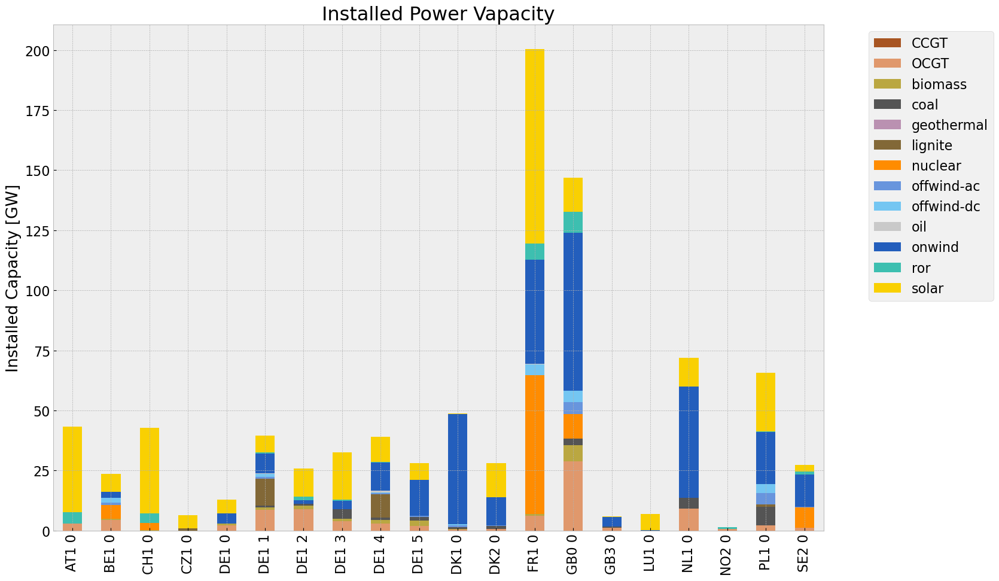

<Figure size 640x480 with 0 Axes>

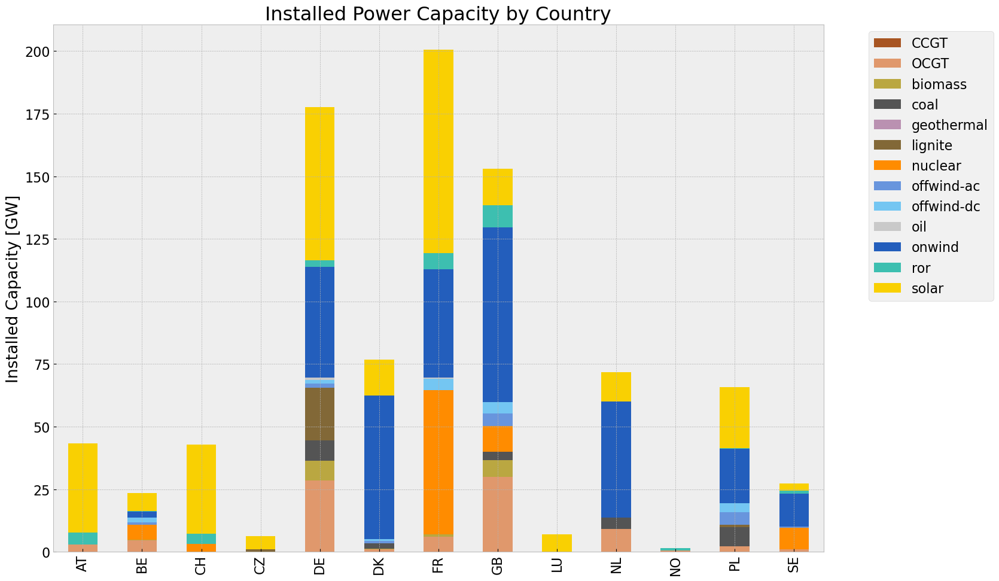

<Figure size 640x480 with 0 Axes>

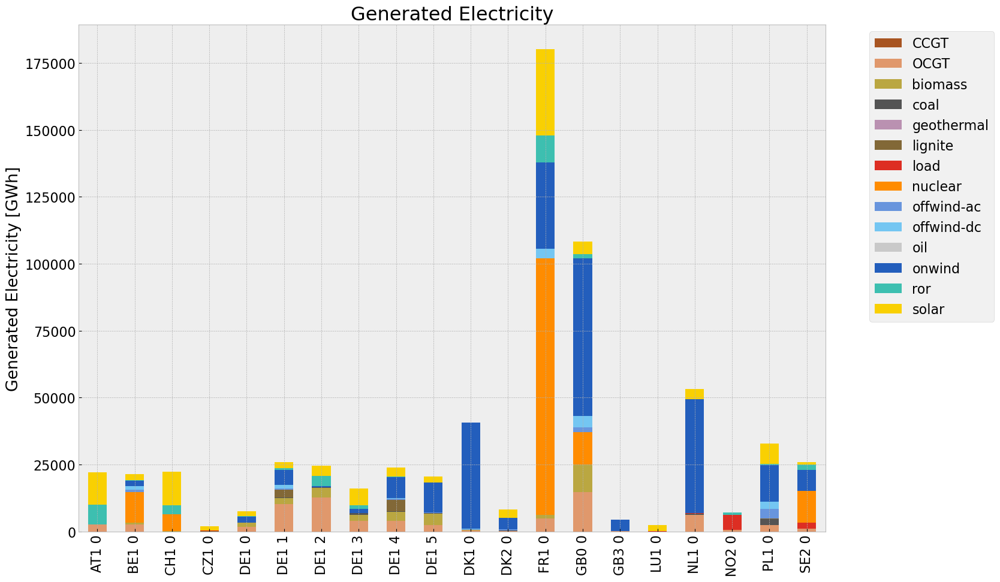

<Figure size 640x480 with 0 Axes>

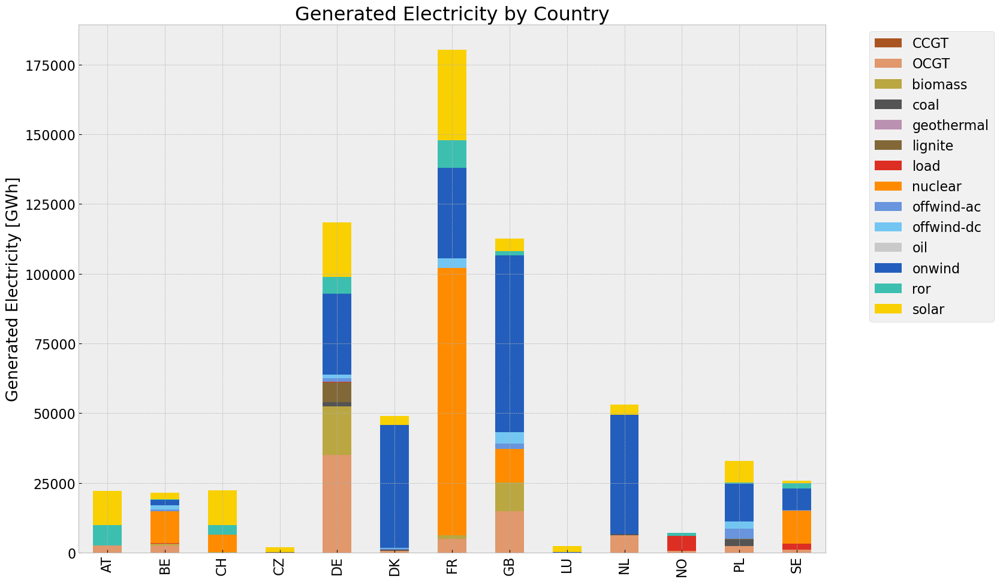

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,7.100570e+07,0.451621,0.1980,3.113038e+07
biomass,2.994786e+07,0.468000,0.0000,0.000000e+00
coal,4.834270e+06,0.329908,0.3361,4.925004e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,7.548368e+06,0.337285,0.4069,9.106344e+06
load,8.317359e+06,1.000000,0.0000,0.000000e+00
nuclear,1.371241e+08,0.326600,0.0000,0.000000e+00
offwind-ac,8.100024e+06,1.000000,0.0000,0.000000e+00


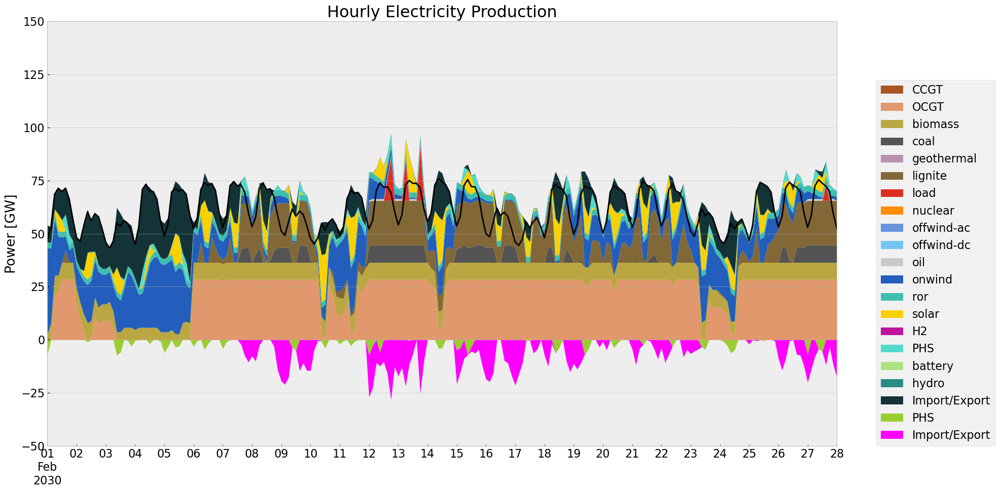

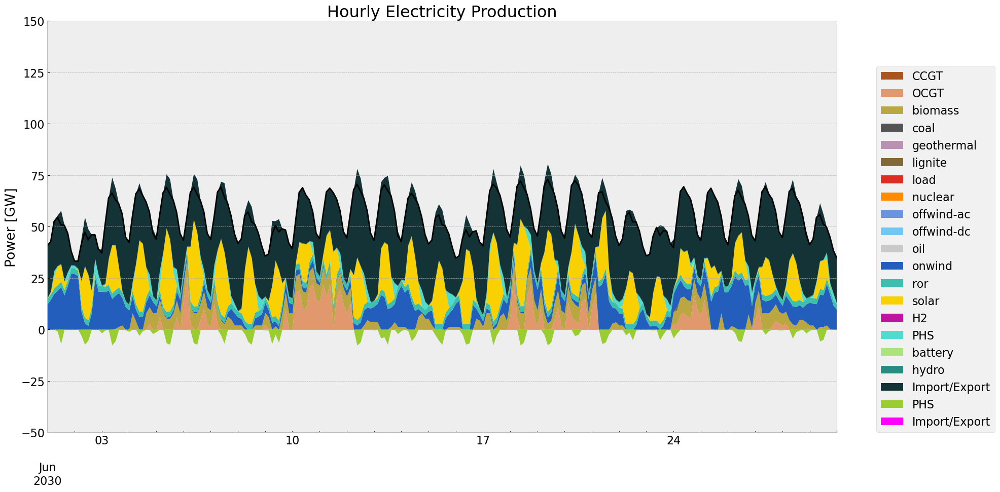

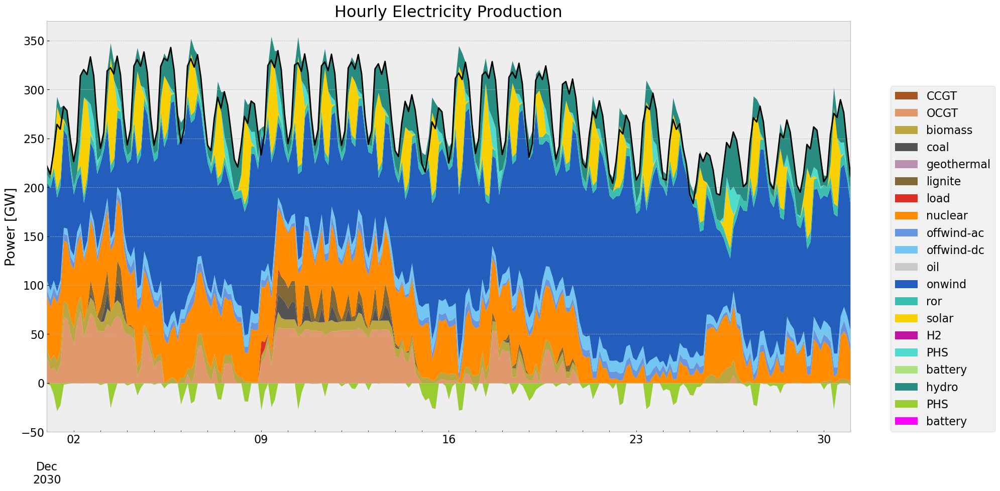

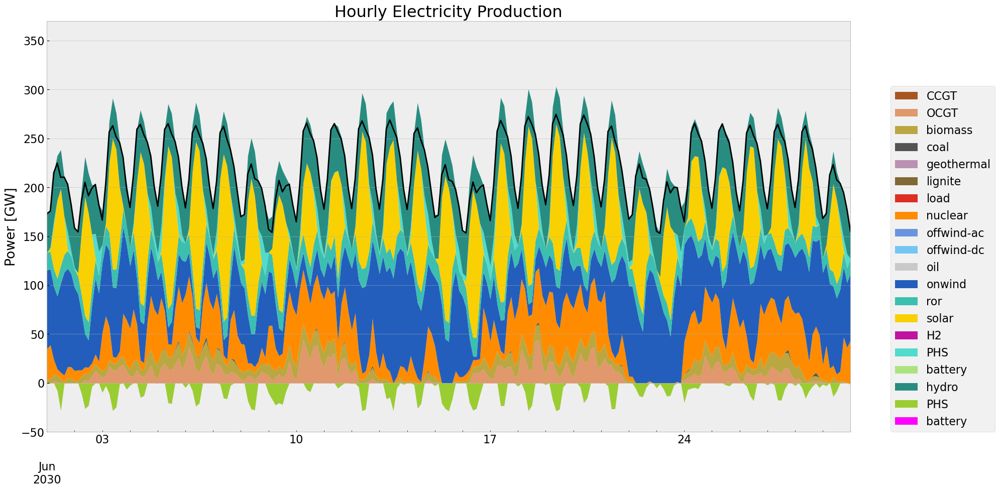

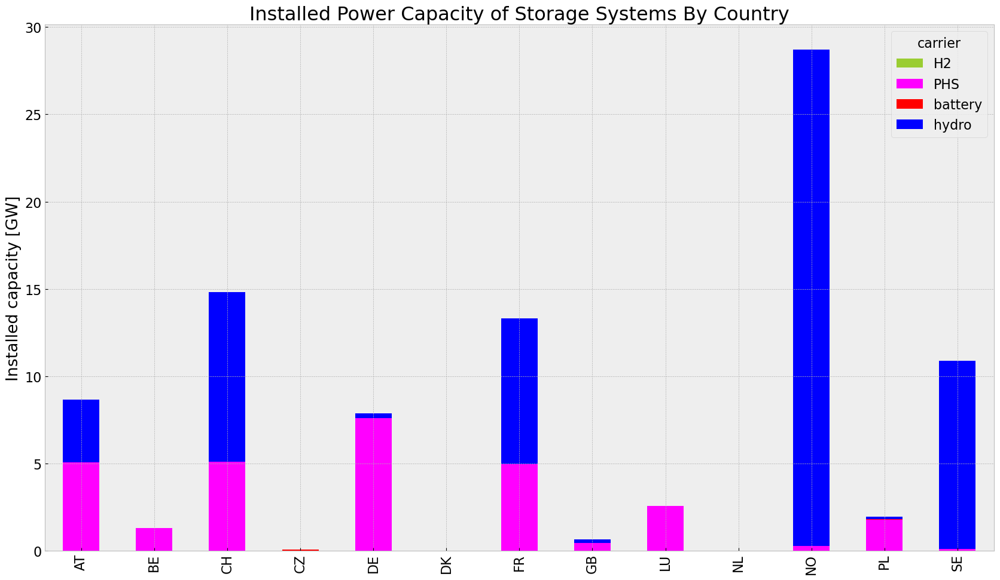

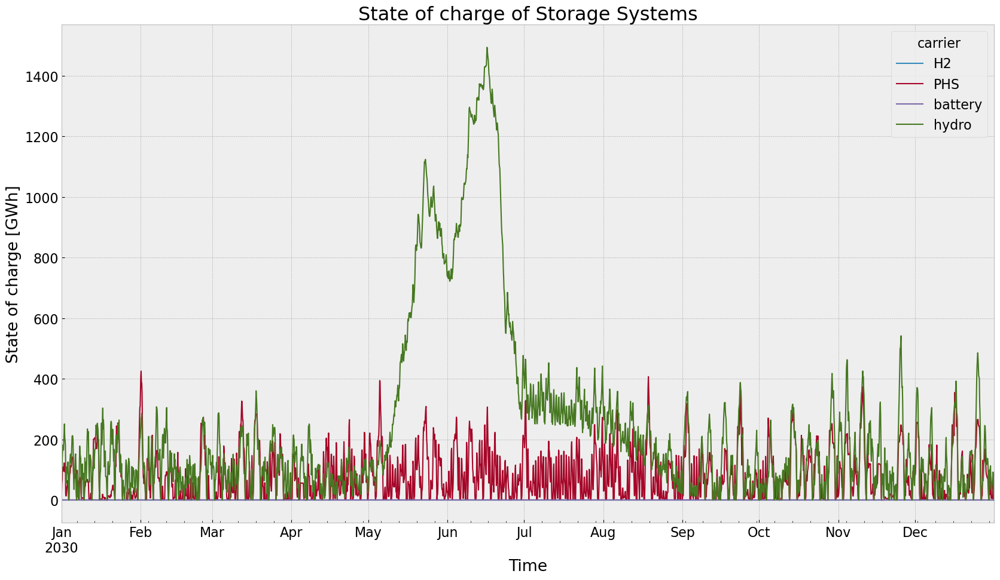

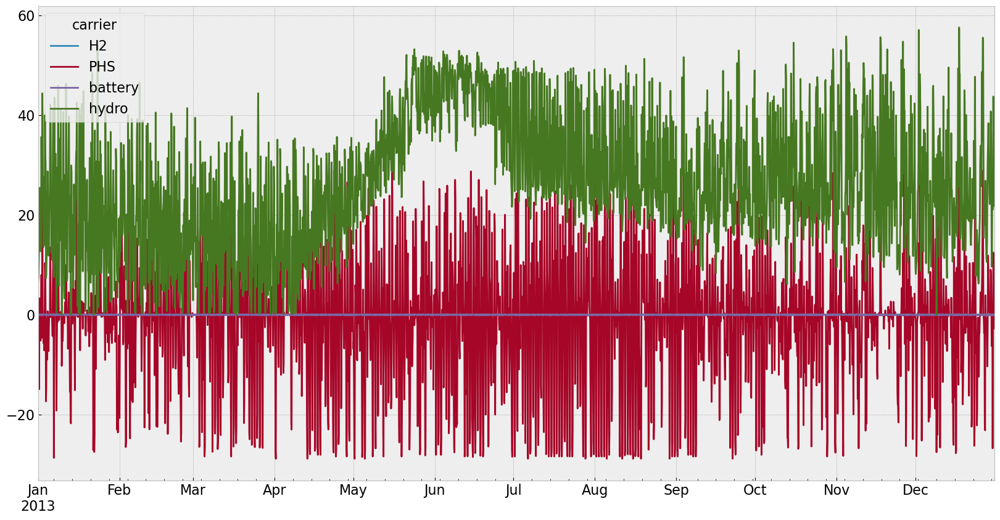

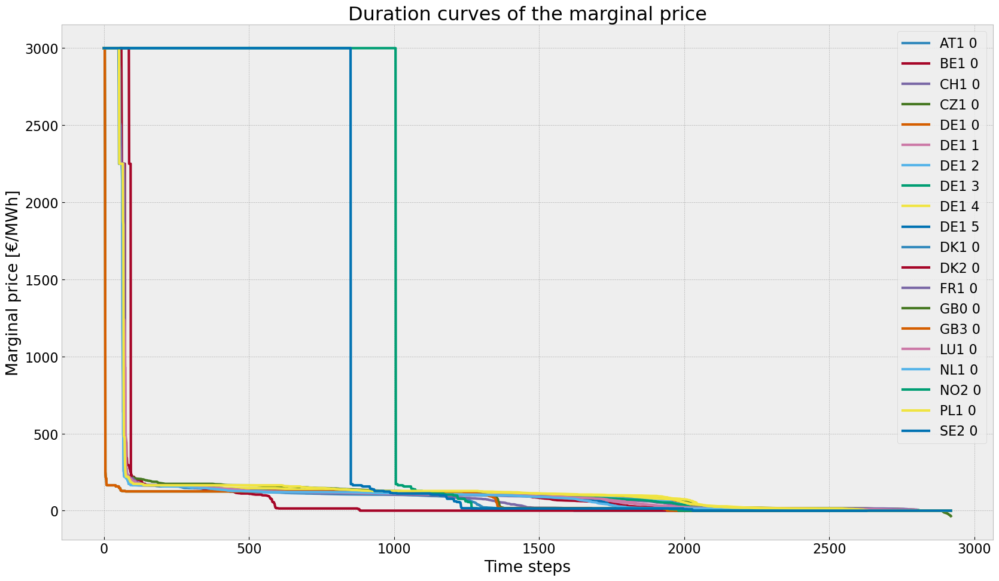

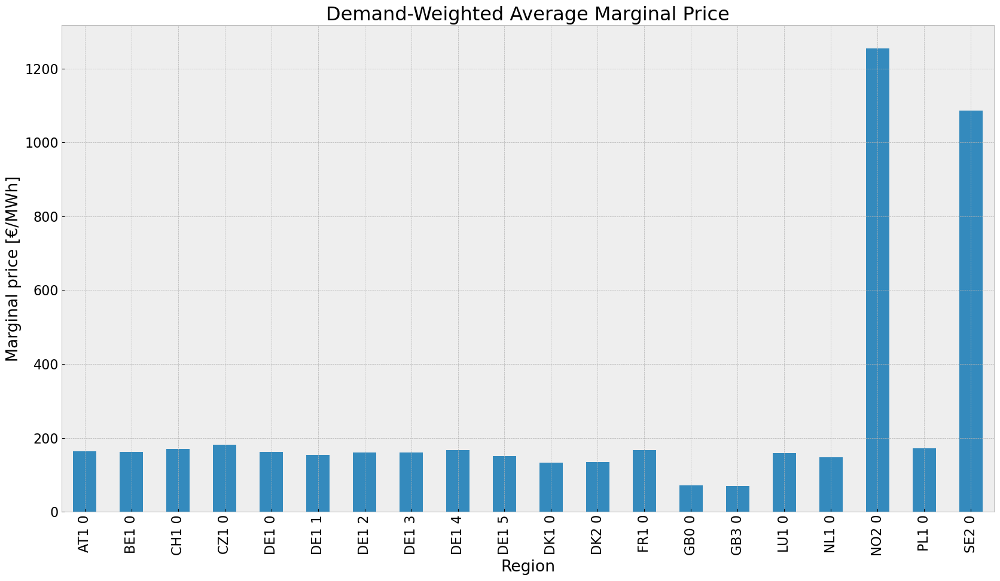

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


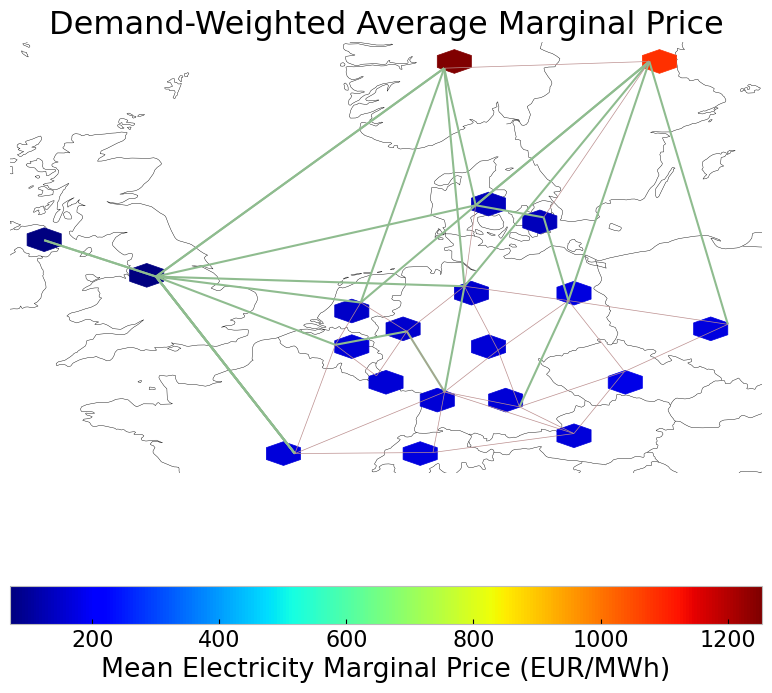

In [167]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv_roll = inst_cap_table(n4, color_cap)
cap_inv_roll_country = inst_cap_table_country(n4, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_inv_roll  = gen_power_table(n4,colors_gen_table)
gen_inv_roll_country = gen_power_table_country(n4,colors_gen_table)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n4, '2030-02-01', '2030-02-28', colors_gen,'DE')
gen_curve(n4, '2030-06-01', '2030-06-30', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n4, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n4, '2030-06-01', '2030-06-30', colors_gen)

#installed storage unit & stores
store_inv_roll = inst_store_table(n4)

#State of Charge Storage unit
state_of_charge_plot(n4)
n4.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n4)

#avg electricity price
price_regions_table(n4)
price_regions(n4)

#Emission
em_inv_roll =em_table(n4)
em_inv_roll

In [168]:
#e_balance = n3.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :]
#e_balance.head()
#e_balance.to_csv('energy_balance_DE_offwind.csv', sep=',', index=True, header=True, encoding='utf-8')

# Scenario Analysis

## Installed Capacity

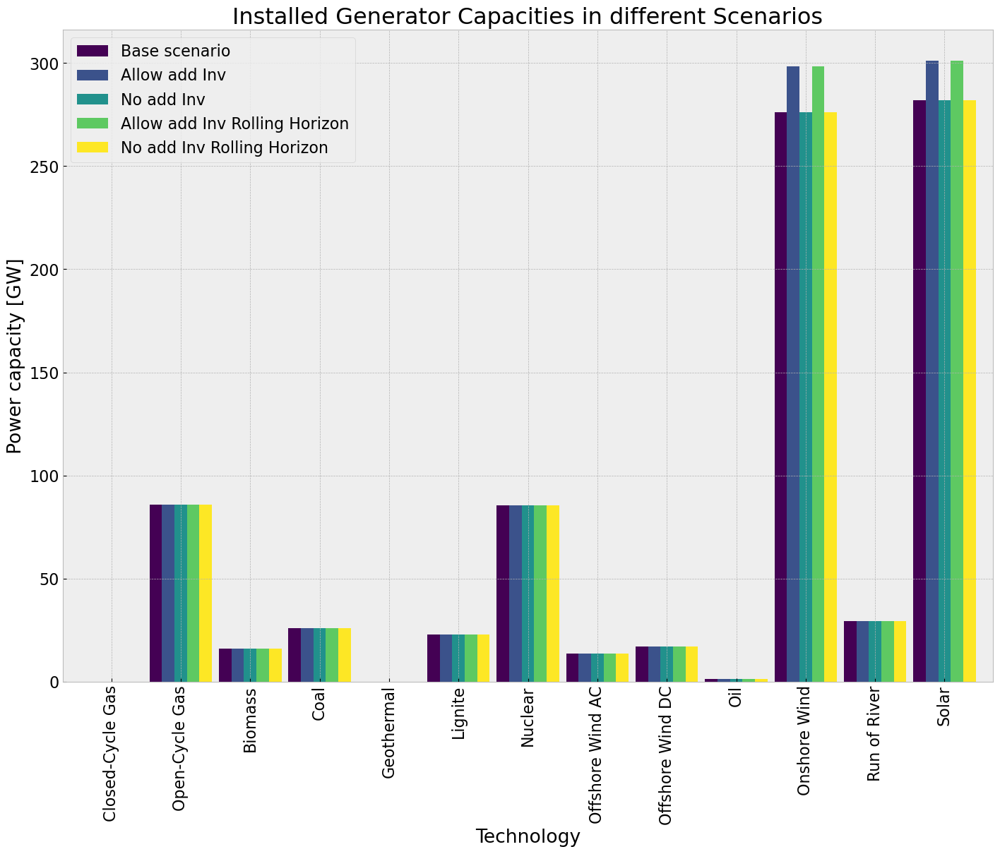

In [169]:
comp_inst_cap = pd.DataFrame(index=capacities_base.unstack().drop(columns=['load'],inplace=False).columns)

comp_inst_cap["Base scenario"] = capacities_base.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv"] = capacities_inv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv"] = capacities_noinv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv Rolling Horizon"] = capacities_inv_roll.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv Rolling Horizon"] = capacities_noinv_roll.groupby("carrier").sum().div(1e3).drop(index="load")

comp_inst_cap.rename(index = {"coal": "Coal"}, inplace=True)
comp_inst_cap.rename(index = {"OCGT": "Open-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"CCGT": "Closed-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"ror": "Run of River"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-ac": "Offshore Wind AC"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-dc": "Offshore Wind DC"}, inplace=True)
comp_inst_cap.rename(index = {"onwind": "Onshore Wind"}, inplace=True)
comp_inst_cap.rename(index = {"solar": "Solar"}, inplace=True)
comp_inst_cap.rename(index = {"oil": "Oil"}, inplace=True)
comp_inst_cap.rename(index = {"geothermal": "Geothermal"}, inplace=True)
comp_inst_cap.rename(index = {"nuclear": "Nuclear"}, inplace=True)
comp_inst_cap.rename(index = {"biomass": "Biomass"}, inplace=True)
comp_inst_cap.rename(index = {"lignite": "Lignite"}, inplace=True)

comp_inst_cap.fillna(0, inplace=True)

comp_inst_cap.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_cap.columns))),
                        grid=True,
                        xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Generator Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.show()

### Analysis of extendable Generators

Extendable Generators: OCGT, Offshore Wind AC and DC, Onshore Wind, Solar

{'AC': '#70af1d', 'DC': '#8a1caf', 'biomass': '#baa741', 'coal': '#545454', 'lignite': '#826837', 'oil': '#c9c9c9', 'onwind': '#235ebc', 'nuclear': '#ff8c00', 'offwind-dc': '#74c6f2', 'offwind-ac': '#6895dd', 'OCGT': '#e0986c', 'CCGT': '#a85522', 'geothermal': '#ba91b1', 'solar': '#f9d002', 'hydro': '#298c81', 'PHS': '#51dbcc', 'ror': '#3dbfb0', '': '', 'battery': '#ace37f', 'H2': '#bf13a0', 'load': '#dd2e23'}


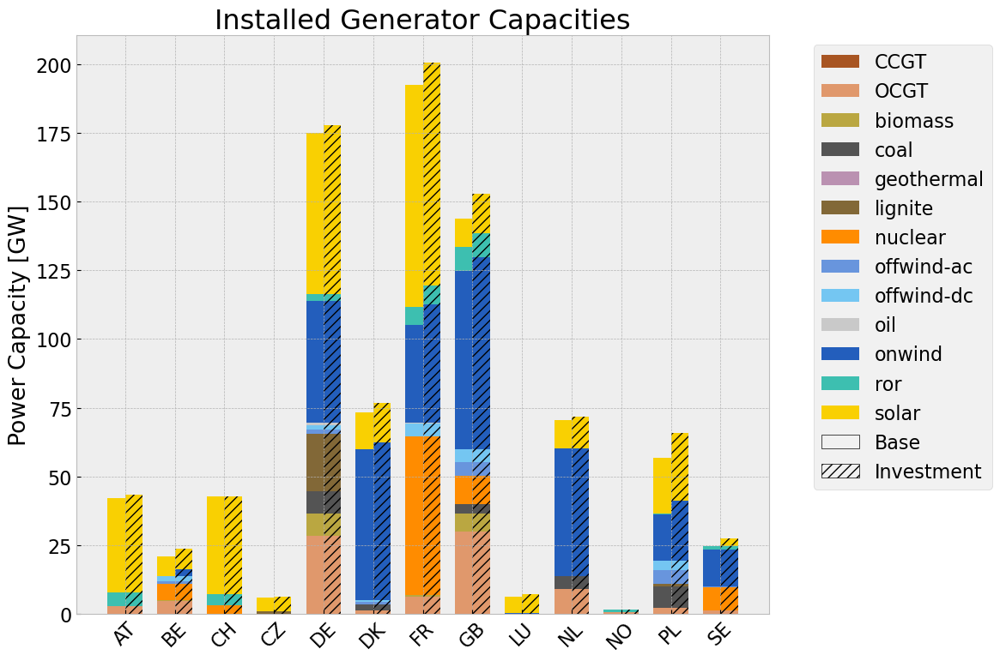

In [170]:
from matplotlib.patches import Patch

color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}
print(color_map)

base = cap_base_country
base.fillna(0, inplace=True)
inv = cap_inv_country
inv.fillna(0, inplace=True)

# Color mapping for generator types
color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(base.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, base, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, inv, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Generator Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_cap_base_vs_inv_offwind.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)


plt.show()

## Power Generation

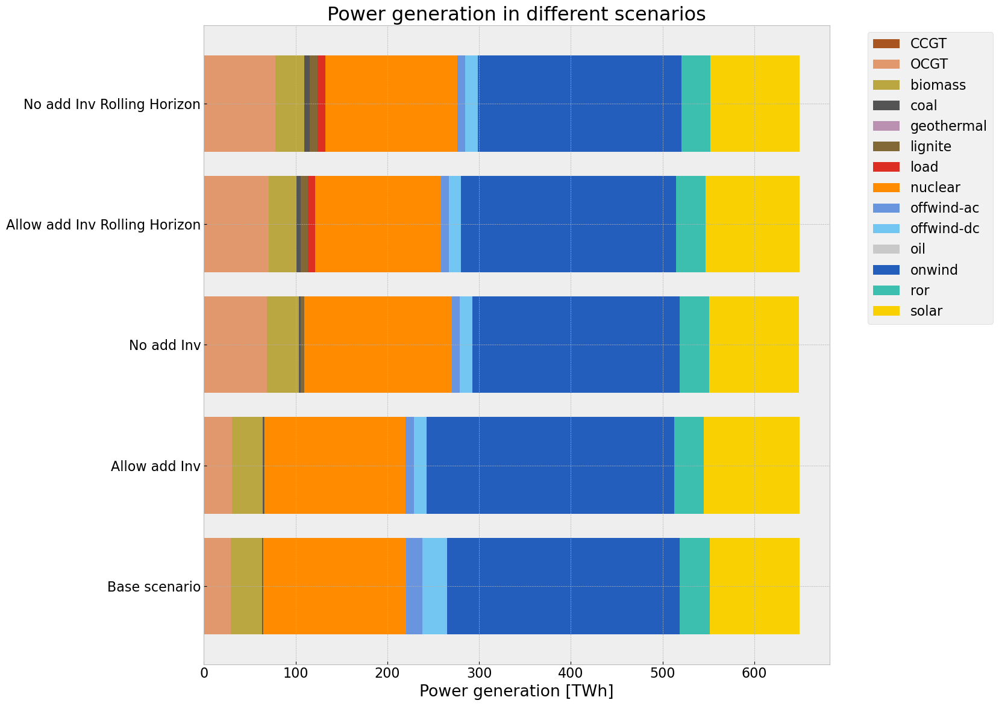

In [171]:
comp_gen_electr = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = tech_list_gen_table)

comp_gen_electr.loc["Base scenario"] = gen_base.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv"] = gen_inv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv"] = gen_noinv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv Rolling Horizon"] = gen_inv_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv Rolling Horizon"] = gen_noinv_roll.sum().div(1e3) # TWh/a



#comp_gen_electr.rename(columns = {"coal": "Coal"}, inplace=True)
#comp_gen_electr.rename(columns = {"gas": "Gas"}, inplace=True)
#comp_gen_electr.rename(columns = {"hydro": "Hydro"}, inplace=True)
#comp_gen_electr.rename(columns = {"offwind": "Offshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"onwind": "Onshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"solar": "Solar"}, inplace=True)
#comp_gen_electr.rename(columns = {"oil": "Oil"}, inplace=True)
#comp_gen_electr.rename(columns = {"geothermal": "Geothermal"}, inplace=True)
#comp_gen_electr.rename(columns = {"nuclear": "Nuclear"}, inplace=True)

comp_gen_electr.fillna(0, inplace=True)
comp_gen_electr.plot.barh(figsize=(17,12),
                        color=colors_gen_table,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Power generation [TWh]",
                        title=f"Power generation in different scenarios",
                        #xlim=[0,200],
                        width=0.8
)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_generation_offwind.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Installed Storage Capacities

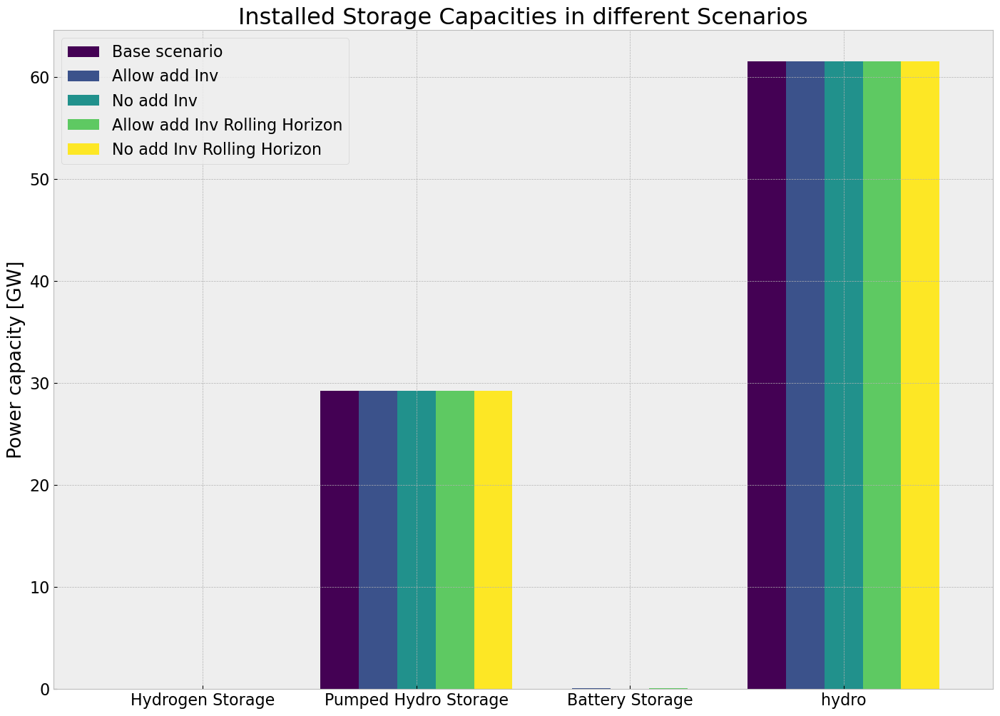

In [172]:
comp_inst_store = pd.DataFrame(index=store_base.unstack().columns)
comp_inst_store.index.name = ''

comp_inst_store["Base scenario"] = store_base.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv.groupby("carrier").sum()
comp_inst_store["No add Inv"] = store_noinv.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["Allow add Inv Rolling Horizon"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["No add Inv Rolling Horizon"] = store_noinv_roll.groupby("carrier").sum()

comp_inst_store.rename(index = {"battery": "Battery Storage"}, inplace=True)
comp_inst_store.rename(index = {"H2": "Hydrogen Storage"}, inplace=True)
comp_inst_store.rename(index = {"Hydro": "Reservoir & Dam"}, inplace=True)
comp_inst_store.rename(index = {"PHS": "Pumped Hydro Storage"}, inplace=True)


comp_inst_store.fillna(0, inplace=True)

comp_inst_store.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_store.columns))),
                        grid=True,
                        #xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Storage Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.xticks(rotation=360, ha='center')
fig.tight_layout()
# Save plot to the current working directory
filename = "analysis_installed_cap_offwind.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

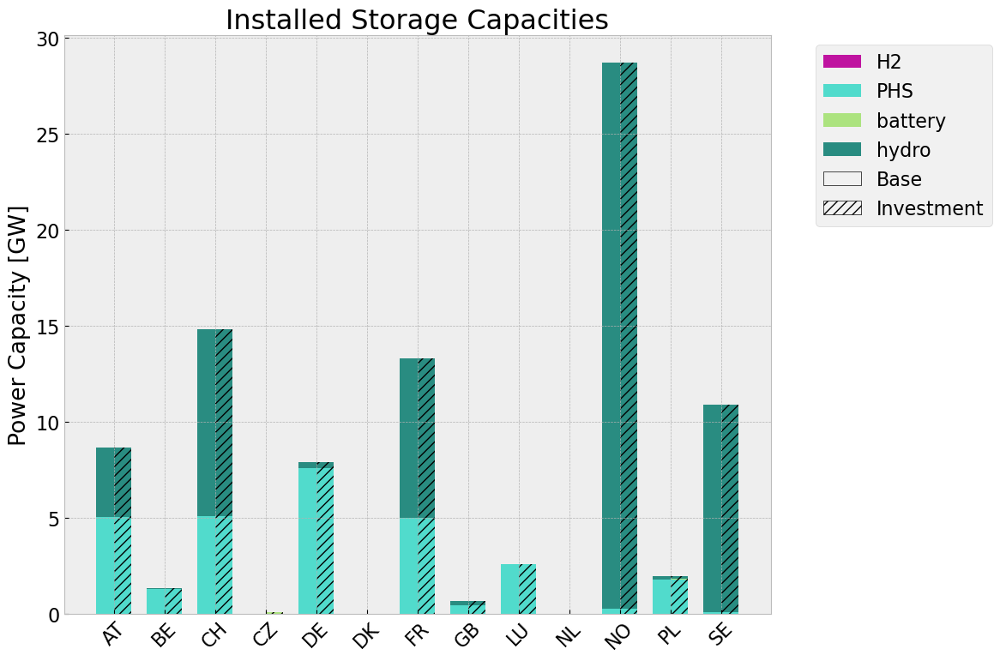

In [173]:
store_base_df = store_base.unstack()
store_inv_df = store_inv.unstack()

store_base_df.fillna(0, inplace=True)
store_inv_df.fillna(0, inplace=True)

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(store_base_df.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, store_base_df, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, store_inv_df, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Storage Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_storagecap_base_vs_inv_offwind.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()


## System Cost

In [174]:
tech_comp = system_cost_base.index.tolist()
comp_system_cost = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_cost.loc["Base scenario"] = system_cost_base # Million €/a
comp_system_cost.loc["Allow add Inv"] = system_cost_inv # Million €/a
#if tot_cost_0_PV > 0: 
#    comp_system_cost.loc["0% PV potential"] = system_cost_0_PV # Million €/a
#else: comp_system_cost.loc["0% PV potential"] = 0.0
#if tot_cost_20_PV > 0: 
#    comp_system_cost.loc["20% PV potential"] = system_cost_20_PV # Million €/a
#else: comp_system_cost.loc["20% PV potential"] = 0.0
comp_system_cost.loc["No add Inv"] = system_cost_noinv # Million €/a
comp_system_cost.loc["Allow add Inv Rolling Horizon"] = system_cost_inv_roll
comp_system_cost.loc["No add Inv Rolling Horizon"] = system_cost_noinv_roll # Million €/a

#if 'AC' in system_cost_base:
#   comp_system_cost.AC = comp_system_cost.AC-system_cost_base.AC # expenditure for already existing transmission lines

#comp_system_cost[comp_system_cost<0] = 0 # since we subtact the AC cost (for the 0% or 20%) 
comp_system_cost.drop('-', axis=1, inplace=True)
#comp_system_cost.iloc[0,0] = system_cost_base.AC


#comp_system_cost = comp_system_cost   #Million eur0/

#comp_system_cost.rename(columns = {"battery storage": "Battery storage"}, inplace=True)
#comp_system_cost.rename(columns = {"hydrogen storage underground": "Hydrogen storage underground"}, inplace=True)

comp_system_cost.fillna(0, inplace=True)
comp_system_cost = comp_system_cost.div(1e3) # Billion €

#move load shedding to the last col
# Specify the column name to move
column_to_move = 'Load shedding'

# Create a new list of column names without the column to move
new_columns = [col for col in comp_system_cost.columns if col != column_to_move]

# Append the column to move to the end
new_columns.append(column_to_move)

# Reorder the columns
comp_system_cost = comp_system_cost[new_columns]


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3548450514.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3548450514.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


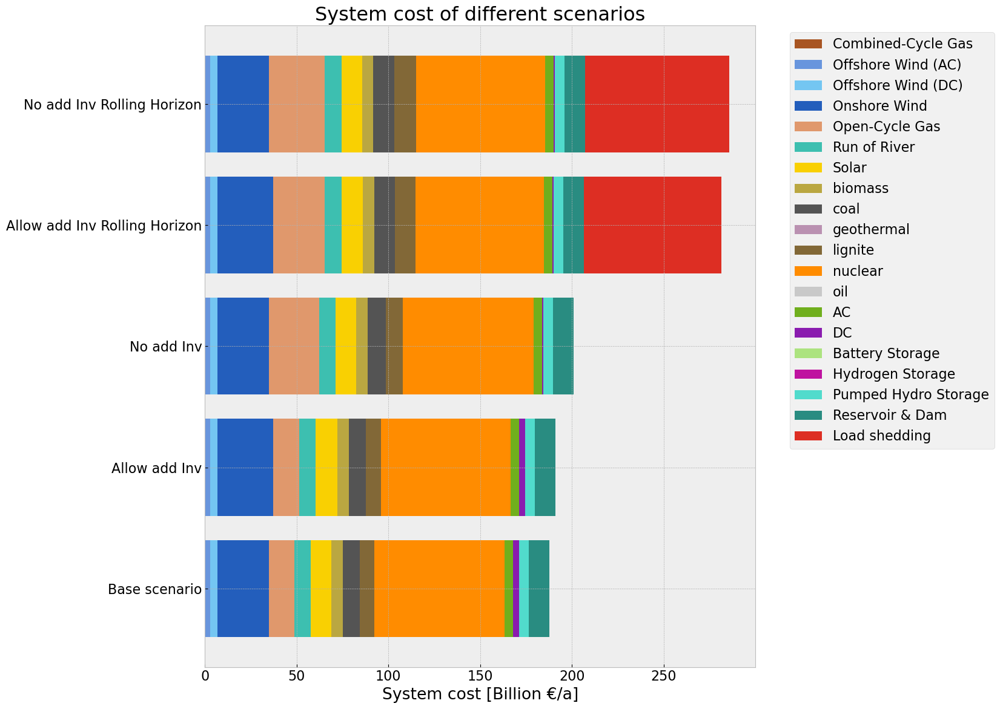

In [175]:
colors_comp = []

for i in range(len(comp_system_cost.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_cost.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="System cost [Billion €/a]",
                        title=f"System cost of different scenarios",
                        #xlim=[0,100],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_system_cost_offwind.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Curtailment

In [176]:
comp_curtailment = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = stat_base.loc["Generator"].index)

comp_curtailment.loc["Base scenario"] = stat_base.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv"] = stat_inv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv"] = stat_noinv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv Rolling Horizon"] = stat_inv_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv Rolling Horizon"] = stat_noinv_roll.loc["Generator"].Curtailment.div(1e6) # TWh

comp_curtailment.fillna(0, inplace=True)

In [177]:
color_curtailment=[]

for i in range(len(comp_curtailment.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
            color_curtailment.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found 

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3109801822.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3109801822.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_curtailment.append(n.carriers.color[j])


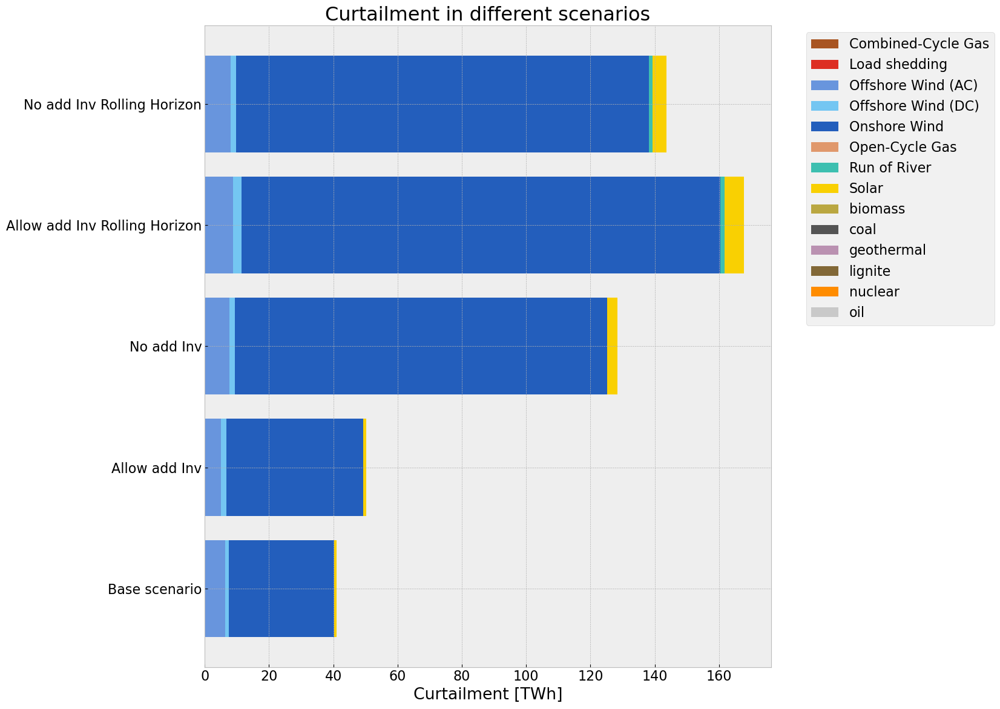

In [178]:
comp_curtailment.plot.barh(figsize=(17,12),
                        color=color_curtailment,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Curtailment [TWh]",
                        title=f"Curtailment in different scenarios",
                        #xlim=[0,120],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_curtailment_offwind.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Emission

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_14484\3124803761.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


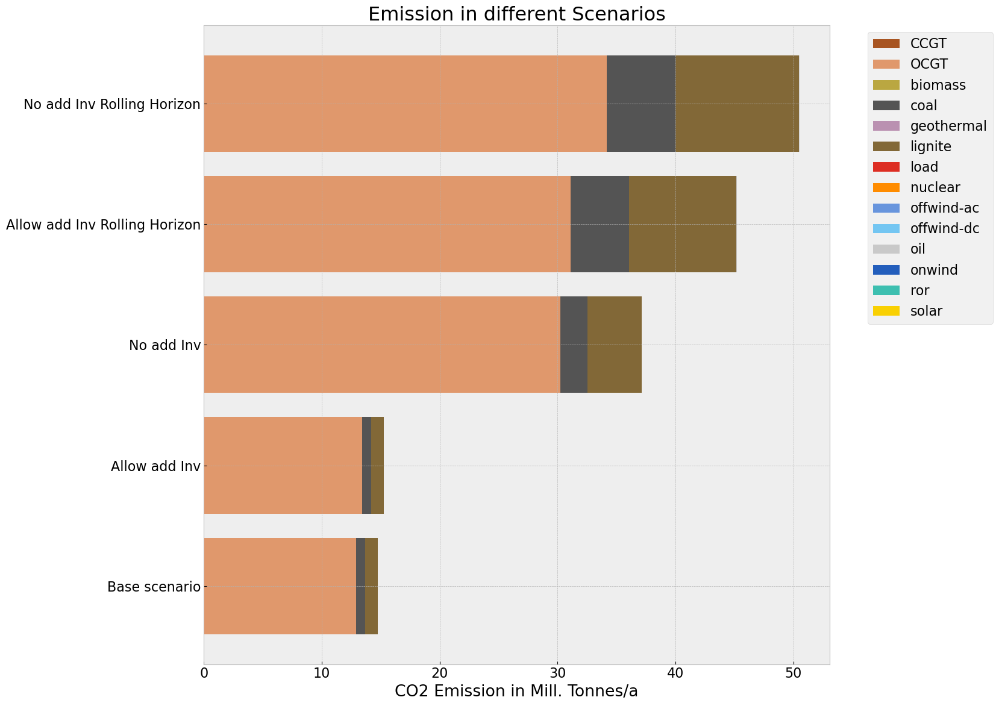

In [179]:
tech_comp = em_base.index.tolist()
comp_system_em = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_em.loc["Base scenario"] = em_base['emissions in Tonnes CO2']/1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv"] = em_inv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv"] = em_noinv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv Rolling Horizon"] = em_inv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv Rolling Horizon"] = em_noinv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a

comp_system_em.fillna(0, inplace=True)

colors_comp = []

for i in range(len(comp_system_em.columns)):
    for j in range(len(n.carriers.index)):
        if comp_system_em.columns[i] == n.carriers.index[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_em.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="CO2 Emission in Mill. Tonnes/a",
                        title=f"Emission in different Scenarios",
                        #xlim=[0,100],
                        width=0.8
)
#global_constraint
#plt.axvline(x=n.global_constraints.loc['CO2Limit','constant']/1e6, color='r', linestyle='-', linewidth=2, label='CO2 cap')
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_emission_offwind.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()